In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import json

In [3]:
df=pd.read_csv('cancel_train.csv')
df

,mon,state,originalagency,speed,wirecenter,InstallType,competitorname,ContractType,salesrepid,order_create_date,...,strOrderType,strIsWinbackIndicator,notruckrollrequiredreason,droptype,premisetype,ONTselfinstallcapable,saleschannel,bundlename,smartcart,cancel_ind
0,NY11345685302,NY,REDVENT: REDVENT,FTTP_100M_100M,BREWSTER,TECH INSTALL,COMCAST,MONTHTOMONTH,A001696,2/4/18,...,N,NO,NaN,AERIAL,SFU,N,RED VENTURES,UNKNOWN,0,NaN
1,MD11346031526,MD,CSSC: CSSC,FTTP_1000M_1000M,OWEN BROWN,TECH INSTALL,COMCAST,CONTRACT,A002775,2/5/18,...,N,NO,NaN,BURIED,SFU,N,BIG BOX,1000M + TV Mundo + FDV Unlim,0,NaN
2,PA11346211594,PA,ONLINE: ONLINE,FTTP_100M_100M,BRADDOCK,TECH INSTALL,COMCAST,MONTHTOMONTH,239B3PA,2/7/18,...,N,NO,NaN,AERIAL,SFU,N,ONLINE CON,UNKNOWN,1,NaN
3,VA11346969162,VA,CSSC: CSSC,FTTP_1000M_1000M,DRUMMONDS CORNER,TECH INSTALL,COX COMM,CONTRACT,V660449,2/9/18,...,M,NO,NaN,BURIED,SFU,N,CSSC,1000M + Extreme HD - 2014 + NO FDV,0,NaN
4,NY11345471806,NY,ONLINE: ONLINE,FTTP_1000M_1000M,LEVITTOWN,TECH INSTALL,CABLEVISION,CONTRACT,C7962VZ,2/3/18,...,N,NO,NaN,AERIAL,SFU,N,ONLINE CON,1000M + Preferred HD 2015 + FDV Unlim,1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50586,NY11346543694,NY,CSSC: CSSC,FTTP_150M_150M,BROAD STREET,TECH INSTALL,TIME WARNER,CONTRACT,A003915,2/7/18,...,M,NO,NaN,MDU_INSIDE,MDU,Y,D2D CON,150M + Preferred HD 2015 + FDV Unlim,0,1.0
50587,NJ11345798633,NJ,CSSC: CSSC,FTTP_1000M_1000M,MARLTON,TECH INSTALL,COMCAST,CONTRACT,LOCKDA4,2/5/18,...,M,NO,NaN,BURIED,SFU,N,CSSC,1000M + Extreme HD - 2014 + FDV Unlim,0,NaN
50588,MD11345784978,MD,ONLINE: ONLINE,FTTP_75M_75M,BETHESDA,TECH INSTALL,COMCAST,MONTHTOMONTH,V320760,2/5/18,...,N,NO,NaN,MDU_INSIDE,MDU,N,CSSC,75M + Preferred HD 2015 + NO FDV,0,NaN
50589,VA11347258162,VA,CSSC: CSSC,FTTP_50M_50M,DULLES CORNER,SUPERCEDURE,COX COMM,CONTRACT,VISAGAL,2/10/18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,50M + Preferred HD 2015 + FDV Unlim,0,1.0


In [4]:
df2=pd.read_csv('cancel_train.csv')

In [5]:
(df
 #.describe()
 .columns
)

Index(['mon', 'state', 'originalagency', 'speed', 'wirecenter', 'InstallType',
       'competitorname', 'ContractType', 'salesrepid', 'order_create_date',
       'canceldate', 'endclientsystem', 'hfws_ind', 'due_date',
       'FIRSTOFFEREDDATE', 'waitingdayofcustomers', 'waitingdayforcompany',
       'BUNDLE', 'BundleType', 'ONTRequired', 'ONTInstall', 'strOrderType',
       'strIsWinbackIndicator', 'notruckrollrequiredreason', 'droptype',
       'premisetype', 'ONTselfinstallcapable', 'saleschannel', 'bundlename',
       'smartcart', 'cancel_ind'],
      dtype='object')

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50591 entries, 0 to 50590
Data columns (total 31 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   mon                        50591 non-null  object 
 1   state                      50591 non-null  object 
 2   originalagency             50591 non-null  object 
 3   speed                      50591 non-null  object 
 4   wirecenter                 50583 non-null  object 
 5   InstallType                50591 non-null  object 
 6   competitorname             50535 non-null  object 
 7   ContractType               50591 non-null  object 
 8   salesrepid                 50383 non-null  object 
 9   order_create_date          50591 non-null  object 
 10  canceldate                 6170 non-null   object 
 11  endclientsystem            50412 non-null  object 
 12  hfws_ind                   2164 non-null   object 
 13  due_date                   50359 non-null  obj

In [7]:
df.describe(include='all').T  # ÇOK AZ NÜMERİK SÜTUN VAR !   ( 2 İNTEGER 2 BOOL DEĞİŞKEN !)

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
mon,50591,50569,NY11345355589,5,NaN,NaN,NaN,NaN,NaN,NaN,NaN
state,50591,11,NY,14929,NaN,NaN,NaN,NaN,NaN,NaN,NaN
originalagency,50591,27,CSSC: CSSC,27155,NaN,NaN,NaN,NaN,NaN,NaN,NaN
speed,50591,20,FTTP_1000M_1000M,26771,NaN,NaN,NaN,NaN,NaN,NaN,NaN
wirecenter,50583,709,JOURNAL SQUARE,555,NaN,NaN,NaN,NaN,NaN,NaN,NaN
InstallType,50591,7,TECH INSTALL,45758,NaN,NaN,NaN,NaN,NaN,NaN,NaN
competitorname,50535,8,COMCAST,25516,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ContractType,50591,2,CONTRACT,27851,NaN,NaN,NaN,NaN,NaN,NaN,NaN
salesrepid,50383,4831,A001696,8288,NaN,NaN,NaN,NaN,NaN,NaN,NaN
order_create_date,50591,13,2/12/18,5340,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [8]:
df.waitingdayofcustomers=pd.to_numeric(df.waitingdayofcustomers,errors='coerce')
df.waitingdayforcompany=pd.to_numeric(df.waitingdayforcompany,errors='coerce')
#df.notruckrollrequiredreason=pd.to_numeric(df.notruckrollrequiredreason,errors='coerce')


array([[<AxesSubplot: title={'center': 'waitingdayofcustomers'}>,
        <AxesSubplot: title={'center': 'waitingdayforcompany'}>]],
      dtype=object)

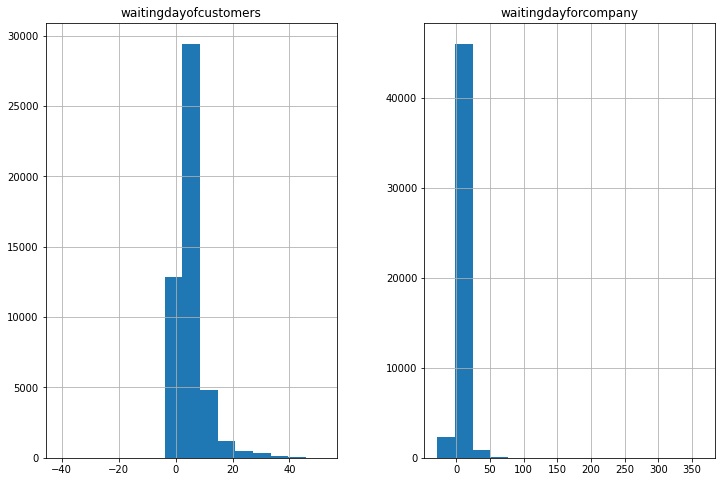

In [9]:
df.hist(column=['waitingdayofcustomers','waitingdayforcompany'], bins=15, figsize=(12,8))

### KORELASYON  !!

In [11]:
df[['waitingdayofcustomers','waitingdayforcompany']].corr()

   #  corelasyon yok !

,waitingdayofcustomers,waitingdayforcompany
waitingdayofcustomers,1.000000,0.019263
waitingdayforcompany,0.019263,1.000000


In [12]:
(df
 [['due_date','FIRSTOFFEREDDATE','waitingdayofcustomers','waitingdayforcompany']]
 #.describe()
 #.columns
 #.info()
 .tail(20)
)

#.due_date.value_counts(dropna=False)
 #.FIRSTOFFEREDDATE.str.split(pat="/")
 #.waitingdayofcustomers.isna().any()
 #.waitingdayforcompany.describe()

,due_date,FIRSTOFFEREDDATE,waitingdayofcustomers,waitingdayforcompany
50571,2/17/18,2/13/18,4.0,4.0
50572,2/8/18,2/7/18,6.0,1.0
50573,3/9/18,3/9/18,36.0,0.0
50574,2/9/18,2/8/18,0.0,1.0
50575,2/11/18,2/11/18,6.0,0.0
50576,2/15/18,2/14/18,7.0,1.0
50577,2/15/18,2/15/18,6.0,0.0
50578,2/13/18,2/13/18,5.0,0.0
50579,2/2/18,2/2/18,1.0,0.0
50580,2/9/18,2/7/18,2.0,2.0


### OUTLİAR   ANALİZİ

<AxesSubplot: >

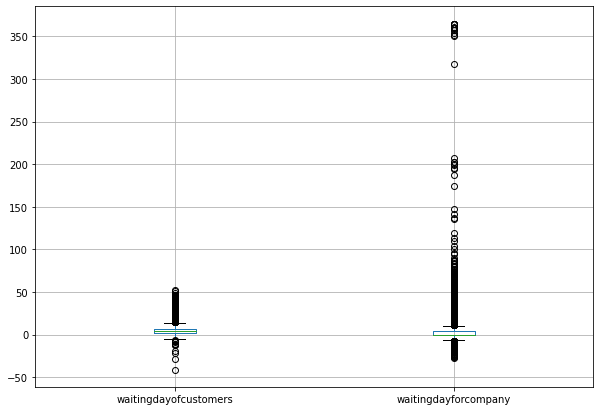

In [18]:
(df
 [['waitingdayofcustomers','waitingdayforcompany']]
 .boxplot(figsize=(10,7))
 #.describe()
 #.columns
 #.info()
 # df.boxplot(column=['Col1', 'Col2', 'Col3'])
 
)

####  INTER-QUANTİLE METHODUYLA OUTLİARLARI STANDARTLAŞTIRMA !

In [19]:
ıqr_customer=df.waitingdayofcustomers.quantile(0.75)-df.waitingdayofcustomers.quantile(0.25)
ıqr_customer

5.0

In [20]:
border_customer_high=df.waitingdayofcustomers.quantile(0.75)+(1.5*ıqr_customer)
border_customer_low=df.waitingdayofcustomers.quantile(0.25)-(1.5*ıqr_customer)
print('customer_quantile_limits   :'+str(border_customer_low)+' - '+str(border_customer_high))

customer_quantile_limits   :-5.5 - 14.5


In [21]:
ıqr_company=df.waitingdayforcompany.quantile(0.75)-df.waitingdayforcompany.quantile(0.25)
ıqr_company

4.0

In [22]:
border_company_high=df.waitingdayforcompany.quantile(0.75)+(1.5*ıqr_company)
border_company_low=df.waitingdayforcompany.quantile(0.25)-(1.5*ıqr_company)
print('customer_company_limits   :'+str(border_company_low)+' - '+str(border_company_high))

customer_company_limits   :-6.0 - 10.0


In [23]:
df.loc[df['waitingdayofcustomers']>14.5, 'waitingdayofcustomers']=15
df.loc[df['waitingdayofcustomers']<--5.5, 'waitingdayofcustomers']=-6

In [24]:
df.waitingdayofcustomers.value_counts().nlargest(50)

-6.0     31252
 6.0      4950
 7.0      4235
 15.0     2106
 8.0      1890
 9.0      1324
 10.0     1119
 11.0      742
 12.0      619
 13.0      588
 14.0      462
Name: waitingdayofcustomers, dtype: int64

In [25]:
df.loc[df['waitingdayforcompany']>10, 'waitingdayforcompany']=10
df.loc[df['waitingdayforcompany']<-6, 'waitingdayforcompany']=-6

In [26]:
df.waitingdayforcompany.value_counts().nlargest(50)

 0.0     23122
 10.0     5902
 1.0      5697
 2.0      2608
 3.0      1996
 4.0      1860
 5.0      1461
 6.0      1208
 7.0       916
 8.0       863
 9.0       736
-1.0       581
-6.0       561
-2.0       527
-3.0       481
-4.0       384
-5.0       358
Name: waitingdayforcompany, dtype: int64

In [ ]:
avv=df.waitingdayofcustomers[50590]
print(avv)

In [ ]:
df[df.salesrepid.isnull()].query('cancel_ind==1.0')

In [ ]:
(df[~df.hfws_ind.isnull()]
 .iloc[:22,9:]
 #.query('cancel_ind==1.0')
)

In [ ]:
#df[df.canceldate.isnull()].iloc[:22,9:22].head(8)
(df[df.due_date.isnull()]
 .iloc[:22,9:].head(60)
 #.query('waitingdayofcustomers.str.contains('3')')
)

In [ ]:

#df.query('waitingdayofcustomers == #VALUE!')
(df
 [df.waitingdayofcustomers != '#VALUE!']
 .assign(waitingdayofcustomers=df.waitingdayofcustomers.astype('int8'),
 )
 .waitingdayofcustomers.describe()
)

In [ ]:
jh=df['waitingdayofcustomers'].copy()
jh=pd.to_numeric(jh, errors='coerce').value_counts(dropna=False)
jh.isna().any()

In [ ]:
jh

In [27]:
dates=['order_create_date','canceldate','due_date','FIRSTOFFEREDDATE','waitingdayofcustomers','waitingdayforcompany']

In [ ]:
####  due_date.isna()  da çok fazla  nan değer var  !!!

In [28]:
due_date_indices=list(df[df.due_date.isna()].index) 
due_date_indices

[42,
 234,
 447,
 480,
 633,
 634,
 672,
 825,
 826,
 925,
 940,
 989,
 1037,
 1044,
 1072,
 1096,
 1121,
 1161,
 1193,
 1533,
 1557,
 1592,
 1837,
 1991,
 2014,
 2027,
 2047,
 2048,
 2055,
 2060,
 2072,
 2079,
 2091,
 2100,
 2101,
 2108,
 2124,
 2134,
 2157,
 4001,
 4042,
 4116,
 4122,
 4123,
 4140,
 4193,
 4249,
 4406,
 4574,
 4646,
 4888,
 5940,
 6020,
 6057,
 6263,
 6355,
 6968,
 7155,
 7537,
 7579,
 7582,
 7585,
 7626,
 7641,
 7661,
 7668,
 7683,
 7742,
 7744,
 7746,
 7750,
 7751,
 7759,
 7793,
 7801,
 7819,
 7821,
 7864,
 7870,
 7878,
 9902,
 9946,
 10110,
 10307,
 11489,
 11769,
 12113,
 12496,
 13116,
 13184,
 13538,
 13893,
 14066,
 14276,
 14427,
 16146,
 18926,
 19427,
 20105,
 21260,
 21928,
 22239,
 23657,
 23712,
 23941,
 23962,
 24002,
 24038,
 24110,
 24200,
 24222,
 24335,
 24618,
 24772,
 24898,
 26068,
 26915,
 28447,
 29473,
 29595,
 29620,
 29621,
 30343,
 30588,
 30624,
 31789,
 32474,
 32564,
 32678,
 32703,
 32705,
 32817,
 32892,
 32972,
 33092,
 33342,
 33391,

In [29]:
(df
 #.columns
 #.head(45)
 #.describe(include='all')
 #.columns
 #.info()
 .drop_duplicates()
 #.salesrepid.value_counts()
 #.order_create_date.value_counts()
 #.endclientsystem.value_counts()
 #.waitingdayforcompany.value_counts()
 #.waitingdayforcompany.value_counts()
 #.hfws_ind.value_counts()
 #.due_date.value_counts(dropna=False)
 .FIRSTOFFEREDDATE.str.split(pat="/")
 #.waitingdayofcustomers.isna().any()
 #.waitingdayforcompany.describe()
 #.BUNDLE.value_counts(dropna=False)
 #.ONTRequired.value_counts(dropna=False)
 #.ONTInstall.value_counts(dropna=False)
 #.strOrderType.value_counts(dropna=False)
 #.trIsWinbackIndicator.value_counts(dropna=False)
 #.notruckrollrequiredreason
 #.droptype.value_counts(dropna=False)
 #.premisetype.value_counts(dropna=False)
 #.ONTselfinstallcapable.value_counts(dropna=False)
 #.saleschannel.info().
 #.bundlename
 
)

0         [2, 6, 18]
1         [2, 8, 18]
2        [2, 12, 18]
3        [2, 15, 18]
4        [2, 13, 18]
            ...     
50586    [3, 13, 18]
50587    [2, 15, 18]
50588    [3, 21, 18]
50589            NaN
50590            NaN
Name: FIRSTOFFEREDDATE, Length: 50581, dtype: object

#### TARİHLERİ AYLAR SÜTUNU  OLARAK SADELEŞTİRME !!

In [30]:
df['month']=df['FIRSTOFFEREDDATE'].str.split(pat="/")
df['month']
for i in range(len(df.month)):
    if isinstance(df.month[i], list):
        df.month[i]=df.month[i][0]
df.month    

C:\Users\BAYRAM~1\AppData\Local\Temp/ipykernel_5664/1568060427.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.month[i]=df.month[i][0]


0          2
1          2
2          2
3          2
4          2
        ... 
50586      3
50587      2
50588      3
50589    NaN
50590    NaN
Name: month, Length: 50591, dtype: object

In [31]:
df.month.value_counts(dropna=False)

2      48346
NaN     1304
3        925
1         15
4          1
Name: month, dtype: int64

In [32]:
#df['month'] = df['FIRSTOFFEREDDATE'].apply(lambda x: x.str.split("/") if x.contains())
#df['month']

In [33]:
(df
 .drop_duplicates()
 .assign(wirecenter=df.wirecenter.fillna(method='bfill').astype('category'),
        competitorname=df.competitorname.fillna(method='bfill').astype('category'),
        salesrepid=df.salesrepid.fillna('other_').astype('category'),
        endclientsystem=df.endclientsystem.fillna('othe_r').astype('category'),
        hfws_ind=df.hfws_ind.fillna('N').astype('category'),
        FIRSTOFFEREDDATE=df.FIRSTOFFEREDDATE.fillna('_other').astype('category'),
        waitingdayofcustomers=pd.to_numeric(df.waitingdayofcustomers, errors='coerce').fillna(df.waitingdayofcustomers.mode()[0]).astype('int8'),
        waitingdayforcompany=pd.to_numeric(df.waitingdayforcompany, errors='coerce').fillna(df.waitingdayforcompany.mode()[0]).astype('int8'),
        BundleType=df.BundleType.fillna('other__').astype('category'),
        ONTRequired=df.ONTRequired.fillna('__other').astype('category'),
        ONTInstall=df.ONTInstall.fillna('Other').astype('category'),
        strOrderType=df.strOrderType.fillna('Other_').astype('category'),
        strIsWinbackIndicator=df.strIsWinbackIndicator.fillna('_Other').astype('category'),
        notruckrollrequiredreason=df.notruckrollrequiredreason.fillna('').str.contains('eONTSelfInstall').astype('int8'),
        droptype=df.droptype.fillna('Unknown').astype('category'),
        premisetype=df.premisetype.fillna('Other__').astype('category'),
        ONTselfinstallcapable=df.ONTselfinstallcapable.fillna('__Other').astype('category'),
        saleschannel=df.saleschannel.replace({'OTHER BUS': 'Unknown'}, regex=True).fillna('Unknown').astype('category'),
        smartcart=df.smartcart.astype('int8'),
        cancel_ind=df.cancel_ind.fillna('0').astype('int8')
        
        
        ) 
 .drop(df.index[df[df.due_date.isna()].index])
 .drop(columns=['canceldate','BUNDLE'])
 #.info()
 #.notruckrollrequiredreason
 .reset_index()
 #info()
 #.notruckrollrequiredreason.value_counts()
 #.saleschannel.isna().any()
 
)

,index,mon,state,originalagency,speed,wirecenter,InstallType,competitorname,ContractType,salesrepid,...,strIsWinbackIndicator,notruckrollrequiredreason,droptype,premisetype,ONTselfinstallcapable,saleschannel,bundlename,smartcart,cancel_ind,month
0,0,NY11345685302,NY,REDVENT: REDVENT,FTTP_100M_100M,BREWSTER,TECH INSTALL,COMCAST,MONTHTOMONTH,A001696,...,NO,0,AERIAL,SFU,N,RED VENTURES,UNKNOWN,0,0,2
1,1,MD11346031526,MD,CSSC: CSSC,FTTP_1000M_1000M,OWEN BROWN,TECH INSTALL,COMCAST,CONTRACT,A002775,...,NO,0,BURIED,SFU,N,BIG BOX,1000M + TV Mundo + FDV Unlim,0,0,2
2,2,PA11346211594,PA,ONLINE: ONLINE,FTTP_100M_100M,BRADDOCK,TECH INSTALL,COMCAST,MONTHTOMONTH,239B3PA,...,NO,0,AERIAL,SFU,N,ONLINE CON,UNKNOWN,1,0,2
3,3,VA11346969162,VA,CSSC: CSSC,FTTP_1000M_1000M,DRUMMONDS CORNER,TECH INSTALL,COX COMM,CONTRACT,V660449,...,NO,0,BURIED,SFU,N,CSSC,1000M + Extreme HD - 2014 + NO FDV,0,0,2
4,4,NY11345471806,NY,ONLINE: ONLINE,FTTP_1000M_1000M,LEVITTOWN,TECH INSTALL,CABLEVISION,CONTRACT,C7962VZ,...,NO,0,AERIAL,SFU,N,ONLINE CON,1000M + Preferred HD 2015 + FDV Unlim,1,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50344,50586,NY11346543694,NY,CSSC: CSSC,FTTP_150M_150M,BROAD STREET,TECH INSTALL,TIME WARNER,CONTRACT,A003915,...,NO,0,MDU_INSIDE,MDU,Y,D2D CON,150M + Preferred HD 2015 + FDV Unlim,0,1,3
50345,50587,NJ11345798633,NJ,CSSC: CSSC,FTTP_1000M_1000M,MARLTON,TECH INSTALL,COMCAST,CONTRACT,LOCKDA4,...,NO,0,BURIED,SFU,N,CSSC,1000M + Extreme HD - 2014 + FDV Unlim,0,0,2
50346,50588,MD11345784978,MD,ONLINE: ONLINE,FTTP_75M_75M,BETHESDA,TECH INSTALL,COMCAST,MONTHTOMONTH,V320760,...,NO,0,MDU_INSIDE,MDU,N,CSSC,75M + Preferred HD 2015 + NO FDV,0,0,3
50347,50589,VA11347258162,VA,CSSC: CSSC,FTTP_50M_50M,DULLES CORNER,SUPERCEDURE,COX COMM,CONTRACT,VISAGAL,...,_Other,0,Unknown,Other__,__Other,Unknown,50M + Preferred HD 2015 + FDV Unlim,0,1,NaN


In [34]:
#  TOP FUNCTİON !!
def tweak_df(df):
 
    return (df
            .drop_duplicates()
            .assign(wirecenter=df.wirecenter.fillna(method='bfill').astype('category'),
                    competitorname=df.competitorname.fillna(method='bfill').astype('category'),
                    salesrepid=df.salesrepid.fillna('o_ther').astype('category'),
                    endclientsystem=df.endclientsystem.fillna('ot_her').astype('category'),
                    hfws_ind=df.hfws_ind.fillna('N').astype('category'),
                    FIRSTOFFEREDDATE=df.month.fillna('oth_er').astype('category'),
                    waitingdayofcustomers=pd.to_numeric(df.waitingdayofcustomers, errors='coerce').fillna(df.waitingdayofcustomers.mode()[0]).astype('int8'),
                    waitingdayforcompany=pd.to_numeric(df.waitingdayforcompany, errors='coerce').fillna(df.waitingdayforcompany.mode()[0]).astype('int8'),
                    BundleType=df.BundleType.fillna('othe_r').astype('category'),
                    ONTRequired=df.ONTRequired.fillna('other_').astype('category'),
                    ONTInstall=df.ONTInstall.fillna('other__').astype('category'),
                    strOrderType=df.strOrderType.fillna('_other').astype('category'),
                    strIsWinbackIndicator=df.strIsWinbackIndicator.fillna('other').astype('category'),
                    notruckrollrequiredreason=df.notruckrollrequiredreason.fillna('').str.contains('eONTSelfInstall').astype('int8'),
                    droptype=df.droptype.fillna('Unknown_').astype('category'),
                    premisetype=df.premisetype.fillna('__other').astype('category'),
                    ONTselfinstallcapable=df.ONTselfinstallcapable.fillna('otherr').astype('category'),
                    saleschannel=df.saleschannel.replace({'OTHER BUS': 'Unknown__'}, regex=True).fillna('Unknown__').astype('category'),
                    smartcart=df.smartcart.astype('int8'),
                    cancel_ind=df.cancel_ind.fillna('0').astype('int8'),
                    #mon=df2.mon.astype('category'),
                    state=df2.state.astype('category'),
                    originalagency=df2.originalagency.astype('category'),
                    speed=df2.speed.astype('category'),
                    InstallType=df2.InstallType.astype('category'),
                    ContractType=df2.ContractType.astype('category'),
                    order_create_date=df2.order_create_date.astype('category'),
                    due_date=df2.due_date.astype('category'),
                    bundlename=df2.bundlename.astype('category'),
        
        
        ) 
            .drop(df.index[df[df.due_date.isna()].index])  ### !!! due_date kilit değişken. Bosluklar çok  youn  
            .drop(columns=['canceldate','BUNDLE','month','mon'])
 #.info()
            .reset_index()
 #.info()
 #.notruckrollrequiredreason
 #.saleschannel.isna().any()
)
df2=tweak_df(df)

In [35]:
(df2
 #.info()
 #.mon.value_counts().head()
 #.duplicated().any()
 .shape
)

(50349, 29)

In [36]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50349 entries, 0 to 50348
Data columns (total 29 columns):
 #   Column                     Non-Null Count  Dtype   
---  ------                     --------------  -----   
 0   index                      50349 non-null  int64   
 1   state                      50349 non-null  category
 2   originalagency             50349 non-null  category
 3   speed                      50349 non-null  category
 4   wirecenter                 50349 non-null  category
 5   InstallType                50349 non-null  category
 6   competitorname             50349 non-null  category
 7   ContractType               50349 non-null  category
 8   salesrepid                 50349 non-null  category
 9   order_create_date          50349 non-null  category
 10  endclientsystem            50349 non-null  category
 11  hfws_ind                   50349 non-null  category
 12  due_date                   50349 non-null  category
 13  FIRSTOFFEREDDATE           5034

In [37]:
del df2['index']

In [943]:
#del df2['split']
df2.to_csv('kabletv_33.csv')

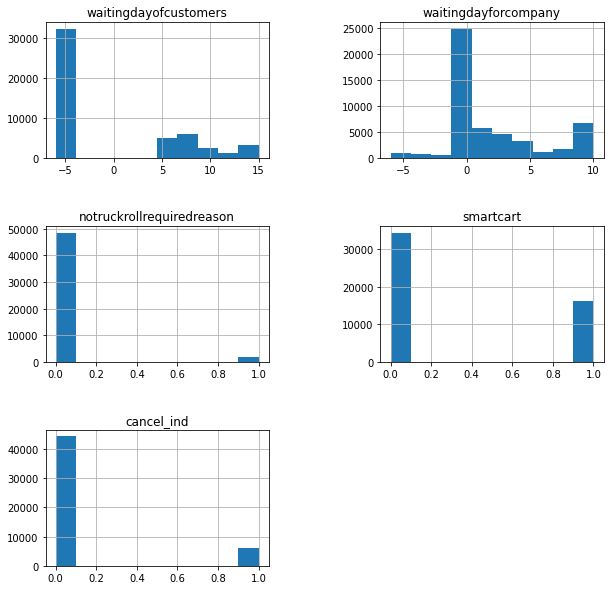

In [38]:
numeric_cols=['waitingdayofcustomers','waitingdayforcompany','notruckrollrequiredreason','smartcart','cancel_ind']
df2.hist(column=numeric_cols, figsize=(10,10))
plt.subplots_adjust(wspace=0.5, hspace=0.5)
plt.show()

In [39]:
df2.head()

,state,originalagency,speed,wirecenter,InstallType,competitorname,ContractType,salesrepid,order_create_date,endclientsystem,...,strOrderType,strIsWinbackIndicator,notruckrollrequiredreason,droptype,premisetype,ONTselfinstallcapable,saleschannel,bundlename,smartcart,cancel_ind
0,NY,REDVENT: REDVENT,FTTP_100M_100M,BREWSTER,TECH INSTALL,COMCAST,MONTHTOMONTH,A001696,2/4/18,COFEEANYWHERE,...,N,NO,0,AERIAL,SFU,N,RED VENTURES,UNKNOWN,0,0
1,MD,CSSC: CSSC,FTTP_1000M_1000M,OWEN BROWN,TECH INSTALL,COMCAST,CONTRACT,A002775,2/5/18,COA2GO,...,N,NO,0,BURIED,SFU,N,BIG BOX,1000M + TV Mundo + FDV Unlim,0,0
2,PA,ONLINE: ONLINE,FTTP_100M_100M,BRADDOCK,TECH INSTALL,COMCAST,MONTHTOMONTH,239B3PA,2/7/18,VZCOM,...,N,NO,0,AERIAL,SFU,N,ONLINE CON,UNKNOWN,1,0
3,VA,CSSC: CSSC,FTTP_1000M_1000M,DRUMMONDS CORNER,TECH INSTALL,COX COMM,CONTRACT,V660449,2/9/18,COFEEANYWHERE,...,M,NO,0,BURIED,SFU,N,CSSC,1000M + Extreme HD - 2014 + NO FDV,0,0
4,NY,ONLINE: ONLINE,FTTP_1000M_1000M,LEVITTOWN,TECH INSTALL,CABLEVISION,CONTRACT,C7962VZ,2/3/18,VZCOM,...,N,NO,0,AERIAL,SFU,N,ONLINE CON,1000M + Preferred HD 2015 + FDV Unlim,1,0


In [41]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50349 entries, 0 to 50348
Data columns (total 28 columns):
 #   Column                     Non-Null Count  Dtype   
---  ------                     --------------  -----   
 0   state                      50349 non-null  category
 1   originalagency             50349 non-null  category
 2   speed                      50349 non-null  category
 3   wirecenter                 50349 non-null  category
 4   InstallType                50349 non-null  category
 5   competitorname             50349 non-null  category
 6   ContractType               50349 non-null  category
 7   salesrepid                 50349 non-null  category
 8   order_create_date          50349 non-null  category
 9   endclientsystem            50349 non-null  category
 10  hfws_ind                   50349 non-null  category
 11  due_date                   50349 non-null  category
 12  FIRSTOFFEREDDATE           50349 non-null  category
 13  waitingdayofcustomers      5034

In [42]:
df2.columns

Index(['state', 'originalagency', 'speed', 'wirecenter', 'InstallType',
       'competitorname', 'ContractType', 'salesrepid', 'order_create_date',
       'endclientsystem', 'hfws_ind', 'due_date', 'FIRSTOFFEREDDATE',
       'waitingdayofcustomers', 'waitingdayforcompany', 'BundleType',
       'ONTRequired', 'ONTInstall', 'strOrderType', 'strIsWinbackIndicator',
       'notruckrollrequiredreason', 'droptype', 'premisetype',
       'ONTselfinstallcapable', 'saleschannel', 'bundlename', 'smartcart',
       'cancel_ind'],
      dtype='object')

In [43]:
df.salesrepid.describe()

count       50383
unique       4831
top       A001696
freq         8288
Name: salesrepid, dtype: object

In [223]:
df.info()##  object  colonları  olanları   categorik  yapmadan önce

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50591 entries, 0 to 50590
Data columns (total 32 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   mon                        50591 non-null  object 
 1   state                      50591 non-null  object 
 2   originalagency             50591 non-null  object 
 3   speed                      50591 non-null  object 
 4   wirecenter                 50583 non-null  object 
 5   InstallType                50591 non-null  object 
 6   competitorname             50535 non-null  object 
 7   ContractType               50591 non-null  object 
 8   salesrepid                 50383 non-null  object 
 9   order_create_date          50591 non-null  object 
 10  canceldate                 6170 non-null   object 
 11  endclientsystem            50412 non-null  object 
 12  hfws_ind                   2164 non-null   object 
 13  due_date                   50359 non-null  obj

In [45]:
(df2
.assign(
        state=df2.state.astype('category'),
        originalagency=df2.originalagency.astype('category'),
        speed=df2.speed.astype('category'),
        InstallType=df2.InstallType.astype('category'),
        ContractType=df2.ContractType.astype('category'),
        order_create_date=df2.order_create_date.astype('category'),
        due_date=df2.due_date.astype('category'),
        bundlename=df2.bundlename.astype('category'),
       )
 #.info()
 .memory_usage(deep=True).sum()
)

2188581

#### NÜMERİK KOLONLARIN DAĞILIMI

array([[<AxesSubplot: title={'center': 'waitingdayofcustomers'}>,
        <AxesSubplot: title={'center': 'waitingdayforcompany'}>],
       [<AxesSubplot: title={'center': 'notruckrollrequiredreason'}>,
        <AxesSubplot: title={'center': 'cancel_ind'}>]], dtype=object)

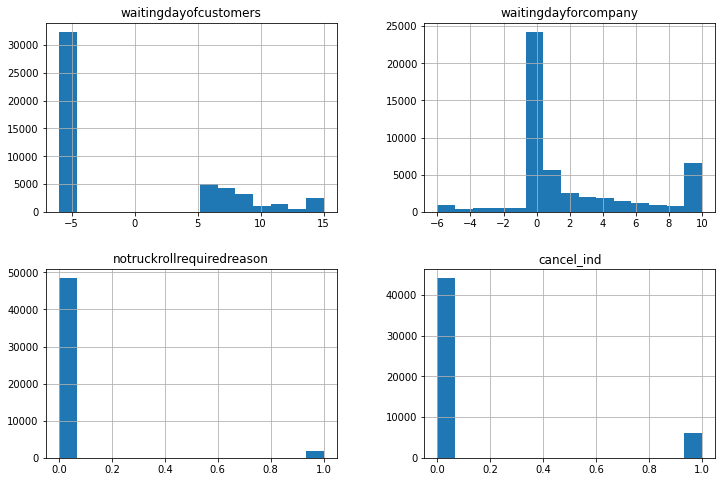

In [46]:
df2.hist(column=['waitingdayofcustomers','waitingdayforcompany','notruckrollrequiredreason','cancel_ind'], bins=15, figsize=(12,8))



#### '' cancel_ind  "  SÜTUNU   TARGET  (CHURN)   LABEL !!!  
#### - STRATİFY  UYGULANMALI.. ORANTISIZ  DAĞILIMLI !!!

In [226]:
# 
df2.cancel_ind.value_counts()  # ----  STRATİFY  UYGULANMALI.. ORANTISIZ  DAĞILIMLI !!!

0    44195
1     6154
Name: cancel_ind, dtype: int64

## Label Encoding

In [39]:
df2.info()  #  veri tipleri ayarlandı !!

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50349 entries, 0 to 50348
Data columns (total 29 columns):
 #   Column                     Non-Null Count  Dtype   
---  ------                     --------------  -----   
 0   mon                        50349 non-null  category
 1   state                      50349 non-null  category
 2   originalagency             50349 non-null  category
 3   speed                      50349 non-null  category
 4   wirecenter                 50349 non-null  category
 5   InstallType                50349 non-null  category
 6   competitorname             50349 non-null  category
 7   ContractType               50349 non-null  category
 8   salesrepid                 50349 non-null  category
 9   order_create_date          50349 non-null  category
 10  endclientsystem            50349 non-null  category
 11  hfws_ind                   50349 non-null  category
 12  due_date                   50349 non-null  category
 13  FIRSTOFFEREDDATE           5034

In [47]:
categs=['state', 'originalagency', 'speed', 'wirecenter',
       'InstallType', 'competitorname', 'ContractType', 'salesrepid',
       'order_create_date', 'endclientsystem', 'hfws_ind', 'due_date',
       'FIRSTOFFEREDDATE',
       'BundleType', 'ONTRequired', 'ONTInstall', 'strOrderType',
       'strIsWinbackIndicator', 'droptype',
       'premisetype', 'ONTselfinstallcapable', 'saleschannel', 'bundlename']
#df3=df2.copy()
#df2=pd.get_dummies(df2, columns=categs)
#df2


In [48]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import LabelEncoder

#df2[categs] = labelencoder.fit_transform(df2[categs])
#df2

for categ in categs:
    labelencoder = LabelEncoder()
    df2[categ]=labelencoder.fit_transform(df2[categ])
df2

,state,originalagency,speed,wirecenter,InstallType,competitorname,ContractType,salesrepid,order_create_date,endclientsystem,...,strOrderType,strIsWinbackIndicator,notruckrollrequiredreason,droptype,premisetype,ONTselfinstallcapable,saleschannel,bundlename,smartcart,cancel_ind
0,6,20,1,74,6,2,1,172,7,2,...,1,0,0,0,3,0,16,359,0,0
1,4,6,0,477,6,2,0,238,8,1,...,1,0,0,1,3,0,0,38,0,0
2,7,15,1,69,6,2,1,19,10,10,...,1,0,0,0,3,0,12,359,1,0
3,10,6,0,175,6,3,0,3945,12,2,...,0,0,0,1,3,0,2,26,0,0
4,6,15,0,349,6,0,0,798,6,10,...,1,0,0,0,3,0,12,33,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50344,6,6,3,79,6,7,0,398,10,2,...,0,0,0,4,0,1,4,114,0,1
50345,5,6,0,384,6,2,0,1454,8,2,...,0,0,0,1,3,0,2,24,0,0
50346,4,15,19,60,6,2,1,3174,8,15,...,1,0,0,4,0,0,2,347,0,0
50347,10,6,17,176,5,3,0,4559,1,2,...,2,2,0,10,4,2,19,295,0,1


In [49]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50349 entries, 0 to 50348
Data columns (total 28 columns):
 #   Column                     Non-Null Count  Dtype
---  ------                     --------------  -----
 0   state                      50349 non-null  int32
 1   originalagency             50349 non-null  int32
 2   speed                      50349 non-null  int32
 3   wirecenter                 50349 non-null  int32
 4   InstallType                50349 non-null  int32
 5   competitorname             50349 non-null  int32
 6   ContractType               50349 non-null  int32
 7   salesrepid                 50349 non-null  int32
 8   order_create_date          50349 non-null  int32
 9   endclientsystem            50349 non-null  int32
 10  hfws_ind                   50349 non-null  int32
 11  due_date                   50349 non-null  int32
 12  FIRSTOFFEREDDATE           50349 non-null  int32
 13  waitingdayofcustomers      50349 non-null  int8 
 14  waitingdayforcompany  

In [50]:
df2.columns

Index(['state', 'originalagency', 'speed', 'wirecenter', 'InstallType',
       'competitorname', 'ContractType', 'salesrepid', 'order_create_date',
       'endclientsystem', 'hfws_ind', 'due_date', 'FIRSTOFFEREDDATE',
       'waitingdayofcustomers', 'waitingdayforcompany', 'BundleType',
       'ONTRequired', 'ONTInstall', 'strOrderType', 'strIsWinbackIndicator',
       'notruckrollrequiredreason', 'droptype', 'premisetype',
       'ONTselfinstallcapable', 'saleschannel', 'bundlename', 'smartcart',
       'cancel_ind'],
      dtype='object')

In [51]:
df2.memory_usage(deep=True).sum()

4883981

In [65]:
#df2.to_csv('churn_kabletv3_checkk.csv')

## TARGET VECTOR  FEATURE VARİABLE 

In [61]:
X=df2.drop(columns='cancel_ind', axis=1)
y=df2['cancel_ind']


In [62]:
X1=X.copy()
y1=y.copy()

In [63]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42, stratify=y)

In [64]:
X_test

,state,originalagency,speed,wirecenter,InstallType,competitorname,ContractType,salesrepid,order_create_date,endclientsystem,...,ONTInstall,strOrderType,strIsWinbackIndicator,notruckrollrequiredreason,droptype,premisetype,ONTselfinstallcapable,saleschannel,bundlename,smartcart
22120,5,6,17,634,6,2,1,2496,8,2,...,2,2,2,0,10,4,2,19,295,0
3150,4,20,0,466,6,2,0,172,12,2,...,0,1,0,0,1,3,0,16,0,0
28368,7,6,1,449,6,2,1,114,10,1,...,1,1,0,0,4,0,0,15,359,0
48914,5,15,17,54,6,2,0,4563,2,10,...,0,0,0,0,4,0,0,12,297,0
39614,5,20,0,421,6,2,0,172,4,2,...,1,1,0,0,4,0,0,16,13,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21449,7,21,0,339,6,2,1,404,8,14,...,1,1,0,0,1,3,0,12,35,1
7456,8,6,0,491,6,3,0,1836,10,2,...,1,0,0,0,4,0,0,2,22,0
30516,6,6,0,628,6,0,0,185,5,1,...,0,1,1,0,5,0,0,4,43,0
45281,10,6,0,214,6,3,0,4002,4,2,...,1,1,0,0,1,3,0,2,24,0


#  VERİYİ MODELLEME !

### 1 - RandomForestClassifier

In [56]:
from sklearn.metrics import precision_score, recall_score
from sklearn.ensemble import RandomForestClassifier

clf = RandomForestClassifier(max_depth=23, random_state=0)
clf.fit(X_train, y_train)
y_pred=clf.predict(X_test)

print('RandomForestClassifier precision_score: {0:0.2f}'.format(precision_score(y_test, y_pred)))
print('recall scoree : {0:0.2f}'.format(recall_score(y_test, y_pred)))


RandomForestClassifier precision_score: 0.95
recall scoree : 0.42


### 2 - LogisticRegression

In [59]:
from sklearn import metrics

from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression(max_iter=10000)   
logreg.fit(X_train, y_train)
y_pred = logreg.predict(X_test)
print(metrics.recall_score(y_test, y_pred))

0.25012309207287053


### 3 - KNeighborsClassifier

In [60]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=7)
knn.fit(X_train,y_train)
y_pred = knn.predict(X_test)
print(metrics.accuracy_score(y_test, y_pred))
print(metrics.recall_score(y_test, y_pred))

0.8752407318247473
0.022648941408173313


### 4 - lightgbm

In [65]:
# build the lightgbm model
import lightgbm as lgb
clf = lgb.LGBMClassifier()
clf.fit(X_train, y_train)

# predict the results
y_pred=clf.predict(X_test)

# view accuracy
from sklearn.metrics import accuracy_score
accuracy=accuracy_score(y_pred, y_test)
print('precision_score: {0:0.3f}'.format(metrics.precision_score(y_test, y_pred)))
print('recall scoree : {0:0.3f}'.format(metrics.recall_score(y_test, y_pred)))
print('LightGBM Model accuracy score: {0:0.4f}'.format(accuracy_score(y_test, y_pred)))



precision_score: 0.906
recall scoree : 0.552
LightGBM Model accuracy score: 0.9383


###  Hyper parameter optimizataion for LightGBM  WİTH **GRİDSEARCHCV**!!  

In [715]:
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import KFold

gkf = KFold(n_splits=5, shuffle=True, random_state=42)

param_grid = {
    'num_leaves': [31, 127],
    'reg_alpha': [0.1, 0.5],
    'min_data_in_leaf': [30, 35, 100, 300, 400],
    'lambda_l1': [0, 1, 1.5],
    'lambda_l2': [0, 1]
    }

lgb_estimator = lgb.LGBMClassifier(boosting_type='gbdt',  objective='binary', num_boost_round=2000, learning_rate=0.01, metric='recall')

gsearch = GridSearchCV(estimator=clf, param_grid=param_grid, cv=gkf)
lgb_model = gsearch.fit(X_train, y_train)

print(lgb_model.best_params_, lgb_model.best_score_)

[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.1 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.1 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.1 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] min_data_in_leaf

In [ ]:
{'lambda_l1': 0, 'lambda_l2': 1, 'min_data_in_leaf': 30, 'num_leaves': 31, 'reg_alpha': 0.1} 0.9366132829879508

In [264]:
import lightgbm as lgt
#clf = lgb.LGBMClassifier()
clf3 = lgt.LGBMClassifier(is_unbalanced = True, 
                             application = 'binary', 
                             lambda_l1= 0,
                             lambda_l2= 1,
                             objective = 'binary',
                             metric ='recall',
                             num_leaves = 31,
                             #max_bin = best['max_bin'],
                             min_data_in_leaf =30,
                             reg_alpha = 0.1,
                             #min_sum_hessian_in_leaf = best['min_sum_hessian_in_leaf'],
                             #max_depth = best['max_depth'],
                             #feature_fraction = best['feature_fraction'],
                             )

In [716]:
lgb_model_final= clf3.fit(X_train, y_train)

In [717]:
preddss=lgb_model_final.predict(X_test)
# scores
print('precision_score: {0:0.3f}'.format(metrics.precision_score(y_test, preddss)))
print('recall scoree : {0:0.3f}'.format(metrics.recall_score(y_test, preddss)))
print('LightGBM Model accuracy score: {0:0.4f}'.format(accuracy_score(y_test, preddss)))

precision_score: 0.900
recall scoree : 0.543
LightGBM Model accuracy score: 0.9368


####  ---------------------  recall < 0.59 -----------------------------------

## 5 -  XGBClassifier ile deneme !!!

In [68]:

from xgboost import XGBClassifier
from sklearn.datasets import load_iris
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score, KFold

In [69]:
# Import the XGBClassifier
from xgboost import XGBClassifier
from sklearn.metrics import roc_auc_score
from sklearn import metrics


# Create xgboost classifer object
xgb = XGBClassifier()

# Train XGBoost Classifer
model_xgb = xgb.fit(X_train, y_train)


#Predict the response for test dataset
y_pred_xgb = model_xgb.predict(X_test)

# scores
print('precision_score: {0:0.3f}'.format(metrics.precision_score(y_test, y_pred_xgb)))
print('recall scoree : {0:0.3f}'.format(metrics.recall_score(y_test, y_pred_xgb)))
print('XGBoost Model accuracy score: {0:0.4f}'.format(accuracy_score(y_test, y_pred_xgb)))


precision_score: 0.875
recall scoree : 0.571
XGBoost Model accuracy score: 0.9376


## 6 -  DecisionTreeClassifier   ile deneme !!!

In [710]:
from sklearn import tree

model = tree.DecisionTreeClassifier()

model.fit(X_train, y_train)


#Predict the response for test dataset
y_pred_tree = model.predict(X_test)

# scores
print('precision_score: {0:0.3f}'.format(metrics.precision_score(y_test, y_pred_tree)))
print('recall scoree : {0:0.3f}'.format(metrics.recall_score(y_test, y_pred_tree)))
print('DecisionTreeClassifier Model accuracy score: {0:0.4f}'.format(accuracy_score(y_test, y_pred_tree)))


precision_score: 0.567
recall scoree : 0.606
XGBoost Model accuracy score: 0.8952


### Hyper parameter optimizataion for DecisionTreeClassifier  WİTH **RandomizedSearchCV**!!  

In [709]:
# Import necessary modules
from scipy.stats import randint
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import RandomizedSearchCV

# Setup the parameters and distributions to sample from: param_dist
param_dist = {"max_depth": [3, 25],
              "max_features": randint(1, 25),
              "min_samples_leaf": randint(1, 25),
              "criterion": ["gini", "entropy"]}

# Instantiate a Decision Tree classifier: tree
tree = DecisionTreeClassifier()

# Instantiate the RandomizedSearchCV object: tree_cv
tree_cv = RandomizedSearchCV(model, param_dist, cv=5)

# Fit it to the data
tree_cv.fit(X,y)
y_pred_trees = tree_cv.predict(X_test)

# scores
print('precision_score: {0:0.3f}'.format(metrics.precision_score(y_test, y_pred_trees)))
print('recall scoree : {0:0.3f}'.format(metrics.recall_score(y_test, y_pred_trees)))
print('Tuned Decision Tree accuracy score: {0:0.4f}'.format(accuracy_score(y_test, y_pred_trees)))

# Print the tuned parameters and score
print("Tuned Decision Tree Parameters: {}".format(tree_cv.best_params_))
print("Best score is {}".format(tree_cv.best_score_))

precision_score: 0.839
recall scoree : 0.375
Tuned Decision Tree accuracy score: 0.9148
Tuned Decision Tree Parameters: {'criterion': 'gini', 'max_depth': 25, 'max_features': 4, 'min_samples_leaf': 13}
Best score is 0.9143975762866805


##  DAHA İLERİ   HYPER  PARAMETER  TUNİNG   !!!
###  GÖRÜLECEĞİ GİBİ    RECALL  VALUE  VE DİĞER  METRİCLERDE   EN YÜKSEK  OLAN: XGBOOST   VE  LİGHTGBM  VAR !!;
### 1-   **XGBOOST** İLE  İLERİ HYPER  PARAMETER  TUNİNG  (RECALL=0.57)   !!!  


In [101]:
  ###   RECALL DEĞERİ VE AYNI  ZAMANDA PRECİSİON VE  ACCURACY  DEĞERLERİ  GÖZETİLDİĞİNDE EN  YÜKSEK SCORLAR
      ###     XGBOOST VE  LİGHTGBM  DE VAR..

In [313]:
%%time

#dictionary for collecting results
results_dict = {}

#obtaining default parameters by calling .fit() to XGBoost model instance
xgbc0 = xgb.XGBClassifier(objective='binary:logistic',
                          booster='gbtree',
                          eval_metric=metrics.recall_score,
                          tree_method='hist',
                          grow_policy='lossguide',
                          use_label_encoder=False)
xgbc0.fit(X_train , y_train)

#extracting default parameters from benchmark model
default_params = {}
gparams = xgbc0.get_params()

#default parameters have to be wrapped in lists - even single values - so GridSearchCV can take them as inputs
for key in gparams.keys():
    gp = gparams[key]
    default_params[key] = [gp]

#benchmark model. Grid search is not performed, since only single values are provided as parameter grid.
#However, cross-validation is still executed
clf0 = GridSearchCV(estimator=xgbc0, scoring='recall', param_grid=default_params, return_train_score=True, verbose=1, cv=3)
clf0.fit(X_train, y_train.values.ravel())

#results dataframe
df = pd.DataFrame(clf0.cv_results_)

#predictions - inputs to confusion matrix
train_predictions = clf0.predict(X_train)
test_predictions = clf0.predict(X_test)

#confusion matrices
cfm_train = confusion_matrix(y_train, train_predictions)
cfm_test = confusion_matrix(y_test, test_predictions)


#accuracy scores
accs_train = accuracy_score(y_train, train_predictions)
accs_test = accuracy_score(y_test, test_predictions)


#F1 scores for each train/test label
f1s_train_p1 = f1_score(y_train, train_predictions, pos_label=1)
f1s_train_p0 = f1_score(y_train, train_predictions, pos_label=0)
f1s_test_p1 = f1_score(y_test, test_predictions, pos_label=1)
f1s_test_p0 = f1_score(y_test, test_predictions, pos_label=0)

#Area Under the Receiver Operating Characteristic Curve
test_ras = roc_auc_score(y_test, clf0.predict_proba(X_test)[:,1])

#best parameters
bp = clf0.best_params_

#storing computed values in results dictionary
results_dict['xgbc0'] = {'iterable_parameter': np.nan,
                         'classifier': deepcopy(clf0),
                         'cv_results': df.copy(),
                         'cfm_train': cfm_train,
                         'cfm_test': cfm_test,
                         'train_accuracy': accs_train,
                         'test_accuracy': accs_test,
                         'train F1-score label 1': f1s_train_p1,
                         'train F1-score label 0': f1s_train_p0,
                         'test F1-score label 1': f1s_test_p1,
                         'test F1-score label 0': f1s_test_p0,
                         'test roc auc score': test_ras,
                         'best_params': bp}


Fitting 3 folds for each of 1 candidates, totalling 3 fits
Wall time: 2.62 s


In [314]:
#creating deepcopy of default parameters before manipulations
params = deepcopy(default_params)

#setting grid of selected parameters for iteration
param_grid = {'gamma': [0,0.1,0.2,0.4,0.8,1.1,1.3,1.6,2.4,3.2,6.4,12.8,14,17,25.6,51.2,102.4,150, 200],
              'learning_rate': [0.01,0.02,0.03,0.4,0.5,0.6, 0.06,0.7,0.9,0.1, 0.15, 0.2, 0.25, 0.300000012,0.06],
              'max_depth': [5,6,7,8,9,10,11,12,13,14,17,31],
              'n_estimators': [90,100,115,120,130,150,200,260],
              'reg_alpha': [0,0.1,0.2,0.4,0.8,1.6,3.2,6.4,12.8,25.6,51.2,102.4,200],
              'reg_lambda': [0,0.1,0.2,0.4,0.8,1.6,3.2,6.4,12.8,25.6,51.2,102.4,200]}

In [315]:
#start time
t0 = time.time()
#No. of jobs
gcvj = np.cumsum([len(x) for x in param_grid.values()])[-1]

#iteration loop. Each selected parameter iterated separately
for i,grid_key in enumerate(param_grid.keys()):
    
    #variable for measuring iteration time
    loop_start = time.time()
       
    #creating param_grid argument for GridSearchCV:
    #listing grid values of current iterable parameter and wrapping non-iterable parameter single values in list
    for param_key in params.keys():
        if param_key == grid_key:
            params[param_key] = param_grid[grid_key]
        else:
            #use best parameters of last iteration
            try:
                param_value = [clf.best_params_[param_key]]
                params[param_key] = param_value
            #use benchmark model parameters for first iteration
            except:
                param_value = [clf0.best_params_[param_key]]
                params[param_key] = param_value
    
    #classifier instance of current iteration
    xgbc = xgb.XGBClassifier(**default_params)
    
    #GridSearch instance of current iteration
    clf = GridSearchCV(estimator=xgbc, param_grid=params, scoring='recall', return_train_score=True, verbose=1, cv=3)
    clf.fit(X_train, y_train.values.ravel())
    
    #results dataframe
    df = pd.DataFrame(clf.cv_results_)
    
    #predictions - inputs to confusion matrix
    train_predictions = clf.predict(X_train)
    test_predictions = clf.predict(X_test)
    
    #confusion matrices
    cfm_train = confusion_matrix(y_train, train_predictions)
    cfm_test = confusion_matrix(y_test, test_predictions)
    
    #accuracy scores
    accs_train = accuracy_score(y_train, train_predictions)
    accs_test = accuracy_score(y_test, test_predictions)
    
    #F1 scores for each train/test label
    f1s_train_p1 = f1_score(y_train, train_predictions, pos_label=1)
    f1s_train_p0 = f1_score(y_train, train_predictions, pos_label=0)
    f1s_test_p1 = f1_score(y_test, test_predictions, pos_label=1)
    f1s_test_p0 = f1_score(y_test, test_predictions, pos_label=0)
    
    #Area Under the Receiver Operating Characteristic Curve
    test_ras = roc_auc_score(y_test, clf.predict_proba(X_test)[:,1])
    
    #best parameters
    bp = clf.best_params_
    
    #storing computed values in results dictionary
    results_dict[f'xgbc{i+1}'] = {'iterable_parameter': grid_key,
                                  'classifier': deepcopy(clf),
                                  'cv_results': df.copy(),
                                  'cfm_train': cfm_train,
                                  'cfm_test': cfm_test,
                                  'train_accuracy': accs_train,
                                  'test_accuracy': accs_test,
                                  'train F1-score label 1': f1s_train_p1,
                                  'train F1-score label 0': f1s_train_p0,
                                  'test F1-score label 1': f1s_test_p1,
                                  'test F1-score label 0': f1s_test_p0,
                                  'test roc auc score': test_ras,
                                  'best_params': bp}
    
    #variable for measuring iteration time
    elapsed_time = time.time() - loop_start
    print(f'iteration #{i+1} finished in: {elapsed_time} seconds')

#stop time
t1 = time.time()

#elapsed time
gcvt = t1 - t0

Fitting 3 folds for each of 19 candidates, totalling 57 fits
iteration #1 finished in: 18.240753412246704 seconds
Fitting 3 folds for each of 15 candidates, totalling 45 fits
iteration #2 finished in: 18.55201745033264 seconds
Fitting 3 folds for each of 12 candidates, totalling 36 fits
iteration #3 finished in: 18.635640621185303 seconds
Fitting 3 folds for each of 8 candidates, totalling 24 fits
iteration #4 finished in: 12.379286050796509 seconds
Fitting 3 folds for each of 13 candidates, totalling 39 fits
iteration #5 finished in: 16.8525550365448 seconds
Fitting 3 folds for each of 13 candidates, totalling 39 fits
iteration #6 finished in: 20.18023681640625 seconds


In [ ]:
bp

{'base_score': 0.5,
 'booster': 'gbtree',
 'callbacks': None,
 'colsample_bylevel': 1,
 'colsample_bynode': 1,
 'colsample_bytree': 1,
 'early_stopping_rounds': None,
 'enable_categorical': False,
 'eval_metric': <function sklearn.metrics._classification.recall_score(y_true, y_pred, *, labels=None, pos_label=1, average='binary', sample_weight=None, zero_division='warn')>,
 'gamma': 0,
 'gpu_id': -1,
 'grow_policy': 'lossguide',
 'importance_type': None,
 'interaction_constraints': '',
 'learning_rate': 0.9,
 'max_bin': 256,
 'max_cat_to_onehot': 4,
 'max_delta_step': 0,
 'max_depth': 5,
 'max_leaves': 0,
 'min_child_weight': 1,
 'missing': nan,
 'monotone_constraints': '()',
 'n_estimators': 260,
 'n_jobs': 0,
 'num_parallel_tree': 1,
 'objective': 'binary:logistic',
 'predictor': 'auto',
 'random_state': 0,
 'reg_alpha': 0,
 'reg_lambda': 0,
 'sampling_method': 'uniform',
 'scale_pos_weight': 1,
 'subsample': 1,
 'tree_method': 'hist',
 'use_label_encoder': False,
 'validate_parameter

###  TUNE EDİLMİŞ   XGBOOST  İLE  **CROSS-VALİDATİON** !!  

In [94]:
from sklearn.model_selection import KFold
from sklearn import metrics
from sklearn.model_selection import cross_validate


xgb_tuned_clf = XGBClassifier(**bp)


Scoring_type={'recall_score':metrics.make_scorer(metrics.recall_score),
             'precision_score':metrics.make_scorer(metrics.precision_score),
             'accuracy_score':metrics.make_scorer(metrics.accuracy_score),
             'metrics.roc_auc_score':metrics.make_scorer(metrics.roc_auc_score),
             'metrics.f1_score': metrics.make_scorer(metrics.f1_score)}
cv=KFold(n_splits=10)
cv_results=cross_validate(xgb_tuned_clf, X, y, n_jobs=-1,
                         return_train_score=False, cv=cv, scoring=Scoring_type,
                         verbose=True,return_estimator=False)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:  1.0min finished


In [203]:
cv_results

{'fit_time': array([10.42619038, 10.92330694, 11.61598253,  8.7543745 , 10.94904017,
        10.74052715, 10.38427973, 10.59512901,  9.66767812, 10.86378074]),
 'score_time': array([0.05100489, 0.05024481, 0.04018021, 0.04900193, 0.04016399,
        0.04020548, 0.04272962, 0.04015827, 0.04017782, 0.04689121]),
 'test_recall_score': array([0.5849359 , 0.58146965, 0.56521739, 0.55945122, 0.5625    ,
        0.56464812, 0.54049296, 0.57719298, 0.56778309, 0.58604651]),
 'train_recall_score': array([0.71663653, 0.72811143, 0.72443958, 0.68879593, 0.72702896,
        0.72505863, 0.71249552, 0.7256447 , 0.70417948, 0.71446724]),
 'test_precision_score': array([0.82207207, 0.84848485, 0.85876993, 0.85948478, 0.78947368,
        0.84146341, 0.83197832, 0.80835381, 0.85990338, 0.86498856]),
 'train_precision_score': array([0.97132353, 0.97175278, 0.97378736, 0.96705822, 0.97413174,
        0.97218191, 0.96954933, 0.97030651, 0.96912351, 0.97281265]),
 'test_accuracy_score': array([0.93286991, 0

In [98]:
dfcv_result=pd.DataFrame(cv_results) #testsize=0.3 ve  stratified,   XGBOOOSTT İLE
dfcv_result=dfcv_result*100
dfcv_result.describe()

,fit_time,score_time,test_recall_score,test_precision_score,test_accuracy_score,test_metrics.roc_auc_score,test_metrics.f1_score
count,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
mean,1138.636103,7.210438,58.171900,70.729260,91.950183,77.410668,63.806498
std,78.181410,0.401899,1.612244,2.800032,0.279302,0.734258,1.520793
min,1061.574697,6.397319,55.985915,65.360825,91.479643,76.426476,60.669856
25%,1100.228113,7.225657,56.832354,69.933890,91.761430,76.848959,62.766502
50%,1102.214551,7.300723,58.424929,71.034268,91.936445,77.429557,64.296654
75%,1151.685852,7.401019,58.975895,72.998911,92.159881,77.815483,64.748478
max,1278.877211,7.700634,61.378205,73.921971,92.413108,78.841449,65.470085


##### !! ( MEAN )RECALL  DEĞERİ 58.171  KULLANILAN MODELİN  FAZLA GERİSİNDE (59.24)!  DİĞER  PARAMETRELERDE BENZER SEVİYERLERDE!!
####  -- ---------------------------  **İLERLEME OLMADI** ---------------------------

## İLERİ  HYPER  PARAMETER  TUNİNG   !!!
###  2. Cİ  ADAY MODEL  OLARAK   RECALL  VALUE ORTALAMANIN ÜSTÜNDE OLAN :
### **LİGHTGBM** SEÇİLDİ (0.55)   !!!  


####  ----------------- **OPTUNA** KULLANICAZ   :
#### Optuna; hem makine öğrenimi hem de derin öğrenme algoritmaları 
#### ile uyumlu çalışabilen, etkinliği ve hızı kanıtlanmış açık kaynak kodlu optimizasyon algoritmalarından biridir.

In [329]:
import optuna  # pip install optuna
from sklearn.metrics import log_loss
from sklearn.metrics import recall_score, precision_recall_curve

from sklearn.model_selection import StratifiedKFold
import lightgbm as lgbm

def objective(trial, X, y):
    param_grid = {}  # to be filled in later
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=1121218)

    cv_scores = np.empty(5)
    for idx, (train_idx, test_idx) in enumerate(cv.split(X, y)):
        X_train, X_test = X.iloc[train_idx], X.iloc[test_idx]
        y_train, y_test = y[train_idx], y[test_idx]

        model = lgbm.LGBMClassifier(objective="binary", **param_grid)
        model.fit(
            X_train,
            y_train,
            eval_set=[(X_test, y_test)],
            eval_metric="recall_score",
            early_stopping_rounds=100,
        )
        preds = model.predict(X_test)
        cv_scores[idx] = preds

    return np.mean(cv_scores)

In [330]:
def objective(trial, X, y):
    param_grid = {
        #         "device_type": trial.suggest_categorical("device_type", ['gpu']),
        "n_estimators": trial.suggest_categorical("n_estimators", [10000]),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 1, step=0.05),
        "num_leaves": trial.suggest_int("num_leaves", 20, 3000, step=20),
        "max_depth": trial.suggest_int("max_depth", 6, 23),
        "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 100, 10000, step=50),
        "max_bin": trial.suggest_int("max_bin", 200, 300),
        "lambda_l1": trial.suggest_int("lambda_l1", 0, 100, step=5),
        "lambda_l2": trial.suggest_int("lambda_l2", 0, 100, step=5),
        "min_gain_to_split": trial.suggest_float("min_gain_to_split", 0, 15),
        "bagging_fraction": trial.suggest_float(
            "bagging_fraction", 0.2, 0.95, step=0.1
        ),
        "bagging_freq": trial.suggest_categorical("bagging_freq", [1]),
        "feature_fraction": trial.suggest_float(
            "feature_fraction", 0.2, 0.95, step=0.1
        ),
    }

In [340]:
from optuna.integration import LightGBMPruningCallback
from sklearn.model_selection import StratifiedKFold
def objective(trial, X, y):
    param_grid = {
        #         "device_type": trial.suggest_categorical("device_type", ['gpu']),
        "n_estimators": trial.suggest_categorical("n_estimators", [10000]),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 1, step=0.05),
        "num_leaves": trial.suggest_int("num_leaves", 20, 3000, step=20),
        "max_depth": trial.suggest_int("max_depth", 6, 23),
        "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 100, 10000, step=50),
        "max_bin": trial.suggest_int("max_bin", 200, 300),
        "lambda_l1": trial.suggest_int("lambda_l1", 0, 100, step=5),
        "lambda_l2": trial.suggest_int("lambda_l2", 0, 100, step=5),
        "min_gain_to_split": trial.suggest_float("min_gain_to_split", 0, 15),
        "bagging_fraction": trial.suggest_float(
            "bagging_fraction", 0.2, 0.95, step=0.1
        ),
        "bagging_freq": trial.suggest_categorical("bagging_freq", [1]),
        "feature_fraction": trial.suggest_float(
            "feature_fraction", 0.2, 0.95, step=0.1
        ),
    }

    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=1121218)

    cv_scores = np.empty(5)
    for idx, (train_idx, test_idx) in enumerate(cv.split(X, y)):
        X_train, X_test = X.iloc[train_idx], X.iloc[test_idx]
        y_train, y_test = y[train_idx], y[test_idx]

        model = lgbm.LGBMClassifier(objective="binary", **param_grid)
        model.fit(
            X_train,
            y_train,
            eval_set=[(X_test, y_test)],
            eval_metric="binary_logloss",
            early_stopping_rounds=10,
              # Add a pruning callback
        )
        preds = model.predict(X_test)
        cv_scores[idx] = metrics.recall_score(y_test, preds)
        
        #cv_scores[idx] = metrics.recall_score(y_test, preds)
        #acc = metrics.accuracy_score(preds, y_test)
        ##recall = metrics.recall_score(preds, y_test)
        #precision = metrics.precision_score(preds, y_test)
        #f1 = metrics.f1_score(preds, y_test)

   
    return np.mean(cv_scores) #,acc, f1, recall, precision

In [341]:
study = optuna.create_study(direction="maximize", study_name="LGBdM Classifier")
func = lambda trial: objective(trial, X, y)
study.optimize(func, n_trials=1000)

[I 2022-12-29 05:16:35,012] A new study created in memory with name: LGBdM Classifier
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=5200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5200
[LightGBM] [Warning] min_gain_to_split is set=5.646659465162539, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.646659465162539
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.367046
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.364116
[3]	valid_0's binary_logloss: 0.3

[I 2022-12-29 05:16:36,665] Trial 0 finished with value: 0.0 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1460, 'max_depth': 9, 'min_data_in_leaf': 5200, 'max_bin': 255, 'lambda_l1': 20, 'lambda_l2': 5, 'min_gain_to_split': 5.646659465162539, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 0 with value: 0.0.


[1]	valid_0's binary_logloss: 0.367876
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.365645
[3]	valid_0's binary_logloss: 0.365251
[4]	valid_0's binary_logloss: 0.362162
[5]	valid_0's binary_logloss: 0.361585
[6]	valid_0's binary_logloss: 0.359361
[7]	valid_0's binary_logloss: 0.358282
[8]	valid_0's binary_logloss: 0.357938
[9]	valid_0's binary_logloss: 0.357938
[10]	valid_0's binary_logloss: 0.357271
[11]	valid_0's binary_logloss: 0.357084
[12]	valid_0's binary_logloss: 0.357084
[13]	valid_0's binary_logloss: 0.357084
[14]	valid_0's binary_logloss: 0.357084
[15]	valid_0's binary_logloss: 0.357146
[16]	valid_0's binary_logloss: 0.356855
[17]	valid_0's binary_logloss: 0.356721
[18]	valid_0's binary_logloss: 0.356721
[19]	valid_0's binary_logloss: 0.356721
[20]	valid_0's binary_logloss: 0.356721
[21]	valid_0's binary_logloss: 0.356721
[22]	valid_0's binary_logloss: 0.356859
[23]	valid_0's binary_logloss: 0.356859
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.368541
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.367695
[3]	valid_0's binary_logloss: 0.367177
[4]	valid_0's binary_logloss: 0.367177
[5]	valid_0's binary_logloss: 0.367177
[6]	valid_0's binary_logloss: 0.367119
[7]	valid_0's binary_logloss: 0.367119
[8]	valid_0's binary_logloss: 0.367119
[9]	valid_0's binary_logloss: 0.367119
[10]	valid_0's binary_logloss: 0.367044
[11]	valid_0's binary_logloss: 0.367044
[12]	valid_0's binary_logloss: 0.365613
[13]	valid_0's binary_logloss: 0.365405
[14]	valid_0's binary_logloss: 0.365259
[15]	valid_0's binary_logloss: 0.365259
[16]	valid_0's binary_logloss: 0.364079
[17]	valid_0's binary_logloss: 0.36378
[18]	valid_0's binary_logloss: 0.36378
[19]	valid_0's binary_logloss: 0.36378
[20]	valid_0's binary_logloss: 0.36378
[21]	valid_0's binary_logloss: 0.36378
[22]	valid_0's binary_logloss: 0.363587
[23]	valid_0's binary_logloss: 0.363587
[24]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:16:37,875] Trial 1 finished with value: 0.0 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2980, 'max_depth': 21, 'min_data_in_leaf': 7400, 'max_bin': 277, 'lambda_l1': 85, 'lambda_l2': 0, 'min_gain_to_split': 1.9645560771035493, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 0 with value: 0.0.


[2]	valid_0's binary_logloss: 0.367722
[3]	valid_0's binary_logloss: 0.366984
[4]	valid_0's binary_logloss: 0.366984
[5]	valid_0's binary_logloss: 0.366984
[6]	valid_0's binary_logloss: 0.365871
[7]	valid_0's binary_logloss: 0.365871
[8]	valid_0's binary_logloss: 0.365871
[9]	valid_0's binary_logloss: 0.365871
[10]	valid_0's binary_logloss: 0.365583
[11]	valid_0's binary_logloss: 0.365583
[12]	valid_0's binary_logloss: 0.365023
[13]	valid_0's binary_logloss: 0.365023
[14]	valid_0's binary_logloss: 0.365023
[15]	valid_0's binary_logloss: 0.365023
[16]	valid_0's binary_logloss: 0.365023
[17]	valid_0's binary_logloss: 0.365023
[18]	valid_0's binary_logloss: 0.365023
[19]	valid_0's binary_logloss: 0.365023
[20]	valid_0's binary_logloss: 0.365023
[21]	valid_0's binary_logloss: 0.365023
[22]	valid_0's binary_logloss: 0.365023
Early stopping, best iteration is:
[12]	valid_0's binary_logloss: 0.365023
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Curre

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.370348
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.367372
[3]	valid_0's binary_logloss: 0.367372
[4]	valid_0's binary_logloss: 0.366611
[5]	valid_0's binary_logloss: 0.366611
[6]	valid_0's binary_logloss: 0.366893
[7]	valid_0's binary_logloss: 0.366891
[8]	valid_0's binary_logloss: 0.366731
[9]	valid_0's binary_logloss: 0.366731
[10]	valid_0's binary_logloss: 0.366731
[11]	valid_0's binary_logloss: 0.366731
[12]	valid_0's binary_logloss: 0.366731
[13]	valid_0's binary_logloss: 0.3663
[14]	valid_0's binary_logloss: 0.3663
[15]	valid_0's binary_logloss: 0.3663
[16]	valid_0's binary_logloss: 0.365979
[17]	valid_0's binary_logloss: 0.365979
[18]	valid_0's binary_logloss: 0.365979
[19]	valid_0's binary_logloss: 0.365979
[20]	valid_0's binary_logloss: 0.365979
[21]	valid_0's binary_logloss: 0.365823
[22]	valid_0's binary_logloss: 0.365823
[23]	valid_0's binary_logloss: 0.365533
[24]	valid_0's binary_logloss: 0.3

[I 2022-12-29 05:16:38,997] Trial 2 finished with value: 0.0 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 1920, 'max_depth': 18, 'min_data_in_leaf': 5200, 'max_bin': 207, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 7.646592402673918, 'bagging_fraction': 0.30000000000000004, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 0 with value: 0.0.


[1]	valid_0's binary_logloss: 0.37015
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.368396
[3]	valid_0's binary_logloss: 0.368396
[4]	valid_0's binary_logloss: 0.36627
[5]	valid_0's binary_logloss: 0.366424
[6]	valid_0's binary_logloss: 0.366327
[7]	valid_0's binary_logloss: 0.366327
[8]	valid_0's binary_logloss: 0.365857
[9]	valid_0's binary_logloss: 0.364983
[10]	valid_0's binary_logloss: 0.364983
[11]	valid_0's binary_logloss: 0.364983
[12]	valid_0's binary_logloss: 0.364983
[13]	valid_0's binary_logloss: 0.364983
[14]	valid_0's binary_logloss: 0.364983
[15]	valid_0's binary_logloss: 0.364983
[16]	valid_0's binary_logloss: 0.364983
[17]	valid_0's binary_logloss: 0.364983
[18]	valid_0's binary_logloss: 0.364983
[19]	valid_0's binary_logloss: 0.364983
Early stopping, best iteration is:
[9]	valid_0's binary_logloss: 0.364983
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fract

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[2]	valid_0's binary_logloss: 0.501224
[3]	valid_0's binary_logloss: 0.501224
[4]	valid_0's binary_logloss: 0.501224
[5]	valid_0's binary_logloss: 0.501224
[6]	valid_0's binary_logloss: 0.501224
[7]	valid_0's binary_logloss: 0.501224
[8]	valid_0's binary_logloss: 0.501224
[9]	valid_0's binary_logloss: 0.501224
[10]	valid_0's binary_logloss: 0.501224
[11]	valid_0's binary_logloss: 0.501224
Early stopping, best iteration is:
[1]	valid_0's binary_logloss: 0.501224
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.2
[LightGBM] [Warning] min_data_in_leaf is set=8600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8600
[LightGBM] [Warning] min_gain_to_split is set=14.210858395238144, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.210858395238144
[LightGBM] [Warning] lambda_l1 is set=100, reg_alpha=0.0 will be ignored. Current value: lambda_l1=100
[LightGBM] [Warning] baggin

[I 2022-12-29 05:16:39,742] Trial 3 finished with value: 0.0 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 700, 'max_depth': 19, 'min_data_in_leaf': 8600, 'max_bin': 244, 'lambda_l1': 100, 'lambda_l2': 50, 'min_gain_to_split': 14.210858395238144, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 0 with value: 0.0.


[1]	valid_0's binary_logloss: 0.501224
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.501224
[3]	valid_0's binary_logloss: 0.501224
[4]	valid_0's binary_logloss: 0.501224
[5]	valid_0's binary_logloss: 0.501224
[6]	valid_0's binary_logloss: 0.501224
[7]	valid_0's binary_logloss: 0.501224
[8]	valid_0's binary_logloss: 0.501224
[9]	valid_0's binary_logloss: 0.501224
[10]	valid_0's binary_logloss: 0.501224
[11]	valid_0's binary_logloss: 0.501224
Early stopping, best iteration is:
[1]	valid_0's binary_logloss: 0.501224
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.2
[LightGBM] [Warning] min_data_in_leaf is set=8600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8600
[LightGBM] [Warning] min_gain_to_split is set=14.210858395238144, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.210858395238144
[LightGBM] [Warning] lambda_l1

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(



[LightGBM] [Warning] min_data_in_leaf is set=3500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3500
[LightGBM] [Warning] min_gain_to_split is set=6.257787172691825, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=6.257787172691825
[LightGBM] [Warning] lambda_l1 is set=75, reg_alpha=0.0 will be ignored. Current value: lambda_l1=75
[LightGBM] [Warning] bagging_fraction is set=0.30000000000000004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.30000000000000004
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.369174
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.367427
[3]	valid_0's binary_logloss: 0.366034
[4]	valid_0's binary_logloss: 0.365326
[5]	valid_0's binary_logloss: 0.365326
[6]	val

[I 2022-12-29 05:16:40,863] Trial 4 finished with value: 0.0 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 1420, 'max_depth': 13, 'min_data_in_leaf': 3500, 'max_bin': 278, 'lambda_l1': 75, 'lambda_l2': 0, 'min_gain_to_split': 6.257787172691825, 'bagging_fraction': 0.30000000000000004, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 0 with value: 0.0.


Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.368023
[3]	valid_0's binary_logloss: 0.366002
[4]	valid_0's binary_logloss: 0.365321
[5]	valid_0's binary_logloss: 0.364675
[6]	valid_0's binary_logloss: 0.363513
[7]	valid_0's binary_logloss: 0.363341
[8]	valid_0's binary_logloss: 0.362884
[9]	valid_0's binary_logloss: 0.362884
[10]	valid_0's binary_logloss: 0.362884
[11]	valid_0's binary_logloss: 0.362884
[12]	valid_0's binary_logloss: 0.362884
[13]	valid_0's binary_logloss: 0.362382
[14]	valid_0's binary_logloss: 0.362382
[15]	valid_0's binary_logloss: 0.362382
[16]	valid_0's binary_logloss: 0.362382
[17]	valid_0's binary_logloss: 0.362382
[18]	valid_0's binary_logloss: 0.362382
[19]	valid_0's binary_logloss: 0.362382
[20]	valid_0's binary_logloss: 0.362382
[21]	valid_0's binary_logloss: 0.362382
[22]	valid_0's binary_logloss: 0.362382
[23]	valid_0's binary_logloss: 0.362382
Early stopping, best iteration is:
[13]	valid_0's binary_logloss: 0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.369451
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.367466
[3]	valid_0's binary_logloss: 0.367203
[4]	valid_0's binary_logloss: 0.366388
[5]	valid_0's binary_logloss: 0.365513
[6]	valid_0's binary_logloss: 0.365472
[7]	valid_0's binary_logloss: 0.365432
[8]	valid_0's binary_logloss: 0.364944
[9]	valid_0's binary_logloss: 0.364328
[10]	valid_0's binary_logloss: 0.364027
[11]	valid_0's binary_logloss: 0.363921
[12]	valid_0's binary_logloss: 0.362883
[13]	valid_0's binary_logloss: 0.362659
[14]	valid_0's binary_logloss: 0.361778
[15]	valid_0's binary_logloss: 0.361778
[16]	valid_0's binary_logloss: 0.361373
[17]	valid_0's binary_logloss: 0.361224
[18]	valid_0's binary_logloss: 0.360917
[19]	valid_0's binary_logloss: 0.360917
[20]	valid_0's binary_logloss: 0.360577
[21]	valid_0's binary_logloss: 0.360577
[22]	valid_0's binary_logloss: 0.360454
[23]	valid_0's binary_logloss: 0.360454
[24]	valid_0's binary_loglos

[I 2022-12-29 05:16:42,061] Trial 5 finished with value: 0.0 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 1280, 'max_depth': 14, 'min_data_in_leaf': 8550, 'max_bin': 252, 'lambda_l1': 5, 'lambda_l2': 85, 'min_gain_to_split': 11.747069722335704, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 0 with value: 0.0.


[1]	valid_0's binary_logloss: 0.369733
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.367675
[3]	valid_0's binary_logloss: 0.367609
[4]	valid_0's binary_logloss: 0.366134
[5]	valid_0's binary_logloss: 0.365212
[6]	valid_0's binary_logloss: 0.364934
[7]	valid_0's binary_logloss: 0.364603
[8]	valid_0's binary_logloss: 0.364508
[9]	valid_0's binary_logloss: 0.364508
[10]	valid_0's binary_logloss: 0.364228
[11]	valid_0's binary_logloss: 0.363979
[12]	valid_0's binary_logloss: 0.362885
[13]	valid_0's binary_logloss: 0.362361
[14]	valid_0's binary_logloss: 0.361444
[15]	valid_0's binary_logloss: 0.361444
[16]	valid_0's binary_logloss: 0.360994
[17]	valid_0's binary_logloss: 0.360602
[18]	valid_0's binary_logloss: 0.360329
[19]	valid_0's binary_logloss: 0.360329
[20]	valid_0's binary_logloss: 0.360329
[21]	valid_0's binary_logloss: 0.360329
[22]	valid_0's binary_logloss: 0.360054
[23]	valid_0's binary_logloss: 0.360054
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.338596
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.329105
[3]	valid_0's binary_logloss: 0.318931
[4]	valid_0's binary_logloss: 0.310686
[5]	valid_0's binary_logloss: 0.298167
[6]	valid_0's binary_logloss: 0.296845
[7]	valid_0's binary_logloss: 0.271424
[8]	valid_0's binary_logloss: 0.253515
[9]	valid_0's binary_logloss: 0.243431
[10]	valid_0's binary_logloss: 0.243365
[11]	valid_0's binary_logloss: 0.238052
[12]	valid_0's binary_logloss: 0.236361
[13]	valid_0's binary_logloss: 0.234783
[14]	valid_0's binary_logloss: 0.233659
[15]	valid_0's binary_logloss: 0.232991
[16]	valid_0's binary_logloss: 0.232681
[17]	valid_0's binary_logloss: 0.232477
[18]	valid_0's binary_logloss: 0.232477
[19]	valid_0's binary_logloss: 0.232477
[20]	valid_0's binary_logloss: 0.232477
[21]	valid_0's binary_logloss: 0.232462
[22]	valid_0's binary_logloss: 0.232338
[23]	valid_0's binary_logloss: 0.232338
[24]	valid_0's binary_loglos

[I 2022-12-29 05:16:43,278] Trial 6 finished with value: 0.34790249186001204 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 820, 'max_depth': 12, 'min_data_in_leaf': 2150, 'max_bin': 209, 'lambda_l1': 65, 'lambda_l2': 95, 'min_gain_to_split': 2.794023655906602, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 6 with value: 0.34790249186001204.


[1]	valid_0's binary_logloss: 0.33551
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.326121
[3]	valid_0's binary_logloss: 0.31723
[4]	valid_0's binary_logloss: 0.302147
[5]	valid_0's binary_logloss: 0.275115
[6]	valid_0's binary_logloss: 0.274574
[7]	valid_0's binary_logloss: 0.256855
[8]	valid_0's binary_logloss: 0.246823
[9]	valid_0's binary_logloss: 0.241701
[10]	valid_0's binary_logloss: 0.241341
[11]	valid_0's binary_logloss: 0.238967
[12]	valid_0's binary_logloss: 0.236457
[13]	valid_0's binary_logloss: 0.23589
[14]	valid_0's binary_logloss: 0.235389
[15]	valid_0's binary_logloss: 0.231703
[16]	valid_0's binary_logloss: 0.231703
[17]	valid_0's binary_logloss: 0.231521
[18]	valid_0's binary_logloss: 0.230719
[19]	valid_0's binary_logloss: 0.230719
[20]	valid_0's binary_logloss: 0.230719
[21]	valid_0's binary_logloss: 0.230383
[22]	valid_0's binary_logloss: 0.230383
[23]	valid_0's binary_logloss: 0.230383
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.344701
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.337378
[3]	valid_0's binary_logloss: 0.333373
[4]	valid_0's binary_logloss: 0.328653
[5]	valid_0's binary_logloss: 0.324894
[6]	valid_0's binary_logloss: 0.323867
[7]	valid_0's binary_logloss: 0.323867
[8]	valid_0's binary_logloss: 0.323074
[9]	valid_0's binary_logloss: 0.323074
[10]	valid_0's binary_logloss: 0.323074
[11]	valid_0's binary_logloss: 0.316605
[12]	valid_0's binary_logloss: 0.314817
[13]	valid_0's binary_logloss: 0.314131
[14]	valid_0's binary_logloss: 0.314131
[15]	valid_0's binary_logloss: 0.314131
[16]	valid_0's binary_logloss: 0.314131
[17]	valid_0's binary_logloss: 0.314131
[18]	valid_0's binary_logloss: 0.314131
[19]	valid_0's binary_logloss: 0.313339
[20]	valid_0's binary_logloss: 0.313339
[21]	valid_0's binary_logloss: 0.313339
[22]	valid_0's binary_logloss: 0.313339
[23]	valid_0's binary_logloss: 0.3122
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:16:44,855] Trial 7 finished with value: 0.10789575531823556 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2560, 'max_depth': 16, 'min_data_in_leaf': 3600, 'max_bin': 242, 'lambda_l1': 65, 'lambda_l2': 65, 'min_gain_to_split': 10.063828669379738, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 6 with value: 0.34790249186001204.


[2]	valid_0's binary_logloss: 0.336651
[3]	valid_0's binary_logloss: 0.330931
[4]	valid_0's binary_logloss: 0.328661
[5]	valid_0's binary_logloss: 0.328186
[6]	valid_0's binary_logloss: 0.326319
[7]	valid_0's binary_logloss: 0.325935
[8]	valid_0's binary_logloss: 0.323714
[9]	valid_0's binary_logloss: 0.323714
[10]	valid_0's binary_logloss: 0.323168
[11]	valid_0's binary_logloss: 0.319522
[12]	valid_0's binary_logloss: 0.318126
[13]	valid_0's binary_logloss: 0.318126
[14]	valid_0's binary_logloss: 0.318126
[15]	valid_0's binary_logloss: 0.318126
[16]	valid_0's binary_logloss: 0.318126
[17]	valid_0's binary_logloss: 0.318126
[18]	valid_0's binary_logloss: 0.318126
[19]	valid_0's binary_logloss: 0.318126
[20]	valid_0's binary_logloss: 0.318126
[21]	valid_0's binary_logloss: 0.318126
[22]	valid_0's binary_logloss: 0.318126
Early stopping, best iteration is:
[12]	valid_0's binary_logloss: 0.318126
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Curre

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.3697
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.368156
[3]	valid_0's binary_logloss: 0.367602
[4]	valid_0's binary_logloss: 0.36692
[5]	valid_0's binary_logloss: 0.366339
[6]	valid_0's binary_logloss: 0.366112
[7]	valid_0's binary_logloss: 0.36518
[8]	valid_0's binary_logloss: 0.364765
[9]	valid_0's binary_logloss: 0.364765
[10]	valid_0's binary_logloss: 0.364458
[11]	valid_0's binary_logloss: 0.364458
[12]	valid_0's binary_logloss: 0.364191
[13]	valid_0's binary_logloss: 0.364191
[14]	valid_0's binary_logloss: 0.364191
[15]	valid_0's binary_logloss: 0.364191
[16]	valid_0's binary_logloss: 0.364191
[17]	valid_0's binary_logloss: 0.364191
[18]	valid_0's binary_logloss: 0.364191
[19]	valid_0's binary_logloss: 0.364191
[20]	valid_0's binary_logloss: 0.364191
[21]	valid_0's binary_logloss: 0.364191
[22]	valid_0's binary_logloss: 0.363939
[23]	valid_0's binary_logloss: 0.363939
[24]	valid_0's binary_logloss: 0

[I 2022-12-29 05:16:46,201] Trial 8 finished with value: 0.0 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 1520, 'max_depth': 11, 'min_data_in_leaf': 6500, 'max_bin': 227, 'lambda_l1': 100, 'lambda_l2': 40, 'min_gain_to_split': 4.167889397763078, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 6 with value: 0.34790249186001204.


[2]	valid_0's binary_logloss: 0.368295
[3]	valid_0's binary_logloss: 0.367723
[4]	valid_0's binary_logloss: 0.366555
[5]	valid_0's binary_logloss: 0.36629
[6]	valid_0's binary_logloss: 0.366123
[7]	valid_0's binary_logloss: 0.365418
[8]	valid_0's binary_logloss: 0.365005
[9]	valid_0's binary_logloss: 0.365005
[10]	valid_0's binary_logloss: 0.364818
[11]	valid_0's binary_logloss: 0.364818
[12]	valid_0's binary_logloss: 0.364535
[13]	valid_0's binary_logloss: 0.364535
[14]	valid_0's binary_logloss: 0.364535
[15]	valid_0's binary_logloss: 0.364535
[16]	valid_0's binary_logloss: 0.364535
[17]	valid_0's binary_logloss: 0.364535
[18]	valid_0's binary_logloss: 0.364535
[19]	valid_0's binary_logloss: 0.364535
[20]	valid_0's binary_logloss: 0.364535
[21]	valid_0's binary_logloss: 0.364247
[22]	valid_0's binary_logloss: 0.364247
[23]	valid_0's binary_logloss: 0.364247
[24]	valid_0's binary_logloss: 0.364247
[25]	valid_0's binary_logloss: 0.363666
[26]	valid_0's binary_logloss: 0.363481
[27]	vali

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(



[LightGBM] [Warning] min_data_in_leaf is set=5550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5550
[LightGBM] [Warning] min_gain_to_split is set=4.492678395325131, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.492678395325131
[LightGBM] [Warning] lambda_l1 is set=100, reg_alpha=0.0 will be ignored. Current value: lambda_l1=100
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.368749
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.366629
[3]	valid_0's binary_logloss: 0.366629
[4]	valid_0's binary_logloss: 0.365801
[5]	valid_0's binary_logloss: 0.364181
[6]	valid_0's binary_logloss: 0.364

[I 2022-12-29 05:16:47,425] Trial 9 finished with value: 0.0 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 700, 'max_depth': 16, 'min_data_in_leaf': 5550, 'max_bin': 290, 'lambda_l1': 100, 'lambda_l2': 70, 'min_gain_to_split': 4.492678395325131, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 6 with value: 0.34790249186001204.


[1]	valid_0's binary_logloss: 0.368711
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.367179
[3]	valid_0's binary_logloss: 0.367179
[4]	valid_0's binary_logloss: 0.365624
[5]	valid_0's binary_logloss: 0.364164
[6]	valid_0's binary_logloss: 0.362901
[7]	valid_0's binary_logloss: 0.361973
[8]	valid_0's binary_logloss: 0.361569
[9]	valid_0's binary_logloss: 0.361569
[10]	valid_0's binary_logloss: 0.361262
[11]	valid_0's binary_logloss: 0.361262
[12]	valid_0's binary_logloss: 0.361262
[13]	valid_0's binary_logloss: 0.361262
[14]	valid_0's binary_logloss: 0.360598
[15]	valid_0's binary_logloss: 0.360598
[16]	valid_0's binary_logloss: 0.360598
[17]	valid_0's binary_logloss: 0.360598
[18]	valid_0's binary_logloss: 0.360465
[19]	valid_0's binary_logloss: 0.360465
[20]	valid_0's binary_logloss: 0.360465
[21]	valid_0's binary_logloss: 0.360068
[22]	valid_0's binary_logloss: 0.360068
[23]	valid_0's binary_logloss: 0.360068
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=150
[LightGBM] [Warning] min_gain_to_split is set=0.8489853162088892, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8489853162088892
[LightGBM] [Warning] lambda_l1 is set=45, reg_alpha=0.0 will be ignored. Current value: lambda_l1=45
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=100, reg_lambda=0.0 will be ignored. Current value: lambda_l2=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.371167
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.368539
[3]	valid_0's binary_logloss: 0.366259
[4]	valid_0's binary_logloss: 0.363774
[5]	valid_0's binary_logloss: 0.361377
[6]	valid_0's binary_logloss: 0.3611

[I 2022-12-29 05:17:25,457] Trial 10 finished with value: 0.4260630196878735 and parameters: {'n_estimators': 10000, 'learning_rate': 0.01, 'num_leaves': 20, 'max_depth': 6, 'min_data_in_leaf': 150, 'max_bin': 200, 'lambda_l1': 45, 'lambda_l2': 100, 'min_gain_to_split': 0.8489853162088892, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 10 with value: 0.4260630196878735.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=0.7376743676174403, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7376743676174403
[LightGBM] [Warning] lambda_l1 is set=45, reg_alpha=0.0 will be ignored. Current value: lambda_l1=45
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=100, reg_lambda=0.0 will be ignored. Current value: lambda_l2=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.37117
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.368544
[3]	valid_0's binary_logloss: 

[I 2022-12-29 05:18:09,725] Trial 11 finished with value: 0.4314247785857225 and parameters: {'n_estimators': 10000, 'learning_rate': 0.01, 'num_leaves': 340, 'max_depth': 6, 'min_data_in_leaf': 350, 'max_bin': 203, 'lambda_l1': 45, 'lambda_l2': 100, 'min_gain_to_split': 0.7376743676174403, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 11 with value: 0.4314247785857225.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=0.034348296599719386, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.034348296599719386
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.371174
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.368493
[3]	valid_0's binary_loglos

[I 2022-12-29 05:19:29,130] Trial 12 finished with value: 0.480173036661317 and parameters: {'n_estimators': 10000, 'learning_rate': 0.01, 'num_leaves': 20, 'max_depth': 6, 'min_data_in_leaf': 500, 'max_bin': 219, 'lambda_l1': 40, 'lambda_l2': 95, 'min_gain_to_split': 0.034348296599719386, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 12 with value: 0.480173036661317.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.03140093983958527, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.03140093983958527
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.371154
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.368338
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:20:59,431] Trial 13 finished with value: 0.4814731892241749 and parameters: {'n_estimators': 10000, 'learning_rate': 0.01, 'num_leaves': 40, 'max_depth': 6, 'min_data_in_leaf': 300, 'max_bin': 221, 'lambda_l1': 40, 'lambda_l2': 80, 'min_gain_to_split': 0.03140093983958527, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 13 with value: 0.4814731892241749.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1600
[LightGBM] [Warning] min_gain_to_split is set=0.37908678547703917, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.37908678547703917
[LightGBM] [Warning] lambda_l1 is set=30, reg_alpha=0.0 will be ignored. Current value: lambda_l1=30
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.326733
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.324758
[3]	valid_0's binary_loglos

[I 2022-12-29 05:21:05,313] Trial 14 finished with value: 0.45579600166432205 and parameters: {'n_estimators': 10000, 'learning_rate': 0.21000000000000002, 'num_leaves': 80, 'max_depth': 9, 'min_data_in_leaf': 1600, 'max_bin': 227, 'lambda_l1': 30, 'lambda_l2': 75, 'min_gain_to_split': 0.37908678547703917, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 13 with value: 0.4814731892241749.



[132]	valid_0's binary_logloss: 0.202387
[133]	valid_0's binary_logloss: 0.202387
[134]	valid_0's binary_logloss: 0.202387
[135]	valid_0's binary_logloss: 0.202387
Early stopping, best iteration is:
[125]	valid_0's binary_logloss: 0.202359
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=2050, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2050
[LightGBM] [Warning] min_gain_to_split is set=2.972580089183605, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.972580089183605
[LightGBM] [Warning] lambda_l1 is set=30, reg_alpha=0.0 will be ignored. Current value: lambda_l1=30
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=85, reg_lambda=0.0 will be ignored. Current value: lambda_l2=85
[LightG

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.35695
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.349086
[3]	valid_0's binary_logloss: 0.34692
[4]	valid_0's binary_logloss: 0.34456
[5]	valid_0's binary_logloss: 0.343015
[6]	valid_0's binary_logloss: 0.341546
[7]	valid_0's binary_logloss: 0.340831
[8]	valid_0's binary_logloss: 0.339951
[9]	valid_0's binary_logloss: 0.338627
[10]	valid_0's binary_logloss: 0.337517
[11]	valid_0's binary_logloss: 0.308246
[12]	valid_0's binary_logloss: 0.287207
[13]	valid_0's binary_logloss: 0.273246
[14]	valid_0's binary_logloss: 0.262939
[15]	valid_0's binary_logloss: 0.255317
[16]	valid_0's binary_logloss: 0.249478
[17]	valid_0's binary_logloss: 0.244259
[18]	valid_0's binary_logloss: 0.2405
[19]	valid_0's binary_logloss: 0.237534
[20]	valid_0's binary_logloss: 0.237092
[21]	valid_0's binary_logloss: 0.234818
[22]	valid_0's binary_logloss: 0.234717
[23]	valid_0's binary_logloss: 0.23354
[24]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:21:08,018] Trial 15 finished with value: 0.34952639469530355 and parameters: {'n_estimators': 10000, 'learning_rate': 0.21000000000000002, 'num_leaves': 340, 'max_depth': 8, 'min_data_in_leaf': 2050, 'max_bin': 222, 'lambda_l1': 30, 'lambda_l2': 85, 'min_gain_to_split': 2.972580089183605, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 13 with value: 0.4814731892241749.


[64]	valid_0's binary_logloss: 0.217587
[65]	valid_0's binary_logloss: 0.216735
[66]	valid_0's binary_logloss: 0.216735
[67]	valid_0's binary_logloss: 0.216712
[68]	valid_0's binary_logloss: 0.216712
[69]	valid_0's binary_logloss: 0.216712
[70]	valid_0's binary_logloss: 0.216697
[71]	valid_0's binary_logloss: 0.216697
[72]	valid_0's binary_logloss: 0.216697
[73]	valid_0's binary_logloss: 0.216697
[74]	valid_0's binary_logloss: 0.216697
[75]	valid_0's binary_logloss: 0.216697
[76]	valid_0's binary_logloss: 0.216623
[77]	valid_0's binary_logloss: 0.216623
[78]	valid_0's binary_logloss: 0.216623
[79]	valid_0's binary_logloss: 0.216623
[80]	valid_0's binary_logloss: 0.216623
[81]	valid_0's binary_logloss: 0.216623
[82]	valid_0's binary_logloss: 0.216623
[83]	valid_0's binary_logloss: 0.216623
[84]	valid_0's binary_logloss: 0.216623
[85]	valid_0's binary_logloss: 0.216623
[86]	valid_0's binary_logloss: 0.216623
Early stopping, best iteration is:
[76]	valid_0's binary_logloss: 0.216623
[Ligh

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.354802
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.348451
[3]	valid_0's binary_logloss: 0.340286
[4]	valid_0's binary_logloss: 0.33603
[5]	valid_0's binary_logloss: 0.330456
[6]	valid_0's binary_logloss: 0.32463
[7]	valid_0's binary_logloss: 0.321582
[8]	valid_0's binary_logloss: 0.319369
[9]	valid_0's binary_logloss: 0.312042
[10]	valid_0's binary_logloss: 0.311078
[11]	valid_0's binary_logloss: 0.309419
[12]	valid_0's binary_logloss: 0.304701
[13]	valid_0's binary_logloss: 0.303365
[14]	valid_0's binary_logloss: 0.302067
[15]	valid_0's binary_logloss: 0.298784
[16]	valid_0's binary_logloss: 0.297688
[17]	valid_0's binary_logloss: 0.296712
[18]	valid_0's binary_logloss: 0.296009
[19]	valid_0's binary_logloss: 0.284305
[20]	valid_0's binary_logloss: 0.275398
[21]	valid_0's binary_logloss: 0.268594
[22]	valid_0's binary_logloss: 0.268251
[23]	valid_0's binary_logloss: 0.263133
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:21:09,476] Trial 16 finished with value: 0.3423786596923646 and parameters: {'n_estimators': 10000, 'learning_rate': 0.16000000000000003, 'num_leaves': 460, 'max_depth': 23, 'min_data_in_leaf': 3500, 'max_bin': 220, 'lambda_l1': 55, 'lambda_l2': 50, 'min_gain_to_split': 7.7249236394504734, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 13 with value: 0.4814731892241749.


[1]	valid_0's binary_logloss: 0.354547
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.348605
[3]	valid_0's binary_logloss: 0.343306
[4]	valid_0's binary_logloss: 0.334848
[5]	valid_0's binary_logloss: 0.329827
[6]	valid_0's binary_logloss: 0.32406
[7]	valid_0's binary_logloss: 0.320991
[8]	valid_0's binary_logloss: 0.318876
[9]	valid_0's binary_logloss: 0.317393
[10]	valid_0's binary_logloss: 0.31078
[11]	valid_0's binary_logloss: 0.305923
[12]	valid_0's binary_logloss: 0.302479
[13]	valid_0's binary_logloss: 0.289197
[14]	valid_0's binary_logloss: 0.280309
[15]	valid_0's binary_logloss: 0.273529
[16]	valid_0's binary_logloss: 0.268183
[17]	valid_0's binary_logloss: 0.263999
[18]	valid_0's binary_logloss: 0.260681
[19]	valid_0's binary_logloss: 0.258096
[20]	valid_0's binary_logloss: 0.255849
[21]	valid_0's binary_logloss: 0.253845
[22]	valid_0's binary_logloss: 0.253508
[23]	valid_0's binary_logloss: 0.251925
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1100
[LightGBM] [Warning] min_gain_to_split is set=0.09955728396566195, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.09955728396566195
[LightGBM] [Warning] lambda_l1 is set=30, reg_alpha=0.0 will be ignored. Current value: lambda_l1=30
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.368958
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.3342

[I 2022-12-29 05:21:15,486] Trial 17 finished with value: 0.48147358549133823 and parameters: {'n_estimators': 10000, 'learning_rate': 0.11, 'num_leaves': 1040, 'max_depth': 8, 'min_data_in_leaf': 1100, 'max_bin': 234, 'lambda_l1': 30, 'lambda_l2': 30, 'min_gain_to_split': 0.09955728396566195, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 17 with value: 0.48147358549133823.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1550
[LightGBM] [Warning] min_gain_to_split is set=9.735369830166011, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=9.735369830166011
[LightGBM] [Warning] lambda_l1 is set=30, reg_alpha=0.0 will be ignored. Current value: lambda_l1=30
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.336317
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.334415
[

[I 2022-12-29 05:21:16,714] Trial 18 finished with value: 0.346439473493029 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 1060, 'max_depth': 10, 'min_data_in_leaf': 1550, 'max_bin': 238, 'lambda_l1': 30, 'lambda_l2': 30, 'min_gain_to_split': 9.735369830166011, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 17 with value: 0.48147358549133823.


[2]	valid_0's binary_logloss: 0.331626
[3]	valid_0's binary_logloss: 0.277734
[4]	valid_0's binary_logloss: 0.25902
[5]	valid_0's binary_logloss: 0.246352
[6]	valid_0's binary_logloss: 0.245917
[7]	valid_0's binary_logloss: 0.236115
[8]	valid_0's binary_logloss: 0.235175
[9]	valid_0's binary_logloss: 0.228898
[10]	valid_0's binary_logloss: 0.225002
[11]	valid_0's binary_logloss: 0.222302
[12]	valid_0's binary_logloss: 0.21804
[13]	valid_0's binary_logloss: 0.217006
[14]	valid_0's binary_logloss: 0.216905
[15]	valid_0's binary_logloss: 0.216048
[16]	valid_0's binary_logloss: 0.215893
[17]	valid_0's binary_logloss: 0.215893
[18]	valid_0's binary_logloss: 0.215893
[19]	valid_0's binary_logloss: 0.215893
[20]	valid_0's binary_logloss: 0.215893
[21]	valid_0's binary_logloss: 0.215893
[22]	valid_0's binary_logloss: 0.215893
[23]	valid_0's binary_logloss: 0.215893
[24]	valid_0's binary_logloss: 0.215893
[25]	valid_0's binary_logloss: 0.215893
[26]	valid_0's binary_logloss: 0.215893
Early stop

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.35792
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.35294
[3]	valid_0's binary_logloss: 0.345913
[4]	valid_0's binary_logloss: 0.339974
[5]	valid_0's binary_logloss: 0.335145
[6]	valid_0's binary_logloss: 0.334025
[7]	valid_0's binary_logloss: 0.328728
[8]	valid_0's binary_logloss: 0.323061
[9]	valid_0's binary_logloss: 0.31985
[10]	valid_0's binary_logloss: 0.319343
[11]	valid_0's binary_logloss: 0.311117
[12]	valid_0's binary_logloss: 0.304962
[13]	valid_0's binary_logloss: 0.293049
[14]	valid_0's binary_logloss: 0.283714
[15]	valid_0's binary_logloss: 0.274141
[16]	valid_0's binary_logloss: 0.266424
[17]	valid_0's binary_logloss: 0.260042
[18]	valid_0's binary_logloss: 0.254662
[19]	valid_0's binary_logloss: 0.250113
[20]	valid_0's binary_logloss: 0.246248
[21]	valid_0's binary_logloss: 0.242943
[22]	valid_0's binary_logloss: 0.242696
[23]	valid_0's binary_logloss: 0.239344
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:21:19,311] Trial 19 finished with value: 0.36870149855032264 and parameters: {'n_estimators': 10000, 'learning_rate': 0.11, 'num_leaves': 1820, 'max_depth': 8, 'min_data_in_leaf': 2800, 'max_bin': 265, 'lambda_l1': 15, 'lambda_l2': 30, 'min_gain_to_split': 2.028123739703078, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 17 with value: 0.48147358549133823.


[121]	valid_0's binary_logloss: 0.214778
[122]	valid_0's binary_logloss: 0.21477
[123]	valid_0's binary_logloss: 0.21477
[124]	valid_0's binary_logloss: 0.214766
[125]	valid_0's binary_logloss: 0.214733
[126]	valid_0's binary_logloss: 0.214719
[127]	valid_0's binary_logloss: 0.214712
[128]	valid_0's binary_logloss: 0.214696
[129]	valid_0's binary_logloss: 0.214672
[130]	valid_0's binary_logloss: 0.214672
[131]	valid_0's binary_logloss: 0.214659
[132]	valid_0's binary_logloss: 0.214659
[133]	valid_0's binary_logloss: 0.214647
[134]	valid_0's binary_logloss: 0.214647
[135]	valid_0's binary_logloss: 0.214647
[136]	valid_0's binary_logloss: 0.214647
[137]	valid_0's binary_logloss: 0.214647
[138]	valid_0's binary_logloss: 0.214665
[139]	valid_0's binary_logloss: 0.214665
[140]	valid_0's binary_logloss: 0.214665
[141]	valid_0's binary_logloss: 0.214665
[142]	valid_0's binary_logloss: 0.214665
[143]	valid_0's binary_logloss: 0.214665
Early stopping, best iteration is:
[133]	valid_0's binary_l

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.501224
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.501224
[3]	valid_0's binary_logloss: 0.501224
[4]	valid_0's binary_logloss: 0.501224
[5]	valid_0's binary_logloss: 0.501224
[6]	valid_0's binary_logloss: 0.501224
[7]	valid_0's binary_logloss: 0.501224
[8]	valid_0's binary_logloss: 0.501224
[9]	valid_0's binary_logloss: 0.501224
[10]	valid_0's binary_logloss: 0.501224
[11]	valid_0's binary_logloss: 0.501224
Early stopping, best iteration is:
[1]	valid_0's binary_logloss: 0.501224
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=9850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9850
[LightGBM] [Warning] min_gain_to_split is set=4.2063814580195436, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.2063814580195436


[I 2022-12-29 05:21:20,066] Trial 20 finished with value: 0.0 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 2200, 'max_depth': 8, 'min_data_in_leaf': 9850, 'max_bin': 235, 'lambda_l1': 15, 'lambda_l2': 60, 'min_gain_to_split': 4.2063814580195436, 'bagging_fraction': 0.2, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 17 with value: 0.48147358549133823.


[1]	valid_0's binary_logloss: 0.501224
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.501224
[3]	valid_0's binary_logloss: 0.501224
[4]	valid_0's binary_logloss: 0.501224
[5]	valid_0's binary_logloss: 0.501224
[6]	valid_0's binary_logloss: 0.501224
[7]	valid_0's binary_logloss: 0.501224
[8]	valid_0's binary_logloss: 0.501224
[9]	valid_0's binary_logloss: 0.501224
[10]	valid_0's binary_logloss: 0.501224
[11]	valid_0's binary_logloss: 0.501224
Early stopping, best iteration is:
[1]	valid_0's binary_logloss: 0.501224
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=9850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9850
[LightGBM] [Warning] min_gain_to_split is set=4.2063814580195436, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.2063814580195436


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] min_gain_to_split is set=0.46108485025916124, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.46108485025916124
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=90, reg_lambda=0.0 will be ignored. Current value: lambda_l2=90
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.371166
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.368441
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:21:49,071] Trial 21 finished with value: 0.4614865302186734 and parameters: {'n_estimators': 10000, 'learning_rate': 0.01, 'num_leaves': 20, 'max_depth': 6, 'min_data_in_leaf': 850, 'max_bin': 216, 'lambda_l1': 40, 'lambda_l2': 90, 'min_gain_to_split': 0.46108485025916124, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 17 with value: 0.48147358549133823.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1000
[LightGBM] [Warning] min_gain_to_split is set=1.7931564536046254, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7931564536046254
[LightGBM] [Warning] lambda_l1 is set=55, reg_alpha=0.0 will be ignored. Current value: lambda_l1=55
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.37005
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.342081


[I 2022-12-29 05:21:52,322] Trial 22 finished with value: 0.35943994240917226 and parameters: {'n_estimators': 10000, 'learning_rate': 0.11, 'num_leaves': 1060, 'max_depth': 6, 'min_data_in_leaf': 1000, 'max_bin': 231, 'lambda_l1': 55, 'lambda_l2': 80, 'min_gain_to_split': 1.7931564536046254, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 17 with value: 0.48147358549133823.


[125]	valid_0's binary_logloss: 0.210977
[126]	valid_0's binary_logloss: 0.21086
[127]	valid_0's binary_logloss: 0.21086
[128]	valid_0's binary_logloss: 0.21086
[129]	valid_0's binary_logloss: 0.21086
[130]	valid_0's binary_logloss: 0.21086
[131]	valid_0's binary_logloss: 0.21086
[132]	valid_0's binary_logloss: 0.21086
[133]	valid_0's binary_logloss: 0.210848
[134]	valid_0's binary_logloss: 0.210848
[135]	valid_0's binary_logloss: 0.210848
[136]	valid_0's binary_logloss: 0.210769
[137]	valid_0's binary_logloss: 0.210769
[138]	valid_0's binary_logloss: 0.210769
[139]	valid_0's binary_logloss: 0.210769
[140]	valid_0's binary_logloss: 0.210769
[141]	valid_0's binary_logloss: 0.210769
[142]	valid_0's binary_logloss: 0.210769
[143]	valid_0's binary_logloss: 0.210769
[144]	valid_0's binary_logloss: 0.21075
[145]	valid_0's binary_logloss: 0.21075
[146]	valid_0's binary_logloss: 0.21075
[147]	valid_0's binary_logloss: 0.21075
[148]	valid_0's binary_logloss: 0.210719
[149]	valid_0's binary_logl

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=150
[LightGBM] [Warning] min_gain_to_split is set=0.31125573029080067, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.31125573029080067
[LightGBM] [Warning] lambda_l1 is set=35, reg_alpha=0.0 will be ignored. Current value: lambda_l1=35
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.368062
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.329301
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:21:55,521] Trial 23 finished with value: 0.4806613698955836 and parameters: {'n_estimators': 10000, 'learning_rate': 0.11, 'num_leaves': 480, 'max_depth': 7, 'min_data_in_leaf': 150, 'max_bin': 213, 'lambda_l1': 35, 'lambda_l2': 20, 'min_gain_to_split': 0.31125573029080067, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 17 with value: 0.48147358549133823.


[104]	valid_0's binary_logloss: 0.193902
[105]	valid_0's binary_logloss: 0.193893
[106]	valid_0's binary_logloss: 0.193886
[107]	valid_0's binary_logloss: 0.193878
[108]	valid_0's binary_logloss: 0.193867
[109]	valid_0's binary_logloss: 0.193867
[110]	valid_0's binary_logloss: 0.193863
[111]	valid_0's binary_logloss: 0.193863
[112]	valid_0's binary_logloss: 0.193863
[113]	valid_0's binary_logloss: 0.193863
[114]	valid_0's binary_logloss: 0.193863
[115]	valid_0's binary_logloss: 0.193858
[116]	valid_0's binary_logloss: 0.193858
[117]	valid_0's binary_logloss: 0.193849
[118]	valid_0's binary_logloss: 0.193822
[119]	valid_0's binary_logloss: 0.193822
[120]	valid_0's binary_logloss: 0.193822
[121]	valid_0's binary_logloss: 0.193769
[122]	valid_0's binary_logloss: 0.193769
[123]	valid_0's binary_logloss: 0.193769
[124]	valid_0's binary_logloss: 0.193756
[125]	valid_0's binary_logloss: 0.193727
[126]	valid_0's binary_logloss: 0.193727
[127]	valid_0's binary_logloss: 0.19371
[128]	valid_0's b

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=2600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2600
[LightGBM] [Warning] min_gain_to_split is set=3.1651019917086938, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.1651019917086938
[LightGBM] [Warning] lambda_l1 is set=25, reg_alpha=0.0 will be ignored. Current value: lambda_l1=25
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.337472
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.327803
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:21:56,890] Trial 24 finished with value: 0.36187685337454517 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 520, 'max_depth': 11, 'min_data_in_leaf': 2600, 'max_bin': 213, 'lambda_l1': 25, 'lambda_l2': 20, 'min_gain_to_split': 3.1651019917086938, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 17 with value: 0.48147358549133823.


[11]	valid_0's binary_logloss: 0.229435
[12]	valid_0's binary_logloss: 0.225648
[13]	valid_0's binary_logloss: 0.22498
[14]	valid_0's binary_logloss: 0.224557
[15]	valid_0's binary_logloss: 0.220975
[16]	valid_0's binary_logloss: 0.22037
[17]	valid_0's binary_logloss: 0.219236
[18]	valid_0's binary_logloss: 0.218804
[19]	valid_0's binary_logloss: 0.21847
[20]	valid_0's binary_logloss: 0.216227
[21]	valid_0's binary_logloss: 0.216051
[22]	valid_0's binary_logloss: 0.216051
[23]	valid_0's binary_logloss: 0.215834
[24]	valid_0's binary_logloss: 0.215863
[25]	valid_0's binary_logloss: 0.214056
[26]	valid_0's binary_logloss: 0.214056
[27]	valid_0's binary_logloss: 0.212736
[28]	valid_0's binary_logloss: 0.212473
[29]	valid_0's binary_logloss: 0.21242
[30]	valid_0's binary_logloss: 0.212367
[31]	valid_0's binary_logloss: 0.212364
[32]	valid_0's binary_logloss: 0.212113
[33]	valid_0's binary_logloss: 0.212173
[34]	valid_0's binary_logloss: 0.212173
[35]	valid_0's binary_logloss: 0.211118
[36]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.332172
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.30329
[3]	valid_0's binary_logloss: 0.285029
[4]	valid_0's binary_logloss: 0.2717
[5]	valid_0's binary_logloss: 0.261463
[6]	valid_0's binary_logloss: 0.260369
[7]	valid_0's binary_logloss: 0.251275
[8]	valid_0's binary_logloss: 0.24474
[9]	valid_0's binary_logloss: 0.244084
[10]	valid_0's binary_logloss: 0.237757
[11]	valid_0's binary_logloss: 0.237026
[12]	valid_0's binary_logloss: 0.232143
[13]	valid_0's binary_logloss: 0.228892
[14]	valid_0's binary_logloss: 0.225983
[15]	valid_0's binary_logloss: 0.223019
[16]	valid_0's binary_logloss: 0.220537
[17]	valid_0's binary_logloss: 0.218354
[18]	valid_0's binary_logloss: 0.216773
[19]	valid_0's binary_logloss: 0.216491
[20]	valid_0's binary_logloss: 0.214749
[21]	valid_0's binary_logloss: 0.213644
[22]	valid_0's binary_logloss: 0.212869
[23]	valid_0's binary_logloss: 0.212182
[24]	valid_0's binary_logloss: 0

[I 2022-12-29 05:21:58,811] Trial 25 finished with value: 0.3739011841783731 and parameters: {'n_estimators': 10000, 'learning_rate': 0.16000000000000003, 'num_leaves': 940, 'max_depth': 8, 'min_data_in_leaf': 1200, 'max_bin': 260, 'lambda_l1': 35, 'lambda_l2': 20, 'min_gain_to_split': 1.767685424443726, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 17 with value: 0.48147358549133823.


[36]	valid_0's binary_logloss: 0.209716
[37]	valid_0's binary_logloss: 0.209664
[38]	valid_0's binary_logloss: 0.209569
[39]	valid_0's binary_logloss: 0.209497
[40]	valid_0's binary_logloss: 0.209457
[41]	valid_0's binary_logloss: 0.209308
[42]	valid_0's binary_logloss: 0.209308
[43]	valid_0's binary_logloss: 0.209256
[44]	valid_0's binary_logloss: 0.209256
[45]	valid_0's binary_logloss: 0.209256
[46]	valid_0's binary_logloss: 0.209138
[47]	valid_0's binary_logloss: 0.209138
[48]	valid_0's binary_logloss: 0.209124
[49]	valid_0's binary_logloss: 0.209042
[50]	valid_0's binary_logloss: 0.209025
[51]	valid_0's binary_logloss: 0.208988
[52]	valid_0's binary_logloss: 0.208972
[53]	valid_0's binary_logloss: 0.20896
[54]	valid_0's binary_logloss: 0.20896
[55]	valid_0's binary_logloss: 0.208934
[56]	valid_0's binary_logloss: 0.208934
[57]	valid_0's binary_logloss: 0.208895
[58]	valid_0's binary_logloss: 0.208895
[59]	valid_0's binary_logloss: 0.208923
[60]	valid_0's binary_logloss: 0.208923
[6

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=4200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4200
[LightGBM] [Warning] min_gain_to_split is set=5.850692395731587, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.850692395731587
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.364807
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.363123
[3]	valid_0's binary_logloss: 0.361822
[4]	valid_0's binary_logloss: 0.357633
[5]	valid_0's binary_logloss: 0.35598
[6]	valid

[I 2022-12-29 05:22:01,992] Trial 26 finished with value: 0.23919425676791292 and parameters: {'n_estimators': 10000, 'learning_rate': 0.11, 'num_leaves': 300, 'max_depth': 10, 'min_data_in_leaf': 4200, 'max_bin': 232, 'lambda_l1': 10, 'lambda_l2': 35, 'min_gain_to_split': 5.850692395731587, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 17 with value: 0.48147358549133823.


[187]	valid_0's binary_logloss: 0.291064
[188]	valid_0's binary_logloss: 0.291064
[189]	valid_0's binary_logloss: 0.291064
[190]	valid_0's binary_logloss: 0.291064
[191]	valid_0's binary_logloss: 0.291051
[192]	valid_0's binary_logloss: 0.291051
[193]	valid_0's binary_logloss: 0.291051
[194]	valid_0's binary_logloss: 0.291022
[195]	valid_0's binary_logloss: 0.291022
[196]	valid_0's binary_logloss: 0.291022
[197]	valid_0's binary_logloss: 0.291022
[198]	valid_0's binary_logloss: 0.291022
[199]	valid_0's binary_logloss: 0.291022
[200]	valid_0's binary_logloss: 0.291011
[201]	valid_0's binary_logloss: 0.291011
[202]	valid_0's binary_logloss: 0.291011
[203]	valid_0's binary_logloss: 0.291011
[204]	valid_0's binary_logloss: 0.291011
[205]	valid_0's binary_logloss: 0.291011
[206]	valid_0's binary_logloss: 0.291011
[207]	valid_0's binary_logloss: 0.291011
[208]	valid_0's binary_logloss: 0.291011
[209]	valid_0's binary_logloss: 0.290977
[210]	valid_0's binary_logloss: 0.290977
[211]	valid_0's 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(



[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.1745242764705401, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1745242764705401
[LightGBM] [Warning] lambda_l1 is set=50, reg_alpha=0.0 will be ignored. Current value: lambda_l1=50
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.365963
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.30348
[3]	valid_0's binary_logloss: 0.301833
[4]	valid_0's binary_logloss: 0.270569
[5]	valid_0's binary_logloss: 0.253256
[6]	valid_0's binary_logloss: 0.252609

[I 2022-12-29 05:22:04,292] Trial 27 finished with value: 0.40201237674440105 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 580, 'max_depth': 7, 'min_data_in_leaf': 250, 'max_bin': 243, 'lambda_l1': 50, 'lambda_l2': 45, 'min_gain_to_split': 1.1745242764705401, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 17 with value: 0.48147358549133823.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1800
[LightGBM] [Warning] min_gain_to_split is set=2.8416200764322674, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.8416200764322674
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.365285
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.361897
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:22:07,618] Trial 28 finished with value: 0.3794275260380548 and parameters: {'n_estimators': 10000, 'learning_rate': 0.060000000000000005, 'num_leaves': 240, 'max_depth': 9, 'min_data_in_leaf': 1800, 'max_bin': 212, 'lambda_l1': 20, 'lambda_l2': 10, 'min_gain_to_split': 2.8416200764322674, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 17 with value: 0.48147358549133823.


[208]	valid_0's binary_logloss: 0.205901
[209]	valid_0's binary_logloss: 0.205812
[210]	valid_0's binary_logloss: 0.205812
[211]	valid_0's binary_logloss: 0.205815
[212]	valid_0's binary_logloss: 0.205815
[213]	valid_0's binary_logloss: 0.205815
[214]	valid_0's binary_logloss: 0.205815
[215]	valid_0's binary_logloss: 0.205805
[216]	valid_0's binary_logloss: 0.205805
[217]	valid_0's binary_logloss: 0.205805
[218]	valid_0's binary_logloss: 0.205805
[219]	valid_0's binary_logloss: 0.205789
[220]	valid_0's binary_logloss: 0.205789
[221]	valid_0's binary_logloss: 0.205789
[222]	valid_0's binary_logloss: 0.205789
[223]	valid_0's binary_logloss: 0.205789
[224]	valid_0's binary_logloss: 0.205789
[225]	valid_0's binary_logloss: 0.205789
[226]	valid_0's binary_logloss: 0.205789
[227]	valid_0's binary_logloss: 0.205789
[228]	valid_0's binary_logloss: 0.205789
[229]	valid_0's binary_logloss: 0.205789
Early stopping, best iteration is:
[219]	valid_0's binary_logloss: 0.205789
[LightGBM] [Warning] f

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.351569
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.329472
[3]	valid_0's binary_logloss: 0.324899
[4]	valid_0's binary_logloss: 0.319895
[5]	valid_0's binary_logloss: 0.312824
[6]	valid_0's binary_logloss: 0.304024
[7]	valid_0's binary_logloss: 0.294596
[8]	valid_0's binary_logloss: 0.292
[9]	valid_0's binary_logloss: 0.290495
[10]	valid_0's binary_logloss: 0.289243
[11]	valid_0's binary_logloss: 0.287838
[12]	valid_0's binary_logloss: 0.286959
[13]	valid_0's binary_logloss: 0.285166
[14]	valid_0's binary_logloss: 0.283823
[15]	valid_0's binary_logloss: 0.283005
[16]	valid_0's binary_logloss: 0.282246
[17]	valid_0's binary_logloss: 0.281547
[18]	valid_0's binary_logloss: 0.281298
[19]	valid_0's binary_logloss: 0.280797
[20]	valid_0's binary_logloss: 0.28024
[21]	valid_0's binary_logloss: 0.279862
[22]	valid_0's binary_logloss: 0.279715
[23]	valid_0's binary_logloss: 0.279504
[24]	valid_0's binary_logloss: 0

[I 2022-12-29 05:22:08,965] Trial 29 finished with value: 0.2136838976838184 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 880, 'max_depth': 10, 'min_data_in_leaf': 2800, 'max_bin': 225, 'lambda_l1': 20, 'lambda_l2': 55, 'min_gain_to_split': 5.10119016317874, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 17 with value: 0.48147358549133823.


[1]	valid_0's binary_logloss: 0.337623
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.325677
[3]	valid_0's binary_logloss: 0.318623
[4]	valid_0's binary_logloss: 0.315685
[5]	valid_0's binary_logloss: 0.313183
[6]	valid_0's binary_logloss: 0.309519
[7]	valid_0's binary_logloss: 0.305807
[8]	valid_0's binary_logloss: 0.302672
[9]	valid_0's binary_logloss: 0.298272
[10]	valid_0's binary_logloss: 0.296244
[11]	valid_0's binary_logloss: 0.293955
[12]	valid_0's binary_logloss: 0.292866
[13]	valid_0's binary_logloss: 0.291029
[14]	valid_0's binary_logloss: 0.288392
[15]	valid_0's binary_logloss: 0.286845
[16]	valid_0's binary_logloss: 0.285651
[17]	valid_0's binary_logloss: 0.280259
[18]	valid_0's binary_logloss: 0.279121
[19]	valid_0's binary_logloss: 0.278381
[20]	valid_0's binary_logloss: 0.278162
[21]	valid_0's binary_logloss: 0.277981
[22]	valid_0's binary_logloss: 0.277693
[23]	valid_0's binary_logloss: 0.275395
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=1200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1200
[LightGBM] [Warning] min_gain_to_split is set=6.547097319243604, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=6.547097319243604
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.368964
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.31895
[3]	valid_0's binary_logloss: 0.294462
[4]	valid_0's binary_logloss: 0.275969
[5]	valid_0's binary_logloss: 0.263209
[6]	valid_0's binary_logloss: 0.261951


[I 2022-12-29 05:22:10,505] Trial 30 finished with value: 0.34335123140021007 and parameters: {'n_estimators': 10000, 'learning_rate': 0.21000000000000002, 'num_leaves': 1160, 'max_depth': 7, 'min_data_in_leaf': 1200, 'max_bin': 248, 'lambda_l1': 60, 'lambda_l2': 25, 'min_gain_to_split': 6.547097319243604, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 17 with value: 0.48147358549133823.


[1]	valid_0's binary_logloss: 0.368812
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.312402
[3]	valid_0's binary_logloss: 0.29267
[4]	valid_0's binary_logloss: 0.276
[5]	valid_0's binary_logloss: 0.264429
[6]	valid_0's binary_logloss: 0.263658
[7]	valid_0's binary_logloss: 0.262682
[8]	valid_0's binary_logloss: 0.262136
[9]	valid_0's binary_logloss: 0.261726
[10]	valid_0's binary_logloss: 0.254316
[11]	valid_0's binary_logloss: 0.25349
[12]	valid_0's binary_logloss: 0.247861
[13]	valid_0's binary_logloss: 0.242304
[14]	valid_0's binary_logloss: 0.241608
[15]	valid_0's binary_logloss: 0.238012
[16]	valid_0's binary_logloss: 0.235241
[17]	valid_0's binary_logloss: 0.23281
[18]	valid_0's binary_logloss: 0.231509
[19]	valid_0's binary_logloss: 0.231342
[20]	valid_0's binary_logloss: 0.231096
[21]	valid_0's binary_logloss: 0.228109
[22]	valid_0's binary_logloss: 0.226619
[23]	valid_0's binary_logloss: 0.225382
[24]	valid_0's binary_logloss: 0.2

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=0.13775034845928746, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.13775034845928746
[LightGBM] [Warning] lambda_l1 is set=35, reg_alpha=0.0 will be ignored. Current value: lambda_l1=35
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.369917
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.349871
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:22:15,998] Trial 31 finished with value: 0.4814738496694472 and parameters: {'n_estimators': 10000, 'learning_rate': 0.060000000000000005, 'num_leaves': 200, 'max_depth': 7, 'min_data_in_leaf': 650, 'max_bin': 219, 'lambda_l1': 35, 'lambda_l2': 40, 'min_gain_to_split': 0.13775034845928746, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 31 with value: 0.4814738496694472.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=1.747965428485557, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.747965428485557
[LightGBM] [Warning] lambda_l1 is set=35, reg_alpha=0.0 will be ignored. Current value: lambda_l1=35
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.369689
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.349696
[3]	valid_0's binary_logloss: 0.3

[I 2022-12-29 05:22:19,406] Trial 32 finished with value: 0.44442471914564796 and parameters: {'n_estimators': 10000, 'learning_rate': 0.060000000000000005, 'num_leaves': 200, 'max_depth': 7, 'min_data_in_leaf': 750, 'max_bin': 216, 'lambda_l1': 35, 'lambda_l2': 40, 'min_gain_to_split': 1.747965428485557, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 31 with value: 0.4814738496694472.


[199]	valid_0's binary_logloss: 0.197567
[200]	valid_0's binary_logloss: 0.197567
[201]	valid_0's binary_logloss: 0.197567
[202]	valid_0's binary_logloss: 0.197567
[203]	valid_0's binary_logloss: 0.197567
[204]	valid_0's binary_logloss: 0.197567
[205]	valid_0's binary_logloss: 0.197567
[206]	valid_0's binary_logloss: 0.197567
Early stopping, best iteration is:
[196]	valid_0's binary_logloss: 0.197567
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.12708576230780455, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.12708576230780455
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current va

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.368393
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.327965
[3]	valid_0's binary_logloss: 0.308535
[4]	valid_0's binary_logloss: 0.291344
[5]	valid_0's binary_logloss: 0.278394
[6]	valid_0's binary_logloss: 0.277032
[7]	valid_0's binary_logloss: 0.266143
[8]	valid_0's binary_logloss: 0.257384
[9]	valid_0's binary_logloss: 0.256436
[10]	valid_0's binary_logloss: 0.249226
[11]	valid_0's binary_logloss: 0.248513
[12]	valid_0's binary_logloss: 0.242086
[13]	valid_0's binary_logloss: 0.236643
[14]	valid_0's binary_logloss: 0.236235
[15]	valid_0's binary_logloss: 0.231354
[16]	valid_0's binary_logloss: 0.227571
[17]	valid_0's binary_logloss: 0.223747
[18]	valid_0's binary_logloss: 0.223349
[19]	valid_0's binary_logloss: 0.222955
[20]	valid_0's binary_logloss: 0.222671
[21]	valid_0's binary_logloss: 0.219197
[22]	valid_0's binary_logloss: 0.216521
[23]	valid_0's binary_logloss: 0.213893
[24]	valid_0's binary_loglos

[I 2022-12-29 05:22:23,464] Trial 33 finished with value: 0.48017343292848036 and parameters: {'n_estimators': 10000, 'learning_rate': 0.11, 'num_leaves': 520, 'max_depth': 9, 'min_data_in_leaf': 100, 'max_bin': 206, 'lambda_l1': 40, 'lambda_l2': 10, 'min_gain_to_split': 0.12708576230780455, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 31 with value: 0.4814738496694472.


[237]	valid_0's binary_logloss: 0.194013
[238]	valid_0's binary_logloss: 0.194013
[239]	valid_0's binary_logloss: 0.194013
[240]	valid_0's binary_logloss: 0.194013
[241]	valid_0's binary_logloss: 0.194013
[242]	valid_0's binary_logloss: 0.194018
[243]	valid_0's binary_logloss: 0.194018
[244]	valid_0's binary_logloss: 0.194018
[245]	valid_0's binary_logloss: 0.194018
[246]	valid_0's binary_logloss: 0.194018
[247]	valid_0's binary_logloss: 0.194018
[248]	valid_0's binary_logloss: 0.194003
[249]	valid_0's binary_logloss: 0.194003
[250]	valid_0's binary_logloss: 0.194003
[251]	valid_0's binary_logloss: 0.194003
[252]	valid_0's binary_logloss: 0.194001
[253]	valid_0's binary_logloss: 0.194001
[254]	valid_0's binary_logloss: 0.194003
[255]	valid_0's binary_logloss: 0.194003
[256]	valid_0's binary_logloss: 0.194003
[257]	valid_0's binary_logloss: 0.194003
[258]	valid_0's binary_logloss: 0.194003
[259]	valid_0's binary_logloss: 0.194004
[260]	valid_0's binary_logloss: 0.194004
[261]	valid_0's 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=2300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2300
[LightGBM] [Warning] min_gain_to_split is set=1.238954846073669, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.238954846073669
[LightGBM] [Warning] lambda_l1 is set=25, reg_alpha=0.0 will be ignored. Current value: lambda_l1=25
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363795
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.360763
[3]	valid_0's binary_logloss: 0.353349
[4]	valid_0's binary_logloss: 0.346904
[5]	valid_0's binary_logloss: 0.334282
[6]	valid_0's binary_logloss: 0.333614

[I 2022-12-29 05:22:27,043] Trial 34 finished with value: 0.38300238420743266 and parameters: {'n_estimators': 10000, 'learning_rate': 0.060000000000000005, 'num_leaves': 640, 'max_depth': 7, 'min_data_in_leaf': 2300, 'max_bin': 229, 'lambda_l1': 25, 'lambda_l2': 30, 'min_gain_to_split': 1.238954846073669, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 31 with value: 0.4814738496694472.


[137]	valid_0's binary_logloss: 0.208028
[138]	valid_0's binary_logloss: 0.207981
[139]	valid_0's binary_logloss: 0.207831
[140]	valid_0's binary_logloss: 0.207656
[141]	valid_0's binary_logloss: 0.207658
[142]	valid_0's binary_logloss: 0.207648
[143]	valid_0's binary_logloss: 0.207648
[144]	valid_0's binary_logloss: 0.207361
[145]	valid_0's binary_logloss: 0.207367
[146]	valid_0's binary_logloss: 0.20731
[147]	valid_0's binary_logloss: 0.207102
[148]	valid_0's binary_logloss: 0.207108
[149]	valid_0's binary_logloss: 0.207055
[150]	valid_0's binary_logloss: 0.207024
[151]	valid_0's binary_logloss: 0.206993
[152]	valid_0's binary_logloss: 0.206961
[153]	valid_0's binary_logloss: 0.206841
[154]	valid_0's binary_logloss: 0.206841
[155]	valid_0's binary_logloss: 0.206814
[156]	valid_0's binary_logloss: 0.206816
[157]	valid_0's binary_logloss: 0.206815
[158]	valid_0's binary_logloss: 0.206789
[159]	valid_0's binary_logloss: 0.206789
[160]	valid_0's binary_logloss: 0.206768
[161]	valid_0's b

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] min_gain_to_split is set=3.53521643576509, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.53521643576509
[LightGBM] [Warning] lambda_l1 is set=50, reg_alpha=0.0 will be ignored. Current value: lambda_l1=50
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.365966
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.29851
[3]	valid_0's binary_logloss: 0.2772

[I 2022-12-29 05:22:29,026] Trial 35 finished with value: 0.3917749466690442 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 1640, 'max_depth': 12, 'min_data_in_leaf': 850, 'max_bin': 223, 'lambda_l1': 50, 'lambda_l2': 20, 'min_gain_to_split': 3.53521643576509, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 31 with value: 0.4814738496694472.


[25]	valid_0's binary_logloss: 0.211048
[26]	valid_0's binary_logloss: 0.21045
[27]	valid_0's binary_logloss: 0.210215
[28]	valid_0's binary_logloss: 0.209999
[29]	valid_0's binary_logloss: 0.208306
[30]	valid_0's binary_logloss: 0.20721
[31]	valid_0's binary_logloss: 0.206287
[32]	valid_0's binary_logloss: 0.206287
[33]	valid_0's binary_logloss: 0.206132
[34]	valid_0's binary_logloss: 0.206003
[35]	valid_0's binary_logloss: 0.205893
[36]	valid_0's binary_logloss: 0.205893
[37]	valid_0's binary_logloss: 0.205893
[38]	valid_0's binary_logloss: 0.205893
[39]	valid_0's binary_logloss: 0.205168
[40]	valid_0's binary_logloss: 0.205168
[41]	valid_0's binary_logloss: 0.205168
[42]	valid_0's binary_logloss: 0.205168
[43]	valid_0's binary_logloss: 0.205168
[44]	valid_0's binary_logloss: 0.205168
[45]	valid_0's binary_logloss: 0.205168
[46]	valid_0's binary_logloss: 0.205168
[47]	valid_0's binary_logloss: 0.205168
[48]	valid_0's binary_logloss: 0.205168
[49]	valid_0's binary_logloss: 0.205126
[5

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=4500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4500
[LightGBM] [Warning] min_gain_to_split is set=2.003607454515241, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.003607454515241
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.369116
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.365571
[3]

[I 2022-12-29 05:22:31,102] Trial 36 finished with value: 0.0 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 780, 'max_depth': 8, 'min_data_in_leaf': 4500, 'max_bin': 238, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 2.003607454515241, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 31 with value: 0.4814738496694472.


[67]	valid_0's binary_logloss: 0.352554
[68]	valid_0's binary_logloss: 0.352467
[69]	valid_0's binary_logloss: 0.352358
[70]	valid_0's binary_logloss: 0.352319
[71]	valid_0's binary_logloss: 0.352277
[72]	valid_0's binary_logloss: 0.352325
[73]	valid_0's binary_logloss: 0.352477
[74]	valid_0's binary_logloss: 0.352593
[75]	valid_0's binary_logloss: 0.352585
[76]	valid_0's binary_logloss: 0.352588
[77]	valid_0's binary_logloss: 0.352517
[78]	valid_0's binary_logloss: 0.352542
[79]	valid_0's binary_logloss: 0.352489
[80]	valid_0's binary_logloss: 0.352512
[81]	valid_0's binary_logloss: 0.352429
Early stopping, best iteration is:
[71]	valid_0's binary_logloss: 0.352277
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=1450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1450
[LightGBM] [Warning] min_gain_to_split is set=0.04232044680092237, min_spli

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.368556
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.32329
[3]	valid_0's binary_logloss: 0.297058
[4]	valid_0's binary_logloss: 0.279874
[5]	valid_0's binary_logloss: 0.267426
[6]	valid_0's binary_logloss: 0.266398
[7]	valid_0's binary_logloss: 0.256673
[8]	valid_0's binary_logloss: 0.248911
[9]	valid_0's binary_logloss: 0.247965
[10]	valid_0's binary_logloss: 0.240462
[11]	valid_0's binary_logloss: 0.239947
[12]	valid_0's binary_logloss: 0.233794
[13]	valid_0's binary_logloss: 0.228526
[14]	valid_0's binary_logloss: 0.224543
[15]	valid_0's binary_logloss: 0.22142
[16]	valid_0's binary_logloss: 0.21849
[17]	valid_0's binary_logloss: 0.215602
[18]	valid_0's binary_logloss: 0.215287
[19]	valid_0's binary_logloss: 0.214893
[20]	valid_0's binary_logloss: 0.213037
[21]	valid_0's binary_logloss: 0.21144
[22]	valid_0's binary_logloss: 0.210458
[23]	valid_0's binary_logloss: 0.208643
[24]	valid_0's binary_logloss: 0

[I 2022-12-29 05:22:35,251] Trial 37 finished with value: 0.47627389986328783 and parameters: {'n_estimators': 10000, 'learning_rate': 0.16000000000000003, 'num_leaves': 420, 'max_depth': 19, 'min_data_in_leaf': 1450, 'max_bin': 209, 'lambda_l1': 35, 'lambda_l2': 0, 'min_gain_to_split': 0.04232044680092237, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 31 with value: 0.4814738496694472.


[211]	valid_0's binary_logloss: 0.195447
[212]	valid_0's binary_logloss: 0.195447
[213]	valid_0's binary_logloss: 0.195447
[214]	valid_0's binary_logloss: 0.195454
[215]	valid_0's binary_logloss: 0.195457
Early stopping, best iteration is:
[205]	valid_0's binary_logloss: 0.195438
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.2
[LightGBM] [Warning] min_data_in_leaf is set=3100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3100
[LightGBM] [Warning] min_gain_to_split is set=12.129269296850353, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=12.129269296850353
[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.37106
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.370799
[3]	valid_0's binary_logloss: 0.370232
[4]	valid_0's binary_logloss: 0.369856
[5]	valid_0's binary_logloss: 0.363356
[6]	valid_0's binary_logloss: 0.362862
[7]	valid_0's binary_logloss: 0.362641
[8]	valid_0's binary_logloss: 0.362313
[9]	valid_0's binary_logloss: 0.360524
[10]	valid_0's binary_logloss: 0.360125
[11]	valid_0's binary_logloss: 0.35829
[12]	valid_0's binary_logloss: 0.357992
[13]	valid_0's binary_logloss: 0.355462
[14]	valid_0's binary_logloss: 0.355104
[15]	valid_0's binary_logloss: 0.35476
[16]	valid_0's binary_logloss: 0.354324
[17]	valid_0's binary_logloss: 0.354156
[18]	valid_0's binary_logloss: 0.354023
[19]	valid_0's binary_logloss: 0.351547
[20]	valid_0's binary_logloss: 0.351121
[21]	valid_0's binary_logloss: 0.350971
[22]	valid_0's binary_logloss: 0.350583
[23]	valid_0's binary_logloss: 0.348448
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:22:39,820] Trial 38 finished with value: 0.1561864569092482 and parameters: {'n_estimators': 10000, 'learning_rate': 0.060000000000000005, 'num_leaves': 1260, 'max_depth': 14, 'min_data_in_leaf': 3100, 'max_bin': 216, 'lambda_l1': 80, 'lambda_l2': 50, 'min_gain_to_split': 12.129269296850353, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 31 with value: 0.4814738496694472.


[315]	valid_0's binary_logloss: 0.242613
[316]	valid_0's binary_logloss: 0.242613
[317]	valid_0's binary_logloss: 0.242613
[318]	valid_0's binary_logloss: 0.242613
[319]	valid_0's binary_logloss: 0.242613
[320]	valid_0's binary_logloss: 0.242613
[321]	valid_0's binary_logloss: 0.242613
[322]	valid_0's binary_logloss: 0.242613
[323]	valid_0's binary_logloss: 0.242613
Early stopping, best iteration is:
[313]	valid_0's binary_logloss: 0.242613
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1950
[LightGBM] [Warning] min_gain_to_split is set=1.132063561995038, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.132063561995038
[LightGBM] [Warning] lambda_l1 is set=25, reg_alpha=0.0 will be ignored. Current value: lambda_l1=25
[LightGBM] [Warning] bagging_fraction is set=0.7, su

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.344674
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.333842
[3]	valid_0's binary_logloss: 0.322644
[4]	valid_0's binary_logloss: 0.319219
[5]	valid_0's binary_logloss: 0.274076
[6]	valid_0's binary_logloss: 0.272469
[7]	valid_0's binary_logloss: 0.27113
[8]	valid_0's binary_logloss: 0.270502
[9]	valid_0's binary_logloss: 0.247378
[10]	valid_0's binary_logloss: 0.246653
[11]	valid_0's binary_logloss: 0.235772
[12]	valid_0's binary_logloss: 0.228519
[13]	valid_0's binary_logloss: 0.223264
[14]	valid_0's binary_logloss: 0.221241
[15]	valid_0's binary_logloss: 0.220141
[16]	valid_0's binary_logloss: 0.217095
[17]	valid_0's binary_logloss: 0.216924
[18]	valid_0's binary_logloss: 0.213469
[19]	valid_0's binary_logloss: 0.212786
[20]	valid_0's binary_logloss: 0.211057
[21]	valid_0's binary_logloss: 0.209716
[22]	valid_0's binary_logloss: 0.209658
[23]	valid_0's binary_logloss: 0.207438
[24]	valid_0's binary_logloss

[I 2022-12-29 05:22:41,398] Trial 39 finished with value: 0.41826434982465177 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 180, 'max_depth': 11, 'min_data_in_leaf': 1950, 'max_bin': 248, 'lambda_l1': 25, 'lambda_l2': 15, 'min_gain_to_split': 1.132063561995038, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 31 with value: 0.4814738496694472.


[1]	valid_0's binary_logloss: 0.350128
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.289508
[3]	valid_0's binary_logloss: 0.262845
[4]	valid_0's binary_logloss: 0.260593
[5]	valid_0's binary_logloss: 0.243688
[6]	valid_0's binary_logloss: 0.242403
[7]	valid_0's binary_logloss: 0.241795
[8]	valid_0's binary_logloss: 0.241076
[9]	valid_0's binary_logloss: 0.231021
[10]	valid_0's binary_logloss: 0.230366
[11]	valid_0's binary_logloss: 0.223997
[12]	valid_0's binary_logloss: 0.22228
[13]	valid_0's binary_logloss: 0.221167
[14]	valid_0's binary_logloss: 0.219891
[15]	valid_0's binary_logloss: 0.219207
[16]	valid_0's binary_logloss: 0.216351
[17]	valid_0's binary_logloss: 0.213184
[18]	valid_0's binary_logloss: 0.211512
[19]	valid_0's binary_logloss: 0.21026
[20]	valid_0's binary_logloss: 0.208867
[21]	valid_0's binary_logloss: 0.208394
[22]	valid_0's binary_logloss: 0.2084
[23]	valid_0's binary_logloss: 0.20838
[24]	valid_0's binary_logloss: 0.

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=7050, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7050
[LightGBM] [Warning] min_gain_to_split is set=2.571643318464508, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.571643318464508
[LightGBM] [Warning] lambda_l1 is set=45, reg_alpha=0.0 will be ignored. Current value: lambda_l1=45
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.365705
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.360915
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:22:43,227] Trial 40 finished with value: 0.14104495650967883 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 940, 'max_depth': 9, 'min_data_in_leaf': 7050, 'max_bin': 300, 'lambda_l1': 45, 'lambda_l2': 60, 'min_gain_to_split': 2.571643318464508, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 31 with value: 0.4814738496694472.


[7]	valid_0's binary_logloss: 0.351094
[8]	valid_0's binary_logloss: 0.350739
[9]	valid_0's binary_logloss: 0.348624
[10]	valid_0's binary_logloss: 0.345244
[11]	valid_0's binary_logloss: 0.342328
[12]	valid_0's binary_logloss: 0.340231
[13]	valid_0's binary_logloss: 0.339893
[14]	valid_0's binary_logloss: 0.339382
[15]	valid_0's binary_logloss: 0.338584
[16]	valid_0's binary_logloss: 0.338151
[17]	valid_0's binary_logloss: 0.336765
[18]	valid_0's binary_logloss: 0.336102
[19]	valid_0's binary_logloss: 0.335774
[20]	valid_0's binary_logloss: 0.335699
[21]	valid_0's binary_logloss: 0.335485
[22]	valid_0's binary_logloss: 0.333277
[23]	valid_0's binary_logloss: 0.332997
[24]	valid_0's binary_logloss: 0.329859
[25]	valid_0's binary_logloss: 0.328944
[26]	valid_0's binary_logloss: 0.328944
[27]	valid_0's binary_logloss: 0.32897
[28]	valid_0's binary_logloss: 0.328815
[29]	valid_0's binary_logloss: 0.328585
[30]	valid_0's binary_logloss: 0.327785
[31]	valid_0's binary_logloss: 0.326401
[32]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=150
[LightGBM] [Warning] min_gain_to_split is set=0.2461309380841224, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2461309380841224
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.368437
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.32801
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:22:46,517] Trial 41 finished with value: 0.47318578985952336 and parameters: {'n_estimators': 10000, 'learning_rate': 0.11, 'num_leaves': 500, 'max_depth': 9, 'min_data_in_leaf': 150, 'max_bin': 206, 'lambda_l1': 40, 'lambda_l2': 10, 'min_gain_to_split': 0.2461309380841224, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 31 with value: 0.4814738496694472.


[146]	valid_0's binary_logloss: 0.195431
[147]	valid_0's binary_logloss: 0.195431
[148]	valid_0's binary_logloss: 0.195431
[149]	valid_0's binary_logloss: 0.195431
[150]	valid_0's binary_logloss: 0.195431
[151]	valid_0's binary_logloss: 0.195431
[152]	valid_0's binary_logloss: 0.195431
[153]	valid_0's binary_logloss: 0.195431
[154]	valid_0's binary_logloss: 0.195431
Early stopping, best iteration is:
[144]	valid_0's binary_logloss: 0.195431
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.0516073222598392, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0516073222598392
[LightGBM] [Warning] lambda_l1 is set=35, reg_alpha=0.0 will be ignored. Current value: lambda_l1=35
[LightGBM] [Warning] bagging_fraction is set=0.9, su

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.366858
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.308178
[3]	valid_0's binary_logloss: 0.286745
[4]	valid_0's binary_logloss: 0.268426
[5]	valid_0's binary_logloss: 0.255335
[6]	valid_0's binary_logloss: 0.253622
[7]	valid_0's binary_logloss: 0.243019
[8]	valid_0's binary_logloss: 0.234729
[9]	valid_0's binary_logloss: 0.233749
[10]	valid_0's binary_logloss: 0.226651
[11]	valid_0's binary_logloss: 0.225975
[12]	valid_0's binary_logloss: 0.220582
[13]	valid_0's binary_logloss: 0.216064
[14]	valid_0's binary_logloss: 0.215649
[15]	valid_0's binary_logloss: 0.212012
[16]	valid_0's binary_logloss: 0.209143
[17]	valid_0's binary_logloss: 0.206804
[18]	valid_0's binary_logloss: 0.206575
[19]	valid_0's binary_logloss: 0.2062
[20]	valid_0's binary_logloss: 0.205958
[21]	valid_0's binary_logloss: 0.203741
[22]	valid_0's binary_logloss: 0.201985
[23]	valid_0's binary_logloss: 0.200467
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:22:48,361] Trial 42 finished with value: 0.46863611446837455 and parameters: {'n_estimators': 10000, 'learning_rate': 0.16000000000000003, 'num_leaves': 620, 'max_depth': 7, 'min_data_in_leaf': 100, 'max_bin': 200, 'lambda_l1': 35, 'lambda_l2': 5, 'min_gain_to_split': 1.0516073222598392, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 31 with value: 0.4814738496694472.


[83]	valid_0's binary_logloss: 0.195308
[84]	valid_0's binary_logloss: 0.195308
[85]	valid_0's binary_logloss: 0.195299
[86]	valid_0's binary_logloss: 0.195299
[87]	valid_0's binary_logloss: 0.195299
[88]	valid_0's binary_logloss: 0.195299
[89]	valid_0's binary_logloss: 0.195299
[90]	valid_0's binary_logloss: 0.195299
[91]	valid_0's binary_logloss: 0.195299
[92]	valid_0's binary_logloss: 0.195299
[93]	valid_0's binary_logloss: 0.195299
[94]	valid_0's binary_logloss: 0.195299
[95]	valid_0's binary_logloss: 0.195299
Early stopping, best iteration is:
[85]	valid_0's binary_logloss: 0.195299
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=0.05754159996522942, min_split_gain=0.0 will be ignored. Current value: min_gain_

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.370462
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.351617
[3]	valid_0's binary_logloss: 0.33901
[4]	valid_0's binary_logloss: 0.327386
[5]	valid_0's binary_logloss: 0.317047
[6]	valid_0's binary_logloss: 0.316244
[7]	valid_0's binary_logloss: 0.315622
[8]	valid_0's binary_logloss: 0.315066
[9]	valid_0's binary_logloss: 0.314397
[10]	valid_0's binary_logloss: 0.307176
[11]	valid_0's binary_logloss: 0.306665
[12]	valid_0's binary_logloss: 0.298954
[13]	valid_0's binary_logloss: 0.291959
[14]	valid_0's binary_logloss: 0.291734
[15]	valid_0's binary_logloss: 0.285678
[16]	valid_0's binary_logloss: 0.280107
[17]	valid_0's binary_logloss: 0.275886
[18]	valid_0's binary_logloss: 0.275439
[19]	valid_0's binary_logloss: 0.275112
[20]	valid_0's binary_logloss: 0.274929
[21]	valid_0's binary_logloss: 0.270315
[22]	valid_0's binary_logloss: 0.266102
[23]	valid_0's binary_logloss: 0.262225
[24]	valid_0's binary_logloss

[I 2022-12-29 05:22:58,093] Trial 43 finished with value: 0.3713012753198206 and parameters: {'n_estimators': 10000, 'learning_rate': 0.060000000000000005, 'num_leaves': 180, 'max_depth': 16, 'min_data_in_leaf': 650, 'max_bin': 208, 'lambda_l1': 90, 'lambda_l2': 25, 'min_gain_to_split': 0.05754159996522942, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 31 with value: 0.4814738496694472.


[323]	valid_0's binary_logloss: 0.21288
[324]	valid_0's binary_logloss: 0.21288
[325]	valid_0's binary_logloss: 0.21288
[326]	valid_0's binary_logloss: 0.212881
[327]	valid_0's binary_logloss: 0.212881
[328]	valid_0's binary_logloss: 0.212881
[329]	valid_0's binary_logloss: 0.212881
[330]	valid_0's binary_logloss: 0.212881
[331]	valid_0's binary_logloss: 0.212881
[332]	valid_0's binary_logloss: 0.212881
Early stopping, best iteration is:
[322]	valid_0's binary_logloss: 0.21288
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(



[LightGBM] [Warning] min_data_in_leaf is set=1250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1250
[LightGBM] [Warning] min_gain_to_split is set=13.913152549767554, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=13.913152549767554
[LightGBM] [Warning] lambda_l1 is set=50, reg_alpha=0.0 will be ignored. Current value: lambda_l1=50
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.371162
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.367487
[3]	valid_0's binary_logloss: 0.364373
[4]	valid_0's binary_logloss: 0.361081
[5]	valid_0's binary_logloss: 0.357981
[6]	valid_0's binary_logloss: 0.357

[I 2022-12-29 05:23:06,720] Trial 44 finished with value: 0.3431887618632482 and parameters: {'n_estimators': 10000, 'learning_rate': 0.01, 'num_leaves': 3000, 'max_depth': 7, 'min_data_in_leaf': 1250, 'max_bin': 212, 'lambda_l1': 50, 'lambda_l2': 10, 'min_gain_to_split': 13.913152549767554, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 31 with value: 0.4814738496694472.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=5600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5600
[LightGBM] [Warning] min_gain_to_split is set=2.2652694215315456, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.2652694215315456
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.369898
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.368659
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:23:10,724] Trial 45 finished with value: 0.1824807645314471 and parameters: {'n_estimators': 10000, 'learning_rate': 0.11, 'num_leaves': 700, 'max_depth': 6, 'min_data_in_leaf': 5600, 'max_bin': 205, 'lambda_l1': 40, 'lambda_l2': 15, 'min_gain_to_split': 2.2652694215315456, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 31 with value: 0.4814738496694472.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=3.5768039848297914, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.5768039848297914
[LightGBM] [Warning] lambda_l1 is set=65, reg_alpha=0.0 will be ignored. Current value: lambda_l1=65
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.261265
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237395
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:23:11,851] Trial 46 finished with value: 0.3431887618632482 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2720, 'max_depth': 13, 'min_data_in_leaf': 550, 'max_bin': 220, 'lambda_l1': 65, 'lambda_l2': 35, 'min_gain_to_split': 3.5768039848297914, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 31 with value: 0.4814738496694472.


[2]	valid_0's binary_logloss: 0.241671
[3]	valid_0's binary_logloss: 0.237671
[4]	valid_0's binary_logloss: 0.234965
[5]	valid_0's binary_logloss: 0.234205
[6]	valid_0's binary_logloss: 0.233626
[7]	valid_0's binary_logloss: 0.233626
[8]	valid_0's binary_logloss: 0.233626
[9]	valid_0's binary_logloss: 0.233626
[10]	valid_0's binary_logloss: 0.23171
[11]	valid_0's binary_logloss: 0.23171
[12]	valid_0's binary_logloss: 0.23171
[13]	valid_0's binary_logloss: 0.23171
[14]	valid_0's binary_logloss: 0.23171
[15]	valid_0's binary_logloss: 0.229829
[16]	valid_0's binary_logloss: 0.229665
[17]	valid_0's binary_logloss: 0.229665
[18]	valid_0's binary_logloss: 0.229092
[19]	valid_0's binary_logloss: 0.229092
[20]	valid_0's binary_logloss: 0.229092
[21]	valid_0's binary_logloss: 0.229092
[22]	valid_0's binary_logloss: 0.229048
[23]	valid_0's binary_logloss: 0.229048
[24]	valid_0's binary_logloss: 0.229048
[25]	valid_0's binary_logloss: 0.229048
[26]	valid_0's binary_logloss: 0.229048
[27]	valid_0'

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.365547
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.298381
[3]	valid_0's binary_logloss: 0.277645
[4]	valid_0's binary_logloss: 0.255223
[5]	valid_0's binary_logloss: 0.239836
[6]	valid_0's binary_logloss: 0.238312
[7]	valid_0's binary_logloss: 0.236751
[8]	valid_0's binary_logloss: 0.235744
[9]	valid_0's binary_logloss: 0.235092
[10]	valid_0's binary_logloss: 0.234767
[11]	valid_0's binary_logloss: 0.233999
[12]	valid_0's binary_logloss: 0.224704
[13]	valid_0's binary_logloss: 0.217933
[14]	valid_0's binary_logloss: 0.217613
[15]	valid_0's binary_logloss: 0.217241
[16]	valid_0's binary_logloss: 0.212764
[17]	valid_0's binary_logloss: 0.209924
[18]	valid_0's binary_logloss: 0.209666
[19]	valid_0's binary_logloss: 0.209471
[20]	valid_0's binary_logloss: 0.209389
[21]	valid_0's binary_logloss: 0.20666
[22]	valid_0's binary_logloss: 0.204611
[23]	valid_0's binary_logloss: 0.203276
[24]	valid_0's binary_logloss

[I 2022-12-29 05:23:14,368] Trial 47 finished with value: 0.468148970035598 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 380, 'max_depth': 8, 'min_data_in_leaf': 600, 'max_bin': 225, 'lambda_l1': 30, 'lambda_l2': 25, 'min_gain_to_split': 0.8602925161737458, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 31 with value: 0.4814738496694472.


[47]	valid_0's binary_logloss: 0.196499
[48]	valid_0's binary_logloss: 0.196392
[49]	valid_0's binary_logloss: 0.196392
[50]	valid_0's binary_logloss: 0.196335
[51]	valid_0's binary_logloss: 0.19627
[52]	valid_0's binary_logloss: 0.196177
[53]	valid_0's binary_logloss: 0.196102
[54]	valid_0's binary_logloss: 0.19612
[55]	valid_0's binary_logloss: 0.19612
[56]	valid_0's binary_logloss: 0.19612
[57]	valid_0's binary_logloss: 0.19612
[58]	valid_0's binary_logloss: 0.19612
[59]	valid_0's binary_logloss: 0.19612
[60]	valid_0's binary_logloss: 0.196079
[61]	valid_0's binary_logloss: 0.196079
[62]	valid_0's binary_logloss: 0.196079
[63]	valid_0's binary_logloss: 0.196065
[64]	valid_0's binary_logloss: 0.196065
[65]	valid_0's binary_logloss: 0.195995
[66]	valid_0's binary_logloss: 0.195995
[67]	valid_0's binary_logloss: 0.195995
[68]	valid_0's binary_logloss: 0.196003
[69]	valid_0's binary_logloss: 0.196003
[70]	valid_0's binary_logloss: 0.196013
[71]	valid_0's binary_logloss: 0.196013
[72]	va

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=2300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2300
[LightGBM] [Warning] min_gain_to_split is set=8.283940505479698, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=8.283940505479698
[LightGBM] [Warning] lambda_l1 is set=45, reg_alpha=0.0 will be ignored. Current value: lambda_l1=45
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.346321
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.30932
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:23:15,642] Trial 48 finished with value: 0.3436761704741337 and parameters: {'n_estimators': 10000, 'learning_rate': 0.21000000000000002, 'num_leaves': 1360, 'max_depth': 10, 'min_data_in_leaf': 2300, 'max_bin': 234, 'lambda_l1': 45, 'lambda_l2': 45, 'min_gain_to_split': 8.283940505479698, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 31 with value: 0.4814738496694472.


[1]	valid_0's binary_logloss: 0.358822
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.318022
[3]	valid_0's binary_logloss: 0.29356
[4]	valid_0's binary_logloss: 0.291999
[5]	valid_0's binary_logloss: 0.274028
[6]	valid_0's binary_logloss: 0.273286
[7]	valid_0's binary_logloss: 0.272507
[8]	valid_0's binary_logloss: 0.271728
[9]	valid_0's binary_logloss: 0.259584
[10]	valid_0's binary_logloss: 0.259234
[11]	valid_0's binary_logloss: 0.25115
[12]	valid_0's binary_logloss: 0.244892
[13]	valid_0's binary_logloss: 0.239023
[14]	valid_0's binary_logloss: 0.234136
[15]	valid_0's binary_logloss: 0.231239
[16]	valid_0's binary_logloss: 0.228756
[17]	valid_0's binary_logloss: 0.227137
[18]	valid_0's binary_logloss: 0.226224
[19]	valid_0's binary_logloss: 0.225729
[20]	valid_0's binary_logloss: 0.225445
[21]	valid_0's binary_logloss: 0.224969
[22]	valid_0's binary_logloss: 0.224969
[23]	valid_0's binary_logloss: 0.224893
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.371301
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.370523
[3]	valid_0's binary_logloss: 0.369405
[4]	valid_0's binary_logloss: 0.369274
[5]	valid_0's binary_logloss: 0.369134
[6]	valid_0's binary_logloss: 0.368576
[7]	valid_0's binary_logloss: 0.368432
[8]	valid_0's binary_logloss: 0.368033
[9]	valid_0's binary_logloss: 0.366987
[10]	valid_0's binary_logloss: 0.365932
[11]	valid_0's binary_logloss: 0.365379
[12]	valid_0's binary_logloss: 0.365238
[13]	valid_0's binary_logloss: 0.36447
[14]	valid_0's binary_logloss: 0.363472
[15]	valid_0's binary_logloss: 0.362756
[16]	valid_0's binary_logloss: 0.361805
[17]	valid_0's binary_logloss: 0.361707
[18]	valid_0's binary_logloss: 0.361611
[19]	valid_0's binary_logloss: 0.361421
[20]	valid_0's binary_logloss: 0.361296
[21]	valid_0's binary_logloss: 0.361187
[22]	valid_0's binary_logloss: 0.360647
[23]	valid_0's binary_logloss: 0.360557
[24]	valid_0's binary_logloss

[I 2022-12-29 05:23:35,026] Trial 49 finished with value: 0.3431887618632482 and parameters: {'n_estimators': 10000, 'learning_rate': 0.01, 'num_leaves': 760, 'max_depth': 9, 'min_data_in_leaf': 1700, 'max_bin': 203, 'lambda_l1': 55, 'lambda_l2': 70, 'min_gain_to_split': 1.2667891230867578, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 31 with value: 0.4814738496694472.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=8200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8200
[LightGBM] [Warning] min_gain_to_split is set=0.507387846136495, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.507387846136495
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.37088
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.369986
[3

[I 2022-12-29 05:23:37,670] Trial 50 finished with value: 0.0 and parameters: {'n_estimators': 10000, 'learning_rate': 0.16000000000000003, 'num_leaves': 180, 'max_depth': 17, 'min_data_in_leaf': 8200, 'max_bin': 218, 'lambda_l1': 15, 'lambda_l2': 35, 'min_gain_to_split': 0.507387846136495, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 31 with value: 0.4814738496694472.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.21957410491887913, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.21957410491887913
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.371174
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.368493
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:24:13,044] Trial 51 finished with value: 0.4665238783988165 and parameters: {'n_estimators': 10000, 'learning_rate': 0.01, 'num_leaves': 80, 'max_depth': 6, 'min_data_in_leaf': 600, 'max_bin': 212, 'lambda_l1': 40, 'lambda_l2': 95, 'min_gain_to_split': 0.21957410491887913, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 31 with value: 0.4814738496694472.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.62053952922476, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.62053952922476
[LightGBM] [Warning] lambda_l1 is set=30, reg_alpha=0.0 will be ignored. Current value: lambda_l1=30
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=90, reg_lambda=0.0 will be ignored. Current value: lambda_l2=90
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358427
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.229573
[3]	valid_0's binary_logloss: 0.214

[I 2022-12-29 05:24:14,090] Trial 52 finished with value: 0.4826099476266899 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 20, 'max_depth': 6, 'min_data_in_leaf': 100, 'max_bin': 220, 'lambda_l1': 30, 'lambda_l2': 90, 'min_gain_to_split': 1.62053952922476, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 52 with value: 0.4826099476266899.


[24]	valid_0's binary_logloss: 0.197569
[25]	valid_0's binary_logloss: 0.197569
[26]	valid_0's binary_logloss: 0.197569
[27]	valid_0's binary_logloss: 0.197569
[28]	valid_0's binary_logloss: 0.197569
Early stopping, best iteration is:
[18]	valid_0's binary_logloss: 0.197534
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=150
[LightGBM] [Warning] min_gain_to_split is set=1.5537891882475767, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5537891882475767
[LightGBM] [Warning] lambda_l1 is set=25, reg_alpha=0.0 will be ignored. Current value: lambda_l1=25
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[Li

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[2]	valid_0's binary_logloss: 0.222637
[3]	valid_0's binary_logloss: 0.208224
[4]	valid_0's binary_logloss: 0.202063
[5]	valid_0's binary_logloss: 0.198534
[6]	valid_0's binary_logloss: 0.197555
[7]	valid_0's binary_logloss: 0.195772
[8]	valid_0's binary_logloss: 0.193591
[9]	valid_0's binary_logloss: 0.193531
[10]	valid_0's binary_logloss: 0.193058
[11]	valid_0's binary_logloss: 0.193058
[12]	valid_0's binary_logloss: 0.192951
[13]	valid_0's binary_logloss: 0.192951
[14]	valid_0's binary_logloss: 0.192869
[15]	valid_0's binary_logloss: 0.192869
[16]	valid_0's binary_logloss: 0.192869
[17]	valid_0's binary_logloss: 0.192869
[18]	valid_0's binary_logloss: 0.192869
[19]	valid_0's binary_logloss: 0.192869
[20]	valid_0's binary_logloss: 0.192869
[21]	valid_0's binary_logloss: 0.192869
[22]	valid_0's binary_logloss: 0.192869
[23]	valid_0's binary_logloss: 0.192869
[24]	valid_0's binary_logloss: 0.192869
Early stopping, best iteration is:
[14]	valid_0's binary_logloss: 0.192869
[LightGBM] [W

[I 2022-12-29 05:24:15,182] Trial 53 finished with value: 0.48683679736878605 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 280, 'max_depth': 7, 'min_data_in_leaf': 150, 'max_bin': 227, 'lambda_l1': 25, 'lambda_l2': 80, 'min_gain_to_split': 1.5537891882475767, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 53 with value: 0.48683679736878605.


[4]	valid_0's binary_logloss: 0.209561
[5]	valid_0's binary_logloss: 0.204008
[6]	valid_0's binary_logloss: 0.202583
[7]	valid_0's binary_logloss: 0.20001
[8]	valid_0's binary_logloss: 0.197866
[9]	valid_0's binary_logloss: 0.197928
[10]	valid_0's binary_logloss: 0.197718
[11]	valid_0's binary_logloss: 0.197662
[12]	valid_0's binary_logloss: 0.196589
[13]	valid_0's binary_logloss: 0.196528
[14]	valid_0's binary_logloss: 0.196598
[15]	valid_0's binary_logloss: 0.196598
[16]	valid_0's binary_logloss: 0.196467
[17]	valid_0's binary_logloss: 0.196511
[18]	valid_0's binary_logloss: 0.196511
[19]	valid_0's binary_logloss: 0.196511
[20]	valid_0's binary_logloss: 0.196511
[21]	valid_0's binary_logloss: 0.196511
[22]	valid_0's binary_logloss: 0.196511
[23]	valid_0's binary_logloss: 0.196511
[24]	valid_0's binary_logloss: 0.196511
[25]	valid_0's binary_logloss: 0.196511
[26]	valid_0's binary_logloss: 0.196511
Early stopping, best iteration is:
[16]	valid_0's binary_logloss: 0.196467
[LightGBM] [

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.358854
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.231431
[3]	valid_0's binary_logloss: 0.21805
[4]	valid_0's binary_logloss: 0.211558
[5]	valid_0's binary_logloss: 0.21026
[6]	valid_0's binary_logloss: 0.20656
[7]	valid_0's binary_logloss: 0.205834
[8]	valid_0's binary_logloss: 0.203986
[9]	valid_0's binary_logloss: 0.203869
[10]	valid_0's binary_logloss: 0.201047
[11]	valid_0's binary_logloss: 0.200999
[12]	valid_0's binary_logloss: 0.198184
[13]	valid_0's binary_logloss: 0.195712
[14]	valid_0's binary_logloss: 0.195559
[15]	valid_0's binary_logloss: 0.194654
[16]	valid_0's binary_logloss: 0.194275
[17]	valid_0's binary_logloss: 0.194275
[18]	valid_0's binary_logloss: 0.194275
[19]	valid_0's binary_logloss: 0.19424
[20]	valid_0's binary_logloss: 0.19424
[21]	valid_0's binary_logloss: 0.193677
[22]	valid_0's binary_logloss: 0.193677
[23]	valid_0's binary_logloss: 0.193677
[24]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:24:16,541] Trial 54 finished with value: 0.4835874066295496 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 300, 'max_depth': 6, 'min_data_in_leaf': 1050, 'max_bin': 238, 'lambda_l1': 25, 'lambda_l2': 80, 'min_gain_to_split': 1.7323889392442464, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 53 with value: 0.48683679736878605.


[1]	valid_0's binary_logloss: 0.359918
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237248
[3]	valid_0's binary_logloss: 0.223514
[4]	valid_0's binary_logloss: 0.216604
[5]	valid_0's binary_logloss: 0.215203
[6]	valid_0's binary_logloss: 0.211041
[7]	valid_0's binary_logloss: 0.210138
[8]	valid_0's binary_logloss: 0.209598
[9]	valid_0's binary_logloss: 0.20964
[10]	valid_0's binary_logloss: 0.20664
[11]	valid_0's binary_logloss: 0.205203
[12]	valid_0's binary_logloss: 0.203887
[13]	valid_0's binary_logloss: 0.203011
[14]	valid_0's binary_logloss: 0.203111
[15]	valid_0's binary_logloss: 0.200688
[16]	valid_0's binary_logloss: 0.19813
[17]	valid_0's binary_logloss: 0.197183
[18]	valid_0's binary_logloss: 0.197183
[19]	valid_0's binary_logloss: 0.197127
[20]	valid_0's binary_logloss: 0.197127
[21]	valid_0's binary_logloss: 0.196417
[22]	valid_0's binary_logloss: 0.196417
[23]	valid_0's binary_logloss: 0.196438
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=1000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1000
[LightGBM] [Warning] min_gain_to_split is set=2.4242295635329807, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.4242295635329807
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363306
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.357414
[3]	valid_0's binary_logloss: 0.352901
[4]	valid_0's binary_logloss: 0.349845
[5]	valid_0's binary_logloss: 0.348291
[6]	valid_0's binary_logloss: 0.2432

[I 2022-12-29 05:24:18,432] Trial 55 finished with value: 0.4307738437254397 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 300, 'max_depth': 6, 'min_data_in_leaf': 1000, 'max_bin': 239, 'lambda_l1': 10, 'lambda_l2': 80, 'min_gain_to_split': 2.4242295635329807, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 53 with value: 0.48683679736878605.



[58]	valid_0's binary_logloss: 0.20401
[59]	valid_0's binary_logloss: 0.20401
[60]	valid_0's binary_logloss: 0.20401
[61]	valid_0's binary_logloss: 0.20401
[62]	valid_0's binary_logloss: 0.20401
[63]	valid_0's binary_logloss: 0.20401
[64]	valid_0's binary_logloss: 0.20401
Early stopping, best iteration is:
[54]	valid_0's binary_logloss: 0.20401
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1450
[LightGBM] [Warning] min_gain_to_split is set=1.5700169606897576, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5700169606897576
[LightGBM] [Warning] lambda_l1 is set=25, reg_alpha=0.0 will be ignored. Current value: lambda_l1=25
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.36268
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23685
[3]	valid_0's binary_logloss: 0.222877
[4]	valid_0's binary_logloss: 0.214964
[5]	valid_0's binary_logloss: 0.214138
[6]	valid_0's binary_logloss: 0.210293
[7]	valid_0's binary_logloss: 0.207392
[8]	valid_0's binary_logloss: 0.206651
[9]	valid_0's binary_logloss: 0.206353
[10]	valid_0's binary_logloss: 0.203227
[11]	valid_0's binary_logloss: 0.202363
[12]	valid_0's binary_logloss: 0.200318
[13]	valid_0's binary_logloss: 0.199317
[14]	valid_0's binary_logloss: 0.199161
[15]	valid_0's binary_logloss: 0.197433
[16]	valid_0's binary_logloss: 0.196393
[17]	valid_0's binary_logloss: 0.195755
[18]	valid_0's binary_logloss: 0.195503
[19]	valid_0's binary_logloss: 0.195508
[20]	valid_0's binary_logloss: 0.195508
[21]	valid_0's binary_logloss: 0.194734
[22]	valid_0's binary_logloss: 0.194676
[23]	valid_0's binary_logloss: 0.194676
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:24:19,888] Trial 56 finished with value: 0.4730227919663437 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2180, 'max_depth': 21, 'min_data_in_leaf': 1450, 'max_bin': 229, 'lambda_l1': 25, 'lambda_l2': 85, 'min_gain_to_split': 1.5700169606897576, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 53 with value: 0.48683679736878605.


[1]	valid_0's binary_logloss: 0.243233
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236392
[3]	valid_0's binary_logloss: 0.21946
[4]	valid_0's binary_logloss: 0.215048
[5]	valid_0's binary_logloss: 0.208939
[6]	valid_0's binary_logloss: 0.207428
[7]	valid_0's binary_logloss: 0.204922
[8]	valid_0's binary_logloss: 0.204866
[9]	valid_0's binary_logloss: 0.201845
[10]	valid_0's binary_logloss: 0.201321
[11]	valid_0's binary_logloss: 0.199412
[12]	valid_0's binary_logloss: 0.198184
[13]	valid_0's binary_logloss: 0.197465
[14]	valid_0's binary_logloss: 0.197242
[15]	valid_0's binary_logloss: 0.196637
[16]	valid_0's binary_logloss: 0.196471
[17]	valid_0's binary_logloss: 0.196576
[18]	valid_0's binary_logloss: 0.196576
[19]	valid_0's binary_logloss: 0.196576
[20]	valid_0's binary_logloss: 0.196442
[21]	valid_0's binary_logloss: 0.196424
[22]	valid_0's binary_logloss: 0.196424
[23]	valid_0's binary_logloss: 0.196554
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=1100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1100
[LightGBM] [Warning] min_gain_to_split is set=3.62676994586155, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.62676994586155
[LightGBM] [Warning] lambda_l1 is set=30, reg_alpha=0.0 will be ignored. Current value: lambda_l1=30
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=90, reg_lambda=0.0 will be ignored. Current value: lambda_l2=90
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.359785
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.233525
[3]	valid_0's binary_logloss: 0.219986
[4]	valid_0's binary_logloss: 0.213412
[5]	valid_0's binary_logloss: 0.212347
[6]	valid_0's binary_logloss: 0.209275
[

[I 2022-12-29 05:24:21,074] Trial 57 finished with value: 0.4210240864390772 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 100, 'max_depth': 8, 'min_data_in_leaf': 1100, 'max_bin': 256, 'lambda_l1': 30, 'lambda_l2': 90, 'min_gain_to_split': 3.62676994586155, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 53 with value: 0.48683679736878605.


[2]	valid_0's binary_logloss: 0.240065
[3]	valid_0's binary_logloss: 0.225876
[4]	valid_0's binary_logloss: 0.219011
[5]	valid_0's binary_logloss: 0.217467
[6]	valid_0's binary_logloss: 0.214317
[7]	valid_0's binary_logloss: 0.213727
[8]	valid_0's binary_logloss: 0.213727
[9]	valid_0's binary_logloss: 0.213336
[10]	valid_0's binary_logloss: 0.209903
[11]	valid_0's binary_logloss: 0.209303
[12]	valid_0's binary_logloss: 0.208493
[13]	valid_0's binary_logloss: 0.208493
[14]	valid_0's binary_logloss: 0.208661
[15]	valid_0's binary_logloss: 0.208237
[16]	valid_0's binary_logloss: 0.208237
[17]	valid_0's binary_logloss: 0.208237
[18]	valid_0's binary_logloss: 0.207831
[19]	valid_0's binary_logloss: 0.207808
[20]	valid_0's binary_logloss: 0.207808
[21]	valid_0's binary_logloss: 0.207808
[22]	valid_0's binary_logloss: 0.207808
[23]	valid_0's binary_logloss: 0.207808
[24]	valid_0's binary_logloss: 0.207535
[25]	valid_0's binary_logloss: 0.207535
[26]	valid_0's binary_logloss: 0.207535
[27]	val

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.358453
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243203
[3]	valid_0's binary_logloss: 0.229559
[4]	valid_0's binary_logloss: 0.208473
[5]	valid_0's binary_logloss: 0.205034
[6]	valid_0's binary_logloss: 0.203009
[7]	valid_0's binary_logloss: 0.203067
[8]	valid_0's binary_logloss: 0.203067
[9]	valid_0's binary_logloss: 0.203067
[10]	valid_0's binary_logloss: 0.203067
[11]	valid_0's binary_logloss: 0.203033
[12]	valid_0's binary_logloss: 0.199582
[13]	valid_0's binary_logloss: 0.197671
[14]	valid_0's binary_logloss: 0.197671
[15]	valid_0's binary_logloss: 0.197525
[16]	valid_0's binary_logloss: 0.196446
[17]	valid_0's binary_logloss: 0.196217
[18]	valid_0's binary_logloss: 0.196217
[19]	valid_0's binary_logloss: 0.196217
[20]	valid_0's binary_logloss: 0.196217
[21]	valid_0's binary_logloss: 0.195652
[22]	valid_0's binary_logloss: 0.195652
[23]	valid_0's binary_logloss: 0.195652
[24]	valid_0's binary_loglos

[I 2022-12-29 05:24:22,503] Trial 58 finished with value: 0.4658737360728603 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 380, 'max_depth': 6, 'min_data_in_leaf': 450, 'max_bin': 236, 'lambda_l1': 25, 'lambda_l2': 70, 'min_gain_to_split': 4.754010913187542, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 53 with value: 0.48683679736878605.


[1]	valid_0's binary_logloss: 0.359363
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.251444
[3]	valid_0's binary_logloss: 0.235029
[4]	valid_0's binary_logloss: 0.215534
[5]	valid_0's binary_logloss: 0.212338
[6]	valid_0's binary_logloss: 0.212065
[7]	valid_0's binary_logloss: 0.210068
[8]	valid_0's binary_logloss: 0.209906
[9]	valid_0's binary_logloss: 0.209826
[10]	valid_0's binary_logloss: 0.209826
[11]	valid_0's binary_logloss: 0.209826
[12]	valid_0's binary_logloss: 0.205936
[13]	valid_0's binary_logloss: 0.204567
[14]	valid_0's binary_logloss: 0.204567
[15]	valid_0's binary_logloss: 0.204567
[16]	valid_0's binary_logloss: 0.20282
[17]	valid_0's binary_logloss: 0.20282
[18]	valid_0's binary_logloss: 0.20282
[19]	valid_0's binary_logloss: 0.202747
[20]	valid_0's binary_logloss: 0.202747
[21]	valid_0's binary_logloss: 0.202747
[22]	valid_0's binary_logloss: 0.201647
[23]	valid_0's binary_logloss: 0.201647
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1900
[LightGBM] [Warning] min_gain_to_split is set=0.7814463318483056, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7814463318483056
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.269209
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234569

[I 2022-12-29 05:24:24,182] Trial 59 finished with value: 0.45466228131005926 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 100, 'max_depth': 7, 'min_data_in_leaf': 1900, 'max_bin': 240, 'lambda_l1': 20, 'lambda_l2': 80, 'min_gain_to_split': 0.7814463318483056, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 53 with value: 0.48683679736878605.


[1]	valid_0's binary_logloss: 0.271756
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237009
[3]	valid_0's binary_logloss: 0.233972
[4]	valid_0's binary_logloss: 0.2301
[5]	valid_0's binary_logloss: 0.229263
[6]	valid_0's binary_logloss: 0.227157
[7]	valid_0's binary_logloss: 0.226239
[8]	valid_0's binary_logloss: 0.225836
[9]	valid_0's binary_logloss: 0.226015
[10]	valid_0's binary_logloss: 0.225334
[11]	valid_0's binary_logloss: 0.215084
[12]	valid_0's binary_logloss: 0.213817
[13]	valid_0's binary_logloss: 0.20896
[14]	valid_0's binary_logloss: 0.207332
[15]	valid_0's binary_logloss: 0.205501
[16]	valid_0's binary_logloss: 0.203299
[17]	valid_0's binary_logloss: 0.203031
[18]	valid_0's binary_logloss: 0.201265
[19]	valid_0's binary_logloss: 0.201274
[20]	valid_0's binary_logloss: 0.20138
[21]	valid_0's binary_logloss: 0.200536
[22]	valid_0's binary_logloss: 0.20055
[23]	valid_0's binary_logloss: 0.200268
[24]	valid_0's binary_logloss: 0.

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1350
[LightGBM] [Warning] min_gain_to_split is set=3.070034723312192, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.070034723312192
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.2, subsample=1.0 will be ignored. Current value: bagging_fraction=0.2
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.366191
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.335466
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:24:25,990] Trial 60 finished with value: 0.19678244272288375 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 300, 'max_depth': 6, 'min_data_in_leaf': 1350, 'max_bin': 245, 'lambda_l1': 10, 'lambda_l2': 75, 'min_gain_to_split': 3.070034723312192, 'bagging_fraction': 0.2, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 53 with value: 0.48683679736878605.


[14]	valid_0's binary_logloss: 0.306442
[15]	valid_0's binary_logloss: 0.305816
[16]	valid_0's binary_logloss: 0.305433
[17]	valid_0's binary_logloss: 0.305287
[18]	valid_0's binary_logloss: 0.305234
[19]	valid_0's binary_logloss: 0.305234
[20]	valid_0's binary_logloss: 0.305234
[21]	valid_0's binary_logloss: 0.305014
[22]	valid_0's binary_logloss: 0.304851
[23]	valid_0's binary_logloss: 0.304621
[24]	valid_0's binary_logloss: 0.303969
[25]	valid_0's binary_logloss: 0.303329
[26]	valid_0's binary_logloss: 0.303118
[27]	valid_0's binary_logloss: 0.303118
[28]	valid_0's binary_logloss: 0.302684
[29]	valid_0's binary_logloss: 0.302551
[30]	valid_0's binary_logloss: 0.302197
[31]	valid_0's binary_logloss: 0.302197
[32]	valid_0's binary_logloss: 0.302058
[33]	valid_0's binary_logloss: 0.301976
[34]	valid_0's binary_logloss: 0.301929
[35]	valid_0's binary_logloss: 0.301929
[36]	valid_0's binary_logloss: 0.301551
[37]	valid_0's binary_logloss: 0.301372
[38]	valid_0's binary_logloss: 0.301372


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=0.7534259845119705, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7534259845119705
[LightGBM] [Warning] lambda_l1 is set=30, reg_alpha=0.0 will be ignored. Current value: lambda_l1=30
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=90, reg_lambda=0.0 will be ignored. Current value: lambda_l2=90
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358957
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.225348
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:24:27,307] Trial 61 finished with value: 0.5050349705771632 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 20, 'max_depth': 7, 'min_data_in_leaf': 500, 'max_bin': 225, 'lambda_l1': 30, 'lambda_l2': 90, 'min_gain_to_split': 0.7534259845119705, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 61 with value: 0.5050349705771632.


[1]	valid_0's binary_logloss: 0.358014
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.230403
[3]	valid_0's binary_logloss: 0.21574
[4]	valid_0's binary_logloss: 0.210257
[5]	valid_0's binary_logloss: 0.207682
[6]	valid_0's binary_logloss: 0.207187
[7]	valid_0's binary_logloss: 0.205072
[8]	valid_0's binary_logloss: 0.202522
[9]	valid_0's binary_logloss: 0.202129
[10]	valid_0's binary_logloss: 0.200505
[11]	valid_0's binary_logloss: 0.200365
[12]	valid_0's binary_logloss: 0.199404
[13]	valid_0's binary_logloss: 0.199239
[14]	valid_0's binary_logloss: 0.198195
[15]	valid_0's binary_logloss: 0.197555
[16]	valid_0's binary_logloss: 0.19733
[17]	valid_0's binary_logloss: 0.196134
[18]	valid_0's binary_logloss: 0.196134
[19]	valid_0's binary_logloss: 0.196134
[20]	valid_0's binary_logloss: 0.196134
[21]	valid_0's binary_logloss: 0.196134
[22]	valid_0's binary_logloss: 0.196134
[23]	valid_0's binary_logloss: 0.196134
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.358802
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23221
[3]	valid_0's binary_logloss: 0.216933
[4]	valid_0's binary_logloss: 0.208459
[5]	valid_0's binary_logloss: 0.205586
[6]	valid_0's binary_logloss: 0.204822
[7]	valid_0's binary_logloss: 0.203193
[8]	valid_0's binary_logloss: 0.200271
[9]	valid_0's binary_logloss: 0.200271
[10]	valid_0's binary_logloss: 0.198681
[11]	valid_0's binary_logloss: 0.198681
[12]	valid_0's binary_logloss: 0.19772
[13]	valid_0's binary_logloss: 0.19681
[14]	valid_0's binary_logloss: 0.196763
[15]	valid_0's binary_logloss: 0.196619
[16]	valid_0's binary_logloss: 0.196426
[17]	valid_0's binary_logloss: 0.196426
[18]	valid_0's binary_logloss: 0.196426
[19]	valid_0's binary_logloss: 0.196426
[20]	valid_0's binary_logloss: 0.196426
[21]	valid_0's binary_logloss: 0.196426
[22]	valid_0's binary_logloss: 0.196426
[23]	valid_0's binary_logloss: 0.196426
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:24:28,472] Trial 62 finished with value: 0.47383566800737054 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 40, 'max_depth': 8, 'min_data_in_leaf': 750, 'max_bin': 222, 'lambda_l1': 30, 'lambda_l2': 90, 'min_gain_to_split': 2.215580506352178, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 61 with value: 0.5050349705771632.


Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238704
[3]	valid_0's binary_logloss: 0.222769
[4]	valid_0's binary_logloss: 0.217818
[5]	valid_0's binary_logloss: 0.2124
[6]	valid_0's binary_logloss: 0.211694
[7]	valid_0's binary_logloss: 0.209017
[8]	valid_0's binary_logloss: 0.207387
[9]	valid_0's binary_logloss: 0.206507
[10]	valid_0's binary_logloss: 0.203804
[11]	valid_0's binary_logloss: 0.203463
[12]	valid_0's binary_logloss: 0.201748
[13]	valid_0's binary_logloss: 0.201544
[14]	valid_0's binary_logloss: 0.201544
[15]	valid_0's binary_logloss: 0.200411
[16]	valid_0's binary_logloss: 0.199578
[17]	valid_0's binary_logloss: 0.198825
[18]	valid_0's binary_logloss: 0.198825
[19]	valid_0's binary_logloss: 0.198823
[20]	valid_0's binary_logloss: 0.198823
[21]	valid_0's binary_logloss: 0.198823
[22]	valid_0's binary_logloss: 0.198823
[23]	valid_0's binary_logloss: 0.198823
[24]	valid_0's binary_logloss: 0.198823
[25]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=1.4916895756759785, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4916895756759785
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357972
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.225689
[3]	valid_0's binary_logloss: 0.211267
[4]	valid_0's binary_logloss: 0.204633
[5]	valid_0's binary_logloss: 0.201167
[6]	valid_0's binary_logloss: 0.200403

[I 2022-12-29 05:24:29,779] Trial 63 finished with value: 0.50357195221018 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 240, 'max_depth': 7, 'min_data_in_leaf': 400, 'max_bin': 232, 'lambda_l1': 15, 'lambda_l2': 95, 'min_gain_to_split': 1.4916895756759785, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 61 with value: 0.5050349705771632.


[1]	valid_0's binary_logloss: 0.358594
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.231605
[3]	valid_0's binary_logloss: 0.217028
[4]	valid_0's binary_logloss: 0.209535
[5]	valid_0's binary_logloss: 0.207279
[6]	valid_0's binary_logloss: 0.207329
[7]	valid_0's binary_logloss: 0.204121
[8]	valid_0's binary_logloss: 0.202291
[9]	valid_0's binary_logloss: 0.202334
[10]	valid_0's binary_logloss: 0.199699
[11]	valid_0's binary_logloss: 0.199644
[12]	valid_0's binary_logloss: 0.197863
[13]	valid_0's binary_logloss: 0.19739
[14]	valid_0's binary_logloss: 0.197339
[15]	valid_0's binary_logloss: 0.196233
[16]	valid_0's binary_logloss: 0.195268
[17]	valid_0's binary_logloss: 0.195097
[18]	valid_0's binary_logloss: 0.195057
[19]	valid_0's binary_logloss: 0.195065
[20]	valid_0's binary_logloss: 0.195065
[21]	valid_0's binary_logloss: 0.194605
[22]	valid_0's binary_logloss: 0.194522
[23]	valid_0's binary_logloss: 0.194225
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.358902
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236636
[3]	valid_0's binary_logloss: 0.220683
[4]	valid_0's binary_logloss: 0.209586
[5]	valid_0's binary_logloss: 0.207514
[6]	valid_0's binary_logloss: 0.205329
[7]	valid_0's binary_logloss: 0.204221
[8]	valid_0's binary_logloss: 0.204069
[9]	valid_0's binary_logloss: 0.203331
[10]	valid_0's binary_logloss: 0.200928
[11]	valid_0's binary_logloss: 0.200706
[12]	valid_0's binary_logloss: 0.197498
[13]	valid_0's binary_logloss: 0.195511
[14]	valid_0's binary_logloss: 0.195406
[15]	valid_0's binary_logloss: 0.194099
[16]	valid_0's binary_logloss: 0.193375
[17]	valid_0's binary_logloss: 0.192782
[18]	valid_0's binary_logloss: 0.192783
[19]	valid_0's binary_logloss: 0.192783
[20]	valid_0's binary_logloss: 0.192512
[21]	valid_0's binary_logloss: 0.191978
[22]	valid_0's binary_logloss: 0.191582
[23]	valid_0's binary_logloss: 0.191185
[24]	valid_0's binary_loglos

[I 2022-12-29 05:24:31,541] Trial 64 finished with value: 0.49300879052657304 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 180, 'max_depth': 7, 'min_data_in_leaf': 900, 'max_bin': 231, 'lambda_l1': 15, 'lambda_l2': 100, 'min_gain_to_split': 1.557871046915327, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 61 with value: 0.5050349705771632.


[31]	valid_0's binary_logloss: 0.193078
[32]	valid_0's binary_logloss: 0.192901
[33]	valid_0's binary_logloss: 0.192901
[34]	valid_0's binary_logloss: 0.192901
[35]	valid_0's binary_logloss: 0.192901
[36]	valid_0's binary_logloss: 0.192854
[37]	valid_0's binary_logloss: 0.192854
[38]	valid_0's binary_logloss: 0.192797
[39]	valid_0's binary_logloss: 0.192797
[40]	valid_0's binary_logloss: 0.192797
[41]	valid_0's binary_logloss: 0.192797
[42]	valid_0's binary_logloss: 0.19277
[43]	valid_0's binary_logloss: 0.19277
[44]	valid_0's binary_logloss: 0.19277
[45]	valid_0's binary_logloss: 0.19277
[46]	valid_0's binary_logloss: 0.19277
[47]	valid_0's binary_logloss: 0.192241
[48]	valid_0's binary_logloss: 0.192248
[49]	valid_0's binary_logloss: 0.192248
[50]	valid_0's binary_logloss: 0.192268
[51]	valid_0's binary_logloss: 0.192268
[52]	valid_0's binary_logloss: 0.192268
[53]	valid_0's binary_logloss: 0.192268
[54]	valid_0's binary_logloss: 0.192268
[55]	valid_0's binary_logloss: 0.192268
[56]	

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.355745
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.226627
[3]	valid_0's binary_logloss: 0.210842
[4]	valid_0's binary_logloss: 0.203808
[5]	valid_0's binary_logloss: 0.20069
[6]	valid_0's binary_logloss: 0.199908
[7]	valid_0's binary_logloss: 0.194603
[8]	valid_0's binary_logloss: 0.192382
[9]	valid_0's binary_logloss: 0.192186
[10]	valid_0's binary_logloss: 0.190353
[11]	valid_0's binary_logloss: 0.190383
[12]	valid_0's binary_logloss: 0.189601
[13]	valid_0's binary_logloss: 0.188913
[14]	valid_0's binary_logloss: 0.188575
[15]	valid_0's binary_logloss: 0.188408
[16]	valid_0's binary_logloss: 0.18835
[17]	valid_0's binary_logloss: 0.18835
[18]	valid_0's binary_logloss: 0.18835
[19]	valid_0's binary_logloss: 0.188497
[20]	valid_0's binary_logloss: 0.188209
[21]	valid_0's binary_logloss: 0.188209
[22]	valid_0's binary_logloss: 0.188209
[23]	valid_0's binary_logloss: 0.188209
[24]	valid_0's binary_logloss: 0

[I 2022-12-29 05:24:32,772] Trial 65 finished with value: 0.5074726740768626 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 240, 'max_depth': 7, 'min_data_in_leaf': 450, 'max_bin': 227, 'lambda_l1': 5, 'lambda_l2': 100, 'min_gain_to_split': 2.590291237713235, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 65 with value: 0.5074726740768626.


[3]	valid_0's binary_logloss: 0.216536
[4]	valid_0's binary_logloss: 0.209972
[5]	valid_0's binary_logloss: 0.206818
[6]	valid_0's binary_logloss: 0.206313
[7]	valid_0's binary_logloss: 0.201337
[8]	valid_0's binary_logloss: 0.198873
[9]	valid_0's binary_logloss: 0.198429
[10]	valid_0's binary_logloss: 0.196215
[11]	valid_0's binary_logloss: 0.196268
[12]	valid_0's binary_logloss: 0.195127
[13]	valid_0's binary_logloss: 0.194409
[14]	valid_0's binary_logloss: 0.193624
[15]	valid_0's binary_logloss: 0.193253
[16]	valid_0's binary_logloss: 0.192913
[17]	valid_0's binary_logloss: 0.193018
[18]	valid_0's binary_logloss: 0.193018
[19]	valid_0's binary_logloss: 0.193067
[20]	valid_0's binary_logloss: 0.1931
[21]	valid_0's binary_logloss: 0.1929
[22]	valid_0's binary_logloss: 0.192786
[23]	valid_0's binary_logloss: 0.192864
[24]	valid_0's binary_logloss: 0.192741
[25]	valid_0's binary_logloss: 0.192741
[26]	valid_0's binary_logloss: 0.192741
[27]	valid_0's binary_logloss: 0.192562
[28]	valid_

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=1.5282460985978483, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5282460985978483
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=100, reg_lambda=0.0 will be ignored. Current value: lambda_l2=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35541
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.226628
[3]	valid_0's binary_logloss: 0.210808
[4]	valid_0's binary_logloss: 0.203764
[5]	valid_0's binary_logloss: 0.200423
[6]	valid_0's binary_logloss: 0.198599


[I 2022-12-29 05:24:34,329] Trial 66 finished with value: 0.5103980503655564 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 260, 'max_depth': 7, 'min_data_in_leaf': 350, 'max_bin': 227, 'lambda_l1': 5, 'lambda_l2': 100, 'min_gain_to_split': 1.5282460985978483, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 66 with value: 0.5103980503655564.


[39]	valid_0's binary_logloss: 0.189825
[40]	valid_0's binary_logloss: 0.189884
[41]	valid_0's binary_logloss: 0.189917
[42]	valid_0's binary_logloss: 0.189917
[43]	valid_0's binary_logloss: 0.189939
[44]	valid_0's binary_logloss: 0.189939
[45]	valid_0's binary_logloss: 0.189865
[46]	valid_0's binary_logloss: 0.189865
[47]	valid_0's binary_logloss: 0.189865
Early stopping, best iteration is:
[37]	valid_0's binary_logloss: 0.189805
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=2.6749169515936724, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.6749169515936724
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.245108
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217251
[3]	valid_0's binary_logloss: 0.21049
[4]	valid_0's binary_logloss: 0.207148
[5]	valid_0's binary_logloss: 0.201979
[6]	valid_0's binary_logloss: 0.199978
[7]	valid_0's binary_logloss: 0.197352
[8]	valid_0's binary_logloss: 0.194218
[9]	valid_0's binary_logloss: 0.192668
[10]	valid_0's binary_logloss: 0.191322
[11]	valid_0's binary_logloss: 0.191236
[12]	valid_0's binary_logloss: 0.190013
[13]	valid_0's binary_logloss: 0.18908
[14]	valid_0's binary_logloss: 0.188892
[15]	valid_0's binary_logloss: 0.188178
[16]	valid_0's binary_logloss: 0.187836
[17]	valid_0's binary_logloss: 0.187555
[18]	valid_0's binary_logloss: 0.187441
[19]	valid_0's binary_logloss: 0.187441
[20]	valid_0's binary_logloss: 0.187062
[21]	valid_0's binary_logloss: 0.1869
[22]	valid_0's binary_logloss: 0.186843
[23]	valid_0's binary_logloss: 0.186843
[24]	valid_0's binary_logloss: 0

[I 2022-12-29 05:24:35,639] Trial 67 finished with value: 0.497233791021907 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 280, 'max_depth': 7, 'min_data_in_leaf': 400, 'max_bin': 228, 'lambda_l1': 5, 'lambda_l2': 100, 'min_gain_to_split': 2.6749169515936724, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 66 with value: 0.5103980503655564.


[1]	valid_0's binary_logloss: 0.248341
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.220945
[3]	valid_0's binary_logloss: 0.211394
[4]	valid_0's binary_logloss: 0.208306
[5]	valid_0's binary_logloss: 0.205475
[6]	valid_0's binary_logloss: 0.204196
[7]	valid_0's binary_logloss: 0.201531
[8]	valid_0's binary_logloss: 0.19761
[9]	valid_0's binary_logloss: 0.197182
[10]	valid_0's binary_logloss: 0.195023
[11]	valid_0's binary_logloss: 0.194673
[12]	valid_0's binary_logloss: 0.193247
[13]	valid_0's binary_logloss: 0.192263
[14]	valid_0's binary_logloss: 0.191739
[15]	valid_0's binary_logloss: 0.191448
[16]	valid_0's binary_logloss: 0.191302
[17]	valid_0's binary_logloss: 0.191461
[18]	valid_0's binary_logloss: 0.191334
[19]	valid_0's binary_logloss: 0.191335
[20]	valid_0's binary_logloss: 0.190889
[21]	valid_0's binary_logloss: 0.190669
[22]	valid_0's binary_logloss: 0.190669
[23]	valid_0's binary_logloss: 0.190669
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=2.741621765077399, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.741621765077399
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=100, reg_lambda=0.0 will be ignored. Current value: lambda_l2=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.244323
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.216068
[3]	valid_0's binary_logloss: 0.205825
[4]	valid_0's binary_logloss: 0.202561
[5]	valid_0's binary_logloss: 0.197741
[6]	valid_0's binary_logloss: 0.196371
[

[I 2022-12-29 05:24:37,207] Trial 68 finished with value: 0.5064983852113094 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 420, 'max_depth': 10, 'min_data_in_leaf': 400, 'max_bin': 228, 'lambda_l1': 0, 'lambda_l2': 100, 'min_gain_to_split': 2.741621765077399, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 66 with value: 0.5103980503655564.


[49]	valid_0's binary_logloss: 0.188534
[50]	valid_0's binary_logloss: 0.188534
[51]	valid_0's binary_logloss: 0.188534
[52]	valid_0's binary_logloss: 0.188534
[53]	valid_0's binary_logloss: 0.188534
[54]	valid_0's binary_logloss: 0.1886
[55]	valid_0's binary_logloss: 0.188515
[56]	valid_0's binary_logloss: 0.188515
[57]	valid_0's binary_logloss: 0.188633
[58]	valid_0's binary_logloss: 0.188545
[59]	valid_0's binary_logloss: 0.188545
[60]	valid_0's binary_logloss: 0.188461
[61]	valid_0's binary_logloss: 0.188406
[62]	valid_0's binary_logloss: 0.188406
[63]	valid_0's binary_logloss: 0.188468
[64]	valid_0's binary_logloss: 0.188417
[65]	valid_0's binary_logloss: 0.188417
[66]	valid_0's binary_logloss: 0.188417
[67]	valid_0's binary_logloss: 0.188271
[68]	valid_0's binary_logloss: 0.188382
[69]	valid_0's binary_logloss: 0.188382
[70]	valid_0's binary_logloss: 0.188382
[71]	valid_0's binary_logloss: 0.188382
[72]	valid_0's binary_logloss: 0.188418
[73]	valid_0's binary_logloss: 0.188418
[7

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.263605
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.2324
[3]	valid_0's binary_logloss: 0.219715
[4]	valid_0's binary_logloss: 0.213305
[5]	valid_0's binary_logloss: 0.208793
[6]	valid_0's binary_logloss: 0.203852
[7]	valid_0's binary_logloss: 0.203185
[8]	valid_0's binary_logloss: 0.202066
[9]	valid_0's binary_logloss: 0.200584
[10]	valid_0's binary_logloss: 0.199196
[11]	valid_0's binary_logloss: 0.19771
[12]	valid_0's binary_logloss: 0.196734
[13]	valid_0's binary_logloss: 0.196673
[14]	valid_0's binary_logloss: 0.196107
[15]	valid_0's binary_logloss: 0.195398
[16]	valid_0's binary_logloss: 0.195024
[17]	valid_0's binary_logloss: 0.195104
[18]	valid_0's binary_logloss: 0.194907
[19]	valid_0's binary_logloss: 0.194538
[20]	valid_0's binary_logloss: 0.194491
[21]	valid_0's binary_logloss: 0.194491
[22]	valid_0's binary_logloss: 0.194402
[23]	valid_0's binary_logloss: 0.194402
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:24:38,554] Trial 69 finished with value: 0.4817981282980986 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 420, 'max_depth': 10, 'min_data_in_leaf': 1600, 'max_bin': 231, 'lambda_l1': 0, 'lambda_l2': 100, 'min_gain_to_split': 3.8454094716632774, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 66 with value: 0.5103980503655564.


[1]	valid_0's binary_logloss: 0.268381
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235611
[3]	valid_0's binary_logloss: 0.221863
[4]	valid_0's binary_logloss: 0.21645
[5]	valid_0's binary_logloss: 0.212859
[6]	valid_0's binary_logloss: 0.20909
[7]	valid_0's binary_logloss: 0.206239
[8]	valid_0's binary_logloss: 0.205267
[9]	valid_0's binary_logloss: 0.204958
[10]	valid_0's binary_logloss: 0.20358
[11]	valid_0's binary_logloss: 0.201203
[12]	valid_0's binary_logloss: 0.201195
[13]	valid_0's binary_logloss: 0.200344
[14]	valid_0's binary_logloss: 0.19794
[15]	valid_0's binary_logloss: 0.197759
[16]	valid_0's binary_logloss: 0.197523
[17]	valid_0's binary_logloss: 0.197356
[18]	valid_0's binary_logloss: 0.197225
[19]	valid_0's binary_logloss: 0.197225
[20]	valid_0's binary_logloss: 0.197225
[21]	valid_0's binary_logloss: 0.197225
[22]	valid_0's binary_logloss: 0.19732
[23]	valid_0's binary_logloss: 0.19732
[24]	valid_0's binary_logloss: 0.1

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=2.7466405716352496, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.7466405716352496
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.30000000000000004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.30000000000000004
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.271878
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238255
[3]	valid_0's binary_logloss: 0.226016
[4]	valid_0's binary_logloss: 0.221445
[5]	valid_0's binary_logloss: 0.216249
[6]	valid_0's binary_logloss: 0.214639
[7]	valid_0's binary_logloss: 0.210812
[8]	valid_0's binary_logloss: 0.208332
[9]	valid_0's b

[I 2022-12-29 05:24:40,194] Trial 70 finished with value: 0.43857607999313136 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 560, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 273, 'lambda_l1': 5, 'lambda_l2': 95, 'min_gain_to_split': 2.7466405716352496, 'bagging_fraction': 0.30000000000000004, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 66 with value: 0.5103980503655564.


[76]	valid_0's binary_logloss: 0.200299
[77]	valid_0's binary_logloss: 0.20045
[78]	valid_0's binary_logloss: 0.200596
[79]	valid_0's binary_logloss: 0.200596
[80]	valid_0's binary_logloss: 0.200251
[81]	valid_0's binary_logloss: 0.200251
[82]	valid_0's binary_logloss: 0.200251
Early stopping, best iteration is:
[72]	valid_0's binary_logloss: 0.200232
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=4.154834776868924, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.154834776868924
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.248046
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.219499
[3]	valid_0's binary_logloss: 0.210703
[4]	valid_0's binary_logloss: 0.206708
[5]	valid_0's binary_logloss: 0.202338
[6]	valid_0's binary_logloss: 0.201035
[7]	valid_0's binary_logloss: 0.197243
[8]	valid_0's binary_logloss: 0.194896
[9]	valid_0's binary_logloss: 0.194488
[10]	valid_0's binary_logloss: 0.193148
[11]	valid_0's binary_logloss: 0.193036
[12]	valid_0's binary_logloss: 0.192038
[13]	valid_0's binary_logloss: 0.1916
[14]	valid_0's binary_logloss: 0.191432
[15]	valid_0's binary_logloss: 0.190978
[16]	valid_0's binary_logloss: 0.190881
[17]	valid_0's binary_logloss: 0.190719
[18]	valid_0's binary_logloss: 0.190589
[19]	valid_0's binary_logloss: 0.190589
[20]	valid_0's binary_logloss: 0.190422
[21]	valid_0's binary_logloss: 0.190187
[22]	valid_0's binary_logloss: 0.190187
[23]	valid_0's binary_logloss: 0.190187
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:24:41,461] Trial 71 finished with value: 0.48326048621980944 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 260, 'max_depth': 7, 'min_data_in_leaf': 400, 'max_bin': 228, 'lambda_l1': 5, 'lambda_l2': 100, 'min_gain_to_split': 4.154834776868924, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 66 with value: 0.5103980503655564.


[1]	valid_0's binary_logloss: 0.251292
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.223211
[3]	valid_0's binary_logloss: 0.213789
[4]	valid_0's binary_logloss: 0.209309
[5]	valid_0's binary_logloss: 0.206013
[6]	valid_0's binary_logloss: 0.205944
[7]	valid_0's binary_logloss: 0.203079
[8]	valid_0's binary_logloss: 0.200251
[9]	valid_0's binary_logloss: 0.199473
[10]	valid_0's binary_logloss: 0.197371
[11]	valid_0's binary_logloss: 0.196998
[12]	valid_0's binary_logloss: 0.195527
[13]	valid_0's binary_logloss: 0.194439
[14]	valid_0's binary_logloss: 0.194599
[15]	valid_0's binary_logloss: 0.193457
[16]	valid_0's binary_logloss: 0.193027
[17]	valid_0's binary_logloss: 0.193131
[18]	valid_0's binary_logloss: 0.192934
[19]	valid_0's binary_logloss: 0.192976
[20]	valid_0's binary_logloss: 0.192621
[21]	valid_0's binary_logloss: 0.192621
[22]	valid_0's binary_logloss: 0.192621
[23]	valid_0's binary_logloss: 0.192621
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.355771
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236183
[3]	valid_0's binary_logloss: 0.214696
[4]	valid_0's binary_logloss: 0.205498
[5]	valid_0's binary_logloss: 0.202135
[6]	valid_0's binary_logloss: 0.20052
[7]	valid_0's binary_logloss: 0.195958
[8]	valid_0's binary_logloss: 0.193377
[9]	valid_0's binary_logloss: 0.192709
[10]	valid_0's binary_logloss: 0.191573
[11]	valid_0's binary_logloss: 0.191401
[12]	valid_0's binary_logloss: 0.190294
[13]	valid_0's binary_logloss: 0.189347
[14]	valid_0's binary_logloss: 0.188502
[15]	valid_0's binary_logloss: 0.18799
[16]	valid_0's binary_logloss: 0.187386
[17]	valid_0's binary_logloss: 0.187452
[18]	valid_0's binary_logloss: 0.187234
[19]	valid_0's binary_logloss: 0.187017
[20]	valid_0's binary_logloss: 0.18683
[21]	valid_0's binary_logloss: 0.186639
[22]	valid_0's binary_logloss: 0.186693
[23]	valid_0's binary_logloss: 0.186552
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:24:43,082] Trial 72 finished with value: 0.5128348292418748 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 140, 'max_depth': 9, 'min_data_in_leaf': 900, 'max_bin': 227, 'lambda_l1': 0, 'lambda_l2': 100, 'min_gain_to_split': 2.450619203253858, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[42]	valid_0's binary_logloss: 0.191305
[43]	valid_0's binary_logloss: 0.190746
[44]	valid_0's binary_logloss: 0.190746
[45]	valid_0's binary_logloss: 0.190836
[46]	valid_0's binary_logloss: 0.190943
[47]	valid_0's binary_logloss: 0.190742
[48]	valid_0's binary_logloss: 0.190742
[49]	valid_0's binary_logloss: 0.190742
[50]	valid_0's binary_logloss: 0.190795
[51]	valid_0's binary_logloss: 0.190646
[52]	valid_0's binary_logloss: 0.190646
[53]	valid_0's binary_logloss: 0.190646
[54]	valid_0's binary_logloss: 0.190706
[55]	valid_0's binary_logloss: 0.190706
[56]	valid_0's binary_logloss: 0.190408
[57]	valid_0's binary_logloss: 0.190408
[58]	valid_0's binary_logloss: 0.190408
[59]	valid_0's binary_logloss: 0.190541
[60]	valid_0's binary_logloss: 0.190466
[61]	valid_0's binary_logloss: 0.190459
[62]	valid_0's binary_logloss: 0.190385
[63]	valid_0's binary_logloss: 0.190362
[64]	valid_0's binary_logloss: 0.190328
[65]	valid_0's binary_logloss: 0.190297
[66]	valid_0's binary_logloss: 0.190179


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=100, reg_lambda=0.0 will be ignored. Current value: lambda_l2=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35567
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236043
[3]	valid_0's binary_logloss: 0.214443
[4]	valid_0's binary_logloss: 0.206202
[5]	valid_0's binary_logloss: 0.202846
[6]	valid_0's binary_logloss: 0.201578
[7]	valid_0's binary_logloss: 0.19755
[8]	valid_0's binary_logloss: 0.194805
[9]	valid_0's binary_logloss: 0.194309
[10]	valid_0's binary_logloss: 0.192746
[11]	valid_0's binary_logloss: 0.192386
[12]	valid_0's binary_logloss: 0.191183
[13]	valid_0's binary_logloss: 0.190135
[1

[I 2022-12-29 05:24:44,600] Trial 73 finished with value: 0.5040605496225555 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 140, 'max_depth': 8, 'min_data_in_leaf': 900, 'max_bin': 225, 'lambda_l1': 0, 'lambda_l2': 100, 'min_gain_to_split': 3.2328822471962493, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[14]	valid_0's binary_logloss: 0.195226
[15]	valid_0's binary_logloss: 0.19453
[16]	valid_0's binary_logloss: 0.194586
[17]	valid_0's binary_logloss: 0.194682
[18]	valid_0's binary_logloss: 0.194682
[19]	valid_0's binary_logloss: 0.194646
[20]	valid_0's binary_logloss: 0.194136
[21]	valid_0's binary_logloss: 0.194191
[22]	valid_0's binary_logloss: 0.194191
[23]	valid_0's binary_logloss: 0.194359
[24]	valid_0's binary_logloss: 0.1942
[25]	valid_0's binary_logloss: 0.194254
[26]	valid_0's binary_logloss: 0.19433
[27]	valid_0's binary_logloss: 0.19433
[28]	valid_0's binary_logloss: 0.19433
[29]	valid_0's binary_logloss: 0.19417
[30]	valid_0's binary_logloss: 0.193754
[31]	valid_0's binary_logloss: 0.193645
[32]	valid_0's binary_logloss: 0.193645
[33]	valid_0's binary_logloss: 0.19354
[34]	valid_0's binary_logloss: 0.19354
[35]	valid_0's binary_logloss: 0.193532
[36]	valid_0's binary_logloss: 0.193473
[37]	valid_0's binary_logloss: 0.193416
[38]	valid_0's binary_logloss: 0.193416
[39]	vali

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=3.219415939203174, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.219415939203174
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.320877
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.304546
[3]	valid_0's binary_logloss: 0.255249
[4]	valid_0's binary_logloss: 0.229334
[5]	valid_0's binary_logloss: 0.223761
[6]	valid_0's binary_logloss: 0.22136
[7]	valid_0's binary_logloss: 0.220761
[8]	valid_0's binary_logloss: 0.218049
[9]	valid_0's binary_logloss: 0.213604
[10]	valid_

[I 2022-12-29 05:24:45,937] Trial 74 finished with value: 0.4187468711405229 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 440, 'max_depth': 8, 'min_data_in_leaf': 2200, 'max_bin': 225, 'lambda_l1': 5, 'lambda_l2': 95, 'min_gain_to_split': 3.219415939203174, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 72 with value: 0.5128348292418748.


[1]	valid_0's binary_logloss: 0.321341
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.267633
[3]	valid_0's binary_logloss: 0.241332
[4]	valid_0's binary_logloss: 0.236553
[5]	valid_0's binary_logloss: 0.231879
[6]	valid_0's binary_logloss: 0.230297
[7]	valid_0's binary_logloss: 0.230119
[8]	valid_0's binary_logloss: 0.227627
[9]	valid_0's binary_logloss: 0.222133
[10]	valid_0's binary_logloss: 0.219037
[11]	valid_0's binary_logloss: 0.216329
[12]	valid_0's binary_logloss: 0.215236
[13]	valid_0's binary_logloss: 0.214079
[14]	valid_0's binary_logloss: 0.213611
[15]	valid_0's binary_logloss: 0.213208
[16]	valid_0's binary_logloss: 0.21312
[17]	valid_0's binary_logloss: 0.213067
[18]	valid_0's binary_logloss: 0.212977
[19]	valid_0's binary_logloss: 0.212862
[20]	valid_0's binary_logloss: 0.212752
[21]	valid_0's binary_logloss: 0.212752
[22]	valid_0's binary_logloss: 0.212847
[23]	valid_0's binary_logloss: 0.212833
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.356484
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240726
[3]	valid_0's binary_logloss: 0.217862
[4]	valid_0's binary_logloss: 0.208381
[5]	valid_0's binary_logloss: 0.203978
[6]	valid_0's binary_logloss: 0.203328
[7]	valid_0's binary_logloss: 0.198398
[8]	valid_0's binary_logloss: 0.195586
[9]	valid_0's binary_logloss: 0.195298
[10]	valid_0's binary_logloss: 0.193491
[11]	valid_0's binary_logloss: 0.193446
[12]	valid_0's binary_logloss: 0.192341
[13]	valid_0's binary_logloss: 0.191836
[14]	valid_0's binary_logloss: 0.191392
[15]	valid_0's binary_logloss: 0.190952
[16]	valid_0's binary_logloss: 0.190819
[17]	valid_0's binary_logloss: 0.190833
[18]	valid_0's binary_logloss: 0.19085
[19]	valid_0's binary_logloss: 0.19085
[20]	valid_0's binary_logloss: 0.19083
[21]	valid_0's binary_logloss: 0.190491
[22]	valid_0's binary_logloss: 0.190491
[23]	valid_0's binary_logloss: 0.190356
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:24:47,204] Trial 75 finished with value: 0.5008094417256113 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 140, 'max_depth': 12, 'min_data_in_leaf': 850, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 95, 'min_gain_to_split': 4.61953733756716, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[2]	valid_0's binary_logloss: 0.246395
[3]	valid_0's binary_logloss: 0.223447
[4]	valid_0's binary_logloss: 0.213953
[5]	valid_0's binary_logloss: 0.209837
[6]	valid_0's binary_logloss: 0.209929
[7]	valid_0's binary_logloss: 0.20631
[8]	valid_0's binary_logloss: 0.202658
[9]	valid_0's binary_logloss: 0.201524
[10]	valid_0's binary_logloss: 0.199068
[11]	valid_0's binary_logloss: 0.198768
[12]	valid_0's binary_logloss: 0.197354
[13]	valid_0's binary_logloss: 0.196551
[14]	valid_0's binary_logloss: 0.196019
[15]	valid_0's binary_logloss: 0.195569
[16]	valid_0's binary_logloss: 0.195558
[17]	valid_0's binary_logloss: 0.195619
[18]	valid_0's binary_logloss: 0.195619
[19]	valid_0's binary_logloss: 0.195619
[20]	valid_0's binary_logloss: 0.195619
[21]	valid_0's binary_logloss: 0.195513
[22]	valid_0's binary_logloss: 0.195513
[23]	valid_0's binary_logloss: 0.195513
[24]	valid_0's binary_logloss: 0.1957
[25]	valid_0's binary_logloss: 0.1957
[26]	valid_0's binary_logloss: 0.195523
[27]	valid_0'

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=5.235968741001129, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.235968741001129
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.362505
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.260496
[3]	valid_0's binary_logloss: 0.229601
[4]	valid_0's binary_logloss: 0.217898
[5]	valid_0's binary_logloss: 0.215131
[6]	valid_0's binary_logloss: 0.211834
[7]	valid_0's binary_logloss: 0.20628
[8]	valid_0's binary_logloss: 0.202799
[9]	valid_0's binary_logloss: 0.202549
[10]	valid_

[I 2022-12-29 05:24:48,503] Trial 76 finished with value: 0.4777362577849987 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 120, 'max_depth': 12, 'min_data_in_leaf': 1300, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 95, 'min_gain_to_split': 5.235968741001129, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[1]	valid_0's binary_logloss: 0.363267
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.250892
[3]	valid_0's binary_logloss: 0.231215
[4]	valid_0's binary_logloss: 0.220701
[5]	valid_0's binary_logloss: 0.218607
[6]	valid_0's binary_logloss: 0.21652
[7]	valid_0's binary_logloss: 0.211695
[8]	valid_0's binary_logloss: 0.209591
[9]	valid_0's binary_logloss: 0.2097
[10]	valid_0's binary_logloss: 0.208397
[11]	valid_0's binary_logloss: 0.208021
[12]	valid_0's binary_logloss: 0.207637
[13]	valid_0's binary_logloss: 0.206272
[14]	valid_0's binary_logloss: 0.2046
[15]	valid_0's binary_logloss: 0.203547
[16]	valid_0's binary_logloss: 0.201789
[17]	valid_0's binary_logloss: 0.201789
[18]	valid_0's binary_logloss: 0.201776
[19]	valid_0's binary_logloss: 0.201679
[20]	valid_0's binary_logloss: 0.201485
[21]	valid_0's binary_logloss: 0.200093
[22]	valid_0's binary_logloss: 0.200093
[23]	valid_0's binary_logloss: 0.200093
[24]	valid_0's binary_logloss: 0.

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] min_gain_to_split is set=4.406280155660993, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.406280155660993
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=90, reg_lambda=0.0 will be ignored. Current value: lambda_l2=90
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355704
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235298
[3]	valid_0's binary_logloss: 0.214055
[4]	valid_0's binary_logloss: 0.205385
[5]	valid_0's binary_logloss: 0.2011
[6]	valid_0's binary_logloss: 0.199675
[7]	v

[I 2022-12-29 05:24:49,721] Trial 77 finished with value: 0.4999980186641834 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 140, 'max_depth': 9, 'min_data_in_leaf': 900, 'max_bin': 224, 'lambda_l1': 0, 'lambda_l2': 90, 'min_gain_to_split': 4.406280155660993, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[2]	valid_0's binary_logloss: 0.241081
[3]	valid_0's binary_logloss: 0.21927
[4]	valid_0's binary_logloss: 0.211316
[5]	valid_0's binary_logloss: 0.206696
[6]	valid_0's binary_logloss: 0.206329
[7]	valid_0's binary_logloss: 0.204887
[8]	valid_0's binary_logloss: 0.202223
[9]	valid_0's binary_logloss: 0.201337
[10]	valid_0's binary_logloss: 0.199891
[11]	valid_0's binary_logloss: 0.199456
[12]	valid_0's binary_logloss: 0.197785
[13]	valid_0's binary_logloss: 0.196911
[14]	valid_0's binary_logloss: 0.196416
[15]	valid_0's binary_logloss: 0.195446
[16]	valid_0's binary_logloss: 0.194941
[17]	valid_0's binary_logloss: 0.194707
[18]	valid_0's binary_logloss: 0.194707
[19]	valid_0's binary_logloss: 0.194743
[20]	valid_0's binary_logloss: 0.194625
[21]	valid_0's binary_logloss: 0.194501
[22]	valid_0's binary_logloss: 0.194501
[23]	valid_0's binary_logloss: 0.194559
[24]	valid_0's binary_logloss: 0.194398
[25]	valid_0's binary_logloss: 0.194543
[26]	valid_0's binary_logloss: 0.194543
[27]	vali

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.343945
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.326723
[3]	valid_0's binary_logloss: 0.323739
[4]	valid_0's binary_logloss: 0.318103
[5]	valid_0's binary_logloss: 0.313205
[6]	valid_0's binary_logloss: 0.307121
[7]	valid_0's binary_logloss: 0.306103
[8]	valid_0's binary_logloss: 0.303795
[9]	valid_0's binary_logloss: 0.30187
[10]	valid_0's binary_logloss: 0.300819
[11]	valid_0's binary_logloss: 0.299217
[12]	valid_0's binary_logloss: 0.298249
[13]	valid_0's binary_logloss: 0.29813
[14]	valid_0's binary_logloss: 0.294285
[15]	valid_0's binary_logloss: 0.291291
[16]	valid_0's binary_logloss: 0.290419
[17]	valid_0's binary_logloss: 0.288389
[18]	valid_0's binary_logloss: 0.287194
[19]	valid_0's binary_logloss: 0.287182
[20]	valid_0's binary_logloss: 0.286657
[21]	valid_0's binary_logloss: 0.286286
[22]	valid_0's binary_logloss: 0.286198
[23]	valid_0's binary_logloss: 0.285797
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:24:50,847] Trial 78 finished with value: 0.21319609280576962 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 360, 'max_depth': 11, 'min_data_in_leaf': 5950, 'max_bin': 242, 'lambda_l1': 10, 'lambda_l2': 95, 'min_gain_to_split': 6.717933665372636, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[2]	valid_0's binary_logloss: 0.329295
[3]	valid_0's binary_logloss: 0.325231
[4]	valid_0's binary_logloss: 0.317904
[5]	valid_0's binary_logloss: 0.313779
[6]	valid_0's binary_logloss: 0.308129
[7]	valid_0's binary_logloss: 0.307237
[8]	valid_0's binary_logloss: 0.305278
[9]	valid_0's binary_logloss: 0.298305
[10]	valid_0's binary_logloss: 0.295717
[11]	valid_0's binary_logloss: 0.293868
[12]	valid_0's binary_logloss: 0.29388
[13]	valid_0's binary_logloss: 0.293896
[14]	valid_0's binary_logloss: 0.29279
[15]	valid_0's binary_logloss: 0.292536
[16]	valid_0's binary_logloss: 0.292059
[17]	valid_0's binary_logloss: 0.290679
[18]	valid_0's binary_logloss: 0.29037
[19]	valid_0's binary_logloss: 0.290115
[20]	valid_0's binary_logloss: 0.289768
[21]	valid_0's binary_logloss: 0.289768
[22]	valid_0's binary_logloss: 0.289829
[23]	valid_0's binary_logloss: 0.289829
[24]	valid_0's binary_logloss: 0.289829
[25]	valid_0's binary_logloss: 0.290068
[26]	valid_0's binary_logloss: 0.290068
[27]	valid_

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.319754
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.300125
[3]	valid_0's binary_logloss: 0.253547
[4]	valid_0's binary_logloss: 0.232531
[5]	valid_0's binary_logloss: 0.22607
[6]	valid_0's binary_logloss: 0.224353
[7]	valid_0's binary_logloss: 0.223713
[8]	valid_0's binary_logloss: 0.21804
[9]	valid_0's binary_logloss: 0.212388
[10]	valid_0's binary_logloss: 0.211947
[11]	valid_0's binary_logloss: 0.209446
[12]	valid_0's binary_logloss: 0.20919
[13]	valid_0's binary_logloss: 0.208833
[14]	valid_0's binary_logloss: 0.208687
[15]	valid_0's binary_logloss: 0.208523
[16]	valid_0's binary_logloss: 0.208523
[17]	valid_0's binary_logloss: 0.208456
[18]	valid_0's binary_logloss: 0.208426
[19]	valid_0's binary_logloss: 0.208391
[20]	valid_0's binary_logloss: 0.208391
[21]	valid_0's binary_logloss: 0.208246
[22]	valid_0's binary_logloss: 0.208146
[23]	valid_0's binary_logloss: 0.208089
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:24:52,094] Trial 79 finished with value: 0.40981025407329624 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 20, 'max_depth': 11, 'min_data_in_leaf': 2600, 'max_bin': 217, 'lambda_l1': 5, 'lambda_l2': 85, 'min_gain_to_split': 3.8927499318472067, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[2]	valid_0's binary_logloss: 0.264895
[3]	valid_0's binary_logloss: 0.242208
[4]	valid_0's binary_logloss: 0.239075
[5]	valid_0's binary_logloss: 0.233619
[6]	valid_0's binary_logloss: 0.232416
[7]	valid_0's binary_logloss: 0.230855
[8]	valid_0's binary_logloss: 0.227328
[9]	valid_0's binary_logloss: 0.221214
[10]	valid_0's binary_logloss: 0.220523
[11]	valid_0's binary_logloss: 0.21729
[12]	valid_0's binary_logloss: 0.216394
[13]	valid_0's binary_logloss: 0.214265
[14]	valid_0's binary_logloss: 0.213809
[15]	valid_0's binary_logloss: 0.213903
[16]	valid_0's binary_logloss: 0.213964
[17]	valid_0's binary_logloss: 0.213964
[18]	valid_0's binary_logloss: 0.213865
[19]	valid_0's binary_logloss: 0.213865
[20]	valid_0's binary_logloss: 0.213865
[21]	valid_0's binary_logloss: 0.213865
[22]	valid_0's binary_logloss: 0.213865
[23]	valid_0's binary_logloss: 0.213865
[24]	valid_0's binary_logloss: 0.213865
Early stopping, best iteration is:
[14]	valid_0's binary_logloss: 0.213809
[LightGBM] [Wa

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.321756
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245962
[3]	valid_0's binary_logloss: 0.224212
[4]	valid_0's binary_logloss: 0.217389
[5]	valid_0's binary_logloss: 0.214586
[6]	valid_0's binary_logloss: 0.213205
[7]	valid_0's binary_logloss: 0.212049
[8]	valid_0's binary_logloss: 0.211257
[9]	valid_0's binary_logloss: 0.21032
[10]	valid_0's binary_logloss: 0.206758
[11]	valid_0's binary_logloss: 0.203808
[12]	valid_0's binary_logloss: 0.202177
[13]	valid_0's binary_logloss: 0.200318
[14]	valid_0's binary_logloss: 0.200184
[15]	valid_0's binary_logloss: 0.199271
[16]	valid_0's binary_logloss: 0.197959
[17]	valid_0's binary_logloss: 0.197772
[18]	valid_0's binary_logloss: 0.197792
[19]	valid_0's binary_logloss: 0.197627
[20]	valid_0's binary_logloss: 0.197451
[21]	valid_0's binary_logloss: 0.197423
[22]	valid_0's binary_logloss: 0.197166
[23]	valid_0's binary_logloss: 0.196987
[24]	valid_0's binary_logloss

[I 2022-12-29 05:24:53,612] Trial 80 finished with value: 0.4648970696043272 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 240, 'max_depth': 13, 'min_data_in_leaf': 1650, 'max_bin': 235, 'lambda_l1': 0, 'lambda_l2': 100, 'min_gain_to_split': 3.3325998888183235, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[LightGBM] [Warning] min_data_in_leaf is set=1650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1650
[LightGBM] [Warning] min_gain_to_split is set=3.3325998888183235, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.3325998888183235
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=100, reg_lambda=0.0 will be ignored. Current value: lambda_l2=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.327189
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.251272
[3]	valid_0's binary_logloss: 0.234658
[4]	valid_0's binary_logloss: 0.225754
[5]	valid_0's binary_logloss: 0.224328
[6]	valid_0's binary_logloss: 0.2201

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] min_gain_to_split is set=4.390473044475338, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.390473044475338
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=90, reg_lambda=0.0 will be ignored. Current value: lambda_l2=90
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355704
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235298
[3]	valid_0's binary_logloss: 0.213

[I 2022-12-29 05:24:54,969] Trial 81 finished with value: 0.5029228665966594 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 140, 'max_depth': 9, 'min_data_in_leaf': 850, 'max_bin': 224, 'lambda_l1': 0, 'lambda_l2': 90, 'min_gain_to_split': 4.390473044475338, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[1]	valid_0's binary_logloss: 0.357836
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24106
[3]	valid_0's binary_logloss: 0.219115
[4]	valid_0's binary_logloss: 0.211211
[5]	valid_0's binary_logloss: 0.208288
[6]	valid_0's binary_logloss: 0.208538
[7]	valid_0's binary_logloss: 0.205991
[8]	valid_0's binary_logloss: 0.203494
[9]	valid_0's binary_logloss: 0.202871
[10]	valid_0's binary_logloss: 0.20057
[11]	valid_0's binary_logloss: 0.199981
[12]	valid_0's binary_logloss: 0.197678
[13]	valid_0's binary_logloss: 0.196792
[14]	valid_0's binary_logloss: 0.197029
[15]	valid_0's binary_logloss: 0.196734
[16]	valid_0's binary_logloss: 0.196047
[17]	valid_0's binary_logloss: 0.195943
[18]	valid_0's binary_logloss: 0.195943
[19]	valid_0's binary_logloss: 0.195998
[20]	valid_0's binary_logloss: 0.195626
[21]	valid_0's binary_logloss: 0.19546
[22]	valid_0's binary_logloss: 0.19546
[23]	valid_0's binary_logloss: 0.19546
[24]	valid_0's binary_logloss: 0.

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=2.1557734986141264, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.1557734986141264
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=100, reg_lambda=0.0 will be ignored. Current value: lambda_l2=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356879
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239101
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:24:56,327] Trial 82 finished with value: 0.5016224498556927 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 140, 'max_depth': 10, 'min_data_in_leaf': 750, 'max_bin': 223, 'lambda_l1': 10, 'lambda_l2': 100, 'min_gain_to_split': 2.1557734986141264, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=2.1557734986141264, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.1557734986141264
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=100, reg_lambda=0.0 will be ignored. Current value: lambda_l2=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35844
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244689
[3]	valid_0's binary_logloss: 0.223671
[4]	valid_0's binary_logloss: 0.214623
[5]	valid_0's binary_logloss: 0.210805
[6]	valid_0's binary_logloss: 0.21062

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=2.1679414593559723, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.1679414593559723
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=100, reg_lambda=0.0 will be ignored. Current value: lambda_l2=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357034
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237842
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:24:57,753] Trial 83 finished with value: 0.5048727652183101 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 380, 'max_depth': 10, 'min_data_in_leaf': 400, 'max_bin': 222, 'lambda_l1': 10, 'lambda_l2': 100, 'min_gain_to_split': 2.1679414593559723, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[13]	valid_0's binary_logloss: 0.197273
[14]	valid_0's binary_logloss: 0.196101
[15]	valid_0's binary_logloss: 0.195588
[16]	valid_0's binary_logloss: 0.195187
[17]	valid_0's binary_logloss: 0.195303
[18]	valid_0's binary_logloss: 0.195154
[19]	valid_0's binary_logloss: 0.195258
[20]	valid_0's binary_logloss: 0.195135
[21]	valid_0's binary_logloss: 0.195135
[22]	valid_0's binary_logloss: 0.195135
[23]	valid_0's binary_logloss: 0.195135
[24]	valid_0's binary_logloss: 0.195014
[25]	valid_0's binary_logloss: 0.195014
[26]	valid_0's binary_logloss: 0.195014
[27]	valid_0's binary_logloss: 0.195058
[28]	valid_0's binary_logloss: 0.195058
[29]	valid_0's binary_logloss: 0.195033
[30]	valid_0's binary_logloss: 0.195033
[31]	valid_0's binary_logloss: 0.194849
[32]	valid_0's binary_logloss: 0.194732
[33]	valid_0's binary_logloss: 0.194732
[34]	valid_0's binary_logloss: 0.194732
[35]	valid_0's binary_logloss: 0.194732
[36]	valid_0's binary_logloss: 0.194711
[37]	valid_0's binary_logloss: 0.194693


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=2.8763907780819125, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.8763907780819125
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=85, reg_lambda=0.0 will be ignored. Current value: lambda_l2=85
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355437
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.22426
[3]	valid_0's binary_logloss: 0.209546
[4]	valid_0's binary_logloss: 0.203483
[5]	valid_0's binary_logloss: 0.200562
[6]	valid_0's binary_logloss: 0.198993
[7

[I 2022-12-29 05:24:59,073] Trial 84 finished with value: 0.5125088334555156 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 440, 'max_depth': 8, 'min_data_in_leaf': 400, 'max_bin': 215, 'lambda_l1': 5, 'lambda_l2': 85, 'min_gain_to_split': 2.8763907780819125, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[49]	valid_0's binary_logloss: 0.192515
[50]	valid_0's binary_logloss: 0.192515
[51]	valid_0's binary_logloss: 0.192515
[52]	valid_0's binary_logloss: 0.192515
[53]	valid_0's binary_logloss: 0.192515
[54]	valid_0's binary_logloss: 0.192515
Early stopping, best iteration is:
[44]	valid_0's binary_logloss: 0.192509
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=2.5395389497494056, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.5395389497494056
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[2]	valid_0's binary_logloss: 0.212578
[3]	valid_0's binary_logloss: 0.204989
[4]	valid_0's binary_logloss: 0.202131
[5]	valid_0's binary_logloss: 0.198919
[6]	valid_0's binary_logloss: 0.197219
[7]	valid_0's binary_logloss: 0.19416
[8]	valid_0's binary_logloss: 0.193214
[9]	valid_0's binary_logloss: 0.193109
[10]	valid_0's binary_logloss: 0.191367
[11]	valid_0's binary_logloss: 0.191328
[12]	valid_0's binary_logloss: 0.19025
[13]	valid_0's binary_logloss: 0.189551
[14]	valid_0's binary_logloss: 0.189128
[15]	valid_0's binary_logloss: 0.188701
[16]	valid_0's binary_logloss: 0.188701
[17]	valid_0's binary_logloss: 0.188701
[18]	valid_0's binary_logloss: 0.188701
[19]	valid_0's binary_logloss: 0.188701
[20]	valid_0's binary_logloss: 0.188701
[21]	valid_0's binary_logloss: 0.188701
[22]	valid_0's binary_logloss: 0.188701
[23]	valid_0's binary_logloss: 0.188701
[24]	valid_0's binary_logloss: 0.188701
[25]	valid_0's binary_logloss: 0.188701
Early stopping, best iteration is:
[15]	valid_0's 

[I 2022-12-29 05:25:00,198] Trial 85 finished with value: 0.48309814877190205 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 640, 'max_depth': 9, 'min_data_in_leaf': 350, 'max_bin': 214, 'lambda_l1': 15, 'lambda_l2': 95, 'min_gain_to_split': 2.5395389497494056, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 72 with value: 0.5128348292418748.


[2]	valid_0's binary_logloss: 0.220568
[3]	valid_0's binary_logloss: 0.214111
[4]	valid_0's binary_logloss: 0.212656
[5]	valid_0's binary_logloss: 0.20632
[6]	valid_0's binary_logloss: 0.205161
[7]	valid_0's binary_logloss: 0.201533
[8]	valid_0's binary_logloss: 0.198693
[9]	valid_0's binary_logloss: 0.198041
[10]	valid_0's binary_logloss: 0.196383
[11]	valid_0's binary_logloss: 0.196294
[12]	valid_0's binary_logloss: 0.195267
[13]	valid_0's binary_logloss: 0.195105
[14]	valid_0's binary_logloss: 0.194316
[15]	valid_0's binary_logloss: 0.193567
[16]	valid_0's binary_logloss: 0.193567
[17]	valid_0's binary_logloss: 0.193567
[18]	valid_0's binary_logloss: 0.193567
[19]	valid_0's binary_logloss: 0.193567
[20]	valid_0's binary_logloss: 0.193567
[21]	valid_0's binary_logloss: 0.193567
[22]	valid_0's binary_logloss: 0.193567
[23]	valid_0's binary_logloss: 0.193567
[24]	valid_0's binary_logloss: 0.193567
[25]	valid_0's binary_logloss: 0.193567
Early stopping, best iteration is:
[15]	valid_0's

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357851
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236638
[3]	valid_0's binary_logloss: 0.214147
[4]	valid_0's binary_logloss: 0.206054
[5]	valid_0's binary_logloss: 0.202608
[6]	valid_0's binary_logloss: 0.200922
[7]	valid_0's binary_logloss: 0.198091
[8]	valid_0's binary_logloss: 0.195199
[9]	valid_0's binary_logloss: 0.195246
[10]	valid_0's binary_logloss: 0.194222
[11]	valid_0's binary_logloss: 0.193884
[12]	valid_0's binary_logloss: 0.192207
[13]	valid_0's binary_logloss: 0.191101
[14]	valid_0's binary_logloss: 0.1903
[15]	valid_0's binary_logloss: 0.189802
[16]	valid_0's binary_logloss: 0.189652
[17]	valid_0's binary_logloss: 0.189309
[18]	valid_0's binary_logloss: 0.189324
[19]	valid_0's binary_logloss: 0.189384
[20]	valid_0's binary_logloss: 0.189166
[21]	valid_0's binary_logloss: 0.189037
[22]	valid_0's binary_logloss: 0.189039
[23]	valid_0's binary_logloss: 0.188758
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:25:01,507] Trial 86 finished with value: 0.4972352440015058 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 480, 'max_depth': 8, 'min_data_in_leaf': 1200, 'max_bin': 221, 'lambda_l1': 5, 'lambda_l2': 100, 'min_gain_to_split': 3.028280284611635, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[1]	valid_0's binary_logloss: 0.358602
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243156
[3]	valid_0's binary_logloss: 0.221538
[4]	valid_0's binary_logloss: 0.213836
[5]	valid_0's binary_logloss: 0.208775
[6]	valid_0's binary_logloss: 0.206294
[7]	valid_0's binary_logloss: 0.203853
[8]	valid_0's binary_logloss: 0.202519
[9]	valid_0's binary_logloss: 0.202534
[10]	valid_0's binary_logloss: 0.200776
[11]	valid_0's binary_logloss: 0.200977
[12]	valid_0's binary_logloss: 0.199116
[13]	valid_0's binary_logloss: 0.19787
[14]	valid_0's binary_logloss: 0.19667
[15]	valid_0's binary_logloss: 0.195921
[16]	valid_0's binary_logloss: 0.195321
[17]	valid_0's binary_logloss: 0.195437
[18]	valid_0's binary_logloss: 0.195351
[19]	valid_0's binary_logloss: 0.195348
[20]	valid_0's binary_logloss: 0.194927
[21]	valid_0's binary_logloss: 0.194792
[22]	valid_0's binary_logloss: 0.194442
[23]	valid_0's binary_logloss: 0.194442
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.328151
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.312913
[3]	valid_0's binary_logloss: 0.305702
[4]	valid_0's binary_logloss: 0.297716
[5]	valid_0's binary_logloss: 0.285983
[6]	valid_0's binary_logloss: 0.283499
[7]	valid_0's binary_logloss: 0.2799
[8]	valid_0's binary_logloss: 0.277916
[9]	valid_0's binary_logloss: 0.274654
[10]	valid_0's binary_logloss: 0.270804
[11]	valid_0's binary_logloss: 0.269208
[12]	valid_0's binary_logloss: 0.267529
[13]	valid_0's binary_logloss: 0.266266
[14]	valid_0's binary_logloss: 0.265477
[15]	valid_0's binary_logloss: 0.264277
[16]	valid_0's binary_logloss: 0.2633
[17]	valid_0's binary_logloss: 0.262592
[18]	valid_0's binary_logloss: 0.261544
[19]	valid_0's binary_logloss: 0.260748
[20]	valid_0's binary_logloss: 0.260512
[21]	valid_0's binary_logloss: 0.259128
[22]	valid_0's binary_logloss: 0.258834
[23]	valid_0's binary_logloss: 0.258447
[24]	valid_0's binary_logloss: 0

[I 2022-12-29 05:25:02,853] Trial 87 finished with value: 0.2606441983185063 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 560, 'max_depth': 8, 'min_data_in_leaf': 4100, 'max_bin': 215, 'lambda_l1': 10, 'lambda_l2': 85, 'min_gain_to_split': 2.1403311757912142, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 72 with value: 0.5128348292418748.


[1]	valid_0's binary_logloss: 0.326278
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.310481
[3]	valid_0's binary_logloss: 0.303336
[4]	valid_0's binary_logloss: 0.297701
[5]	valid_0's binary_logloss: 0.294507
[6]	valid_0's binary_logloss: 0.291883
[7]	valid_0's binary_logloss: 0.287732
[8]	valid_0's binary_logloss: 0.283648
[9]	valid_0's binary_logloss: 0.282237
[10]	valid_0's binary_logloss: 0.279472
[11]	valid_0's binary_logloss: 0.276152
[12]	valid_0's binary_logloss: 0.269784
[13]	valid_0's binary_logloss: 0.267349
[14]	valid_0's binary_logloss: 0.266267
[15]	valid_0's binary_logloss: 0.265738
[16]	valid_0's binary_logloss: 0.264342
[17]	valid_0's binary_logloss: 0.263811
[18]	valid_0's binary_logloss: 0.263465
[19]	valid_0's binary_logloss: 0.263164
[20]	valid_0's binary_logloss: 0.263078
[21]	valid_0's binary_logloss: 0.262975
[22]	valid_0's binary_logloss: 0.262364
[23]	valid_0's binary_logloss: 0.262248
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=0.7360590326351284, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7360590326351284
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=90, reg_lambda=0.0 will be ignored. Current value: lambda_l2=90
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357002
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.226401
[3]	valid_0's binary_logloss: 0.211305
[4]	valid_0's binary_logloss: 0.204045
[5]	valid_0's binary_logloss: 0.200755
[6]	valid_0's binary_logloss: 0.199529

[I 2022-12-29 05:25:04,322] Trial 88 finished with value: 0.511047135979077 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 400, 'max_depth': 10, 'min_data_in_leaf': 350, 'max_bin': 210, 'lambda_l1': 15, 'lambda_l2': 90, 'min_gain_to_split': 0.7360590326351284, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=0.7360590326351284, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7360590326351284
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=90, reg_lambda=0.0 will be ignored. Current value: lambda_l2=90
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356371
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.230798
[3]	valid_0's binary_logloss: 0.215361
[4]	valid_0's binary_logloss: 0.208859
[5]	valid_0's binary_logloss: 0.204893
[6]	valid_0's binary_logloss: 0.204212

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=0.5627893230300293, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5627893230300293
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=90, reg_lambda=0.0 will be ignored. Current value: lambda_l2=90
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357122
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.252764
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:25:06,286] Trial 89 finished with value: 0.5086094324793777 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 400, 'max_depth': 10, 'min_data_in_leaf': 550, 'max_bin': 210, 'lambda_l1': 5, 'lambda_l2': 90, 'min_gain_to_split': 0.5627893230300293, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[22]	valid_0's binary_logloss: 0.195944
[23]	valid_0's binary_logloss: 0.19575
[24]	valid_0's binary_logloss: 0.195705
[25]	valid_0's binary_logloss: 0.195792
[26]	valid_0's binary_logloss: 0.194715
[27]	valid_0's binary_logloss: 0.194312
[28]	valid_0's binary_logloss: 0.194172
[29]	valid_0's binary_logloss: 0.193726
[30]	valid_0's binary_logloss: 0.19372
[31]	valid_0's binary_logloss: 0.193573
[32]	valid_0's binary_logloss: 0.193358
[33]	valid_0's binary_logloss: 0.193291
[34]	valid_0's binary_logloss: 0.192906
[35]	valid_0's binary_logloss: 0.192694
[36]	valid_0's binary_logloss: 0.192943
[37]	valid_0's binary_logloss: 0.193064
[38]	valid_0's binary_logloss: 0.192774
[39]	valid_0's binary_logloss: 0.192216
[40]	valid_0's binary_logloss: 0.191913
[41]	valid_0's binary_logloss: 0.191862
[42]	valid_0's binary_logloss: 0.192447
[43]	valid_0's binary_logloss: 0.192653
[44]	valid_0's binary_logloss: 0.19289
[45]	valid_0's binary_logloss: 0.192109
[46]	valid_0's binary_logloss: 0.192379
[47

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.6780792348166962, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6780792348166962
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=90, reg_lambda=0.0 will be ignored. Current value: lambda_l2=90
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.247911
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.224414
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:25:08,209] Trial 90 finished with value: 0.49999881119851003 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 720, 'max_depth': 10, 'min_data_in_leaf': 600, 'max_bin': 208, 'lambda_l1': 5, 'lambda_l2': 90, 'min_gain_to_split': 0.6780792348166962, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 72 with value: 0.5128348292418748.


[50]	valid_0's binary_logloss: 0.191905
[51]	valid_0's binary_logloss: 0.191802
[52]	valid_0's binary_logloss: 0.191663
[53]	valid_0's binary_logloss: 0.192038
[54]	valid_0's binary_logloss: 0.192084
[55]	valid_0's binary_logloss: 0.192341
[56]	valid_0's binary_logloss: 0.192412
[57]	valid_0's binary_logloss: 0.192323
[58]	valid_0's binary_logloss: 0.192524
[59]	valid_0's binary_logloss: 0.192742
[60]	valid_0's binary_logloss: 0.192569
[61]	valid_0's binary_logloss: 0.192679
[62]	valid_0's binary_logloss: 0.192656
Early stopping, best iteration is:
[52]	valid_0's binary_logloss: 0.191663
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=1.0923313486267126, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0923313486267126
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=100, reg_lambda=0.0 will be ignored. Current value: lambda_l2=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357358
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.254773
[3]	valid_0's binary_logloss: 0.223984
[4]	valid_0's binary_logloss: 0.214076
[5]	valid_0's binary_logloss: 0.207442
[6]	valid_0's binary_logloss: 0.205499

[I 2022-12-29 05:25:10,371] Trial 91 finished with value: 0.5108845343530608 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 400, 'max_depth': 10, 'min_data_in_leaf': 350, 'max_bin': 218, 'lambda_l1': 5, 'lambda_l2': 100, 'min_gain_to_split': 1.0923313486267126, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[46]	valid_0's binary_logloss: 0.191418
[47]	valid_0's binary_logloss: 0.191442
[48]	valid_0's binary_logloss: 0.191701
[49]	valid_0's binary_logloss: 0.191605
[50]	valid_0's binary_logloss: 0.191651
[51]	valid_0's binary_logloss: 0.191506
[52]	valid_0's binary_logloss: 0.191591
[53]	valid_0's binary_logloss: 0.191687
[54]	valid_0's binary_logloss: 0.191487
[55]	valid_0's binary_logloss: 0.191501
[56]	valid_0's binary_logloss: 0.19135
[57]	valid_0's binary_logloss: 0.191493
[58]	valid_0's binary_logloss: 0.191702
[59]	valid_0's binary_logloss: 0.191914
[60]	valid_0's binary_logloss: 0.191639
[61]	valid_0's binary_logloss: 0.191682
[62]	valid_0's binary_logloss: 0.191511
[63]	valid_0's binary_logloss: 0.191507
[64]	valid_0's binary_logloss: 0.191622
[65]	valid_0's binary_logloss: 0.192188
[66]	valid_0's binary_logloss: 0.19269
Early stopping, best iteration is:
[56]	valid_0's binary_logloss: 0.19135
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(



[LightGBM] [Warning] min_data_in_leaf is set=9700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9700
[LightGBM] [Warning] min_gain_to_split is set=0.959878165555272, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.959878165555272
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=85, reg_lambda=0.0 will be ignored. Current value: lambda_l2=85
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.370224
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.370251
[3]	valid_0's binary_logloss: 0.368992
[4]	valid_0's binary_logloss: 0.368992
[5]	valid_0's binary_logloss: 0.368992
[6]	valid_0's binary_logloss: 0.36905

[I 2022-12-29 05:25:11,599] Trial 92 finished with value: 0.0 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 400, 'max_depth': 11, 'min_data_in_leaf': 9700, 'max_bin': 211, 'lambda_l1': 10, 'lambda_l2': 85, 'min_gain_to_split': 0.959878165555272, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[6]	valid_0's binary_logloss: 0.367473
[7]	valid_0's binary_logloss: 0.367334
[8]	valid_0's binary_logloss: 0.367491
[9]	valid_0's binary_logloss: 0.367404
[10]	valid_0's binary_logloss: 0.367404
[11]	valid_0's binary_logloss: 0.367404
[12]	valid_0's binary_logloss: 0.36742
[13]	valid_0's binary_logloss: 0.367282
[14]	valid_0's binary_logloss: 0.36713
[15]	valid_0's binary_logloss: 0.367007
[16]	valid_0's binary_logloss: 0.366939
[17]	valid_0's binary_logloss: 0.367037
[18]	valid_0's binary_logloss: 0.367033
[19]	valid_0's binary_logloss: 0.367033
[20]	valid_0's binary_logloss: 0.36692
[21]	valid_0's binary_logloss: 0.36692
[22]	valid_0's binary_logloss: 0.36692
[23]	valid_0's binary_logloss: 0.366958
[24]	valid_0's binary_logloss: 0.366958
[25]	valid_0's binary_logloss: 0.367033
[26]	valid_0's binary_logloss: 0.367033
[27]	valid_0's binary_logloss: 0.367015
[28]	valid_0's binary_logloss: 0.367015
[29]	valid_0's binary_logloss: 0.366981
[30]	valid_0's binary_logloss: 0.366891
[31]	vali

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.5780885152267533, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5780885152267533
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=90, reg_lambda=0.0 will be ignored. Current value: lambda_l2=90
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35856
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.253718
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:25:14,123] Trial 93 finished with value: 0.4983727949383474 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 500, 'max_depth': 10, 'min_data_in_leaf': 300, 'max_bin': 218, 'lambda_l1': 20, 'lambda_l2': 90, 'min_gain_to_split': 0.5780885152267533, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[55]	valid_0's binary_logloss: 0.195621
[56]	valid_0's binary_logloss: 0.195587
[57]	valid_0's binary_logloss: 0.195537
[58]	valid_0's binary_logloss: 0.195603
[59]	valid_0's binary_logloss: 0.195316
[60]	valid_0's binary_logloss: 0.195063
[61]	valid_0's binary_logloss: 0.195266
[62]	valid_0's binary_logloss: 0.194953
[63]	valid_0's binary_logloss: 0.1948
[64]	valid_0's binary_logloss: 0.19473
[65]	valid_0's binary_logloss: 0.194872
[66]	valid_0's binary_logloss: 0.195253
[67]	valid_0's binary_logloss: 0.195072
[68]	valid_0's binary_logloss: 0.195132
[69]	valid_0's binary_logloss: 0.194937
[70]	valid_0's binary_logloss: 0.194815
[71]	valid_0's binary_logloss: 0.194724
[72]	valid_0's binary_logloss: 0.194526
[73]	valid_0's binary_logloss: 0.194575
[74]	valid_0's binary_logloss: 0.194554
[75]	valid_0's binary_logloss: 0.194633
[76]	valid_0's binary_logloss: 0.194615
[77]	valid_0's binary_logloss: 0.194615
[78]	valid_0's binary_logloss: 0.194603
[79]	valid_0's binary_logloss: 0.194655
[80

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.2547747956888289, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2547747956888289
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358742
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243587
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:25:16,052] Trial 94 finished with value: 0.49577407488128494 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 360, 'max_depth': 10, 'min_data_in_leaf': 250, 'max_bin': 215, 'lambda_l1': 5, 'lambda_l2': 95, 'min_gain_to_split': 1.2547747956888289, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[63]	valid_0's binary_logloss: 0.191914
[64]	valid_0's binary_logloss: 0.191562
[65]	valid_0's binary_logloss: 0.191425
[66]	valid_0's binary_logloss: 0.191448
[67]	valid_0's binary_logloss: 0.191032
[68]	valid_0's binary_logloss: 0.191128
[69]	valid_0's binary_logloss: 0.191035
[70]	valid_0's binary_logloss: 0.1909
[71]	valid_0's binary_logloss: 0.190749
[72]	valid_0's binary_logloss: 0.190718
[73]	valid_0's binary_logloss: 0.191267
[74]	valid_0's binary_logloss: 0.190988
[75]	valid_0's binary_logloss: 0.191238
[76]	valid_0's binary_logloss: 0.191353
[77]	valid_0's binary_logloss: 0.191274
[78]	valid_0's binary_logloss: 0.19139
[79]	valid_0's binary_logloss: 0.191278
[80]	valid_0's binary_logloss: 0.191345
[81]	valid_0's binary_logloss: 0.191338
[82]	valid_0's binary_logloss: 0.191521
Early stopping, best iteration is:
[72]	valid_0's binary_logloss: 0.190718
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[Lig

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=1.9946421559179228, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.9946421559179228
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] lambda_l2 is set=100, reg_lambda=0.0 will be ignored. Current value: lambda_l2=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358509
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.247199
[3]	valid_0's binary_logloss: 0.223217
[4]	valid_0's binary_logloss: 0.213105
[5]	valid_0's binary_logloss: 0.208135
[6]	valid_0's binary_logloss: 0.207707
[7]	valid_0's binary_logloss: 0.202737
[8]	valid_0's binary_logloss: 0.200103
[9]	valid_0's

[I 2022-12-29 05:25:17,390] Trial 95 finished with value: 0.4887848467436746 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 840, 'max_depth': 9, 'min_data_in_leaf': 600, 'max_bin': 210, 'lambda_l1': 10, 'lambda_l2': 100, 'min_gain_to_split': 1.9946421559179228, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[1]	valid_0's binary_logloss: 0.358536
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.25269
[3]	valid_0's binary_logloss: 0.229398
[4]	valid_0's binary_logloss: 0.219618
[5]	valid_0's binary_logloss: 0.214265
[6]	valid_0's binary_logloss: 0.212207
[7]	valid_0's binary_logloss: 0.207676
[8]	valid_0's binary_logloss: 0.20591
[9]	valid_0's binary_logloss: 0.205754
[10]	valid_0's binary_logloss: 0.204227
[11]	valid_0's binary_logloss: 0.203909
[12]	valid_0's binary_logloss: 0.202267
[13]	valid_0's binary_logloss: 0.200215
[14]	valid_0's binary_logloss: 0.199167
[15]	valid_0's binary_logloss: 0.199107
[16]	valid_0's binary_logloss: 0.198153
[17]	valid_0's binary_logloss: 0.198258
[18]	valid_0's binary_logloss: 0.198181
[19]	valid_0's binary_logloss: 0.19793
[20]	valid_0's binary_logloss: 0.196837
[21]	valid_0's binary_logloss: 0.196228
[22]	valid_0's binary_logloss: 0.196204
[23]	valid_0's binary_logloss: 0.196118
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=8.92932936852876, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=8.92932936852876
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.359368
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.261484
[3]	valid_0's binary_logloss: 0.230568
[4]	valid_0's binary_logloss: 0.219131
[5]	valid_0's binary_logloss: 0.214212
[6]	valid_0's binary_logloss: 0.212597
[7]	valid_0's binary_logloss: 0.204511
[8]	valid_0's binary_logloss: 0.203762
[9]	valid_0's binary_logloss: 0.203762
[10]	valid_0

[I 2022-12-29 05:25:18,667] Trial 96 finished with value: 0.4241106113741885 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1580, 'max_depth': 11, 'min_data_in_leaf': 100, 'max_bin': 204, 'lambda_l1': 5, 'lambda_l2': 95, 'min_gain_to_split': 8.92932936852876, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[2]	valid_0's binary_logloss: 0.250947
[3]	valid_0's binary_logloss: 0.228527
[4]	valid_0's binary_logloss: 0.220294
[5]	valid_0's binary_logloss: 0.214932
[6]	valid_0's binary_logloss: 0.214932
[7]	valid_0's binary_logloss: 0.211573
[8]	valid_0's binary_logloss: 0.210228
[9]	valid_0's binary_logloss: 0.208397
[10]	valid_0's binary_logloss: 0.206397
[11]	valid_0's binary_logloss: 0.206397
[12]	valid_0's binary_logloss: 0.205835
[13]	valid_0's binary_logloss: 0.205835
[14]	valid_0's binary_logloss: 0.205835
[15]	valid_0's binary_logloss: 0.205835
[16]	valid_0's binary_logloss: 0.205835
[17]	valid_0's binary_logloss: 0.205835
[18]	valid_0's binary_logloss: 0.205835
[19]	valid_0's binary_logloss: 0.205835
[20]	valid_0's binary_logloss: 0.205835
[21]	valid_0's binary_logloss: 0.205835
[22]	valid_0's binary_logloss: 0.206204
Early stopping, best iteration is:
[12]	valid_0's binary_logloss: 0.205835
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Curre

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.363377
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.318685
[3]	valid_0's binary_logloss: 0.245728
[4]	valid_0's binary_logloss: 0.230574
[5]	valid_0's binary_logloss: 0.220855
[6]	valid_0's binary_logloss: 0.216884
[7]	valid_0's binary_logloss: 0.213448
[8]	valid_0's binary_logloss: 0.209557
[9]	valid_0's binary_logloss: 0.208499
[10]	valid_0's binary_logloss: 0.208255
[11]	valid_0's binary_logloss: 0.207387
[12]	valid_0's binary_logloss: 0.207155
[13]	valid_0's binary_logloss: 0.20665
[14]	valid_0's binary_logloss: 0.20469
[15]	valid_0's binary_logloss: 0.204265
[16]	valid_0's binary_logloss: 0.204092
[17]	valid_0's binary_logloss: 0.203949
[18]	valid_0's binary_logloss: 0.203764
[19]	valid_0's binary_logloss: 0.203656
[20]	valid_0's binary_logloss: 0.203384
[21]	valid_0's binary_logloss: 0.203026
[22]	valid_0's binary_logloss: 0.201933
[23]	valid_0's binary_logloss: 0.201634
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:25:20,721] Trial 97 finished with value: 0.45027573590114456 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 620, 'max_depth': 10, 'min_data_in_leaf': 1200, 'max_bin': 202, 'lambda_l1': 15, 'lambda_l2': 85, 'min_gain_to_split': 1.2340665764554775, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] min_data_in_leaf is set=1450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1450
[LightGBM] [Warning] min_gain_to_split is set=1.8766797740700654, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.8766797740700654
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=90, reg_lambda=0.0 will be ignored. Current value: lambda_l2=90
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.331762
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.316813
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:25:22,632] Trial 98 finished with value: 0.4397142913752452 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 460, 'max_depth': 12, 'min_data_in_leaf': 1450, 'max_bin': 219, 'lambda_l1': 10, 'lambda_l2': 90, 'min_gain_to_split': 1.8766797740700654, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 72 with value: 0.5128348292418748.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] min_data_in_leaf is set=1100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1100
[LightGBM] [Warning] min_gain_to_split is set=0.8209271384927933, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8209271384927933
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.270466
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236001
[

[I 2022-12-29 05:25:24,305] Trial 99 finished with value: 0.4970735669988707 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 340, 'max_depth': 9, 'min_data_in_leaf': 1100, 'max_bin': 221, 'lambda_l1': 5, 'lambda_l2': 95, 'min_gain_to_split': 0.8209271384927933, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 72 with value: 0.5128348292418748.


[36]	valid_0's binary_logloss: 0.193877
[37]	valid_0's binary_logloss: 0.194003
[38]	valid_0's binary_logloss: 0.194085
[39]	valid_0's binary_logloss: 0.193738
[40]	valid_0's binary_logloss: 0.193793
[41]	valid_0's binary_logloss: 0.193767
[42]	valid_0's binary_logloss: 0.193709
[43]	valid_0's binary_logloss: 0.193801
[44]	valid_0's binary_logloss: 0.194097
[45]	valid_0's binary_logloss: 0.194169
[46]	valid_0's binary_logloss: 0.194275
[47]	valid_0's binary_logloss: 0.194255
[48]	valid_0's binary_logloss: 0.194288
[49]	valid_0's binary_logloss: 0.194287
[50]	valid_0's binary_logloss: 0.194126
[51]	valid_0's binary_logloss: 0.19395
[52]	valid_0's binary_logloss: 0.193892
Early stopping, best iteration is:
[42]	valid_0's binary_logloss: 0.193709
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=65

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.365179
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.282438
[3]	valid_0's binary_logloss: 0.255293
[4]	valid_0's binary_logloss: 0.236954
[5]	valid_0's binary_logloss: 0.226246
[6]	valid_0's binary_logloss: 0.224732
[7]	valid_0's binary_logloss: 0.217326
[8]	valid_0's binary_logloss: 0.212692
[9]	valid_0's binary_logloss: 0.211062
[10]	valid_0's binary_logloss: 0.20747
[11]	valid_0's binary_logloss: 0.206512
[12]	valid_0's binary_logloss: 0.204933
[13]	valid_0's binary_logloss: 0.202867
[14]	valid_0's binary_logloss: 0.201122
[15]	valid_0's binary_logloss: 0.199556
[16]	valid_0's binary_logloss: 0.198515
[17]	valid_0's binary_logloss: 0.197562
[18]	valid_0's binary_logloss: 0.196893
[19]	valid_0's binary_logloss: 0.19672
[20]	valid_0's binary_logloss: 0.195435
[21]	valid_0's binary_logloss: 0.19498
[22]	valid_0's binary_logloss: 0.194873
[23]	valid_0's binary_logloss: 0.194234
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:25:26,988] Trial 100 finished with value: 0.4998368700177661 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 580, 'max_depth': 11, 'min_data_in_leaf': 650, 'max_bin': 213, 'lambda_l1': 0, 'lambda_l2': 75, 'min_gain_to_split': 0.4484463726334984, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[62]	valid_0's binary_logloss: 0.191203
[63]	valid_0's binary_logloss: 0.190949
[64]	valid_0's binary_logloss: 0.190952
[65]	valid_0's binary_logloss: 0.190981
[66]	valid_0's binary_logloss: 0.191122
[67]	valid_0's binary_logloss: 0.190581
[68]	valid_0's binary_logloss: 0.190525
[69]	valid_0's binary_logloss: 0.190301
[70]	valid_0's binary_logloss: 0.190182
[71]	valid_0's binary_logloss: 0.189985
[72]	valid_0's binary_logloss: 0.189973
[73]	valid_0's binary_logloss: 0.190294
[74]	valid_0's binary_logloss: 0.1904
[75]	valid_0's binary_logloss: 0.190395
[76]	valid_0's binary_logloss: 0.190274
[77]	valid_0's binary_logloss: 0.190122
[78]	valid_0's binary_logloss: 0.190038
[79]	valid_0's binary_logloss: 0.189952
[80]	valid_0's binary_logloss: 0.189721
[81]	valid_0's binary_logloss: 0.189829
[82]	valid_0's binary_logloss: 0.1898
[83]	valid_0's binary_logloss: 0.189889
[84]	valid_0's binary_logloss: 0.190009
[85]	valid_0's binary_logloss: 0.189993
[86]	valid_0's binary_logloss: 0.19003
[87]	

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] min_gain_to_split is set=2.414115923677466, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.414115923677466
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=100, reg_lambda=0.0 will be ignored. Current value: lambda_l2=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355623
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234919
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:25:28,347] Trial 101 finished with value: 0.5123479489872071 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 220, 'max_depth': 8, 'min_data_in_leaf': 950, 'max_bin': 226, 'lambda_l1': 0, 'lambda_l2': 100, 'min_gain_to_split': 2.414115923677466, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 72 with value: 0.5128348292418748.


[1]	valid_0's binary_logloss: 0.356538
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240025
[3]	valid_0's binary_logloss: 0.21797
[4]	valid_0's binary_logloss: 0.209677
[5]	valid_0's binary_logloss: 0.205924
[6]	valid_0's binary_logloss: 0.205693
[7]	valid_0's binary_logloss: 0.203118
[8]	valid_0's binary_logloss: 0.198836
[9]	valid_0's binary_logloss: 0.199049
[10]	valid_0's binary_logloss: 0.19661
[11]	valid_0's binary_logloss: 0.196468
[12]	valid_0's binary_logloss: 0.194853
[13]	valid_0's binary_logloss: 0.194013
[14]	valid_0's binary_logloss: 0.192924
[15]	valid_0's binary_logloss: 0.192501
[16]	valid_0's binary_logloss: 0.192023
[17]	valid_0's binary_logloss: 0.191609
[18]	valid_0's binary_logloss: 0.191226
[19]	valid_0's binary_logloss: 0.190996
[20]	valid_0's binary_logloss: 0.19078
[21]	valid_0's binary_logloss: 0.190681
[22]	valid_0's binary_logloss: 0.190681
[23]	valid_0's binary_logloss: 0.190681
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(



[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=2.4400437683737994, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.4400437683737994
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=100, reg_lambda=0.0 will be ignored. Current value: lambda_l2=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.354759
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.225543
[3]	valid_0's binary_logloss: 0.210032
[4]	valid_0's binary_logloss: 0.203184
[5]	valid_0's binary_logloss: 0.199174
[6]	valid_0's binary_logloss: 0.19865

[I 2022-12-29 05:25:29,739] Trial 102 finished with value: 0.5134858961912121 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 220, 'max_depth': 8, 'min_data_in_leaf': 300, 'max_bin': 229, 'lambda_l1': 0, 'lambda_l2': 100, 'min_gain_to_split': 2.4400437683737994, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 102 with value: 0.5134858961912121.


[1]	valid_0's binary_logloss: 0.356398
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.231557
[3]	valid_0's binary_logloss: 0.215221
[4]	valid_0's binary_logloss: 0.208457
[5]	valid_0's binary_logloss: 0.205242
[6]	valid_0's binary_logloss: 0.204851
[7]	valid_0's binary_logloss: 0.200291
[8]	valid_0's binary_logloss: 0.197244
[9]	valid_0's binary_logloss: 0.197647
[10]	valid_0's binary_logloss: 0.196027
[11]	valid_0's binary_logloss: 0.19572
[12]	valid_0's binary_logloss: 0.194467
[13]	valid_0's binary_logloss: 0.194234
[14]	valid_0's binary_logloss: 0.193354
[15]	valid_0's binary_logloss: 0.192844
[16]	valid_0's binary_logloss: 0.192535
[17]	valid_0's binary_logloss: 0.192328
[18]	valid_0's binary_logloss: 0.192294
[19]	valid_0's binary_logloss: 0.192302
[20]	valid_0's binary_logloss: 0.192269
[21]	valid_0's binary_logloss: 0.19203
[22]	valid_0's binary_logloss: 0.192065
[23]	valid_0's binary_logloss: 0.191867
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=2.513194895665235, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.513194895665235
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=100, reg_lambda=0.0 will be ignored. Current value: lambda_l2=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.3556
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.226557
[3]	valid_0's binary_logloss: 0.210748
[4]	valid_0's binary_logloss: 0.203636
[5]	valid_0's binary_logloss: 0.19961
[6]	valid_0's binary_logloss: 0.197903
[7]	

[I 2022-12-29 05:25:31,178] Trial 103 finished with value: 0.510396993653121 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 220, 'max_depth': 8, 'min_data_in_leaf': 700, 'max_bin': 227, 'lambda_l1': 0, 'lambda_l2': 100, 'min_gain_to_split': 2.513194895665235, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 102 with value: 0.5134858961912121.


[1]	valid_0's binary_logloss: 0.356492
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.231792
[3]	valid_0's binary_logloss: 0.216117
[4]	valid_0's binary_logloss: 0.208847
[5]	valid_0's binary_logloss: 0.205478
[6]	valid_0's binary_logloss: 0.204847
[7]	valid_0's binary_logloss: 0.199892
[8]	valid_0's binary_logloss: 0.197648
[9]	valid_0's binary_logloss: 0.197624
[10]	valid_0's binary_logloss: 0.195766
[11]	valid_0's binary_logloss: 0.195831
[12]	valid_0's binary_logloss: 0.194948
[13]	valid_0's binary_logloss: 0.193988
[14]	valid_0's binary_logloss: 0.193139
[15]	valid_0's binary_logloss: 0.192442
[16]	valid_0's binary_logloss: 0.192122
[17]	valid_0's binary_logloss: 0.191475
[18]	valid_0's binary_logloss: 0.191275
[19]	valid_0's binary_logloss: 0.191284
[20]	valid_0's binary_logloss: 0.19116
[21]	valid_0's binary_logloss: 0.190834
[22]	valid_0's binary_logloss: 0.190704
[23]	valid_0's binary_logloss: 0.190561
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.355623
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234919
[3]	valid_0's binary_logloss: 0.212981
[4]	valid_0's binary_logloss: 0.204599
[5]	valid_0's binary_logloss: 0.200273
[6]	valid_0's binary_logloss: 0.198915
[7]	valid_0's binary_logloss: 0.197172
[8]	valid_0's binary_logloss: 0.193678
[9]	valid_0's binary_logloss: 0.193508
[10]	valid_0's binary_logloss: 0.191962
[11]	valid_0's binary_logloss: 0.191824
[12]	valid_0's binary_logloss: 0.190892
[13]	valid_0's binary_logloss: 0.190263
[14]	valid_0's binary_logloss: 0.189709
[15]	valid_0's binary_logloss: 0.18921
[16]	valid_0's binary_logloss: 0.189115
[17]	valid_0's binary_logloss: 0.188987
[18]	valid_0's binary_logloss: 0.188656
[19]	valid_0's binary_logloss: 0.1887
[20]	valid_0's binary_logloss: 0.188362
[21]	valid_0's binary_logloss: 0.188145
[22]	valid_0's binary_logloss: 0.18818
[23]	valid_0's binary_logloss: 0.18818
[24]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:25:32,605] Trial 104 finished with value: 0.5087745437974283 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 220, 'max_depth': 9, 'min_data_in_leaf': 1000, 'max_bin': 226, 'lambda_l1': 0, 'lambda_l2': 100, 'min_gain_to_split': 2.460507001356264, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 102 with value: 0.5134858961912121.


[1]	valid_0's binary_logloss: 0.356538
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240025
[3]	valid_0's binary_logloss: 0.217929
[4]	valid_0's binary_logloss: 0.209797
[5]	valid_0's binary_logloss: 0.206651
[6]	valid_0's binary_logloss: 0.206208
[7]	valid_0's binary_logloss: 0.20399
[8]	valid_0's binary_logloss: 0.19903
[9]	valid_0's binary_logloss: 0.198273
[10]	valid_0's binary_logloss: 0.195212
[11]	valid_0's binary_logloss: 0.194959
[12]	valid_0's binary_logloss: 0.193485
[13]	valid_0's binary_logloss: 0.193301
[14]	valid_0's binary_logloss: 0.19188
[15]	valid_0's binary_logloss: 0.19098
[16]	valid_0's binary_logloss: 0.190531
[17]	valid_0's binary_logloss: 0.190498
[18]	valid_0's binary_logloss: 0.190539
[19]	valid_0's binary_logloss: 0.190554
[20]	valid_0's binary_logloss: 0.190191
[21]	valid_0's binary_logloss: 0.190192
[22]	valid_0's binary_logloss: 0.189936
[23]	valid_0's binary_logloss: 0.189936
[24]	valid_0's binary_logloss: 0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=1850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1850
[LightGBM] [Warning] min_gain_to_split is set=2.3503826594152954, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.3503826594152954
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=100, reg_lambda=0.0 will be ignored. Current value: lambda_l2=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.259566
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.227881
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:25:33,892] Trial 105 finished with value: 0.48472363667584684 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 220, 'max_depth': 8, 'min_data_in_leaf': 1850, 'max_bin': 230, 'lambda_l1': 0, 'lambda_l2': 100, 'min_gain_to_split': 2.3503826594152954, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 102 with value: 0.5134858961912121.


[1]	valid_0's binary_logloss: 0.266092
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.231878
[3]	valid_0's binary_logloss: 0.224911
[4]	valid_0's binary_logloss: 0.215545
[5]	valid_0's binary_logloss: 0.21468
[6]	valid_0's binary_logloss: 0.212575
[7]	valid_0's binary_logloss: 0.20879
[8]	valid_0's binary_logloss: 0.206437
[9]	valid_0's binary_logloss: 0.204943
[10]	valid_0's binary_logloss: 0.204731
[11]	valid_0's binary_logloss: 0.201618
[12]	valid_0's binary_logloss: 0.200579
[13]	valid_0's binary_logloss: 0.198624
[14]	valid_0's binary_logloss: 0.19675
[15]	valid_0's binary_logloss: 0.196855
[16]	valid_0's binary_logloss: 0.19539
[17]	valid_0's binary_logloss: 0.195143
[18]	valid_0's binary_logloss: 0.195197
[19]	valid_0's binary_logloss: 0.194943
[20]	valid_0's binary_logloss: 0.194759
[21]	valid_0's binary_logloss: 0.194839
[22]	valid_0's binary_logloss: 0.194802
[23]	valid_0's binary_logloss: 0.194729
[24]	valid_0's binary_logloss: 0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.356196
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234545
[3]	valid_0's binary_logloss: 0.212421
[4]	valid_0's binary_logloss: 0.204756
[5]	valid_0's binary_logloss: 0.200231
[6]	valid_0's binary_logloss: 0.198774
[7]	valid_0's binary_logloss: 0.195924
[8]	valid_0's binary_logloss: 0.193102
[9]	valid_0's binary_logloss: 0.192493
[10]	valid_0's binary_logloss: 0.191188
[11]	valid_0's binary_logloss: 0.19119
[12]	valid_0's binary_logloss: 0.190365
[13]	valid_0's binary_logloss: 0.189344
[14]	valid_0's binary_logloss: 0.189229
[15]	valid_0's binary_logloss: 0.188469
[16]	valid_0's binary_logloss: 0.188187
[17]	valid_0's binary_logloss: 0.18809
[18]	valid_0's binary_logloss: 0.187873
[19]	valid_0's binary_logloss: 0.18804
[20]	valid_0's binary_logloss: 0.187743
[21]	valid_0's binary_logloss: 0.187743
[22]	valid_0's binary_logloss: 0.187743
[23]	valid_0's binary_logloss: 0.187743
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:25:35,338] Trial 106 finished with value: 0.5040594929101201 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 320, 'max_depth': 9, 'min_data_in_leaf': 1050, 'max_bin': 227, 'lambda_l1': 0, 'lambda_l2': 100, 'min_gain_to_split': 2.940519482299187, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 102 with value: 0.5134858961912121.


[2]	valid_0's binary_logloss: 0.240281
[3]	valid_0's binary_logloss: 0.218149
[4]	valid_0's binary_logloss: 0.21027
[5]	valid_0's binary_logloss: 0.205654
[6]	valid_0's binary_logloss: 0.204728
[7]	valid_0's binary_logloss: 0.201443
[8]	valid_0's binary_logloss: 0.198314
[9]	valid_0's binary_logloss: 0.19826
[10]	valid_0's binary_logloss: 0.195773
[11]	valid_0's binary_logloss: 0.195952
[12]	valid_0's binary_logloss: 0.194709
[13]	valid_0's binary_logloss: 0.194053
[14]	valid_0's binary_logloss: 0.193593
[15]	valid_0's binary_logloss: 0.193167
[16]	valid_0's binary_logloss: 0.193137
[17]	valid_0's binary_logloss: 0.193278
[18]	valid_0's binary_logloss: 0.193278
[19]	valid_0's binary_logloss: 0.193146
[20]	valid_0's binary_logloss: 0.193205
[21]	valid_0's binary_logloss: 0.193246
[22]	valid_0's binary_logloss: 0.193246
[23]	valid_0's binary_logloss: 0.193246
[24]	valid_0's binary_logloss: 0.193246
[25]	valid_0's binary_logloss: 0.193278
[26]	valid_0's binary_logloss: 0.193112
[27]	valid

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=1.3731695181341128, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3731695181341128
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355317
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.229987
[3]	valid_0's binary_logloss: 0.211143
[4]	valid_0's binary_logloss: 0.204244
[5]	valid_0's binary_logloss: 0.199694
[6]	valid_0's binary_logloss: 0.197876
[7]	valid_0's binary_logloss: 0.196012
[8]	valid_0's binary_logloss: 0.193251
[9]	valid_0's binary_logloss: 0.192814
[10]	val

[I 2022-12-29 05:25:36,796] Trial 107 finished with value: 0.5115373184601059 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 200, 'max_depth': 8, 'min_data_in_leaf': 750, 'max_bin': 217, 'lambda_l1': 5, 'lambda_l2': 95, 'min_gain_to_split': 1.3731695181341128, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 102 with value: 0.5134858961912121.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=1450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1450
[LightGBM] [Warning] min_gain_to_split is set=1.4347665126445421, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4347665126445421
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363204
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.358097

[I 2022-12-29 05:25:38,527] Trial 108 finished with value: 0.45840357168803203 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 80, 'max_depth': 8, 'min_data_in_leaf': 1450, 'max_bin': 217, 'lambda_l1': 5, 'lambda_l2': 95, 'min_gain_to_split': 1.4347665126445421, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 102 with value: 0.5134858961912121.


[12]	valid_0's binary_logloss: 0.199928
[13]	valid_0's binary_logloss: 0.199726
[14]	valid_0's binary_logloss: 0.198787
[15]	valid_0's binary_logloss: 0.198447
[16]	valid_0's binary_logloss: 0.198364
[17]	valid_0's binary_logloss: 0.19756
[18]	valid_0's binary_logloss: 0.197457
[19]	valid_0's binary_logloss: 0.197537
[20]	valid_0's binary_logloss: 0.197537
[21]	valid_0's binary_logloss: 0.197339
[22]	valid_0's binary_logloss: 0.196028
[23]	valid_0's binary_logloss: 0.194468
[24]	valid_0's binary_logloss: 0.193693
[25]	valid_0's binary_logloss: 0.193604
[26]	valid_0's binary_logloss: 0.193571
[27]	valid_0's binary_logloss: 0.193564
[28]	valid_0's binary_logloss: 0.193344
[29]	valid_0's binary_logloss: 0.193344
[30]	valid_0's binary_logloss: 0.193221
[31]	valid_0's binary_logloss: 0.193284
[32]	valid_0's binary_logloss: 0.193284
[33]	valid_0's binary_logloss: 0.193341
[34]	valid_0's binary_logloss: 0.193292
[35]	valid_0's binary_logloss: 0.193292
[36]	valid_0's binary_logloss: 0.193307
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=1.0352003908972975, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0352003908972975
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355187
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.231222
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:25:40,196] Trial 109 finished with value: 0.526972320738642 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1900, 'max_depth': 9, 'min_data_in_leaf': 750, 'max_bin': 209, 'lambda_l1': 0, 'lambda_l2': 95, 'min_gain_to_split': 1.0352003908972975, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 109 with value: 0.526972320738642.



[33]	valid_0's binary_logloss: 0.18494
[34]	valid_0's binary_logloss: 0.184895
[35]	valid_0's binary_logloss: 0.184774
[36]	valid_0's binary_logloss: 0.184875
[37]	valid_0's binary_logloss: 0.184814
[38]	valid_0's binary_logloss: 0.184708
[39]	valid_0's binary_logloss: 0.184636
[40]	valid_0's binary_logloss: 0.18468
[41]	valid_0's binary_logloss: 0.184908
[42]	valid_0's binary_logloss: 0.185057
[43]	valid_0's binary_logloss: 0.184935
[44]	valid_0's binary_logloss: 0.184955
[45]	valid_0's binary_logloss: 0.185017
[46]	valid_0's binary_logloss: 0.184935
[47]	valid_0's binary_logloss: 0.18476
[48]	valid_0's binary_logloss: 0.184683
[49]	valid_0's binary_logloss: 0.184687
Early stopping, best iteration is:
[39]	valid_0's binary_logloss: 0.184636
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=2050, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.312008
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239107
[3]	valid_0's binary_logloss: 0.223848
[4]	valid_0's binary_logloss: 0.215787
[5]	valid_0's binary_logloss: 0.211541
[6]	valid_0's binary_logloss: 0.210251
[7]	valid_0's binary_logloss: 0.208769
[8]	valid_0's binary_logloss: 0.207869
[9]	valid_0's binary_logloss: 0.207661
[10]	valid_0's binary_logloss: 0.207661
[11]	valid_0's binary_logloss: 0.207151
[12]	valid_0's binary_logloss: 0.207151
[13]	valid_0's binary_logloss: 0.207151
[14]	valid_0's binary_logloss: 0.207151
[15]	valid_0's binary_logloss: 0.207151
[16]	valid_0's binary_logloss: 0.207053
[17]	valid_0's binary_logloss: 0.207053
[18]	valid_0's binary_logloss: 0.20583
[19]	valid_0's binary_logloss: 0.204491
[20]	valid_0's binary_logloss: 0.204491
[21]	valid_0's binary_logloss: 0.204491
[22]	valid_0's binary_logloss: 0.204491
[23]	valid_0's binary_logloss: 0.204491
[24]	valid_0's binary_logloss

[I 2022-12-29 05:25:41,245] Trial 110 finished with value: 0.4257359671890789 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1940, 'max_depth': 9, 'min_data_in_leaf': 2050, 'max_bin': 207, 'lambda_l1': 0, 'lambda_l2': 95, 'min_gain_to_split': 11.533637573313898, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 109 with value: 0.526972320738642.


[17]	valid_0's binary_logloss: 0.211719
[18]	valid_0's binary_logloss: 0.211719
[19]	valid_0's binary_logloss: 0.211719
[20]	valid_0's binary_logloss: 0.211719
[21]	valid_0's binary_logloss: 0.211719
[22]	valid_0's binary_logloss: 0.211719
Early stopping, best iteration is:
[12]	valid_0's binary_logloss: 0.211679
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=1.839541743411189, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.839541743411189
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=90, reg_lambda=0.0 will be igno

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[2]	valid_0's binary_logloss: 0.221432
[3]	valid_0's binary_logloss: 0.208155
[4]	valid_0's binary_logloss: 0.202818
[5]	valid_0's binary_logloss: 0.198215
[6]	valid_0's binary_logloss: 0.196259
[7]	valid_0's binary_logloss: 0.194785
[8]	valid_0's binary_logloss: 0.192106
[9]	valid_0's binary_logloss: 0.191966
[10]	valid_0's binary_logloss: 0.190667
[11]	valid_0's binary_logloss: 0.190566
[12]	valid_0's binary_logloss: 0.189915
[13]	valid_0's binary_logloss: 0.189199
[14]	valid_0's binary_logloss: 0.188923
[15]	valid_0's binary_logloss: 0.18856
[16]	valid_0's binary_logloss: 0.188453
[17]	valid_0's binary_logloss: 0.188453
[18]	valid_0's binary_logloss: 0.188104
[19]	valid_0's binary_logloss: 0.188029
[20]	valid_0's binary_logloss: 0.187887
[21]	valid_0's binary_logloss: 0.187887
[22]	valid_0's binary_logloss: 0.18771
[23]	valid_0's binary_logloss: 0.18771
[24]	valid_0's binary_logloss: 0.187619
[25]	valid_0's binary_logloss: 0.187634
[26]	valid_0's binary_logloss: 0.187659
[27]	valid_

[I 2022-12-29 05:25:42,546] Trial 111 finished with value: 0.508611017548031 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1720, 'max_depth': 8, 'min_data_in_leaf': 700, 'max_bin': 210, 'lambda_l1': 5, 'lambda_l2': 90, 'min_gain_to_split': 1.839541743411189, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 109 with value: 0.526972320738642.


[2]	valid_0's binary_logloss: 0.226446
[3]	valid_0's binary_logloss: 0.212946
[4]	valid_0's binary_logloss: 0.206947
[5]	valid_0's binary_logloss: 0.204168
[6]	valid_0's binary_logloss: 0.203161
[7]	valid_0's binary_logloss: 0.198947
[8]	valid_0's binary_logloss: 0.195708
[9]	valid_0's binary_logloss: 0.195676
[10]	valid_0's binary_logloss: 0.194336
[11]	valid_0's binary_logloss: 0.193589
[12]	valid_0's binary_logloss: 0.192802
[13]	valid_0's binary_logloss: 0.192274
[14]	valid_0's binary_logloss: 0.192465
[15]	valid_0's binary_logloss: 0.191814
[16]	valid_0's binary_logloss: 0.191549
[17]	valid_0's binary_logloss: 0.191681
[18]	valid_0's binary_logloss: 0.191548
[19]	valid_0's binary_logloss: 0.191378
[20]	valid_0's binary_logloss: 0.191297
[21]	valid_0's binary_logloss: 0.191166
[22]	valid_0's binary_logloss: 0.191263
[23]	valid_0's binary_logloss: 0.191148
[24]	valid_0's binary_logloss: 0.191127
[25]	valid_0's binary_logloss: 0.191127
[26]	valid_0's binary_logloss: 0.191127
[27]	val

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=1.7515351610351628, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7515351610351628
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355234
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.232569
[3]	valid_0's binary_logloss: 0.211336
[4]	valid_0's binary_logloss: 0.203746
[5]	valid_0's binary_logloss: 0.200628
[6]	valid_0's binary_logloss: 0.19831
[7]	valid_0's binary_logloss: 0.193587
[8]	valid_0's binary_logloss: 0.190508
[9]	valid_0's binary_logloss: 0.189437
[10]	vali

[I 2022-12-29 05:25:44,721] Trial 112 finished with value: 0.5159233355128028 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1880, 'max_depth': 8, 'min_data_in_leaf': 800, 'max_bin': 209, 'lambda_l1': 0, 'lambda_l2': 95, 'min_gain_to_split': 1.7515351610351628, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 109 with value: 0.526972320738642.


[30]	valid_0's binary_logloss: 0.187729
[31]	valid_0's binary_logloss: 0.187847
[32]	valid_0's binary_logloss: 0.187847
[33]	valid_0's binary_logloss: 0.187948
[34]	valid_0's binary_logloss: 0.187879
[35]	valid_0's binary_logloss: 0.18722
[36]	valid_0's binary_logloss: 0.187232
[37]	valid_0's binary_logloss: 0.187375
[38]	valid_0's binary_logloss: 0.187338
[39]	valid_0's binary_logloss: 0.187088
[40]	valid_0's binary_logloss: 0.187088
[41]	valid_0's binary_logloss: 0.187016
[42]	valid_0's binary_logloss: 0.186946
[43]	valid_0's binary_logloss: 0.186946
[44]	valid_0's binary_logloss: 0.186946
[45]	valid_0's binary_logloss: 0.186946
[46]	valid_0's binary_logloss: 0.186835
[47]	valid_0's binary_logloss: 0.186944
[48]	valid_0's binary_logloss: 0.187013
[49]	valid_0's binary_logloss: 0.187013
[50]	valid_0's binary_logloss: 0.187013
[51]	valid_0's binary_logloss: 0.186988
[52]	valid_0's binary_logloss: 0.186969
[53]	valid_0's binary_logloss: 0.186947
[54]	valid_0's binary_logloss: 0.186877
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] min_gain_to_split is set=1.0828775247204978, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0828775247204978
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355286
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.232567
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:25:46,664] Trial 113 finished with value: 0.5274590689042553 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1940, 'max_depth': 9, 'min_data_in_leaf': 950, 'max_bin': 214, 'lambda_l1': 0, 'lambda_l2': 95, 'min_gain_to_split': 1.0828775247204978, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 113 with value: 0.5274590689042553.


[31]	valid_0's binary_logloss: 0.186945
[32]	valid_0's binary_logloss: 0.187002
[33]	valid_0's binary_logloss: 0.186951
[34]	valid_0's binary_logloss: 0.186759
[35]	valid_0's binary_logloss: 0.186766
[36]	valid_0's binary_logloss: 0.186595
[37]	valid_0's binary_logloss: 0.186298
[38]	valid_0's binary_logloss: 0.186374
[39]	valid_0's binary_logloss: 0.186511
[40]	valid_0's binary_logloss: 0.18658
[41]	valid_0's binary_logloss: 0.186523
[42]	valid_0's binary_logloss: 0.186506
[43]	valid_0's binary_logloss: 0.186559
[44]	valid_0's binary_logloss: 0.186664
[45]	valid_0's binary_logloss: 0.186853
[46]	valid_0's binary_logloss: 0.186898
[47]	valid_0's binary_logloss: 0.186528
Early stopping, best iteration is:
[37]	valid_0's binary_logloss: 0.186298
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=1300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.9872996495868579, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9872996495868579
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.36115
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235349
[3]	valid_0's binary_logloss: 0.215295
[4]	valid_0's binary_logloss: 0.208724
[5]	valid_0's binary_logloss: 0.204152
[6]	valid_0's binary_logloss: 0.202232
[7]	valid_0's binary_logloss: 0.198089
[8]	valid_0's binary_logloss: 0.194664
[9]	valid_0's binary_logloss: 0.193701
[10]	vali

[I 2022-12-29 05:25:48,442] Trial 114 finished with value: 0.5196606632191423 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2000, 'max_depth': 8, 'min_data_in_leaf': 1300, 'max_bin': 214, 'lambda_l1': 0, 'lambda_l2': 95, 'min_gain_to_split': 0.9872996495868579, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 113 with value: 0.5274590689042553.


[69]	valid_0's binary_logloss: 0.187214
[70]	valid_0's binary_logloss: 0.187278
[71]	valid_0's binary_logloss: 0.187278
[72]	valid_0's binary_logloss: 0.187311
[73]	valid_0's binary_logloss: 0.187354
[74]	valid_0's binary_logloss: 0.1873
[75]	valid_0's binary_logloss: 0.1873
[76]	valid_0's binary_logloss: 0.187371
[77]	valid_0's binary_logloss: 0.18736
[78]	valid_0's binary_logloss: 0.187418
Early stopping, best iteration is:
[68]	valid_0's binary_logloss: 0.187177
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=1300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1300
[LightGBM] [Warning] min_gain_to_split is set=1.091023125136922, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.091023125136922
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.36115
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235349
[3]	valid_0's binary_logloss: 0.215295
[4]	valid_0's binary_logloss: 0.208724
[5]	valid_0's binary_logloss: 0.204152
[6]	valid_0's binary_logloss: 0.202232
[7]	valid_0's binary_logloss: 0.198089
[8]	valid_0's binary_logloss: 0.194664
[9]	valid_0's binary_logloss: 0.193692
[10]	valid_0's binary_logloss: 0.191695
[11]	valid_0's binary_logloss: 0.191019
[12]	valid_0's binary_logloss: 0.189954
[13]	valid_0's binary_logloss: 0.18925
[14]	valid_0's binary_logloss: 0.187367
[15]	valid_0's binary_logloss: 0.187311
[16]	valid_0's binary_logloss: 0.187416
[17]	valid_0's binary_logloss: 0.187225
[18]	valid_0's binary_logloss: 0.186816
[19]	valid_0's binary_logloss: 0.186675
[20]	valid_0's binary_logloss: 0.186516
[21]	valid_0's binary_logloss: 0.185516
[22]	valid_0's binary_logloss: 0.18595
[23]	valid_0's binary_logloss: 0.185337
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:25:50,034] Trial 115 finished with value: 0.5141335288251339 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2040, 'max_depth': 8, 'min_data_in_leaf': 1300, 'max_bin': 214, 'lambda_l1': 0, 'lambda_l2': 95, 'min_gain_to_split': 1.091023125136922, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 113 with value: 0.5274590689042553.


[1]	valid_0's binary_logloss: 0.35974
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239816
[3]	valid_0's binary_logloss: 0.219098
[4]	valid_0's binary_logloss: 0.21332
[5]	valid_0's binary_logloss: 0.210299
[6]	valid_0's binary_logloss: 0.207416
[7]	valid_0's binary_logloss: 0.205718
[8]	valid_0's binary_logloss: 0.20278
[9]	valid_0's binary_logloss: 0.202601
[10]	valid_0's binary_logloss: 0.1989
[11]	valid_0's binary_logloss: 0.198598
[12]	valid_0's binary_logloss: 0.196135
[13]	valid_0's binary_logloss: 0.194001
[14]	valid_0's binary_logloss: 0.193381
[15]	valid_0's binary_logloss: 0.192736
[16]	valid_0's binary_logloss: 0.192599
[17]	valid_0's binary_logloss: 0.192255
[18]	valid_0's binary_logloss: 0.191511
[19]	valid_0's binary_logloss: 0.191558
[20]	valid_0's binary_logloss: 0.191358
[21]	valid_0's binary_logloss: 0.191424
[22]	valid_0's binary_logloss: 0.190658
[23]	valid_0's binary_logloss: 0.190911
[24]	valid_0's binary_logloss: 0.

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1300
[LightGBM] [Warning] min_gain_to_split is set=1.0319904811406515, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0319904811406515
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361615
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236613
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:25:51,694] Trial 116 finished with value: 0.5168981527345736 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2040, 'max_depth': 9, 'min_data_in_leaf': 1300, 'max_bin': 206, 'lambda_l1': 0, 'lambda_l2': 95, 'min_gain_to_split': 1.0319904811406515, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 113 with value: 0.5274590689042553.


[30]	valid_0's binary_logloss: 0.189247
[31]	valid_0's binary_logloss: 0.189261
[32]	valid_0's binary_logloss: 0.189231
[33]	valid_0's binary_logloss: 0.189222
[34]	valid_0's binary_logloss: 0.189188
[35]	valid_0's binary_logloss: 0.188884
[36]	valid_0's binary_logloss: 0.188828
[37]	valid_0's binary_logloss: 0.188154
[38]	valid_0's binary_logloss: 0.188223
[39]	valid_0's binary_logloss: 0.188321
[40]	valid_0's binary_logloss: 0.188244
[41]	valid_0's binary_logloss: 0.188362
[42]	valid_0's binary_logloss: 0.188516
[43]	valid_0's binary_logloss: 0.188752
[44]	valid_0's binary_logloss: 0.18855
[45]	valid_0's binary_logloss: 0.188486
[46]	valid_0's binary_logloss: 0.188306
[47]	valid_0's binary_logloss: 0.188244
Early stopping, best iteration is:
[37]	valid_0's binary_logloss: 0.188154
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1700, min_child_samples=20 will be ig

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.258892
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.229833
[3]	valid_0's binary_logloss: 0.221988
[4]	valid_0's binary_logloss: 0.209565
[5]	valid_0's binary_logloss: 0.206902
[6]	valid_0's binary_logloss: 0.203686
[7]	valid_0's binary_logloss: 0.202502
[8]	valid_0's binary_logloss: 0.199627
[9]	valid_0's binary_logloss: 0.197949
[10]	valid_0's binary_logloss: 0.195498
[11]	valid_0's binary_logloss: 0.193977
[12]	valid_0's binary_logloss: 0.193482
[13]	valid_0's binary_logloss: 0.193085
[14]	valid_0's binary_logloss: 0.192721
[15]	valid_0's binary_logloss: 0.19276
[16]	valid_0's binary_logloss: 0.192593
[17]	valid_0's binary_logloss: 0.192656
[18]	valid_0's binary_logloss: 0.192283
[19]	valid_0's binary_logloss: 0.192259
[20]	valid_0's binary_logloss: 0.190561
[21]	valid_0's binary_logloss: 0.19057
[22]	valid_0's binary_logloss: 0.189358
[23]	valid_0's binary_logloss: 0.188982
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:25:53,303] Trial 117 finished with value: 0.4999994716437822 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2000, 'max_depth': 9, 'min_data_in_leaf': 1700, 'max_bin': 201, 'lambda_l1': 0, 'lambda_l2': 95, 'min_gain_to_split': 1.0271881010682826, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 113 with value: 0.5274590689042553.


[33]	valid_0's binary_logloss: 0.194056
[34]	valid_0's binary_logloss: 0.194098
[35]	valid_0's binary_logloss: 0.193921
[36]	valid_0's binary_logloss: 0.193884
[37]	valid_0's binary_logloss: 0.194009
[38]	valid_0's binary_logloss: 0.193879
[39]	valid_0's binary_logloss: 0.193855
[40]	valid_0's binary_logloss: 0.193727
[41]	valid_0's binary_logloss: 0.193674
[42]	valid_0's binary_logloss: 0.193701
[43]	valid_0's binary_logloss: 0.193733
[44]	valid_0's binary_logloss: 0.193885
[45]	valid_0's binary_logloss: 0.194011
[46]	valid_0's binary_logloss: 0.192875
[47]	valid_0's binary_logloss: 0.192985
[48]	valid_0's binary_logloss: 0.193037
[49]	valid_0's binary_logloss: 0.192968
[50]	valid_0's binary_logloss: 0.192823
[51]	valid_0's binary_logloss: 0.193008
[52]	valid_0's binary_logloss: 0.192794
[53]	valid_0's binary_logloss: 0.192797
[54]	valid_0's binary_logloss: 0.192717
[55]	valid_0's binary_logloss: 0.192669
[56]	valid_0's binary_logloss: 0.192669
[57]	valid_0's binary_logloss: 0.192733


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1300
[LightGBM] [Warning] min_gain_to_split is set=1.3040799594500783, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3040799594500783
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=85, reg_lambda=0.0 will be ignored. Current value: lambda_l2=85
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.36158
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236049
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:25:54,780] Trial 118 finished with value: 0.5131602966720162 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2060, 'max_depth': 8, 'min_data_in_leaf': 1300, 'max_bin': 206, 'lambda_l1': 0, 'lambda_l2': 85, 'min_gain_to_split': 1.3040799594500783, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 113 with value: 0.5274590689042553.


[1]	valid_0's binary_logloss: 0.360144
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238401
[3]	valid_0's binary_logloss: 0.221631
[4]	valid_0's binary_logloss: 0.212336
[5]	valid_0's binary_logloss: 0.207704
[6]	valid_0's binary_logloss: 0.205748
[7]	valid_0's binary_logloss: 0.203242
[8]	valid_0's binary_logloss: 0.200492
[9]	valid_0's binary_logloss: 0.199338
[10]	valid_0's binary_logloss: 0.19603
[11]	valid_0's binary_logloss: 0.195225
[12]	valid_0's binary_logloss: 0.193265
[13]	valid_0's binary_logloss: 0.191384
[14]	valid_0's binary_logloss: 0.191617
[15]	valid_0's binary_logloss: 0.191358
[16]	valid_0's binary_logloss: 0.191113
[17]	valid_0's binary_logloss: 0.190497
[18]	valid_0's binary_logloss: 0.190464
[19]	valid_0's binary_logloss: 0.190411
[20]	valid_0's binary_logloss: 0.190465
[21]	valid_0's binary_logloss: 0.189841
[22]	valid_0's binary_logloss: 0.189972
[23]	valid_0's binary_logloss: 0.189986
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1300
[LightGBM] [Warning] min_gain_to_split is set=1.8440567504520855, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.8440567504520855
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=85, reg_lambda=0.0 will be ignored. Current value: lambda_l2=85
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361535
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234465
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:25:56,349] Trial 119 finished with value: 0.5074734666111892 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2100, 'max_depth': 8, 'min_data_in_leaf': 1300, 'max_bin': 207, 'lambda_l1': 0, 'lambda_l2': 85, 'min_gain_to_split': 1.8440567504520855, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 113 with value: 0.5274590689042553.


[1]	valid_0's binary_logloss: 0.36005
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237321
[3]	valid_0's binary_logloss: 0.220114
[4]	valid_0's binary_logloss: 0.211208
[5]	valid_0's binary_logloss: 0.206621
[6]	valid_0's binary_logloss: 0.204507
[7]	valid_0's binary_logloss: 0.201989
[8]	valid_0's binary_logloss: 0.199125
[9]	valid_0's binary_logloss: 0.197833
[10]	valid_0's binary_logloss: 0.194749
[11]	valid_0's binary_logloss: 0.194512
[12]	valid_0's binary_logloss: 0.193019
[13]	valid_0's binary_logloss: 0.192952
[14]	valid_0's binary_logloss: 0.19307
[15]	valid_0's binary_logloss: 0.191645
[16]	valid_0's binary_logloss: 0.191488
[17]	valid_0's binary_logloss: 0.191542
[18]	valid_0's binary_logloss: 0.191216
[19]	valid_0's binary_logloss: 0.191096
[20]	valid_0's binary_logloss: 0.190803
[21]	valid_0's binary_logloss: 0.190576
[22]	valid_0's binary_logloss: 0.190572
[23]	valid_0's binary_logloss: 0.190572
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1550
[LightGBM] [Warning] min_gain_to_split is set=1.3970329776701897, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3970329776701897
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.261962
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.2502
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:25:57,798] Trial 120 finished with value: 0.5032491265611275 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1800, 'max_depth': 8, 'min_data_in_leaf': 1550, 'max_bin': 205, 'lambda_l1': 0, 'lambda_l2': 95, 'min_gain_to_split': 1.3970329776701897, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 113 with value: 0.5274590689042553.


[1]	valid_0's binary_logloss: 0.2672
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.255058
[3]	valid_0's binary_logloss: 0.226499
[4]	valid_0's binary_logloss: 0.215558
[5]	valid_0's binary_logloss: 0.213127
[6]	valid_0's binary_logloss: 0.212301
[7]	valid_0's binary_logloss: 0.208125
[8]	valid_0's binary_logloss: 0.206772
[9]	valid_0's binary_logloss: 0.202895
[10]	valid_0's binary_logloss: 0.201397
[11]	valid_0's binary_logloss: 0.198397
[12]	valid_0's binary_logloss: 0.197712
[13]	valid_0's binary_logloss: 0.19699
[14]	valid_0's binary_logloss: 0.196663
[15]	valid_0's binary_logloss: 0.194838
[16]	valid_0's binary_logloss: 0.19442
[17]	valid_0's binary_logloss: 0.194413
[18]	valid_0's binary_logloss: 0.194293
[19]	valid_0's binary_logloss: 0.193298
[20]	valid_0's binary_logloss: 0.192927
[21]	valid_0's binary_logloss: 0.19294
[22]	valid_0's binary_logloss: 0.191943
[23]	valid_0's binary_logloss: 0.192026
[24]	valid_0's binary_logloss: 0.

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=1350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1350
[LightGBM] [Warning] min_gain_to_split is set=0.953117570875695, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.953117570875695
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=90, reg_lambda=0.0 will be ignored. Current value: lambda_l2=90
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361126
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23505
[3]	valid_0's binary_logloss: 0.21

[I 2022-12-29 05:25:59,417] Trial 121 finished with value: 0.5142974513416946 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2380, 'max_depth': 9, 'min_data_in_leaf': 1350, 'max_bin': 213, 'lambda_l1': 0, 'lambda_l2': 90, 'min_gain_to_split': 0.953117570875695, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 113 with value: 0.5274590689042553.


[30]	valid_0's binary_logloss: 0.18865
[31]	valid_0's binary_logloss: 0.188757
[32]	valid_0's binary_logloss: 0.188876
[33]	valid_0's binary_logloss: 0.188788
[34]	valid_0's binary_logloss: 0.188788
[35]	valid_0's binary_logloss: 0.188715
[36]	valid_0's binary_logloss: 0.188714
[37]	valid_0's binary_logloss: 0.188716
[38]	valid_0's binary_logloss: 0.188744
Early stopping, best iteration is:
[28]	valid_0's binary_logloss: 0.188578
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=1800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1800
[LightGBM] [Warning] min_gain_to_split is set=0.3770466455138751, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3770466455138751
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.259171
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241224
[3]	valid_0's binary_logloss: 0.222545
[4]	valid_0's binary_logloss: 0.211605
[5]	valid_0's binary_logloss: 0.210036
[6]	valid_0's binary_logloss: 0.207886
[7]	valid_0's binary_logloss: 0.204967
[8]	valid_0's binary_logloss: 0.201469
[9]	valid_0's binary_logloss: 0.199306
[10]	valid_0's binary_logloss: 0.198524
[11]	valid_0's binary_logloss: 0.197961
[12]	valid_0's binary_logloss: 0.195932
[13]	valid_0's binary_logloss: 0.193964
[14]	valid_0's binary_logloss: 0.193158
[15]	valid_0's binary_logloss: 0.191358
[16]	valid_0's binary_logloss: 0.191385
[17]	valid_0's binary_logloss: 0.191031
[18]	valid_0's binary_logloss: 0.190873
[19]	valid_0's binary_logloss: 0.190738
[20]	valid_0's binary_logloss: 0.190826
[21]	valid_0's binary_logloss: 0.19127
[22]	valid_0's binary_logloss: 0.191172
[23]	valid_0's binary_logloss: 0.190955
[24]	valid_0's binary_logloss

[I 2022-12-29 05:26:01,001] Trial 122 finished with value: 0.49479582334409866 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2260, 'max_depth': 8, 'min_data_in_leaf': 1800, 'max_bin': 213, 'lambda_l1': 0, 'lambda_l2': 90, 'min_gain_to_split': 0.3770466455138751, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 113 with value: 0.5274590689042553.


[2]	valid_0's binary_logloss: 0.246637
[3]	valid_0's binary_logloss: 0.227237
[4]	valid_0's binary_logloss: 0.215444
[5]	valid_0's binary_logloss: 0.21405
[6]	valid_0's binary_logloss: 0.212719
[7]	valid_0's binary_logloss: 0.211614
[8]	valid_0's binary_logloss: 0.207192
[9]	valid_0's binary_logloss: 0.206556
[10]	valid_0's binary_logloss: 0.206171
[11]	valid_0's binary_logloss: 0.204015
[12]	valid_0's binary_logloss: 0.201825
[13]	valid_0's binary_logloss: 0.199195
[14]	valid_0's binary_logloss: 0.199059
[15]	valid_0's binary_logloss: 0.1962
[16]	valid_0's binary_logloss: 0.196268
[17]	valid_0's binary_logloss: 0.195767
[18]	valid_0's binary_logloss: 0.195857
[19]	valid_0's binary_logloss: 0.195452
[20]	valid_0's binary_logloss: 0.195473
[21]	valid_0's binary_logloss: 0.195681
[22]	valid_0's binary_logloss: 0.195386
[23]	valid_0's binary_logloss: 0.195162
[24]	valid_0's binary_logloss: 0.195214
[25]	valid_0's binary_logloss: 0.195278
[26]	valid_0's binary_logloss: 0.195271
[27]	valid_

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=2500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2500
[LightGBM] [Warning] min_gain_to_split is set=1.0195773240923782, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0195773240923782
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.32471
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.256624
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:26:02,568] Trial 123 finished with value: 0.4637620283595199 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2400, 'max_depth': 9, 'min_data_in_leaf': 2500, 'max_bin': 204, 'lambda_l1': 5, 'lambda_l2': 95, 'min_gain_to_split': 1.0195773240923782, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 113 with value: 0.5274590689042553.


[40]	valid_0's binary_logloss: 0.199653
[41]	valid_0's binary_logloss: 0.199583
[42]	valid_0's binary_logloss: 0.199524
[43]	valid_0's binary_logloss: 0.199467
[44]	valid_0's binary_logloss: 0.199467
[45]	valid_0's binary_logloss: 0.199364
[46]	valid_0's binary_logloss: 0.199503
[47]	valid_0's binary_logloss: 0.199408
[48]	valid_0's binary_logloss: 0.199408
[49]	valid_0's binary_logloss: 0.19946
[50]	valid_0's binary_logloss: 0.19946
[51]	valid_0's binary_logloss: 0.19946
[52]	valid_0's binary_logloss: 0.199493
[53]	valid_0's binary_logloss: 0.199478
[54]	valid_0's binary_logloss: 0.199568
[55]	valid_0's binary_logloss: 0.199517
Early stopping, best iteration is:
[45]	valid_0's binary_logloss: 0.199364
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=1300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1300
[LightGBM] [Warning] min_gain_to_split

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.361103
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234483
[3]	valid_0's binary_logloss: 0.216309
[4]	valid_0's binary_logloss: 0.210938
[5]	valid_0's binary_logloss: 0.205361
[6]	valid_0's binary_logloss: 0.203245
[7]	valid_0's binary_logloss: 0.198414
[8]	valid_0's binary_logloss: 0.194564
[9]	valid_0's binary_logloss: 0.192932
[10]	valid_0's binary_logloss: 0.191208
[11]	valid_0's binary_logloss: 0.190917
[12]	valid_0's binary_logloss: 0.189577
[13]	valid_0's binary_logloss: 0.189687
[14]	valid_0's binary_logloss: 0.188881
[15]	valid_0's binary_logloss: 0.189011
[16]	valid_0's binary_logloss: 0.188313
[17]	valid_0's binary_logloss: 0.188425
[18]	valid_0's binary_logloss: 0.188534
[19]	valid_0's binary_logloss: 0.188163
[20]	valid_0's binary_logloss: 0.188062
[21]	valid_0's binary_logloss: 0.187947
[22]	valid_0's binary_logloss: 0.188255
[23]	valid_0's binary_logloss: 0.188
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:26:04,009] Trial 124 finished with value: 0.510558934833865 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2040, 'max_depth': 9, 'min_data_in_leaf': 1300, 'max_bin': 208, 'lambda_l1': 0, 'lambda_l2': 85, 'min_gain_to_split': 1.6937737701300501, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 113 with value: 0.5274590689042553.


[15]	valid_0's binary_logloss: 0.190828
[16]	valid_0's binary_logloss: 0.191091
[17]	valid_0's binary_logloss: 0.191192
[18]	valid_0's binary_logloss: 0.190821
[19]	valid_0's binary_logloss: 0.190987
[20]	valid_0's binary_logloss: 0.191064
[21]	valid_0's binary_logloss: 0.19102
[22]	valid_0's binary_logloss: 0.190859
[23]	valid_0's binary_logloss: 0.190952
[24]	valid_0's binary_logloss: 0.190952
Early stopping, best iteration is:
[14]	valid_0's binary_logloss: 0.190615
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=1050, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1050
[LightGBM] [Warning] min_gain_to_split is set=1.265193649806368, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.265193649806368
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] ba

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.360809
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236897
[3]	valid_0's binary_logloss: 0.219493
[4]	valid_0's binary_logloss: 0.213315
[5]	valid_0's binary_logloss: 0.210033
[6]	valid_0's binary_logloss: 0.208313
[7]	valid_0's binary_logloss: 0.207283
[8]	valid_0's binary_logloss: 0.206602
[9]	valid_0's binary_logloss: 0.206602
[10]	valid_0's binary_logloss: 0.205419
[11]	valid_0's binary_logloss: 0.205419
[12]	valid_0's binary_logloss: 0.205277
[13]	valid_0's binary_logloss: 0.205277
[14]	valid_0's binary_logloss: 0.204617
[15]	valid_0's binary_logloss: 0.203615
[16]	valid_0's binary_logloss: 0.203123
[17]	valid_0's binary_logloss: 0.203123
[18]	valid_0's binary_logloss: 0.203123
[19]	valid_0's binary_logloss: 0.203123
[20]	valid_0's binary_logloss: 0.203123
[21]	valid_0's binary_logloss: 0.203123
[22]	valid_0's binary_logloss: 0.203123
[23]	valid_0's binary_logloss: 0.203123
[24]	valid_0's binary_loglos

[I 2022-12-29 05:26:05,084] Trial 125 finished with value: 0.43321128304703027 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1860, 'max_depth': 8, 'min_data_in_leaf': 1050, 'max_bin': 215, 'lambda_l1': 70, 'lambda_l2': 95, 'min_gain_to_split': 1.265193649806368, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 113 with value: 0.5274590689042553.


[6]	valid_0's binary_logloss: 0.215496
[7]	valid_0's binary_logloss: 0.213373
[8]	valid_0's binary_logloss: 0.212794
[9]	valid_0's binary_logloss: 0.212753
[10]	valid_0's binary_logloss: 0.21164
[11]	valid_0's binary_logloss: 0.21164
[12]	valid_0's binary_logloss: 0.21164
[13]	valid_0's binary_logloss: 0.21164
[14]	valid_0's binary_logloss: 0.21164
[15]	valid_0's binary_logloss: 0.21164
[16]	valid_0's binary_logloss: 0.21164
[17]	valid_0's binary_logloss: 0.21164
[18]	valid_0's binary_logloss: 0.21164
[19]	valid_0's binary_logloss: 0.21164
[20]	valid_0's binary_logloss: 0.21164
Early stopping, best iteration is:
[10]	valid_0's binary_logloss: 0.21164
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=2100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2100
[LightGBM] [Warning] min_gain_to_split is set=0.009800957205386762, min_split_gain=0.0 will

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.316787
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.246896
[3]	valid_0's binary_logloss: 0.23212
[4]	valid_0's binary_logloss: 0.224533
[5]	valid_0's binary_logloss: 0.221334
[6]	valid_0's binary_logloss: 0.218853
[7]	valid_0's binary_logloss: 0.218534
[8]	valid_0's binary_logloss: 0.217628
[9]	valid_0's binary_logloss: 0.217333
[10]	valid_0's binary_logloss: 0.217217
[11]	valid_0's binary_logloss: 0.217182
[12]	valid_0's binary_logloss: 0.217182
[13]	valid_0's binary_logloss: 0.216985
[14]	valid_0's binary_logloss: 0.214993
[15]	valid_0's binary_logloss: 0.212375
[16]	valid_0's binary_logloss: 0.211504
[17]	valid_0's binary_logloss: 0.211467
[18]	valid_0's binary_logloss: 0.211467
[19]	valid_0's binary_logloss: 0.211435
[20]	valid_0's binary_logloss: 0.211166
[21]	valid_0's binary_logloss: 0.211166
[22]	valid_0's binary_logloss: 0.211166
[23]	valid_0's binary_logloss: 0.210251
[24]	valid_0's binary_logloss

[I 2022-12-29 05:26:06,291] Trial 126 finished with value: 0.39762411417777865 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2140, 'max_depth': 9, 'min_data_in_leaf': 2100, 'max_bin': 212, 'lambda_l1': 90, 'lambda_l2': 90, 'min_gain_to_split': 0.009800957205386762, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 113 with value: 0.5274590689042553.


[12]	valid_0's binary_logloss: 0.221234
[13]	valid_0's binary_logloss: 0.221236
[14]	valid_0's binary_logloss: 0.221126
[15]	valid_0's binary_logloss: 0.219177
[16]	valid_0's binary_logloss: 0.218205
[17]	valid_0's binary_logloss: 0.218205
[18]	valid_0's binary_logloss: 0.218205
[19]	valid_0's binary_logloss: 0.218205
[20]	valid_0's binary_logloss: 0.217212
[21]	valid_0's binary_logloss: 0.217142
[22]	valid_0's binary_logloss: 0.216939
[23]	valid_0's binary_logloss: 0.216939
[24]	valid_0's binary_logloss: 0.216939
[25]	valid_0's binary_logloss: 0.216939
[26]	valid_0's binary_logloss: 0.216939
[27]	valid_0's binary_logloss: 0.216939
[28]	valid_0's binary_logloss: 0.216939
[29]	valid_0's binary_logloss: 0.216939
[30]	valid_0's binary_logloss: 0.216939
[31]	valid_0's binary_logloss: 0.216939
[32]	valid_0's binary_logloss: 0.216939
Early stopping, best iteration is:
[22]	valid_0's binary_logloss: 0.216939
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignore

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.361794
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236549
[3]	valid_0's binary_logloss: 0.219842
[4]	valid_0's binary_logloss: 0.213168
[5]	valid_0's binary_logloss: 0.206766
[6]	valid_0's binary_logloss: 0.203573
[7]	valid_0's binary_logloss: 0.200409
[8]	valid_0's binary_logloss: 0.197621
[9]	valid_0's binary_logloss: 0.195811
[10]	valid_0's binary_logloss: 0.19299
[11]	valid_0's binary_logloss: 0.192259
[12]	valid_0's binary_logloss: 0.189642
[13]	valid_0's binary_logloss: 0.187974
[14]	valid_0's binary_logloss: 0.187742
[15]	valid_0's binary_logloss: 0.186836
[16]	valid_0's binary_logloss: 0.186797
[17]	valid_0's binary_logloss: 0.186538
[18]	valid_0's binary_logloss: 0.186603
[19]	valid_0's binary_logloss: 0.186472
[20]	valid_0's binary_logloss: 0.18655
[21]	valid_0's binary_logloss: 0.186051
[22]	valid_0's binary_logloss: 0.186257
[23]	valid_0's binary_logloss: 0.185976
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:26:07,737] Trial 127 finished with value: 0.5032474094034198 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2360, 'max_depth': 8, 'min_data_in_leaf': 1450, 'max_bin': 206, 'lambda_l1': 0, 'lambda_l2': 85, 'min_gain_to_split': 1.9238561794801845, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 113 with value: 0.5274590689042553.


[1]	valid_0's binary_logloss: 0.242531
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23458
[3]	valid_0's binary_logloss: 0.217404
[4]	valid_0's binary_logloss: 0.208717
[5]	valid_0's binary_logloss: 0.204298
[6]	valid_0's binary_logloss: 0.201265
[7]	valid_0's binary_logloss: 0.198921
[8]	valid_0's binary_logloss: 0.198309
[9]	valid_0's binary_logloss: 0.196244
[10]	valid_0's binary_logloss: 0.19474
[11]	valid_0's binary_logloss: 0.194595
[12]	valid_0's binary_logloss: 0.193162
[13]	valid_0's binary_logloss: 0.19258
[14]	valid_0's binary_logloss: 0.192063
[15]	valid_0's binary_logloss: 0.191911
[16]	valid_0's binary_logloss: 0.191825
[17]	valid_0's binary_logloss: 0.19198
[18]	valid_0's binary_logloss: 0.192085
[19]	valid_0's binary_logloss: 0.192153
[20]	valid_0's binary_logloss: 0.192244
[21]	valid_0's binary_logloss: 0.192107
[22]	valid_0's binary_logloss: 0.191964
[23]	valid_0's binary_logloss: 0.191997
[24]	valid_0's binary_logloss: 0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=3100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3100
[LightGBM] [Warning] min_gain_to_split is set=0.9177150621414449, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9177150621414449
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.319569
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.29643
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:26:09,388] Trial 128 finished with value: 0.46587598158678584 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2660, 'max_depth': 7, 'min_data_in_leaf': 3100, 'max_bin': 214, 'lambda_l1': 5, 'lambda_l2': 95, 'min_gain_to_split': 0.9177150621414449, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 113 with value: 0.5274590689042553.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] min_gain_to_split is set=1.4511413905208186, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4511413905208186
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=90, reg_lambda=0.0 will be ignored. Current value: lambda_l2=90
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355986
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234743
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:26:10,766] Trial 129 finished with value: 0.5048727652183101 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1940, 'max_depth': 9, 'min_data_in_leaf': 950, 'max_bin': 203, 'lambda_l1': 10, 'lambda_l2': 90, 'min_gain_to_split': 1.4511413905208186, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 113 with value: 0.5274590689042553.


[1]	valid_0's binary_logloss: 0.357051
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239854
[3]	valid_0's binary_logloss: 0.218074
[4]	valid_0's binary_logloss: 0.210315
[5]	valid_0's binary_logloss: 0.207378
[6]	valid_0's binary_logloss: 0.206443
[7]	valid_0's binary_logloss: 0.203794
[8]	valid_0's binary_logloss: 0.199902
[9]	valid_0's binary_logloss: 0.19879
[10]	valid_0's binary_logloss: 0.196098
[11]	valid_0's binary_logloss: 0.195907
[12]	valid_0's binary_logloss: 0.194762
[13]	valid_0's binary_logloss: 0.194892
[14]	valid_0's binary_logloss: 0.193896
[15]	valid_0's binary_logloss: 0.193222
[16]	valid_0's binary_logloss: 0.193094
[17]	valid_0's binary_logloss: 0.193334
[18]	valid_0's binary_logloss: 0.193268
[19]	valid_0's binary_logloss: 0.193365
[20]	valid_0's binary_logloss: 0.192988
[21]	valid_0's binary_logloss: 0.192729
[22]	valid_0's binary_logloss: 0.192422
[23]	valid_0's binary_logloss: 0.192214
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=4800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4800
[LightGBM] [Warning] min_gain_to_split is set=2.2036913286554443, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.2036913286554443
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.33098
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.311647
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:26:12,366] Trial 130 finished with value: 0.2908682873993647 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2260, 'max_depth': 8, 'min_data_in_leaf': 4800, 'max_bin': 209, 'lambda_l1': 0, 'lambda_l2': 95, 'min_gain_to_split': 2.2036913286554443, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 113 with value: 0.5274590689042553.


[47]	valid_0's binary_logloss: 0.25394
[48]	valid_0's binary_logloss: 0.253918
[49]	valid_0's binary_logloss: 0.253997
[50]	valid_0's binary_logloss: 0.253997
[51]	valid_0's binary_logloss: 0.25406
[52]	valid_0's binary_logloss: 0.25406
[53]	valid_0's binary_logloss: 0.254081
[54]	valid_0's binary_logloss: 0.254081
[55]	valid_0's binary_logloss: 0.254081
[56]	valid_0's binary_logloss: 0.254081
Early stopping, best iteration is:
[46]	valid_0's binary_logloss: 0.253909
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] min_gain_to_split is set=0.6766267821622878, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6766267821622878
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] baggin

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.355611
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234308
[3]	valid_0's binary_logloss: 0.212559
[4]	valid_0's binary_logloss: 0.20464
[5]	valid_0's binary_logloss: 0.201176
[6]	valid_0's binary_logloss: 0.199324
[7]	valid_0's binary_logloss: 0.19495
[8]	valid_0's binary_logloss: 0.192348
[9]	valid_0's binary_logloss: 0.191329
[10]	valid_0's binary_logloss: 0.189634
[11]	valid_0's binary_logloss: 0.188127
[12]	valid_0's binary_logloss: 0.187208
[13]	valid_0's binary_logloss: 0.186152
[14]	valid_0's binary_logloss: 0.185691
[15]	valid_0's binary_logloss: 0.185237
[16]	valid_0's binary_logloss: 0.184945
[17]	valid_0's binary_logloss: 0.184862
[18]	valid_0's binary_logloss: 0.184479
[19]	valid_0's binary_logloss: 0.184389
[20]	valid_0's binary_logloss: 0.183995
[21]	valid_0's binary_logloss: 0.183835
[22]	valid_0's binary_logloss: 0.183837
[23]	valid_0's binary_logloss: 0.183819
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:26:14,063] Trial 131 finished with value: 0.5238851353582585 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1880, 'max_depth': 9, 'min_data_in_leaf': 850, 'max_bin': 211, 'lambda_l1': 5, 'lambda_l2': 90, 'min_gain_to_split': 0.6766267821622878, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 113 with value: 0.5274590689042553.


[35]	valid_0's binary_logloss: 0.187467
[36]	valid_0's binary_logloss: 0.187352
[37]	valid_0's binary_logloss: 0.187403
[38]	valid_0's binary_logloss: 0.187445
[39]	valid_0's binary_logloss: 0.187101
[40]	valid_0's binary_logloss: 0.18714
[41]	valid_0's binary_logloss: 0.187071
[42]	valid_0's binary_logloss: 0.187164
[43]	valid_0's binary_logloss: 0.187106
[44]	valid_0's binary_logloss: 0.186977
[45]	valid_0's binary_logloss: 0.186841
[46]	valid_0's binary_logloss: 0.186768
[47]	valid_0's binary_logloss: 0.18666
[48]	valid_0's binary_logloss: 0.186725
[49]	valid_0's binary_logloss: 0.18667
[50]	valid_0's binary_logloss: 0.186653
[51]	valid_0's binary_logloss: 0.186564
[52]	valid_0's binary_logloss: 0.186537
[53]	valid_0's binary_logloss: 0.186557
[54]	valid_0's binary_logloss: 0.18652
[55]	valid_0's binary_logloss: 0.186468
[56]	valid_0's binary_logloss: 0.186468
[57]	valid_0's binary_logloss: 0.186468
[58]	valid_0's binary_logloss: 0.186555
[59]	valid_0's binary_logloss: 0.186442
[60]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=1200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1200
[LightGBM] [Warning] min_gain_to_split is set=0.39379826079208846, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.39379826079208846
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=85, reg_lambda=0.0 will be ignored. Current value: lambda_l2=85
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357276
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23318
[3]	valid_0's binary_logloss: 

[I 2022-12-29 05:26:16,038] Trial 132 finished with value: 0.5181981732083771 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1720, 'max_depth': 9, 'min_data_in_leaf': 1200, 'max_bin': 216, 'lambda_l1': 5, 'lambda_l2': 85, 'min_gain_to_split': 0.39379826079208846, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 113 with value: 0.5274590689042553.


[43]	valid_0's binary_logloss: 0.188371
[44]	valid_0's binary_logloss: 0.188286
[45]	valid_0's binary_logloss: 0.188111
[46]	valid_0's binary_logloss: 0.188021
[47]	valid_0's binary_logloss: 0.18793
[48]	valid_0's binary_logloss: 0.187959
[49]	valid_0's binary_logloss: 0.187773
[50]	valid_0's binary_logloss: 0.187763
[51]	valid_0's binary_logloss: 0.187427
[52]	valid_0's binary_logloss: 0.187468
[53]	valid_0's binary_logloss: 0.187324
[54]	valid_0's binary_logloss: 0.187174
[55]	valid_0's binary_logloss: 0.187333
[56]	valid_0's binary_logloss: 0.187315
[57]	valid_0's binary_logloss: 0.18725
[58]	valid_0's binary_logloss: 0.187325
[59]	valid_0's binary_logloss: 0.187335
[60]	valid_0's binary_logloss: 0.187278
[61]	valid_0's binary_logloss: 0.18723
[62]	valid_0's binary_logloss: 0.187349
[63]	valid_0's binary_logloss: 0.187249
[64]	valid_0's binary_logloss: 0.18723
Early stopping, best iteration is:
[54]	valid_0's binary_logloss: 0.187174
[LightGBM] [Warning] feature_fraction is set=0.8,

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=1300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1300
[LightGBM] [Warning] min_gain_to_split is set=0.3691508515023508, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3691508515023508
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=85, reg_lambda=0.0 will be ignored. Current value: lambda_l2=85
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361234
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236356
[3]	valid_0's binary_logloss: 0.216383
[4]	valid_0's binary_logloss: 0.209589
[5]	valid_0's binary_logloss: 0.204419
[6]	valid_0's binary_logloss: 0.202364

[I 2022-12-29 05:26:17,889] Trial 133 finished with value: 0.5258360906923447 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1720, 'max_depth': 23, 'min_data_in_leaf': 1300, 'max_bin': 212, 'lambda_l1': 0, 'lambda_l2': 85, 'min_gain_to_split': 0.3691508515023508, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 113 with value: 0.5274590689042553.


[1]	valid_0's binary_logloss: 0.359212
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241109
[3]	valid_0's binary_logloss: 0.219226
[4]	valid_0's binary_logloss: 0.21447
[5]	valid_0's binary_logloss: 0.211405
[6]	valid_0's binary_logloss: 0.21031
[7]	valid_0's binary_logloss: 0.205092
[8]	valid_0's binary_logloss: 0.20044
[9]	valid_0's binary_logloss: 0.19919
[10]	valid_0's binary_logloss: 0.196007
[11]	valid_0's binary_logloss: 0.195433
[12]	valid_0's binary_logloss: 0.193171
[13]	valid_0's binary_logloss: 0.191411
[14]	valid_0's binary_logloss: 0.190472
[15]	valid_0's binary_logloss: 0.190112
[16]	valid_0's binary_logloss: 0.190174
[17]	valid_0's binary_logloss: 0.190409
[18]	valid_0's binary_logloss: 0.190085
[19]	valid_0's binary_logloss: 0.190096
[20]	valid_0's binary_logloss: 0.189458
[21]	valid_0's binary_logloss: 0.189077
[22]	valid_0's binary_logloss: 0.188691
[23]	valid_0's binary_logloss: 0.188766
[24]	valid_0's binary_logloss: 0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=1600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1600
[LightGBM] [Warning] min_gain_to_split is set=0.36461312150165603, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.36461312150165603
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.262918
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.253144
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:26:19,661] Trial 134 finished with value: 0.5055243605238652 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1760, 'max_depth': 22, 'min_data_in_leaf': 1600, 'max_bin': 200, 'lambda_l1': 5, 'lambda_l2': 80, 'min_gain_to_split': 0.36461312150165603, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 113 with value: 0.5274590689042553.


[19]	valid_0's binary_logloss: 0.194384
[20]	valid_0's binary_logloss: 0.193915
[21]	valid_0's binary_logloss: 0.193779
[22]	valid_0's binary_logloss: 0.193418
[23]	valid_0's binary_logloss: 0.193658
[24]	valid_0's binary_logloss: 0.193858
[25]	valid_0's binary_logloss: 0.193846
[26]	valid_0's binary_logloss: 0.193303
[27]	valid_0's binary_logloss: 0.19324
[28]	valid_0's binary_logloss: 0.19322
[29]	valid_0's binary_logloss: 0.193229
[30]	valid_0's binary_logloss: 0.193079
[31]	valid_0's binary_logloss: 0.192189
[32]	valid_0's binary_logloss: 0.192342
[33]	valid_0's binary_logloss: 0.192117
[34]	valid_0's binary_logloss: 0.191299
[35]	valid_0's binary_logloss: 0.191116
[36]	valid_0's binary_logloss: 0.191268
[37]	valid_0's binary_logloss: 0.191076
[38]	valid_0's binary_logloss: 0.191092
[39]	valid_0's binary_logloss: 0.191043
[40]	valid_0's binary_logloss: 0.191184
[41]	valid_0's binary_logloss: 0.191069
[42]	valid_0's binary_logloss: 0.191256
[43]	valid_0's binary_logloss: 0.191182
[4

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=1250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1250
[LightGBM] [Warning] min_gain_to_split is set=0.3743976601082274, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3743976601082274
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=85, reg_lambda=0.0 will be ignored. Current value: lambda_l2=85
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357019
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.232958
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:26:21,479] Trial 135 finished with value: 0.522423173703711 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1880, 'max_depth': 17, 'min_data_in_leaf': 1250, 'max_bin': 212, 'lambda_l1': 0, 'lambda_l2': 85, 'min_gain_to_split': 0.3743976601082274, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 113 with value: 0.5274590689042553.


[26]	valid_0's binary_logloss: 0.188793
[27]	valid_0's binary_logloss: 0.188551
[28]	valid_0's binary_logloss: 0.188634
[29]	valid_0's binary_logloss: 0.188448
[30]	valid_0's binary_logloss: 0.188823
[31]	valid_0's binary_logloss: 0.188798
[32]	valid_0's binary_logloss: 0.188265
[33]	valid_0's binary_logloss: 0.188313
[34]	valid_0's binary_logloss: 0.187572
[35]	valid_0's binary_logloss: 0.187256
[36]	valid_0's binary_logloss: 0.18708
[37]	valid_0's binary_logloss: 0.186941
[38]	valid_0's binary_logloss: 0.187334
[39]	valid_0's binary_logloss: 0.187371
[40]	valid_0's binary_logloss: 0.187593
[41]	valid_0's binary_logloss: 0.18772
[42]	valid_0's binary_logloss: 0.187544
[43]	valid_0's binary_logloss: 0.187509
[44]	valid_0's binary_logloss: 0.187357
[45]	valid_0's binary_logloss: 0.187447
[46]	valid_0's binary_logloss: 0.187337
[47]	valid_0's binary_logloss: 0.187429
Early stopping, best iteration is:
[37]	valid_0's binary_logloss: 0.186941


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=1850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1850
[LightGBM] [Warning] min_gain_to_split is set=0.31647244597073787, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.31647244597073787
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.259274
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.224296
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:26:23,130] Trial 136 finished with value: 0.49577433905939383 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1860, 'max_depth': 23, 'min_data_in_leaf': 1850, 'max_bin': 211, 'lambda_l1': 0, 'lambda_l2': 75, 'min_gain_to_split': 0.31647244597073787, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 113 with value: 0.5274590689042553.


[29]	valid_0's binary_logloss: 0.194953
[30]	valid_0's binary_logloss: 0.194741
[31]	valid_0's binary_logloss: 0.194614
[32]	valid_0's binary_logloss: 0.194806
[33]	valid_0's binary_logloss: 0.194778
[34]	valid_0's binary_logloss: 0.194395
[35]	valid_0's binary_logloss: 0.194371
[36]	valid_0's binary_logloss: 0.194627
[37]	valid_0's binary_logloss: 0.195026
[38]	valid_0's binary_logloss: 0.195242
[39]	valid_0's binary_logloss: 0.193859
[40]	valid_0's binary_logloss: 0.193864
[41]	valid_0's binary_logloss: 0.19359
[42]	valid_0's binary_logloss: 0.193623
[43]	valid_0's binary_logloss: 0.193703
[44]	valid_0's binary_logloss: 0.193644
[45]	valid_0's binary_logloss: 0.19355
[46]	valid_0's binary_logloss: 0.19365
[47]	valid_0's binary_logloss: 0.193858
[48]	valid_0's binary_logloss: 0.193718
[49]	valid_0's binary_logloss: 0.193897
[50]	valid_0's binary_logloss: 0.193704
[51]	valid_0's binary_logloss: 0.193714
[52]	valid_0's binary_logloss: 0.193861
[53]	valid_0's binary_logloss: 0.193732
[54

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1300
[LightGBM] [Warning] min_gain_to_split is set=0.6093756682096549, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6093756682096549
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361655
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237284
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:26:24,911] Trial 137 finished with value: 0.5220979704516785 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1680, 'max_depth': 18, 'min_data_in_leaf': 1300, 'max_bin': 208, 'lambda_l1': 0, 'lambda_l2': 80, 'min_gain_to_split': 0.6093756682096549, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 113 with value: 0.5274590689042553.


[62]	valid_0's binary_logloss: 0.188194
[63]	valid_0's binary_logloss: 0.188065
[64]	valid_0's binary_logloss: 0.188061
[65]	valid_0's binary_logloss: 0.18814
[66]	valid_0's binary_logloss: 0.18812
Early stopping, best iteration is:
[56]	valid_0's binary_logloss: 0.187976
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1250
[LightGBM] [Warning] min_gain_to_split is set=0.6296584621142899, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6296584621142899
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[Ligh

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.360555
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.254189
[3]	valid_0's binary_logloss: 0.233579
[4]	valid_0's binary_logloss: 0.218107
[5]	valid_0's binary_logloss: 0.21081
[6]	valid_0's binary_logloss: 0.209264
[7]	valid_0's binary_logloss: 0.203334
[8]	valid_0's binary_logloss: 0.200257
[9]	valid_0's binary_logloss: 0.199555
[10]	valid_0's binary_logloss: 0.196468
[11]	valid_0's binary_logloss: 0.195056
[12]	valid_0's binary_logloss: 0.192673
[13]	valid_0's binary_logloss: 0.191289
[14]	valid_0's binary_logloss: 0.19105
[15]	valid_0's binary_logloss: 0.190285
[16]	valid_0's binary_logloss: 0.188973
[17]	valid_0's binary_logloss: 0.1883
[18]	valid_0's binary_logloss: 0.187897
[19]	valid_0's binary_logloss: 0.187601
[20]	valid_0's binary_logloss: 0.187585
[21]	valid_0's binary_logloss: 0.18708
[22]	valid_0's binary_logloss: 0.186759
[23]	valid_0's binary_logloss: 0.186826
[24]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:26:27,044] Trial 138 finished with value: 0.5146242396623804 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 1680, 'max_depth': 18, 'min_data_in_leaf': 1250, 'max_bin': 206, 'lambda_l1': 0, 'lambda_l2': 80, 'min_gain_to_split': 0.6296584621142899, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 113 with value: 0.5274590689042553.


[85]	valid_0's binary_logloss: 0.185002
[86]	valid_0's binary_logloss: 0.184948
[87]	valid_0's binary_logloss: 0.184974
[88]	valid_0's binary_logloss: 0.184943
[89]	valid_0's binary_logloss: 0.18502
[90]	valid_0's binary_logloss: 0.185075
[91]	valid_0's binary_logloss: 0.185045
[92]	valid_0's binary_logloss: 0.185062
[93]	valid_0's binary_logloss: 0.185127
[94]	valid_0's binary_logloss: 0.18512
[95]	valid_0's binary_logloss: 0.185106
[96]	valid_0's binary_logloss: 0.185105
[97]	valid_0's binary_logloss: 0.185114
[98]	valid_0's binary_logloss: 0.18505
Early stopping, best iteration is:
[88]	valid_0's binary_logloss: 0.184943
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=1650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1650
[LightGBM] [Warning] min_gain_to_split is set=0.6541309314753685, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6541309314753685
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.273372
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244401
[3]	valid_0's binary_logloss: 0.230496
[4]	valid_0's binary_logloss: 0.220524
[5]	valid_0's binary_logloss: 0.218786
[6]	valid_0's binary_logloss: 0.2134

[I 2022-12-29 05:26:28,844] Trial 139 finished with value: 0.4879730274150832 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 1620, 'max_depth': 17, 'min_data_in_leaf': 1650, 'max_bin': 212, 'lambda_l1': 10, 'lambda_l2': 80, 'min_gain_to_split': 0.6541309314753685, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 113 with value: 0.5274590689042553.


[32]	valid_0's binary_logloss: 0.194456
[33]	valid_0's binary_logloss: 0.194439
[34]	valid_0's binary_logloss: 0.194413
[35]	valid_0's binary_logloss: 0.194314
[36]	valid_0's binary_logloss: 0.194404
[37]	valid_0's binary_logloss: 0.194322
[38]	valid_0's binary_logloss: 0.194345
[39]	valid_0's binary_logloss: 0.194191
[40]	valid_0's binary_logloss: 0.194061
[41]	valid_0's binary_logloss: 0.194028
[42]	valid_0's binary_logloss: 0.194017
[43]	valid_0's binary_logloss: 0.19394
[44]	valid_0's binary_logloss: 0.19394
[45]	valid_0's binary_logloss: 0.193775
[46]	valid_0's binary_logloss: 0.193757
[47]	valid_0's binary_logloss: 0.193781
[48]	valid_0's binary_logloss: 0.193781
[49]	valid_0's binary_logloss: 0.193728
[50]	valid_0's binary_logloss: 0.193728
[51]	valid_0's binary_logloss: 0.193728
[52]	valid_0's binary_logloss: 0.193726
[53]	valid_0's binary_logloss: 0.193726
[54]	valid_0's binary_logloss: 0.193698
[55]	valid_0's binary_logloss: 0.193698
[56]	valid_0's binary_logloss: 0.193694
[5

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1200
[LightGBM] [Warning] min_gain_to_split is set=0.21514543533962105, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.21514543533962105
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363675
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.280688
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:26:31,513] Trial 140 finished with value: 0.514298772232239 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 1480, 'max_depth': 18, 'min_data_in_leaf': 1200, 'max_bin': 208, 'lambda_l1': 5, 'lambda_l2': 75, 'min_gain_to_split': 0.21514543533962105, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 113 with value: 0.5274590689042553.


[100]	valid_0's binary_logloss: 0.18532
[101]	valid_0's binary_logloss: 0.185311
[102]	valid_0's binary_logloss: 0.185298
[103]	valid_0's binary_logloss: 0.185287
[104]	valid_0's binary_logloss: 0.185243
[105]	valid_0's binary_logloss: 0.185323
[106]	valid_0's binary_logloss: 0.185305
[107]	valid_0's binary_logloss: 0.18534
[108]	valid_0's binary_logloss: 0.185362
[109]	valid_0's binary_logloss: 0.185355
[110]	valid_0's binary_logloss: 0.185332
[111]	valid_0's binary_logloss: 0.185341
[112]	valid_0's binary_logloss: 0.185251
[113]	valid_0's binary_logloss: 0.185256
[114]	valid_0's binary_logloss: 0.185279
Early stopping, best iteration is:
[104]	valid_0's binary_logloss: 0.185243


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1150
[LightGBM] [Warning] min_gain_to_split is set=0.03526131159939583, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.03526131159939583
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.364511
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.289278
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:26:34,509] Trial 141 finished with value: 0.5131606929391797 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 1440, 'max_depth': 19, 'min_data_in_leaf': 1150, 'max_bin': 208, 'lambda_l1': 5, 'lambda_l2': 75, 'min_gain_to_split': 0.03526131159939583, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 113 with value: 0.5274590689042553.


[104]	valid_0's binary_logloss: 0.185187
[105]	valid_0's binary_logloss: 0.185086
[106]	valid_0's binary_logloss: 0.185147
[107]	valid_0's binary_logloss: 0.185168
[108]	valid_0's binary_logloss: 0.185193
[109]	valid_0's binary_logloss: 0.185243
[110]	valid_0's binary_logloss: 0.185229
[111]	valid_0's binary_logloss: 0.185253
[112]	valid_0's binary_logloss: 0.185286
[113]	valid_0's binary_logloss: 0.185342
[114]	valid_0's binary_logloss: 0.185327
[115]	valid_0's binary_logloss: 0.185367
Early stopping, best iteration is:
[105]	valid_0's binary_logloss: 0.185086


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1350
[LightGBM] [Warning] min_gain_to_split is set=0.5162657379136726, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5162657379136726
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.36488
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.274447
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:26:37,537] Trial 142 finished with value: 0.5112098696941477 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 1720, 'max_depth': 18, 'min_data_in_leaf': 1350, 'max_bin': 209, 'lambda_l1': 0, 'lambda_l2': 80, 'min_gain_to_split': 0.5162657379136726, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 113 with value: 0.5274590689042553.


[68]	valid_0's binary_logloss: 0.187188
[69]	valid_0's binary_logloss: 0.187167
[70]	valid_0's binary_logloss: 0.18713
Early stopping, best iteration is:
[60]	valid_0's binary_logloss: 0.187107
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1200
[LightGBM] [Warning] min_gain_to_split is set=0.8702311410874496, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8702311410874496
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.361962
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.264354
[3]	valid_0's binary_logloss: 0.243468
[4]	valid_0's binary_logloss: 0.225538
[5]	valid_0's binary_logloss: 0.217429
[6]	valid_0's binary_logloss: 0.215837
[7]	valid_0's binary_logloss: 0.208228
[8]	valid_0's binary_logloss: 0.204149
[9]	valid_0's binary_logloss: 0.202517
[10]	valid_0's binary_logloss: 0.200699
[11]	valid_0's binary_logloss: 0.20017
[12]	valid_0's binary_logloss: 0.198286
[13]	valid_0's binary_logloss: 0.195502
[14]	valid_0's binary_logloss: 0.195479
[15]	valid_0's binary_logloss: 0.193668
[16]	valid_0's binary_logloss: 0.192538
[17]	valid_0's binary_logloss: 0.191343
[18]	valid_0's binary_logloss: 0.191018
[19]	valid_0's binary_logloss: 0.190881
[20]	valid_0's binary_logloss: 0.190851
[21]	valid_0's binary_logloss: 0.189971
[22]	valid_0's binary_logloss: 0.189332
[23]	valid_0's binary_logloss: 0.188789
[24]	valid_0's binary_logloss

[I 2022-12-29 05:26:39,461] Trial 143 finished with value: 0.5047101635922939 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 1900, 'max_depth': 19, 'min_data_in_leaf': 1200, 'max_bin': 205, 'lambda_l1': 5, 'lambda_l2': 70, 'min_gain_to_split': 0.8702311410874496, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 113 with value: 0.5274590689042553.


[26]	valid_0's binary_logloss: 0.190552
[27]	valid_0's binary_logloss: 0.190028
[28]	valid_0's binary_logloss: 0.190038
[29]	valid_0's binary_logloss: 0.189818
[30]	valid_0's binary_logloss: 0.189825
[31]	valid_0's binary_logloss: 0.189849
[32]	valid_0's binary_logloss: 0.18986
[33]	valid_0's binary_logloss: 0.189831
[34]	valid_0's binary_logloss: 0.189813
[35]	valid_0's binary_logloss: 0.189779
[36]	valid_0's binary_logloss: 0.189782
[37]	valid_0's binary_logloss: 0.189373
[38]	valid_0's binary_logloss: 0.189362
[39]	valid_0's binary_logloss: 0.189258
[40]	valid_0's binary_logloss: 0.189202
[41]	valid_0's binary_logloss: 0.189206
[42]	valid_0's binary_logloss: 0.189271
[43]	valid_0's binary_logloss: 0.189249
[44]	valid_0's binary_logloss: 0.189208
[45]	valid_0's binary_logloss: 0.189208
[46]	valid_0's binary_logloss: 0.189228
[47]	valid_0's binary_logloss: 0.189278
[48]	valid_0's binary_logloss: 0.189295
[49]	valid_0's binary_logloss: 0.189207
[50]	valid_0's binary_logloss: 0.189207
E

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.41634740438345597, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.41634740438345597
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.36349
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.255964
[3]	valid_0's binary_logloss: 0.235876
[4]	valid_0's binary_logloss: 0.219932
[5]	valid_0's binary_logloss: 0.213488
[6]	valid_0's binary_logloss: 0.211467
[7]	valid_0's binary_logloss: 0.206333
[8]	valid_0's binary_logloss: 0.202823
[9]	valid_0's binary_logloss: 0.201172
[10]	va

[I 2022-12-29 05:26:41,564] Trial 144 finished with value: 0.5120224815570659 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 1680, 'max_depth': 18, 'min_data_in_leaf': 1450, 'max_bin': 213, 'lambda_l1': 0, 'lambda_l2': 80, 'min_gain_to_split': 0.41634740438345597, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 113 with value: 0.5274590689042553.


[53]	valid_0's binary_logloss: 0.18877
[54]	valid_0's binary_logloss: 0.188985
[55]	valid_0's binary_logloss: 0.189037
[56]	valid_0's binary_logloss: 0.189065
[57]	valid_0's binary_logloss: 0.188919
[58]	valid_0's binary_logloss: 0.188866
[59]	valid_0's binary_logloss: 0.188743
[60]	valid_0's binary_logloss: 0.188743
[61]	valid_0's binary_logloss: 0.18867
[62]	valid_0's binary_logloss: 0.188726
[63]	valid_0's binary_logloss: 0.188515
[64]	valid_0's binary_logloss: 0.188478
[65]	valid_0's binary_logloss: 0.188436
[66]	valid_0's binary_logloss: 0.188443
[67]	valid_0's binary_logloss: 0.188458
[68]	valid_0's binary_logloss: 0.188629
[69]	valid_0's binary_logloss: 0.188684
[70]	valid_0's binary_logloss: 0.188709
[71]	valid_0's binary_logloss: 0.188707
[72]	valid_0's binary_logloss: 0.188674
[73]	valid_0's binary_logloss: 0.188603
[74]	valid_0's binary_logloss: 0.188597
[75]	valid_0's binary_logloss: 0.18855
Early stopping, best iteration is:
[65]	valid_0's binary_logloss: 0.188436


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1950
[LightGBM] [Warning] min_gain_to_split is set=0.25196225146513296, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.25196225146513296
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=85, reg_lambda=0.0 will be ignored. Current value: lambda_l2=85
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.286022
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.249918
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:26:43,717] Trial 145 finished with value: 0.4946341463414634 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 1500, 'max_depth': 20, 'min_data_in_leaf': 1950, 'max_bin': 211, 'lambda_l1': 0, 'lambda_l2': 85, 'min_gain_to_split': 0.25196225146513296, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 113 with value: 0.5274590689042553.


[55]	valid_0's binary_logloss: 0.193212
[56]	valid_0's binary_logloss: 0.193171
[57]	valid_0's binary_logloss: 0.193153
[58]	valid_0's binary_logloss: 0.193135
[59]	valid_0's binary_logloss: 0.19317
[60]	valid_0's binary_logloss: 0.193209
Early stopping, best iteration is:
[50]	valid_0's binary_logloss: 0.192914
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=1150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1150
[LightGBM] [Warning] min_gain_to_split is set=0.7175444218720017, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7175444218720017
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be i

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.363293
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.288804
[3]	valid_0's binary_logloss: 0.286681
[4]	valid_0's binary_logloss: 0.256024
[5]	valid_0's binary_logloss: 0.240014
[6]	valid_0's binary_logloss: 0.238189
[7]	valid_0's binary_logloss: 0.237462
[8]	valid_0's binary_logloss: 0.236075
[9]	valid_0's binary_logloss: 0.235349
[10]	valid_0's binary_logloss: 0.235029
[11]	valid_0's binary_logloss: 0.23398
[12]	valid_0's binary_logloss: 0.222729
[13]	valid_0's binary_logloss: 0.214056
[14]	valid_0's binary_logloss: 0.213766
[15]	valid_0's binary_logloss: 0.213571
[16]	valid_0's binary_logloss: 0.20839
[17]	valid_0's binary_logloss: 0.205494
[18]	valid_0's binary_logloss: 0.204724
[19]	valid_0's binary_logloss: 0.204679
[20]	valid_0's binary_logloss: 0.204405
[21]	valid_0's binary_logloss: 0.201657
[22]	valid_0's binary_logloss: 0.199938
[23]	valid_0's binary_logloss: 0.198164
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:26:47,439] Trial 146 finished with value: 0.5014610370311664 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 1980, 'max_depth': 18, 'min_data_in_leaf': 1150, 'max_bin': 207, 'lambda_l1': 5, 'lambda_l2': 75, 'min_gain_to_split': 0.7175444218720017, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 113 with value: 0.5274590689042553.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=1700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1700
[LightGBM] [Warning] min_gain_to_split is set=1.0022624149569457, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0022624149569457
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.260324
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.229459
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:26:49,010] Trial 147 finished with value: 0.4991848784450476 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1560, 'max_depth': 20, 'min_data_in_leaf': 1700, 'max_bin': 215, 'lambda_l1': 5, 'lambda_l2': 65, 'min_gain_to_split': 1.0022624149569457, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 113 with value: 0.5274590689042553.


[36]	valid_0's binary_logloss: 0.192396
[37]	valid_0's binary_logloss: 0.192355
[38]	valid_0's binary_logloss: 0.192338
[39]	valid_0's binary_logloss: 0.192394
[40]	valid_0's binary_logloss: 0.192328
[41]	valid_0's binary_logloss: 0.192257
[42]	valid_0's binary_logloss: 0.192374
[43]	valid_0's binary_logloss: 0.192473
[44]	valid_0's binary_logloss: 0.192436
[45]	valid_0's binary_logloss: 0.192372
Early stopping, best iteration is:
[35]	valid_0's binary_logloss: 0.192251
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] min_gain_to_split is set=14.987890052076887, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.987890052076887
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bag

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357956
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.249724
[3]	valid_0's binary_logloss: 0.225649
[4]	valid_0's binary_logloss: 0.215783
[5]	valid_0's binary_logloss: 0.210697
[6]	valid_0's binary_logloss: 0.20874
[7]	valid_0's binary_logloss: 0.204307
[8]	valid_0's binary_logloss: 0.201776
[9]	valid_0's binary_logloss: 0.201776
[10]	valid_0's binary_logloss: 0.19922
[11]	valid_0's binary_logloss: 0.19882
[12]	valid_0's binary_logloss: 0.197273
[13]	valid_0's binary_logloss: 0.196205
[14]	valid_0's binary_logloss: 0.195199
[15]	valid_0's binary_logloss: 0.194983
[16]	valid_0's binary_logloss: 0.194983
[17]	valid_0's binary_logloss: 0.194983
[18]	valid_0's binary_logloss: 0.194983
[19]	valid_0's binary_logloss: 0.194983
[20]	valid_0's binary_logloss: 0.194983
[21]	valid_0's binary_logloss: 0.194983
[22]	valid_0's binary_logloss: 0.194983
[23]	valid_0's binary_logloss: 0.194983
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:26:50,155] Trial 148 finished with value: 0.4445904909089708 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 1760, 'max_depth': 17, 'min_data_in_leaf': 850, 'max_bin': 202, 'lambda_l1': 0, 'lambda_l2': 90, 'min_gain_to_split': 14.987890052076887, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 113 with value: 0.5274590689042553.


[2]	valid_0's binary_logloss: 0.254738
[3]	valid_0's binary_logloss: 0.23087
[4]	valid_0's binary_logloss: 0.221136
[5]	valid_0's binary_logloss: 0.215949
[6]	valid_0's binary_logloss: 0.214925
[7]	valid_0's binary_logloss: 0.212018
[8]	valid_0's binary_logloss: 0.209498
[9]	valid_0's binary_logloss: 0.20872
[10]	valid_0's binary_logloss: 0.205446
[11]	valid_0's binary_logloss: 0.205446
[12]	valid_0's binary_logloss: 0.203138
[13]	valid_0's binary_logloss: 0.201524
[14]	valid_0's binary_logloss: 0.200564
[15]	valid_0's binary_logloss: 0.200564
[16]	valid_0's binary_logloss: 0.200564
[17]	valid_0's binary_logloss: 0.200564
[18]	valid_0's binary_logloss: 0.199807
[19]	valid_0's binary_logloss: 0.199422
[20]	valid_0's binary_logloss: 0.199422
[21]	valid_0's binary_logloss: 0.199422
[22]	valid_0's binary_logloss: 0.199422
[23]	valid_0's binary_logloss: 0.199422
[24]	valid_0's binary_logloss: 0.199422
[25]	valid_0's binary_logloss: 0.199422
[26]	valid_0's binary_logloss: 0.199422
[27]	valid

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.311661
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241446
[3]	valid_0's binary_logloss: 0.226792
[4]	valid_0's binary_logloss: 0.222119
[5]	valid_0's binary_logloss: 0.210569
[6]	valid_0's binary_logloss: 0.208665
[7]	valid_0's binary_logloss: 0.207327
[8]	valid_0's binary_logloss: 0.206415
[9]	valid_0's binary_logloss: 0.203818
[10]	valid_0's binary_logloss: 0.203824
[11]	valid_0's binary_logloss: 0.201519
[12]	valid_0's binary_logloss: 0.199594
[13]	valid_0's binary_logloss: 0.198778
[14]	valid_0's binary_logloss: 0.198418
[15]	valid_0's binary_logloss: 0.196802
[16]	valid_0's binary_logloss: 0.194485
[17]	valid_0's binary_logloss: 0.194277
[18]	valid_0's binary_logloss: 0.194015
[19]	valid_0's binary_logloss: 0.19375
[20]	valid_0's binary_logloss: 0.192994
[21]	valid_0's binary_logloss: 0.19279
[22]	valid_0's binary_logloss: 0.192807
[23]	valid_0's binary_logloss: 0.192289
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:26:52,419] Trial 149 finished with value: 0.4947982009470785 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1840, 'max_depth': 15, 'min_data_in_leaf': 2250, 'max_bin': 210, 'lambda_l1': 10, 'lambda_l2': 85, 'min_gain_to_split': 0.06361926706626775, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 113 with value: 0.5274590689042553.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=1550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1550
[LightGBM] [Warning] min_gain_to_split is set=0.7090060322218764, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7090060322218764
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=90, reg_lambda=0.0 will be ignored. Current value: lambda_l2=90
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.262197
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.251898
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:26:54,090] Trial 150 finished with value: 0.5051979684703427 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1780, 'max_depth': 18, 'min_data_in_leaf': 1550, 'max_bin': 204, 'lambda_l1': 5, 'lambda_l2': 90, 'min_gain_to_split': 0.7090060322218764, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 113 with value: 0.5274590689042553.


[29]	valid_0's binary_logloss: 0.192507
[30]	valid_0's binary_logloss: 0.192457
[31]	valid_0's binary_logloss: 0.192571
[32]	valid_0's binary_logloss: 0.192453
[33]	valid_0's binary_logloss: 0.192296
[34]	valid_0's binary_logloss: 0.192322
[35]	valid_0's binary_logloss: 0.192325
[36]	valid_0's binary_logloss: 0.19238
[37]	valid_0's binary_logloss: 0.192272
[38]	valid_0's binary_logloss: 0.192101
[39]	valid_0's binary_logloss: 0.191968
[40]	valid_0's binary_logloss: 0.191904
[41]	valid_0's binary_logloss: 0.191941
[42]	valid_0's binary_logloss: 0.191942
[43]	valid_0's binary_logloss: 0.191942
[44]	valid_0's binary_logloss: 0.191942
[45]	valid_0's binary_logloss: 0.191903
[46]	valid_0's binary_logloss: 0.191857
[47]	valid_0's binary_logloss: 0.191873
[48]	valid_0's binary_logloss: 0.191873
[49]	valid_0's binary_logloss: 0.191873
[50]	valid_0's binary_logloss: 0.191788
[51]	valid_0's binary_logloss: 0.191769
[52]	valid_0's binary_logloss: 0.191696
[53]	valid_0's binary_logloss: 0.191696
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1150
[LightGBM] [Warning] min_gain_to_split is set=0.05304763782839983, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05304763782839983
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357472
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23083
[3]	valid_0's binary_logloss: 

[I 2022-12-29 05:26:55,587] Trial 151 finished with value: 0.5227486411338524 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1320, 'max_depth': 17, 'min_data_in_leaf': 1150, 'max_bin': 208, 'lambda_l1': 0, 'lambda_l2': 75, 'min_gain_to_split': 0.05304763782839983, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 113 with value: 0.5274590689042553.


[26]	valid_0's binary_logloss: 0.187609
[27]	valid_0's binary_logloss: 0.187429
[28]	valid_0's binary_logloss: 0.187514
[29]	valid_0's binary_logloss: 0.187591
[30]	valid_0's binary_logloss: 0.187839
[31]	valid_0's binary_logloss: 0.187501
[32]	valid_0's binary_logloss: 0.187658
[33]	valid_0's binary_logloss: 0.187666
[34]	valid_0's binary_logloss: 0.18752
[35]	valid_0's binary_logloss: 0.187229
Early stopping, best iteration is:
[25]	valid_0's binary_logloss: 0.187191
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=1100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1100
[LightGBM] [Warning] min_gain_to_split is set=0.3658505064759947, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3658505064759947
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357575
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.231139
[3]	valid_0's binary_logloss: 0.214097
[4]	valid_0's binary_logloss: 0.204336
[5]	valid_0's binary_logloss: 0.199113
[6]	valid_0's binary_logloss: 0.197013

[I 2022-12-29 05:26:57,438] Trial 152 finished with value: 0.5261614260334317 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1640, 'max_depth': 16, 'min_data_in_leaf': 1100, 'max_bin': 213, 'lambda_l1': 0, 'lambda_l2': 80, 'min_gain_to_split': 0.3658505064759947, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 113 with value: 0.5274590689042553.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1300
[LightGBM] [Warning] min_gain_to_split is set=0.4171617242016657, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4171617242016657
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361565
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235672
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:26:59,038] Trial 153 finished with value: 0.5230742406530482 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1660, 'max_depth': 17, 'min_data_in_leaf': 1300, 'max_bin': 213, 'lambda_l1': 0, 'lambda_l2': 80, 'min_gain_to_split': 0.4171617242016657, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 113 with value: 0.5274590689042553.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1050, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1050
[LightGBM] [Warning] min_gain_to_split is set=0.0030456258537586156, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0030456258537586156
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357584
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.231141
[3]	valid_0's binary_logl

[I 2022-12-29 05:27:00,747] Trial 154 finished with value: 0.532985674942046 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1320, 'max_depth': 17, 'min_data_in_leaf': 1050, 'max_bin': 208, 'lambda_l1': 0, 'lambda_l2': 80, 'min_gain_to_split': 0.0030456258537586156, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 154 with value: 0.532985674942046.


[27]	valid_0's binary_logloss: 0.186445
[28]	valid_0's binary_logloss: 0.186528
[29]	valid_0's binary_logloss: 0.186393
[30]	valid_0's binary_logloss: 0.186552
[31]	valid_0's binary_logloss: 0.186487
[32]	valid_0's binary_logloss: 0.186349
[33]	valid_0's binary_logloss: 0.186557
[34]	valid_0's binary_logloss: 0.186659
[35]	valid_0's binary_logloss: 0.1866
[36]	valid_0's binary_logloss: 0.186755
[37]	valid_0's binary_logloss: 0.186759
[38]	valid_0's binary_logloss: 0.187179
[39]	valid_0's binary_logloss: 0.187166
[40]	valid_0's binary_logloss: 0.187378
[41]	valid_0's binary_logloss: 0.187109
[42]	valid_0's binary_logloss: 0.187331
Early stopping, best iteration is:
[32]	valid_0's binary_logloss: 0.186349
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=7400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7400


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.23272075977804185, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.23272075977804185
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363843
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.355228
[3]	valid_0's binary_logloss: 0.349449
[4]	valid_0's binary_logloss: 0.317111
[5]	valid_0's binary_logloss: 0.309329
[6]	valid_0's binary_logloss: 0.306348
[7]	valid_0's binary_logloss: 0.303728
[8]	valid_0's binary_logloss: 0.30098
[9]	valid_0's binary_logloss: 0.298839
[10]	va

[I 2022-12-29 05:27:03,407] Trial 155 finished with value: 0.2985092429315845 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1360, 'max_depth': 16, 'min_data_in_leaf': 7400, 'max_bin': 208, 'lambda_l1': 5, 'lambda_l2': 70, 'min_gain_to_split': 0.23272075977804185, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 154 with value: 0.532985674942046.


[127]	valid_0's binary_logloss: 0.253351
[128]	valid_0's binary_logloss: 0.253301
[129]	valid_0's binary_logloss: 0.253295
[130]	valid_0's binary_logloss: 0.253323
[131]	valid_0's binary_logloss: 0.253415
[132]	valid_0's binary_logloss: 0.253432
[133]	valid_0's binary_logloss: 0.253524
[134]	valid_0's binary_logloss: 0.253489
[135]	valid_0's binary_logloss: 0.253538
[136]	valid_0's binary_logloss: 0.25342
[137]	valid_0's binary_logloss: 0.253446
[138]	valid_0's binary_logloss: 0.253285
[139]	valid_0's binary_logloss: 0.253276
[140]	valid_0's binary_logloss: 0.252901
[141]	valid_0's binary_logloss: 0.252834
[142]	valid_0's binary_logloss: 0.252654
[143]	valid_0's binary_logloss: 0.252456
[144]	valid_0's binary_logloss: 0.252558
[145]	valid_0's binary_logloss: 0.25253
[146]	valid_0's binary_logloss: 0.25249
[147]	valid_0's binary_logloss: 0.252447
[148]	valid_0's binary_logloss: 0.2525
[149]	valid_0's binary_logloss: 0.25253
[150]	valid_0's binary_logloss: 0.25243
[151]	valid_0's binary_

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] min_gain_to_split is set=0.46075562104725154, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.46075562104725154
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356971
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.230675
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:27:05,116] Trial 156 finished with value: 0.5336352889117842 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1280, 'max_depth': 17, 'min_data_in_leaf': 900, 'max_bin': 206, 'lambda_l1': 0, 'lambda_l2': 75, 'min_gain_to_split': 0.46075562104725154, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 156 with value: 0.5336352889117842.


[29]	valid_0's binary_logloss: 0.185726
[30]	valid_0's binary_logloss: 0.185667
[31]	valid_0's binary_logloss: 0.185838
[32]	valid_0's binary_logloss: 0.186453
[33]	valid_0's binary_logloss: 0.186571
[34]	valid_0's binary_logloss: 0.186321
[35]	valid_0's binary_logloss: 0.185741
[36]	valid_0's binary_logloss: 0.185613
[37]	valid_0's binary_logloss: 0.185544
[38]	valid_0's binary_logloss: 0.185561
[39]	valid_0's binary_logloss: 0.185845
[40]	valid_0's binary_logloss: 0.186229
[41]	valid_0's binary_logloss: 0.186093
[42]	valid_0's binary_logloss: 0.186456
[43]	valid_0's binary_logloss: 0.18646
[44]	valid_0's binary_logloss: 0.186456
[45]	valid_0's binary_logloss: 0.186492
[46]	valid_0's binary_logloss: 0.186287
[47]	valid_0's binary_logloss: 0.186418
Early stopping, best iteration is:
[37]	valid_0's binary_logloss: 0.185544
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] min_gain_to_split is set=0.00614101792404137, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.00614101792404137
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35715
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23108
[3]	valid_0's binary_logloss: 0.213255
[4]	valid_0's binary_logloss: 0.204004
[5]	valid_0's binary_logloss: 0.199497
[6]	valid_0's binary_logloss: 0.197751
[

[I 2022-12-29 05:27:06,723] Trial 157 finished with value: 0.52551022699504 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1220, 'max_depth': 16, 'min_data_in_leaf': 950, 'max_bin': 206, 'lambda_l1': 0, 'lambda_l2': 80, 'min_gain_to_split': 0.00614101792404137, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 156 with value: 0.5336352889117842.


[9]	valid_0's binary_logloss: 0.194819
[10]	valid_0's binary_logloss: 0.192333
[11]	valid_0's binary_logloss: 0.191654
[12]	valid_0's binary_logloss: 0.190273
[13]	valid_0's binary_logloss: 0.189868
[14]	valid_0's binary_logloss: 0.189447
[15]	valid_0's binary_logloss: 0.188544
[16]	valid_0's binary_logloss: 0.188143
[17]	valid_0's binary_logloss: 0.187451
[18]	valid_0's binary_logloss: 0.187285
[19]	valid_0's binary_logloss: 0.187288
[20]	valid_0's binary_logloss: 0.187334
[21]	valid_0's binary_logloss: 0.186854
[22]	valid_0's binary_logloss: 0.186471
[23]	valid_0's binary_logloss: 0.186648
[24]	valid_0's binary_logloss: 0.186547
[25]	valid_0's binary_logloss: 0.186876
[26]	valid_0's binary_logloss: 0.187122
[27]	valid_0's binary_logloss: 0.186766
[28]	valid_0's binary_logloss: 0.186621
[29]	valid_0's binary_logloss: 0.187129
[30]	valid_0's binary_logloss: 0.186497
[31]	valid_0's binary_logloss: 0.186803
[32]	valid_0's binary_logloss: 0.186781
Early stopping, best iteration is:
[22]	v

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] min_gain_to_split is set=0.02128846780197905, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.02128846780197905
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357256
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.231146
[3]	valid_0's binary_logloss: 0.213385
[4]	valid_0's binary_logloss: 0.203568
[5]	valid_0's binary_logloss: 0.199573
[6]	valid_0's binary_logloss: 0.197058

[I 2022-12-29 05:27:08,497] Trial 158 finished with value: 0.5360718036099938 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1200, 'max_depth': 17, 'min_data_in_leaf': 800, 'max_bin': 280, 'lambda_l1': 0, 'lambda_l2': 80, 'min_gain_to_split': 0.02128846780197905, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 158 with value: 0.5360718036099938.


[2]	valid_0's binary_logloss: 0.235274
[3]	valid_0's binary_logloss: 0.217797
[4]	valid_0's binary_logloss: 0.208503
[5]	valid_0's binary_logloss: 0.20443
[6]	valid_0's binary_logloss: 0.202027
[7]	valid_0's binary_logloss: 0.197534
[8]	valid_0's binary_logloss: 0.194555
[9]	valid_0's binary_logloss: 0.194186
[10]	valid_0's binary_logloss: 0.192338
[11]	valid_0's binary_logloss: 0.19212
[12]	valid_0's binary_logloss: 0.190719
[13]	valid_0's binary_logloss: 0.189981
[14]	valid_0's binary_logloss: 0.18998
[15]	valid_0's binary_logloss: 0.188823
[16]	valid_0's binary_logloss: 0.188458
[17]	valid_0's binary_logloss: 0.188664
[18]	valid_0's binary_logloss: 0.188591
[19]	valid_0's binary_logloss: 0.187713
[20]	valid_0's binary_logloss: 0.187355
[21]	valid_0's binary_logloss: 0.187119
[22]	valid_0's binary_logloss: 0.187053
[23]	valid_0's binary_logloss: 0.186763
[24]	valid_0's binary_logloss: 0.186323
[25]	valid_0's binary_logloss: 0.185879
[26]	valid_0's binary_logloss: 0.186038
[27]	valid_

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1000
[LightGBM] [Warning] min_gain_to_split is set=0.019656112282565197, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.019656112282565197
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356995
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.229854
[3]	valid_0's binary_loglos

[I 2022-12-29 05:27:10,226] Trial 159 finished with value: 0.5276231235098704 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1220, 'max_depth': 17, 'min_data_in_leaf': 1000, 'max_bin': 278, 'lambda_l1': 0, 'lambda_l2': 80, 'min_gain_to_split': 0.019656112282565197, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 158 with value: 0.5360718036099938.


Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235421
[3]	valid_0's binary_logloss: 0.217754
[4]	valid_0's binary_logloss: 0.209141
[5]	valid_0's binary_logloss: 0.203195
[6]	valid_0's binary_logloss: 0.200613
[7]	valid_0's binary_logloss: 0.196485
[8]	valid_0's binary_logloss: 0.194702
[9]	valid_0's binary_logloss: 0.194427
[10]	valid_0's binary_logloss: 0.194125
[11]	valid_0's binary_logloss: 0.192729
[12]	valid_0's binary_logloss: 0.192559
[13]	valid_0's binary_logloss: 0.191547
[14]	valid_0's binary_logloss: 0.191188
[15]	valid_0's binary_logloss: 0.189887
[16]	valid_0's binary_logloss: 0.189075
[17]	valid_0's binary_logloss: 0.189042
[18]	valid_0's binary_logloss: 0.188755
[19]	valid_0's binary_logloss: 0.188334
[20]	valid_0's binary_logloss: 0.187883
[21]	valid_0's binary_logloss: 0.186775
[22]	valid_0's binary_logloss: 0.18623
[23]	valid_0's binary_logloss: 0.185829
[24]	valid_0's binary_logloss: 0.185499
[25]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1000
[LightGBM] [Warning] min_gain_to_split is set=0.010644679162371096, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.010644679162371096
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35729
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.22980

[I 2022-12-29 05:27:12,406] Trial 160 finished with value: 0.5310360404985042 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1140, 'max_depth': 16, 'min_data_in_leaf': 1000, 'max_bin': 263, 'lambda_l1': 5, 'lambda_l2': 80, 'min_gain_to_split': 0.010644679162371096, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 158 with value: 0.5360718036099938.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] min_gain_to_split is set=0.08614277273551296, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.08614277273551296
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35714
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.229909
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:27:14,008] Trial 161 finished with value: 0.5266464570413373 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1180, 'max_depth': 16, 'min_data_in_leaf': 950, 'max_bin': 279, 'lambda_l1': 5, 'lambda_l2': 80, 'min_gain_to_split': 0.08614277273551296, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 158 with value: 0.5360718036099938.


[2]	valid_0's binary_logloss: 0.235622
[3]	valid_0's binary_logloss: 0.217485
[4]	valid_0's binary_logloss: 0.208997
[5]	valid_0's binary_logloss: 0.202922
[6]	valid_0's binary_logloss: 0.20071
[7]	valid_0's binary_logloss: 0.19964
[8]	valid_0's binary_logloss: 0.198031
[9]	valid_0's binary_logloss: 0.197642
[10]	valid_0's binary_logloss: 0.195363
[11]	valid_0's binary_logloss: 0.194381
[12]	valid_0's binary_logloss: 0.192151
[13]	valid_0's binary_logloss: 0.192178
[14]	valid_0's binary_logloss: 0.192359
[15]	valid_0's binary_logloss: 0.190985
[16]	valid_0's binary_logloss: 0.190408
[17]	valid_0's binary_logloss: 0.190139
[18]	valid_0's binary_logloss: 0.190166
[19]	valid_0's binary_logloss: 0.189758
[20]	valid_0's binary_logloss: 0.189383
[21]	valid_0's binary_logloss: 0.189005
[22]	valid_0's binary_logloss: 0.188714
[23]	valid_0's binary_logloss: 0.188169
[24]	valid_0's binary_logloss: 0.188179
[25]	valid_0's binary_logloss: 0.187889
[26]	valid_0's binary_logloss: 0.187734
[27]	valid

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1000
[LightGBM] [Warning] min_gain_to_split is set=0.08985822782020192, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.08985822782020192
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357185
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.229196

[I 2022-12-29 05:27:15,665] Trial 162 finished with value: 0.5264841195934299 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1080, 'max_depth': 16, 'min_data_in_leaf': 1000, 'max_bin': 282, 'lambda_l1': 0, 'lambda_l2': 80, 'min_gain_to_split': 0.08985822782020192, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 158 with value: 0.5360718036099938.


[1]	valid_0's binary_logloss: 0.359018
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236248
[3]	valid_0's binary_logloss: 0.221395
[4]	valid_0's binary_logloss: 0.21208
[5]	valid_0's binary_logloss: 0.209504
[6]	valid_0's binary_logloss: 0.206679
[7]	valid_0's binary_logloss: 0.205739
[8]	valid_0's binary_logloss: 0.204281
[9]	valid_0's binary_logloss: 0.203775
[10]	valid_0's binary_logloss: 0.199806
[11]	valid_0's binary_logloss: 0.198437
[12]	valid_0's binary_logloss: 0.193547
[13]	valid_0's binary_logloss: 0.190947
[14]	valid_0's binary_logloss: 0.190819
[15]	valid_0's binary_logloss: 0.189684
[16]	valid_0's binary_logloss: 0.188517
[17]	valid_0's binary_logloss: 0.18861
[18]	valid_0's binary_logloss: 0.188665
[19]	valid_0's binary_logloss: 0.188361
[20]	valid_0's binary_logloss: 0.187925
[21]	valid_0's binary_logloss: 0.187416
[22]	valid_0's binary_logloss: 0.186316
[23]	valid_0's binary_logloss: 0.186618
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1000
[LightGBM] [Warning] min_gain_to_split is set=0.0029542889259175364, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0029542889259175364
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357185
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.22

[I 2022-12-29 05:27:17,437] Trial 163 finished with value: 0.5256734890663285 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1160, 'max_depth': 16, 'min_data_in_leaf': 1000, 'max_bin': 276, 'lambda_l1': 0, 'lambda_l2': 80, 'min_gain_to_split': 0.0029542889259175364, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 158 with value: 0.5360718036099938.


[40]	valid_0's binary_logloss: 0.187287
[41]	valid_0's binary_logloss: 0.186916
[42]	valid_0's binary_logloss: 0.186865
Early stopping, best iteration is:
[32]	valid_0's binary_logloss: 0.186826
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] min_gain_to_split is set=0.07399350815259884, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.07399350815259884
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357234
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.229529
[3]	valid_0's binary_logloss: 0.213747
[4]	valid_0's binary_logloss: 0.206343
[5]	valid_0's binary_logloss: 0.204223
[6]	valid_0's binary_logloss: 0.199326
[7]	valid_0's binary_logloss: 0.198355
[8]	valid_0's binary_logloss: 0.198462
[9]	valid_0's binary_logloss: 0.197753
[10]	valid_0's binary_logloss: 0.195502
[11]	valid_0's binary_logloss: 0.195368
[12]	valid_0's binary_logloss: 0.191364
[13]	valid_0's binary_logloss: 0.18881
[14]	valid_0's binary_logloss: 0.188208
[15]	valid_0's binary_logloss: 0.187277
[16]	valid_0's binary_logloss: 0.186495
[17]	valid_0's binary_logloss: 0.186479
[18]	valid_0's binary_logloss: 0.18611
[19]	valid_0's binary_logloss: 0.186061
[20]	valid_0's binary_logloss: 0.185971
[21]	valid_0's binary_logloss: 0.185342
[22]	valid_0's binary_logloss: 0.18546
[23]	valid_0's binary_logloss: 0.185162
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:27:19,298] Trial 164 finished with value: 0.5246984076664487 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1160, 'max_depth': 16, 'min_data_in_leaf': 900, 'max_bin': 278, 'lambda_l1': 5, 'lambda_l2': 75, 'min_gain_to_split': 0.07399350815259884, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 158 with value: 0.5360718036099938.


[43]	valid_0's binary_logloss: 0.185717
[44]	valid_0's binary_logloss: 0.185831
[45]	valid_0's binary_logloss: 0.185797
[46]	valid_0's binary_logloss: 0.186048
[47]	valid_0's binary_logloss: 0.186212
[48]	valid_0's binary_logloss: 0.186298
[49]	valid_0's binary_logloss: 0.186323
[50]	valid_0's binary_logloss: 0.186281
[51]	valid_0's binary_logloss: 0.186443
Early stopping, best iteration is:
[41]	valid_0's binary_logloss: 0.185487
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=0.01325185464380766, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.01325185464380766
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fra

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357412
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.228546
[3]	valid_0's binary_logloss: 0.212846
[4]	valid_0's binary_logloss: 0.20502
[5]	valid_0's binary_logloss: 0.202468
[6]	valid_0's binary_logloss: 0.199894
[7]	valid_0's binary_logloss: 0.197108
[8]	valid_0's binary_logloss: 0.197124
[9]	valid_0's binary_logloss: 0.195739
[10]	valid_0's binary_logloss: 0.192836
[11]	valid_0's binary_logloss: 0.192422
[12]	valid_0's binary_logloss: 0.189358
[13]	valid_0's binary_logloss: 0.188146
[14]	valid_0's binary_logloss: 0.188351
[15]	valid_0's binary_logloss: 0.186534
[16]	valid_0's binary_logloss: 0.185234
[17]	valid_0's binary_logloss: 0.184788
[18]	valid_0's binary_logloss: 0.183635
[19]	valid_0's binary_logloss: 0.184011
[20]	valid_0's binary_logloss: 0.183876
[21]	valid_0's binary_logloss: 0.183378
[22]	valid_0's binary_logloss: 0.183003
[23]	valid_0's binary_logloss: 0.182974
[24]	valid_0's binary_logloss

[I 2022-12-29 05:27:21,430] Trial 165 finished with value: 0.5354236426198542 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1160, 'max_depth': 16, 'min_data_in_leaf': 750, 'max_bin': 279, 'lambda_l1': 5, 'lambda_l2': 75, 'min_gain_to_split': 0.01325185464380766, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 158 with value: 0.5360718036099938.


[64]	valid_0's binary_logloss: 0.183594
[65]	valid_0's binary_logloss: 0.183673
[66]	valid_0's binary_logloss: 0.183683
[67]	valid_0's binary_logloss: 0.183906
Early stopping, best iteration is:
[57]	valid_0's binary_logloss: 0.183229
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=0.1442194137743674, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1442194137743674
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [War

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357419
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218559
[3]	valid_0's binary_logloss: 0.206039
[4]	valid_0's binary_logloss: 0.20114
[5]	valid_0's binary_logloss: 0.196971
[6]	valid_0's binary_logloss: 0.19474
[7]	valid_0's binary_logloss: 0.192909
[8]	valid_0's binary_logloss: 0.192296
[9]	valid_0's binary_logloss: 0.190737
[10]	valid_0's binary_logloss: 0.189473
[11]	valid_0's binary_logloss: 0.188947
[12]	valid_0's binary_logloss: 0.186604
[13]	valid_0's binary_logloss: 0.185582
[14]	valid_0's binary_logloss: 0.185577
[15]	valid_0's binary_logloss: 0.184589
[16]	valid_0's binary_logloss: 0.1838
[17]	valid_0's binary_logloss: 0.183941
[18]	valid_0's binary_logloss: 0.183877
[19]	valid_0's binary_logloss: 0.183825
[20]	valid_0's binary_logloss: 0.183526
[21]	valid_0's binary_logloss: 0.182973
[22]	valid_0's binary_logloss: 0.182693
[23]	valid_0's binary_logloss: 0.182786
[24]	valid_0's binary_logloss: 0

[I 2022-12-29 05:27:23,554] Trial 166 finished with value: 0.5357471287141792 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1180, 'max_depth': 16, 'min_data_in_leaf': 650, 'max_bin': 281, 'lambda_l1': 5, 'lambda_l2': 75, 'min_gain_to_split': 0.1442194137743674, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 158 with value: 0.5360718036099938.


[45]	valid_0's binary_logloss: 0.185785
Early stopping, best iteration is:
[35]	valid_0's binary_logloss: 0.185274
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=0.03336860688796853, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.03336860688796853
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357373
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218195
[3]	valid_0's binary_logloss: 0.205872
[4]	valid_0's binary_logloss: 0.200936
[5]	valid_0's binary_logloss: 0.196591
[6]	valid_0's binary_logloss: 0.194355
[7]	valid_0's binary_logloss: 0.193036
[8]	valid_0's binary_logloss: 0.192174
[9]	valid_0's binary_logloss: 0.191756
[10]	valid_0's binary_logloss: 0.190584
[11]	valid_0's binary_logloss: 0.190394
[12]	valid_0's binary_logloss: 0.188771
[13]	valid_0's binary_logloss: 0.187841
[14]	valid_0's binary_logloss: 0.187745
[15]	valid_0's binary_logloss: 0.186659
[16]	valid_0's binary_logloss: 0.186042
[17]	valid_0's binary_logloss: 0.185896
[18]	valid_0's binary_logloss: 0.185918
[19]	valid_0's binary_logloss: 0.185986
[20]	valid_0's binary_logloss: 0.185514
[21]	valid_0's binary_logloss: 0.185245
[22]	valid_0's binary_logloss: 0.185163
[23]	valid_0's binary_logloss: 0.18467
[24]	valid_0's binary_logloss

[I 2022-12-29 05:27:25,586] Trial 167 finished with value: 0.5354225859074189 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1180, 'max_depth': 16, 'min_data_in_leaf': 700, 'max_bin': 280, 'lambda_l1': 5, 'lambda_l2': 70, 'min_gain_to_split': 0.03336860688796853, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 158 with value: 0.5360718036099938.


Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.22389
[3]	valid_0's binary_logloss: 0.211176
[4]	valid_0's binary_logloss: 0.206075
[5]	valid_0's binary_logloss: 0.203887
[6]	valid_0's binary_logloss: 0.202034
[7]	valid_0's binary_logloss: 0.201132
[8]	valid_0's binary_logloss: 0.199802
[9]	valid_0's binary_logloss: 0.199677
[10]	valid_0's binary_logloss: 0.197175
[11]	valid_0's binary_logloss: 0.196964
[12]	valid_0's binary_logloss: 0.193453
[13]	valid_0's binary_logloss: 0.190491
[14]	valid_0's binary_logloss: 0.190671
[15]	valid_0's binary_logloss: 0.189649
[16]	valid_0's binary_logloss: 0.189052
[17]	valid_0's binary_logloss: 0.189055
[18]	valid_0's binary_logloss: 0.188478
[19]	valid_0's binary_logloss: 0.188299
[20]	valid_0's binary_logloss: 0.188258
[21]	valid_0's binary_logloss: 0.187287
[22]	valid_0's binary_logloss: 0.187035
[23]	valid_0's binary_logloss: 0.186945
[24]	valid_0's binary_logloss: 0.18652
[25]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.016342611835356537, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.016342611835356537
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35749
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.21846

[I 2022-12-29 05:27:28,031] Trial 168 finished with value: 0.5334712343061693 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1140, 'max_depth': 16, 'min_data_in_leaf': 600, 'max_bin': 281, 'lambda_l1': 10, 'lambda_l2': 70, 'min_gain_to_split': 0.016342611835356537, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 158 with value: 0.5360718036099938.


[43]	valid_0's binary_logloss: 0.185691
[44]	valid_0's binary_logloss: 0.185635
[45]	valid_0's binary_logloss: 0.185613
[46]	valid_0's binary_logloss: 0.185583
[47]	valid_0's binary_logloss: 0.185805
[48]	valid_0's binary_logloss: 0.185375
[49]	valid_0's binary_logloss: 0.185563
[50]	valid_0's binary_logloss: 0.185278
Early stopping, best iteration is:
[40]	valid_0's binary_logloss: 0.185275
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=0.18412439803653236, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.18412439803653236
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will b

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357442
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218125
[3]	valid_0's binary_logloss: 0.205694
[4]	valid_0's binary_logloss: 0.201143
[5]	valid_0's binary_logloss: 0.19669
[6]	valid_0's binary_logloss: 0.194902
[7]	valid_0's binary_logloss: 0.193568
[8]	valid_0's binary_logloss: 0.192998
[9]	valid_0's binary_logloss: 0.192658
[10]	valid_0's binary_logloss: 0.191643
[11]	valid_0's binary_logloss: 0.191319
[12]	valid_0's binary_logloss: 0.188216
[13]	valid_0's binary_logloss: 0.18728
[14]	valid_0's binary_logloss: 0.186977
[15]	valid_0's binary_logloss: 0.186148
[16]	valid_0's binary_logloss: 0.185849
[17]	valid_0's binary_logloss: 0.185479
[18]	valid_0's binary_logloss: 0.184487
[19]	valid_0's binary_logloss: 0.18459
[20]	valid_0's binary_logloss: 0.184426
[21]	valid_0's binary_logloss: 0.184199
[22]	valid_0's binary_logloss: 0.184215
[23]	valid_0's binary_logloss: 0.18387
[24]	valid_0's binary_logloss: 0

[I 2022-12-29 05:27:30,006] Trial 169 finished with value: 0.5331482765680622 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1200, 'max_depth': 15, 'min_data_in_leaf': 650, 'max_bin': 281, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.18412439803653236, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 158 with value: 0.5360718036099938.


[50]	valid_0's binary_logloss: 0.185459
[51]	valid_0's binary_logloss: 0.185401
[52]	valid_0's binary_logloss: 0.185369
[53]	valid_0's binary_logloss: 0.185235
[54]	valid_0's binary_logloss: 0.185236
[55]	valid_0's binary_logloss: 0.185293
[56]	valid_0's binary_logloss: 0.185069
[57]	valid_0's binary_logloss: 0.18498
[58]	valid_0's binary_logloss: 0.184915
[59]	valid_0's binary_logloss: 0.184902
[60]	valid_0's binary_logloss: 0.184848
[61]	valid_0's binary_logloss: 0.184851
[62]	valid_0's binary_logloss: 0.184715
[63]	valid_0's binary_logloss: 0.184608
[64]	valid_0's binary_logloss: 0.18457
[65]	valid_0's binary_logloss: 0.184796
[66]	valid_0's binary_logloss: 0.184894
[67]	valid_0's binary_logloss: 0.184891
[68]	valid_0's binary_logloss: 0.184924
[69]	valid_0's binary_logloss: 0.184924
[70]	valid_0's binary_logloss: 0.184968
[71]	valid_0's binary_logloss: 0.184841
[72]	valid_0's binary_logloss: 0.184864
[73]	valid_0's binary_logloss: 0.184975
[74]	valid_0's binary_logloss: 0.18489
Ear

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=0.009010127628754364, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.009010127628754364
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357442
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.2181

[I 2022-12-29 05:27:32,109] Trial 170 finished with value: 0.5363975352182442 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1020, 'max_depth': 15, 'min_data_in_leaf': 650, 'max_bin': 281, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.009010127628754364, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 170 with value: 0.5363975352182442.


[20]	valid_0's binary_logloss: 0.187475
[21]	valid_0's binary_logloss: 0.187126
[22]	valid_0's binary_logloss: 0.1866
[23]	valid_0's binary_logloss: 0.186356
[24]	valid_0's binary_logloss: 0.186159
[25]	valid_0's binary_logloss: 0.186151
[26]	valid_0's binary_logloss: 0.186144
[27]	valid_0's binary_logloss: 0.185811
[28]	valid_0's binary_logloss: 0.18612
[29]	valid_0's binary_logloss: 0.186344
[30]	valid_0's binary_logloss: 0.186257
[31]	valid_0's binary_logloss: 0.186138
[32]	valid_0's binary_logloss: 0.186001
[33]	valid_0's binary_logloss: 0.185902
[34]	valid_0's binary_logloss: 0.185803
[35]	valid_0's binary_logloss: 0.185502
[36]	valid_0's binary_logloss: 0.185459
[37]	valid_0's binary_logloss: 0.185422
[38]	valid_0's binary_logloss: 0.185413
[39]	valid_0's binary_logloss: 0.185244
[40]	valid_0's binary_logloss: 0.185256
[41]	valid_0's binary_logloss: 0.185349
[42]	valid_0's binary_logloss: 0.185468
[43]	valid_0's binary_logloss: 0.185466
[44]	valid_0's binary_logloss: 0.185591
[45

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=0.2648547477585534, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2648547477585534
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357453
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217282
[

[I 2022-12-29 05:27:34,203] Trial 171 finished with value: 0.5328221486926485 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1100, 'max_depth': 15, 'min_data_in_leaf': 550, 'max_bin': 281, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.2648547477585534, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 170 with value: 0.5363975352182442.


[56]	valid_0's binary_logloss: 0.1851
[57]	valid_0's binary_logloss: 0.1851
[58]	valid_0's binary_logloss: 0.185092
[59]	valid_0's binary_logloss: 0.185029
[60]	valid_0's binary_logloss: 0.185084
[61]	valid_0's binary_logloss: 0.185132
[62]	valid_0's binary_logloss: 0.185111
[63]	valid_0's binary_logloss: 0.185085
[64]	valid_0's binary_logloss: 0.185089
[65]	valid_0's binary_logloss: 0.184811
[66]	valid_0's binary_logloss: 0.18493
[67]	valid_0's binary_logloss: 0.184836
[68]	valid_0's binary_logloss: 0.184704
[69]	valid_0's binary_logloss: 0.184677
[70]	valid_0's binary_logloss: 0.184723
[71]	valid_0's binary_logloss: 0.184723
[72]	valid_0's binary_logloss: 0.184559
[73]	valid_0's binary_logloss: 0.184604
[74]	valid_0's binary_logloss: 0.184448
[75]	valid_0's binary_logloss: 0.184451
[76]	valid_0's binary_logloss: 0.184357
[77]	valid_0's binary_logloss: 0.184335
[78]	valid_0's binary_logloss: 0.184504
[79]	valid_0's binary_logloss: 0.184468
[80]	valid_0's binary_logloss: 0.184399
[81]	

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=0.3260030620657154, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3260030620657154
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357453
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217282
[

[I 2022-12-29 05:27:36,193] Trial 172 finished with value: 0.5303835205695681 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1000, 'max_depth': 15, 'min_data_in_leaf': 550, 'max_bin': 282, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.3260030620657154, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 170 with value: 0.5363975352182442.


[26]	valid_0's binary_logloss: 0.186469
[27]	valid_0's binary_logloss: 0.18589
[28]	valid_0's binary_logloss: 0.185755
[29]	valid_0's binary_logloss: 0.18571
[30]	valid_0's binary_logloss: 0.185608
[31]	valid_0's binary_logloss: 0.185645
[32]	valid_0's binary_logloss: 0.18573
[33]	valid_0's binary_logloss: 0.185695
[34]	valid_0's binary_logloss: 0.185751
[35]	valid_0's binary_logloss: 0.18574
[36]	valid_0's binary_logloss: 0.185786
[37]	valid_0's binary_logloss: 0.185802
[38]	valid_0's binary_logloss: 0.185747
[39]	valid_0's binary_logloss: 0.18567
[40]	valid_0's binary_logloss: 0.185645
Early stopping, best iteration is:
[30]	valid_0's binary_logloss: 0.185608
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.007548066343423365, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.007548066343423365
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35757
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218416
[3]	valid_0's binary_logloss: 0.206019
[4]	valid_0's binary_logloss: 0.201255
[5]	valid_0's binary_logloss: 0.197155
[6]	valid_0's binary_logloss: 0.194

[I 2022-12-29 05:27:38,651] Trial 173 finished with value: 0.5370468850098736 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 980, 'max_depth': 15, 'min_data_in_leaf': 600, 'max_bin': 284, 'lambda_l1': 15, 'lambda_l2': 65, 'min_gain_to_split': 0.007548066343423365, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 173 with value: 0.5370468850098736.


[68]	valid_0's binary_logloss: 0.184161
[69]	valid_0's binary_logloss: 0.184132
[70]	valid_0's binary_logloss: 0.184167
[71]	valid_0's binary_logloss: 0.184421
[72]	valid_0's binary_logloss: 0.184412
[73]	valid_0's binary_logloss: 0.184447
[74]	valid_0's binary_logloss: 0.184289
[75]	valid_0's binary_logloss: 0.184282
[76]	valid_0's binary_logloss: 0.184346
[77]	valid_0's binary_logloss: 0.184378
[78]	valid_0's binary_logloss: 0.184589
[79]	valid_0's binary_logloss: 0.184463
Early stopping, best iteration is:
[69]	valid_0's binary_logloss: 0.184132
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.013819825077379055, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.013819825077379055
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357442
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218125
[3]	valid_0's binary_logloss: 0.205684
[4]	valid_0's binary_logloss: 0.201117
[5]	valid_0's binary_logloss: 0.196885
[6]	valid_0's binary_logloss: 0.19

[I 2022-12-29 05:27:40,652] Trial 174 finished with value: 0.5360725961443206 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1000, 'max_depth': 15, 'min_data_in_leaf': 600, 'max_bin': 283, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.013819825077379055, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 173 with value: 0.5370468850098736.


[44]	valid_0's binary_logloss: 0.186245
Early stopping, best iteration is:
[34]	valid_0's binary_logloss: 0.18563
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.029557423704725246, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.029557423704725246
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357572
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218411
[3]	valid_0's binary_logloss: 0.206017
[4]	valid_0's binary_logloss: 0.201253
[5]	valid_0's binary_logloss: 0.197153
[6]	valid_0's binary_logloss: 0.194884
[7]	valid_0's binary_logloss: 0.19321
[8]	valid_0's binary_logloss: 0.193044
[9]	valid_0's binary_logloss: 0.192438
[10]	valid_0's binary_logloss: 0.190374
[11]	valid_0's binary_logloss: 0.189556
[12]	valid_0's binary_logloss: 0.187397
[13]	valid_0's binary_logloss: 0.187475
[14]	valid_0's binary_logloss: 0.18768
[15]	valid_0's binary_logloss: 0.186837
[16]	valid_0's binary_logloss: 0.186395
[17]	valid_0's binary_logloss: 0.186003
[18]	valid_0's binary_logloss: 0.185022
[19]	valid_0's binary_logloss: 0.185056
[20]	valid_0's binary_logloss: 0.184763
[21]	valid_0's binary_logloss: 0.184678
[22]	valid_0's binary_logloss: 0.18437
[23]	valid_0's binary_logloss: 0.184074
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:27:43,170] Trial 175 finished with value: 0.5388352387179436 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1000, 'max_depth': 15, 'min_data_in_leaf': 600, 'max_bin': 284, 'lambda_l1': 15, 'lambda_l2': 65, 'min_gain_to_split': 0.029557423704725246, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 175 with value: 0.5388352387179436.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.5299668202418473, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5299668202418473
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357587
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218343
[

[I 2022-12-29 05:27:44,967] Trial 176 finished with value: 0.5165730815715956 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 980, 'max_depth': 15, 'min_data_in_leaf': 600, 'max_bin': 285, 'lambda_l1': 15, 'lambda_l2': 65, 'min_gain_to_split': 0.5299668202418473, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 175 with value: 0.5388352387179436.


[25]	valid_0's binary_logloss: 0.189023
[26]	valid_0's binary_logloss: 0.189023
[27]	valid_0's binary_logloss: 0.189023
[28]	valid_0's binary_logloss: 0.189028
[29]	valid_0's binary_logloss: 0.188917
[30]	valid_0's binary_logloss: 0.188733
[31]	valid_0's binary_logloss: 0.188733
[32]	valid_0's binary_logloss: 0.18862
[33]	valid_0's binary_logloss: 0.18862
[34]	valid_0's binary_logloss: 0.18862
[35]	valid_0's binary_logloss: 0.18862
[36]	valid_0's binary_logloss: 0.18862
[37]	valid_0's binary_logloss: 0.18852
[38]	valid_0's binary_logloss: 0.18852
[39]	valid_0's binary_logloss: 0.18852
[40]	valid_0's binary_logloss: 0.18852
[41]	valid_0's binary_logloss: 0.18845
[42]	valid_0's binary_logloss: 0.18852
[43]	valid_0's binary_logloss: 0.18852
[44]	valid_0's binary_logloss: 0.18852
[45]	valid_0's binary_logloss: 0.18852
[46]	valid_0's binary_logloss: 0.18852
[47]	valid_0's binary_logloss: 0.188579
[48]	valid_0's binary_logloss: 0.188426
[49]	valid_0's binary_logloss: 0.188426
[50]	valid_0's 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.28783717624932725, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.28783717624932725
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357537
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218033

[I 2022-12-29 05:27:48,246] Trial 177 finished with value: 0.5243732044144161 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1100, 'max_depth': 15, 'min_data_in_leaf': 600, 'max_bin': 288, 'lambda_l1': 15, 'lambda_l2': 60, 'min_gain_to_split': 0.28783717624932725, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 175 with value: 0.5388352387179436.


[65]	valid_0's binary_logloss: 0.18533
[66]	valid_0's binary_logloss: 0.185349
[67]	valid_0's binary_logloss: 0.185263
[68]	valid_0's binary_logloss: 0.185224
[69]	valid_0's binary_logloss: 0.185162
[70]	valid_0's binary_logloss: 0.185232
[71]	valid_0's binary_logloss: 0.185179
[72]	valid_0's binary_logloss: 0.185179
[73]	valid_0's binary_logloss: 0.185195
[74]	valid_0's binary_logloss: 0.185195
[75]	valid_0's binary_logloss: 0.185178
[76]	valid_0's binary_logloss: 0.185173
[77]	valid_0's binary_logloss: 0.185173
[78]	valid_0's binary_logloss: 0.185207
[79]	valid_0's binary_logloss: 0.185204
Early stopping, best iteration is:
[69]	valid_0's binary_logloss: 0.185162
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=0.6506007598520144, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6506007598520144
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357407
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.216985
[3]	valid_0's binary_logloss: 0.205332
[4]	valid_0's binary_logloss: 0.20042
[5]	valid_0's binary_logloss: 0.196019
[6]	valid_0's binary_logloss: 0.193659


[I 2022-12-29 05:27:50,036] Trial 178 finished with value: 0.5175478987933665 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1000, 'max_depth': 14, 'min_data_in_leaf': 550, 'max_bin': 282, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.6506007598520144, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 175 with value: 0.5388352387179436.


[6]	valid_0's binary_logloss: 0.201264
[7]	valid_0's binary_logloss: 0.1994
[8]	valid_0's binary_logloss: 0.199728
[9]	valid_0's binary_logloss: 0.198739
[10]	valid_0's binary_logloss: 0.196841
[11]	valid_0's binary_logloss: 0.196192
[12]	valid_0's binary_logloss: 0.192562
[13]	valid_0's binary_logloss: 0.190797
[14]	valid_0's binary_logloss: 0.190807
[15]	valid_0's binary_logloss: 0.189658
[16]	valid_0's binary_logloss: 0.188816
[17]	valid_0's binary_logloss: 0.18828
[18]	valid_0's binary_logloss: 0.187283
[19]	valid_0's binary_logloss: 0.186996
[20]	valid_0's binary_logloss: 0.186895
[21]	valid_0's binary_logloss: 0.186852
[22]	valid_0's binary_logloss: 0.186421
[23]	valid_0's binary_logloss: 0.18644
[24]	valid_0's binary_logloss: 0.186318
[25]	valid_0's binary_logloss: 0.186198
[26]	valid_0's binary_logloss: 0.186226
[27]	valid_0's binary_logloss: 0.186282
[28]	valid_0's binary_logloss: 0.186282
[29]	valid_0's binary_logloss: 0.186209
[30]	valid_0's binary_logloss: 0.186209
[31]	val

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] min_gain_to_split is set=0.31335432933103496, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.31335432933103496
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357236
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217259

[I 2022-12-29 05:27:51,987] Trial 179 finished with value: 0.5242103386102911 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 880, 'max_depth': 15, 'min_data_in_leaf': 200, 'max_bin': 270, 'lambda_l1': 15, 'lambda_l2': 65, 'min_gain_to_split': 0.31335432933103496, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 175 with value: 0.5388352387179436.


[7]	valid_0's binary_logloss: 0.198962
[8]	valid_0's binary_logloss: 0.198505
[9]	valid_0's binary_logloss: 0.198029
[10]	valid_0's binary_logloss: 0.194758
[11]	valid_0's binary_logloss: 0.194581
[12]	valid_0's binary_logloss: 0.193314
[13]	valid_0's binary_logloss: 0.193251
[14]	valid_0's binary_logloss: 0.192694
[15]	valid_0's binary_logloss: 0.191817
[16]	valid_0's binary_logloss: 0.191493
[17]	valid_0's binary_logloss: 0.191232
[18]	valid_0's binary_logloss: 0.19105
[19]	valid_0's binary_logloss: 0.191014
[20]	valid_0's binary_logloss: 0.190819
[21]	valid_0's binary_logloss: 0.190592
[22]	valid_0's binary_logloss: 0.190169
[23]	valid_0's binary_logloss: 0.19025
[24]	valid_0's binary_logloss: 0.189438
[25]	valid_0's binary_logloss: 0.189176
[26]	valid_0's binary_logloss: 0.189008
[27]	valid_0's binary_logloss: 0.188322
[28]	valid_0's binary_logloss: 0.188057
[29]	valid_0's binary_logloss: 0.187994
[30]	valid_0's binary_logloss: 0.188065
[31]	valid_0's binary_logloss: 0.188065
[32]	

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=0.744561850768487, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.744561850768487
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357578
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218415
[3]

[I 2022-12-29 05:27:53,647] Trial 180 finished with value: 0.5188483155343332 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1100, 'max_depth': 14, 'min_data_in_leaf': 700, 'max_bin': 281, 'lambda_l1': 10, 'lambda_l2': 70, 'min_gain_to_split': 0.744561850768487, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 175 with value: 0.5388352387179436.


[1]	valid_0's binary_logloss: 0.358504
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.224609
[3]	valid_0's binary_logloss: 0.212021
[4]	valid_0's binary_logloss: 0.206867
[5]	valid_0's binary_logloss: 0.204937
[6]	valid_0's binary_logloss: 0.202413
[7]	valid_0's binary_logloss: 0.201119
[8]	valid_0's binary_logloss: 0.20095
[9]	valid_0's binary_logloss: 0.200219
[10]	valid_0's binary_logloss: 0.198093
[11]	valid_0's binary_logloss: 0.197363
[12]	valid_0's binary_logloss: 0.193994
[13]	valid_0's binary_logloss: 0.192089
[14]	valid_0's binary_logloss: 0.192337
[15]	valid_0's binary_logloss: 0.191165
[16]	valid_0's binary_logloss: 0.190633
[17]	valid_0's binary_logloss: 0.190005
[18]	valid_0's binary_logloss: 0.189671
[19]	valid_0's binary_logloss: 0.189929
[20]	valid_0's binary_logloss: 0.189697
[21]	valid_0's binary_logloss: 0.189018
[22]	valid_0's binary_logloss: 0.188591
[23]	valid_0's binary_logloss: 0.18859
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=0.030589001356639903, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.030589001356639903
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357497
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.2181

[I 2022-12-29 05:27:55,757] Trial 181 finished with value: 0.5324987946873783 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1240, 'max_depth': 15, 'min_data_in_leaf': 700, 'max_bin': 285, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.030589001356639903, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 175 with value: 0.5388352387179436.


[44]	valid_0's binary_logloss: 0.185595
[45]	valid_0's binary_logloss: 0.185591
[46]	valid_0's binary_logloss: 0.18548
[47]	valid_0's binary_logloss: 0.185407
[48]	valid_0's binary_logloss: 0.185619
[49]	valid_0's binary_logloss: 0.185421
[50]	valid_0's binary_logloss: 0.185311
[51]	valid_0's binary_logloss: 0.185255
[52]	valid_0's binary_logloss: 0.185112
[53]	valid_0's binary_logloss: 0.185153
[54]	valid_0's binary_logloss: 0.185252
[55]	valid_0's binary_logloss: 0.185396
[56]	valid_0's binary_logloss: 0.185264
[57]	valid_0's binary_logloss: 0.184821
[58]	valid_0's binary_logloss: 0.184822
[59]	valid_0's binary_logloss: 0.184901
[60]	valid_0's binary_logloss: 0.184907
[61]	valid_0's binary_logloss: 0.184869
[62]	valid_0's binary_logloss: 0.184544
[63]	valid_0's binary_logloss: 0.184728
[64]	valid_0's binary_logloss: 0.184601
[65]	valid_0's binary_logloss: 0.184407
[66]	valid_0's binary_logloss: 0.184536
[67]	valid_0's binary_logloss: 0.184382
[68]	valid_0's binary_logloss: 0.184336
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.03444660254011482, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.03444660254011482
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357442
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218125

[I 2022-12-29 05:27:57,988] Trial 182 finished with value: 0.5311962645215405 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1260, 'max_depth': 15, 'min_data_in_leaf': 600, 'max_bin': 285, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.03444660254011482, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 175 with value: 0.5388352387179436.


[20]	valid_0's binary_logloss: 0.187874
[21]	valid_0's binary_logloss: 0.187295
[22]	valid_0's binary_logloss: 0.186872
[23]	valid_0's binary_logloss: 0.187076
[24]	valid_0's binary_logloss: 0.186783
[25]	valid_0's binary_logloss: 0.186458
[26]	valid_0's binary_logloss: 0.186337
[27]	valid_0's binary_logloss: 0.185918
[28]	valid_0's binary_logloss: 0.185941
[29]	valid_0's binary_logloss: 0.185618
[30]	valid_0's binary_logloss: 0.185362
[31]	valid_0's binary_logloss: 0.185655
[32]	valid_0's binary_logloss: 0.18612
[33]	valid_0's binary_logloss: 0.186102
[34]	valid_0's binary_logloss: 0.18578
[35]	valid_0's binary_logloss: 0.185683
[36]	valid_0's binary_logloss: 0.18563
[37]	valid_0's binary_logloss: 0.185519
[38]	valid_0's binary_logloss: 0.185416
[39]	valid_0's binary_logloss: 0.185114
[40]	valid_0's binary_logloss: 0.185402
[41]	valid_0's binary_logloss: 0.185452
[42]	valid_0's binary_logloss: 0.185665
[43]	valid_0's binary_logloss: 0.185721
[44]	valid_0's binary_logloss: 0.185873
[45

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.03217467646720125, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.03217467646720125
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35722
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.21681
[

[I 2022-12-29 05:28:00,112] Trial 183 finished with value: 0.5404595378203985 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1280, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 285, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.03217467646720125, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 183 with value: 0.5404595378203985.


[43]	valid_0's binary_logloss: 0.184792
[44]	valid_0's binary_logloss: 0.18491
[45]	valid_0's binary_logloss: 0.185088
Early stopping, best iteration is:
[35]	valid_0's binary_logloss: 0.184099
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.2286753752788402, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2286753752788402
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357186
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.216887
[3]	valid_0's binary_logloss: 0.202527
[4]	valid_0's binary_logloss: 0.195662
[5]	valid_0's binary_logloss: 0.194247
[6]	valid_0's binary_logloss: 0.191506
[7]	valid_0's binary_logloss: 0.190303
[8]	valid_0's binary_logloss: 0.190157
[9]	valid_0's binary_logloss: 0.188896
[10]	valid_0's binary_logloss: 0.18722
[11]	valid_0's binary_logloss: 0.186863
[12]	valid_0's binary_logloss: 0.185342
[13]	valid_0's binary_logloss: 0.184987
[14]	valid_0's binary_logloss: 0.185372
[15]	valid_0's binary_logloss: 0.184222
[16]	valid_0's binary_logloss: 0.183535
[17]	valid_0's binary_logloss: 0.183537
[18]	valid_0's binary_logloss: 0.183008
[19]	valid_0's binary_logloss: 0.183021
[20]	valid_0's binary_logloss: 0.183032
[21]	valid_0's binary_logloss: 0.182474
[22]	valid_0's binary_logloss: 0.182552
[23]	valid_0's binary_logloss: 0.182816
[24]	valid_0's binary_logloss

[I 2022-12-29 05:28:02,144] Trial 184 finished with value: 0.5368841512948029 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1280, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 287, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.2286753752788402, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 183 with value: 0.5404595378203985.


[53]	valid_0's binary_logloss: 0.184359
[54]	valid_0's binary_logloss: 0.184448
[55]	valid_0's binary_logloss: 0.18447
[56]	valid_0's binary_logloss: 0.18447
[57]	valid_0's binary_logloss: 0.18447
[58]	valid_0's binary_logloss: 0.184551
[59]	valid_0's binary_logloss: 0.184601
[60]	valid_0's binary_logloss: 0.184601
Early stopping, best iteration is:
[50]	valid_0's binary_logloss: 0.184359
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.028418890631667554, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.028418890631667554
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.35722
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.21681
[3]	valid_0's binary_logloss: 0.202494
[4]	valid_0's binary_logloss: 0.195584
[5]	valid_0's binary_logloss: 0.19399
[6]	valid_0's binary_logloss: 0.191311
[7]	valid_0's binary_logloss: 0.190227
[8]	valid_0's binary_logloss: 0.189958
[9]	valid_0's binary_logloss: 0.190168
[10]	valid_0's binary_logloss: 0.188341
[11]	valid_0's binary_logloss: 0.187552
[12]	valid_0's binary_logloss: 0.185668
[13]	valid_0's binary_logloss: 0.185672
[14]	valid_0's binary_logloss: 0.185917
[15]	valid_0's binary_logloss: 0.184882
[16]	valid_0's binary_logloss: 0.184138
[17]	valid_0's binary_logloss: 0.183846
[18]	valid_0's binary_logloss: 0.184108
[19]	valid_0's binary_logloss: 0.183675
[20]	valid_0's binary_logloss: 0.183516
[21]	valid_0's binary_logloss: 0.183404
[22]	valid_0's binary_logloss: 0.182955
[23]	valid_0's binary_logloss: 0.183047
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:28:04,208] Trial 185 finished with value: 0.5425704529994122 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1280, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 286, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.028418890631667554, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[1]	valid_0's binary_logloss: 0.358413
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.223186
[3]	valid_0's binary_logloss: 0.208084
[4]	valid_0's binary_logloss: 0.200956
[5]	valid_0's binary_logloss: 0.19926
[6]	valid_0's binary_logloss: 0.196731
[7]	valid_0's binary_logloss: 0.195634
[8]	valid_0's binary_logloss: 0.196134
[9]	valid_0's binary_logloss: 0.195476
[10]	valid_0's binary_logloss: 0.19234
[11]	valid_0's binary_logloss: 0.191903
[12]	valid_0's binary_logloss: 0.190452
[13]	valid_0's binary_logloss: 0.190449
[14]	valid_0's binary_logloss: 0.190378
[15]	valid_0's binary_logloss: 0.189503
[16]	valid_0's binary_logloss: 0.188936
[17]	valid_0's binary_logloss: 0.1886
[18]	valid_0's binary_logloss: 0.188092
[19]	valid_0's binary_logloss: 0.188118
[20]	valid_0's binary_logloss: 0.187549
[21]	valid_0's binary_logloss: 0.187088
[22]	valid_0's binary_logloss: 0.186741
[23]	valid_0's binary_logloss: 0.186298
[24]	valid_0's binary_logloss: 0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.41442281126420505, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.41442281126420505
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357188
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.216952

[I 2022-12-29 05:28:05,986] Trial 186 finished with value: 0.5146218620594005 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1300, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 293, 'lambda_l1': 20, 'lambda_l2': 55, 'min_gain_to_split': 0.41442281126420505, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[28]	valid_0's binary_logloss: 0.189752
[29]	valid_0's binary_logloss: 0.189752
[30]	valid_0's binary_logloss: 0.189743
[31]	valid_0's binary_logloss: 0.189743
[32]	valid_0's binary_logloss: 0.189743
[33]	valid_0's binary_logloss: 0.189743
[34]	valid_0's binary_logloss: 0.189696
[35]	valid_0's binary_logloss: 0.189696
[36]	valid_0's binary_logloss: 0.189696
Early stopping, best iteration is:
[26]	valid_0's binary_logloss: 0.189686
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.10985444503475517, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.10985444503475517
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357437
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23836
[3]	valid_0's binary_logloss: 0.225126
[4]	valid_0's binary_logloss: 0.205329
[5]	valid_0's binary_logloss: 0.200681
[6]	valid_0's binary_logloss: 0.197029
[7]	valid_0's binary_logloss: 0.195367
[8]	valid_0's binary_logloss: 0.194799
[9]	valid_0's binary_logloss: 0.19403
[10]	valid_0's binary_logloss: 0.194179
[11]	valid_0's binary_logloss: 0.193924
[12]	valid_0's binary_logloss: 0.189914
[13]	valid_0's binary_logloss: 0.187303
[14]	valid_0's binary_logloss: 0.187361
[15]	valid_0's binary_logloss: 0.187274
[16]	valid_0's binary_logloss: 0.186297
[17]	valid_0's binary_logloss: 0.185695
[18]	valid_0's binary_logloss: 0.185493
[19]	valid_0's binary_logloss: 0.185527
[20]	valid_0's binary_logloss: 0.185246
[21]	valid_0's binary_logloss: 0.184978
[22]	valid_0's binary_logloss: 0.183921
[23]	valid_0's binary_logloss: 0.183877
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:28:08,100] Trial 187 finished with value: 0.5362353298593912 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1260, 'max_depth': 15, 'min_data_in_leaf': 250, 'max_bin': 285, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.10985444503475517, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[49]	valid_0's binary_logloss: 0.184006
[50]	valid_0's binary_logloss: 0.18393
Early stopping, best iteration is:
[40]	valid_0's binary_logloss: 0.183847
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.0035876536599903017, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0035876536599903017
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.30000000000000004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.30000000000000004
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.361663
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.25666
[3]	valid_0's binary_logloss: 0.23815
[4]	valid_0's binary_logloss: 0.217958
[5]	valid_0's binary_logloss: 0.213981
[6]	valid_0's binary_logloss: 0.210975
[7]	valid_0's binary_logloss: 0.210217
[8]	valid_0's binary_logloss: 0.208833
[9]	valid_0's binary_logloss: 0.207255
[10]	valid_0's binary_logloss: 0.207213
[11]	valid_0's binary_logloss: 0.206472
[12]	valid_0's binary_logloss: 0.201725
[13]	valid_0's binary_logloss: 0.198988
[14]	valid_0's binary_logloss: 0.199039
[15]	valid_0's binary_logloss: 0.199049
[16]	valid_0's binary_logloss: 0.198261
[17]	valid_0's binary_logloss: 0.197898
[18]	valid_0's binary_logloss: 0.196944
[19]	valid_0's binary_logloss: 0.196989
[20]	valid_0's binary_logloss: 0.197126
[21]	valid_0's binary_logloss: 0.197572
[22]	valid_0's binary_logloss: 0.196562
[23]	valid_0's binary_logloss: 0.195461
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:28:10,635] Trial 188 finished with value: 0.49934959349593494 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1240, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 286, 'lambda_l1': 15, 'lambda_l2': 65, 'min_gain_to_split': 0.0035876536599903017, 'bagging_fraction': 0.30000000000000004, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[48]	valid_0's binary_logloss: 0.196288
[49]	valid_0's binary_logloss: 0.195875
[50]	valid_0's binary_logloss: 0.195523
[51]	valid_0's binary_logloss: 0.195489
[52]	valid_0's binary_logloss: 0.195471
[53]	valid_0's binary_logloss: 0.195646
[54]	valid_0's binary_logloss: 0.195588
[55]	valid_0's binary_logloss: 0.195298
[56]	valid_0's binary_logloss: 0.195123
[57]	valid_0's binary_logloss: 0.194876
[58]	valid_0's binary_logloss: 0.194932
[59]	valid_0's binary_logloss: 0.194854
[60]	valid_0's binary_logloss: 0.194677
[61]	valid_0's binary_logloss: 0.194877
[62]	valid_0's binary_logloss: 0.194106
[63]	valid_0's binary_logloss: 0.193692
[64]	valid_0's binary_logloss: 0.193934
[65]	valid_0's binary_logloss: 0.193307
[66]	valid_0's binary_logloss: 0.193588
[67]	valid_0's binary_logloss: 0.193533
[68]	valid_0's binary_logloss: 0.192766
[69]	valid_0's binary_logloss: 0.192816
[70]	valid_0's binary_logloss: 0.192692
[71]	valid_0's binary_logloss: 0.192994
[72]	valid_0's binary_logloss: 0.193121


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.5613277810453502, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5613277810453502
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357341
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23812
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:28:12,778] Trial 189 finished with value: 0.523884078645823 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1380, 'max_depth': 15, 'min_data_in_leaf': 250, 'max_bin': 292, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.5613277810453502, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[20]	valid_0's binary_logloss: 0.189208
[21]	valid_0's binary_logloss: 0.188192
[22]	valid_0's binary_logloss: 0.187965
[23]	valid_0's binary_logloss: 0.187947
[24]	valid_0's binary_logloss: 0.187496
[25]	valid_0's binary_logloss: 0.187343
[26]	valid_0's binary_logloss: 0.187385
[27]	valid_0's binary_logloss: 0.187369
[28]	valid_0's binary_logloss: 0.187369
[29]	valid_0's binary_logloss: 0.187154
[30]	valid_0's binary_logloss: 0.186923
[31]	valid_0's binary_logloss: 0.187078
[32]	valid_0's binary_logloss: 0.187062
[33]	valid_0's binary_logloss: 0.186897
[34]	valid_0's binary_logloss: 0.186897
[35]	valid_0's binary_logloss: 0.18684
[36]	valid_0's binary_logloss: 0.186948
[37]	valid_0's binary_logloss: 0.186677
[38]	valid_0's binary_logloss: 0.186728
[39]	valid_0's binary_logloss: 0.18666
[40]	valid_0's binary_logloss: 0.186648
[41]	valid_0's binary_logloss: 0.186699
[42]	valid_0's binary_logloss: 0.186683
[43]	valid_0's binary_logloss: 0.186588
[44]	valid_0's binary_logloss: 0.186583
[4

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.3143484278961741, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3143484278961741
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35743
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.21791
[3]

[I 2022-12-29 05:28:15,042] Trial 190 finished with value: 0.5282718128562277 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1240, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 285, 'lambda_l1': 15, 'lambda_l2': 70, 'min_gain_to_split': 0.3143484278961741, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[71]	valid_0's binary_logloss: 0.186638
[72]	valid_0's binary_logloss: 0.186444
[73]	valid_0's binary_logloss: 0.18649
[74]	valid_0's binary_logloss: 0.186353
[75]	valid_0's binary_logloss: 0.186353
[76]	valid_0's binary_logloss: 0.186333
[77]	valid_0's binary_logloss: 0.186333
[78]	valid_0's binary_logloss: 0.186333
[79]	valid_0's binary_logloss: 0.186582
[80]	valid_0's binary_logloss: 0.186582
[81]	valid_0's binary_logloss: 0.186632
[82]	valid_0's binary_logloss: 0.186632
[83]	valid_0's binary_logloss: 0.186677
[84]	valid_0's binary_logloss: 0.186677
[85]	valid_0's binary_logloss: 0.1867
[86]	valid_0's binary_logloss: 0.1867
Early stopping, best iteration is:
[76]	valid_0's binary_logloss: 0.186333
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357431
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.21755
[3]	valid_0's binary_logloss: 0.205684
[4]	valid_0's binary_logloss: 0.19925
[5]	valid_0's binary_logloss: 0.197675
[6]	valid_0's binary_logloss: 0.193723
[7]	valid_0's binary_logloss: 0.19316
[8]	valid_0's binary_logloss: 0.19248
[9]	valid_0's binary_logloss: 0.192128
[10]	valid_0's binary_logloss: 0.189914
[11]	valid_0's binary_logloss: 0.189623
[12]	valid_0's binary_logloss: 0.18714
[13]	valid_0's binary_logloss: 0.18583
[14]	valid_0's binary_logloss: 0.186136
[15]	valid_0's binary_logloss: 0.185311
[16]	valid_0's binary_logloss: 0.184608
[17]	valid_0's binary_logloss: 0.184525
[18]	valid_0's binary_logloss: 0.184192
[19]	valid_0's binary_logloss: 0.183971
[20]	valid_0's binary_logloss: 0.183882
[21]	valid_0's binary_logloss: 0.183391
[22]	valid_0's binary_logloss: 0.183436
[23]	valid_0's binary_logloss: 0.182948
[24]	valid_0's binary_logloss: 0.1

[I 2022-12-29 05:28:17,046] Trial 191 finished with value: 0.5363962143276997 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1120, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 288, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.004688653665852999, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[20]	valid_0's binary_logloss: 0.18796
[21]	valid_0's binary_logloss: 0.187357
[22]	valid_0's binary_logloss: 0.186741
[23]	valid_0's binary_logloss: 0.186381
[24]	valid_0's binary_logloss: 0.185926
[25]	valid_0's binary_logloss: 0.185816
[26]	valid_0's binary_logloss: 0.185925
[27]	valid_0's binary_logloss: 0.185706
[28]	valid_0's binary_logloss: 0.185632
[29]	valid_0's binary_logloss: 0.18538
[30]	valid_0's binary_logloss: 0.185182
[31]	valid_0's binary_logloss: 0.185009
[32]	valid_0's binary_logloss: 0.185081
[33]	valid_0's binary_logloss: 0.18519
[34]	valid_0's binary_logloss: 0.18534
[35]	valid_0's binary_logloss: 0.185322
[36]	valid_0's binary_logloss: 0.18554
[37]	valid_0's binary_logloss: 0.185472
[38]	valid_0's binary_logloss: 0.185732
[39]	valid_0's binary_logloss: 0.18564
[40]	valid_0's binary_logloss: 0.18581
[41]	valid_0's binary_logloss: 0.185679
Early stopping, best iteration is:
[31]	valid_0's binary_logloss: 0.185009


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.5526284447417458, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5526284447417458
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357386
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217383
[

[I 2022-12-29 05:28:19,218] Trial 192 finished with value: 0.5292468942561075 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1300, 'max_depth': 14, 'min_data_in_leaf': 250, 'max_bin': 288, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.5526284447417458, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[72]	valid_0's binary_logloss: 0.185708
[73]	valid_0's binary_logloss: 0.185669
[74]	valid_0's binary_logloss: 0.185669
[75]	valid_0's binary_logloss: 0.185635
[76]	valid_0's binary_logloss: 0.185631
[77]	valid_0's binary_logloss: 0.185631
[78]	valid_0's binary_logloss: 0.185676
[79]	valid_0's binary_logloss: 0.185656
[80]	valid_0's binary_logloss: 0.185607
[81]	valid_0's binary_logloss: 0.185607
[82]	valid_0's binary_logloss: 0.185597
[83]	valid_0's binary_logloss: 0.185586
[84]	valid_0's binary_logloss: 0.185586
[85]	valid_0's binary_logloss: 0.185628
[86]	valid_0's binary_logloss: 0.185551
[87]	valid_0's binary_logloss: 0.185551
[88]	valid_0's binary_logloss: 0.185551
[89]	valid_0's binary_logloss: 0.185483
[90]	valid_0's binary_logloss: 0.185483
[91]	valid_0's binary_logloss: 0.185483
[92]	valid_0's binary_logloss: 0.185523
[93]	valid_0's binary_logloss: 0.185523
[94]	valid_0's binary_logloss: 0.185523
[95]	valid_0's binary_logloss: 0.185523
[96]	valid_0's binary_logloss: 0.185523


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=0.23293780694450142, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.23293780694450142
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357768
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218358

[I 2022-12-29 05:28:21,444] Trial 193 finished with value: 0.519010785071295 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1100, 'max_depth': 14, 'min_data_in_leaf': 400, 'max_bin': 284, 'lambda_l1': 20, 'lambda_l2': 70, 'min_gain_to_split': 0.23293780694450142, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[25]	valid_0's binary_logloss: 0.18933
[26]	valid_0's binary_logloss: 0.189013
[27]	valid_0's binary_logloss: 0.188978
[28]	valid_0's binary_logloss: 0.189002
[29]	valid_0's binary_logloss: 0.188865
[30]	valid_0's binary_logloss: 0.188775
[31]	valid_0's binary_logloss: 0.188794
[32]	valid_0's binary_logloss: 0.188882
[33]	valid_0's binary_logloss: 0.188882
[34]	valid_0's binary_logloss: 0.188837
[35]	valid_0's binary_logloss: 0.188769
[36]	valid_0's binary_logloss: 0.188388
[37]	valid_0's binary_logloss: 0.188364
[38]	valid_0's binary_logloss: 0.188355
[39]	valid_0's binary_logloss: 0.18826
[40]	valid_0's binary_logloss: 0.18826
[41]	valid_0's binary_logloss: 0.18826
[42]	valid_0's binary_logloss: 0.18826
[43]	valid_0's binary_logloss: 0.188255
[44]	valid_0's binary_logloss: 0.18816
[45]	valid_0's binary_logloss: 0.18816
[46]	valid_0's binary_logloss: 0.18816
[47]	valid_0's binary_logloss: 0.18815
[48]	valid_0's binary_logloss: 0.187768
[49]	valid_0's binary_logloss: 0.187265
[50]	vali

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.03246373433507039, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.03246373433507039
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357126
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237975
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:28:23,666] Trial 194 finished with value: 0.5359081452715421 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1060, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 275, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.03246373433507039, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.



[40]	valid_0's binary_logloss: 0.18535
[41]	valid_0's binary_logloss: 0.185244
Early stopping, best iteration is:
[31]	valid_0's binary_logloss: 0.185067
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.003467029922837036, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.003467029922837036
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357417
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238005
[3]	valid_0's binary_logloss: 0.224987
[4]	valid_0's binary_logloss: 0.20531
[5]	valid_0's binary_logloss: 0.200237
[6]	valid_0's binary_logloss: 0.19684
[7]	valid_0's binary_logloss: 0.195484
[8]	valid_0's binary_logloss: 0.194664
[9]	valid_0's binary_logloss: 0.191665
[10]	valid_0's binary_logloss: 0.191431
[11]	valid_0's binary_logloss: 0.191094
[12]	valid_0's binary_logloss: 0.187292
[13]	valid_0's binary_logloss: 0.184648
[14]	valid_0's binary_logloss: 0.184112
[15]	valid_0's binary_logloss: 0.18374
[16]	valid_0's binary_logloss: 0.182865
[17]	valid_0's binary_logloss: 0.182961
[18]	valid_0's binary_logloss: 0.18299
[19]	valid_0's binary_logloss: 0.183188
[20]	valid_0's binary_logloss: 0.182991
[21]	valid_0's binary_logloss: 0.182762
[22]	valid_0's binary_logloss: 0.182327
[23]	valid_0's binary_logloss: 0.182053
[24]	valid_0's binary_logloss: 0

[I 2022-12-29 05:28:25,822] Trial 195 finished with value: 0.5385088466644212 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 920, 'max_depth': 15, 'min_data_in_leaf': 250, 'max_bin': 275, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.003467029922837036, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[37]	valid_0's binary_logloss: 0.184253
[38]	valid_0's binary_logloss: 0.184384
[39]	valid_0's binary_logloss: 0.184326
[40]	valid_0's binary_logloss: 0.184673
[41]	valid_0's binary_logloss: 0.184541
[42]	valid_0's binary_logloss: 0.184631
[43]	valid_0's binary_logloss: 0.184547
[44]	valid_0's binary_logloss: 0.184857
[45]	valid_0's binary_logloss: 0.184424
[46]	valid_0's binary_logloss: 0.184534
[47]	valid_0's binary_logloss: 0.184562
Early stopping, best iteration is:
[37]	valid_0's binary_logloss: 0.184253
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.6955583749232122, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6955583749232122
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356984
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23415
[3]	valid_0's binary_logloss: 0.220729
[4]	valid_0's binary_logloss: 0.200333
[5]	valid_0's binary_logloss: 0.197268
[6]	valid_0's binary_logloss: 0.191969


[I 2022-12-29 05:28:27,905] Trial 196 finished with value: 0.5284334898588628 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 900, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 275, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.6955583749232122, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[1]	valid_0's binary_logloss: 0.35828
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238844
[3]	valid_0's binary_logloss: 0.223986
[4]	valid_0's binary_logloss: 0.204561
[5]	valid_0's binary_logloss: 0.202622
[6]	valid_0's binary_logloss: 0.197136
[7]	valid_0's binary_logloss: 0.195917
[8]	valid_0's binary_logloss: 0.195939
[9]	valid_0's binary_logloss: 0.195527
[10]	valid_0's binary_logloss: 0.195189
[11]	valid_0's binary_logloss: 0.195211
[12]	valid_0's binary_logloss: 0.191988
[13]	valid_0's binary_logloss: 0.190578
[14]	valid_0's binary_logloss: 0.190705
[15]	valid_0's binary_logloss: 0.190841
[16]	valid_0's binary_logloss: 0.190395
[17]	valid_0's binary_logloss: 0.19024
[18]	valid_0's binary_logloss: 0.19021
[19]	valid_0's binary_logloss: 0.190205
[20]	valid_0's binary_logloss: 0.189609
[21]	valid_0's binary_logloss: 0.189183
[22]	valid_0's binary_logloss: 0.188122
[23]	valid_0's binary_logloss: 0.187826
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=0.34196916186345816, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.34196916186345816
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357275
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238028
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:28:30,249] Trial 197 finished with value: 0.5219352367366078 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1040, 'max_depth': 16, 'min_data_in_leaf': 350, 'max_bin': 280, 'lambda_l1': 15, 'lambda_l2': 55, 'min_gain_to_split': 0.34196916186345816, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[29]	valid_0's binary_logloss: 0.187565
[30]	valid_0's binary_logloss: 0.187565
[31]	valid_0's binary_logloss: 0.187514
[32]	valid_0's binary_logloss: 0.187514
[33]	valid_0's binary_logloss: 0.187576
[34]	valid_0's binary_logloss: 0.187576
[35]	valid_0's binary_logloss: 0.187576
[36]	valid_0's binary_logloss: 0.18762
[37]	valid_0's binary_logloss: 0.187561
[38]	valid_0's binary_logloss: 0.187561
[39]	valid_0's binary_logloss: 0.18743
[40]	valid_0's binary_logloss: 0.187368
[41]	valid_0's binary_logloss: 0.187429
[42]	valid_0's binary_logloss: 0.187429
[43]	valid_0's binary_logloss: 0.187429
[44]	valid_0's binary_logloss: 0.187365
[45]	valid_0's binary_logloss: 0.187351
[46]	valid_0's binary_logloss: 0.1873
[47]	valid_0's binary_logloss: 0.187191
[48]	valid_0's binary_logloss: 0.186241
[49]	valid_0's binary_logloss: 0.185931
[50]	valid_0's binary_logloss: 0.186026
[51]	valid_0's binary_logloss: 0.185997
[52]	valid_0's binary_logloss: 0.186043
[53]	valid_0's binary_logloss: 0.186043
[54]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.7426820044573621, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7426820044573621
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357256
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238058
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:28:32,433] Trial 198 finished with value: 0.5222589870090415 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1040, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 289, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.7426820044573621, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.



[37]	valid_0's binary_logloss: 0.187217
[38]	valid_0's binary_logloss: 0.187187
[39]	valid_0's binary_logloss: 0.187103
[40]	valid_0's binary_logloss: 0.187103
[41]	valid_0's binary_logloss: 0.187014
[42]	valid_0's binary_logloss: 0.187014
[43]	valid_0's binary_logloss: 0.187076
[44]	valid_0's binary_logloss: 0.18702
[45]	valid_0's binary_logloss: 0.18702
[46]	valid_0's binary_logloss: 0.187055
[47]	valid_0's binary_logloss: 0.187203
[48]	valid_0's binary_logloss: 0.187081
[49]	valid_0's binary_logloss: 0.187081
[50]	valid_0's binary_logloss: 0.187081
[51]	valid_0's binary_logloss: 0.187101
Early stopping, best iteration is:
[41]	valid_0's binary_logloss: 0.187014


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.48413522882665105, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.48413522882665105
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35699
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217174


[I 2022-12-29 05:28:34,286] Trial 199 finished with value: 0.5219336516679545 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 940, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 273, 'lambda_l1': 15, 'lambda_l2': 65, 'min_gain_to_split': 0.48413522882665105, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[1]	valid_0's binary_logloss: 0.359041
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.223438
[3]	valid_0's binary_logloss: 0.208622
[4]	valid_0's binary_logloss: 0.201512
[5]	valid_0's binary_logloss: 0.200428
[6]	valid_0's binary_logloss: 0.198224
[7]	valid_0's binary_logloss: 0.197333
[8]	valid_0's binary_logloss: 0.197526
[9]	valid_0's binary_logloss: 0.197133
[10]	valid_0's binary_logloss: 0.194203
[11]	valid_0's binary_logloss: 0.194351
[12]	valid_0's binary_logloss: 0.193221
[13]	valid_0's binary_logloss: 0.192969
[14]	valid_0's binary_logloss: 0.193127
[15]	valid_0's binary_logloss: 0.191704
[16]	valid_0's binary_logloss: 0.190511
[17]	valid_0's binary_logloss: 0.190257
[18]	valid_0's binary_logloss: 0.190263
[19]	valid_0's binary_logloss: 0.190392
[20]	valid_0's binary_logloss: 0.190022
[21]	valid_0's binary_logloss: 0.189691
[22]	valid_0's binary_logloss: 0.189235
[23]	valid_0's binary_logloss: 0.189298
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.018144076644446297, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.018144076644446297
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357481
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238559
[3]	valid_0's binary_loglos

[I 2022-12-29 05:28:36,622] Trial 200 finished with value: 0.5399712045861319 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1180, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 283, 'lambda_l1': 10, 'lambda_l2': 70, 'min_gain_to_split': 0.018144076644446297, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[55]	valid_0's binary_logloss: 0.184394
[56]	valid_0's binary_logloss: 0.184574
[57]	valid_0's binary_logloss: 0.184462
Early stopping, best iteration is:
[47]	valid_0's binary_logloss: 0.184088
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.29696299529836784, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.29696299529836784
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Cur

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357468
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238515
[3]	valid_0's binary_logloss: 0.225251
[4]	valid_0's binary_logloss: 0.205441
[5]	valid_0's binary_logloss: 0.200948
[6]	valid_0's binary_logloss: 0.197595
[7]	valid_0's binary_logloss: 0.196147
[8]	valid_0's binary_logloss: 0.19567
[9]	valid_0's binary_logloss: 0.193957
[10]	valid_0's binary_logloss: 0.193893
[11]	valid_0's binary_logloss: 0.193474
[12]	valid_0's binary_logloss: 0.189692
[13]	valid_0's binary_logloss: 0.187159
[14]	valid_0's binary_logloss: 0.186894
[15]	valid_0's binary_logloss: 0.18671
[16]	valid_0's binary_logloss: 0.185568
[17]	valid_0's binary_logloss: 0.18483
[18]	valid_0's binary_logloss: 0.184454
[19]	valid_0's binary_logloss: 0.184529
[20]	valid_0's binary_logloss: 0.184173
[21]	valid_0's binary_logloss: 0.18376
[22]	valid_0's binary_logloss: 0.183088
[23]	valid_0's binary_logloss: 0.18293
[24]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:28:39,105] Trial 201 finished with value: 0.5328225449598119 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1160, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 283, 'lambda_l1': 10, 'lambda_l2': 70, 'min_gain_to_split': 0.29696299529836784, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[64]	valid_0's binary_logloss: 0.18471
[65]	valid_0's binary_logloss: 0.184642
[66]	valid_0's binary_logloss: 0.184634
[67]	valid_0's binary_logloss: 0.184628
[68]	valid_0's binary_logloss: 0.184569
[69]	valid_0's binary_logloss: 0.184533
[70]	valid_0's binary_logloss: 0.184622
[71]	valid_0's binary_logloss: 0.184622
[72]	valid_0's binary_logloss: 0.184593
[73]	valid_0's binary_logloss: 0.184593
[74]	valid_0's binary_logloss: 0.184549
[75]	valid_0's binary_logloss: 0.184337
[76]	valid_0's binary_logloss: 0.184308
[77]	valid_0's binary_logloss: 0.184308
[78]	valid_0's binary_logloss: 0.184353
[79]	valid_0's binary_logloss: 0.184279
[80]	valid_0's binary_logloss: 0.184279
[81]	valid_0's binary_logloss: 0.184371
[82]	valid_0's binary_logloss: 0.184506
[83]	valid_0's binary_logloss: 0.184331
[84]	valid_0's binary_logloss: 0.184311
[85]	valid_0's binary_logloss: 0.184348
[86]	valid_0's binary_logloss: 0.184323
[87]	valid_0's binary_logloss: 0.184338
[88]	valid_0's binary_logloss: 0.184207
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.32073808121272673, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.32073808121272673
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357453
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238607
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:28:41,531] Trial 202 finished with value: 0.5326596791556868 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1400, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 284, 'lambda_l1': 10, 'lambda_l2': 70, 'min_gain_to_split': 0.32073808121272673, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[46]	valid_0's binary_logloss: 0.185194
[47]	valid_0's binary_logloss: 0.185055
[48]	valid_0's binary_logloss: 0.185107
[49]	valid_0's binary_logloss: 0.18522
[50]	valid_0's binary_logloss: 0.185156
[51]	valid_0's binary_logloss: 0.185108
[52]	valid_0's binary_logloss: 0.185108
[53]	valid_0's binary_logloss: 0.185108
[54]	valid_0's binary_logloss: 0.185071
[55]	valid_0's binary_logloss: 0.185071
[56]	valid_0's binary_logloss: 0.185071
[57]	valid_0's binary_logloss: 0.185071
Early stopping, best iteration is:
[47]	valid_0's binary_logloss: 0.185055
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.006264592930111853, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.006264592930111853
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357619
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238279
[3]	valid_0's binary_logloss: 0.22526
[4]	valid_0's binary_logloss: 0.204789
[5]	valid_0's binary_logloss: 0.201818
[6]	valid_0's binary_logloss: 0.199

[I 2022-12-29 05:28:44,228] Trial 203 finished with value: 0.5380224947659712 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1200, 'max_depth': 17, 'min_data_in_leaf': 300, 'max_bin': 287, 'lambda_l1': 15, 'lambda_l2': 70, 'min_gain_to_split': 0.006264592930111853, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[40]	valid_0's binary_logloss: 0.186018
[41]	valid_0's binary_logloss: 0.185848
[42]	valid_0's binary_logloss: 0.185859
[43]	valid_0's binary_logloss: 0.185885
[44]	valid_0's binary_logloss: 0.185869
[45]	valid_0's binary_logloss: 0.185786
[46]	valid_0's binary_logloss: 0.18581
[47]	valid_0's binary_logloss: 0.185751
[48]	valid_0's binary_logloss: 0.185586
[49]	valid_0's binary_logloss: 0.185521
[50]	valid_0's binary_logloss: 0.185308
[51]	valid_0's binary_logloss: 0.185241
[52]	valid_0's binary_logloss: 0.185294
[53]	valid_0's binary_logloss: 0.185195
[54]	valid_0's binary_logloss: 0.185347
[55]	valid_0's binary_logloss: 0.185161
[56]	valid_0's binary_logloss: 0.185052
[57]	valid_0's binary_logloss: 0.184989
[58]	valid_0's binary_logloss: 0.184956
[59]	valid_0's binary_logloss: 0.184977
[60]	valid_0's binary_logloss: 0.18497
[61]	valid_0's binary_logloss: 0.185028
[62]	valid_0's binary_logloss: 0.185019
[63]	valid_0's binary_logloss: 0.184777
[64]	valid_0's binary_logloss: 0.184798
[6

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.00605462364157312, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.00605462364157312
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357411
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238203
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:28:46,965] Trial 204 finished with value: 0.5355859800677617 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1340, 'max_depth': 17, 'min_data_in_leaf': 450, 'max_bin': 287, 'lambda_l1': 15, 'lambda_l2': 70, 'min_gain_to_split': 0.00605462364157312, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[81]	valid_0's binary_logloss: 0.184116
[82]	valid_0's binary_logloss: 0.184097
[83]	valid_0's binary_logloss: 0.184032
[84]	valid_0's binary_logloss: 0.183959
Early stopping, best iteration is:
[74]	valid_0's binary_logloss: 0.183534
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.6089204554254607, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6089204554254607
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1,

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.35743
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238594
[3]	valid_0's binary_logloss: 0.226421
[4]	valid_0's binary_logloss: 0.206053
[5]	valid_0's binary_logloss: 0.203937
[6]	valid_0's binary_logloss: 0.201627
[7]	valid_0's binary_logloss: 0.200378
[8]	valid_0's binary_logloss: 0.199854
[9]	valid_0's binary_logloss: 0.197673
[10]	valid_0's binary_logloss: 0.197656
[11]	valid_0's binary_logloss: 0.197556
[12]	valid_0's binary_logloss: 0.1927
[13]	valid_0's binary_logloss: 0.190407
[14]	valid_0's binary_logloss: 0.190161
[15]	valid_0's binary_logloss: 0.189878
[16]	valid_0's binary_logloss: 0.188685
[17]	valid_0's binary_logloss: 0.188199
[18]	valid_0's binary_logloss: 0.188074
[19]	valid_0's binary_logloss: 0.187828
[20]	valid_0's binary_logloss: 0.187457
[21]	valid_0's binary_logloss: 0.187018
[22]	valid_0's binary_logloss: 0.186867
[23]	valid_0's binary_logloss: 0.186579
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:28:49,261] Trial 205 finished with value: 0.5181980411193227 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1200, 'max_depth': 14, 'min_data_in_leaf': 450, 'max_bin': 292, 'lambda_l1': 15, 'lambda_l2': 70, 'min_gain_to_split': 0.6089204554254607, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[49]	valid_0's binary_logloss: 0.188986
[50]	valid_0's binary_logloss: 0.188986
[51]	valid_0's binary_logloss: 0.188826
[52]	valid_0's binary_logloss: 0.188826
[53]	valid_0's binary_logloss: 0.188826
[54]	valid_0's binary_logloss: 0.1888
[55]	valid_0's binary_logloss: 0.1888
[56]	valid_0's binary_logloss: 0.1888
[57]	valid_0's binary_logloss: 0.1888
[58]	valid_0's binary_logloss: 0.1888
[59]	valid_0's binary_logloss: 0.1888
[60]	valid_0's binary_logloss: 0.1888
[61]	valid_0's binary_logloss: 0.1888
[62]	valid_0's binary_logloss: 0.1888
[63]	valid_0's binary_logloss: 0.188799
[64]	valid_0's binary_logloss: 0.188799
[65]	valid_0's binary_logloss: 0.188772
[66]	valid_0's binary_logloss: 0.188797
[67]	valid_0's binary_logloss: 0.188742
[68]	valid_0's binary_logloss: 0.188793
[69]	valid_0's binary_logloss: 0.188793
[70]	valid_0's binary_logloss: 0.188793
[71]	valid_0's binary_logloss: 0.188793
[72]	valid_0's binary_logloss: 0.188705
[73]	valid_0's binary_logloss: 0.18869
[74]	valid_0's bina

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.0183550341070811, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0183550341070811
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357682
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23514
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:28:52,000] Trial 206 finished with value: 0.5321739877025091 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 980, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 287, 'lambda_l1': 20, 'lambda_l2': 60, 'min_gain_to_split': 0.0183550341070811, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=0.003457396408263493, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.003457396408263493
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357626
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237915
[3]	valid_0's binary_loglos

[I 2022-12-29 05:28:54,738] Trial 207 finished with value: 0.5354233784417454 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 800, 'max_depth': 16, 'min_data_in_leaf': 700, 'max_bin': 290, 'lambda_l1': 15, 'lambda_l2': 65, 'min_gain_to_split': 0.003457396408263493, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.7621357946946409, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7621357946946409
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357825
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238875
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:28:56,407] Trial 208 finished with value: 0.5045487507677676 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 840, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 295, 'lambda_l1': 20, 'lambda_l2': 70, 'min_gain_to_split': 0.7621357946946409, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[31]	valid_0's binary_logloss: 0.191251
[32]	valid_0's binary_logloss: 0.191251
[33]	valid_0's binary_logloss: 0.191251
[34]	valid_0's binary_logloss: 0.191076
[35]	valid_0's binary_logloss: 0.191076
[36]	valid_0's binary_logloss: 0.191076
[37]	valid_0's binary_logloss: 0.191076
[38]	valid_0's binary_logloss: 0.191076
[39]	valid_0's binary_logloss: 0.191069
[40]	valid_0's binary_logloss: 0.191069
[41]	valid_0's binary_logloss: 0.190977
[42]	valid_0's binary_logloss: 0.190977
[43]	valid_0's binary_logloss: 0.190914
[44]	valid_0's binary_logloss: 0.190767
[45]	valid_0's binary_logloss: 0.190548
[46]	valid_0's binary_logloss: 0.190557
[47]	valid_0's binary_logloss: 0.190557
[48]	valid_0's binary_logloss: 0.190557
[49]	valid_0's binary_logloss: 0.190431
[50]	valid_0's binary_logloss: 0.190431
[51]	valid_0's binary_logloss: 0.190431
[52]	valid_0's binary_logloss: 0.190398
[53]	valid_0's binary_logloss: 0.190398
[54]	valid_0's binary_logloss: 0.190398
[55]	valid_0's binary_logloss: 0.190398


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=0.5101622841187798, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5101622841187798
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356046
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245027
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:28:58,579] Trial 209 finished with value: 0.5155966792811714 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 760, 'max_depth': 17, 'min_data_in_leaf': 400, 'max_bin': 289, 'lambda_l1': 15, 'lambda_l2': 70, 'min_gain_to_split': 0.5101622841187798, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 185 with value: 0.5425704529994122.


[79]	valid_0's binary_logloss: 0.188385
[80]	valid_0's binary_logloss: 0.188349
[81]	valid_0's binary_logloss: 0.188349
[82]	valid_0's binary_logloss: 0.188349
[83]	valid_0's binary_logloss: 0.188363
[84]	valid_0's binary_logloss: 0.188363
[85]	valid_0's binary_logloss: 0.1884
[86]	valid_0's binary_logloss: 0.1884
Early stopping, best iteration is:
[76]	valid_0's binary_logloss: 0.188221
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=0.007785060164438869, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.007785060164438869
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: baggin

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357801
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241317
[3]	valid_0's binary_logloss: 0.228202
[4]	valid_0's binary_logloss: 0.207171
[5]	valid_0's binary_logloss: 0.20441
[6]	valid_0's binary_logloss: 0.202715
[7]	valid_0's binary_logloss: 0.20208
[8]	valid_0's binary_logloss: 0.201561
[9]	valid_0's binary_logloss: 0.198482
[10]	valid_0's binary_logloss: 0.198001
[11]	valid_0's binary_logloss: 0.197245
[12]	valid_0's binary_logloss: 0.193221
[13]	valid_0's binary_logloss: 0.190202
[14]	valid_0's binary_logloss: 0.189887
[15]	valid_0's binary_logloss: 0.189604
[16]	valid_0's binary_logloss: 0.188383
[17]	valid_0's binary_logloss: 0.187922
[18]	valid_0's binary_logloss: 0.187556
[19]	valid_0's binary_logloss: 0.187522
[20]	valid_0's binary_logloss: 0.187041
[21]	valid_0's binary_logloss: 0.186359
[22]	valid_0's binary_logloss: 0.186028
[23]	valid_0's binary_logloss: 0.185465
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:29:01,425] Trial 210 finished with value: 0.5298980932944991 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 940, 'max_depth': 16, 'min_data_in_leaf': 750, 'max_bin': 290, 'lambda_l1': 15, 'lambda_l2': 65, 'min_gain_to_split': 0.007785060164438869, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[88]	valid_0's binary_logloss: 0.18499
[89]	valid_0's binary_logloss: 0.184947
[90]	valid_0's binary_logloss: 0.184873
[91]	valid_0's binary_logloss: 0.184775
[92]	valid_0's binary_logloss: 0.184773
[93]	valid_0's binary_logloss: 0.184796
[94]	valid_0's binary_logloss: 0.184803
[95]	valid_0's binary_logloss: 0.184812
[96]	valid_0's binary_logloss: 0.184882
[97]	valid_0's binary_logloss: 0.184896
[98]	valid_0's binary_logloss: 0.184882
[99]	valid_0's binary_logloss: 0.184876
[100]	valid_0's binary_logloss: 0.184769
[101]	valid_0's binary_logloss: 0.1847
[102]	valid_0's binary_logloss: 0.184715
[103]	valid_0's binary_logloss: 0.184516
[104]	valid_0's binary_logloss: 0.184558
[105]	valid_0's binary_logloss: 0.184581
[106]	valid_0's binary_logloss: 0.184548
[107]	valid_0's binary_logloss: 0.184543
[108]	valid_0's binary_logloss: 0.184476
[109]	valid_0's binary_logloss: 0.184609
[110]	valid_0's binary_logloss: 0.184454
[111]	valid_0's binary_logloss: 0.184434
[112]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.29392076800014366, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.29392076800014366
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357587
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239325
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:29:03,635] Trial 211 finished with value: 0.5219356330037711 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1040, 'max_depth': 15, 'min_data_in_leaf': 600, 'max_bin': 280, 'lambda_l1': 15, 'lambda_l2': 65, 'min_gain_to_split': 0.29392076800014366, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[47]	valid_0's binary_logloss: 0.187695
[48]	valid_0's binary_logloss: 0.186861
[49]	valid_0's binary_logloss: 0.18669
[50]	valid_0's binary_logloss: 0.186779
[51]	valid_0's binary_logloss: 0.186725
[52]	valid_0's binary_logloss: 0.186751
[53]	valid_0's binary_logloss: 0.186751
[54]	valid_0's binary_logloss: 0.186778
[55]	valid_0's binary_logloss: 0.186778
[56]	valid_0's binary_logloss: 0.186778
[57]	valid_0's binary_logloss: 0.186751
[58]	valid_0's binary_logloss: 0.186554
[59]	valid_0's binary_logloss: 0.186577
[60]	valid_0's binary_logloss: 0.186577
[61]	valid_0's binary_logloss: 0.186577
[62]	valid_0's binary_logloss: 0.186554
[63]	valid_0's binary_logloss: 0.186478
[64]	valid_0's binary_logloss: 0.186527
[65]	valid_0's binary_logloss: 0.186427
[66]	valid_0's binary_logloss: 0.186464
[67]	valid_0's binary_logloss: 0.186464
[68]	valid_0's binary_logloss: 0.186461
[69]	valid_0's binary_logloss: 0.18643
[70]	valid_0's binary_logloss: 0.186467
[71]	valid_0's binary_logloss: 0.186467
[7

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=0.01817502793304801, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.01817502793304801
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.2, subsample=1.0 will be ignored. Current value: bagging_fraction=0.2
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363348
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.34003
[3]	valid_0's binary_logloss: 

[I 2022-12-29 05:29:05,669] Trial 212 finished with value: 0.44036588668080023 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1140, 'max_depth': 15, 'min_data_in_leaf': 500, 'max_bin': 287, 'lambda_l1': 10, 'lambda_l2': 70, 'min_gain_to_split': 0.01817502793304801, 'bagging_fraction': 0.2, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[63]	valid_0's binary_logloss: 0.205557
[64]	valid_0's binary_logloss: 0.206453
[65]	valid_0's binary_logloss: 0.205871
[66]	valid_0's binary_logloss: 0.205876
[67]	valid_0's binary_logloss: 0.205364
[68]	valid_0's binary_logloss: 0.205229
[69]	valid_0's binary_logloss: 0.205194
[70]	valid_0's binary_logloss: 0.205033
[71]	valid_0's binary_logloss: 0.20491
[72]	valid_0's binary_logloss: 0.204446
[73]	valid_0's binary_logloss: 0.205263
[74]	valid_0's binary_logloss: 0.205416
[75]	valid_0's binary_logloss: 0.205354
[76]	valid_0's binary_logloss: 0.20528
[77]	valid_0's binary_logloss: 0.205154
[78]	valid_0's binary_logloss: 0.205455
[79]	valid_0's binary_logloss: 0.205975
[80]	valid_0's binary_logloss: 0.205969
[81]	valid_0's binary_logloss: 0.205714
[82]	valid_0's binary_logloss: 0.20562
Early stopping, best iteration is:
[72]	valid_0's binary_logloss: 0.204446
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fr

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.4458330565502943, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4458330565502943
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357593
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218076
[3]	valid_0's binary_logloss: 0.205756
[4]	valid_0's binary_logloss: 0.200806
[5]	valid_0's binary_logloss: 0.196628
[6]	valid_0's binary_logloss: 0.194697
[7]	valid_0's binary_logloss: 0.194439
[8]	valid_0's binary_logloss: 0.193733
[9]	valid_0's binary_logloss: 0.193006
[10]	v

[I 2022-12-29 05:29:07,649] Trial 213 finished with value: 0.5217717104872105 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1320, 'max_depth': 17, 'min_data_in_leaf': 700, 'max_bin': 276, 'lambda_l1': 15, 'lambda_l2': 60, 'min_gain_to_split': 0.4458330565502943, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[59]	valid_0's binary_logloss: 0.188261
[60]	valid_0's binary_logloss: 0.188261
[61]	valid_0's binary_logloss: 0.188261
[62]	valid_0's binary_logloss: 0.188225
[63]	valid_0's binary_logloss: 0.188239
[64]	valid_0's binary_logloss: 0.188168
[65]	valid_0's binary_logloss: 0.188099
[66]	valid_0's binary_logloss: 0.188099
[67]	valid_0's binary_logloss: 0.188099
[68]	valid_0's binary_logloss: 0.188131
[69]	valid_0's binary_logloss: 0.187986
[70]	valid_0's binary_logloss: 0.188083
[71]	valid_0's binary_logloss: 0.188133
[72]	valid_0's binary_logloss: 0.188019
[73]	valid_0's binary_logloss: 0.188019
[74]	valid_0's binary_logloss: 0.188019
[75]	valid_0's binary_logloss: 0.188019
[76]	valid_0's binary_logloss: 0.188019
[77]	valid_0's binary_logloss: 0.188019
[78]	valid_0's binary_logloss: 0.188019
[79]	valid_0's binary_logloss: 0.18807
Early stopping, best iteration is:
[69]	valid_0's binary_logloss: 0.187986
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=0.3800116764656733, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3800116764656733
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357296
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238287
[3]	valid_0's binary_logloss: 0.225593
[4]	valid_0's binary_logloss: 0.205473
[5]	valid_0's binary_logloss: 0.201111
[6]	valid_0's binary_logloss: 0.198277

[I 2022-12-29 05:29:09,513] Trial 214 finished with value: 0.5251830424071909 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1200, 'max_depth': 15, 'min_data_in_leaf': 350, 'max_bin': 283, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.3800116764656733, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.021580897709841444, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.021580897709841444
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357623
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.2193

[I 2022-12-29 05:29:11,977] Trial 215 finished with value: 0.5359098624292498 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1280, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 274, 'lambda_l1': 15, 'lambda_l2': 65, 'min_gain_to_split': 0.021580897709841444, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[43]	valid_0's binary_logloss: 0.185967
[44]	valid_0's binary_logloss: 0.185861
[45]	valid_0's binary_logloss: 0.185838
[46]	valid_0's binary_logloss: 0.185853
[47]	valid_0's binary_logloss: 0.186143
[48]	valid_0's binary_logloss: 0.186231
[49]	valid_0's binary_logloss: 0.186282
[50]	valid_0's binary_logloss: 0.186235
[51]	valid_0's binary_logloss: 0.186262
[52]	valid_0's binary_logloss: 0.186098
[53]	valid_0's binary_logloss: 0.185894
[54]	valid_0's binary_logloss: 0.185845
[55]	valid_0's binary_logloss: 0.185874
Early stopping, best iteration is:
[45]	valid_0's binary_logloss: 0.185838
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.7834862437710823, min_split_gain=0.0 will be ignored. Current value: min_gain_t

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.358092
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.220803
[3]	valid_0's binary_logloss: 0.20703
[4]	valid_0's binary_logloss: 0.199791
[5]	valid_0's binary_logloss: 0.197954
[6]	valid_0's binary_logloss: 0.197498
[7]	valid_0's binary_logloss: 0.197113
[8]	valid_0's binary_logloss: 0.197047
[9]	valid_0's binary_logloss: 0.196979
[10]	valid_0's binary_logloss: 0.194243
[11]	valid_0's binary_logloss: 0.19294
[12]	valid_0's binary_logloss: 0.191625
[13]	valid_0's binary_logloss: 0.19091
[14]	valid_0's binary_logloss: 0.190703
[15]	valid_0's binary_logloss: 0.190225
[16]	valid_0's binary_logloss: 0.190153
[17]	valid_0's binary_logloss: 0.190099
[18]	valid_0's binary_logloss: 0.19007
[19]	valid_0's binary_logloss: 0.190119
[20]	valid_0's binary_logloss: 0.190119
[21]	valid_0's binary_logloss: 0.189807
[22]	valid_0's binary_logloss: 0.189717
[23]	valid_0's binary_logloss: 0.189717
[24]	valid_0's binary_logloss: 0

[I 2022-12-29 05:29:13,560] Trial 216 finished with value: 0.5030829585306413 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1280, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 278, 'lambda_l1': 20, 'lambda_l2': 75, 'min_gain_to_split': 0.7834862437710823, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[25]	valid_0's binary_logloss: 0.193266
[26]	valid_0's binary_logloss: 0.193266
[27]	valid_0's binary_logloss: 0.193193
[28]	valid_0's binary_logloss: 0.193193
[29]	valid_0's binary_logloss: 0.193193
[30]	valid_0's binary_logloss: 0.193193
[31]	valid_0's binary_logloss: 0.193193
[32]	valid_0's binary_logloss: 0.193193
[33]	valid_0's binary_logloss: 0.193205
[34]	valid_0's binary_logloss: 0.193205
[35]	valid_0's binary_logloss: 0.193205
[36]	valid_0's binary_logloss: 0.193244
[37]	valid_0's binary_logloss: 0.193263
Early stopping, best iteration is:
[27]	valid_0's binary_logloss: 0.193193
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.012391100454455115, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.012391100454455115

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357834
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238377
[3]	valid_0's binary_logloss: 0.22333
[4]	valid_0's binary_logloss: 0.202845
[5]	valid_0's binary_logloss: 0.199483
[6]	valid_0's binary_logloss: 0.196711
[7]	valid_0's binary_logloss: 0.195564
[8]	valid_0's binary_logloss: 0.194143
[9]	valid_0's binary_logloss: 0.191259
[10]	valid_0's binary_logloss: 0.191442
[11]	valid_0's binary_logloss: 0.191137
[12]	valid_0's binary_logloss: 0.187806
[13]	valid_0's binary_logloss: 0.186647
[14]	valid_0's binary_logloss: 0.186437
[15]	valid_0's binary_logloss: 0.186314
[16]	valid_0's binary_logloss: 0.185952
[17]	valid_0's binary_logloss: 0.185253
[18]	valid_0's binary_logloss: 0.184986
[19]	valid_0's binary_logloss: 0.184887
[20]	valid_0's binary_logloss: 0.184968
[21]	valid_0's binary_logloss: 0.184615
[22]	valid_0's binary_logloss: 0.183927
[23]	valid_0's binary_logloss: 0.183703
[24]	valid_0's binary_logloss

[I 2022-12-29 05:29:16,598] Trial 217 finished with value: 0.5399735821891118 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1120, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 287, 'lambda_l1': 15, 'lambda_l2': 70, 'min_gain_to_split': 0.012391100454455115, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[82]	valid_0's binary_logloss: 0.182415
[83]	valid_0's binary_logloss: 0.182505
[84]	valid_0's binary_logloss: 0.182453
[85]	valid_0's binary_logloss: 0.182361
[86]	valid_0's binary_logloss: 0.182374
[87]	valid_0's binary_logloss: 0.182437
Early stopping, best iteration is:
[77]	valid_0's binary_logloss: 0.182258
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.519239640696491, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.519239640696491
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35738
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238236
[3]	valid_0's binary_logloss: 0.223992
[4]	valid_0's binary_logloss: 0.203198
[5]	valid_0's binary_logloss: 0.199845
[6]	valid_0's binary_logloss: 0.197193
[7]	valid_0's binary_logloss: 0.195965
[8]	valid_0's binary_logloss: 0.195465
[9]	valid_0's binary_logloss: 0.192719
[10]	vali

[I 2022-12-29 05:29:18,720] Trial 218 finished with value: 0.519497136969745 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1060, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 272, 'lambda_l1': 15, 'lambda_l2': 60, 'min_gain_to_split': 0.519239640696491, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[50]	valid_0's binary_logloss: 0.187657
[51]	valid_0's binary_logloss: 0.187657
[52]	valid_0's binary_logloss: 0.187579
[53]	valid_0's binary_logloss: 0.187579
[54]	valid_0's binary_logloss: 0.187579
[55]	valid_0's binary_logloss: 0.187581
[56]	valid_0's binary_logloss: 0.187581
[57]	valid_0's binary_logloss: 0.187581
[58]	valid_0's binary_logloss: 0.187581
[59]	valid_0's binary_logloss: 0.187581
[60]	valid_0's binary_logloss: 0.187581
[61]	valid_0's binary_logloss: 0.187581
[62]	valid_0's binary_logloss: 0.187581
Early stopping, best iteration is:
[52]	valid_0's binary_logloss: 0.187579
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.2804413647583994, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2804413647583994
[Li

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357572
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240041
[3]	valid_0's binary_logloss: 0.226432
[4]	valid_0's binary_logloss: 0.206391
[5]	valid_0's binary_logloss: 0.201064
[6]	valid_0's binary_logloss: 0.198148
[7]	valid_0's binary_logloss: 0.19762
[8]	valid_0's binary_logloss: 0.196873
[9]	valid_0's binary_logloss: 0.193885
[10]	valid_0's binary_logloss: 0.193968
[11]	valid_0's binary_logloss: 0.193425
[12]	valid_0's binary_logloss: 0.18927
[13]	valid_0's binary_logloss: 0.188129
[14]	valid_0's binary_logloss: 0.188009
[15]	valid_0's binary_logloss: 0.187612
[16]	valid_0's binary_logloss: 0.186396
[17]	valid_0's binary_logloss: 0.185763
[18]	valid_0's binary_logloss: 0.185385
[19]	valid_0's binary_logloss: 0.185409
[20]	valid_0's binary_logloss: 0.185302
[21]	valid_0's binary_logloss: 0.184844
[22]	valid_0's binary_logloss: 0.184513
[23]	valid_0's binary_logloss: 0.184286
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:29:21,392] Trial 219 finished with value: 0.5251835707634086 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1420, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 287, 'lambda_l1': 15, 'lambda_l2': 55, 'min_gain_to_split': 0.2804413647583994, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.843283785884239, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.843283785884239
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357752
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238257
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:29:23,318] Trial 220 finished with value: 0.5042236796047895 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1340, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 290, 'lambda_l1': 20, 'lambda_l2': 65, 'min_gain_to_split': 0.843283785884239, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[1]	valid_0's binary_logloss: 0.358941
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241947
[3]	valid_0's binary_logloss: 0.227048
[4]	valid_0's binary_logloss: 0.20666
[5]	valid_0's binary_logloss: 0.204481
[6]	valid_0's binary_logloss: 0.201559
[7]	valid_0's binary_logloss: 0.19994
[8]	valid_0's binary_logloss: 0.199574
[9]	valid_0's binary_logloss: 0.198884
[10]	valid_0's binary_logloss: 0.19877
[11]	valid_0's binary_logloss: 0.198306
[12]	valid_0's binary_logloss: 0.195422
[13]	valid_0's binary_logloss: 0.193737
[14]	valid_0's binary_logloss: 0.193703
[15]	valid_0's binary_logloss: 0.193734
[16]	valid_0's binary_logloss: 0.192639
[17]	valid_0's binary_logloss: 0.192528
[18]	valid_0's binary_logloss: 0.192444
[19]	valid_0's binary_logloss: 0.192411
[20]	valid_0's binary_logloss: 0.192502
[21]	valid_0's binary_logloss: 0.191947
[22]	valid_0's binary_logloss: 0.191448
[23]	valid_0's binary_logloss: 0.191378
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=10.778622358080435, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=10.778622358080435
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357795
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.21832
[3

[I 2022-12-29 05:29:24,504] Trial 221 finished with value: 0.46083612371460836 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1140, 'max_depth': 16, 'min_data_in_leaf': 500, 'max_bin': 283, 'lambda_l1': 15, 'lambda_l2': 70, 'min_gain_to_split': 10.778622358080435, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[2]	valid_0's binary_logloss: 0.224278
[3]	valid_0's binary_logloss: 0.212515
[4]	valid_0's binary_logloss: 0.207815
[5]	valid_0's binary_logloss: 0.207087
[6]	valid_0's binary_logloss: 0.20687
[7]	valid_0's binary_logloss: 0.20687
[8]	valid_0's binary_logloss: 0.206627
[9]	valid_0's binary_logloss: 0.206627
[10]	valid_0's binary_logloss: 0.206185
[11]	valid_0's binary_logloss: 0.206185
[12]	valid_0's binary_logloss: 0.206185
[13]	valid_0's binary_logloss: 0.206185
[14]	valid_0's binary_logloss: 0.206185
[15]	valid_0's binary_logloss: 0.206185
[16]	valid_0's binary_logloss: 0.206185
[17]	valid_0's binary_logloss: 0.206185
[18]	valid_0's binary_logloss: 0.206185
[19]	valid_0's binary_logloss: 0.206185
[20]	valid_0's binary_logloss: 0.206185
Early stopping, best iteration is:
[10]	valid_0's binary_logloss: 0.206185
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357282
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217959
[3]	valid_0's binary_logloss: 0.206076
[4]	valid_0's binary_logloss: 0.201561
[5]	valid_0's binary_logloss: 0.197291
[6]	valid_0's binary_logloss: 0.195057
[7]	valid_0's binary_logloss: 0.19339
[8]	valid_0's binary_logloss: 0.191977
[9]	valid_0's binary_logloss: 0.191725
[10]	valid_0's binary_logloss: 0.19016
[11]	valid_0's binary_logloss: 0.189248
[12]	valid_0's binary_logloss: 0.187515
[13]	valid_0's binary_logloss: 0.186055
[14]	valid_0's binary_logloss: 0.18587
[15]	valid_0's binary_logloss: 0.184872
[16]	valid_0's binary_logloss: 0.184441
[17]	valid_0's binary_logloss: 0.184248
[18]	valid_0's binary_logloss: 0.182962
[19]	valid_0's binary_logloss: 0.182812
[20]	valid_0's binary_logloss: 0.182774
[21]	valid_0's binary_logloss: 0.18292
[22]	valid_0's binary_logloss: 0.182971
[23]	valid_0's binary_logloss: 0.182645
[24]	valid_0's binary_logloss: 0

[I 2022-12-29 05:29:26,687] Trial 222 finished with value: 0.5394857773110632 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1120, 'max_depth': 16, 'min_data_in_leaf': 450, 'max_bin': 269, 'lambda_l1': 10, 'lambda_l2': 75, 'min_gain_to_split': 0.014689071657446148, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[43]	valid_0's binary_logloss: 0.184752
[44]	valid_0's binary_logloss: 0.184707
[45]	valid_0's binary_logloss: 0.184709
[46]	valid_0's binary_logloss: 0.184711
[47]	valid_0's binary_logloss: 0.184819
[48]	valid_0's binary_logloss: 0.184787
[49]	valid_0's binary_logloss: 0.184867
Early stopping, best iteration is:
[39]	valid_0's binary_logloss: 0.184416
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=0.0011954773244818428, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0011954773244818428
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fr

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357315
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217954
[3]	valid_0's binary_logloss: 0.206078
[4]	valid_0's binary_logloss: 0.201517
[5]	valid_0's binary_logloss: 0.19721
[6]	valid_0's binary_logloss: 0.195702
[7]	valid_0's binary_logloss: 0.194295
[8]	valid_0's binary_logloss: 0.193468
[9]	valid_0's binary_logloss: 0.192594
[10]	valid_0's binary_logloss: 0.191372
[11]	valid_0's binary_logloss: 0.190876
[12]	valid_0's binary_logloss: 0.189211
[13]	valid_0's binary_logloss: 0.188264
[14]	valid_0's binary_logloss: 0.188069
[15]	valid_0's binary_logloss: 0.187189
[16]	valid_0's binary_logloss: 0.186227
[17]	valid_0's binary_logloss: 0.185972
[18]	valid_0's binary_logloss: 0.18511
[19]	valid_0's binary_logloss: 0.184738
[20]	valid_0's binary_logloss: 0.18475
[21]	valid_0's binary_logloss: 0.184794
[22]	valid_0's binary_logloss: 0.184727
[23]	valid_0's binary_logloss: 0.184993
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:29:28,921] Trial 223 finished with value: 0.5385104317330744 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 940, 'max_depth': 16, 'min_data_in_leaf': 400, 'max_bin': 270, 'lambda_l1': 10, 'lambda_l2': 75, 'min_gain_to_split': 0.0011954773244818428, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[52]	valid_0's binary_logloss: 0.183965
[53]	valid_0's binary_logloss: 0.183767
[54]	valid_0's binary_logloss: 0.183896
[55]	valid_0's binary_logloss: 0.184018
[56]	valid_0's binary_logloss: 0.183466
[57]	valid_0's binary_logloss: 0.183499
[58]	valid_0's binary_logloss: 0.183289
[59]	valid_0's binary_logloss: 0.183247
[60]	valid_0's binary_logloss: 0.183286
[61]	valid_0's binary_logloss: 0.183179
[62]	valid_0's binary_logloss: 0.18318
[63]	valid_0's binary_logloss: 0.182941
[64]	valid_0's binary_logloss: 0.182847
[65]	valid_0's binary_logloss: 0.182897
[66]	valid_0's binary_logloss: 0.183089
[67]	valid_0's binary_logloss: 0.182987
[68]	valid_0's binary_logloss: 0.183133
[69]	valid_0's binary_logloss: 0.183057
[70]	valid_0's binary_logloss: 0.182976
[71]	valid_0's binary_logloss: 0.183107
[72]	valid_0's binary_logloss: 0.183249
[73]	valid_0's binary_logloss: 0.183247
[74]	valid_0's binary_logloss: 0.183101
Early stopping, best iteration is:
[64]	valid_0's binary_logloss: 0.182847


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.003276486758308828, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.003276486758308828
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357402
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.2182

[I 2022-12-29 05:29:31,052] Trial 224 finished with value: 0.5357464682689069 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 900, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 268, 'lambda_l1': 10, 'lambda_l2': 75, 'min_gain_to_split': 0.003276486758308828, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[43]	valid_0's binary_logloss: 0.186599
[44]	valid_0's binary_logloss: 0.186823
[45]	valid_0's binary_logloss: 0.186549
[46]	valid_0's binary_logloss: 0.186549
[47]	valid_0's binary_logloss: 0.186469
[48]	valid_0's binary_logloss: 0.186761
[49]	valid_0's binary_logloss: 0.186706
Early stopping, best iteration is:
[39]	valid_0's binary_logloss: 0.186275
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.2718453082319311, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2718453082319311
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357389
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218003
[3]	valid_0's binary_logloss: 0.206026
[4]	valid_0's binary_logloss: 0.199557
[5]	valid_0's binary_logloss: 0.19659
[6]	valid_0's binary_logloss: 0.196116
[7]	valid_0's binary_logloss: 0.193307
[8]	valid_0's binary_logloss: 0.192691
[9]	valid_0's binary_logloss: 0.192125
[10]	valid_0's binary_logloss: 0.189835
[11]	valid_0's binary_logloss: 0.18905
[12]	valid_0's binary_logloss: 0.188088
[13]	valid_0's binary_logloss: 0.187014
[14]	valid_0's binary_logloss: 0.187075
[15]	valid_0's binary_logloss: 0.186273
[16]	valid_0's binary_logloss: 0.185758
[17]	valid_0's binary_logloss: 0.185146
[18]	valid_0's binary_logloss: 0.18424
[19]	valid_0's binary_logloss: 0.184035
[20]	valid_0's binary_logloss: 0.183661
[21]	valid_0's binary_logloss: 0.183373
[22]	valid_0's binary_logloss: 0.183149
[23]	valid_0's binary_logloss: 0.182885
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:29:33,013] Trial 225 finished with value: 0.5339594354513814 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 900, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 267, 'lambda_l1': 10, 'lambda_l2': 75, 'min_gain_to_split': 0.2718453082319311, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[22]	valid_0's binary_logloss: 0.186905
[23]	valid_0's binary_logloss: 0.186647
[24]	valid_0's binary_logloss: 0.186504
[25]	valid_0's binary_logloss: 0.185881
[26]	valid_0's binary_logloss: 0.185905
[27]	valid_0's binary_logloss: 0.18567
[28]	valid_0's binary_logloss: 0.185544
[29]	valid_0's binary_logloss: 0.185545
[30]	valid_0's binary_logloss: 0.185657
[31]	valid_0's binary_logloss: 0.185567
[32]	valid_0's binary_logloss: 0.185448
[33]	valid_0's binary_logloss: 0.185508
[34]	valid_0's binary_logloss: 0.185198
[35]	valid_0's binary_logloss: 0.185177
[36]	valid_0's binary_logloss: 0.185092
[37]	valid_0's binary_logloss: 0.185042
[38]	valid_0's binary_logloss: 0.184818
[39]	valid_0's binary_logloss: 0.184703
[40]	valid_0's binary_logloss: 0.184761
[41]	valid_0's binary_logloss: 0.184851
[42]	valid_0's binary_logloss: 0.184807
[43]	valid_0's binary_logloss: 0.184858
[44]	valid_0's binary_logloss: 0.184792
[45]	valid_0's binary_logloss: 0.184831
[46]	valid_0's binary_logloss: 0.184831
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.0006425648696366196, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0006425648696366196
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357357
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.21

[I 2022-12-29 05:29:35,487] Trial 226 finished with value: 0.5354212650168744 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 800, 'max_depth': 16, 'min_data_in_leaf': 450, 'max_bin': 267, 'lambda_l1': 15, 'lambda_l2': 65, 'min_gain_to_split': 0.0006425648696366196, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.



[32]	valid_0's binary_logloss: 0.186245
[33]	valid_0's binary_logloss: 0.186048
[34]	valid_0's binary_logloss: 0.185656
[35]	valid_0's binary_logloss: 0.185521
[36]	valid_0's binary_logloss: 0.185557
[37]	valid_0's binary_logloss: 0.185354
[38]	valid_0's binary_logloss: 0.184851
[39]	valid_0's binary_logloss: 0.184718
[40]	valid_0's binary_logloss: 0.184533
[41]	valid_0's binary_logloss: 0.184688
[42]	valid_0's binary_logloss: 0.184776
[43]	valid_0's binary_logloss: 0.184724
[44]	valid_0's binary_logloss: 0.184761
[45]	valid_0's binary_logloss: 0.184604
[46]	valid_0's binary_logloss: 0.18462
[47]	valid_0's binary_logloss: 0.18465
[48]	valid_0's binary_logloss: 0.184743
[49]	valid_0's binary_logloss: 0.184935
[50]	valid_0's binary_logloss: 0.184973
Early stopping, best iteration is:
[40]	valid_0's binary_logloss: 0.184533


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=12.682000108855757, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=12.682000108855757
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357725
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236712
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:29:36,814] Trial 227 finished with value: 0.46278470144571465 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 980, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 272, 'lambda_l1': 10, 'lambda_l2': 75, 'min_gain_to_split': 12.682000108855757, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=12.682000108855757, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=12.682000108855757
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358787
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241069
[3]	valid_0's binary_logloss: 0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.29551480723133783, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.29551480723133783
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35739
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23946
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:29:39,323] Trial 228 finished with value: 0.5320105935421662 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1040, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 269, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.29551480723133783, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.


[45]	valid_0's binary_logloss: 0.186278
[46]	valid_0's binary_logloss: 0.186275
[47]	valid_0's binary_logloss: 0.186121
[48]	valid_0's binary_logloss: 0.185853
[49]	valid_0's binary_logloss: 0.185795
[50]	valid_0's binary_logloss: 0.185466
[51]	valid_0's binary_logloss: 0.185466
[52]	valid_0's binary_logloss: 0.185462
[53]	valid_0's binary_logloss: 0.185462
[54]	valid_0's binary_logloss: 0.18542
[55]	valid_0's binary_logloss: 0.18542
[56]	valid_0's binary_logloss: 0.185388
[57]	valid_0's binary_logloss: 0.185388
[58]	valid_0's binary_logloss: 0.185379
[59]	valid_0's binary_logloss: 0.185239
[60]	valid_0's binary_logloss: 0.185239
[61]	valid_0's binary_logloss: 0.185239
[62]	valid_0's binary_logloss: 0.185288
[63]	valid_0's binary_logloss: 0.185355
[64]	valid_0's binary_logloss: 0.185351
[65]	valid_0's binary_logloss: 0.185291
[66]	valid_0's binary_logloss: 0.185291
[67]	valid_0's binary_logloss: 0.185291
[68]	valid_0's binary_logloss: 0.185139
[69]	valid_0's binary_logloss: 0.185076
[7

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.006236680565169933, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.006236680565169933
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357357
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.2175

[I 2022-12-29 05:29:41,475] Trial 229 finished with value: 0.5336354210008387 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 860, 'max_depth': 16, 'min_data_in_leaf': 450, 'max_bin': 274, 'lambda_l1': 15, 'lambda_l2': 65, 'min_gain_to_split': 0.006236680565169933, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[71]	valid_0's binary_logloss: 0.185121
[72]	valid_0's binary_logloss: 0.185147
[73]	valid_0's binary_logloss: 0.185167
[74]	valid_0's binary_logloss: 0.185028
[75]	valid_0's binary_logloss: 0.184922
[76]	valid_0's binary_logloss: 0.18497
[77]	valid_0's binary_logloss: 0.184953
Early stopping, best iteration is:
[67]	valid_0's binary_logloss: 0.184872
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.5555750000278302, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5555750000278302
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357615
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.219798
[3]	valid_0's binary_logloss: 0.207444
[4]	valid_0's binary_logloss: 0.200541
[5]	valid_0's binary_logloss: 0.198791
[6]	valid_0's binary_logloss: 0.196005
[7]	valid_0's binary_logloss: 0.195169
[8]	valid_0's binary_logloss: 0.194844
[9]	valid_0's binary_logloss: 0.194281
[10]	valid_0's binary_logloss: 0.191691
[11]	valid_0's binary_logloss: 0.191372
[12]	valid_0's binary_logloss: 0.189489
[13]	valid_0's binary_logloss: 0.188611
[14]	valid_0's binary_logloss: 0.188482
[15]	valid_0's binary_logloss: 0.18772
[16]	valid_0's binary_logloss: 0.187453
[17]	valid_0's binary_logloss: 0.187012
[18]	valid_0's binary_logloss: 0.186946
[19]	valid_0's binary_logloss: 0.187009
[20]	valid_0's binary_logloss: 0.18668
[21]	valid_0's binary_logloss: 0.186594
[22]	valid_0's binary_logloss: 0.186287
[23]	valid_0's binary_logloss: 0.186322
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:29:43,295] Trial 230 finished with value: 0.5160855408716556 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 940, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 270, 'lambda_l1': 15, 'lambda_l2': 70, 'min_gain_to_split': 0.5555750000278302, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=0.00680065916083492, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.00680065916083492
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357544
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.228548

[I 2022-12-29 05:29:45,649] Trial 231 finished with value: 0.5336352889117844 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1080, 'max_depth': 16, 'min_data_in_leaf': 750, 'max_bin': 277, 'lambda_l1': 10, 'lambda_l2': 70, 'min_gain_to_split': 0.00680065916083492, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[49]	valid_0's binary_logloss: 0.185272
[50]	valid_0's binary_logloss: 0.185225
[51]	valid_0's binary_logloss: 0.185203
[52]	valid_0's binary_logloss: 0.185121
[53]	valid_0's binary_logloss: 0.18493
[54]	valid_0's binary_logloss: 0.184935
[55]	valid_0's binary_logloss: 0.185092
[56]	valid_0's binary_logloss: 0.184844
[57]	valid_0's binary_logloss: 0.184702
[58]	valid_0's binary_logloss: 0.18483
[59]	valid_0's binary_logloss: 0.184902
[60]	valid_0's binary_logloss: 0.184816
[61]	valid_0's binary_logloss: 0.184958
[62]	valid_0's binary_logloss: 0.184783
[63]	valid_0's binary_logloss: 0.184785
[64]	valid_0's binary_logloss: 0.184878
[65]	valid_0's binary_logloss: 0.184817
[66]	valid_0's binary_logloss: 0.184948
[67]	valid_0's binary_logloss: 0.185089
Early stopping, best iteration is:
[57]	valid_0's binary_logloss: 0.184702


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=0.006276484182286602, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.006276484182286602
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357432
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.2172

[I 2022-12-29 05:29:49,306] Trial 232 finished with value: 0.5402974645506 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1200, 'max_depth': 16, 'min_data_in_leaf': 500, 'max_bin': 286, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.006276484182286602, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[21]	valid_0's binary_logloss: 0.187229
[22]	valid_0's binary_logloss: 0.186438
[23]	valid_0's binary_logloss: 0.185962
[24]	valid_0's binary_logloss: 0.185409
[25]	valid_0's binary_logloss: 0.185092
[26]	valid_0's binary_logloss: 0.18509
[27]	valid_0's binary_logloss: 0.184964
[28]	valid_0's binary_logloss: 0.184947
[29]	valid_0's binary_logloss: 0.185102
[30]	valid_0's binary_logloss: 0.184945
[31]	valid_0's binary_logloss: 0.185004
[32]	valid_0's binary_logloss: 0.184903
[33]	valid_0's binary_logloss: 0.185164
[34]	valid_0's binary_logloss: 0.184779
[35]	valid_0's binary_logloss: 0.18455
[36]	valid_0's binary_logloss: 0.184563
[37]	valid_0's binary_logloss: 0.184331
[38]	valid_0's binary_logloss: 0.184149
[39]	valid_0's binary_logloss: 0.184144
[40]	valid_0's binary_logloss: 0.184111
[41]	valid_0's binary_logloss: 0.184584
[42]	valid_0's binary_logloss: 0.18476
[43]	valid_0's binary_logloss: 0.184766
[44]	valid_0's binary_logloss: 0.184658
[45]	valid_0's binary_logloss: 0.184716
[46

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=0.271422734298857, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.271422734298857
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357453
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217241
[3]

[I 2022-12-29 05:29:51,448] Trial 233 finished with value: 0.5334728193748225 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1000, 'max_depth': 16, 'min_data_in_leaf': 500, 'max_bin': 287, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.271422734298857, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[51]	valid_0's binary_logloss: 0.184505
[52]	valid_0's binary_logloss: 0.184505
[53]	valid_0's binary_logloss: 0.184505
[54]	valid_0's binary_logloss: 0.184664
[55]	valid_0's binary_logloss: 0.184759
[56]	valid_0's binary_logloss: 0.184542
[57]	valid_0's binary_logloss: 0.184542
[58]	valid_0's binary_logloss: 0.184633
[59]	valid_0's binary_logloss: 0.184622
[60]	valid_0's binary_logloss: 0.184624
Early stopping, best iteration is:
[50]	valid_0's binary_logloss: 0.184505
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.3070929848172385, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3070929848172385
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambd

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357483
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218143
[3]	valid_0's binary_logloss: 0.205012
[4]	valid_0's binary_logloss: 0.197858
[5]	valid_0's binary_logloss: 0.196131
[6]	valid_0's binary_logloss: 0.194093
[7]	valid_0's binary_logloss: 0.192694
[8]	valid_0's binary_logloss: 0.192504
[9]	valid_0's binary_logloss: 0.192199
[10]	valid_0's binary_logloss: 0.189649
[11]	valid_0's binary_logloss: 0.189118
[12]	valid_0's binary_logloss: 0.188483
[13]	valid_0's binary_logloss: 0.18681
[14]	valid_0's binary_logloss: 0.186869
[15]	valid_0's binary_logloss: 0.186108
[16]	valid_0's binary_logloss: 0.185513
[17]	valid_0's binary_logloss: 0.185573
[18]	valid_0's binary_logloss: 0.185493
[19]	valid_0's binary_logloss: 0.185404
[20]	valid_0's binary_logloss: 0.184935
[21]	valid_0's binary_logloss: 0.184188
[22]	valid_0's binary_logloss: 0.184309
[23]	valid_0's binary_logloss: 0.184021
[24]	valid_0's binary_logloss

[I 2022-12-29 05:29:53,730] Trial 234 finished with value: 0.5360716715209394 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1260, 'max_depth': 15, 'min_data_in_leaf': 250, 'max_bin': 285, 'lambda_l1': 10, 'lambda_l2': 75, 'min_gain_to_split': 0.3070929848172385, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[50]	valid_0's binary_logloss: 0.184578
[51]	valid_0's binary_logloss: 0.184556
[52]	valid_0's binary_logloss: 0.184469
[53]	valid_0's binary_logloss: 0.18441
[54]	valid_0's binary_logloss: 0.184413
[55]	valid_0's binary_logloss: 0.184413
[56]	valid_0's binary_logloss: 0.184413
[57]	valid_0's binary_logloss: 0.184411
[58]	valid_0's binary_logloss: 0.184323
[59]	valid_0's binary_logloss: 0.184384
[60]	valid_0's binary_logloss: 0.184392
[61]	valid_0's binary_logloss: 0.184354
[62]	valid_0's binary_logloss: 0.184325
[63]	valid_0's binary_logloss: 0.184354
[64]	valid_0's binary_logloss: 0.184381
[65]	valid_0's binary_logloss: 0.18446
[66]	valid_0's binary_logloss: 0.184538
[67]	valid_0's binary_logloss: 0.184535
[68]	valid_0's binary_logloss: 0.184459
Early stopping, best iteration is:
[58]	valid_0's binary_logloss: 0.184323
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.496285269776327, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.496285269776327
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357355
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218059
[3]	valid_0's binary_logloss: 0.206146
[4]	valid_0's binary_logloss: 0.19949
[5]	valid_0's binary_logloss: 0.197631
[6]	valid_0's binary_logloss: 0.195736
[7

[I 2022-12-29 05:29:56,046] Trial 235 finished with value: 0.5321731951681824 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1260, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 286, 'lambda_l1': 10, 'lambda_l2': 75, 'min_gain_to_split': 0.496285269776327, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[89]	valid_0's binary_logloss: 0.184966
[90]	valid_0's binary_logloss: 0.185019
[91]	valid_0's binary_logloss: 0.185019
[92]	valid_0's binary_logloss: 0.185019
[93]	valid_0's binary_logloss: 0.185019
[94]	valid_0's binary_logloss: 0.185019
[95]	valid_0's binary_logloss: 0.185019
[96]	valid_0's binary_logloss: 0.185019
[97]	valid_0's binary_logloss: 0.185019
[98]	valid_0's binary_logloss: 0.185019
[99]	valid_0's binary_logloss: 0.185019
Early stopping, best iteration is:
[89]	valid_0's binary_logloss: 0.184966
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.2847481711904019, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2847481711904019
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.3573
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217774
[3]	valid_0's binary_logloss: 0.203538
[4]	valid_0's binary_logloss: 0.196465
[5]	valid_0's binary_logloss: 0.194904
[6]	valid_0's binary_logloss: 0.193144
[7]	valid_0's binary_logloss: 0.191502
[8]	valid_0's binary_logloss: 0.191208
[9]	valid_0's binary_logloss: 0.189912
[10]	valid_0's binary_logloss: 0.187707
[11]	valid_0's binary_logloss: 0.187272
[12]	valid_0's binary_logloss: 0.186484
[13]	valid_0's binary_logloss: 0.18542
[14]	valid_0's binary_logloss: 0.185533
[15]	valid_0's binary_logloss: 0.184746
[16]	valid_0's binary_logloss: 0.184609
[17]	valid_0's binary_logloss: 0.184272
[18]	valid_0's binary_logloss: 0.184211
[19]	valid_0's binary_logloss: 0.183935
[20]	valid_0's binary_logloss: 0.18412
[21]	valid_0's binary_logloss: 0.184005
[22]	valid_0's binary_logloss: 0.184014
[23]	valid_0's binary_logloss: 0.183812
[24]	valid_0's binary_logloss: 0

[I 2022-12-29 05:29:58,260] Trial 236 finished with value: 0.5385084503972578 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1120, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 284, 'lambda_l1': 10, 'lambda_l2': 75, 'min_gain_to_split': 0.2847481711904019, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.6561286822468637, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6561286822468637
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357074
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218179
[

[I 2022-12-29 05:30:00,113] Trial 237 finished with value: 0.5276223309755437 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1100, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 284, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.6561286822468637, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[58]	valid_0's binary_logloss: 0.18623
[59]	valid_0's binary_logloss: 0.18623
[60]	valid_0's binary_logloss: 0.18623
[61]	valid_0's binary_logloss: 0.18623
[62]	valid_0's binary_logloss: 0.186117
[63]	valid_0's binary_logloss: 0.186132
[64]	valid_0's binary_logloss: 0.186113
[65]	valid_0's binary_logloss: 0.186113
[66]	valid_0's binary_logloss: 0.186113
[67]	valid_0's binary_logloss: 0.186113
[68]	valid_0's binary_logloss: 0.18612
[69]	valid_0's binary_logloss: 0.185963
[70]	valid_0's binary_logloss: 0.186032
[71]	valid_0's binary_logloss: 0.186032
[72]	valid_0's binary_logloss: 0.185962
[73]	valid_0's binary_logloss: 0.185995
[74]	valid_0's binary_logloss: 0.185695
[75]	valid_0's binary_logloss: 0.185736
[76]	valid_0's binary_logloss: 0.185694
[77]	valid_0's binary_logloss: 0.185694
[78]	valid_0's binary_logloss: 0.18574
[79]	valid_0's binary_logloss: 0.185747
[80]	valid_0's binary_logloss: 0.185747
[81]	valid_0's binary_logloss: 0.185747
[82]	valid_0's binary_logloss: 0.185814
[83]	v

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.3126924143087849, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3126924143087849
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357175
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217751
[

[I 2022-12-29 05:30:02,157] Trial 238 finished with value: 0.5349351772965333 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1260, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 285, 'lambda_l1': 10, 'lambda_l2': 75, 'min_gain_to_split': 0.3126924143087849, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[54]	valid_0's binary_logloss: 0.185366
[55]	valid_0's binary_logloss: 0.18537
[56]	valid_0's binary_logloss: 0.185335
[57]	valid_0's binary_logloss: 0.185335
[58]	valid_0's binary_logloss: 0.18524
[59]	valid_0's binary_logloss: 0.18524
[60]	valid_0's binary_logloss: 0.185252
[61]	valid_0's binary_logloss: 0.18523
[62]	valid_0's binary_logloss: 0.185139
[63]	valid_0's binary_logloss: 0.185139
[64]	valid_0's binary_logloss: 0.185144
[65]	valid_0's binary_logloss: 0.185031
[66]	valid_0's binary_logloss: 0.18506
[67]	valid_0's binary_logloss: 0.18502
[68]	valid_0's binary_logloss: 0.185078
[69]	valid_0's binary_logloss: 0.185024
[70]	valid_0's binary_logloss: 0.185146
[71]	valid_0's binary_logloss: 0.185175
[72]	valid_0's binary_logloss: 0.185086
[73]	valid_0's binary_logloss: 0.185057
[74]	valid_0's binary_logloss: 0.185024
[75]	valid_0's binary_logloss: 0.185113
[76]	valid_0's binary_logloss: 0.185107
[77]	valid_0's binary_logloss: 0.185107
Early stopping, best iteration is:
[67]	valid_

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=7.24627246661559, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=7.24627246661559
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35774
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.219797
[3]	va

[I 2022-12-29 05:30:03,422] Trial 239 finished with value: 0.480662690786128 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1380, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 283, 'lambda_l1': 10, 'lambda_l2': 70, 'min_gain_to_split': 7.24627246661559, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[1]	valid_0's binary_logloss: 0.358854
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.225448
[3]	valid_0's binary_logloss: 0.213082
[4]	valid_0's binary_logloss: 0.207642
[5]	valid_0's binary_logloss: 0.206515
[6]	valid_0's binary_logloss: 0.206358
[7]	valid_0's binary_logloss: 0.206358
[8]	valid_0's binary_logloss: 0.206268
[9]	valid_0's binary_logloss: 0.206268
[10]	valid_0's binary_logloss: 0.20447
[11]	valid_0's binary_logloss: 0.204219
[12]	valid_0's binary_logloss: 0.201009
[13]	valid_0's binary_logloss: 0.198936
[14]	valid_0's binary_logloss: 0.198936
[15]	valid_0's binary_logloss: 0.198114
[16]	valid_0's binary_logloss: 0.198114
[17]	valid_0's binary_logloss: 0.198114
[18]	valid_0's binary_logloss: 0.197882
[19]	valid_0's binary_logloss: 0.197841
[20]	valid_0's binary_logloss: 0.197841
[21]	valid_0's binary_logloss: 0.197841
[22]	valid_0's binary_logloss: 0.197841
[23]	valid_0's binary_logloss: 0.197841
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.3235104486188105, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3235104486188105
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357472
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217374
[3]	valid_0's binary_logloss: 0.204303
[4]	valid_0's binary_logloss: 0.197736
[5]	valid_0's binary_logloss: 0.19474
[6]	valid_0's binary_logloss: 0.191723


[I 2022-12-29 05:30:05,498] Trial 240 finished with value: 0.5336346284665121 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1200, 'max_depth': 14, 'min_data_in_leaf': 250, 'max_bin': 287, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.3235104486188105, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[22]	valid_0's binary_logloss: 0.186348
[23]	valid_0's binary_logloss: 0.186261
[24]	valid_0's binary_logloss: 0.186002
[25]	valid_0's binary_logloss: 0.185757
[26]	valid_0's binary_logloss: 0.185796
[27]	valid_0's binary_logloss: 0.185717
[28]	valid_0's binary_logloss: 0.185622
[29]	valid_0's binary_logloss: 0.185615
[30]	valid_0's binary_logloss: 0.185614
[31]	valid_0's binary_logloss: 0.185643
[32]	valid_0's binary_logloss: 0.1857
[33]	valid_0's binary_logloss: 0.185717
[34]	valid_0's binary_logloss: 0.18564
[35]	valid_0's binary_logloss: 0.18564
[36]	valid_0's binary_logloss: 0.185647
[37]	valid_0's binary_logloss: 0.185579
[38]	valid_0's binary_logloss: 0.185437
[39]	valid_0's binary_logloss: 0.185484
[40]	valid_0's binary_logloss: 0.185274
[41]	valid_0's binary_logloss: 0.185308
[42]	valid_0's binary_logloss: 0.185308
[43]	valid_0's binary_logloss: 0.185481
[44]	valid_0's binary_logloss: 0.185256
[45]	valid_0's binary_logloss: 0.185199
[46]	valid_0's binary_logloss: 0.185199
[47]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=0.25388174405547853, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.25388174405547853
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357692
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218405

[I 2022-12-29 05:30:07,605] Trial 241 finished with value: 0.5266480421099905 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1120, 'max_depth': 15, 'min_data_in_leaf': 500, 'max_bin': 279, 'lambda_l1': 15, 'lambda_l2': 75, 'min_gain_to_split': 0.25388174405547853, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.01394002795600291, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.01394002795600291
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357402
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218218

[I 2022-12-29 05:30:09,951] Trial 242 finished with value: 0.5420855540805611 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1040, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 275, 'lambda_l1': 10, 'lambda_l2': 75, 'min_gain_to_split': 0.01394002795600291, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.5552470466906988, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5552470466906988
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357278
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217626
[

[I 2022-12-29 05:30:12,027] Trial 243 finished with value: 0.5315229207531719 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 980, 'max_depth': 15, 'min_data_in_leaf': 250, 'max_bin': 276, 'lambda_l1': 10, 'lambda_l2': 70, 'min_gain_to_split': 0.5552470466906988, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[58]	valid_0's binary_logloss: 0.185468
[59]	valid_0's binary_logloss: 0.185495
[60]	valid_0's binary_logloss: 0.185495
[61]	valid_0's binary_logloss: 0.185466
[62]	valid_0's binary_logloss: 0.185561
Early stopping, best iteration is:
[52]	valid_0's binary_logloss: 0.185391
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.275364026191218, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.275364026191218
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Cur

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.3573
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217774
[3]	valid_0's binary_logloss: 0.203538
[4]	valid_0's binary_logloss: 0.196465
[5]	valid_0's binary_logloss: 0.194904
[6]	valid_0's binary_logloss: 0.193186
[7]	valid_0's binary_logloss: 0.191263
[8]	valid_0's binary_logloss: 0.190903
[9]	valid_0's binary_logloss: 0.190129
[10]	valid_0's binary_logloss: 0.187873
[11]	valid_0's binary_logloss: 0.187328
[12]	valid_0's binary_logloss: 0.187144
[13]	valid_0's binary_logloss: 0.186068
[14]	valid_0's binary_logloss: 0.18602
[15]	valid_0's binary_logloss: 0.18503
[16]	valid_0's binary_logloss: 0.184297
[17]	valid_0's binary_logloss: 0.183713
[18]	valid_0's binary_logloss: 0.18357
[19]	valid_0's binary_logloss: 0.183674
[20]	valid_0's binary_logloss: 0.183363
[21]	valid_0's binary_logloss: 0.182854
[22]	valid_0's binary_logloss: 0.18268
[23]	valid_0's binary_logloss: 0.182513
[24]	valid_0's binary_logloss: 0.1

[I 2022-12-29 05:30:14,145] Trial 244 finished with value: 0.5385101675549656 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1040, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 285, 'lambda_l1': 10, 'lambda_l2': 75, 'min_gain_to_split': 0.275364026191218, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[78]	valid_0's binary_logloss: 0.183422
[79]	valid_0's binary_logloss: 0.183667
[80]	valid_0's binary_logloss: 0.18358
[81]	valid_0's binary_logloss: 0.18358
[82]	valid_0's binary_logloss: 0.183393
[83]	valid_0's binary_logloss: 0.183372
[84]	valid_0's binary_logloss: 0.183476
[85]	valid_0's binary_logloss: 0.183476
[86]	valid_0's binary_logloss: 0.183476
Early stopping, best iteration is:
[76]	valid_0's binary_logloss: 0.183361
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.7688090938109836, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7688090938109836
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fract

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.356883
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217609
[3]	valid_0's binary_logloss: 0.203482
[4]	valid_0's binary_logloss: 0.197245
[5]	valid_0's binary_logloss: 0.195701
[6]	valid_0's binary_logloss: 0.192733
[7]	valid_0's binary_logloss: 0.191791
[8]	valid_0's binary_logloss: 0.191321
[9]	valid_0's binary_logloss: 0.191267
[10]	valid_0's binary_logloss: 0.189086
[11]	valid_0's binary_logloss: 0.18866
[12]	valid_0's binary_logloss: 0.187441
[13]	valid_0's binary_logloss: 0.186802
[14]	valid_0's binary_logloss: 0.186702
[15]	valid_0's binary_logloss: 0.185815
[16]	valid_0's binary_logloss: 0.185285
[17]	valid_0's binary_logloss: 0.185295
[18]	valid_0's binary_logloss: 0.185131
[19]	valid_0's binary_logloss: 0.185101
[20]	valid_0's binary_logloss: 0.184865
[21]	valid_0's binary_logloss: 0.184798
[22]	valid_0's binary_logloss: 0.184674
[23]	valid_0's binary_logloss: 0.184791
[24]	valid_0's binary_logloss

[I 2022-12-29 05:30:15,994] Trial 245 finished with value: 0.5225833977267473 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1020, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 284, 'lambda_l1': 10, 'lambda_l2': 75, 'min_gain_to_split': 0.7688090938109836, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[1]	valid_0's binary_logloss: 0.358845
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.223937
[3]	valid_0's binary_logloss: 0.208983
[4]	valid_0's binary_logloss: 0.201883
[5]	valid_0's binary_logloss: 0.199663
[6]	valid_0's binary_logloss: 0.19681
[7]	valid_0's binary_logloss: 0.196602
[8]	valid_0's binary_logloss: 0.196596
[9]	valid_0's binary_logloss: 0.196398
[10]	valid_0's binary_logloss: 0.193503
[11]	valid_0's binary_logloss: 0.193486
[12]	valid_0's binary_logloss: 0.192157
[13]	valid_0's binary_logloss: 0.19117
[14]	valid_0's binary_logloss: 0.190815
[15]	valid_0's binary_logloss: 0.190618
[16]	valid_0's binary_logloss: 0.18999
[17]	valid_0's binary_logloss: 0.189849
[18]	valid_0's binary_logloss: 0.18973
[19]	valid_0's binary_logloss: 0.189731
[20]	valid_0's binary_logloss: 0.189802
[21]	valid_0's binary_logloss: 0.189265
[22]	valid_0's binary_logloss: 0.189176
[23]	valid_0's binary_logloss: 0.189229
[24]	valid_0's binary_logloss: 0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.3057925936173645, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3057925936173645
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357448
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.21895
[3

[I 2022-12-29 05:30:18,034] Trial 246 finished with value: 0.5380231552112434 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 920, 'max_depth': 15, 'min_data_in_leaf': 250, 'max_bin': 274, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.3057925936173645, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[55]	valid_0's binary_logloss: 0.185091
[56]	valid_0's binary_logloss: 0.185091
[57]	valid_0's binary_logloss: 0.185091
[58]	valid_0's binary_logloss: 0.185062
[59]	valid_0's binary_logloss: 0.184974
[60]	valid_0's binary_logloss: 0.184974
[61]	valid_0's binary_logloss: 0.184974
[62]	valid_0's binary_logloss: 0.185027
[63]	valid_0's binary_logloss: 0.185085
[64]	valid_0's binary_logloss: 0.184892
[65]	valid_0's binary_logloss: 0.184848
[66]	valid_0's binary_logloss: 0.184921
[67]	valid_0's binary_logloss: 0.184908
[68]	valid_0's binary_logloss: 0.184785
[69]	valid_0's binary_logloss: 0.184754
[70]	valid_0's binary_logloss: 0.184876
[71]	valid_0's binary_logloss: 0.184835
[72]	valid_0's binary_logloss: 0.184865
[73]	valid_0's binary_logloss: 0.184865
[74]	valid_0's binary_logloss: 0.184865
[75]	valid_0's binary_logloss: 0.184811
[76]	valid_0's binary_logloss: 0.184819
[77]	valid_0's binary_logloss: 0.184813
[78]	valid_0's binary_logloss: 0.184862
[79]	valid_0's binary_logloss: 0.18512
E

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.3260999341872622, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3260999341872622
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357434
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218972
[

[I 2022-12-29 05:30:20,490] Trial 247 finished with value: 0.535096986388223 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1060, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 274, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.3260999341872622, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[79]	valid_0's binary_logloss: 0.183636
[80]	valid_0's binary_logloss: 0.183592
[81]	valid_0's binary_logloss: 0.183575
[82]	valid_0's binary_logloss: 0.183471
[83]	valid_0's binary_logloss: 0.183419
[84]	valid_0's binary_logloss: 0.183419
[85]	valid_0's binary_logloss: 0.183454
[86]	valid_0's binary_logloss: 0.183454
[87]	valid_0's binary_logloss: 0.183455
[88]	valid_0's binary_logloss: 0.183392
[89]	valid_0's binary_logloss: 0.183392
[90]	valid_0's binary_logloss: 0.183392
[91]	valid_0's binary_logloss: 0.183377
[92]	valid_0's binary_logloss: 0.183377
[93]	valid_0's binary_logloss: 0.183377
[94]	valid_0's binary_logloss: 0.183273
[95]	valid_0's binary_logloss: 0.183273
[96]	valid_0's binary_logloss: 0.183333
[97]	valid_0's binary_logloss: 0.183333
[98]	valid_0's binary_logloss: 0.183254
[99]	valid_0's binary_logloss: 0.183254
[100]	valid_0's binary_logloss: 0.183254
[101]	valid_0's binary_logloss: 0.183254
[102]	valid_0's binary_logloss: 0.18336
[103]	valid_0's binary_logloss: 0.1832

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.5119234901163229, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5119234901163229
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356869
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217698
[

[I 2022-12-29 05:30:22,110] Trial 248 finished with value: 0.5268087944892447 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1080, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 271, 'lambda_l1': 10, 'lambda_l2': 55, 'min_gain_to_split': 0.5119234901163229, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[20]	valid_0's binary_logloss: 0.187832
[21]	valid_0's binary_logloss: 0.187584
[22]	valid_0's binary_logloss: 0.186889
[23]	valid_0's binary_logloss: 0.186819
[24]	valid_0's binary_logloss: 0.186438
[25]	valid_0's binary_logloss: 0.18627
[26]	valid_0's binary_logloss: 0.186379
[27]	valid_0's binary_logloss: 0.186424
[28]	valid_0's binary_logloss: 0.18636
[29]	valid_0's binary_logloss: 0.186399
[30]	valid_0's binary_logloss: 0.186391
[31]	valid_0's binary_logloss: 0.186481
[32]	valid_0's binary_logloss: 0.186559
[33]	valid_0's binary_logloss: 0.186559
[34]	valid_0's binary_logloss: 0.1864
[35]	valid_0's binary_logloss: 0.186369
Early stopping, best iteration is:
[25]	valid_0's binary_logloss: 0.18627
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.35776
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.219331
[3]	valid_0's binary_logloss: 0.207002
[4]	valid_0's binary_logloss: 0.202111
[5]	valid_0's binary_logloss: 0.199784
[6]	valid_0's binary_logloss: 0.197822
[7]	valid_0's binary_logloss: 0.196242
[8]	valid_0's binary_logloss: 0.19562
[9]	valid_0's binary_logloss: 0.195419
[10]	valid_0's binary_logloss: 0.191463
[11]	valid_0's binary_logloss: 0.190984
[12]	valid_0's binary_logloss: 0.188742
[13]	valid_0's binary_logloss: 0.187603
[14]	valid_0's binary_logloss: 0.187554
[15]	valid_0's binary_logloss: 0.186829
[16]	valid_0's binary_logloss: 0.186393
[17]	valid_0's binary_logloss: 0.186243
[18]	valid_0's binary_logloss: 0.185855
[19]	valid_0's binary_logloss: 0.185784
[20]	valid_0's binary_logloss: 0.185548
[21]	valid_0's binary_logloss: 0.185401
[22]	valid_0's binary_logloss: 0.185246
[23]	valid_0's binary_logloss: 0.185264
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:30:23,932] Trial 249 finished with value: 0.5154338134770462 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 940, 'max_depth': 13, 'min_data_in_leaf': 500, 'max_bin': 282, 'lambda_l1': 15, 'lambda_l2': 65, 'min_gain_to_split': 0.3755587552293338, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[24]	valid_0's binary_logloss: 0.188999
[25]	valid_0's binary_logloss: 0.188528
[26]	valid_0's binary_logloss: 0.188528
[27]	valid_0's binary_logloss: 0.188351
[28]	valid_0's binary_logloss: 0.188336
[29]	valid_0's binary_logloss: 0.18837
[30]	valid_0's binary_logloss: 0.188317
[31]	valid_0's binary_logloss: 0.188317
[32]	valid_0's binary_logloss: 0.188317
[33]	valid_0's binary_logloss: 0.188387
[34]	valid_0's binary_logloss: 0.188347
[35]	valid_0's binary_logloss: 0.1883
[36]	valid_0's binary_logloss: 0.1883
[37]	valid_0's binary_logloss: 0.188139
[38]	valid_0's binary_logloss: 0.188058
[39]	valid_0's binary_logloss: 0.188094
[40]	valid_0's binary_logloss: 0.188053
[41]	valid_0's binary_logloss: 0.188058
[42]	valid_0's binary_logloss: 0.188058
[43]	valid_0's binary_logloss: 0.188017
[44]	valid_0's binary_logloss: 0.187936
[45]	valid_0's binary_logloss: 0.187739
[46]	valid_0's binary_logloss: 0.187739
[47]	valid_0's binary_logloss: 0.187739
[48]	valid_0's binary_logloss: 0.187812
[49]	

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=0.7778832409627147, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7778832409627147
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357225
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.216931
[

[I 2022-12-29 05:30:25,652] Trial 250 finished with value: 0.5194966086135272 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1200, 'max_depth': 15, 'min_data_in_leaf': 350, 'max_bin': 285, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.7778832409627147, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[1]	valid_0's binary_logloss: 0.358819
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.223148
[3]	valid_0's binary_logloss: 0.211045
[4]	valid_0's binary_logloss: 0.205531
[5]	valid_0's binary_logloss: 0.203231
[6]	valid_0's binary_logloss: 0.202039
[7]	valid_0's binary_logloss: 0.20223
[8]	valid_0's binary_logloss: 0.200634
[9]	valid_0's binary_logloss: 0.199772
[10]	valid_0's binary_logloss: 0.195572
[11]	valid_0's binary_logloss: 0.194846
[12]	valid_0's binary_logloss: 0.19301
[13]	valid_0's binary_logloss: 0.191728
[14]	valid_0's binary_logloss: 0.191863
[15]	valid_0's binary_logloss: 0.191042
[16]	valid_0's binary_logloss: 0.190711
[17]	valid_0's binary_logloss: 0.190257
[18]	valid_0's binary_logloss: 0.190124
[19]	valid_0's binary_logloss: 0.190172
[20]	valid_0's binary_logloss: 0.190143
[21]	valid_0's binary_logloss: 0.190185
[22]	valid_0's binary_logloss: 0.189939
[23]	valid_0's binary_logloss: 0.189939
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.29102290619423365, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.29102290619423365
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.360509
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.224589

[I 2022-12-29 05:30:27,097] Trial 251 finished with value: 0.4492984089873393 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1140, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 275, 'lambda_l1': 60, 'lambda_l2': 65, 'min_gain_to_split': 0.29102290619423365, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[6]	valid_0's binary_logloss: 0.208976
[7]	valid_0's binary_logloss: 0.208976
[8]	valid_0's binary_logloss: 0.208916
[9]	valid_0's binary_logloss: 0.208867
[10]	valid_0's binary_logloss: 0.207907
[11]	valid_0's binary_logloss: 0.207898
[12]	valid_0's binary_logloss: 0.205862
[13]	valid_0's binary_logloss: 0.20481
[14]	valid_0's binary_logloss: 0.20485
[15]	valid_0's binary_logloss: 0.204748
[16]	valid_0's binary_logloss: 0.204474
[17]	valid_0's binary_logloss: 0.20324
[18]	valid_0's binary_logloss: 0.202671
[19]	valid_0's binary_logloss: 0.202671
[20]	valid_0's binary_logloss: 0.202671
[21]	valid_0's binary_logloss: 0.202671
[22]	valid_0's binary_logloss: 0.202671
[23]	valid_0's binary_logloss: 0.202671
[24]	valid_0's binary_logloss: 0.202671
[25]	valid_0's binary_logloss: 0.202671
[26]	valid_0's binary_logloss: 0.202671
[27]	valid_0's binary_logloss: 0.202671
[28]	valid_0's binary_logloss: 0.202671
Early stopping, best iteration is:
[18]	valid_0's binary_logloss: 0.202671
[LightGBM] [

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357485
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217786
[3]	valid_0's binary_logloss: 0.205532
[4]	valid_0's binary_logloss: 0.200585
[5]	valid_0's binary_logloss: 0.196396
[6]	valid_0's binary_logloss: 0.194187
[7]	valid_0's binary_logloss: 0.193956
[8]	valid_0's binary_logloss: 0.1932
[9]	valid_0's binary_logloss: 0.192935
[10]	valid_0's binary_logloss: 0.190613
[11]	valid_0's binary_logloss: 0.189796
[12]	valid_0's binary_logloss: 0.188267
[13]	valid_0's binary_logloss: 0.187396
[14]	valid_0's binary_logloss: 0.187387
[15]	valid_0's binary_logloss: 0.186965
[16]	valid_0's binary_logloss: 0.186604
[17]	valid_0's binary_logloss: 0.186556
[18]	valid_0's binary_logloss: 0.185798
[19]	valid_0's binary_logloss: 0.185809
[20]	valid_0's binary_logloss: 0.185704
[21]	valid_0's binary_logloss: 0.185519
[22]	valid_0's binary_logloss: 0.185476
[23]	valid_0's binary_logloss: 0.185387
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:30:28,786] Trial 252 finished with value: 0.5141351138937872 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1060, 'max_depth': 15, 'min_data_in_leaf': 600, 'max_bin': 289, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.961837553245286, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[1]	valid_0's binary_logloss: 0.358449
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.223846
[3]	valid_0's binary_logloss: 0.211362
[4]	valid_0's binary_logloss: 0.205733
[5]	valid_0's binary_logloss: 0.203727
[6]	valid_0's binary_logloss: 0.201532
[7]	valid_0's binary_logloss: 0.20053
[8]	valid_0's binary_logloss: 0.200804
[9]	valid_0's binary_logloss: 0.200863
[10]	valid_0's binary_logloss: 0.198937
[11]	valid_0's binary_logloss: 0.198641
[12]	valid_0's binary_logloss: 0.195294
[13]	valid_0's binary_logloss: 0.193364
[14]	valid_0's binary_logloss: 0.193519
[15]	valid_0's binary_logloss: 0.192305
[16]	valid_0's binary_logloss: 0.192049
[17]	valid_0's binary_logloss: 0.191279
[18]	valid_0's binary_logloss: 0.19051
[19]	valid_0's binary_logloss: 0.190684
[20]	valid_0's binary_logloss: 0.190578
[21]	valid_0's binary_logloss: 0.189949
[22]	valid_0's binary_logloss: 0.189949
[23]	valid_0's binary_logloss: 0.189954
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.281321023082619, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.281321023082619
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357572
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.219034
[3]

[I 2022-12-29 05:30:30,970] Trial 253 finished with value: 0.5320088763844584 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1000, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 283, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.281321023082619, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[50]	valid_0's binary_logloss: 0.18501
Early stopping, best iteration is:
[40]	valid_0's binary_logloss: 0.184924
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=5.550303350858762, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.550303350858762
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357578
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218139
[3]	valid_0's binary_logloss: 0.205841
[4]	valid_0's binary_logloss: 0.201155
[5]	valid_0's binary_logloss: 0.196881
[6]	valid_0's binary_logloss: 0.196408
[7]	valid_0's binary_logloss: 0.196413
[8]	valid_0's binary_logloss: 0.196413
[9]	valid_0's binary_logloss: 0.196413
[10]	valid_0's binary_logloss: 0.194584
[11]	valid_0's binary_logloss: 0.194584
[12]	valid_0's binary_logloss: 0.193831
[13]	valid_0's binary_logloss: 0.192658
[14]	valid_0's binary_logloss: 0.192658
[15]	valid_0's binary_logloss: 0.191995
[16]	valid_0's binary_logloss: 0.191995
[17]	valid_0's binary_logloss: 0.191995
[18]	valid_0's binary_logloss: 0.191995
[19]	valid_0's binary_logloss: 0.192097
[20]	valid_0's binary_logloss: 0.192097
[21]	valid_0's binary_logloss: 0.192097
[22]	valid_0's binary_logloss: 0.192097
[23]	valid_0's binary_logloss: 0.192097
[24]	valid_0's binary_loglos

[I 2022-12-29 05:30:32,188] Trial 254 finished with value: 0.4959356197948657 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1240, 'max_depth': 14, 'min_data_in_leaf': 500, 'max_bin': 286, 'lambda_l1': 10, 'lambda_l2': 70, 'min_gain_to_split': 5.550303350858762, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[2]	valid_0's binary_logloss: 0.223629
[3]	valid_0's binary_logloss: 0.211785
[4]	valid_0's binary_logloss: 0.206924
[5]	valid_0's binary_logloss: 0.205953
[6]	valid_0's binary_logloss: 0.205798
[7]	valid_0's binary_logloss: 0.205716
[8]	valid_0's binary_logloss: 0.205716
[9]	valid_0's binary_logloss: 0.205716
[10]	valid_0's binary_logloss: 0.204105
[11]	valid_0's binary_logloss: 0.203923
[12]	valid_0's binary_logloss: 0.200159
[13]	valid_0's binary_logloss: 0.198182
[14]	valid_0's binary_logloss: 0.198359
[15]	valid_0's binary_logloss: 0.197546
[16]	valid_0's binary_logloss: 0.197546
[17]	valid_0's binary_logloss: 0.197622
[18]	valid_0's binary_logloss: 0.197622
[19]	valid_0's binary_logloss: 0.197598
[20]	valid_0's binary_logloss: 0.197598
[21]	valid_0's binary_logloss: 0.197598
[22]	valid_0's binary_logloss: 0.197624
[23]	valid_0's binary_logloss: 0.197624
[24]	valid_0's binary_logloss: 0.197624
[25]	valid_0's binary_logloss: 0.197624
Early stopping, best iteration is:
[15]	valid_0'

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=9.142043664287586, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=9.142043664287586
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357795
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.21832
[3]	valid_0's binary_logloss: 0.205139
[4]	valid_0's binary_logloss: 0.199051
[5]	valid_0's binary_logloss: 0.197992
[6]	valid_0's binary_logloss: 0.197857
[7

[I 2022-12-29 05:30:33,353] Trial 255 finished with value: 0.4666843665999617 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1140, 'max_depth': 15, 'min_data_in_leaf': 250, 'max_bin': 277, 'lambda_l1': 15, 'lambda_l2': 70, 'min_gain_to_split': 9.142043664287586, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[3]	valid_0's binary_logloss: 0.211007
[4]	valid_0's binary_logloss: 0.205792
[5]	valid_0's binary_logloss: 0.205027
[6]	valid_0's binary_logloss: 0.205027
[7]	valid_0's binary_logloss: 0.205027
[8]	valid_0's binary_logloss: 0.204857
[9]	valid_0's binary_logloss: 0.204857
[10]	valid_0's binary_logloss: 0.204438
[11]	valid_0's binary_logloss: 0.204438
[12]	valid_0's binary_logloss: 0.204438
[13]	valid_0's binary_logloss: 0.204438
[14]	valid_0's binary_logloss: 0.204438
[15]	valid_0's binary_logloss: 0.204438
[16]	valid_0's binary_logloss: 0.204438
[17]	valid_0's binary_logloss: 0.204438
[18]	valid_0's binary_logloss: 0.204438
[19]	valid_0's binary_logloss: 0.204438
[20]	valid_0's binary_logloss: 0.204438
Early stopping, best iteration is:
[10]	valid_0's binary_logloss: 0.204438
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=550, min_chil

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357587
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217637
[3]	valid_0's binary_logloss: 0.2057
[4]	valid_0's binary_logloss: 0.200792
[5]	valid_0's binary_logloss: 0.19647
[6]	valid_0's binary_logloss: 0.194547
[7]	valid_0's binary_logloss: 0.194225
[8]	valid_0's binary_logloss: 0.193563
[9]	valid_0's binary_logloss: 0.193062
[10]	valid_0's binary_logloss: 0.191568
[11]	valid_0's binary_logloss: 0.191186
[12]	valid_0's binary_logloss: 0.189401
[13]	valid_0's binary_logloss: 0.1881
[14]	valid_0's binary_logloss: 0.187907
[15]	valid_0's binary_logloss: 0.186949
[16]	valid_0's binary_logloss: 0.186623
[17]	valid_0's binary_logloss: 0.186565
[18]	valid_0's binary_logloss: 0.186523
[19]	valid_0's binary_logloss: 0.18651
[20]	valid_0's binary_logloss: 0.185909
[21]	valid_0's binary_logloss: 0.185633
[22]	valid_0's binary_logloss: 0.185767
[23]	valid_0's binary_logloss: 0.185502
[24]	valid_0's binary_logloss: 0.1

[I 2022-12-29 05:30:35,195] Trial 256 finished with value: 0.5168972281111925 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 940, 'max_depth': 15, 'min_data_in_leaf': 550, 'max_bin': 291, 'lambda_l1': 15, 'lambda_l2': 65, 'min_gain_to_split': 0.5909643748021113, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[8]	valid_0's binary_logloss: 0.201091
[9]	valid_0's binary_logloss: 0.20103
[10]	valid_0's binary_logloss: 0.19913
[11]	valid_0's binary_logloss: 0.199144
[12]	valid_0's binary_logloss: 0.195816
[13]	valid_0's binary_logloss: 0.193802
[14]	valid_0's binary_logloss: 0.193806
[15]	valid_0's binary_logloss: 0.192706
[16]	valid_0's binary_logloss: 0.192246
[17]	valid_0's binary_logloss: 0.191316
[18]	valid_0's binary_logloss: 0.191256
[19]	valid_0's binary_logloss: 0.191382
[20]	valid_0's binary_logloss: 0.190945
[21]	valid_0's binary_logloss: 0.190593
[22]	valid_0's binary_logloss: 0.190303
[23]	valid_0's binary_logloss: 0.190342
[24]	valid_0's binary_logloss: 0.190267
[25]	valid_0's binary_logloss: 0.190064
[26]	valid_0's binary_logloss: 0.190064
[27]	valid_0's binary_logloss: 0.189938
[28]	valid_0's binary_logloss: 0.189938
[29]	valid_0's binary_logloss: 0.189731
[30]	valid_0's binary_logloss: 0.189731
[31]	valid_0's binary_logloss: 0.189731
[32]	valid_0's binary_logloss: 0.189731
[33]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.2504976797072619, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2504976797072619
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35726
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218113
[3

[I 2022-12-29 05:30:37,338] Trial 257 finished with value: 0.5363972710401352 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1200, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 281, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.2504976797072619, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[50]	valid_0's binary_logloss: 0.184351
[51]	valid_0's binary_logloss: 0.18429
[52]	valid_0's binary_logloss: 0.18429
[53]	valid_0's binary_logloss: 0.184123
[54]	valid_0's binary_logloss: 0.184096
[55]	valid_0's binary_logloss: 0.184098
[56]	valid_0's binary_logloss: 0.184098
[57]	valid_0's binary_logloss: 0.184098
[58]	valid_0's binary_logloss: 0.184177
[59]	valid_0's binary_logloss: 0.184101
[60]	valid_0's binary_logloss: 0.18407
[61]	valid_0's binary_logloss: 0.18407
[62]	valid_0's binary_logloss: 0.184096
[63]	valid_0's binary_logloss: 0.184031
[64]	valid_0's binary_logloss: 0.184036
[65]	valid_0's binary_logloss: 0.184012
[66]	valid_0's binary_logloss: 0.184017
[67]	valid_0's binary_logloss: 0.184113
[68]	valid_0's binary_logloss: 0.18408
[69]	valid_0's binary_logloss: 0.183934
[70]	valid_0's binary_logloss: 0.184009
[71]	valid_0's binary_logloss: 0.184001
[72]	valid_0's binary_logloss: 0.183939
[73]	valid_0's binary_logloss: 0.183913
[74]	valid_0's binary_logloss: 0.183831
[75]	

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=3850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3850
[LightGBM] [Warning] min_gain_to_split is set=0.005797210080017233, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.005797210080017233
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.342429
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.32

[I 2022-12-29 05:30:40,375] Trial 258 finished with value: 0.4481681229484919 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1040, 'max_depth': 14, 'min_data_in_leaf': 3850, 'max_bin': 288, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.005797210080017233, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[116]	valid_0's binary_logloss: 0.201742
[117]	valid_0's binary_logloss: 0.201732
[118]	valid_0's binary_logloss: 0.201803
[119]	valid_0's binary_logloss: 0.201665
[120]	valid_0's binary_logloss: 0.201583
[121]	valid_0's binary_logloss: 0.201584
[122]	valid_0's binary_logloss: 0.201538
[123]	valid_0's binary_logloss: 0.201553
[124]	valid_0's binary_logloss: 0.201506
[125]	valid_0's binary_logloss: 0.201495
[126]	valid_0's binary_logloss: 0.201442
[127]	valid_0's binary_logloss: 0.201276
[128]	valid_0's binary_logloss: 0.201362
[129]	valid_0's binary_logloss: 0.201376
[130]	valid_0's binary_logloss: 0.201259
[131]	valid_0's binary_logloss: 0.201053
[132]	valid_0's binary_logloss: 0.201068
[133]	valid_0's binary_logloss: 0.201072
[134]	valid_0's binary_logloss: 0.201006
[135]	valid_0's binary_logloss: 0.201054
[136]	valid_0's binary_logloss: 0.201108
[137]	valid_0's binary_logloss: 0.201136
[138]	valid_0's binary_logloss: 0.201158
[139]	valid_0's binary_logloss: 0.201027
[140]	valid_0's 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.5468258539069263, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5468258539069263
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35786
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.219327
[3

[I 2022-12-29 05:30:42,188] Trial 259 finished with value: 0.5112111905846921 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1300, 'max_depth': 15, 'min_data_in_leaf': 250, 'max_bin': 285, 'lambda_l1': 20, 'lambda_l2': 60, 'min_gain_to_split': 0.5468258539069263, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[11]	valid_0's binary_logloss: 0.198753
[12]	valid_0's binary_logloss: 0.196278
[13]	valid_0's binary_logloss: 0.194338
[14]	valid_0's binary_logloss: 0.194507
[15]	valid_0's binary_logloss: 0.193631
[16]	valid_0's binary_logloss: 0.193484
[17]	valid_0's binary_logloss: 0.192963
[18]	valid_0's binary_logloss: 0.192963
[19]	valid_0's binary_logloss: 0.193001
[20]	valid_0's binary_logloss: 0.193011
[21]	valid_0's binary_logloss: 0.193037
[22]	valid_0's binary_logloss: 0.193007
[23]	valid_0's binary_logloss: 0.192699
[24]	valid_0's binary_logloss: 0.192349
[25]	valid_0's binary_logloss: 0.192066
[26]	valid_0's binary_logloss: 0.192066
[27]	valid_0's binary_logloss: 0.192001
[28]	valid_0's binary_logloss: 0.192001
[29]	valid_0's binary_logloss: 0.192001
[30]	valid_0's binary_logloss: 0.192001
[31]	valid_0's binary_logloss: 0.192001
[32]	valid_0's binary_logloss: 0.192001
[33]	valid_0's binary_logloss: 0.192017
[34]	valid_0's binary_logloss: 0.192017
[35]	valid_0's binary_logloss: 0.192017


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.28055456804095513, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.28055456804095513
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357768
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237928
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:30:44,754] Trial 260 finished with value: 0.5269721886495875 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1100, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 294, 'lambda_l1': 15, 'lambda_l2': 65, 'min_gain_to_split': 0.28055456804095513, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 185 with value: 0.5425704529994122.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=0.8404040308143743, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8404040308143743
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357537
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217278
[

[I 2022-12-29 05:30:46,452] Trial 261 finished with value: 0.5099098492203444 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1200, 'max_depth': 15, 'min_data_in_leaf': 400, 'max_bin': 264, 'lambda_l1': 15, 'lambda_l2': 60, 'min_gain_to_split': 0.8404040308143743, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[3]	valid_0's binary_logloss: 0.211324
[4]	valid_0's binary_logloss: 0.205808
[5]	valid_0's binary_logloss: 0.204005
[6]	valid_0's binary_logloss: 0.203155
[7]	valid_0's binary_logloss: 0.203008
[8]	valid_0's binary_logloss: 0.201457
[9]	valid_0's binary_logloss: 0.201456
[10]	valid_0's binary_logloss: 0.197504
[11]	valid_0's binary_logloss: 0.197424
[12]	valid_0's binary_logloss: 0.194568
[13]	valid_0's binary_logloss: 0.193147
[14]	valid_0's binary_logloss: 0.193162
[15]	valid_0's binary_logloss: 0.192685
[16]	valid_0's binary_logloss: 0.192424
[17]	valid_0's binary_logloss: 0.192094
[18]	valid_0's binary_logloss: 0.192108
[19]	valid_0's binary_logloss: 0.192127
[20]	valid_0's binary_logloss: 0.191744
[21]	valid_0's binary_logloss: 0.191744
[22]	valid_0's binary_logloss: 0.191744
[23]	valid_0's binary_logloss: 0.191803
[24]	valid_0's binary_logloss: 0.191637
[25]	valid_0's binary_logloss: 0.191637
[26]	valid_0's binary_logloss: 0.191637
[27]	valid_0's binary_logloss: 0.191637
[28]	va

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.5474282435947757, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5474282435947757
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357389
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.21897
[3

[I 2022-12-29 05:30:48,456] Trial 262 finished with value: 0.5268090586673535 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 960, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 279, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.5474282435947757, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 185 with value: 0.5425704529994122.


[68]	valid_0's binary_logloss: 0.185266
[69]	valid_0's binary_logloss: 0.185289
[70]	valid_0's binary_logloss: 0.185329
[71]	valid_0's binary_logloss: 0.185281
[72]	valid_0's binary_logloss: 0.185236
[73]	valid_0's binary_logloss: 0.18527
[74]	valid_0's binary_logloss: 0.185228
[75]	valid_0's binary_logloss: 0.185228
[76]	valid_0's binary_logloss: 0.185228
[77]	valid_0's binary_logloss: 0.185228
[78]	valid_0's binary_logloss: 0.185289
[79]	valid_0's binary_logloss: 0.185233
[80]	valid_0's binary_logloss: 0.185233
[81]	valid_0's binary_logloss: 0.185291
[82]	valid_0's binary_logloss: 0.185291
[83]	valid_0's binary_logloss: 0.185289
[84]	valid_0's binary_logloss: 0.185289
Early stopping, best iteration is:
[74]	valid_0's binary_logloss: 0.185228
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.011795791691638479, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.011795791691638479
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357499
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23544
[3]	valid_0's binary_logloss: 0.221302
[4]	valid_0's binary_logloss: 0.201265
[5]	valid_0's binary_logloss: 0.198711
[6]	valid_0's binary_logloss: 0.196

[I 2022-12-29 05:30:51,406] Trial 263 finished with value: 0.544683481603297 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 880, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 282, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.011795791691638479, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 263 with value: 0.544683481603297.


[19]	valid_0's binary_logloss: 0.187342
[20]	valid_0's binary_logloss: 0.187693
[21]	valid_0's binary_logloss: 0.187406
[22]	valid_0's binary_logloss: 0.186902
[23]	valid_0's binary_logloss: 0.186839
[24]	valid_0's binary_logloss: 0.186517
[25]	valid_0's binary_logloss: 0.186231
[26]	valid_0's binary_logloss: 0.186121
[27]	valid_0's binary_logloss: 0.185903
[28]	valid_0's binary_logloss: 0.186167
[29]	valid_0's binary_logloss: 0.186353
[30]	valid_0's binary_logloss: 0.186154
[31]	valid_0's binary_logloss: 0.18648
[32]	valid_0's binary_logloss: 0.186725
[33]	valid_0's binary_logloss: 0.186682
[34]	valid_0's binary_logloss: 0.186482
[35]	valid_0's binary_logloss: 0.186469
[36]	valid_0's binary_logloss: 0.186432
[37]	valid_0's binary_logloss: 0.186179
Early stopping, best iteration is:
[27]	valid_0's binary_logloss: 0.185903


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=150
[LightGBM] [Warning] min_gain_to_split is set=0.2680776143012975, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2680776143012975
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357203
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.219061
[

[I 2022-12-29 05:30:53,619] Trial 264 finished with value: 0.535746468268907 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 900, 'max_depth': 15, 'min_data_in_leaf': 150, 'max_bin': 255, 'lambda_l1': 10, 'lambda_l2': 70, 'min_gain_to_split': 0.2680776143012975, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 263 with value: 0.544683481603297.


[20]	valid_0's binary_logloss: 0.187435
[21]	valid_0's binary_logloss: 0.187043
[22]	valid_0's binary_logloss: 0.186283
[23]	valid_0's binary_logloss: 0.186105
[24]	valid_0's binary_logloss: 0.185605
[25]	valid_0's binary_logloss: 0.185743
[26]	valid_0's binary_logloss: 0.185691
[27]	valid_0's binary_logloss: 0.185436
[28]	valid_0's binary_logloss: 0.18536
[29]	valid_0's binary_logloss: 0.185186
[30]	valid_0's binary_logloss: 0.185054
[31]	valid_0's binary_logloss: 0.185039
[32]	valid_0's binary_logloss: 0.185185
[33]	valid_0's binary_logloss: 0.185265
[34]	valid_0's binary_logloss: 0.185213
[35]	valid_0's binary_logloss: 0.185076
[36]	valid_0's binary_logloss: 0.185009
[37]	valid_0's binary_logloss: 0.185012
[38]	valid_0's binary_logloss: 0.18492
[39]	valid_0's binary_logloss: 0.184679
[40]	valid_0's binary_logloss: 0.184644
[41]	valid_0's binary_logloss: 0.184615
[42]	valid_0's binary_logloss: 0.184448
[43]	valid_0's binary_logloss: 0.184363
[44]	valid_0's binary_logloss: 0.184311
[4

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=5500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5500
[LightGBM] [Warning] min_gain_to_split is set=0.008199754164801967, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.008199754164801967
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.331165
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.32

[I 2022-12-29 05:30:57,388] Trial 265 finished with value: 0.36269448462153187 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 840, 'max_depth': 13, 'min_data_in_leaf': 5500, 'max_bin': 282, 'lambda_l1': 15, 'lambda_l2': 65, 'min_gain_to_split': 0.008199754164801967, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 263 with value: 0.544683481603297.


[202]	valid_0's binary_logloss: 0.240464
[203]	valid_0's binary_logloss: 0.240467
[204]	valid_0's binary_logloss: 0.240419
[205]	valid_0's binary_logloss: 0.240487
[206]	valid_0's binary_logloss: 0.240443
[207]	valid_0's binary_logloss: 0.240383
[208]	valid_0's binary_logloss: 0.240268
[209]	valid_0's binary_logloss: 0.240253
[210]	valid_0's binary_logloss: 0.240199
[211]	valid_0's binary_logloss: 0.240248
[212]	valid_0's binary_logloss: 0.24028
[213]	valid_0's binary_logloss: 0.24024
[214]	valid_0's binary_logloss: 0.240218
[215]	valid_0's binary_logloss: 0.240215
[216]	valid_0's binary_logloss: 0.240167
[217]	valid_0's binary_logloss: 0.240091
[218]	valid_0's binary_logloss: 0.240086
[219]	valid_0's binary_logloss: 0.240017
[220]	valid_0's binary_logloss: 0.239983
[221]	valid_0's binary_logloss: 0.240033
[222]	valid_0's binary_logloss: 0.239988
[223]	valid_0's binary_logloss: 0.239959
[224]	valid_0's binary_logloss: 0.239649
[225]	valid_0's binary_logloss: 0.239328
[226]	valid_0's bi

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.8668781536345609, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8668781536345609
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355665
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241531
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:30:59,802] Trial 266 finished with value: 0.5350968542991684 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1240, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 283, 'lambda_l1': 5, 'lambda_l2': 70, 'min_gain_to_split': 0.8668781536345609, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 263 with value: 0.544683481603297.


[101]	valid_0's binary_logloss: 0.183818
[102]	valid_0's binary_logloss: 0.183757
Early stopping, best iteration is:
[92]	valid_0's binary_logloss: 0.183708
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.5395679959892902, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5395679959892902
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.356545
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.233682
[3]	valid_0's binary_logloss: 0.219749
[4]	valid_0's binary_logloss: 0.19969
[5]	valid_0's binary_logloss: 0.197018
[6]	valid_0's binary_logloss: 0.193971
[7]	valid_0's binary_logloss: 0.192113
[8]	valid_0's binary_logloss: 0.190535
[9]	valid_0's binary_logloss: 0.188238
[10]	valid_0's binary_logloss: 0.188498
[11]	valid_0's binary_logloss: 0.18853
[12]	valid_0's binary_logloss: 0.186366
[13]	valid_0's binary_logloss: 0.18534
[14]	valid_0's binary_logloss: 0.185328
[15]	valid_0's binary_logloss: 0.185288
[16]	valid_0's binary_logloss: 0.184997
[17]	valid_0's binary_logloss: 0.18494
[18]	valid_0's binary_logloss: 0.184784
[19]	valid_0's binary_logloss: 0.184374
[20]	valid_0's binary_logloss: 0.183973
[21]	valid_0's binary_logloss: 0.183478
[22]	valid_0's binary_logloss: 0.183191
[23]	valid_0's binary_logloss: 0.183005
[24]	valid_0's binary_logloss: 0

[I 2022-12-29 05:31:02,439] Trial 267 finished with value: 0.5354243030651265 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1000, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 286, 'lambda_l1': 10, 'lambda_l2': 50, 'min_gain_to_split': 0.5395679959892902, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 263 with value: 0.544683481603297.


[178]	valid_0's binary_logloss: 0.183632
[179]	valid_0's binary_logloss: 0.183632
[180]	valid_0's binary_logloss: 0.183712
[181]	valid_0's binary_logloss: 0.183546
[182]	valid_0's binary_logloss: 0.183676
[183]	valid_0's binary_logloss: 0.183676
Early stopping, best iteration is:
[173]	valid_0's binary_logloss: 0.183449
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(



[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=0.3103727922751982, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3103727922751982
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357901
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.21974
[3]	valid_0's binary_logloss: 0.207388
[4]	valid_0's binary_logloss: 0.202497
[5]	valid_0's binary_logloss: 0.200253
[6]	valid_0's binary_logloss: 0.19841


[I 2022-12-29 05:31:04,468] Trial 268 finished with value: 0.5147841995073079 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1300, 'max_depth': 15, 'min_data_in_leaf': 400, 'max_bin': 280, 'lambda_l1': 20, 'lambda_l2': 65, 'min_gain_to_split': 0.3103727922751982, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 263 with value: 0.544683481603297.


[61]	valid_0's binary_logloss: 0.188124
[62]	valid_0's binary_logloss: 0.188124
[63]	valid_0's binary_logloss: 0.188155
[64]	valid_0's binary_logloss: 0.18815
[65]	valid_0's binary_logloss: 0.18815
[66]	valid_0's binary_logloss: 0.18815
[67]	valid_0's binary_logloss: 0.18815
[68]	valid_0's binary_logloss: 0.18815
Early stopping, best iteration is:
[58]	valid_0's binary_logloss: 0.188124
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.009207821139443687, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.009207821139443687
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be i

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357568
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217852
[3]	valid_0's binary_logloss: 0.205981
[4]	valid_0's binary_logloss: 0.199782
[5]	valid_0's binary_logloss: 0.198302
[6]	valid_0's binary_logloss: 0.194679
[7]	valid_0's binary_logloss: 0.193925
[8]	valid_0's binary_logloss: 0.193439
[9]	valid_0's binary_logloss: 0.19276
[10]	valid_0's binary_logloss: 0.191392
[11]	valid_0's binary_logloss: 0.190977
[12]	valid_0's binary_logloss: 0.188735
[13]	valid_0's binary_logloss: 0.187603
[14]	valid_0's binary_logloss: 0.187351
[15]	valid_0's binary_logloss: 0.185912
[16]	valid_0's binary_logloss: 0.185221
[17]	valid_0's binary_logloss: 0.184833
[18]	valid_0's binary_logloss: 0.184338
[19]	valid_0's binary_logloss: 0.183946
[20]	valid_0's binary_logloss: 0.183871
[21]	valid_0's binary_logloss: 0.183617
[22]	valid_0's binary_logloss: 0.184132
[23]	valid_0's binary_logloss: 0.183731
[24]	valid_0's binary_logloss

[I 2022-12-29 05:31:06,998] Trial 269 finished with value: 0.5376966310686665 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 880, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 288, 'lambda_l1': 15, 'lambda_l2': 65, 'min_gain_to_split': 0.009207821139443687, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 263 with value: 0.544683481603297.


[68]	valid_0's binary_logloss: 0.184408
[69]	valid_0's binary_logloss: 0.184344
[70]	valid_0's binary_logloss: 0.184354
[71]	valid_0's binary_logloss: 0.184302
[72]	valid_0's binary_logloss: 0.184255
[73]	valid_0's binary_logloss: 0.184413
[74]	valid_0's binary_logloss: 0.184285
[75]	valid_0's binary_logloss: 0.184382
[76]	valid_0's binary_logloss: 0.184442
[77]	valid_0's binary_logloss: 0.184393
[78]	valid_0's binary_logloss: 0.184456
[79]	valid_0's binary_logloss: 0.184415
[80]	valid_0's binary_logloss: 0.184361
[81]	valid_0's binary_logloss: 0.184394
[82]	valid_0's binary_logloss: 0.184395
Early stopping, best iteration is:
[72]	valid_0's binary_logloss: 0.184255
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=0.3247705417124092, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3247705417124092
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357423
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.228326
[3]	valid_0's binary_logloss: 0.212631
[4]	valid_0's binary_logloss: 0.204931
[5]	valid_0's binary_logloss: 0.202494
[6]	valid_0's binary_logloss: 0.199912
[

[I 2022-12-29 05:31:09,193] Trial 270 finished with value: 0.5360728603224294 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 720, 'max_depth': 15, 'min_data_in_leaf': 750, 'max_bin': 288, 'lambda_l1': 5, 'lambda_l2': 70, 'min_gain_to_split': 0.3247705417124092, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 263 with value: 0.544683481603297.


[65]	valid_0's binary_logloss: 0.184142
[66]	valid_0's binary_logloss: 0.184295
[67]	valid_0's binary_logloss: 0.184273
[68]	valid_0's binary_logloss: 0.184136
[69]	valid_0's binary_logloss: 0.184144
[70]	valid_0's binary_logloss: 0.184318
[71]	valid_0's binary_logloss: 0.184451
[72]	valid_0's binary_logloss: 0.184725
[73]	valid_0's binary_logloss: 0.184657
[74]	valid_0's binary_logloss: 0.184553
[75]	valid_0's binary_logloss: 0.184369
[76]	valid_0's binary_logloss: 0.184434
[77]	valid_0's binary_logloss: 0.184434
[78]	valid_0's binary_logloss: 0.184511
Early stopping, best iteration is:
[68]	valid_0's binary_logloss: 0.184136
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=1.1379398125573514, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1379398125573514
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357423
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239575
[3]	valid_0's binary_logloss: 0.226601
[4]	valid_0's binary_logloss: 0.205967
[5]	valid_0's binary_logloss: 0.202165
[6]	valid_0's binary_logloss: 0.200055
[7]	valid_0's binary_logloss: 0.198985
[8]	valid_0's binary_logloss: 0.198044
[9]	valid_0's binary_logloss: 0.197085
[10]	val

[I 2022-12-29 05:31:11,277] Trial 271 finished with value: 0.5186857139083171 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 680, 'max_depth': 14, 'min_data_in_leaf': 750, 'max_bin': 289, 'lambda_l1': 5, 'lambda_l2': 70, 'min_gain_to_split': 1.1379398125573514, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 263 with value: 0.544683481603297.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.6725509707063985, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6725509707063985
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357329
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217877
[3]

[I 2022-12-29 05:31:13,281] Trial 272 finished with value: 0.5334722910186047 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 880, 'max_depth': 16, 'min_data_in_leaf': 600, 'max_bin': 259, 'lambda_l1': 5, 'lambda_l2': 65, 'min_gain_to_split': 0.6725509707063985, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 263 with value: 0.544683481603297.


[52]	valid_0's binary_logloss: 0.184126
[53]	valid_0's binary_logloss: 0.184022
[54]	valid_0's binary_logloss: 0.18399
[55]	valid_0's binary_logloss: 0.18399
[56]	valid_0's binary_logloss: 0.18399
[57]	valid_0's binary_logloss: 0.18399
[58]	valid_0's binary_logloss: 0.18399
[59]	valid_0's binary_logloss: 0.183871
[60]	valid_0's binary_logloss: 0.183885
[61]	valid_0's binary_logloss: 0.183929
[62]	valid_0's binary_logloss: 0.183921
[63]	valid_0's binary_logloss: 0.184004
[64]	valid_0's binary_logloss: 0.183997
[65]	valid_0's binary_logloss: 0.183901
[66]	valid_0's binary_logloss: 0.183901
[67]	valid_0's binary_logloss: 0.183907
[68]	valid_0's binary_logloss: 0.183969
[69]	valid_0's binary_logloss: 0.183924
Early stopping, best iteration is:
[59]	valid_0's binary_logloss: 0.183871
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=0.32941936305873565, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.32941936305873565
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357423
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.228326
[3]	valid_0's binary_logloss: 0.212631
[4]	valid_0's binary_logloss: 0.204931
[5]	valid_0's binary_logloss: 0.202494
[6]	valid_0's binary_logloss: 0.199912

[I 2022-12-29 05:31:15,399] Trial 273 finished with value: 0.5352613051719469 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 760, 'max_depth': 15, 'min_data_in_leaf': 750, 'max_bin': 288, 'lambda_l1': 5, 'lambda_l2': 70, 'min_gain_to_split': 0.32941936305873565, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 263 with value: 0.544683481603297.


[50]	valid_0's binary_logloss: 0.184828
[51]	valid_0's binary_logloss: 0.184763
[52]	valid_0's binary_logloss: 0.184756
[53]	valid_0's binary_logloss: 0.18478
[54]	valid_0's binary_logloss: 0.184627
[55]	valid_0's binary_logloss: 0.184623
[56]	valid_0's binary_logloss: 0.184593
[57]	valid_0's binary_logloss: 0.184612
[58]	valid_0's binary_logloss: 0.184726
[59]	valid_0's binary_logloss: 0.184767
[60]	valid_0's binary_logloss: 0.184647
[61]	valid_0's binary_logloss: 0.184572
[62]	valid_0's binary_logloss: 0.184581
[63]	valid_0's binary_logloss: 0.184636
[64]	valid_0's binary_logloss: 0.184634
[65]	valid_0's binary_logloss: 0.184451
[66]	valid_0's binary_logloss: 0.184424
[67]	valid_0's binary_logloss: 0.184384
[68]	valid_0's binary_logloss: 0.184242
[69]	valid_0's binary_logloss: 0.184248
[70]	valid_0's binary_logloss: 0.184228
[71]	valid_0's binary_logloss: 0.184397
[72]	valid_0's binary_logloss: 0.184411
[73]	valid_0's binary_logloss: 0.184404
[74]	valid_0's binary_logloss: 0.184366
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=0.5811866291255763, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5811866291255763
[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361686
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244468
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:31:16,879] Trial 274 finished with value: 0.4154989333808854 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 900, 'max_depth': 16, 'min_data_in_leaf': 500, 'max_bin': 291, 'lambda_l1': 80, 'lambda_l2': 65, 'min_gain_to_split': 0.5811866291255763, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 263 with value: 0.544683481603297.


[1]	valid_0's binary_logloss: 0.360762
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.248296
[3]	valid_0's binary_logloss: 0.237266
[4]	valid_0's binary_logloss: 0.217417
[5]	valid_0's binary_logloss: 0.215994
[6]	valid_0's binary_logloss: 0.214691
[7]	valid_0's binary_logloss: 0.214614
[8]	valid_0's binary_logloss: 0.214614
[9]	valid_0's binary_logloss: 0.214614
[10]	valid_0's binary_logloss: 0.214614
[11]	valid_0's binary_logloss: 0.214614
[12]	valid_0's binary_logloss: 0.21291
[13]	valid_0's binary_logloss: 0.212242
[14]	valid_0's binary_logloss: 0.212115
[15]	valid_0's binary_logloss: 0.212115
[16]	valid_0's binary_logloss: 0.211613
[17]	valid_0's binary_logloss: 0.210121
[18]	valid_0's binary_logloss: 0.209737
[19]	valid_0's binary_logloss: 0.209667
[20]	valid_0's binary_logloss: 0.209667
[21]	valid_0's binary_logloss: 0.209667
[22]	valid_0's binary_logloss: 0.209667
[23]	valid_0's binary_logloss: 0.209667
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=9400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9400
[LightGBM] [Warning] min_gain_to_split is set=0.023033702874785025, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.023033702874785025
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.367116
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.36

[I 2022-12-29 05:31:18,589] Trial 275 finished with value: 0.04159220146222583 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 720, 'max_depth': 15, 'min_data_in_leaf': 9400, 'max_bin': 251, 'lambda_l1': 10, 'lambda_l2': 70, 'min_gain_to_split': 0.023033702874785025, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 263 with value: 0.544683481603297.


[24]	valid_0's binary_logloss: 0.353624
[25]	valid_0's binary_logloss: 0.35364
[26]	valid_0's binary_logloss: 0.353304
[27]	valid_0's binary_logloss: 0.353503
[28]	valid_0's binary_logloss: 0.353553
[29]	valid_0's binary_logloss: 0.35344
[30]	valid_0's binary_logloss: 0.353303
[31]	valid_0's binary_logloss: 0.353345
[32]	valid_0's binary_logloss: 0.353145
[33]	valid_0's binary_logloss: 0.353243
[34]	valid_0's binary_logloss: 0.353094
[35]	valid_0's binary_logloss: 0.352881
[36]	valid_0's binary_logloss: 0.353037
[37]	valid_0's binary_logloss: 0.352976
[38]	valid_0's binary_logloss: 0.353051
[39]	valid_0's binary_logloss: 0.352996
[40]	valid_0's binary_logloss: 0.352931
[41]	valid_0's binary_logloss: 0.35307
[42]	valid_0's binary_logloss: 0.35305
[43]	valid_0's binary_logloss: 0.353051
[44]	valid_0's binary_logloss: 0.353036
[45]	valid_0's binary_logloss: 0.352937
Early stopping, best iteration is:
[35]	valid_0's binary_logloss: 0.352881
[LightGBM] [Warning] feature_fraction is set=0.60

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357249
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217196
[3]	valid_0's binary_logloss: 0.205361
[4]	valid_0's binary_logloss: 0.200542
[5]	valid_0's binary_logloss: 0.196237
[6]	valid_0's binary_logloss: 0.19426
[7]	valid_0's binary_logloss: 0.192288
[8]	valid_0's binary_logloss: 0.192078
[9]	valid_0's binary_logloss: 0.19122
[10]	valid_0's binary_logloss: 0.189325
[11]	valid_0's binary_logloss: 0.188821
[12]	valid_0's binary_logloss: 0.186881
[13]	valid_0's binary_logloss: 0.185561
[14]	valid_0's binary_logloss: 0.185317
[15]	valid_0's binary_logloss: 0.184294
[16]	valid_0's binary_logloss: 0.184374
[17]	valid_0's binary_logloss: 0.184024
[18]	valid_0's binary_logloss: 0.183821
[19]	valid_0's binary_logloss: 0.183724
[20]	valid_0's binary_logloss: 0.183486
[21]	valid_0's binary_logloss: 0.183313
[22]	valid_0's binary_logloss: 0.18222
[23]	valid_0's binary_logloss: 0.182303
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:31:20,730] Trial 276 finished with value: 0.5295731542205754 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 820, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 284, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.29483561896280086, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 263 with value: 0.544683481603297.


[59]	valid_0's binary_logloss: 0.185865
[60]	valid_0's binary_logloss: 0.185816
[61]	valid_0's binary_logloss: 0.185816
[62]	valid_0's binary_logloss: 0.185695
[63]	valid_0's binary_logloss: 0.185564
[64]	valid_0's binary_logloss: 0.185603
[65]	valid_0's binary_logloss: 0.185407
[66]	valid_0's binary_logloss: 0.18547
[67]	valid_0's binary_logloss: 0.185426
[68]	valid_0's binary_logloss: 0.185357
[69]	valid_0's binary_logloss: 0.1853
[70]	valid_0's binary_logloss: 0.185395
[71]	valid_0's binary_logloss: 0.185327
[72]	valid_0's binary_logloss: 0.185332
[73]	valid_0's binary_logloss: 0.185306
[74]	valid_0's binary_logloss: 0.185306
[75]	valid_0's binary_logloss: 0.185242
[76]	valid_0's binary_logloss: 0.185202
[77]	valid_0's binary_logloss: 0.185202
[78]	valid_0's binary_logloss: 0.185262
[79]	valid_0's binary_logloss: 0.185244
[80]	valid_0's binary_logloss: 0.185133
[81]	valid_0's binary_logloss: 0.185171
[82]	valid_0's binary_logloss: 0.185171
[83]	valid_0's binary_logloss: 0.18502
[84]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=0.8407735822748562, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8407735822748562
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357306
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218983
[3]

[I 2022-12-29 05:31:22,630] Trial 277 finished with value: 0.530871985892889 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1120, 'max_depth': 14, 'min_data_in_leaf': 350, 'max_bin': 287, 'lambda_l1': 5, 'lambda_l2': 70, 'min_gain_to_split': 0.8407735822748562, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 263 with value: 0.544683481603297.


[26]	valid_0's binary_logloss: 0.186968
[27]	valid_0's binary_logloss: 0.186424
[28]	valid_0's binary_logloss: 0.186384
[29]	valid_0's binary_logloss: 0.186186
[30]	valid_0's binary_logloss: 0.186095
[31]	valid_0's binary_logloss: 0.186107
[32]	valid_0's binary_logloss: 0.185842
[33]	valid_0's binary_logloss: 0.185815
[34]	valid_0's binary_logloss: 0.185747
[35]	valid_0's binary_logloss: 0.185694
[36]	valid_0's binary_logloss: 0.185405
[37]	valid_0's binary_logloss: 0.185198
[38]	valid_0's binary_logloss: 0.185146
[39]	valid_0's binary_logloss: 0.185124
[40]	valid_0's binary_logloss: 0.185027
[41]	valid_0's binary_logloss: 0.185027
[42]	valid_0's binary_logloss: 0.185027
[43]	valid_0's binary_logloss: 0.185033
[44]	valid_0's binary_logloss: 0.184892
[45]	valid_0's binary_logloss: 0.184821
[46]	valid_0's binary_logloss: 0.184821
[47]	valid_0's binary_logloss: 0.184841
[48]	valid_0's binary_logloss: 0.184841
[49]	valid_0's binary_logloss: 0.184879
[50]	valid_0's binary_logloss: 0.18484
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.0032041905289484363, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0032041905289484363
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357306
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23533
[3]	valid_0's binary_loglo

[I 2022-12-29 05:31:24,805] Trial 278 finished with value: 0.5383467733946227 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 960, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 281, 'lambda_l1': 15, 'lambda_l2': 60, 'min_gain_to_split': 0.0032041905289484363, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 263 with value: 0.544683481603297.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.5236144277231193, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5236144277231193
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357615
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237413
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:31:27,378] Trial 279 finished with value: 0.5168981527345736 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 960, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 289, 'lambda_l1': 15, 'lambda_l2': 60, 'min_gain_to_split': 0.5236144277231193, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 263 with value: 0.544683481603297.


[49]	valid_0's binary_logloss: 0.187105
[50]	valid_0's binary_logloss: 0.187105
[51]	valid_0's binary_logloss: 0.187096
[52]	valid_0's binary_logloss: 0.187071
[53]	valid_0's binary_logloss: 0.187071
[54]	valid_0's binary_logloss: 0.187033
[55]	valid_0's binary_logloss: 0.187033
[56]	valid_0's binary_logloss: 0.187033
[57]	valid_0's binary_logloss: 0.187033
[58]	valid_0's binary_logloss: 0.187033
[59]	valid_0's binary_logloss: 0.187033
[60]	valid_0's binary_logloss: 0.187047
[61]	valid_0's binary_logloss: 0.187047
[62]	valid_0's binary_logloss: 0.187047
[63]	valid_0's binary_logloss: 0.18695
[64]	valid_0's binary_logloss: 0.18695
[65]	valid_0's binary_logloss: 0.186961
[66]	valid_0's binary_logloss: 0.186923
[67]	valid_0's binary_logloss: 0.186952
[68]	valid_0's binary_logloss: 0.186982
[69]	valid_0's binary_logloss: 0.186921
[70]	valid_0's binary_logloss: 0.187106
[71]	valid_0's binary_logloss: 0.187162
[72]	valid_0's binary_logloss: 0.187162
[73]	valid_0's binary_logloss: 0.187162
[7

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.2672644849941743, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2672644849941743
[LightGBM] [Warning] lambda_l1 is set=100, reg_alpha=0.0 will be ignored. Current value: lambda_l1=100
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363617
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.250736
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:31:28,876] Trial 280 finished with value: 0.3912875380581588 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1000, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 282, 'lambda_l1': 100, 'lambda_l2': 55, 'min_gain_to_split': 0.2672644849941743, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 263 with value: 0.544683481603297.


[1]	valid_0's binary_logloss: 0.363994
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.251954
[3]	valid_0's binary_logloss: 0.241568
[4]	valid_0's binary_logloss: 0.220826
[5]	valid_0's binary_logloss: 0.218603
[6]	valid_0's binary_logloss: 0.218603
[7]	valid_0's binary_logloss: 0.218603
[8]	valid_0's binary_logloss: 0.218603
[9]	valid_0's binary_logloss: 0.218603
[10]	valid_0's binary_logloss: 0.218603
[11]	valid_0's binary_logloss: 0.218603
[12]	valid_0's binary_logloss: 0.217495
[13]	valid_0's binary_logloss: 0.217031
[14]	valid_0's binary_logloss: 0.216601
[15]	valid_0's binary_logloss: 0.216601
[16]	valid_0's binary_logloss: 0.216287
[17]	valid_0's binary_logloss: 0.21588
[18]	valid_0's binary_logloss: 0.21466
[19]	valid_0's binary_logloss: 0.214533
[20]	valid_0's binary_logloss: 0.214533
[21]	valid_0's binary_logloss: 0.214533
[22]	valid_0's binary_logloss: 0.214266
[23]	valid_0's binary_logloss: 0.214266
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.2
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.0010026538991232351, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0010026538991232351
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363929
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.247694
[3]	valid_0's binary_logl

[I 2022-12-29 05:31:32,446] Trial 281 finished with value: 0.5157602055305687 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 860, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 296, 'lambda_l1': 20, 'lambda_l2': 60, 'min_gain_to_split': 0.0010026538991232351, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 263 with value: 0.544683481603297.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=0.5510657170361146, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5510657170361146
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357667
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238855
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:31:34,621] Trial 282 finished with value: 0.511535865480507 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 920, 'max_depth': 15, 'min_data_in_leaf': 550, 'max_bin': 286, 'lambda_l1': 15, 'lambda_l2': 65, 'min_gain_to_split': 0.5510657170361146, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 263 with value: 0.544683481603297.


[49]	valid_0's binary_logloss: 0.188374
[50]	valid_0's binary_logloss: 0.188376
[51]	valid_0's binary_logloss: 0.188376
Early stopping, best iteration is:
[41]	valid_0's binary_logloss: 0.188135
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=0.9811305337690732, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9811305337690732
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357537
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217278
[3]	valid_0's binary_logloss: 0.205374
[4]	valid_0's binary_logloss: 0.200694
[5]	valid_0's binary_logloss: 0.195847
[6]	valid_0's binary_logloss: 0.195175
[7]	valid_0's binary_logloss: 0.193025
[8]	valid_0's binary_logloss: 0.19284
[9]	valid_0's binary_logloss: 0.192759
[10]	valid_0's binary_logloss: 0.190738
[11]	valid_0's binary_logloss: 0.19069
[12]	valid_0's binary_logloss: 0.189614
[13]	valid_0's binary_logloss: 0.188671
[14]	valid_0's binary_logloss: 0.188556
[15]	valid_0's binary_logloss: 0.188264
[16]	valid_0's binary_logloss: 0.188048
[17]	valid_0's binary_logloss: 0.187897
[18]	valid_0's binary_logloss: 0.187706
[19]	valid_0's binary_logloss: 0.187523
[20]	valid_0's binary_logloss: 0.187445
[21]	valid_0's binary_logloss: 0.187491
[22]	valid_0's binary_logloss: 0.187491
[23]	valid_0's binary_logloss: 0.187491
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:31:36,399] Trial 283 finished with value: 0.5089350319985735 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1020, 'max_depth': 16, 'min_data_in_leaf': 350, 'max_bin': 284, 'lambda_l1': 15, 'lambda_l2': 60, 'min_gain_to_split': 0.9811305337690732, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 263 with value: 0.544683481603297.


[31]	valid_0's binary_logloss: 0.191941
[32]	valid_0's binary_logloss: 0.191941
[33]	valid_0's binary_logloss: 0.191941
[34]	valid_0's binary_logloss: 0.191987
[35]	valid_0's binary_logloss: 0.191987
[36]	valid_0's binary_logloss: 0.191904
[37]	valid_0's binary_logloss: 0.191878
[38]	valid_0's binary_logloss: 0.191882
[39]	valid_0's binary_logloss: 0.191882
[40]	valid_0's binary_logloss: 0.191882
[41]	valid_0's binary_logloss: 0.191771
[42]	valid_0's binary_logloss: 0.191771
[43]	valid_0's binary_logloss: 0.191771
[44]	valid_0's binary_logloss: 0.191771
[45]	valid_0's binary_logloss: 0.191771
[46]	valid_0's binary_logloss: 0.191771
[47]	valid_0's binary_logloss: 0.191772
[48]	valid_0's binary_logloss: 0.191772
[49]	valid_0's binary_logloss: 0.191504
[50]	valid_0's binary_logloss: 0.191504
[51]	valid_0's binary_logloss: 0.191504
[52]	valid_0's binary_logloss: 0.191504
[53]	valid_0's binary_logloss: 0.191504
[54]	valid_0's binary_logloss: 0.1915
[55]	valid_0's binary_logloss: 0.1915
[56]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.28922959160278805, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.28922959160278805
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357203
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.216921

[I 2022-12-29 05:31:38,405] Trial 284 finished with value: 0.5362325559892479 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1080, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 291, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.28922959160278805, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 263 with value: 0.544683481603297.


[20]	valid_0's binary_logloss: 0.18798
[21]	valid_0's binary_logloss: 0.187092
[22]	valid_0's binary_logloss: 0.186656
[23]	valid_0's binary_logloss: 0.186522
[24]	valid_0's binary_logloss: 0.186699
[25]	valid_0's binary_logloss: 0.186285
[26]	valid_0's binary_logloss: 0.186303
[27]	valid_0's binary_logloss: 0.186309
[28]	valid_0's binary_logloss: 0.186537
[29]	valid_0's binary_logloss: 0.186592
[30]	valid_0's binary_logloss: 0.186443
[31]	valid_0's binary_logloss: 0.186523
[32]	valid_0's binary_logloss: 0.186676
[33]	valid_0's binary_logloss: 0.186748
[34]	valid_0's binary_logloss: 0.186497
[35]	valid_0's binary_logloss: 0.186348
Early stopping, best iteration is:
[25]	valid_0's binary_logloss: 0.186285
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=6850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6850
[LightGBM] [Warning] min_gain_to_spl

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.367549
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.364081
[3]	valid_0's binary_logloss: 0.36405
[4]	valid_0's binary_logloss: 0.36362
[5]	valid_0's binary_logloss: 0.361059
[6]	valid_0's binary_logloss: 0.359129
[7]	valid_0's binary_logloss: 0.358688
[8]	valid_0's binary_logloss: 0.358544
[9]	valid_0's binary_logloss: 0.358307
[10]	valid_0's binary_logloss: 0.35848
[11]	valid_0's binary_logloss: 0.3575
[12]	valid_0's binary_logloss: 0.357289
[13]	valid_0's 

[I 2022-12-29 05:31:40,689] Trial 285 finished with value: 0.00016246953696181965 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1080, 'max_depth': 14, 'min_data_in_leaf': 6850, 'max_bin': 297, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 0.29149270728450133, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 263 with value: 0.544683481603297.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.7029254142022716, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7029254142022716
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356954
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217542
[

[I 2022-12-29 05:31:42,400] Trial 286 finished with value: 0.5149475936676506 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1140, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 292, 'lambda_l1': 15, 'lambda_l2': 70, 'min_gain_to_split': 0.7029254142022716, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 263 with value: 0.544683481603297.



[24]	valid_0's binary_logloss: 0.190845
[25]	valid_0's binary_logloss: 0.190845
[26]	valid_0's binary_logloss: 0.190845
[27]	valid_0's binary_logloss: 0.190756
[28]	valid_0's binary_logloss: 0.190812
[29]	valid_0's binary_logloss: 0.190646
[30]	valid_0's binary_logloss: 0.190327
[31]	valid_0's binary_logloss: 0.190327
[32]	valid_0's binary_logloss: 0.190327
[33]	valid_0's binary_logloss: 0.190337
[34]	valid_0's binary_logloss: 0.190337
[35]	valid_0's binary_logloss: 0.190337
[36]	valid_0's binary_logloss: 0.190337
[37]	valid_0's binary_logloss: 0.190316
[38]	valid_0's binary_logloss: 0.190316
[39]	valid_0's binary_logloss: 0.190316
[40]	valid_0's binary_logloss: 0.190316
[41]	valid_0's binary_logloss: 0.190261
[42]	valid_0's binary_logloss: 0.190047
[43]	valid_0's binary_logloss: 0.190015
[44]	valid_0's binary_logloss: 0.189991
[45]	valid_0's binary_logloss: 0.189991
[46]	valid_0's binary_logloss: 0.189991
[47]	valid_0's binary_logloss: 0.189743
[48]	valid_0's binary_logloss: 0.189743

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=0.29935094602710766, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.29935094602710766
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357296
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218084

[I 2022-12-29 05:31:44,541] Trial 287 finished with value: 0.5352607768157291 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1060, 'max_depth': 14, 'min_data_in_leaf': 350, 'max_bin': 290, 'lambda_l1': 10, 'lambda_l2': 55, 'min_gain_to_split': 0.29935094602710766, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 263 with value: 0.544683481603297.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.5098840118757424, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5098840118757424
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356939
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218036
[

[I 2022-12-29 05:31:46,394] Trial 288 finished with value: 0.5251843632977353 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 940, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 288, 'lambda_l1': 15, 'lambda_l2': 75, 'min_gain_to_split': 0.5098840118757424, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 263 with value: 0.544683481603297.


[62]	valid_0's binary_logloss: 0.187798
[63]	valid_0's binary_logloss: 0.187798
[64]	valid_0's binary_logloss: 0.187798
[65]	valid_0's binary_logloss: 0.187797
[66]	valid_0's binary_logloss: 0.187797
[67]	valid_0's binary_logloss: 0.187782
[68]	valid_0's binary_logloss: 0.187756
[69]	valid_0's binary_logloss: 0.187664
[70]	valid_0's binary_logloss: 0.187698
[71]	valid_0's binary_logloss: 0.187739
[72]	valid_0's binary_logloss: 0.187739
[73]	valid_0's binary_logloss: 0.187743
[74]	valid_0's binary_logloss: 0.187743
[75]	valid_0's binary_logloss: 0.187743
[76]	valid_0's binary_logloss: 0.187743
[77]	valid_0's binary_logloss: 0.187743
[78]	valid_0's binary_logloss: 0.187743
[79]	valid_0's binary_logloss: 0.187743
Early stopping, best iteration is:
[69]	valid_0's binary_logloss: 0.187664
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ig

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=1.1141761233163403, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1141761233163403
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357418
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240273
[3]	valid_0's binary_logloss: 0.227129
[4]	valid_0's binary_logloss: 0.206677
[5]	valid_0's binary_logloss: 0.2018
[6]	valid_0's binary_logloss: 0.198988
[7]	valid_0's binary_logloss: 0.197707
[8]	valid_0's binary_logloss: 0.197327
[9]	valid_0's binary_logloss: 0.194375
[10]	val

[I 2022-12-29 05:31:48,525] Trial 289 finished with value: 0.5185227160151373 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1120, 'max_depth': 13, 'min_data_in_leaf': 300, 'max_bin': 286, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 1.1141761233163403, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 263 with value: 0.544683481603297.


[49]	valid_0's binary_logloss: 0.188244
[50]	valid_0's binary_logloss: 0.188244
[51]	valid_0's binary_logloss: 0.188244
[52]	valid_0's binary_logloss: 0.188063
[53]	valid_0's binary_logloss: 0.188063
[54]	valid_0's binary_logloss: 0.188031
[55]	valid_0's binary_logloss: 0.188031
[56]	valid_0's binary_logloss: 0.188031
[57]	valid_0's binary_logloss: 0.188041
[58]	valid_0's binary_logloss: 0.187973
[59]	valid_0's binary_logloss: 0.188016
[60]	valid_0's binary_logloss: 0.188016
[61]	valid_0's binary_logloss: 0.187998
[62]	valid_0's binary_logloss: 0.187998
[63]	valid_0's binary_logloss: 0.187898
[64]	valid_0's binary_logloss: 0.187898
[65]	valid_0's binary_logloss: 0.187898
[66]	valid_0's binary_logloss: 0.187898
[67]	valid_0's binary_logloss: 0.187898
[68]	valid_0's binary_logloss: 0.187919
[69]	valid_0's binary_logloss: 0.187866
[70]	valid_0's binary_logloss: 0.187911
[71]	valid_0's binary_logloss: 0.187911
[72]	valid_0's binary_logloss: 0.187874
[73]	valid_0's binary_logloss: 0.187885


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.009211092634349563, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.009211092634349563
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357126
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.2169

[I 2022-12-29 05:31:52,003] Trial 290 finished with value: 0.5414360721998772 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 820, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 292, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.009211092634349563, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 263 with value: 0.544683481603297.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=0.022090569472650555, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.022090569472650555
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.360044
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.2363

[I 2022-12-29 05:31:54,186] Trial 291 finished with value: 0.5227498299353425 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 800, 'max_depth': 16, 'min_data_in_leaf': 400, 'max_bin': 293, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.022090569472650555, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 263 with value: 0.544683481603297.


[46]	valid_0's binary_logloss: 0.186063
[47]	valid_0's binary_logloss: 0.185745
[48]	valid_0's binary_logloss: 0.185473
[49]	valid_0's binary_logloss: 0.185408
[50]	valid_0's binary_logloss: 0.185264
[51]	valid_0's binary_logloss: 0.185115
[52]	valid_0's binary_logloss: 0.184884
[53]	valid_0's binary_logloss: 0.184579
[54]	valid_0's binary_logloss: 0.184881
[55]	valid_0's binary_logloss: 0.18482
[56]	valid_0's binary_logloss: 0.184916
[57]	valid_0's binary_logloss: 0.184677
[58]	valid_0's binary_logloss: 0.184523
[59]	valid_0's binary_logloss: 0.184864
[60]	valid_0's binary_logloss: 0.184857
[61]	valid_0's binary_logloss: 0.184742
[62]	valid_0's binary_logloss: 0.184477
[63]	valid_0's binary_logloss: 0.184523
[64]	valid_0's binary_logloss: 0.184681
[65]	valid_0's binary_logloss: 0.184763
[66]	valid_0's binary_logloss: 0.184786
[67]	valid_0's binary_logloss: 0.184614
[68]	valid_0's binary_logloss: 0.184549
[69]	valid_0's binary_logloss: 0.184459
[70]	valid_0's binary_logloss: 0.184597
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.018570099075613855, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.018570099075613855
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357525
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.2174

[I 2022-12-29 05:31:57,326] Trial 292 finished with value: 0.5456604122499389 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 860, 'max_depth': 15, 'min_data_in_leaf': 250, 'max_bin': 291, 'lambda_l1': 15, 'lambda_l2': 60, 'min_gain_to_split': 0.018570099075613855, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 292 with value: 0.5456604122499389.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=0.2640205361405667, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2640205361405667
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357638
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239891
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:31:59,541] Trial 293 finished with value: 0.5222607041667493 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 840, 'max_depth': 15, 'min_data_in_leaf': 500, 'max_bin': 278, 'lambda_l1': 15, 'lambda_l2': 55, 'min_gain_to_split': 0.2640205361405667, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 292 with value: 0.5456604122499389.


[48]	valid_0's binary_logloss: 0.186339
[49]	valid_0's binary_logloss: 0.186173
[50]	valid_0's binary_logloss: 0.186154
[51]	valid_0's binary_logloss: 0.186154
[52]	valid_0's binary_logloss: 0.186154
[53]	valid_0's binary_logloss: 0.186154
[54]	valid_0's binary_logloss: 0.186185
[55]	valid_0's binary_logloss: 0.186179
[56]	valid_0's binary_logloss: 0.186179
[57]	valid_0's binary_logloss: 0.186179
[58]	valid_0's binary_logloss: 0.186071
[59]	valid_0's binary_logloss: 0.186071
[60]	valid_0's binary_logloss: 0.186071
[61]	valid_0's binary_logloss: 0.186038
[62]	valid_0's binary_logloss: 0.186038
[63]	valid_0's binary_logloss: 0.186038
[64]	valid_0's binary_logloss: 0.186038
[65]	valid_0's binary_logloss: 0.186038
[66]	valid_0's binary_logloss: 0.186038
[67]	valid_0's binary_logloss: 0.186038
[68]	valid_0's binary_logloss: 0.186048
[69]	valid_0's binary_logloss: 0.186
[70]	valid_0's binary_logloss: 0.186109
[71]	valid_0's binary_logloss: 0.186035
[72]	valid_0's binary_logloss: 0.186035
[73

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.017103836272617884, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.017103836272617884
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357578
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.2178

[I 2022-12-29 05:32:02,278] Trial 294 finished with value: 0.5337970980034739 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 880, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 281, 'lambda_l1': 20, 'lambda_l2': 60, 'min_gain_to_split': 0.017103836272617884, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 292 with value: 0.5456604122499389.


[74]	valid_0's binary_logloss: 0.185213
[75]	valid_0's binary_logloss: 0.185322
[76]	valid_0's binary_logloss: 0.185279
[77]	valid_0's binary_logloss: 0.185279
[78]	valid_0's binary_logloss: 0.185324
[79]	valid_0's binary_logloss: 0.185349
[80]	valid_0's binary_logloss: 0.185287
[81]	valid_0's binary_logloss: 0.185302
[82]	valid_0's binary_logloss: 0.185485
[83]	valid_0's binary_logloss: 0.185439
[84]	valid_0's binary_logloss: 0.185419
Early stopping, best iteration is:
[74]	valid_0's binary_logloss: 0.185213
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=0.7595729820526482, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7595729820526482
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357593
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23795
[3]	valid_0's binary_logloss: 0.225267
[4]	valid_0's binary_logloss: 0.205582
[5]	valid_0's binary_logloss: 0.20082
[6]	valid_0's binary_logloss: 0.196997
[

[I 2022-12-29 05:32:04,209] Trial 295 finished with value: 0.5146223904156182 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 940, 'max_depth': 16, 'min_data_in_leaf': 550, 'max_bin': 284, 'lambda_l1': 15, 'lambda_l2': 60, 'min_gain_to_split': 0.7595729820526482, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 292 with value: 0.5456604122499389.


[22]	valid_0's binary_logloss: 0.187903
[23]	valid_0's binary_logloss: 0.187876
[24]	valid_0's binary_logloss: 0.187359
[25]	valid_0's binary_logloss: 0.18742
[26]	valid_0's binary_logloss: 0.18742
[27]	valid_0's binary_logloss: 0.18742
[28]	valid_0's binary_logloss: 0.18742
[29]	valid_0's binary_logloss: 0.187106
[30]	valid_0's binary_logloss: 0.187106
[31]	valid_0's binary_logloss: 0.187106
[32]	valid_0's binary_logloss: 0.187106
[33]	valid_0's binary_logloss: 0.187119
[34]	valid_0's binary_logloss: 0.187119
[35]	valid_0's binary_logloss: 0.187119
[36]	valid_0's binary_logloss: 0.187119
[37]	valid_0's binary_logloss: 0.18711
[38]	valid_0's binary_logloss: 0.18711
[39]	valid_0's binary_logloss: 0.18711
Early stopping, best iteration is:
[29]	valid_0's binary_logloss: 0.187106
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.5063405307263728, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5063405307263728
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357512
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218927
[3]	valid_0's binary_logloss: 0.206584
[4]	valid_0's binary_logloss: 0.199871
[5]	valid_0's binary_logloss: 0.196908
[6]	valid_0's binary_logloss: 0.194349

[I 2022-12-29 05:32:06,159] Trial 296 finished with value: 0.5194981936821805 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 780, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 289, 'lambda_l1': 15, 'lambda_l2': 60, 'min_gain_to_split': 0.5063405307263728, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 292 with value: 0.5456604122499389.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.0007270826806352604, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0007270826806352604
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357129
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.21

[I 2022-12-29 05:32:07,901] Trial 297 finished with value: 0.5402974645506 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 900, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 286, 'lambda_l1': 10, 'lambda_l2': 55, 'min_gain_to_split': 0.0007270826806352604, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 292 with value: 0.5456604122499389.


[2]	valid_0's binary_logloss: 0.222476
[3]	valid_0's binary_logloss: 0.207155
[4]	valid_0's binary_logloss: 0.199924
[5]	valid_0's binary_logloss: 0.198224
[6]	valid_0's binary_logloss: 0.19523
[7]	valid_0's binary_logloss: 0.19344
[8]	valid_0's binary_logloss: 0.193708
[9]	valid_0's binary_logloss: 0.192966
[10]	valid_0's binary_logloss: 0.190017
[11]	valid_0's binary_logloss: 0.189872
[12]	valid_0's binary_logloss: 0.189601
[13]	valid_0's binary_logloss: 0.188627
[14]	valid_0's binary_logloss: 0.18857
[15]	valid_0's binary_logloss: 0.187489
[16]	valid_0's binary_logloss: 0.186368
[17]	valid_0's binary_logloss: 0.186152
[18]	valid_0's binary_logloss: 0.185695
[19]	valid_0's binary_logloss: 0.185773
[20]	valid_0's binary_logloss: 0.18521
[21]	valid_0's binary_logloss: 0.185149
[22]	valid_0's binary_logloss: 0.184709
[23]	valid_0's binary_logloss: 0.184929
[24]	valid_0's binary_logloss: 0.18512
[25]	valid_0's binary_logloss: 0.184889
[26]	valid_0's binary_logloss: 0.185049
[27]	valid_0'

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.2892064498263426, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2892064498263426
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357118
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.21629
[3

[I 2022-12-29 05:32:09,914] Trial 298 finished with value: 0.5383469054836771 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 860, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 294, 'lambda_l1': 10, 'lambda_l2': 55, 'min_gain_to_split': 0.2892064498263426, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 292 with value: 0.5456604122499389.


[22]	valid_0's binary_logloss: 0.18745
[23]	valid_0's binary_logloss: 0.186793
[24]	valid_0's binary_logloss: 0.186521
[25]	valid_0's binary_logloss: 0.186619
[26]	valid_0's binary_logloss: 0.186658
[27]	valid_0's binary_logloss: 0.185944
[28]	valid_0's binary_logloss: 0.185807
[29]	valid_0's binary_logloss: 0.185642
[30]	valid_0's binary_logloss: 0.185545
[31]	valid_0's binary_logloss: 0.185568
[32]	valid_0's binary_logloss: 0.18554
[33]	valid_0's binary_logloss: 0.185552
[34]	valid_0's binary_logloss: 0.185239
[35]	valid_0's binary_logloss: 0.185194
[36]	valid_0's binary_logloss: 0.185236
[37]	valid_0's binary_logloss: 0.185026
[38]	valid_0's binary_logloss: 0.18504
[39]	valid_0's binary_logloss: 0.185014
[40]	valid_0's binary_logloss: 0.185119
[41]	valid_0's binary_logloss: 0.185084
[42]	valid_0's binary_logloss: 0.185067
[43]	valid_0's binary_logloss: 0.185023
[44]	valid_0's binary_logloss: 0.184887
[45]	valid_0's binary_logloss: 0.18492
[46]	valid_0's binary_logloss: 0.18492
[47]	

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.8385900399625523, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8385900399625523
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35694
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218038
[3

[I 2022-12-29 05:32:11,643] Trial 299 finished with value: 0.5138084576621559 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 820, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 297, 'lambda_l1': 15, 'lambda_l2': 55, 'min_gain_to_split': 0.8385900399625523, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 292 with value: 0.5456604122499389.


[23]	valid_0's binary_logloss: 0.191386
[24]	valid_0's binary_logloss: 0.190964
[25]	valid_0's binary_logloss: 0.190706
[26]	valid_0's binary_logloss: 0.190706
[27]	valid_0's binary_logloss: 0.190751
[28]	valid_0's binary_logloss: 0.190805
[29]	valid_0's binary_logloss: 0.190702
[30]	valid_0's binary_logloss: 0.190702
[31]	valid_0's binary_logloss: 0.190702
[32]	valid_0's binary_logloss: 0.190702
[33]	valid_0's binary_logloss: 0.190702
[34]	valid_0's binary_logloss: 0.190702
[35]	valid_0's binary_logloss: 0.190702
[36]	valid_0's binary_logloss: 0.190702
[37]	valid_0's binary_logloss: 0.190702
[38]	valid_0's binary_logloss: 0.190716
[39]	valid_0's binary_logloss: 0.190716
Early stopping, best iteration is:
[29]	valid_0's binary_logloss: 0.190702
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Cur

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357332
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217004
[3]	valid_0's binary_logloss: 0.205179
[4]	valid_0's binary_logloss: 0.20079
[5]	valid_0's binary_logloss: 0.19656
[6]	valid_0's binary_logloss: 0.194348
[7]	valid_0's binary_logloss: 0.19292
[8]	valid_0's binary_logloss: 0.192636
[9]	valid_0's binary_logloss: 0.192115
[10]	valid_0's binary_logloss: 0.190408
[11]	valid_0's binary_logloss: 0.189789
[12]	valid_0's binary_logloss: 0.187601
[13]	valid_0's binary_logloss: 0.187318
[14]	valid_0's binary_logloss: 0.187083
[15]	valid_0's binary_logloss: 0.186213
[16]	valid_0's binary_logloss: 0.185852
[17]	valid_0's binary_logloss: 0.185737
[18]	valid_0's binary_logloss: 0.184799
[19]	valid_0's binary_logloss: 0.184838
[20]	valid_0's binary_logloss: 0.184621
[21]	valid_0's binary_logloss: 0.184354
[22]	valid_0's binary_logloss: 0.184197
[23]	valid_0's binary_logloss: 0.184287
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:32:14,581] Trial 300 finished with value: 0.5381847001248241 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 880, 'max_depth': 16, 'min_data_in_leaf': 450, 'max_bin': 293, 'lambda_l1': 20, 'lambda_l2': 50, 'min_gain_to_split': 0.0017588439115719945, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 292 with value: 0.5456604122499389.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=0.4959742279791275, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4959742279791275
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357628
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.228497
[

[I 2022-12-29 05:32:16,754] Trial 301 finished with value: 0.5108862515107686 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2900, 'max_depth': 17, 'min_data_in_leaf': 650, 'max_bin': 294, 'lambda_l1': 20, 'lambda_l2': 45, 'min_gain_to_split': 0.4959742279791275, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 292 with value: 0.5456604122499389.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.24977693792020428, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.24977693792020428
[LightGBM] [Warning] lambda_l1 is set=45, reg_alpha=0.0 will be ignored. Current value: lambda_l1=45
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358349
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218941

[I 2022-12-29 05:32:18,153] Trial 302 finished with value: 0.49837213449307527 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 860, 'max_depth': 16, 'min_data_in_leaf': 450, 'max_bin': 295, 'lambda_l1': 45, 'lambda_l2': 45, 'min_gain_to_split': 0.24977693792020428, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 292 with value: 0.5456604122499389.


[1]	valid_0's binary_logloss: 0.359248
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.223974
[3]	valid_0's binary_logloss: 0.21268
[4]	valid_0's binary_logloss: 0.208394
[5]	valid_0's binary_logloss: 0.207824
[6]	valid_0's binary_logloss: 0.207154
[7]	valid_0's binary_logloss: 0.206938
[8]	valid_0's binary_logloss: 0.206929
[9]	valid_0's binary_logloss: 0.206893
[10]	valid_0's binary_logloss: 0.204805
[11]	valid_0's binary_logloss: 0.204805
[12]	valid_0's binary_logloss: 0.202615
[13]	valid_0's binary_logloss: 0.201433
[14]	valid_0's binary_logloss: 0.201132
[15]	valid_0's binary_logloss: 0.199656
[16]	valid_0's binary_logloss: 0.19935
[17]	valid_0's binary_logloss: 0.198496
[18]	valid_0's binary_logloss: 0.198496
[19]	valid_0's binary_logloss: 0.198496
[20]	valid_0's binary_logloss: 0.198527
[21]	valid_0's binary_logloss: 0.198536
[22]	valid_0's binary_logloss: 0.198536
[23]	valid_0's binary_logloss: 0.198189
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=7900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7900
[LightGBM] [Warning] min_gain_to_split is set=0.00871150177224219, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.00871150177224219
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.364082
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.3551

[I 2022-12-29 05:32:21,404] Trial 303 finished with value: 0.2598288125854451 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 900, 'max_depth': 16, 'min_data_in_leaf': 7900, 'max_bin': 291, 'lambda_l1': 15, 'lambda_l2': 55, 'min_gain_to_split': 0.00871150177224219, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 292 with value: 0.5456604122499389.


[70]	valid_0's binary_logloss: 0.275147
[71]	valid_0's binary_logloss: 0.274847
[72]	valid_0's binary_logloss: 0.274377
[73]	valid_0's binary_logloss: 0.274386
[74]	valid_0's binary_logloss: 0.274391
[75]	valid_0's binary_logloss: 0.274237
[76]	valid_0's binary_logloss: 0.274187
[77]	valid_0's binary_logloss: 0.274092
[78]	valid_0's binary_logloss: 0.274126
[79]	valid_0's binary_logloss: 0.274135
[80]	valid_0's binary_logloss: 0.274099
[81]	valid_0's binary_logloss: 0.274054
[82]	valid_0's binary_logloss: 0.274041
[83]	valid_0's binary_logloss: 0.273915
[84]	valid_0's binary_logloss: 0.273826
[85]	valid_0's binary_logloss: 0.273459
[86]	valid_0's binary_logloss: 0.273331
[87]	valid_0's binary_logloss: 0.273329
[88]	valid_0's binary_logloss: 0.27319
[89]	valid_0's binary_logloss: 0.273166
[90]	valid_0's binary_logloss: 0.273115
[91]	valid_0's binary_logloss: 0.272952
[92]	valid_0's binary_logloss: 0.272943
[93]	valid_0's binary_logloss: 0.272965
[94]	valid_0's binary_logloss: 0.272288
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=0.6326836553855514, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6326836553855514
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357557
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217121
[

[I 2022-12-29 05:32:22,962] Trial 304 finished with value: 0.5133228982980326 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 800, 'max_depth': 16, 'min_data_in_leaf': 500, 'max_bin': 292, 'lambda_l1': 20, 'lambda_l2': 50, 'min_gain_to_split': 0.6326836553855514, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 292 with value: 0.5456604122499389.


[1]	valid_0's binary_logloss: 0.359184
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.223032
[3]	valid_0's binary_logloss: 0.211217
[4]	valid_0's binary_logloss: 0.206202
[5]	valid_0's binary_logloss: 0.204438
[6]	valid_0's binary_logloss: 0.202918
[7]	valid_0's binary_logloss: 0.201536
[8]	valid_0's binary_logloss: 0.201558
[9]	valid_0's binary_logloss: 0.201113
[10]	valid_0's binary_logloss: 0.196922
[11]	valid_0's binary_logloss: 0.196654
[12]	valid_0's binary_logloss: 0.194516
[13]	valid_0's binary_logloss: 0.194423
[14]	valid_0's binary_logloss: 0.194333
[15]	valid_0's binary_logloss: 0.193097
[16]	valid_0's binary_logloss: 0.192999
[17]	valid_0's binary_logloss: 0.192807
[18]	valid_0's binary_logloss: 0.192807
[19]	valid_0's binary_logloss: 0.192653
[20]	valid_0's binary_logloss: 0.192653
[21]	valid_0's binary_logloss: 0.192653
[22]	valid_0's binary_logloss: 0.192653
[23]	valid_0's binary_logloss: 0.192653
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.2790101889285257, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2790101889285257
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357275
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.21699
[3

[I 2022-12-29 05:32:25,034] Trial 305 finished with value: 0.5251835707634087 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 960, 'max_depth': 17, 'min_data_in_leaf': 300, 'max_bin': 272, 'lambda_l1': 15, 'lambda_l2': 55, 'min_gain_to_split': 0.2790101889285257, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 292 with value: 0.5456604122499389.


[22]	valid_0's binary_logloss: 0.1898
[23]	valid_0's binary_logloss: 0.189791
[24]	valid_0's binary_logloss: 0.189448
[25]	valid_0's binary_logloss: 0.188955
[26]	valid_0's binary_logloss: 0.188864
[27]	valid_0's binary_logloss: 0.188692
[28]	valid_0's binary_logloss: 0.18868
[29]	valid_0's binary_logloss: 0.188621
[30]	valid_0's binary_logloss: 0.188516
[31]	valid_0's binary_logloss: 0.188564
[32]	valid_0's binary_logloss: 0.188576
[33]	valid_0's binary_logloss: 0.188674
[34]	valid_0's binary_logloss: 0.188507
[35]	valid_0's binary_logloss: 0.188286
[36]	valid_0's binary_logloss: 0.188274
[37]	valid_0's binary_logloss: 0.188027
[38]	valid_0's binary_logloss: 0.187873
[39]	valid_0's binary_logloss: 0.187985
[40]	valid_0's binary_logloss: 0.188005
[41]	valid_0's binary_logloss: 0.188048
[42]	valid_0's binary_logloss: 0.187992
[43]	valid_0's binary_logloss: 0.188004
[44]	valid_0's binary_logloss: 0.187887
[45]	valid_0's binary_logloss: 0.187784
[46]	valid_0's binary_logloss: 0.187704
[47

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] min_gain_to_split is set=0.020426826985933767, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.020426826985933767
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.3575
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.229308

[I 2022-12-29 05:32:27,197] Trial 306 finished with value: 0.5302235607246406 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 860, 'max_depth': 16, 'min_data_in_leaf': 800, 'max_bin': 248, 'lambda_l1': 15, 'lambda_l2': 50, 'min_gain_to_split': 0.020426826985933767, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 292 with value: 0.5456604122499389.


[26]	valid_0's binary_logloss: 0.186583
[27]	valid_0's binary_logloss: 0.18637
[28]	valid_0's binary_logloss: 0.186263
[29]	valid_0's binary_logloss: 0.186233
[30]	valid_0's binary_logloss: 0.18632
[31]	valid_0's binary_logloss: 0.186523
[32]	valid_0's binary_logloss: 0.186788
[33]	valid_0's binary_logloss: 0.186869
[34]	valid_0's binary_logloss: 0.186871
[35]	valid_0's binary_logloss: 0.186491
[36]	valid_0's binary_logloss: 0.186301
[37]	valid_0's binary_logloss: 0.186185
[38]	valid_0's binary_logloss: 0.185907
[39]	valid_0's binary_logloss: 0.185813
[40]	valid_0's binary_logloss: 0.185911
[41]	valid_0's binary_logloss: 0.185947
[42]	valid_0's binary_logloss: 0.185984
[43]	valid_0's binary_logloss: 0.186094
[44]	valid_0's binary_logloss: 0.186167
[45]	valid_0's binary_logloss: 0.18615
[46]	valid_0's binary_logloss: 0.1862
[47]	valid_0's binary_logloss: 0.186195
[48]	valid_0's binary_logloss: 0.186329
[49]	valid_0's binary_logloss: 0.186326
Early stopping, best iteration is:
[39]	valid

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.49711039141314095, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.49711039141314095
[LightGBM] [Warning] lambda_l1 is set=25, reg_alpha=0.0 will be ignored. Current value: lambda_l1=25
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357692
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218002

[I 2022-12-29 05:32:28,692] Trial 307 finished with value: 0.5094228368766222 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 740, 'max_depth': 16, 'min_data_in_leaf': 600, 'max_bin': 300, 'lambda_l1': 25, 'lambda_l2': 45, 'min_gain_to_split': 0.49711039141314095, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 292 with value: 0.5456604122499389.


[7]	valid_0's binary_logloss: 0.204488
[8]	valid_0's binary_logloss: 0.204117
[9]	valid_0's binary_logloss: 0.203515
[10]	valid_0's binary_logloss: 0.199134
[11]	valid_0's binary_logloss: 0.197792
[12]	valid_0's binary_logloss: 0.195898
[13]	valid_0's binary_logloss: 0.194961
[14]	valid_0's binary_logloss: 0.195099
[15]	valid_0's binary_logloss: 0.194371
[16]	valid_0's binary_logloss: 0.193969
[17]	valid_0's binary_logloss: 0.193863
[18]	valid_0's binary_logloss: 0.193775
[19]	valid_0's binary_logloss: 0.193697
[20]	valid_0's binary_logloss: 0.193742
[21]	valid_0's binary_logloss: 0.193634
[22]	valid_0's binary_logloss: 0.193634
[23]	valid_0's binary_logloss: 0.193634
[24]	valid_0's binary_logloss: 0.193634
[25]	valid_0's binary_logloss: 0.193634
[26]	valid_0's binary_logloss: 0.193634
[27]	valid_0's binary_logloss: 0.193634
[28]	valid_0's binary_logloss: 0.193634
[29]	valid_0's binary_logloss: 0.193634
[30]	valid_0's binary_logloss: 0.193634
[31]	valid_0's binary_logloss: 0.193634
Ear

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=3150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3150
[LightGBM] [Warning] min_gain_to_split is set=6.12916413539197, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=6.12916413539197
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.336487
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.312736
[3]

[I 2022-12-29 05:32:30,203] Trial 308 finished with value: 0.4093270723121528 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 920, 'max_depth': 17, 'min_data_in_leaf': 3150, 'max_bin': 293, 'lambda_l1': 10, 'lambda_l2': 55, 'min_gain_to_split': 6.12916413539197, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 292 with value: 0.5456604122499389.


[1]	valid_0's binary_logloss: 0.34224
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.327459
[3]	valid_0's binary_logloss: 0.321997
[4]	valid_0's binary_logloss: 0.3149
[5]	valid_0's binary_logloss: 0.31351
[6]	valid_0's binary_logloss: 0.312564
[7]	valid_0's binary_logloss: 0.311558
[8]	valid_0's binary_logloss: 0.309857
[9]	valid_0's binary_logloss: 0.30849
[10]	valid_0's binary_logloss: 0.308347
[11]	valid_0's binary_logloss: 0.254886
[12]	valid_0's binary_logloss: 0.243128
[13]	valid_0's binary_logloss: 0.227778
[14]	valid_0's binary_logloss: 0.222681
[15]	valid_0's binary_logloss: 0.220095
[16]	valid_0's binary_logloss: 0.219868
[17]	valid_0's binary_logloss: 0.219522
[18]	valid_0's binary_logloss: 0.215585
[19]	valid_0's binary_logloss: 0.215585
[20]	valid_0's binary_logloss: 0.215585
[21]	valid_0's binary_logloss: 0.215609
[22]	valid_0's binary_logloss: 0.215609
[23]	valid_0's binary_logloss: 0.21397
[24]	valid_0's binary_logloss: 0.2

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.28970079169582974, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.28970079169582974
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356342
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.216702

[I 2022-12-29 05:32:32,267] Trial 309 finished with value: 0.5321729309900736 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1000, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 297, 'lambda_l1': 10, 'lambda_l2': 50, 'min_gain_to_split': 0.28970079169582974, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 292 with value: 0.5456604122499389.


[1]	valid_0's binary_logloss: 0.358385
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.223273
[3]	valid_0's binary_logloss: 0.211452
[4]	valid_0's binary_logloss: 0.20628
[5]	valid_0's binary_logloss: 0.204204
[6]	valid_0's binary_logloss: 0.201251
[7]	valid_0's binary_logloss: 0.201023
[8]	valid_0's binary_logloss: 0.201172
[9]	valid_0's binary_logloss: 0.200623
[10]	valid_0's binary_logloss: 0.195445
[11]	valid_0's binary_logloss: 0.194835
[12]	valid_0's binary_logloss: 0.192507
[13]	valid_0's binary_logloss: 0.191482
[14]	valid_0's binary_logloss: 0.19157
[15]	valid_0's binary_logloss: 0.189676
[16]	valid_0's binary_logloss: 0.189146
[17]	valid_0's binary_logloss: 0.188375
[18]	valid_0's binary_logloss: 0.187164
[19]	valid_0's binary_logloss: 0.187429
[20]	valid_0's binary_logloss: 0.186996
[21]	valid_0's binary_logloss: 0.186519
[22]	valid_0's binary_logloss: 0.186615
[23]	valid_0's binary_logloss: 0.186554
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.8512746023240715, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8512746023240715
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357768
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218588
[

[I 2022-12-29 05:32:33,757] Trial 310 finished with value: 0.5061723894249504 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 880, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 290, 'lambda_l1': 20, 'lambda_l2': 50, 'min_gain_to_split': 0.8512746023240715, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 292 with value: 0.5456604122499389.


[2]	valid_0's binary_logloss: 0.224405
[3]	valid_0's binary_logloss: 0.212166
[4]	valid_0's binary_logloss: 0.206913
[5]	valid_0's binary_logloss: 0.204871
[6]	valid_0's binary_logloss: 0.203019
[7]	valid_0's binary_logloss: 0.201686
[8]	valid_0's binary_logloss: 0.201754
[9]	valid_0's binary_logloss: 0.201595
[10]	valid_0's binary_logloss: 0.197527
[11]	valid_0's binary_logloss: 0.197168
[12]	valid_0's binary_logloss: 0.195203
[13]	valid_0's binary_logloss: 0.195113
[14]	valid_0's binary_logloss: 0.194939
[15]	valid_0's binary_logloss: 0.194104
[16]	valid_0's binary_logloss: 0.193763
[17]	valid_0's binary_logloss: 0.193018
[18]	valid_0's binary_logloss: 0.193009
[19]	valid_0's binary_logloss: 0.193009
[20]	valid_0's binary_logloss: 0.193032
[21]	valid_0's binary_logloss: 0.193032
[22]	valid_0's binary_logloss: 0.192671
[23]	valid_0's binary_logloss: 0.192556
[24]	valid_0's binary_logloss: 0.19248
[25]	valid_0's binary_logloss: 0.19248
[26]	valid_0's binary_logloss: 0.19248
[27]	valid_

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.011962501811904891, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.011962501811904891
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357269
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.2181

[I 2022-12-29 05:32:36,465] Trial 311 finished with value: 0.5464724957566391 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 940, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 286, 'lambda_l1': 15, 'lambda_l2': 75, 'min_gain_to_split': 0.011962501811904891, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 311 with value: 0.5464724957566391.


[37]	valid_0's binary_logloss: 0.185348
[38]	valid_0's binary_logloss: 0.185175
[39]	valid_0's binary_logloss: 0.185146
[40]	valid_0's binary_logloss: 0.185074
[41]	valid_0's binary_logloss: 0.184845
[42]	valid_0's binary_logloss: 0.184955
[43]	valid_0's binary_logloss: 0.18496
[44]	valid_0's binary_logloss: 0.184807
[45]	valid_0's binary_logloss: 0.184475
[46]	valid_0's binary_logloss: 0.184363
[47]	valid_0's binary_logloss: 0.184413
[48]	valid_0's binary_logloss: 0.184144
[49]	valid_0's binary_logloss: 0.18418
[50]	valid_0's binary_logloss: 0.18412
[51]	valid_0's binary_logloss: 0.184192
[52]	valid_0's binary_logloss: 0.184176
[53]	valid_0's binary_logloss: 0.18414
[54]	valid_0's binary_logloss: 0.183886
[55]	valid_0's binary_logloss: 0.18391
[56]	valid_0's binary_logloss: 0.183955
[57]	valid_0's binary_logloss: 0.183847
[58]	valid_0's binary_logloss: 0.18383
[59]	valid_0's binary_logloss: 0.183766
[60]	valid_0's binary_logloss: 0.183656
[61]	valid_0's binary_logloss: 0.183531
[62]	v

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.5380331402424002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5380331402424002
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356848
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218003
[

[I 2022-12-29 05:32:38,264] Trial 312 finished with value: 0.5216096372174119 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 800, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 286, 'lambda_l1': 15, 'lambda_l2': 75, 'min_gain_to_split': 0.5380331402424002, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 311 with value: 0.5464724957566391.


[59]	valid_0's binary_logloss: 0.188551
[60]	valid_0's binary_logloss: 0.188551
Early stopping, best iteration is:
[50]	valid_0's binary_logloss: 0.188551
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.2780315024391001, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2780315024391001
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357864
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.221079
[3]	valid_0's binary_logloss: 0.206437
[4]	valid_0's binary_logloss: 0.199337
[5]	valid_0's binary_logloss: 0.197545
[6]	valid_0's binary_logloss: 0.194712
[7]	valid_0's binary_logloss: 0.194112
[8]	valid_0's binary_logloss: 0.193644
[9]	valid_0's binary_logloss: 0.193455
[10]	valid_0's binary_logloss: 0.191248
[11]	valid_0's binary_logloss: 0.190789
[12]	valid_0's binary_logloss: 0.18934
[13]	valid_0's binary_logloss: 0.188213
[14]	valid_0's binary_logloss: 0.188215
[15]	valid_0's binary_logloss: 0.187388
[16]	valid_0's binary_logloss: 0.186897
[17]	valid_0's binary_logloss: 0.186814
[18]	valid_0's binary_logloss: 0.186642
[19]	valid_0's binary_logloss: 0.186672
[20]	valid_0's binary_logloss: 0.18649
[21]	valid_0's binary_logloss: 0.185903
[22]	valid_0's binary_logloss: 0.185594
[23]	valid_0's binary_logloss: 0.185548
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:32:40,339] Trial 313 finished with value: 0.5186843930177726 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 920, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 287, 'lambda_l1': 20, 'lambda_l2': 75, 'min_gain_to_split': 0.2780315024391001, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 311 with value: 0.5464724957566391.


[68]	valid_0's binary_logloss: 0.188295
[69]	valid_0's binary_logloss: 0.188141
[70]	valid_0's binary_logloss: 0.18828
[71]	valid_0's binary_logloss: 0.18828
[72]	valid_0's binary_logloss: 0.188186
[73]	valid_0's binary_logloss: 0.188186
[74]	valid_0's binary_logloss: 0.188186
[75]	valid_0's binary_logloss: 0.188126
[76]	valid_0's binary_logloss: 0.18812
[77]	valid_0's binary_logloss: 0.18812
[78]	valid_0's binary_logloss: 0.18812
[79]	valid_0's binary_logloss: 0.188148
[80]	valid_0's binary_logloss: 0.188148
[81]	valid_0's binary_logloss: 0.188148
[82]	valid_0's binary_logloss: 0.188148
[83]	valid_0's binary_logloss: 0.188131
[84]	valid_0's binary_logloss: 0.188131
[85]	valid_0's binary_logloss: 0.188087
[86]	valid_0's binary_logloss: 0.188087
[87]	valid_0's binary_logloss: 0.188038
[88]	valid_0's binary_logloss: 0.188038
[89]	valid_0's binary_logloss: 0.188038
[90]	valid_0's binary_logloss: 0.188038
[91]	valid_0's binary_logloss: 0.188038
[92]	valid_0's binary_logloss: 0.188038
[93]	

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.5534246916886205, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5534246916886205
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357481
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.2389
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:32:42,271] Trial 314 finished with value: 0.5157609980648953 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 840, 'max_depth': 17, 'min_data_in_leaf': 300, 'max_bin': 266, 'lambda_l1': 15, 'lambda_l2': 75, 'min_gain_to_split': 0.5534246916886205, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[59]	valid_0's binary_logloss: 0.186844
[60]	valid_0's binary_logloss: 0.186844
[61]	valid_0's binary_logloss: 0.186844
[62]	valid_0's binary_logloss: 0.186844
[63]	valid_0's binary_logloss: 0.186885
[64]	valid_0's binary_logloss: 0.186885
[65]	valid_0's binary_logloss: 0.186885
[66]	valid_0's binary_logloss: 0.186939
[67]	valid_0's binary_logloss: 0.186939
[68]	valid_0's binary_logloss: 0.186939
Early stopping, best iteration is:
[58]	valid_0's binary_logloss: 0.186844
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.013554027197780144, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.013554027197780144
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warnin

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.356206
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243713
[3]	valid_0's binary_logloss: 0.239015
[4]	valid_0's binary_logloss: 0.204604
[5]	valid_0's binary_logloss: 0.198924
[6]	valid_0's binary_logloss: 0.195769
[7]	valid_0's binary_logloss: 0.194913
[8]	valid_0's binary_logloss: 0.194174
[9]	valid_0's binary_logloss: 0.193302
[10]	valid_0's binary_logloss: 0.193254
[11]	valid_0's binary_logloss: 0.192936
[12]	valid_0's binary_logloss: 0.189928
[13]	valid_0's binary_logloss: 0.187047
[14]	valid_0's binary_logloss: 0.187047
[15]	valid_0's binary_logloss: 0.186974
[16]	valid_0's binary_logloss: 0.186508
[17]	valid_0's binary_logloss: 0.185546
[18]	valid_0's binary_logloss: 0.185426
[19]	valid_0's binary_logloss: 0.185431
[20]	valid_0's binary_logloss: 0.184988
[21]	valid_0's binary_logloss: 0.184409
[22]	valid_0's binary_logloss: 0.184207
[23]	valid_0's binary_logloss: 0.183934
[24]	valid_0's binary_loglos

[I 2022-12-29 05:32:44,746] Trial 315 finished with value: 0.538673165448145 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 980, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 290, 'lambda_l1': 15, 'lambda_l2': 55, 'min_gain_to_split': 0.013554027197780144, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 311 with value: 0.5464724957566391.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=0.2549398239380685, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2549398239380685
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35608
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244946
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:32:47,292] Trial 316 finished with value: 0.5224234378818199 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 960, 'max_depth': 16, 'min_data_in_leaf': 400, 'max_bin': 294, 'lambda_l1': 15, 'lambda_l2': 55, 'min_gain_to_split': 0.2549398239380685, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 311 with value: 0.5464724957566391.


[166]	valid_0's binary_logloss: 0.18544
[167]	valid_0's binary_logloss: 0.185444
[168]	valid_0's binary_logloss: 0.18548
[169]	valid_0's binary_logloss: 0.18548
[170]	valid_0's binary_logloss: 0.18548
Early stopping, best iteration is:
[160]	valid_0's binary_logloss: 0.185343
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.2162333432209544, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2162333432209544
[LightGBM] [Warning] lambda_l1 is set=25, reg_alpha=0.0 will be ignored. Current value: lambda_l1=25
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored.

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.361417
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236251
[3]	valid_0's binary_logloss: 0.221642
[4]	valid_0's binary_logloss: 0.217196
[5]	valid_0's binary_logloss: 0.211042
[6]	valid_0's binary_logloss: 0.210226
[7]	valid_0's binary_logloss: 0.208883
[8]	valid_0's binary_logloss: 0.208214
[9]	valid_0's binary_logloss: 0.208214
[10]	valid_0's binary_logloss: 0.206088
[11]	valid_0's binary_logloss: 0.205801
[12]	valid_0's binary_logloss: 0.202769
[13]	valid_0's binary_logloss: 0.202383
[14]	valid_0's binary_logloss: 0.202119
[15]	valid_0's binary_logloss: 0.201148
[16]	valid_0's binary_logloss: 0.200613
[17]	valid_0's binary_logloss: 0.200316
[18]	valid_0's binary_logloss: 0.2001
[19]	valid_0's binary_logloss: 0.2001
[20]	valid_0's binary_logloss: 0.2001
[21]	valid_0's binary_logloss: 0.199023
[22]	valid_0's binary_logloss: 0.198907
[23]	valid_0's binary_logloss: 0.198907
[24]	valid_0's binary_logloss: 0.1

[I 2022-12-29 05:32:49,444] Trial 317 finished with value: 0.4577507875809871 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 980, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 291, 'lambda_l1': 25, 'lambda_l2': 55, 'min_gain_to_split': 1.2162333432209544, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 311 with value: 0.5464724957566391.


[31]	valid_0's binary_logloss: 0.206015
[32]	valid_0's binary_logloss: 0.206
[33]	valid_0's binary_logloss: 0.206
[34]	valid_0's binary_logloss: 0.206
[35]	valid_0's binary_logloss: 0.206
[36]	valid_0's binary_logloss: 0.206
[37]	valid_0's binary_logloss: 0.206
[38]	valid_0's binary_logloss: 0.205119
[39]	valid_0's binary_logloss: 0.20451
[40]	valid_0's binary_logloss: 0.203945
[41]	valid_0's binary_logloss: 0.203194
[42]	valid_0's binary_logloss: 0.202797
[43]	valid_0's binary_logloss: 0.202353
[44]	valid_0's binary_logloss: 0.202367
[45]	valid_0's binary_logloss: 0.201477
[46]	valid_0's binary_logloss: 0.201117
[47]	valid_0's binary_logloss: 0.201117
[48]	valid_0's binary_logloss: 0.201207
[49]	valid_0's binary_logloss: 0.201207
[50]	valid_0's binary_logloss: 0.200985
[51]	valid_0's binary_logloss: 0.201083
[52]	valid_0's binary_logloss: 0.201083
[53]	valid_0's binary_logloss: 0.201083
[54]	valid_0's binary_logloss: 0.201204
[55]	valid_0's binary_logloss: 0.201204
[56]	valid_0's bina

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=0.014078228523966068, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.014078228523966068
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.3559
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243505
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:32:51,675] Trial 318 finished with value: 0.5264861009292465 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 880, 'max_depth': 17, 'min_data_in_leaf': 550, 'max_bin': 289, 'lambda_l1': 15, 'lambda_l2': 55, 'min_gain_to_split': 0.014078228523966068, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 311 with value: 0.5464724957566391.


[87]	valid_0's binary_logloss: 0.185296
[88]	valid_0's binary_logloss: 0.185325
[89]	valid_0's binary_logloss: 0.185154
[90]	valid_0's binary_logloss: 0.185198
[91]	valid_0's binary_logloss: 0.185257
[92]	valid_0's binary_logloss: 0.185283
[93]	valid_0's binary_logloss: 0.185283
[94]	valid_0's binary_logloss: 0.18529
[95]	valid_0's binary_logloss: 0.18529
[96]	valid_0's binary_logloss: 0.18534
[97]	valid_0's binary_logloss: 0.185253
[98]	valid_0's binary_logloss: 0.18532
[99]	valid_0's binary_logloss: 0.18525
Early stopping, best iteration is:
[89]	valid_0's binary_logloss: 0.185154


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.02527487239246838, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.02527487239246838
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35616
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244098
[3]	valid_0's binary_logloss: 

[I 2022-12-29 05:32:55,119] Trial 319 finished with value: 0.5305477072642375 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 940, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 284, 'lambda_l1': 20, 'lambda_l2': 50, 'min_gain_to_split': 0.02527487239246838, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 311 with value: 0.5464724957566391.


[70]	valid_0's binary_logloss: 0.185218
[71]	valid_0's binary_logloss: 0.185208
[72]	valid_0's binary_logloss: 0.185252
[73]	valid_0's binary_logloss: 0.185323
[74]	valid_0's binary_logloss: 0.185333
[75]	valid_0's binary_logloss: 0.185245
Early stopping, best iteration is:
[65]	valid_0's binary_logloss: 0.184878
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=0.8229914530444487, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8229914530444487
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.363383
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.356729
[3]	valid_0's binary_logloss: 0.352282
[4]	valid_0's binary_logloss: 0.349542
[5]	valid_0's binary_logloss: 0.348004
[6]	valid_0's binary_logloss: 0.242583
[7]	valid_0's binary_logloss: 0.239044
[8]	valid_0's binary_logloss: 0.236608
[9]	valid_0's binary_logloss: 0.236233
[10]	valid_0's binary_logloss: 0.236134
[11]	valid_0's binary_logloss: 0.2362
[12]	valid_0's binary_logloss: 0.236071
[13]	valid_0's binary_logloss: 0.23556
[14]	valid_0's binary_logloss: 0.235522
[15]	valid_0's binary_logloss: 0.235341
[16]	valid_0's binary_logloss: 0.235245
[17]	valid_0's binary_logloss: 0.235207
[18]	valid_0's binary_logloss: 0.235207
[19]	valid_0's binary_logloss: 0.235035
[20]	valid_0's binary_logloss: 0.234794
[21]	valid_0's binary_logloss: 0.234716
[22]	valid_0's binary_logloss: 0.234536
[23]	valid_0's binary_logloss: 0.234436
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:32:57,030] Trial 320 finished with value: 0.3942287650333855 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1020, 'max_depth': 16, 'min_data_in_leaf': 700, 'max_bin': 293, 'lambda_l1': 15, 'lambda_l2': 75, 'min_gain_to_split': 0.8229914530444487, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 311 with value: 0.5464724957566391.


[117]	valid_0's binary_logloss: 0.194279
[118]	valid_0's binary_logloss: 0.194279
[119]	valid_0's binary_logloss: 0.194279
[120]	valid_0's binary_logloss: 0.194318
[121]	valid_0's binary_logloss: 0.194318
[122]	valid_0's binary_logloss: 0.194318
[123]	valid_0's binary_logloss: 0.194318
[124]	valid_0's binary_logloss: 0.194318
[125]	valid_0's binary_logloss: 0.194318
Early stopping, best iteration is:
[115]	valid_0's binary_logloss: 0.194279
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=7.966725148257557, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=7.966725148257557
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bag

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.356535
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.221676
[3]	valid_0's binary_logloss: 0.203192
[4]	valid_0's binary_logloss: 0.195003
[5]	valid_0's binary_logloss: 0.193973
[6]	valid_0's binary_logloss: 0.193973
[7]	valid_0's binary_logloss: 0.193973
[8]	valid_0's binary_logloss: 0.193973
[9]	valid_0's binary_logloss: 0.193973
[10]	valid_0's binary_logloss: 0.19392
[11]	valid_0's binary_logloss: 0.19392
[12]	valid_0's binary_logloss: 0.19392
[13]	valid_0's binary_logloss: 0.19392
[14]	valid_0's binary_logloss: 0.19392
[15]	valid_0's binary_logloss: 0.19392
[16]	valid_0's binary_logloss: 0.19392
[17]	valid_0's binary_logloss: 0.19392
[18]	valid_0's binary_logloss: 0.19392
[19]	valid_0's binary_logloss: 0.19392
[20]	valid_0's binary_logloss: 0.19392
Early stopping, best iteration is:
[10]	valid_0's binary_logloss: 0.19392
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0

[I 2022-12-29 05:32:58,275] Trial 321 finished with value: 0.5019488419092152 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 760, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 286, 'lambda_l1': 15, 'lambda_l2': 5, 'min_gain_to_split': 7.966725148257557, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 311 with value: 0.5464724957566391.


[1]	valid_0's binary_logloss: 0.358496
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.224561
[3]	valid_0's binary_logloss: 0.206099
[4]	valid_0's binary_logloss: 0.198376
[5]	valid_0's binary_logloss: 0.197737
[6]	valid_0's binary_logloss: 0.197737
[7]	valid_0's binary_logloss: 0.197808
[8]	valid_0's binary_logloss: 0.197714
[9]	valid_0's binary_logloss: 0.197714
[10]	valid_0's binary_logloss: 0.197714
[11]	valid_0's binary_logloss: 0.197714
[12]	valid_0's binary_logloss: 0.197366
[13]	valid_0's binary_logloss: 0.197366
[14]	valid_0's binary_logloss: 0.197366
[15]	valid_0's binary_logloss: 0.197366
[16]	valid_0's binary_logloss: 0.197366
[17]	valid_0's binary_logloss: 0.197366
[18]	valid_0's binary_logloss: 0.197366
[19]	valid_0's binary_logloss: 0.197366
[20]	valid_0's binary_logloss: 0.197366
[21]	valid_0's binary_logloss: 0.197366
[22]	valid_0's binary_logloss: 0.197366
Early stopping, best iteration is:
[12]	valid_0's binary_logloss: 0.

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.42793179851755603, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.42793179851755603
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356184
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243675
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:33:00,277] Trial 322 finished with value: 0.5129963741554555 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 840, 'max_depth': 16, 'min_data_in_leaf': 450, 'max_bin': 290, 'lambda_l1': 20, 'lambda_l2': 55, 'min_gain_to_split': 0.42793179851755603, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 311 with value: 0.5464724957566391.


Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.249415
[3]	valid_0's binary_logloss: 0.246675
[4]	valid_0's binary_logloss: 0.212479
[5]	valid_0's binary_logloss: 0.208431
[6]	valid_0's binary_logloss: 0.205385
[7]	valid_0's binary_logloss: 0.205485
[8]	valid_0's binary_logloss: 0.204392
[9]	valid_0's binary_logloss: 0.203925
[10]	valid_0's binary_logloss: 0.203557
[11]	valid_0's binary_logloss: 0.203316
[12]	valid_0's binary_logloss: 0.197859
[13]	valid_0's binary_logloss: 0.195868
[14]	valid_0's binary_logloss: 0.195223
[15]	valid_0's binary_logloss: 0.195258
[16]	valid_0's binary_logloss: 0.193535
[17]	valid_0's binary_logloss: 0.19254
[18]	valid_0's binary_logloss: 0.191947
[19]	valid_0's binary_logloss: 0.191855
[20]	valid_0's binary_logloss: 0.191919
[21]	valid_0's binary_logloss: 0.191668
[22]	valid_0's binary_logloss: 0.191524
[23]	valid_0's binary_logloss: 0.191077
[24]	valid_0's binary_logloss: 0.190769
[25]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.594354473633815, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.594354473633815
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357673
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218435
[3]

[I 2022-12-29 05:33:02,592] Trial 323 finished with value: 0.519010785071295 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 660, 'max_depth': 15, 'min_data_in_leaf': 250, 'max_bin': 283, 'lambda_l1': 15, 'lambda_l2': 60, 'min_gain_to_split': 0.594354473633815, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 311 with value: 0.5464724957566391.


[57]	valid_0's binary_logloss: 0.187854
[58]	valid_0's binary_logloss: 0.187857
[59]	valid_0's binary_logloss: 0.187857
[60]	valid_0's binary_logloss: 0.187867
[61]	valid_0's binary_logloss: 0.187901
[62]	valid_0's binary_logloss: 0.187849
[63]	valid_0's binary_logloss: 0.187867
[64]	valid_0's binary_logloss: 0.187867
[65]	valid_0's binary_logloss: 0.187819
[66]	valid_0's binary_logloss: 0.187771
[67]	valid_0's binary_logloss: 0.187686
[68]	valid_0's binary_logloss: 0.18775
[69]	valid_0's binary_logloss: 0.1876
[70]	valid_0's binary_logloss: 0.18757
[71]	valid_0's binary_logloss: 0.18757
[72]	valid_0's binary_logloss: 0.187625
[73]	valid_0's binary_logloss: 0.187625
[74]	valid_0's binary_logloss: 0.187498
[75]	valid_0's binary_logloss: 0.187498
[76]	valid_0's binary_logloss: 0.187531
[77]	valid_0's binary_logloss: 0.187684
[78]	valid_0's binary_logloss: 0.187684
[79]	valid_0's binary_logloss: 0.187684
[80]	valid_0's binary_logloss: 0.187575
[81]	valid_0's binary_logloss: 0.187575
[82]	

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=6000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6000
[LightGBM] [Warning] min_gain_to_split is set=13.270784961019292, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=13.270784961019292
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.331096
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.322576

[I 2022-12-29 05:33:03,718] Trial 324 finished with value: 0.18914584612946048 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 900, 'max_depth': 15, 'min_data_in_leaf': 6000, 'max_bin': 270, 'lambda_l1': 10, 'lambda_l2': 75, 'min_gain_to_split': 13.270784961019292, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 311 with value: 0.5464724957566391.


[6]	valid_0's binary_logloss: 0.302227
[7]	valid_0's binary_logloss: 0.301264
[8]	valid_0's binary_logloss: 0.299642
[9]	valid_0's binary_logloss: 0.295439
[10]	valid_0's binary_logloss: 0.293591
[11]	valid_0's binary_logloss: 0.29333
[12]	valid_0's binary_logloss: 0.2924
[13]	valid_0's binary_logloss: 0.2924
[14]	valid_0's binary_logloss: 0.2924
[15]	valid_0's binary_logloss: 0.2924
[16]	valid_0's binary_logloss: 0.2924
[17]	valid_0's binary_logloss: 0.2924
[18]	valid_0's binary_logloss: 0.2924
[19]	valid_0's binary_logloss: 0.2924
[20]	valid_0's binary_logloss: 0.2924
[21]	valid_0's binary_logloss: 0.2924
[22]	valid_0's binary_logloss: 0.2924
Early stopping, best iteration is:
[12]	valid_0's binary_logloss: 0.2924
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357335
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.21845
[3]	valid_0's binary_logloss: 0.205987
[4]	valid_0's binary_logloss: 0.200721
[5]	valid_0's binary_logloss: 0.196216
[6]	valid_0's binary_logloss: 0.193981
[7]	valid_0's binary_logloss: 0.19346
[8]	valid_0's binary_logloss: 0.19286
[9]	valid_0's binary_logloss: 0.192807
[10]	valid_0's binary_logloss: 0.190647
[11]	valid_0's binary_logloss: 0.188893
[12]	valid_0's binary_logloss: 0.187555
[13]	valid_0's binary_logloss: 0.186216
[14]	valid_0's binary_logloss: 0.186391
[15]	valid_0's binary_logloss: 0.185254
[16]	valid_0's binary_logloss: 0.184581
[17]	valid_0's binary_logloss: 0.184533
[18]	valid_0's binary_logloss: 0.184176
[19]	valid_0's binary_logloss: 0.184015
[20]	valid_0's binary_logloss: 0.183673
[21]	valid_0's binary_logloss: 0.183385
[22]	valid_0's binary_logloss: 0.183732
[23]	valid_0's binary_logloss: 0.183753
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:33:06,025] Trial 325 finished with value: 0.5354213971059287 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1020, 'max_depth': 17, 'min_data_in_leaf': 450, 'max_bin': 299, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.27418881678465734, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 311 with value: 0.5464724957566391.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=4850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4850
[LightGBM] [Warning] min_gain_to_split is set=0.2629808866524726, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2629808866524726
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.364465
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.335943

[I 2022-12-29 05:33:09,000] Trial 326 finished with value: 0.2777016504527352 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 980, 'max_depth': 16, 'min_data_in_leaf': 4850, 'max_bin': 288, 'lambda_l1': 5, 'lambda_l2': 70, 'min_gain_to_split': 0.2629808866524726, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 311 with value: 0.5464724957566391.


[56]	valid_0's binary_logloss: 0.273155
[57]	valid_0's binary_logloss: 0.273054
[58]	valid_0's binary_logloss: 0.272669
[59]	valid_0's binary_logloss: 0.272655
[60]	valid_0's binary_logloss: 0.272537
[61]	valid_0's binary_logloss: 0.272583
[62]	valid_0's binary_logloss: 0.272692
[63]	valid_0's binary_logloss: 0.27262
[64]	valid_0's binary_logloss: 0.27284
[65]	valid_0's binary_logloss: 0.272943
[66]	valid_0's binary_logloss: 0.272809
[67]	valid_0's binary_logloss: 0.273064
[68]	valid_0's binary_logloss: 0.272997
[69]	valid_0's binary_logloss: 0.273033
[70]	valid_0's binary_logloss: 0.272975
Early stopping, best iteration is:
[60]	valid_0's binary_logloss: 0.272537
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.012665649265572818, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.012665649265572818
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357593
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23905
[3]	valid_0's binary_logloss: 0.226906
[4]	valid_0's binary_logloss: 0.207562
[5]	valid_0's binary_logloss: 0.204952
[6]	valid_0's binary_logloss: 0.2027
[7]	valid_0's binary_logloss: 0.199894
[8]	valid_0's binary_logloss: 0.199111
[9]	valid_0's binary_logloss: 0.196928
[10]	

[I 2022-12-29 05:33:11,743] Trial 327 finished with value: 0.5268114362703334 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 940, 'max_depth': 15, 'min_data_in_leaf': 800, 'max_bin': 286, 'lambda_l1': 15, 'lambda_l2': 60, 'min_gain_to_split': 0.012665649265572818, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[42]	valid_0's binary_logloss: 0.186151
[43]	valid_0's binary_logloss: 0.186156
[44]	valid_0's binary_logloss: 0.185788
[45]	valid_0's binary_logloss: 0.185884
[46]	valid_0's binary_logloss: 0.185566
[47]	valid_0's binary_logloss: 0.185488
[48]	valid_0's binary_logloss: 0.185646
[49]	valid_0's binary_logloss: 0.185706
[50]	valid_0's binary_logloss: 0.185633
[51]	valid_0's binary_logloss: 0.185426
[52]	valid_0's binary_logloss: 0.18537
[53]	valid_0's binary_logloss: 0.18518
[54]	valid_0's binary_logloss: 0.185107
[55]	valid_0's binary_logloss: 0.185208
[56]	valid_0's binary_logloss: 0.185265
[57]	valid_0's binary_logloss: 0.185205
[58]	valid_0's binary_logloss: 0.185161
[59]	valid_0's binary_logloss: 0.185056
[60]	valid_0's binary_logloss: 0.185035
[61]	valid_0's binary_logloss: 0.18504
[62]	valid_0's binary_logloss: 0.185112
[63]	valid_0's binary_logloss: 0.185156
[64]	valid_0's binary_logloss: 0.185091
[65]	valid_0's binary_logloss: 0.185079
[66]	valid_0's binary_logloss: 0.185051
[67

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.9469056438383541, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9469056438383541
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.365017
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.35808


[I 2022-12-29 05:33:14,764] Trial 328 finished with value: 0.4972357723577236 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 1060, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 277, 'lambda_l1': 10, 'lambda_l2': 75, 'min_gain_to_split': 0.9469056438383541, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 311 with value: 0.5464724957566391.


[57]	valid_0's binary_logloss: 0.20263
[58]	valid_0's binary_logloss: 0.202642
[59]	valid_0's binary_logloss: 0.202642
[60]	valid_0's binary_logloss: 0.202642
[61]	valid_0's binary_logloss: 0.202642
[62]	valid_0's binary_logloss: 0.202553
[63]	valid_0's binary_logloss: 0.202553
[64]	valid_0's binary_logloss: 0.20253
[65]	valid_0's binary_logloss: 0.20253
[66]	valid_0's binary_logloss: 0.199504
[67]	valid_0's binary_logloss: 0.199504
[68]	valid_0's binary_logloss: 0.199475
[69]	valid_0's binary_logloss: 0.199475
[70]	valid_0's binary_logloss: 0.199475
[71]	valid_0's binary_logloss: 0.197512
[72]	valid_0's binary_logloss: 0.197512
[73]	valid_0's binary_logloss: 0.197512
[74]	valid_0's binary_logloss: 0.197446
[75]	valid_0's binary_logloss: 0.197421
[76]	valid_0's binary_logloss: 0.196997
[77]	valid_0's binary_logloss: 0.196997
[78]	valid_0's binary_logloss: 0.196997
[79]	valid_0's binary_logloss: 0.196997
[80]	valid_0's binary_logloss: 0.196882
[81]	valid_0's binary_logloss: 0.196882
[82

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.4969326181118107, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4969326181118107
[LightGBM] [Warning] lambda_l1 is set=95, reg_alpha=0.0 will be ignored. Current value: lambda_l1=95
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.362649
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235194
[

[I 2022-12-29 05:33:15,979] Trial 329 finished with value: 0.39957335235415714 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 800, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 291, 'lambda_l1': 95, 'lambda_l2': 50, 'min_gain_to_split': 0.4969326181118107, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 311 with value: 0.5464724957566391.


[2]	valid_0's binary_logloss: 0.239313
[3]	valid_0's binary_logloss: 0.22709
[4]	valid_0's binary_logloss: 0.219608
[5]	valid_0's binary_logloss: 0.217746
[6]	valid_0's binary_logloss: 0.216712
[7]	valid_0's binary_logloss: 0.215762
[8]	valid_0's binary_logloss: 0.215693
[9]	valid_0's binary_logloss: 0.215693
[10]	valid_0's binary_logloss: 0.214107
[11]	valid_0's binary_logloss: 0.214107
[12]	valid_0's binary_logloss: 0.213875
[13]	valid_0's binary_logloss: 0.213875
[14]	valid_0's binary_logloss: 0.213883
[15]	valid_0's binary_logloss: 0.213883
[16]	valid_0's binary_logloss: 0.213369
[17]	valid_0's binary_logloss: 0.213116
[18]	valid_0's binary_logloss: 0.213022
[19]	valid_0's binary_logloss: 0.213022
[20]	valid_0's binary_logloss: 0.213022
[21]	valid_0's binary_logloss: 0.213022
[22]	valid_0's binary_logloss: 0.213022
[23]	valid_0's binary_logloss: 0.213022
[24]	valid_0's binary_logloss: 0.213022
[25]	valid_0's binary_logloss: 0.213022
[26]	valid_0's binary_logloss: 0.213022
[27]	vali

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=0.7382947087738672, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7382947087738672
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357462
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217035
[3]	valid_0's binary_logloss: 0.205203
[4]	valid_0's binary_logloss: 0.200354
[5]	valid_0's binary_logloss: 0.19586
[6]	valid_0's binary_logloss: 0.194238


[I 2022-12-29 05:33:17,861] Trial 330 finished with value: 0.5237235904446778 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 900, 'max_depth': 16, 'min_data_in_leaf': 550, 'max_bin': 273, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.7382947087738672, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 311 with value: 0.5464724957566391.



[60]	valid_0's binary_logloss: 0.186405
[61]	valid_0's binary_logloss: 0.186405
[62]	valid_0's binary_logloss: 0.1864
[63]	valid_0's binary_logloss: 0.186444
[64]	valid_0's binary_logloss: 0.186444
[65]	valid_0's binary_logloss: 0.186239
[66]	valid_0's binary_logloss: 0.186239
[67]	valid_0's binary_logloss: 0.186239
[68]	valid_0's binary_logloss: 0.186002
[69]	valid_0's binary_logloss: 0.185953
[70]	valid_0's binary_logloss: 0.185953
[71]	valid_0's binary_logloss: 0.186029
[72]	valid_0's binary_logloss: 0.186029
[73]	valid_0's binary_logloss: 0.185995
[74]	valid_0's binary_logloss: 0.185951
[75]	valid_0's binary_logloss: 0.185951
[76]	valid_0's binary_logloss: 0.185951
[77]	valid_0's binary_logloss: 0.185953
[78]	valid_0's binary_logloss: 0.185953
[79]	valid_0's binary_logloss: 0.185953
[80]	valid_0's binary_logloss: 0.185895
[81]	valid_0's binary_logloss: 0.185895
[82]	valid_0's binary_logloss: 0.185895
[83]	valid_0's binary_logloss: 0.186088
[84]	valid_0's binary_logloss: 0.186088
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.03161885864768885, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.03161885864768885
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357612
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238697
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:33:20,015] Trial 331 finished with value: 0.5294126660194303 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1040, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 284, 'lambda_l1': 15, 'lambda_l2': 75, 'min_gain_to_split': 0.03161885864768885, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[40]	valid_0's binary_logloss: 0.184114
[41]	valid_0's binary_logloss: 0.184175
[42]	valid_0's binary_logloss: 0.184159
[43]	valid_0's binary_logloss: 0.18402
[44]	valid_0's binary_logloss: 0.183913
[45]	valid_0's binary_logloss: 0.183901
[46]	valid_0's binary_logloss: 0.183886
[47]	valid_0's binary_logloss: 0.183869
[48]	valid_0's binary_logloss: 0.183714
[49]	valid_0's binary_logloss: 0.183464
[50]	valid_0's binary_logloss: 0.183379
[51]	valid_0's binary_logloss: 0.183241
[52]	valid_0's binary_logloss: 0.183271
[53]	valid_0's binary_logloss: 0.18341
[54]	valid_0's binary_logloss: 0.183325
[55]	valid_0's binary_logloss: 0.183442
[56]	valid_0's binary_logloss: 0.183315
[57]	valid_0's binary_logloss: 0.183272
[58]	valid_0's binary_logloss: 0.183154
[59]	valid_0's binary_logloss: 0.183194
[60]	valid_0's binary_logloss: 0.183251
[61]	valid_0's binary_logloss: 0.183283
[62]	valid_0's binary_logloss: 0.183281
[63]	valid_0's binary_logloss: 0.183318
[64]	valid_0's binary_logloss: 0.183318
[6

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=0.004533152093310771, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.004533152093310771
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357483
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.2190

[I 2022-12-29 05:33:22,037] Trial 332 finished with value: 0.5354219254621466 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 860, 'max_depth': 16, 'min_data_in_leaf': 650, 'max_bin': 288, 'lambda_l1': 10, 'lambda_l2': 55, 'min_gain_to_split': 0.004533152093310771, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 311 with value: 0.5464724957566391.


[1]	valid_0's binary_logloss: 0.358711
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.224574
[3]	valid_0's binary_logloss: 0.211669
[4]	valid_0's binary_logloss: 0.205822
[5]	valid_0's binary_logloss: 0.203738
[6]	valid_0's binary_logloss: 0.201924
[7]	valid_0's binary_logloss: 0.201084
[8]	valid_0's binary_logloss: 0.201014
[9]	valid_0's binary_logloss: 0.199377
[10]	valid_0's binary_logloss: 0.196705
[11]	valid_0's binary_logloss: 0.196566
[12]	valid_0's binary_logloss: 0.192909
[13]	valid_0's binary_logloss: 0.190975
[14]	valid_0's binary_logloss: 0.191043
[15]	valid_0's binary_logloss: 0.189819
[16]	valid_0's binary_logloss: 0.189147
[17]	valid_0's binary_logloss: 0.188393
[18]	valid_0's binary_logloss: 0.188217
[19]	valid_0's binary_logloss: 0.188101
[20]	valid_0's binary_logloss: 0.187954
[21]	valid_0's binary_logloss: 0.187629
[22]	valid_0's binary_logloss: 0.187222
[23]	valid_0's binary_logloss: 0.18678
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.4129830912391401, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4129830912391401
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357768
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218358
[

[I 2022-12-29 05:33:23,768] Trial 333 finished with value: 0.5108836097296797 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 960, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 282, 'lambda_l1': 20, 'lambda_l2': 70, 'min_gain_to_split': 0.4129830912391401, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 311 with value: 0.5464724957566391.


[22]	valid_0's binary_logloss: 0.191437
[23]	valid_0's binary_logloss: 0.191437
[24]	valid_0's binary_logloss: 0.191462
[25]	valid_0's binary_logloss: 0.191462
[26]	valid_0's binary_logloss: 0.191462
[27]	valid_0's binary_logloss: 0.191462
[28]	valid_0's binary_logloss: 0.191436
[29]	valid_0's binary_logloss: 0.19134
[30]	valid_0's binary_logloss: 0.19134
Early stopping, best iteration is:
[20]	valid_0's binary_logloss: 0.191315
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=10.061471760780169, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=10.061471760780169
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fract

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.35774
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.219797
[3]	valid_0's binary_logloss: 0.204932
[4]	valid_0's binary_logloss: 0.198281
[5]	valid_0's binary_logloss: 0.197121
[6]	valid_0's binary_logloss: 0.197121
[7]	valid_0's binary_logloss: 0.197121
[8]	valid_0's binary_logloss: 0.197121
[9]	valid_0's binary_logloss: 0.19705
[10]	valid_0's binary_logloss: 0.196643
[11]	valid_0's binary_logloss: 0.196643
[12]	valid_0's binary_logloss: 0.194904
[13]	valid_0's binary_logloss: 0.194904
[14]	valid_0's binary_logloss: 0.194904
[15]	valid_0's binary_logloss: 0.194754
[16]	valid_0's binary_logloss: 0.194754
[17]	valid_0's binary_logloss: 0.194754
[18]	valid_0's binary_logloss: 0.194754
[19]	valid_0's binary_logloss: 0.194754
[20]	valid_0's binary_logloss: 0.194754
[21]	valid_0's binary_logloss: 0.194754
[22]	valid_0's binary_logloss: 0.194754
[23]	valid_0's binary_logloss: 0.194754
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:33:24,944] Trial 334 finished with value: 0.4722107084596435 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 740, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 295, 'lambda_l1': 10, 'lambda_l2': 70, 'min_gain_to_split': 10.061471760780169, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 311 with value: 0.5464724957566391.


[2]	valid_0's binary_logloss: 0.225047
[3]	valid_0's binary_logloss: 0.210211
[4]	valid_0's binary_logloss: 0.203237
[5]	valid_0's binary_logloss: 0.202383
[6]	valid_0's binary_logloss: 0.202383
[7]	valid_0's binary_logloss: 0.202383
[8]	valid_0's binary_logloss: 0.202232
[9]	valid_0's binary_logloss: 0.202232
[10]	valid_0's binary_logloss: 0.201757
[11]	valid_0's binary_logloss: 0.201757
[12]	valid_0's binary_logloss: 0.199733
[13]	valid_0's binary_logloss: 0.199733
[14]	valid_0's binary_logloss: 0.199733
[15]	valid_0's binary_logloss: 0.199733
[16]	valid_0's binary_logloss: 0.199733
[17]	valid_0's binary_logloss: 0.199733
[18]	valid_0's binary_logloss: 0.199733
[19]	valid_0's binary_logloss: 0.199733
[20]	valid_0's binary_logloss: 0.199733
[21]	valid_0's binary_logloss: 0.199733
[22]	valid_0's binary_logloss: 0.199733
Early stopping, best iteration is:
[12]	valid_0's binary_logloss: 0.199733
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Curre

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.32487170285983435, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.32487170285983435
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357293
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237664
[3]	valid_0's binary_logloss: 0.224019
[4]	valid_0's binary_logloss: 0.203933
[5]	valid_0's binary_logloss: 0.199273
[6]	valid_0's binary_logloss: 0.19529


[I 2022-12-29 05:33:26,947] Trial 335 finished with value: 0.5422481557065773 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1020, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 285, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.32487170285983435, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[50]	valid_0's binary_logloss: 0.181942
[51]	valid_0's binary_logloss: 0.181893
[52]	valid_0's binary_logloss: 0.181873
[53]	valid_0's binary_logloss: 0.181873
[54]	valid_0's binary_logloss: 0.181883
[55]	valid_0's binary_logloss: 0.181947
[56]	valid_0's binary_logloss: 0.181945
[57]	valid_0's binary_logloss: 0.181951
[58]	valid_0's binary_logloss: 0.181911
[59]	valid_0's binary_logloss: 0.181905
[60]	valid_0's binary_logloss: 0.181905
[61]	valid_0's binary_logloss: 0.181998
[62]	valid_0's binary_logloss: 0.182038
Early stopping, best iteration is:
[52]	valid_0's binary_logloss: 0.181873
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.009602183345073, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.009602183345073
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357207
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237496
[3]	valid_0's binary_logloss: 0.224021
[4]	valid_0's binary_logloss: 0.204096
[5]	valid_0's binary_logloss: 0.199055
[6]	valid_0's binary_logloss: 0.19484
[7]	

[I 2022-12-29 05:33:28,924] Trial 336 finished with value: 0.5329842219624471 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1080, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 292, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 1.009602183345073, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[55]	valid_0's binary_logloss: 0.184619
Early stopping, best iteration is:
[45]	valid_0's binary_logloss: 0.184503
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.7099893308248076, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7099893308248076
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357106
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234338
[3]	valid_0's binary_logloss: 0.220281
[4]	valid_0's binary_logloss: 0.200243
[5]	valid_0's binary_logloss: 0.198078
[6]	valid_0's binary_logloss: 0.194876
[7]	valid_0's binary_logloss: 0.194207
[8]	valid_0's binary_logloss: 0.193177
[9]	valid_0's binary_logloss: 0.189329
[10]	valid_0's binary_logloss: 0.189488
[11]	valid_0's binary_logloss: 0.189473
[12]	valid_0's binary_logloss: 0.185872
[13]	valid_0's binary_logloss: 0.184867
[14]	valid_0's binary_logloss: 0.184544
[15]	valid_0's binary_logloss: 0.184015
[16]	valid_0's binary_logloss: 0.183836
[17]	valid_0's binary_logloss: 0.183716
[18]	valid_0's binary_logloss: 0.183451
[19]	valid_0's binary_logloss: 0.183441
[20]	valid_0's binary_logloss: 0.183181
[21]	valid_0's binary_logloss: 0.182386
[22]	valid_0's binary_logloss: 0.18189
[23]	valid_0's binary_logloss: 0.181563
[24]	valid_0's binary_logloss

[I 2022-12-29 05:33:30,910] Trial 337 finished with value: 0.5370468850098737 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1020, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 286, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.7099893308248076, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[5]	valid_0's binary_logloss: 0.200243
[6]	valid_0's binary_logloss: 0.19397
[7]	valid_0's binary_logloss: 0.194019
[8]	valid_0's binary_logloss: 0.193493
[9]	valid_0's binary_logloss: 0.191718
[10]	valid_0's binary_logloss: 0.191623
[11]	valid_0's binary_logloss: 0.191377
[12]	valid_0's binary_logloss: 0.188751
[13]	valid_0's binary_logloss: 0.18698
[14]	valid_0's binary_logloss: 0.186972
[15]	valid_0's binary_logloss: 0.187103
[16]	valid_0's binary_logloss: 0.185921
[17]	valid_0's binary_logloss: 0.185993
[18]	valid_0's binary_logloss: 0.185809
[19]	valid_0's binary_logloss: 0.185836
[20]	valid_0's binary_logloss: 0.185827
[21]	valid_0's binary_logloss: 0.185644
[22]	valid_0's binary_logloss: 0.185044
[23]	valid_0's binary_logloss: 0.185206
[24]	valid_0's binary_logloss: 0.185188
[25]	valid_0's binary_logloss: 0.184862
[26]	valid_0's binary_logloss: 0.184865
[27]	valid_0's binary_logloss: 0.184631
[28]	valid_0's binary_logloss: 0.184624
[29]	valid_0's binary_logloss: 0.184493
[30]	va

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.36350573212926646, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.36350573212926646
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357142
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239306
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:33:33,024] Trial 338 finished with value: 0.5398092634053879 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 820, 'max_depth': 16, 'min_data_in_leaf': 450, 'max_bin': 289, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.36350573212926646, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[21]	valid_0's binary_logloss: 0.186474
[22]	valid_0's binary_logloss: 0.186236
[23]	valid_0's binary_logloss: 0.185877
[24]	valid_0's binary_logloss: 0.185488
[25]	valid_0's binary_logloss: 0.185123
[26]	valid_0's binary_logloss: 0.185169
[27]	valid_0's binary_logloss: 0.184782
[28]	valid_0's binary_logloss: 0.184769
[29]	valid_0's binary_logloss: 0.184585
[30]	valid_0's binary_logloss: 0.184459
[31]	valid_0's binary_logloss: 0.18466
[32]	valid_0's binary_logloss: 0.184781
[33]	valid_0's binary_logloss: 0.184689
[34]	valid_0's binary_logloss: 0.185002
[35]	valid_0's binary_logloss: 0.184887
[36]	valid_0's binary_logloss: 0.184985
[37]	valid_0's binary_logloss: 0.18499
[38]	valid_0's binary_logloss: 0.184884
[39]	valid_0's binary_logloss: 0.184871
[40]	valid_0's binary_logloss: 0.184911
Early stopping, best iteration is:
[30]	valid_0's binary_logloss: 0.184459


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=0.540988167618039, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.540988167618039
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357223
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239139
[3]	valid_0's binary_logloss: 0.225

[I 2022-12-29 05:33:35,220] Trial 339 finished with value: 0.5349350452074789 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 840, 'max_depth': 14, 'min_data_in_leaf': 400, 'max_bin': 290, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.540988167618039, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[41]	valid_0's binary_logloss: 0.183397
[42]	valid_0's binary_logloss: 0.183433
[43]	valid_0's binary_logloss: 0.183548
[44]	valid_0's binary_logloss: 0.18347
[45]	valid_0's binary_logloss: 0.183436
[46]	valid_0's binary_logloss: 0.18348
[47]	valid_0's binary_logloss: 0.183541
[48]	valid_0's binary_logloss: 0.18364
[49]	valid_0's binary_logloss: 0.183539
Early stopping, best iteration is:
[39]	valid_0's binary_logloss: 0.183225
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] min_gain_to_split is set=0.3431685285526137, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3431685285526137
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 wil

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357452
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240005
[3]	valid_0's binary_logloss: 0.227183
[4]	valid_0's binary_logloss: 0.207573
[5]	valid_0's binary_logloss: 0.204588
[6]	valid_0's binary_logloss: 0.202218
[7]	valid_0's binary_logloss: 0.201094
[8]	valid_0's binary_logloss: 0.199352
[9]	valid_0's binary_logloss: 0.196669
[10]	valid_0's binary_logloss: 0.196687
[11]	valid_0's binary_logloss: 0.196361
[12]	valid_0's binary_logloss: 0.191489
[13]	valid_0's binary_logloss: 0.189275
[14]	valid_0's binary_logloss: 0.18904
[15]	valid_0's binary_logloss: 0.187978
[16]	valid_0's binary_logloss: 0.186771
[17]	valid_0's binary_logloss: 0.186003
[18]	valid_0's binary_logloss: 0.185593
[19]	valid_0's binary_logloss: 0.185338
[20]	valid_0's binary_logloss: 0.18511
[21]	valid_0's binary_logloss: 0.184519
[22]	valid_0's binary_logloss: 0.184667
[23]	valid_0's binary_logloss: 0.184583
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:33:37,416] Trial 340 finished with value: 0.5289222193602927 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1120, 'max_depth': 17, 'min_data_in_leaf': 800, 'max_bin': 280, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.3431685285526137, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=1.062546606356055, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.062546606356055
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35753
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238163
[3]	valid_0's binary_logloss: 0.2245

[I 2022-12-29 05:33:39,399] Trial 341 finished with value: 0.5243721477019807 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 760, 'max_depth': 15, 'min_data_in_leaf': 500, 'max_bin': 262, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 1.062546606356055, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.6144175673194822, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6144175673194822
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357312
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236311
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:33:41,448] Trial 342 finished with value: 0.5388329932040181 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1160, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 285, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.6144175673194822, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[11]	valid_0's binary_logloss: 0.195601
[12]	valid_0's binary_logloss: 0.191523
[13]	valid_0's binary_logloss: 0.18966
[14]	valid_0's binary_logloss: 0.18947
[15]	valid_0's binary_logloss: 0.188721
[16]	valid_0's binary_logloss: 0.187305
[17]	valid_0's binary_logloss: 0.187313
[18]	valid_0's binary_logloss: 0.187101
[19]	valid_0's binary_logloss: 0.186949
[20]	valid_0's binary_logloss: 0.186755
[21]	valid_0's binary_logloss: 0.186279
[22]	valid_0's binary_logloss: 0.185753
[23]	valid_0's binary_logloss: 0.185409
[24]	valid_0's binary_logloss: 0.184577
[25]	valid_0's binary_logloss: 0.184476
[26]	valid_0's binary_logloss: 0.184383
[27]	valid_0's binary_logloss: 0.184462
[28]	valid_0's binary_logloss: 0.184576
[29]	valid_0's binary_logloss: 0.184793
[30]	valid_0's binary_logloss: 0.184728
[31]	valid_0's binary_logloss: 0.184833
[32]	valid_0's binary_logloss: 0.184918
[33]	valid_0's binary_logloss: 0.184907
[34]	valid_0's binary_logloss: 0.184819
[35]	valid_0's binary_logloss: 0.184689
[3

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.6493748799195451, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6493748799195451
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35738
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239402
[3]	valid_0's binary_logloss: 0.22

[I 2022-12-29 05:33:43,601] Trial 343 finished with value: 0.5355855838005984 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 940, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 283, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.6493748799195451, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[21]	valid_0's binary_logloss: 0.186405
[22]	valid_0's binary_logloss: 0.186194
[23]	valid_0's binary_logloss: 0.185895
[24]	valid_0's binary_logloss: 0.185726
[25]	valid_0's binary_logloss: 0.185477
[26]	valid_0's binary_logloss: 0.185595
[27]	valid_0's binary_logloss: 0.18556
[28]	valid_0's binary_logloss: 0.185518
[29]	valid_0's binary_logloss: 0.185418
[30]	valid_0's binary_logloss: 0.185325
[31]	valid_0's binary_logloss: 0.185383
[32]	valid_0's binary_logloss: 0.185307
[33]	valid_0's binary_logloss: 0.185319
[34]	valid_0's binary_logloss: 0.185222
[35]	valid_0's binary_logloss: 0.185077
[36]	valid_0's binary_logloss: 0.185181
[37]	valid_0's binary_logloss: 0.185123
[38]	valid_0's binary_logloss: 0.185123
[39]	valid_0's binary_logloss: 0.185197
[40]	valid_0's binary_logloss: 0.18519
[41]	valid_0's binary_logloss: 0.185218
[42]	valid_0's binary_logloss: 0.185149
[43]	valid_0's binary_logloss: 0.185256
[44]	valid_0's binary_logloss: 0.185218
[45]	valid_0's binary_logloss: 0.185218
Ea

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.7936659601671842, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7936659601671842
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357002
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236132
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:33:45,826] Trial 344 finished with value: 0.5380213059644812 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1160, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 278, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.7936659601671842, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[52]	valid_0's binary_logloss: 0.183998
[53]	valid_0's binary_logloss: 0.183998
[54]	valid_0's binary_logloss: 0.183912
[55]	valid_0's binary_logloss: 0.183912
[56]	valid_0's binary_logloss: 0.183912
[57]	valid_0's binary_logloss: 0.183912
[58]	valid_0's binary_logloss: 0.183912
[59]	valid_0's binary_logloss: 0.183838
[60]	valid_0's binary_logloss: 0.183838
[61]	valid_0's binary_logloss: 0.183838
[62]	valid_0's binary_logloss: 0.183955
[63]	valid_0's binary_logloss: 0.18397
[64]	valid_0's binary_logloss: 0.183944
[65]	valid_0's binary_logloss: 0.18385
[66]	valid_0's binary_logloss: 0.18385
[67]	valid_0's binary_logloss: 0.18385
[68]	valid_0's binary_logloss: 0.183722
[69]	valid_0's binary_logloss: 0.183701
[70]	valid_0's binary_logloss: 0.183701
[71]	valid_0's binary_logloss: 0.183701
[72]	valid_0's binary_logloss: 0.183739
[73]	valid_0's binary_logloss: 0.183739
[74]	valid_0's binary_logloss: 0.183681
[75]	valid_0's binary_logloss: 0.183757
[76]	valid_0's binary_logloss: 0.183634
[77]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.3050438752346223, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3050438752346223
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356469
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237444
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:33:47,918] Trial 345 finished with value: 0.5229100539583788 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1040, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 269, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 1.3050438752346223, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[49]	valid_0's binary_logloss: 0.186025
[50]	valid_0's binary_logloss: 0.186153
[51]	valid_0's binary_logloss: 0.1861
[52]	valid_0's binary_logloss: 0.1861
[53]	valid_0's binary_logloss: 0.185998
[54]	valid_0's binary_logloss: 0.186189
[55]	valid_0's binary_logloss: 0.186059
[56]	valid_0's binary_logloss: 0.18601
[57]	valid_0's binary_logloss: 0.185886
[58]	valid_0's binary_logloss: 0.185886
[59]	valid_0's binary_logloss: 0.185886
[60]	valid_0's binary_logloss: 0.185872
[61]	valid_0's binary_logloss: 0.185872
[62]	valid_0's binary_logloss: 0.185919
[63]	valid_0's binary_logloss: 0.185919
[64]	valid_0's binary_logloss: 0.185919
[65]	valid_0's binary_logloss: 0.185939
[66]	valid_0's binary_logloss: 0.185942
[67]	valid_0's binary_logloss: 0.186026
[68]	valid_0's binary_logloss: 0.186026
[69]	valid_0's binary_logloss: 0.18596
[70]	valid_0's binary_logloss: 0.186013
Early stopping, best iteration is:
[60]	valid_0's binary_logloss: 0.185872


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.4003196318687444, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4003196318687444
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35807
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241189
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:33:50,285] Trial 346 finished with value: 0.5233990476379173 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 700, 'max_depth': 16, 'min_data_in_leaf': 450, 'max_bin': 293, 'lambda_l1': 10, 'lambda_l2': 55, 'min_gain_to_split': 0.4003196318687444, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[45]	valid_0's binary_logloss: 0.187494
[46]	valid_0's binary_logloss: 0.187507
[47]	valid_0's binary_logloss: 0.187035
[48]	valid_0's binary_logloss: 0.187093
[49]	valid_0's binary_logloss: 0.187046
[50]	valid_0's binary_logloss: 0.18691
[51]	valid_0's binary_logloss: 0.186841
[52]	valid_0's binary_logloss: 0.186757
[53]	valid_0's binary_logloss: 0.186821
[54]	valid_0's binary_logloss: 0.186744
[55]	valid_0's binary_logloss: 0.186634
[56]	valid_0's binary_logloss: 0.186574
[57]	valid_0's binary_logloss: 0.186643
[58]	valid_0's binary_logloss: 0.186474
[59]	valid_0's binary_logloss: 0.186644
[60]	valid_0's binary_logloss: 0.18658
[61]	valid_0's binary_logloss: 0.186663
[62]	valid_0's binary_logloss: 0.186723
[63]	valid_0's binary_logloss: 0.186785
[64]	valid_0's binary_logloss: 0.18687
[65]	valid_0's binary_logloss: 0.186838
[66]	valid_0's binary_logloss: 0.186786
[67]	valid_0's binary_logloss: 0.186788
[68]	valid_0's binary_logloss: 0.186661
Early stopping, best iteration is:
[58]	val

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.320424826249862, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.320424826249862
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357414
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240066
[3]	valid_0's binary_logloss: 0.226

[I 2022-12-29 05:33:53,676] Trial 347 finished with value: 0.5365589480427705 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 820, 'max_depth': 15, 'min_data_in_leaf': 600, 'max_bin': 285, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.320424826249862, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[38]	valid_0's binary_logloss: 0.186636
Early stopping, best iteration is:
[28]	valid_0's binary_logloss: 0.185514
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.5971689228164387, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5971689228164387
[LightGBM] [Warning] lambda_l1 is set=50, reg_alpha=0.0 will be ignored. Current value: lambda_l1=50
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358609
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240125
[3]	valid_0's binary_logloss: 0.22793
[4]	valid_0's binary_logloss: 0.207629
[5]	valid_0's binary_logloss: 0.206582
[6]	valid_0's binary_logloss: 0.203568


[I 2022-12-29 05:33:55,246] Trial 348 finished with value: 0.4600227193173637 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1000, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 276, 'lambda_l1': 50, 'lambda_l2': 50, 'min_gain_to_split': 0.5971689228164387, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[1]	valid_0's binary_logloss: 0.359577
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244593
[3]	valid_0's binary_logloss: 0.232712
[4]	valid_0's binary_logloss: 0.213657
[5]	valid_0's binary_logloss: 0.212736
[6]	valid_0's binary_logloss: 0.211469
[7]	valid_0's binary_logloss: 0.21074
[8]	valid_0's binary_logloss: 0.21061
[9]	valid_0's binary_logloss: 0.209929
[10]	valid_0's binary_logloss: 0.209929
[11]	valid_0's binary_logloss: 0.209929
[12]	valid_0's binary_logloss: 0.206853
[13]	valid_0's binary_logloss: 0.204947
[14]	valid_0's binary_logloss: 0.204519
[15]	valid_0's binary_logloss: 0.204519
[16]	valid_0's binary_logloss: 0.203793
[17]	valid_0's binary_logloss: 0.202529
[18]	valid_0's binary_logloss: 0.202529
[19]	valid_0's binary_logloss: 0.202529
[20]	valid_0's binary_logloss: 0.202529
[21]	valid_0's binary_logloss: 0.202529
[22]	valid_0's binary_logloss: 0.202529
[23]	valid_0's binary_logloss: 0.202529
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=0.3020005133141439, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3020005133141439
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.30000000000000004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.30000000000000004
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363379
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.258307
[

[I 2022-12-29 05:33:57,451] Trial 349 finished with value: 0.49317614735854914 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 920, 'max_depth': 15, 'min_data_in_leaf': 400, 'max_bin': 289, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.3020005133141439, 'bagging_fraction': 0.30000000000000004, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[25]	valid_0's binary_logloss: 0.198266
[26]	valid_0's binary_logloss: 0.198375
[27]	valid_0's binary_logloss: 0.198099
[28]	valid_0's binary_logloss: 0.198037
[29]	valid_0's binary_logloss: 0.197745
[30]	valid_0's binary_logloss: 0.198142
[31]	valid_0's binary_logloss: 0.197297
[32]	valid_0's binary_logloss: 0.197322
[33]	valid_0's binary_logloss: 0.197542
[34]	valid_0's binary_logloss: 0.197336
[35]	valid_0's binary_logloss: 0.197059
[36]	valid_0's binary_logloss: 0.196933
[37]	valid_0's binary_logloss: 0.197443
[38]	valid_0's binary_logloss: 0.197482
[39]	valid_0's binary_logloss: 0.196943
[40]	valid_0's binary_logloss: 0.19622
[41]	valid_0's binary_logloss: 0.195991
[42]	valid_0's binary_logloss: 0.195785
[43]	valid_0's binary_logloss: 0.195631
[44]	valid_0's binary_logloss: 0.195827
[45]	valid_0's binary_logloss: 0.195894
[46]	valid_0's binary_logloss: 0.195792
[47]	valid_0's binary_logloss: 0.195705
[48]	valid_0's binary_logloss: 0.195359
[49]	valid_0's binary_logloss: 0.195339
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.00486542093583783, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.00486542093583783
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355961
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24062
[3]	valid_0's binary_logloss: 

[I 2022-12-29 05:33:59,460] Trial 350 finished with value: 0.5406220073573603 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1100, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 285, 'lambda_l1': 10, 'lambda_l2': 55, 'min_gain_to_split': 0.00486542093583783, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 311 with value: 0.5464724957566391.


[36]	valid_0's binary_logloss: 0.186201
Early stopping, best iteration is:
[26]	valid_0's binary_logloss: 0.185985
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=4300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4300
[LightGBM] [Warning] min_gain_to_split is set=0.290440086160355, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.290440086160355
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.368552
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.341432
[3]	valid_0's binary_logloss: 0.329376
[4]	valid_0's binary_logloss: 0.322265
[5]	valid_0's binary_logloss: 0.318289
[6]	valid_0's binary_logloss: 0.315785
[7]	valid_0's binary_logloss: 0.314749
[8]	valid_0's binary_logloss: 0.312616
[9]	valid_0's binary_logloss: 0.3113
[10]	valid_0's binary_logloss: 0.307801
[11]	valid_0's binary_logloss: 0.307455
[12]	valid_0's binary_logloss: 0.303575
[13]	valid_0's binary_logloss: 0.298385
[14]	valid_0's binary_logloss: 0.297467
[15]	valid_0's binary_logloss: 0.294517
[16]	valid_0's binary_logloss: 0.293832
[17]	valid_0's binary_logloss: 0.29343
[18]	valid_0's binary_logloss: 0.292778
[19]	valid_0's binary_logloss: 0.292295
[20]	valid_0's binary_logloss: 0.291051
[21]	valid_0's binary_logloss: 0.288647
[22]	valid_0's binary_logloss: 0.286339
[23]	valid_0's binary_logloss: 0.28577
[24]	valid_0's binary_logloss: 0

[I 2022-12-29 05:34:03,035] Trial 351 finished with value: 0.277053885729759 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1100, 'max_depth': 14, 'min_data_in_leaf': 4300, 'max_bin': 285, 'lambda_l1': 10, 'lambda_l2': 55, 'min_gain_to_split': 0.290440086160355, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 311 with value: 0.5464724957566391.


[55]	valid_0's binary_logloss: 0.271465
[56]	valid_0's binary_logloss: 0.271427
[57]	valid_0's binary_logloss: 0.270428
[58]	valid_0's binary_logloss: 0.269667
[59]	valid_0's binary_logloss: 0.269671
[60]	valid_0's binary_logloss: 0.268662
[61]	valid_0's binary_logloss: 0.26862
[62]	valid_0's binary_logloss: 0.268751
[63]	valid_0's binary_logloss: 0.268612
[64]	valid_0's binary_logloss: 0.26801
[65]	valid_0's binary_logloss: 0.267918
[66]	valid_0's binary_logloss: 0.26786
[67]	valid_0's binary_logloss: 0.267776
[68]	valid_0's binary_logloss: 0.267644
[69]	valid_0's binary_logloss: 0.267378
[70]	valid_0's binary_logloss: 0.267132
[71]	valid_0's binary_logloss: 0.267108
[72]	valid_0's binary_logloss: 0.267136
[73]	valid_0's binary_logloss: 0.267169
[74]	valid_0's binary_logloss: 0.267367
[75]	valid_0's binary_logloss: 0.267063
[76]	valid_0's binary_logloss: 0.267059
[77]	valid_0's binary_logloss: 0.267209
[78]	valid_0's binary_logloss: 0.267136
[79]	valid_0's binary_logloss: 0.267152
[80

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=0.025098417075445956, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.025098417075445956
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357353
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238384
[3]	valid_0's binary_loglos

[I 2022-12-29 05:34:05,178] Trial 352 finished with value: 0.5308733067834334 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1160, 'max_depth': 14, 'min_data_in_leaf': 650, 'max_bin': 282, 'lambda_l1': 10, 'lambda_l2': 55, 'min_gain_to_split': 0.025098417075445956, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[9]	valid_0's binary_logloss: 0.201176
[10]	valid_0's binary_logloss: 0.200346
[11]	valid_0's binary_logloss: 0.19955
[12]	valid_0's binary_logloss: 0.195113
[13]	valid_0's binary_logloss: 0.190189
[14]	valid_0's binary_logloss: 0.189943
[15]	valid_0's binary_logloss: 0.189449
[16]	valid_0's binary_logloss: 0.187352
[17]	valid_0's binary_logloss: 0.186282
[18]	valid_0's binary_logloss: 0.185608
[19]	valid_0's binary_logloss: 0.185549
[20]	valid_0's binary_logloss: 0.185775
[21]	valid_0's binary_logloss: 0.184992
[22]	valid_0's binary_logloss: 0.184688
[23]	valid_0's binary_logloss: 0.184375
[24]	valid_0's binary_logloss: 0.184156
[25]	valid_0's binary_logloss: 0.18376
[26]	valid_0's binary_logloss: 0.18385
[27]	valid_0's binary_logloss: 0.1839
[28]	valid_0's binary_logloss: 0.184259
[29]	valid_0's binary_logloss: 0.184052
[30]	valid_0's binary_logloss: 0.184277
[31]	valid_0's binary_logloss: 0.183953
[32]	valid_0's binary_logloss: 0.184287
[33]	valid_0's binary_logloss: 0.18423
[34]	va

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.8684785568733018, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8684785568733018
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357161
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235322
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:34:07,118] Trial 353 finished with value: 0.524697879310231 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1080, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 286, 'lambda_l1': 10, 'lambda_l2': 50, 'min_gain_to_split': 0.8684785568733018, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[1]	valid_0's binary_logloss: 0.35843
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237975
[3]	valid_0's binary_logloss: 0.223285
[4]	valid_0's binary_logloss: 0.204306
[5]	valid_0's binary_logloss: 0.201504
[6]	valid_0's binary_logloss: 0.195191
[7]	valid_0's binary_logloss: 0.195003
[8]	valid_0's binary_logloss: 0.194584
[9]	valid_0's binary_logloss: 0.193462
[10]	valid_0's binary_logloss: 0.1933
[11]	valid_0's binary_logloss: 0.1929
[12]	valid_0's binary_logloss: 0.190767
[13]	valid_0's binary_logloss: 0.189376
[14]	valid_0's binary_logloss: 0.189399
[15]	valid_0's binary_logloss: 0.18933
[16]	valid_0's binary_logloss: 0.188802
[17]	valid_0's binary_logloss: 0.188688
[18]	valid_0's binary_logloss: 0.188401
[19]	valid_0's binary_logloss: 0.188416
[20]	valid_0's binary_logloss: 0.188479
[21]	valid_0's binary_logloss: 0.188477
[22]	valid_0's binary_logloss: 0.188341
[23]	valid_0's binary_logloss: 0.188341
[24]	valid_0's binary_logloss: 0.1

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=0.008901052654461696, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.008901052654461696
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355613
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243759
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:34:09,036] Trial 354 finished with value: 0.5355850554443806 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1160, 'max_depth': 14, 'min_data_in_leaf': 400, 'max_bin': 282, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.008901052654461696, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 311 with value: 0.5464724957566391.


[37]	valid_0's binary_logloss: 0.185068
Early stopping, best iteration is:
[27]	valid_0's binary_logloss: 0.184452
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.5481874554288041, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5481874554288041
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.356001
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241214
[3]	valid_0's binary_logloss: 0.236746
[4]	valid_0's binary_logloss: 0.20139
[5]	valid_0's binary_logloss: 0.195872
[6]	valid_0's binary_logloss: 0.19268
[7]	valid_0's binary_logloss: 0.192601
[8]	valid_0's binary_logloss: 0.191513
[9]	valid_0's binary_logloss: 0.190702
[10]	valid_0's binary_logloss: 0.190903
[11]	valid_0's binary_logloss: 0.190821
[12]	valid_0's binary_logloss: 0.187291
[13]	valid_0's binary_logloss: 0.185665
[14]	valid_0's binary_logloss: 0.18541
[15]	valid_0's binary_logloss: 0.185324
[16]	valid_0's binary_logloss: 0.185006
[17]	valid_0's binary_logloss: 0.184281
[18]	valid_0's binary_logloss: 0.184074
[19]	valid_0's binary_logloss: 0.184168
[20]	valid_0's binary_logloss: 0.183811
[21]	valid_0's binary_logloss: 0.182891
[22]	valid_0's binary_logloss: 0.182766
[23]	valid_0's binary_logloss: 0.182902
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:34:11,357] Trial 355 finished with value: 0.5224215886350578 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1040, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 288, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.5481874554288041, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 311 with value: 0.5464724957566391.


[76]	valid_0's binary_logloss: 0.186953
[77]	valid_0's binary_logloss: 0.186953
[78]	valid_0's binary_logloss: 0.186991
[79]	valid_0's binary_logloss: 0.186877
[80]	valid_0's binary_logloss: 0.186877
[81]	valid_0's binary_logloss: 0.186916
[82]	valid_0's binary_logloss: 0.186937
[83]	valid_0's binary_logloss: 0.186937
[84]	valid_0's binary_logloss: 0.186937
[85]	valid_0's binary_logloss: 0.186937
[86]	valid_0's binary_logloss: 0.18696
[87]	valid_0's binary_logloss: 0.186972
[88]	valid_0's binary_logloss: 0.186873
[89]	valid_0's binary_logloss: 0.186873
[90]	valid_0's binary_logloss: 0.186873
[91]	valid_0's binary_logloss: 0.186854
[92]	valid_0's binary_logloss: 0.186757
[93]	valid_0's binary_logloss: 0.186757
[94]	valid_0's binary_logloss: 0.186757
[95]	valid_0's binary_logloss: 0.186757
[96]	valid_0's binary_logloss: 0.186757
[97]	valid_0's binary_logloss: 0.186805
[98]	valid_0's binary_logloss: 0.186805
[99]	valid_0's binary_logloss: 0.186805
[100]	valid_0's binary_logloss: 0.186805


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] min_gain_to_split is set=0.3050052659960689, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3050052659960689
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355906
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243565
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:34:13,843] Trial 356 finished with value: 0.5282730016577177 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1100, 'max_depth': 15, 'min_data_in_leaf': 850, 'max_bin': 284, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.3050052659960689, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 311 with value: 0.5464724957566391.


[45]	valid_0's binary_logloss: 0.18515
[46]	valid_0's binary_logloss: 0.184968
[47]	valid_0's binary_logloss: 0.184994
[48]	valid_0's binary_logloss: 0.185026
[49]	valid_0's binary_logloss: 0.184778
[50]	valid_0's binary_logloss: 0.184595
[51]	valid_0's binary_logloss: 0.184704
[52]	valid_0's binary_logloss: 0.18451
[53]	valid_0's binary_logloss: 0.184367
[54]	valid_0's binary_logloss: 0.184577
[55]	valid_0's binary_logloss: 0.184612
[56]	valid_0's binary_logloss: 0.18465
[57]	valid_0's binary_logloss: 0.184689
[58]	valid_0's binary_logloss: 0.184561
[59]	valid_0's binary_logloss: 0.184471
[60]	valid_0's binary_logloss: 0.184424
[61]	valid_0's binary_logloss: 0.18439
[62]	valid_0's binary_logloss: 0.184381
[63]	valid_0's binary_logloss: 0.184519
Early stopping, best iteration is:
[53]	valid_0's binary_logloss: 0.184367


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.579256024682182, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.579256024682182
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355907
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244468
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:34:16,249] Trial 357 finished with value: 0.5186843930177726 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1040, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 280, 'lambda_l1': 10, 'lambda_l2': 75, 'min_gain_to_split': 0.579256024682182, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 311 with value: 0.5464724957566391.


[38]	valid_0's binary_logloss: 0.187017
[39]	valid_0's binary_logloss: 0.186954
[40]	valid_0's binary_logloss: 0.186999
[41]	valid_0's binary_logloss: 0.186878
[42]	valid_0's binary_logloss: 0.186878
[43]	valid_0's binary_logloss: 0.186878
[44]	valid_0's binary_logloss: 0.186878
[45]	valid_0's binary_logloss: 0.186833
[46]	valid_0's binary_logloss: 0.18688
[47]	valid_0's binary_logloss: 0.186748
[48]	valid_0's binary_logloss: 0.186728
[49]	valid_0's binary_logloss: 0.186689
[50]	valid_0's binary_logloss: 0.186689
[51]	valid_0's binary_logloss: 0.186588
[52]	valid_0's binary_logloss: 0.18658
[53]	valid_0's binary_logloss: 0.18658
[54]	valid_0's binary_logloss: 0.186533
[55]	valid_0's binary_logloss: 0.186533
[56]	valid_0's binary_logloss: 0.186533
[57]	valid_0's binary_logloss: 0.186481
[58]	valid_0's binary_logloss: 0.186481
[59]	valid_0's binary_logloss: 0.186373
[60]	valid_0's binary_logloss: 0.186373
[61]	valid_0's binary_logloss: 0.186373
[62]	valid_0's binary_logloss: 0.186373
[63

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.35035632584690546, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.35035632584690546
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355916
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243739
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:34:18,780] Trial 358 finished with value: 0.5349343847622067 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 960, 'max_depth': 14, 'min_data_in_leaf': 600, 'max_bin': 292, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.35035632584690546, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 311 with value: 0.5464724957566391.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.019421519724145575, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.019421519724145575
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357371
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234099
[3]	valid_0's binary_loglos

[I 2022-12-29 05:34:21,223] Trial 359 finished with value: 0.5440347922569396 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1200, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 290, 'lambda_l1': 10, 'lambda_l2': 50, 'min_gain_to_split': 0.019421519724145575, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[29]	valid_0's binary_logloss: 0.184027
[30]	valid_0's binary_logloss: 0.1843
[31]	valid_0's binary_logloss: 0.184277
[32]	valid_0's binary_logloss: 0.184417
Early stopping, best iteration is:
[22]	valid_0's binary_logloss: 0.183826
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=4.947908563895587, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.947908563895587
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, sub

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357872
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241486
[3]	valid_0's binary_logloss: 0.227489
[4]	valid_0's binary_logloss: 0.207453
[5]	valid_0's binary_logloss: 0.202424
[6]	valid_0's binary_logloss: 0.199441
[7]	valid_0's binary_logloss: 0.199244
[8]	valid_0's binary_logloss: 0.199198
[9]	valid_0's binary_logloss: 0.198996
[10]	valid_0's binary_logloss: 0.198958
[11]	valid_0's binary_logloss: 0.19896
[12]	valid_0's binary_logloss: 0.195931
[13]	valid_0's binary_logloss: 0.192878
[14]	valid_0's binary_logloss: 0.192878
[15]	valid_0's binary_logloss: 0.192878
[16]	valid_0's binary_logloss: 0.191915
[17]	valid_0's binary_logloss: 0.191786
[18]	valid_0's binary_logloss: 0.191786
[19]	valid_0's binary_logloss: 0.191857
[20]	valid_0's binary_logloss: 0.191857
[21]	valid_0's binary_logloss: 0.191348
[22]	valid_0's binary_logloss: 0.191348
[23]	valid_0's binary_logloss: 0.191348
[24]	valid_0's binary_logloss

[I 2022-12-29 05:34:22,572] Trial 360 finished with value: 0.48277387014325057 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1120, 'max_depth': 15, 'min_data_in_leaf': 250, 'max_bin': 287, 'lambda_l1': 10, 'lambda_l2': 80, 'min_gain_to_split': 4.947908563895587, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[25]	valid_0's binary_logloss: 0.195724
[26]	valid_0's binary_logloss: 0.195724
[27]	valid_0's binary_logloss: 0.195724
[28]	valid_0's binary_logloss: 0.195724
[29]	valid_0's binary_logloss: 0.195724
Early stopping, best iteration is:
[19]	valid_0's binary_logloss: 0.195469
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.9576026440640956, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9576026440640956
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[Li

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357012
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236178
[3]	valid_0's binary_logloss: 0.222361
[4]	valid_0's binary_logloss: 0.201765
[5]	valid_0's binary_logloss: 0.199063
[6]	valid_0's binary_logloss: 0.195193
[7]	valid_0's binary_logloss: 0.194576
[8]	valid_0's binary_logloss: 0.194373
[9]	valid_0's binary_logloss: 0.193372
[10]	valid_0's binary_logloss: 0.192732
[11]	valid_0's binary_logloss: 0.192382
[12]	valid_0's binary_logloss: 0.188924
[13]	valid_0's binary_logloss: 0.187961
[14]	valid_0's binary_logloss: 0.187974
[15]	valid_0's binary_logloss: 0.187263
[16]	valid_0's binary_logloss: 0.186955
[17]	valid_0's binary_logloss: 0.18658
[18]	valid_0's binary_logloss: 0.186638
[19]	valid_0's binary_logloss: 0.186698
[20]	valid_0's binary_logloss: 0.186208
[21]	valid_0's binary_logloss: 0.186236
[22]	valid_0's binary_logloss: 0.186193
[23]	valid_0's binary_logloss: 0.186034
[24]	valid_0's binary_logloss

[I 2022-12-29 05:34:24,512] Trial 361 finished with value: 0.5216093730393031 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1200, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 290, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.9576026440640956, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 311 with value: 0.5464724957566391.


[22]	valid_0's binary_logloss: 0.188332
[23]	valid_0's binary_logloss: 0.188394
[24]	valid_0's binary_logloss: 0.188283
[25]	valid_0's binary_logloss: 0.188283
[26]	valid_0's binary_logloss: 0.188283
[27]	valid_0's binary_logloss: 0.188283
[28]	valid_0's binary_logloss: 0.188314
[29]	valid_0's binary_logloss: 0.188237
[30]	valid_0's binary_logloss: 0.188237
[31]	valid_0's binary_logloss: 0.188375
[32]	valid_0's binary_logloss: 0.188442
[33]	valid_0's binary_logloss: 0.188532
[34]	valid_0's binary_logloss: 0.188466
[35]	valid_0's binary_logloss: 0.188379
[36]	valid_0's binary_logloss: 0.188379
[37]	valid_0's binary_logloss: 0.188355
[38]	valid_0's binary_logloss: 0.188355
[39]	valid_0's binary_logloss: 0.188355
Early stopping, best iteration is:
[29]	valid_0's binary_logloss: 0.188237
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.2581598594146076, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2581598594146076
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357091
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.233593
[3]	valid_0's binary_logloss: 0.219734
[4]	valid_0's binary_logloss: 0.199968
[5]	valid_0's binary_logloss: 0.197511
[6]	valid_0's binary_logloss: 0.193674
[

[I 2022-12-29 05:34:26,365] Trial 362 finished with value: 0.5487473334522136 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1180, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 285, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.2581598594146076, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[18]	valid_0's binary_logloss: 0.186019
[19]	valid_0's binary_logloss: 0.185951
[20]	valid_0's binary_logloss: 0.185605
[21]	valid_0's binary_logloss: 0.184852
[22]	valid_0's binary_logloss: 0.184519
[23]	valid_0's binary_logloss: 0.184581
[24]	valid_0's binary_logloss: 0.184227
[25]	valid_0's binary_logloss: 0.184078
[26]	valid_0's binary_logloss: 0.18439
[27]	valid_0's binary_logloss: 0.183825
[28]	valid_0's binary_logloss: 0.184032
[29]	valid_0's binary_logloss: 0.184421
[30]	valid_0's binary_logloss: 0.184112
[31]	valid_0's binary_logloss: 0.184301
[32]	valid_0's binary_logloss: 0.184314
[33]	valid_0's binary_logloss: 0.184143
[34]	valid_0's binary_logloss: 0.184114
[35]	valid_0's binary_logloss: 0.183917
[36]	valid_0's binary_logloss: 0.184001
[37]	valid_0's binary_logloss: 0.184326
Early stopping, best iteration is:
[27]	valid_0's binary_logloss: 0.183825


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.7473527219462723, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7473527219462723
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35726
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237408
[3]	valid_0's binary_logloss: 0.22

[I 2022-12-29 05:34:28,266] Trial 363 finished with value: 0.5311978495901937 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1180, 'max_depth': 13, 'min_data_in_leaf': 300, 'max_bin': 285, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.7473527219462723, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[43]	valid_0's binary_logloss: 0.184115
[44]	valid_0's binary_logloss: 0.18414
[45]	valid_0's binary_logloss: 0.184141
[46]	valid_0's binary_logloss: 0.184179
[47]	valid_0's binary_logloss: 0.184299
[48]	valid_0's binary_logloss: 0.184325
[49]	valid_0's binary_logloss: 0.184325
Early stopping, best iteration is:
[39]	valid_0's binary_logloss: 0.184066
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.268765388812952, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.268765388812952
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.355633
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23997
[3]	valid_0's binary_logloss: 0.23525
[4]	valid_0's binary_logloss: 0.201808
[5]	valid_0's binary_logloss: 0.196164
[6]	valid_0's binary_logloss: 0.194533
[7]	valid_0's binary_logloss: 0.194469
[8]	valid_0's binary_logloss: 0.192657
[9]	valid_0's binary_logloss: 0.190417
[10]	valid_0's binary_logloss: 0.190137
[11]	valid_0's binary_logloss: 0.189659
[12]	valid_0's binary_logloss: 0.186292
[13]	valid_0's binary_logloss: 0.185206
[14]	valid_0's binary_logloss: 0.185129
[15]	valid_0's binary_logloss: 0.184992
[16]	valid_0's binary_logloss: 0.184534
[17]	valid_0's binary_logloss: 0.183761
[18]	valid_0's binary_logloss: 0.183664
[19]	valid_0's binary_logloss: 0.1835
[20]	valid_0's binary_logloss: 0.183473
[21]	valid_0's binary_logloss: 0.182754
[22]	valid_0's binary_logloss: 0.182113
[23]	valid_0's binary_logloss: 0.181795
[24]	valid_0's binary_logloss: 0

[I 2022-12-29 05:34:29,944] Trial 364 finished with value: 0.522097838362624 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1220, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 289, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 1.268765388812952, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 362 with value: 0.5487473334522136.


[21]	valid_0's binary_logloss: 0.186552
[22]	valid_0's binary_logloss: 0.186541
[23]	valid_0's binary_logloss: 0.18609
[24]	valid_0's binary_logloss: 0.185799
[25]	valid_0's binary_logloss: 0.185914
[26]	valid_0's binary_logloss: 0.185772
[27]	valid_0's binary_logloss: 0.185645
[28]	valid_0's binary_logloss: 0.185645
[29]	valid_0's binary_logloss: 0.185527
[30]	valid_0's binary_logloss: 0.185527
[31]	valid_0's binary_logloss: 0.185607
[32]	valid_0's binary_logloss: 0.185607
[33]	valid_0's binary_logloss: 0.185636
[34]	valid_0's binary_logloss: 0.185636
[35]	valid_0's binary_logloss: 0.185636
[36]	valid_0's binary_logloss: 0.185636
[37]	valid_0's binary_logloss: 0.185529
[38]	valid_0's binary_logloss: 0.18559
[39]	valid_0's binary_logloss: 0.18559
Early stopping, best iteration is:
[29]	valid_0's binary_logloss: 0.185527
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357248
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237401
[3]	valid_0's binary_logloss: 0.224438
[4]	valid_0's binary_logloss: 0.205151
[5]	valid_0's binary_logloss: 0.200702
[6]	valid_0's binary_logloss: 0.197532
[7]	valid_0's binary_logloss: 0.196258
[8]	valid_0's binary_logloss: 0.194941
[9]	valid_0's binary_logloss: 0.194574
[10]	valid_0's binary_logloss: 0.194935
[11]	valid_0's binary_logloss: 0.194704
[12]	valid_0's binary_logloss: 0.190831
[13]	valid_0's binary_logloss: 0.18828
[14]	valid_0's binary_logloss: 0.188506
[15]	valid_0's binary_logloss: 0.187952
[16]	valid_0's binary_logloss: 0.186831
[17]	valid_0's binary_logloss: 0.186321
[18]	valid_0's binary_logloss: 0.186158
[19]	valid_0's binary_logloss: 0.185824
[20]	valid_0's binary_logloss: 0.185727
[21]	valid_0's binary_logloss: 0.184948
[22]	valid_0's binary_logloss: 0.184767
[23]	valid_0's binary_logloss: 0.184585
[24]	valid_0's binary_logloss

[I 2022-12-29 05:34:31,868] Trial 365 finished with value: 0.5318473314708777 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1340, 'max_depth': 14, 'min_data_in_leaf': 500, 'max_bin': 287, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.5177378677786139, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[7]	valid_0's binary_logloss: 0.199887
[8]	valid_0's binary_logloss: 0.200118
[9]	valid_0's binary_logloss: 0.197672
[10]	valid_0's binary_logloss: 0.197619
[11]	valid_0's binary_logloss: 0.197483
[12]	valid_0's binary_logloss: 0.193906
[13]	valid_0's binary_logloss: 0.192082
[14]	valid_0's binary_logloss: 0.192168
[15]	valid_0's binary_logloss: 0.191855
[16]	valid_0's binary_logloss: 0.189568
[17]	valid_0's binary_logloss: 0.188573
[18]	valid_0's binary_logloss: 0.188244
[19]	valid_0's binary_logloss: 0.188347
[20]	valid_0's binary_logloss: 0.188046
[21]	valid_0's binary_logloss: 0.187296
[22]	valid_0's binary_logloss: 0.186615
[23]	valid_0's binary_logloss: 0.186506
[24]	valid_0's binary_logloss: 0.186336
[25]	valid_0's binary_logloss: 0.186405
[26]	valid_0's binary_logloss: 0.186283
[27]	valid_0's binary_logloss: 0.186004
[28]	valid_0's binary_logloss: 0.186005
[29]	valid_0's binary_logloss: 0.186019
[30]	valid_0's binary_logloss: 0.186019
[31]	valid_0's binary_logloss: 0.186066
[32

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.2829479833259957, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2829479833259957
[LightGBM] [Warning] lambda_l1 is set=75, reg_alpha=0.0 will be ignored. Current value: lambda_l1=75
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361727
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244795
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:34:34,132] Trial 366 finished with value: 0.4221619015540277 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1240, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 284, 'lambda_l1': 75, 'lambda_l2': 75, 'min_gain_to_split': 0.2829479833259957, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[1]	valid_0's binary_logloss: 0.360662
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.251018
[3]	valid_0's binary_logloss: 0.238103
[4]	valid_0's binary_logloss: 0.217132
[5]	valid_0's binary_logloss: 0.215713
[6]	valid_0's binary_logloss: 0.21394
[7]	valid_0's binary_logloss: 0.21394
[8]	valid_0's binary_logloss: 0.21394
[9]	valid_0's binary_logloss: 0.21394
[10]	valid_0's binary_logloss: 0.21394
[11]	valid_0's binary_logloss: 0.213864
[12]	valid_0's binary_logloss: 0.212043
[13]	valid_0's binary_logloss: 0.211285
[14]	valid_0's binary_logloss: 0.211354
[15]	valid_0's binary_logloss: 0.21127
[16]	valid_0's binary_logloss: 0.210805
[17]	valid_0's binary_logloss: 0.209226
[18]	valid_0's binary_logloss: 0.208484
[19]	valid_0's binary_logloss: 0.208484
[20]	valid_0's binary_logloss: 0.208484
[21]	valid_0's binary_logloss: 0.208484
[22]	valid_0's binary_logloss: 0.208484
[23]	valid_0's binary_logloss: 0.208484
[24]	valid_0's binary_logloss: 0.2

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=0.003216751958143582, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.003216751958143582
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356991
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237008
[3]	valid_0's binary_loglos

[I 2022-12-29 05:34:36,225] Trial 367 finished with value: 0.5404603303547251 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1120, 'max_depth': 14, 'min_data_in_leaf': 400, 'max_bin': 286, 'lambda_l1': 10, 'lambda_l2': 40, 'min_gain_to_split': 0.003216751958143582, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[39]	valid_0's binary_logloss: 0.184527
[40]	valid_0's binary_logloss: 0.184589
[41]	valid_0's binary_logloss: 0.184461
[42]	valid_0's binary_logloss: 0.184383
[43]	valid_0's binary_logloss: 0.184672
[44]	valid_0's binary_logloss: 0.184628
[45]	valid_0's binary_logloss: 0.184497
Early stopping, best iteration is:
[35]	valid_0's binary_logloss: 0.184179
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(



[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=11.297315403803317, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=11.297315403803317
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35736
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238007
[3]	valid_0's binary_logloss: 0.225247
[4]	valid_0's binary_logloss: 0.206562
[5]	valid_0's binary_logloss: 0.201384
[6]	valid_0's binary_logloss: 0.199509
[

[I 2022-12-29 05:34:38,297] Trial 368 finished with value: 0.47887499752333024 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1160, 'max_depth': 13, 'min_data_in_leaf': 750, 'max_bin': 286, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 11.297315403803317, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[1]	valid_0's binary_logloss: 0.358711
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245615
[3]	valid_0's binary_logloss: 0.233092
[4]	valid_0's binary_logloss: 0.213763
[5]	valid_0's binary_logloss: 0.21253
[6]	valid_0's binary_logloss: 0.209685
[7]	valid_0's binary_logloss: 0.20883
[8]	valid_0's binary_logloss: 0.20883
[9]	valid_0's binary_logloss: 0.20883
[10]	valid_0's binary_logloss: 0.20883
[11]	valid_0's binary_logloss: 0.20883
[12]	valid_0's binary_logloss: 0.206623
[13]	valid_0's binary_logloss: 0.202737
[14]	valid_0's binary_logloss: 0.202392
[15]	valid_0's binary_logloss: 0.202392
[16]	valid_0's binary_logloss: 0.200945
[17]	valid_0's binary_logloss: 0.200303
[18]	valid_0's binary_logloss: 0.200303
[19]	valid_0's binary_logloss: 0.200303
[20]	valid_0's binary_logloss: 0.200303
[21]	valid_0's binary_logloss: 0.200303
[22]	valid_0's binary_logloss: 0.200303
[23]	valid_0's binary_logloss: 0.200303
[24]	valid_0's binary_logloss: 0.2

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.0033281511630302383, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0033281511630302383
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356992
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237238
[3]	valid_0's binary_logl

[I 2022-12-29 05:34:40,830] Trial 369 finished with value: 0.5378609498523905 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1140, 'max_depth': 14, 'min_data_in_leaf': 450, 'max_bin': 283, 'lambda_l1': 10, 'lambda_l2': 45, 'min_gain_to_split': 0.0033281511630302383, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.



[52]	valid_0's binary_logloss: 0.184969
[53]	valid_0's binary_logloss: 0.184573
Early stopping, best iteration is:
[43]	valid_0's binary_logloss: 0.184197
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2870642942685262, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2870642942685262
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356507
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236728
[3]	valid_0's binary_logloss: 0.224262
[4]	valid_0's binary_logloss: 0.205611
[5]	valid_0's binary_logloss: 0.199873
[6]	valid_0's binary_logloss: 0.195763
[7]	valid_0's binary_logloss: 0.193769
[8]	valid_0's binary_logloss: 0.192161
[9]	valid_0's binary_logloss: 0.189782
[10]	val

[I 2022-12-29 05:34:43,330] Trial 370 finished with value: 0.5433845178419291 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1220, 'max_depth': 14, 'min_data_in_leaf': 650, 'max_bin': 287, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 0.2870642942685262, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=0.6273840696446712, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6273840696446712
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356515
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237605
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:34:45,312] Trial 371 finished with value: 0.5211214360721999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1240, 'max_depth': 14, 'min_data_in_leaf': 750, 'max_bin': 289, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 0.6273840696446712, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[43]	valid_0's binary_logloss: 0.185902
[44]	valid_0's binary_logloss: 0.185918
[45]	valid_0's binary_logloss: 0.185889
[46]	valid_0's binary_logloss: 0.185866
[47]	valid_0's binary_logloss: 0.185985
Early stopping, best iteration is:
[37]	valid_0's binary_logloss: 0.185772
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] min_gain_to_split is set=0.005343943240000564, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.005343943240000564
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.356594
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236563
[3]	valid_0's binary_logloss: 0.224367
[4]	valid_0's binary_logloss: 0.207752
[5]	valid_0's binary_logloss: 0.203189
[6]	valid_0's binary_logloss: 0.201243
[7]	valid_0's binary_logloss: 0.199876
[8]	valid_0's binary_logloss: 0.199537
[9]	valid_0's binary_logloss: 0.195888
[10]	valid_0's binary_logloss: 0.195537
[11]	valid_0's binary_logloss: 0.195244
[12]	valid_0's binary_logloss: 0.189955
[13]	valid_0's binary_logloss: 0.187994
[14]	valid_0's binary_logloss: 0.187992
[15]	valid_0's binary_logloss: 0.187494
[16]	valid_0's binary_logloss: 0.185876
[17]	valid_0's binary_logloss: 0.18551
[18]	valid_0's binary_logloss: 0.185134
[19]	valid_0's binary_logloss: 0.185094
[20]	valid_0's binary_logloss: 0.185156
[21]	valid_0's binary_logloss: 0.184585
[22]	valid_0's binary_logloss: 0.184445
[23]	valid_0's binary_logloss: 0.184021
[24]	valid_0's binary_logloss

[I 2022-12-29 05:34:47,508] Trial 372 finished with value: 0.5329838256952838 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1440, 'max_depth': 14, 'min_data_in_leaf': 850, 'max_bin': 287, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 0.005343943240000564, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.



[29]	valid_0's binary_logloss: 0.187717
[30]	valid_0's binary_logloss: 0.187559
[31]	valid_0's binary_logloss: 0.187574
[32]	valid_0's binary_logloss: 0.188245
[33]	valid_0's binary_logloss: 0.188016
[34]	valid_0's binary_logloss: 0.18835
[35]	valid_0's binary_logloss: 0.188285
[36]	valid_0's binary_logloss: 0.188347
[37]	valid_0's binary_logloss: 0.188389
[38]	valid_0's binary_logloss: 0.188496
Early stopping, best iteration is:
[28]	valid_0's binary_logloss: 0.187324
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=9000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9000


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.28908844138723727, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.28908844138723727
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.369172
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.366863
[3]	valid_0's binary_logloss: 0.364826
[4]	valid_0's binary_logloss: 0.363493
[5]	valid_0's binary_logloss: 0.36176
[6]	valid_0's binary_logloss: 0.359168
[7]	valid_0's binary_logloss: 0.357517
[8]	valid_0's binary_logloss: 0.356066
[9]	valid_0's binary_logloss: 0.354588
[10]	va

[I 2022-12-29 05:34:59,542] Trial 373 finished with value: 0.21352301321550987 and parameters: {'n_estimators': 10000, 'learning_rate': 0.21000000000000002, 'num_leaves': 1360, 'max_depth': 13, 'min_data_in_leaf': 9000, 'max_bin': 290, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.28908844138723727, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.7825461719675798, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7825461719675798
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35691
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23738
[3]	valid_0's binary_logloss: 0.224

[I 2022-12-29 05:35:01,591] Trial 374 finished with value: 0.532171874277638 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1200, 'max_depth': 15, 'min_data_in_leaf': 600, 'max_bin': 287, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.7825461719675798, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=0.0002822085743587315, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0002822085743587315
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35727
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238138
[3]	valid_0's binary_loglo

[I 2022-12-29 05:35:03,954] Trial 375 finished with value: 0.5407838164490499 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1300, 'max_depth': 14, 'min_data_in_leaf': 550, 'max_bin': 285, 'lambda_l1': 10, 'lambda_l2': 35, 'min_gain_to_split': 0.0002822085743587315, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[26]	valid_0's binary_logloss: 0.185812
[27]	valid_0's binary_logloss: 0.185589
[28]	valid_0's binary_logloss: 0.185961
[29]	valid_0's binary_logloss: 0.186287
[30]	valid_0's binary_logloss: 0.186184
[31]	valid_0's binary_logloss: 0.186281
[32]	valid_0's binary_logloss: 0.186583
[33]	valid_0's binary_logloss: 0.186806
[34]	valid_0's binary_logloss: 0.186728
[35]	valid_0's binary_logloss: 0.186615
Early stopping, best iteration is:
[25]	valid_0's binary_logloss: 0.185558
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] min_gain_to_split is set=7.263570471404732, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=7.263570471404732
[LightGBM] [Warning] lambda_l1 is set=35, reg_alpha=0.0 will be ignored. Current value: lambda_l1=35
[LightGBM] [Warning] bagging_fraction is set=0.2, subsample=1.0 will be ignored. Current value: bagging_fraction=0.2
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.366764
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.351251
[3]	valid_0's binary_logloss: 0.346902
[4]	valid_0's binary_logloss: 0.344103
[5]	valid_0's binary_logloss: 0.344103
[6]	valid_0's binary_logloss: 0.339376
[

[I 2022-12-29 05:35:05,968] Trial 376 finished with value: 0.08805848903330626 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1300, 'max_depth': 14, 'min_data_in_leaf': 900, 'max_bin': 286, 'lambda_l1': 35, 'lambda_l2': 30, 'min_gain_to_split': 7.263570471404732, 'bagging_fraction': 0.2, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[1]	valid_0's binary_logloss: 0.367563
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.348675
[3]	valid_0's binary_logloss: 0.343535
[4]	valid_0's binary_logloss: 0.341038
[5]	valid_0's binary_logloss: 0.33903
[6]	valid_0's binary_logloss: 0.33299
[7]	valid_0's binary_logloss: 0.330299
[8]	valid_0's binary_logloss: 0.329454
[9]	valid_0's binary_logloss: 0.328532
[10]	valid_0's binary_logloss: 0.328532
[11]	valid_0's binary_logloss: 0.328532
[12]	valid_0's binary_logloss: 0.322507
[13]	valid_0's binary_logloss: 0.322507
[14]	valid_0's binary_logloss: 0.322507
[15]	valid_0's binary_logloss: 0.322507
[16]	valid_0's binary_logloss: 0.322507
[17]	valid_0's binary_logloss: 0.322507
[18]	valid_0's binary_logloss: 0.322507
[19]	valid_0's binary_logloss: 0.322507
[20]	valid_0's binary_logloss: 0.322507
[21]	valid_0's binary_logloss: 0.322507
[22]	valid_0's binary_logloss: 0.322507
Early stopping, best iteration is:
[12]	valid_0's binary_logloss: 0.32

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=0.5213354258873186, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5213354258873186
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357337
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23909
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:35:09,495] Trial 377 finished with value: 0.5237210807526436 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1300, 'max_depth': 13, 'min_data_in_leaf': 650, 'max_bin': 285, 'lambda_l1': 10, 'lambda_l2': 40, 'min_gain_to_split': 0.5213354258873186, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.28901503076585455, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.28901503076585455
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355779
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236423
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:35:11,749] Trial 378 finished with value: 0.5435464590226731 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1380, 'max_depth': 14, 'min_data_in_leaf': 450, 'max_bin': 288, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.28901503076585455, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.



[35]	valid_0's binary_logloss: 0.185583
[36]	valid_0's binary_logloss: 0.185683
Early stopping, best iteration is:
[26]	valid_0's binary_logloss: 0.184787
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(



[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] min_gain_to_split is set=1.0425389072533666, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0425389072533666
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356759
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238949
[3]	valid_0's binary_logloss: 0.225381
[4]	valid_0's binary_logloss: 0.208597
[5]	valid_0's binary_logloss: 0.203997
[6]	valid_0's binary_logloss: 0.201662


[I 2022-12-29 05:35:13,795] Trial 379 finished with value: 0.5155982643498247 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1540, 'max_depth': 14, 'min_data_in_leaf': 900, 'max_bin': 289, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 1.0425389072533666, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[1]	valid_0's binary_logloss: 0.358308
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245861
[3]	valid_0's binary_logloss: 0.232058
[4]	valid_0's binary_logloss: 0.215629
[5]	valid_0's binary_logloss: 0.211116
[6]	valid_0's binary_logloss: 0.208117
[7]	valid_0's binary_logloss: 0.20707
[8]	valid_0's binary_logloss: 0.206052
[9]	valid_0's binary_logloss: 0.205716
[10]	valid_0's binary_logloss: 0.205049
[11]	valid_0's binary_logloss: 0.205109
[12]	valid_0's binary_logloss: 0.196539
[13]	valid_0's binary_logloss: 0.194445
[14]	valid_0's binary_logloss: 0.194124
[15]	valid_0's binary_logloss: 0.193578
[16]	valid_0's binary_logloss: 0.191629
[17]	valid_0's binary_logloss: 0.190818
[18]	valid_0's binary_logloss: 0.189791
[19]	valid_0's binary_logloss: 0.189812
[20]	valid_0's binary_logloss: 0.189222
[21]	valid_0's binary_logloss: 0.188732
[22]	valid_0's binary_logloss: 0.188782
[23]	valid_0's binary_logloss: 0.188336
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=0.0020720942077858536, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0020720942077858536
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356204
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237382
[3]	valid_0's binary_loglos

[I 2022-12-29 05:35:15,708] Trial 380 finished with value: 0.5381845680357698 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1380, 'max_depth': 13, 'min_data_in_leaf': 550, 'max_bin': 291, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.0020720942077858536, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[30]	valid_0's binary_logloss: 0.186035
[31]	valid_0's binary_logloss: 0.18613
[32]	valid_0's binary_logloss: 0.186414
[33]	valid_0's binary_logloss: 0.186227
Early stopping, best iteration is:
[23]	valid_0's binary_logloss: 0.185679
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=0.5073021975619975, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5073021975619975
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] bagging_freq is set=1, su

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.356593
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237669
[3]	valid_0's binary_logloss: 0.224253
[4]	valid_0's binary_logloss: 0.20529
[5]	valid_0's binary_logloss: 0.199587
[6]	valid_0's binary_logloss: 0.196407
[7]	valid_0's binary_logloss: 0.19431
[8]	valid_0's binary_logloss: 0.193177
[9]	valid_0's binary_logloss: 0.193053
[10]	valid_0's binary_logloss: 0.192955
[11]	valid_0's binary_logloss: 0.192435
[12]	valid_0's binary_logloss: 0.188699
[13]	valid_0's binary_logloss: 0.18647
[14]	valid_0's binary_logloss: 0.186966
[15]	valid_0's binary_logloss: 0.186748
[16]	valid_0's binary_logloss: 0.185774
[17]	valid_0's binary_logloss: 0.185739
[18]	valid_0's binary_logloss: 0.184704
[19]	valid_0's binary_logloss: 0.184602
[20]	valid_0's binary_logloss: 0.183906
[21]	valid_0's binary_logloss: 0.183338
[22]	valid_0's binary_logloss: 0.183236
[23]	valid_0's binary_logloss: 0.183196
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:35:17,911] Trial 381 finished with value: 0.5292483472357064 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1500, 'max_depth': 14, 'min_data_in_leaf': 700, 'max_bin': 288, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 0.5073021975619975, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[15]	valid_0's binary_logloss: 0.193037
[16]	valid_0's binary_logloss: 0.190459
[17]	valid_0's binary_logloss: 0.189201
[18]	valid_0's binary_logloss: 0.189112
[19]	valid_0's binary_logloss: 0.188971
[20]	valid_0's binary_logloss: 0.18894
[21]	valid_0's binary_logloss: 0.188323
[22]	valid_0's binary_logloss: 0.18764
[23]	valid_0's binary_logloss: 0.187434
[24]	valid_0's binary_logloss: 0.187158
[25]	valid_0's binary_logloss: 0.186729
[26]	valid_0's binary_logloss: 0.186647
[27]	valid_0's binary_logloss: 0.186164
[28]	valid_0's binary_logloss: 0.186522
[29]	valid_0's binary_logloss: 0.186487
[30]	valid_0's binary_logloss: 0.186568
[31]	valid_0's binary_logloss: 0.186752
[32]	valid_0's binary_logloss: 0.187117
[33]	valid_0's binary_logloss: 0.187216
[34]	valid_0's binary_logloss: 0.187148
[35]	valid_0's binary_logloss: 0.187165
[36]	valid_0's binary_logloss: 0.187377
[37]	valid_0's binary_logloss: 0.187184
Early stopping, best iteration is:
[27]	valid_0's binary_logloss: 0.186164


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.31882077943630693, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.31882077943630693
[LightGBM] [Warning] lambda_l1 is set=65, reg_alpha=0.0 will be ignored. Current value: lambda_l1=65
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.359842
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241458
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:35:19,482] Trial 382 finished with value: 0.44702211831216604 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1380, 'max_depth': 14, 'min_data_in_leaf': 450, 'max_bin': 288, 'lambda_l1': 65, 'lambda_l2': 25, 'min_gain_to_split': 0.31882077943630693, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[3]	valid_0's binary_logloss: 0.233654
[4]	valid_0's binary_logloss: 0.214672
[5]	valid_0's binary_logloss: 0.213941
[6]	valid_0's binary_logloss: 0.212663
[7]	valid_0's binary_logloss: 0.211241
[8]	valid_0's binary_logloss: 0.211159
[9]	valid_0's binary_logloss: 0.210895
[10]	valid_0's binary_logloss: 0.210895
[11]	valid_0's binary_logloss: 0.210677
[12]	valid_0's binary_logloss: 0.208044
[13]	valid_0's binary_logloss: 0.206041
[14]	valid_0's binary_logloss: 0.206106
[15]	valid_0's binary_logloss: 0.206106
[16]	valid_0's binary_logloss: 0.205682
[17]	valid_0's binary_logloss: 0.205679
[18]	valid_0's binary_logloss: 0.205461
[19]	valid_0's binary_logloss: 0.205461
[20]	valid_0's binary_logloss: 0.205461
[21]	valid_0's binary_logloss: 0.205442
[22]	valid_0's binary_logloss: 0.205442
[23]	valid_0's binary_logloss: 0.205442
[24]	valid_0's binary_logloss: 0.205442
[25]	valid_0's binary_logloss: 0.205442
[26]	valid_0's binary_logloss: 0.205442
[27]	valid_0's binary_logloss: 0.205442
[28]	va

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.7725768951720671, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7725768951720671
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355853
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236417
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:35:21,764] Trial 383 finished with value: 0.5323351363489264 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1440, 'max_depth': 14, 'min_data_in_leaf': 450, 'max_bin': 283, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.7725768951720671, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[64]	valid_0's binary_logloss: 0.18594
Early stopping, best iteration is:
[54]	valid_0's binary_logloss: 0.185894
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=0.2745257473186689, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2745257473186689
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.356922
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238248
[3]	valid_0's binary_logloss: 0.224948
[4]	valid_0's binary_logloss: 0.205634
[5]	valid_0's binary_logloss: 0.199287
[6]	valid_0's binary_logloss: 0.196369
[7]	valid_0's binary_logloss: 0.193282
[8]	valid_0's binary_logloss: 0.19277
[9]	valid_0's binary_logloss: 0.191193
[10]	valid_0's binary_logloss: 0.190964
[11]	valid_0's binary_logloss: 0.19088
[12]	valid_0's binary_logloss: 0.188467
[13]	valid_0's binary_logloss: 0.186606
[14]	valid_0's binary_logloss: 0.186617
[15]	valid_0's binary_logloss: 0.186342
[16]	valid_0's binary_logloss: 0.185256
[17]	valid_0's binary_logloss: 0.184849
[18]	valid_0's binary_logloss: 0.184656
[19]	valid_0's binary_logloss: 0.184557
[20]	valid_0's binary_logloss: 0.183916
[21]	valid_0's binary_logloss: 0.183938
[22]	valid_0's binary_logloss: 0.183929
[23]	valid_0's binary_logloss: 0.183916
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:35:23,971] Trial 384 finished with value: 0.5323338154583821 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1220, 'max_depth': 14, 'min_data_in_leaf': 650, 'max_bin': 290, 'lambda_l1': 10, 'lambda_l2': 20, 'min_gain_to_split': 0.2745257473186689, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[10]	valid_0's binary_logloss: 0.197035
[11]	valid_0's binary_logloss: 0.196035
[12]	valid_0's binary_logloss: 0.193304
[13]	valid_0's binary_logloss: 0.19193
[14]	valid_0's binary_logloss: 0.19169
[15]	valid_0's binary_logloss: 0.190789
[16]	valid_0's binary_logloss: 0.190335
[17]	valid_0's binary_logloss: 0.189198
[18]	valid_0's binary_logloss: 0.187853
[19]	valid_0's binary_logloss: 0.187853
[20]	valid_0's binary_logloss: 0.18814
[21]	valid_0's binary_logloss: 0.187672
[22]	valid_0's binary_logloss: 0.187041
[23]	valid_0's binary_logloss: 0.186616
[24]	valid_0's binary_logloss: 0.186444
[25]	valid_0's binary_logloss: 0.186332
[26]	valid_0's binary_logloss: 0.186309
[27]	valid_0's binary_logloss: 0.186354
[28]	valid_0's binary_logloss: 0.185908
[29]	valid_0's binary_logloss: 0.186002
[30]	valid_0's binary_logloss: 0.185726
[31]	valid_0's binary_logloss: 0.185819
[32]	valid_0's binary_logloss: 0.185809
[33]	valid_0's binary_logloss: 0.18578
[34]	valid_0's binary_logloss: 0.185803
[35]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=0.5351163717286809, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5351163717286809
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356858
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237661
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:35:26,023] Trial 385 finished with value: 0.5268090586673535 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1260, 'max_depth': 13, 'min_data_in_leaf': 400, 'max_bin': 286, 'lambda_l1': 10, 'lambda_l2': 30, 'min_gain_to_split': 0.5351163717286809, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[4]	valid_0's binary_logloss: 0.21243
[5]	valid_0's binary_logloss: 0.206396
[6]	valid_0's binary_logloss: 0.20178
[7]	valid_0's binary_logloss: 0.200736
[8]	valid_0's binary_logloss: 0.200786
[9]	valid_0's binary_logloss: 0.197131
[10]	valid_0's binary_logloss: 0.196842
[11]	valid_0's binary_logloss: 0.197023
[12]	valid_0's binary_logloss: 0.193771
[13]	valid_0's binary_logloss: 0.191582
[14]	valid_0's binary_logloss: 0.191467
[15]	valid_0's binary_logloss: 0.191534
[16]	valid_0's binary_logloss: 0.190429
[17]	valid_0's binary_logloss: 0.189304
[18]	valid_0's binary_logloss: 0.188915
[19]	valid_0's binary_logloss: 0.188858
[20]	valid_0's binary_logloss: 0.188787
[21]	valid_0's binary_logloss: 0.188228
[22]	valid_0's binary_logloss: 0.187714
[23]	valid_0's binary_logloss: 0.187613
[24]	valid_0's binary_logloss: 0.186986
[25]	valid_0's binary_logloss: 0.186845
[26]	valid_0's binary_logloss: 0.186689
[27]	valid_0's binary_logloss: 0.186684
[28]	valid_0's binary_logloss: 0.186763
[29]	val

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] min_gain_to_split is set=0.0008255426241497929, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0008255426241497929
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355854
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242055
[3]	valid_0's binary_loglos

[I 2022-12-29 05:35:28,336] Trial 386 finished with value: 0.5292487435028697 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1300, 'max_depth': 14, 'min_data_in_leaf': 950, 'max_bin': 291, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 0.0008255426241497929, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 362 with value: 0.5487473334522136.


[18]	valid_0's binary_logloss: 0.187773
[19]	valid_0's binary_logloss: 0.187539
[20]	valid_0's binary_logloss: 0.187446
[21]	valid_0's binary_logloss: 0.186613
[22]	valid_0's binary_logloss: 0.186888
[23]	valid_0's binary_logloss: 0.186512
[24]	valid_0's binary_logloss: 0.186583
[25]	valid_0's binary_logloss: 0.185908
[26]	valid_0's binary_logloss: 0.186142
[27]	valid_0's binary_logloss: 0.185937
[28]	valid_0's binary_logloss: 0.186001
[29]	valid_0's binary_logloss: 0.186259
[30]	valid_0's binary_logloss: 0.186325
[31]	valid_0's binary_logloss: 0.186452
[32]	valid_0's binary_logloss: 0.186383
[33]	valid_0's binary_logloss: 0.18641
[34]	valid_0's binary_logloss: 0.186281
[35]	valid_0's binary_logloss: 0.185786
[36]	valid_0's binary_logloss: 0.185869
[37]	valid_0's binary_logloss: 0.185621
[38]	valid_0's binary_logloss: 0.185824
[39]	valid_0's binary_logloss: 0.185869
[40]	valid_0's binary_logloss: 0.186021
[41]	valid_0's binary_logloss: 0.185889
[42]	valid_0's binary_logloss: 0.186231
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=9.051274797318479, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=9.051274797318479
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356954
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23744
[3]	valid_0's binary_logloss: 0.2246

[I 2022-12-29 05:35:29,631] Trial 387 finished with value: 0.4803362987326055 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1340, 'max_depth': 15, 'min_data_in_leaf': 350, 'max_bin': 284, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 9.051274797318479, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[1]	valid_0's binary_logloss: 0.358293
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242764
[3]	valid_0's binary_logloss: 0.230273
[4]	valid_0's binary_logloss: 0.21147
[5]	valid_0's binary_logloss: 0.210083
[6]	valid_0's binary_logloss: 0.208097
[7]	valid_0's binary_logloss: 0.206469
[8]	valid_0's binary_logloss: 0.206469
[9]	valid_0's binary_logloss: 0.206469
[10]	valid_0's binary_logloss: 0.206469
[11]	valid_0's binary_logloss: 0.206469
[12]	valid_0's binary_logloss: 0.204538
[13]	valid_0's binary_logloss: 0.200256
[14]	valid_0's binary_logloss: 0.199454
[15]	valid_0's binary_logloss: 0.19928
[16]	valid_0's binary_logloss: 0.197625
[17]	valid_0's binary_logloss: 0.197625
[18]	valid_0's binary_logloss: 0.197625
[19]	valid_0's binary_logloss: 0.197625
[20]	valid_0's binary_logloss: 0.197625
[21]	valid_0's binary_logloss: 0.197704
[22]	valid_0's binary_logloss: 0.197704
[23]	valid_0's binary_logloss: 0.197704
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=0.2355897816609919, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2355897816609919
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357128
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243088
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:35:31,823] Trial 388 finished with value: 0.5292461017217808 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 1180, 'max_depth': 14, 'min_data_in_leaf': 550, 'max_bin': 288, 'lambda_l1': 10, 'lambda_l2': 15, 'min_gain_to_split': 0.2355897816609919, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[3]	valid_0's binary_logloss: 0.234704
[4]	valid_0's binary_logloss: 0.21519
[5]	valid_0's binary_logloss: 0.210744
[6]	valid_0's binary_logloss: 0.207209
[7]	valid_0's binary_logloss: 0.20456
[8]	valid_0's binary_logloss: 0.204094
[9]	valid_0's binary_logloss: 0.204063
[10]	valid_0's binary_logloss: 0.203617
[11]	valid_0's binary_logloss: 0.202709
[12]	valid_0's binary_logloss: 0.199232
[13]	valid_0's binary_logloss: 0.193171
[14]	valid_0's binary_logloss: 0.192938
[15]	valid_0's binary_logloss: 0.19278
[16]	valid_0's binary_logloss: 0.190698
[17]	valid_0's binary_logloss: 0.190012
[18]	valid_0's binary_logloss: 0.189842
[19]	valid_0's binary_logloss: 0.189714
[20]	valid_0's binary_logloss: 0.189526
[21]	valid_0's binary_logloss: 0.188929
[22]	valid_0's binary_logloss: 0.188296
[23]	valid_0's binary_logloss: 0.187898
[24]	valid_0's binary_logloss: 0.187635
[25]	valid_0's binary_logloss: 0.18727
[26]	valid_0's binary_logloss: 0.187223
[27]	valid_0's binary_logloss: 0.187127
[28]	valid_

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=0.7865545659446769, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7865545659446769
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358676
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24752
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:35:34,284] Trial 389 finished with value: 0.5110485889586759 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 1260, 'max_depth': 15, 'min_data_in_leaf': 750, 'max_bin': 282, 'lambda_l1': 10, 'lambda_l2': 30, 'min_gain_to_split': 0.7865545659446769, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[50]	valid_0's binary_logloss: 0.187709
[51]	valid_0's binary_logloss: 0.187567
[52]	valid_0's binary_logloss: 0.187533
[53]	valid_0's binary_logloss: 0.187533
[54]	valid_0's binary_logloss: 0.187533
[55]	valid_0's binary_logloss: 0.18753
[56]	valid_0's binary_logloss: 0.18753
[57]	valid_0's binary_logloss: 0.18753
[58]	valid_0's binary_logloss: 0.18749
[59]	valid_0's binary_logloss: 0.18749
[60]	valid_0's binary_logloss: 0.18749
[61]	valid_0's binary_logloss: 0.187466
[62]	valid_0's binary_logloss: 0.187466
[63]	valid_0's binary_logloss: 0.187466
[64]	valid_0's binary_logloss: 0.187466
[65]	valid_0's binary_logloss: 0.187466
[66]	valid_0's binary_logloss: 0.187466
[67]	valid_0's binary_logloss: 0.187466
[68]	valid_0's binary_logloss: 0.187332
[69]	valid_0's binary_logloss: 0.187332
[70]	valid_0's binary_logloss: 0.187352
[71]	valid_0's binary_logloss: 0.187307
[72]	valid_0's binary_logloss: 0.187077
[73]	valid_0's binary_logloss: 0.187054
[74]	valid_0's binary_logloss: 0.187054
[75]	v

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.26055619936023366, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.26055619936023366
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357248
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237035
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:35:36,782] Trial 390 finished with value: 0.5381854926591508 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1420, 'max_depth': 13, 'min_data_in_leaf': 300, 'max_bin': 286, 'lambda_l1': 10, 'lambda_l2': 40, 'min_gain_to_split': 0.26055619936023366, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[16]	valid_0's binary_logloss: 0.186214
[17]	valid_0's binary_logloss: 0.185877
[18]	valid_0's binary_logloss: 0.185528
[19]	valid_0's binary_logloss: 0.185685
[20]	valid_0's binary_logloss: 0.185704
[21]	valid_0's binary_logloss: 0.185179
[22]	valid_0's binary_logloss: 0.185151
[23]	valid_0's binary_logloss: 0.185149
[24]	valid_0's binary_logloss: 0.185074
[25]	valid_0's binary_logloss: 0.185057
[26]	valid_0's binary_logloss: 0.185077
[27]	valid_0's binary_logloss: 0.184936
[28]	valid_0's binary_logloss: 0.18522
[29]	valid_0's binary_logloss: 0.18501
[30]	valid_0's binary_logloss: 0.184991
[31]	valid_0's binary_logloss: 0.185103
[32]	valid_0's binary_logloss: 0.185146
[33]	valid_0's binary_logloss: 0.185221
[34]	valid_0's binary_logloss: 0.185102
[35]	valid_0's binary_logloss: 0.185066
[36]	valid_0's binary_logloss: 0.185004
[37]	valid_0's binary_logloss: 0.184848
[38]	valid_0's binary_logloss: 0.18447
[39]	valid_0's binary_logloss: 0.184535
[40]	valid_0's binary_logloss: 0.184525
[41

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=0.009585394461484724, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.009585394461484724
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.364668
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.297478
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:35:41,083] Trial 391 finished with value: 0.534122169166452 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 1220, 'max_depth': 15, 'min_data_in_leaf': 550, 'max_bin': 288, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 0.009585394461484724, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[92]	valid_0's binary_logloss: 0.182626
[93]	valid_0's binary_logloss: 0.182565
[94]	valid_0's binary_logloss: 0.182654
[95]	valid_0's binary_logloss: 0.18264
[96]	valid_0's binary_logloss: 0.182689
[97]	valid_0's binary_logloss: 0.182737
[98]	valid_0's binary_logloss: 0.182771
[99]	valid_0's binary_logloss: 0.182703
[100]	valid_0's binary_logloss: 0.182715
[101]	valid_0's binary_logloss: 0.182685
[102]	valid_0's binary_logloss: 0.18269
[103]	valid_0's binary_logloss: 0.182625
Early stopping, best iteration is:
[93]	valid_0's binary_logloss: 0.182565


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.5583077634564342, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5583077634564342
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355609
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242648
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:35:43,153] Trial 392 finished with value: 0.5258338451784194 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1340, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 285, 'lambda_l1': 10, 'lambda_l2': 20, 'min_gain_to_split': 0.5583077634564342, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 362 with value: 0.5487473334522136.


[17]	valid_0's binary_logloss: 0.188144
[18]	valid_0's binary_logloss: 0.187888
[19]	valid_0's binary_logloss: 0.187907
[20]	valid_0's binary_logloss: 0.188083
[21]	valid_0's binary_logloss: 0.187416
[22]	valid_0's binary_logloss: 0.18723
[23]	valid_0's binary_logloss: 0.186766
[24]	valid_0's binary_logloss: 0.186395
[25]	valid_0's binary_logloss: 0.18653
[26]	valid_0's binary_logloss: 0.186468
[27]	valid_0's binary_logloss: 0.186336
[28]	valid_0's binary_logloss: 0.186336
[29]	valid_0's binary_logloss: 0.186126
[30]	valid_0's binary_logloss: 0.186135
[31]	valid_0's binary_logloss: 0.186241
[32]	valid_0's binary_logloss: 0.186285
[33]	valid_0's binary_logloss: 0.186285
[34]	valid_0's binary_logloss: 0.185913
[35]	valid_0's binary_logloss: 0.185913
[36]	valid_0's binary_logloss: 0.185931
[37]	valid_0's binary_logloss: 0.18591
[38]	valid_0's binary_logloss: 0.185979
[39]	valid_0's binary_logloss: 0.185979
[40]	valid_0's binary_logloss: 0.186119
[41]	valid_0's binary_logloss: 0.185966
[42

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=6.564827858662704, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=6.564827858662704
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361471
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.261301
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:35:44,633] Trial 393 finished with value: 0.4099760258366191 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 1160, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 244, 'lambda_l1': 40, 'lambda_l2': 20, 'min_gain_to_split': 6.564827858662704, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[1]	valid_0's binary_logloss: 0.362136
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.266283
[3]	valid_0's binary_logloss: 0.248679
[4]	valid_0's binary_logloss: 0.226826
[5]	valid_0's binary_logloss: 0.218954
[6]	valid_0's binary_logloss: 0.218293
[7]	valid_0's binary_logloss: 0.216455
[8]	valid_0's binary_logloss: 0.216183
[9]	valid_0's binary_logloss: 0.216183
[10]	valid_0's binary_logloss: 0.216183
[11]	valid_0's binary_logloss: 0.216122
[12]	valid_0's binary_logloss: 0.212788
[13]	valid_0's binary_logloss: 0.210817
[14]	valid_0's binary_logloss: 0.210817
[15]	valid_0's binary_logloss: 0.210817
[16]	valid_0's binary_logloss: 0.210159
[17]	valid_0's binary_logloss: 0.207115
[18]	valid_0's binary_logloss: 0.20632
[19]	valid_0's binary_logloss: 0.206196
[20]	valid_0's binary_logloss: 0.206196
[21]	valid_0's binary_logloss: 0.205893
[22]	valid_0's binary_logloss: 0.205893
[23]	valid_0's binary_logloss: 0.205893
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=1.0527833599371004, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0527833599371004
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35716
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237802
[3]	valid_0's binary_logloss: 0.22

[I 2022-12-29 05:35:46,607] Trial 394 finished with value: 0.5233960095896653 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1100, 'max_depth': 15, 'min_data_in_leaf': 650, 'max_bin': 291, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 1.0527833599371004, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[46]	valid_0's binary_logloss: 0.187184
[47]	valid_0's binary_logloss: 0.187215
[48]	valid_0's binary_logloss: 0.187447
[49]	valid_0's binary_logloss: 0.187447
[50]	valid_0's binary_logloss: 0.187447
[51]	valid_0's binary_logloss: 0.187456
Early stopping, best iteration is:
[41]	valid_0's binary_logloss: 0.187148
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=3700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3700
[LightGBM] [Warning] min_gain_to_split is set=0.34138938556128584, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.34138938556128584
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.339545
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.33048
[3]	valid_0's binary_logloss: 0.32659
[4]	valid_0's binary_logloss: 0.319438
[5]	valid_0's binary_logloss: 0.318491
[6]	valid_0's binary_logloss: 0.316181
[7]	valid_0's binary_logloss: 0.31509
[8]	valid_0's binary_logloss: 0.314003
[9]	valid_0's binary_logloss: 0.313213
[10]	valid_0's binary_logloss: 0.312463
[11]	valid_0's binary_logloss: 0.294284
[12]	valid_0's binary_logloss: 0.287148
[13]	valid_0's binary_logloss: 0.285025
[14]	valid_0's binary_logloss: 0.277696
[15]	valid_0's binary_logloss: 0.267759
[16]	valid_0's binary_logloss: 0.265101
[17]	valid_0's binary_logloss: 0.264555
[18]	valid_0's binary_logloss: 0.26268
[19]	valid_0's binary_logloss: 0.262494
[20]	valid_0's binary_logloss: 0.260436
[21]	valid_0's binary_logloss: 0.260562
[22]	valid_0's binary_logloss: 0.260349
[23]	valid_0's binary_logloss: 0.259271
[24]	valid_0's binary_logloss: 0

[I 2022-12-29 05:35:49,885] Trial 395 finished with value: 0.38577414092581225 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1260, 'max_depth': 14, 'min_data_in_leaf': 3700, 'max_bin': 283, 'lambda_l1': 10, 'lambda_l2': 30, 'min_gain_to_split': 0.34138938556128584, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 362 with value: 0.5487473334522136.


[49]	valid_0's binary_logloss: 0.209138
[50]	valid_0's binary_logloss: 0.209046
[51]	valid_0's binary_logloss: 0.209076
[52]	valid_0's binary_logloss: 0.208983
[53]	valid_0's binary_logloss: 0.208983
[54]	valid_0's binary_logloss: 0.208887
[55]	valid_0's binary_logloss: 0.208928
[56]	valid_0's binary_logloss: 0.208922
[57]	valid_0's binary_logloss: 0.208946
Early stopping, best iteration is:
[47]	valid_0's binary_logloss: 0.208855
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.0031267750642253855, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0031267750642253855
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsam

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.356923
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23592
[3]	valid_0's binary_logloss: 0.223445
[4]	valid_0's binary_logloss: 0.204356
[5]	valid_0's binary_logloss: 0.198789
[6]	valid_0's binary_logloss: 0.194405
[7]	valid_0's binary_logloss: 0.192653
[8]	valid_0's binary_logloss: 0.190524
[9]	valid_0's binary_logloss: 0.188699
[10]	valid_0's binary_logloss: 0.188758
[11]	valid_0's binary_logloss: 0.188377
[12]	valid_0's binary_logloss: 0.185807
[13]	valid_0's binary_logloss: 0.183373
[14]	valid_0's binary_logloss: 0.183745
[15]	valid_0's binary_logloss: 0.183253
[16]	valid_0's binary_logloss: 0.182372
[17]	valid_0's binary_logloss: 0.182186
[18]	valid_0's binary_logloss: 0.182021
[19]	valid_0's binary_logloss: 0.181919
[20]	valid_0's binary_logloss: 0.181711
[21]	valid_0's binary_logloss: 0.181384
[22]	valid_0's binary_logloss: 0.181221
[23]	valid_0's binary_logloss: 0.18093
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:35:51,808] Trial 396 finished with value: 0.5446845383157324 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1140, 'max_depth': 17, 'min_data_in_leaf': 300, 'max_bin': 287, 'lambda_l1': 10, 'lambda_l2': 30, 'min_gain_to_split': 0.0031267750642253855, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[18]	valid_0's binary_logloss: 0.187322
[19]	valid_0's binary_logloss: 0.187056
[20]	valid_0's binary_logloss: 0.187317
[21]	valid_0's binary_logloss: 0.186705
[22]	valid_0's binary_logloss: 0.186609
[23]	valid_0's binary_logloss: 0.186421
[24]	valid_0's binary_logloss: 0.186398
[25]	valid_0's binary_logloss: 0.186113
[26]	valid_0's binary_logloss: 0.185984
[27]	valid_0's binary_logloss: 0.185845
[28]	valid_0's binary_logloss: 0.185798
[29]	valid_0's binary_logloss: 0.186052
[30]	valid_0's binary_logloss: 0.185927
[31]	valid_0's binary_logloss: 0.18612
[32]	valid_0's binary_logloss: 0.186245
[33]	valid_0's binary_logloss: 0.186235
[34]	valid_0's binary_logloss: 0.186229
[35]	valid_0's binary_logloss: 0.186196
[36]	valid_0's binary_logloss: 0.186277
[37]	valid_0's binary_logloss: 0.186338
[38]	valid_0's binary_logloss: 0.18641
Early stopping, best iteration is:
[28]	valid_0's binary_logloss: 0.185798


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.5246030174095019, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5246030174095019
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356646
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235186
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:35:55,632] Trial 397 finished with value: 0.5440351885241029 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1180, 'max_depth': 18, 'min_data_in_leaf': 250, 'max_bin': 287, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 0.5246030174095019, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[32]	valid_0's binary_logloss: 0.183007
[33]	valid_0's binary_logloss: 0.183071
[34]	valid_0's binary_logloss: 0.182642
[35]	valid_0's binary_logloss: 0.182642
[36]	valid_0's binary_logloss: 0.182634
[37]	valid_0's binary_logloss: 0.182942
[38]	valid_0's binary_logloss: 0.182722
[39]	valid_0's binary_logloss: 0.182623
Early stopping, best iteration is:
[29]	valid_0's binary_logloss: 0.182469


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.351813709258864, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.351813709258864
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356444
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236185
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 05:35:58,053] Trial 398 finished with value: 0.5287600140014398 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1200, 'max_depth': 19, 'min_data_in_leaf': 300, 'max_bin': 287, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 1.351813709258864, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[1]	valid_0's binary_logloss: 0.357731
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242074
[3]	valid_0's binary_logloss: 0.229076
[4]	valid_0's binary_logloss: 0.210405
[5]	valid_0's binary_logloss: 0.204667
[6]	valid_0's binary_logloss: 0.19896
[7]	valid_0's binary_logloss: 0.198261
[8]	valid_0's binary_logloss: 0.198391
[9]	valid_0's binary_logloss: 0.195062
[10]	valid_0's binary_logloss: 0.194509
[11]	valid_0's binary_logloss: 0.194381
[12]	valid_0's binary_logloss: 0.190841
[13]	valid_0's binary_logloss: 0.188822
[14]	valid_0's binary_logloss: 0.188307
[15]	valid_0's binary_logloss: 0.188346
[16]	valid_0's binary_logloss: 0.187329
[17]	valid_0's binary_logloss: 0.186981
[18]	valid_0's binary_logloss: 0.186894
[19]	valid_0's binary_logloss: 0.186822
[20]	valid_0's binary_logloss: 0.186823
[21]	valid_0's binary_logloss: 0.186478
[22]	valid_0's binary_logloss: 0.186086
[23]	valid_0's binary_logloss: 0.186136
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] min_gain_to_split is set=0.8231131675951983, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8231131675951983
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356173
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238033
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:36:00,067] Trial 399 finished with value: 0.5269740378963498 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1160, 'max_depth': 20, 'min_data_in_leaf': 900, 'max_bin': 285, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.8231131675951983, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[47]	valid_0's binary_logloss: 0.187022
[48]	valid_0's binary_logloss: 0.18711
[49]	valid_0's binary_logloss: 0.18711
[50]	valid_0's binary_logloss: 0.187071
[51]	valid_0's binary_logloss: 0.186977
[52]	valid_0's binary_logloss: 0.186924
[53]	valid_0's binary_logloss: 0.186897
[54]	valid_0's binary_logloss: 0.186957
[55]	valid_0's binary_logloss: 0.186899
[56]	valid_0's binary_logloss: 0.186899
[57]	valid_0's binary_logloss: 0.186899
[58]	valid_0's binary_logloss: 0.186954
[59]	valid_0's binary_logloss: 0.186786
[60]	valid_0's binary_logloss: 0.186786
[61]	valid_0's binary_logloss: 0.186786
[62]	valid_0's binary_logloss: 0.186771
[63]	valid_0's binary_logloss: 0.186809
[64]	valid_0's binary_logloss: 0.186735
[65]	valid_0's binary_logloss: 0.186672
[66]	valid_0's binary_logloss: 0.186672
[67]	valid_0's binary_logloss: 0.186672
[68]	valid_0's binary_logloss: 0.18635
[69]	valid_0's binary_logloss: 0.186385
[70]	valid_0's binary_logloss: 0.186385
[71]	valid_0's binary_logloss: 0.186347
[72

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.5460968332593941, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5460968332593941
[LightGBM] [Warning] lambda_l1 is set=55, reg_alpha=0.0 will be ignored. Current value: lambda_l1=55
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358993
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242224
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:36:01,484] Trial 400 finished with value: 0.453037585940441 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1280, 'max_depth': 18, 'min_data_in_leaf': 250, 'max_bin': 281, 'lambda_l1': 55, 'lambda_l2': 30, 'min_gain_to_split': 0.5460968332593941, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[2]	valid_0's binary_logloss: 0.249577
[3]	valid_0's binary_logloss: 0.235433
[4]	valid_0's binary_logloss: 0.21451
[5]	valid_0's binary_logloss: 0.213292
[6]	valid_0's binary_logloss: 0.211689
[7]	valid_0's binary_logloss: 0.209983
[8]	valid_0's binary_logloss: 0.209905
[9]	valid_0's binary_logloss: 0.209905
[10]	valid_0's binary_logloss: 0.209905
[11]	valid_0's binary_logloss: 0.209905
[12]	valid_0's binary_logloss: 0.206645
[13]	valid_0's binary_logloss: 0.204115
[14]	valid_0's binary_logloss: 0.203662
[15]	valid_0's binary_logloss: 0.203662
[16]	valid_0's binary_logloss: 0.203019
[17]	valid_0's binary_logloss: 0.201828
[18]	valid_0's binary_logloss: 0.201611
[19]	valid_0's binary_logloss: 0.201611
[20]	valid_0's binary_logloss: 0.201611
[21]	valid_0's binary_logloss: 0.201611
[22]	valid_0's binary_logloss: 0.201611
[23]	valid_0's binary_logloss: 0.201611
[24]	valid_0's binary_logloss: 0.201611
[25]	valid_0's binary_logloss: 0.201611
[26]	valid_0's binary_logloss: 0.201611
[27]	vali

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=8.657458815352234, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=8.657458815352234
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356492
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235649
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 05:36:02,998] Trial 401 finished with value: 0.4920359546406187 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1120, 'max_depth': 18, 'min_data_in_leaf': 550, 'max_bin': 287, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 8.657458815352234, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[51]	valid_0's binary_logloss: 0.192903
[52]	valid_0's binary_logloss: 0.192903
[53]	valid_0's binary_logloss: 0.192903
[54]	valid_0's binary_logloss: 0.192903
[55]	valid_0's binary_logloss: 0.192903
Early stopping, best iteration is:
[45]	valid_0's binary_logloss: 0.192903
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=1.1207082705173976, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1207082705173976
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[Ligh

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.356317
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235548
[3]	valid_0's binary_logloss: 0.223266
[4]	valid_0's binary_logloss: 0.20432
[5]	valid_0's binary_logloss: 0.19884
[6]	valid_0's binary_logloss: 0.19471
[7]	valid_0's binary_logloss: 0.192755
[8]	valid_0's binary_logloss: 0.192512
[9]	valid_0's binary_logloss: 0.192406
[10]	valid_0's binary_logloss: 0.192287
[11]	valid_0's binary_logloss: 0.1918
[12]	valid_0's binary_logloss: 0.189247
[13]	valid_0's binary_logloss: 0.187798
[14]	valid_0's binary_logloss: 0.187967
[15]	valid_0's binary_logloss: 0.187486
[16]	valid_0's binary_logloss: 0.186581
[17]	valid_0's binary_logloss: 0.186284
[18]	valid_0's binary_logloss: 0.185992
[19]	valid_0's binary_logloss: 0.186052
[20]	valid_0's binary_logloss: 0.184551
[21]	valid_0's binary_logloss: 0.184337
[22]	valid_0's binary_logloss: 0.183987
[23]	valid_0's binary_logloss: 0.183658
[24]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:36:04,986] Trial 402 finished with value: 0.5287593535561675 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1220, 'max_depth': 17, 'min_data_in_leaf': 400, 'max_bin': 284, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 1.1207082705173976, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[26]	valid_0's binary_logloss: 0.186549
[27]	valid_0's binary_logloss: 0.18649
[28]	valid_0's binary_logloss: 0.186246
[29]	valid_0's binary_logloss: 0.186029
[30]	valid_0's binary_logloss: 0.185754
[31]	valid_0's binary_logloss: 0.185769
[32]	valid_0's binary_logloss: 0.185712
[33]	valid_0's binary_logloss: 0.185804
[34]	valid_0's binary_logloss: 0.185679
[35]	valid_0's binary_logloss: 0.185629
[36]	valid_0's binary_logloss: 0.185715
[37]	valid_0's binary_logloss: 0.185539
[38]	valid_0's binary_logloss: 0.185539
[39]	valid_0's binary_logloss: 0.185539
[40]	valid_0's binary_logloss: 0.185539
[41]	valid_0's binary_logloss: 0.185396
[42]	valid_0's binary_logloss: 0.185396
[43]	valid_0's binary_logloss: 0.185369
[44]	valid_0's binary_logloss: 0.185369
[45]	valid_0's binary_logloss: 0.185369
[46]	valid_0's binary_logloss: 0.185369
[47]	valid_0's binary_logloss: 0.185369
[48]	valid_0's binary_logloss: 0.185369
[49]	valid_0's binary_logloss: 0.185369
[50]	valid_0's binary_logloss: 0.185299
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.571405197282429, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.571405197282429
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363863
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.287662
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:36:07,901] Trial 403 finished with value: 0.5146239754842715 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 1320, 'max_depth': 18, 'min_data_in_leaf': 100, 'max_bin': 289, 'lambda_l1': 10, 'lambda_l2': 35, 'min_gain_to_split': 0.571405197282429, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[59]	valid_0's binary_logloss: 0.185684
[60]	valid_0's binary_logloss: 0.185684
[61]	valid_0's binary_logloss: 0.185684
[62]	valid_0's binary_logloss: 0.185648
[63]	valid_0's binary_logloss: 0.185634
[64]	valid_0's binary_logloss: 0.185576
[65]	valid_0's binary_logloss: 0.185567
[66]	valid_0's binary_logloss: 0.185567
[67]	valid_0's binary_logloss: 0.18555
[68]	valid_0's binary_logloss: 0.185506
[69]	valid_0's binary_logloss: 0.18549
[70]	valid_0's binary_logloss: 0.1855
[71]	valid_0's binary_logloss: 0.1855
[72]	valid_0's binary_logloss: 0.1855
[73]	valid_0's binary_logloss: 0.1855
[74]	valid_0's binary_logloss: 0.185491
[75]	valid_0's binary_logloss: 0.185476
[76]	valid_0's binary_logloss: 0.185471
[77]	valid_0's binary_logloss: 0.185471
[78]	valid_0's binary_logloss: 0.185471
[79]	valid_0's binary_logloss: 0.18541
[80]	valid_0's binary_logloss: 0.18536
[81]	valid_0's binary_logloss: 0.185375
[82]	valid_0's binary_logloss: 0.185375
[83]	valid_0's binary_logloss: 0.185372
[84]	valid_0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=3350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3350
[LightGBM] [Warning] min_gain_to_split is set=0.26859218656886646, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.26859218656886646
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.339654
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.330134
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:36:11,022] Trial 404 finished with value: 0.4562863162344052 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1180, 'max_depth': 17, 'min_data_in_leaf': 3350, 'max_bin': 286, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 0.26859218656886646, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.



[71]	valid_0's binary_logloss: 0.20617
[72]	valid_0's binary_logloss: 0.205976
[73]	valid_0's binary_logloss: 0.206075
[74]	valid_0's binary_logloss: 0.206002
[75]	valid_0's binary_logloss: 0.205896
[76]	valid_0's binary_logloss: 0.206034
[77]	valid_0's binary_logloss: 0.206007
[78]	valid_0's binary_logloss: 0.206026
[79]	valid_0's binary_logloss: 0.206151
[80]	valid_0's binary_logloss: 0.206101
[81]	valid_0's binary_logloss: 0.2063
[82]	valid_0's binary_logloss: 0.206583
[83]	valid_0's binary_logloss: 0.206556
[84]	valid_0's binary_logloss: 0.20651
[85]	valid_0's binary_logloss: 0.206642
Early stopping, best iteration is:
[75]	valid_0's binary_logloss: 0.205896


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=0.8482709215193567, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8482709215193567
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35691
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237409
[3]	valid_0's binary_logloss: 0.22

[I 2022-12-29 05:36:13,452] Trial 405 finished with value: 0.5336341001102943 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1100, 'max_depth': 14, 'min_data_in_leaf': 700, 'max_bin': 282, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.8482709215193567, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[45]	valid_0's binary_logloss: 0.187374
[46]	valid_0's binary_logloss: 0.187416
[47]	valid_0's binary_logloss: 0.187416
[48]	valid_0's binary_logloss: 0.187511
[49]	valid_0's binary_logloss: 0.187511
[50]	valid_0's binary_logloss: 0.187511
[51]	valid_0's binary_logloss: 0.187511
[52]	valid_0's binary_logloss: 0.187494
[53]	valid_0's binary_logloss: 0.187494
[54]	valid_0's binary_logloss: 0.187521
[55]	valid_0's binary_logloss: 0.187521
Early stopping, best iteration is:
[45]	valid_0's binary_logloss: 0.187374
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.4859137419217658, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4859137419217658
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357251
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238179
[3]	valid_0's binary_logloss: 0.225008
[4]	valid_0's binary_logloss: 0.205119
[5]	valid_0's binary_logloss: 0.199637
[6]	valid_0's binary_logloss: 0.19537


[I 2022-12-29 05:36:15,653] Trial 406 finished with value: 0.5333092931254251 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1240, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 284, 'lambda_l1': 10, 'lambda_l2': 35, 'min_gain_to_split': 0.4859137419217658, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.



[60]	valid_0's binary_logloss: 0.186598
[61]	valid_0's binary_logloss: 0.186598
[62]	valid_0's binary_logloss: 0.186602
[63]	valid_0's binary_logloss: 0.186602
[64]	valid_0's binary_logloss: 0.186556
[65]	valid_0's binary_logloss: 0.18656
[66]	valid_0's binary_logloss: 0.186633
[67]	valid_0's binary_logloss: 0.186633
[68]	valid_0's binary_logloss: 0.186483
[69]	valid_0's binary_logloss: 0.186483
[70]	valid_0's binary_logloss: 0.186483
[71]	valid_0's binary_logloss: 0.186483
[72]	valid_0's binary_logloss: 0.186483
[73]	valid_0's binary_logloss: 0.186489
[74]	valid_0's binary_logloss: 0.186489
[75]	valid_0's binary_logloss: 0.186384
[76]	valid_0's binary_logloss: 0.186468
[77]	valid_0's binary_logloss: 0.186468
[78]	valid_0's binary_logloss: 0.186516
[79]	valid_0's binary_logloss: 0.186427
[80]	valid_0's binary_logloss: 0.186427
[81]	valid_0's binary_logloss: 0.1865
[82]	valid_0's binary_logloss: 0.1865
[83]	valid_0's binary_logloss: 0.186444
[84]	valid_0's binary_logloss: 0.186444
[85]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.23877377163652944, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.23877377163652944
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357187
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.231546
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:36:17,592] Trial 407 finished with value: 0.5433853103762557 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1160, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 288, 'lambda_l1': 10, 'lambda_l2': 25, 'min_gain_to_split': 0.23877377163652944, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[2]	valid_0's binary_logloss: 0.235247
[3]	valid_0's binary_logloss: 0.221133
[4]	valid_0's binary_logloss: 0.203673
[5]	valid_0's binary_logloss: 0.201141
[6]	valid_0's binary_logloss: 0.193262
[7]	valid_0's binary_logloss: 0.192702
[8]	valid_0's binary_logloss: 0.192175
[9]	valid_0's binary_logloss: 0.190952
[10]	valid_0's binary_logloss: 0.191113
[11]	valid_0's binary_logloss: 0.19112
[12]	valid_0's binary_logloss: 0.188198
[13]	valid_0's binary_logloss: 0.187103
[14]	valid_0's binary_logloss: 0.186922
[15]	valid_0's binary_logloss: 0.186668
[16]	valid_0's binary_logloss: 0.18605
[17]	valid_0's binary_logloss: 0.18609
[18]	valid_0's binary_logloss: 0.185838
[19]	valid_0's binary_logloss: 0.185872
[20]	valid_0's binary_logloss: 0.18613
[21]	valid_0's binary_logloss: 0.185494
[22]	valid_0's binary_logloss: 0.185286
[23]	valid_0's binary_logloss: 0.185213
[24]	valid_0's binary_logloss: 0.185028
[25]	valid_0's binary_logloss: 0.185252
[26]	valid_0's binary_logloss: 0.185482
[27]	valid_0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.2737410396476568, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2737410396476568
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356009
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234845
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:36:20,644] Trial 408 finished with value: 0.5389971798986878 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1120, 'max_depth': 18, 'min_data_in_leaf': 450, 'max_bin': 289, 'lambda_l1': 10, 'lambda_l2': 25, 'min_gain_to_split': 0.2737410396476568, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[43]	valid_0's binary_logloss: 0.185086
[44]	valid_0's binary_logloss: 0.185014
Early stopping, best iteration is:
[34]	valid_0's binary_logloss: 0.184813
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.32374055551099157, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.32374055551099157
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.356009
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234845
[3]	valid_0's binary_logloss: 0.221958
[4]	valid_0's binary_logloss: 0.203315
[5]	valid_0's binary_logloss: 0.198004
[6]	valid_0's binary_logloss: 0.191783
[7]	valid_0's binary_logloss: 0.189575
[8]	valid_0's binary_logloss: 0.188745
[9]	valid_0's binary_logloss: 0.188738
[10]	valid_0's binary_logloss: 0.189033
[11]	valid_0's binary_logloss: 0.188915
[12]	valid_0's binary_logloss: 0.1866
[13]	valid_0's binary_logloss: 0.18528
[14]	valid_0's binary_logloss: 0.185262
[15]	valid_0's binary_logloss: 0.184443
[16]	valid_0's binary_logloss: 0.183539
[17]	valid_0's binary_logloss: 0.183577
[18]	valid_0's binary_logloss: 0.183248
[19]	valid_0's binary_logloss: 0.182995
[20]	valid_0's binary_logloss: 0.182878
[21]	valid_0's binary_logloss: 0.18258
[22]	valid_0's binary_logloss: 0.182918
[23]	valid_0's binary_logloss: 0.182547
[24]	valid_0's binary_logloss: 0

[I 2022-12-29 05:36:22,486] Trial 409 finished with value: 0.5349337243169345 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1140, 'max_depth': 18, 'min_data_in_leaf': 450, 'max_bin': 290, 'lambda_l1': 10, 'lambda_l2': 25, 'min_gain_to_split': 0.32374055551099157, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[23]	valid_0's binary_logloss: 0.187922
[24]	valid_0's binary_logloss: 0.187819
[25]	valid_0's binary_logloss: 0.187349
[26]	valid_0's binary_logloss: 0.187094
[27]	valid_0's binary_logloss: 0.187385
[28]	valid_0's binary_logloss: 0.18743
[29]	valid_0's binary_logloss: 0.187439
[30]	valid_0's binary_logloss: 0.187433
[31]	valid_0's binary_logloss: 0.187658
[32]	valid_0's binary_logloss: 0.187775
[33]	valid_0's binary_logloss: 0.187887
[34]	valid_0's binary_logloss: 0.187443
[35]	valid_0's binary_logloss: 0.187443
[36]	valid_0's binary_logloss: 0.187148
Early stopping, best iteration is:
[26]	valid_0's binary_logloss: 0.187094
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.26735296657413604, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.26735296657413604
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357632
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237212
[3]	valid_0's binary_logloss: 0.224704
[4]	valid_0's binary_logloss: 0.206024
[5]	valid_0's binary_logloss: 0.199964
[6]	valid_0's binary_logloss: 0.1969

[I 2022-12-29 05:36:24,365] Trial 410 finished with value: 0.5350973826553863 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1300, 'max_depth': 18, 'min_data_in_leaf': 300, 'max_bin': 292, 'lambda_l1': 10, 'lambda_l2': 25, 'min_gain_to_split': 0.26735296657413604, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.002169605822163972, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.002169605822163972
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356381
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.230662
[3]	valid_0's binary_loglos

[I 2022-12-29 05:36:26,211] Trial 411 finished with value: 0.5399742426343841 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1380, 'max_depth': 19, 'min_data_in_leaf': 100, 'max_bin': 288, 'lambda_l1': 10, 'lambda_l2': 25, 'min_gain_to_split': 0.002169605822163972, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[6]	valid_0's binary_logloss: 0.193043
[7]	valid_0's binary_logloss: 0.192493
[8]	valid_0's binary_logloss: 0.192393
[9]	valid_0's binary_logloss: 0.191469
[10]	valid_0's binary_logloss: 0.191049
[11]	valid_0's binary_logloss: 0.190658
[12]	valid_0's binary_logloss: 0.188493
[13]	valid_0's binary_logloss: 0.186554
[14]	valid_0's binary_logloss: 0.18623
[15]	valid_0's binary_logloss: 0.186067
[16]	valid_0's binary_logloss: 0.185608
[17]	valid_0's binary_logloss: 0.185402
[18]	valid_0's binary_logloss: 0.185052
[19]	valid_0's binary_logloss: 0.184978
[20]	valid_0's binary_logloss: 0.184453
[21]	valid_0's binary_logloss: 0.18417
[22]	valid_0's binary_logloss: 0.184086
[23]	valid_0's binary_logloss: 0.183598
[24]	valid_0's binary_logloss: 0.183696
[25]	valid_0's binary_logloss: 0.183442
[26]	valid_0's binary_logloss: 0.183661
[27]	valid_0's binary_logloss: 0.183696
[28]	valid_0's binary_logloss: 0.183929
[29]	valid_0's binary_logloss: 0.18397
[30]	valid_0's binary_logloss: 0.184212
[31]	va

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.2
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.009553654302015055, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.009553654302015055
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361636
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240386
[3]	valid_0's binary_loglos

[I 2022-12-29 05:36:29,138] Trial 412 finished with value: 0.5315213356845184 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1480, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 288, 'lambda_l1': 10, 'lambda_l2': 20, 'min_gain_to_split': 0.009553654302015055, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 362 with value: 0.5487473334522136.


[30]	valid_0's binary_logloss: 0.187071
[31]	valid_0's binary_logloss: 0.187446
[32]	valid_0's binary_logloss: 0.186691
[33]	valid_0's binary_logloss: 0.186361
[34]	valid_0's binary_logloss: 0.18631
[35]	valid_0's binary_logloss: 0.186235
[36]	valid_0's binary_logloss: 0.186332
[37]	valid_0's binary_logloss: 0.186432
[38]	valid_0's binary_logloss: 0.186456
[39]	valid_0's binary_logloss: 0.18651
[40]	valid_0's binary_logloss: 0.18667
[41]	valid_0's binary_logloss: 0.186536
[42]	valid_0's binary_logloss: 0.186053
[43]	valid_0's binary_logloss: 0.185889
[44]	valid_0's binary_logloss: 0.185873
[45]	valid_0's binary_logloss: 0.186057
[46]	valid_0's binary_logloss: 0.185668
[47]	valid_0's binary_logloss: 0.185789
[48]	valid_0's binary_logloss: 0.185889
[49]	valid_0's binary_logloss: 0.185749
[50]	valid_0's binary_logloss: 0.185749
[51]	valid_0's binary_logloss: 0.185849
[52]	valid_0's binary_logloss: 0.18592
[53]	valid_0's binary_logloss: 0.185741
[54]	valid_0's binary_logloss: 0.185911
[55]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.27973245738528096, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.27973245738528096
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357197
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.231633
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:36:31,071] Trial 413 finished with value: 0.5440343959897762 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1400, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 292, 'lambda_l1': 10, 'lambda_l2': 20, 'min_gain_to_split': 0.27973245738528096, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.7673627757515018, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7673627757515018
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.3568
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.232643
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:36:33,061] Trial 414 finished with value: 0.5354231142636365 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1400, 'max_depth': 19, 'min_data_in_leaf': 100, 'max_bin': 295, 'lambda_l1': 10, 'lambda_l2': 20, 'min_gain_to_split': 0.7673627757515018, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[49]	valid_0's binary_logloss: 0.185858
[50]	valid_0's binary_logloss: 0.185788
[51]	valid_0's binary_logloss: 0.185727
[52]	valid_0's binary_logloss: 0.185727
[53]	valid_0's binary_logloss: 0.185727
[54]	valid_0's binary_logloss: 0.185727
[55]	valid_0's binary_logloss: 0.185727
[56]	valid_0's binary_logloss: 0.185727
[57]	valid_0's binary_logloss: 0.185673
[58]	valid_0's binary_logloss: 0.185673
[59]	valid_0's binary_logloss: 0.185673
[60]	valid_0's binary_logloss: 0.185673
[61]	valid_0's binary_logloss: 0.185635
[62]	valid_0's binary_logloss: 0.185635
[63]	valid_0's binary_logloss: 0.185635
[64]	valid_0's binary_logloss: 0.185635
[65]	valid_0's binary_logloss: 0.185635
[66]	valid_0's binary_logloss: 0.185635
[67]	valid_0's binary_logloss: 0.185635
[68]	valid_0's binary_logloss: 0.185633
[69]	valid_0's binary_logloss: 0.185552
[70]	valid_0's binary_logloss: 0.185601
[71]	valid_0's binary_logloss: 0.185601
[72]	valid_0's binary_logloss: 0.185549
[73]	valid_0's binary_logloss: 0.185549


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.52181099967115, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.52181099967115
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356854
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236622
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 05:36:35,044] Trial 415 finished with value: 0.5357480533375603 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1480, 'max_depth': 19, 'min_data_in_leaf': 250, 'max_bin': 294, 'lambda_l1': 10, 'lambda_l2': 20, 'min_gain_to_split': 0.52181099967115, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[1]	valid_0's binary_logloss: 0.357666
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240375
[3]	valid_0's binary_logloss: 0.228229
[4]	valid_0's binary_logloss: 0.210124
[5]	valid_0's binary_logloss: 0.208008
[6]	valid_0's binary_logloss: 0.19882
[7]	valid_0's binary_logloss: 0.19778
[8]	valid_0's binary_logloss: 0.197722
[9]	valid_0's binary_logloss: 0.197136
[10]	valid_0's binary_logloss: 0.19656
[11]	valid_0's binary_logloss: 0.196414
[12]	valid_0's binary_logloss: 0.191004
[13]	valid_0's binary_logloss: 0.188586
[14]	valid_0's binary_logloss: 0.188561
[15]	valid_0's binary_logloss: 0.18842
[16]	valid_0's binary_logloss: 0.187661
[17]	valid_0's binary_logloss: 0.186628
[18]	valid_0's binary_logloss: 0.18612
[19]	valid_0's binary_logloss: 0.186129
[20]	valid_0's binary_logloss: 0.185762
[21]	valid_0's binary_logloss: 0.185349
[22]	valid_0's binary_logloss: 0.185299
[23]	valid_0's binary_logloss: 0.185495
[24]	valid_0's binary_logloss: 0.

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.26849422186824407, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.26849422186824407
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357187
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.231925
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:36:36,917] Trial 416 finished with value: 0.5424110215107024 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1400, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 292, 'lambda_l1': 10, 'lambda_l2': 25, 'min_gain_to_split': 0.26849422186824407, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[60]	valid_0's binary_logloss: 0.183295
[61]	valid_0's binary_logloss: 0.183295
[62]	valid_0's binary_logloss: 0.18346
[63]	valid_0's binary_logloss: 0.183496
[64]	valid_0's binary_logloss: 0.183589
[65]	valid_0's binary_logloss: 0.183618
[66]	valid_0's binary_logloss: 0.18348
[67]	valid_0's binary_logloss: 0.183413
[68]	valid_0's binary_logloss: 0.183246
[69]	valid_0's binary_logloss: 0.18314
[70]	valid_0's binary_logloss: 0.183195
[71]	valid_0's binary_logloss: 0.183208
[72]	valid_0's binary_logloss: 0.183203
[73]	valid_0's binary_logloss: 0.183204
[74]	valid_0's binary_logloss: 0.183161
[75]	valid_0's binary_logloss: 0.183263
[76]	valid_0's binary_logloss: 0.183322
[77]	valid_0's binary_logloss: 0.183114
[78]	valid_0's binary_logloss: 0.183358
[79]	valid_0's binary_logloss: 0.183371
[80]	valid_0's binary_logloss: 0.18329
[81]	valid_0's binary_logloss: 0.18329
[82]	valid_0's binary_logloss: 0.183297
[83]	valid_0's binary_logloss: 0.183257
[84]	valid_0's binary_logloss: 0.183236
[85]	

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=6250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6250
[LightGBM] [Warning] min_gain_to_split is set=0.26575674777695907, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.26575674777695907
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.339716
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.328819
[3]	valid_0's binary_loglos

[I 2022-12-29 05:36:40,591] Trial 417 finished with value: 0.2975309913943981 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1400, 'max_depth': 20, 'min_data_in_leaf': 6250, 'max_bin': 292, 'lambda_l1': 10, 'lambda_l2': 25, 'min_gain_to_split': 0.26575674777695907, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[150]	valid_0's binary_logloss: 0.255129
[151]	valid_0's binary_logloss: 0.255129
[152]	valid_0's binary_logloss: 0.25512
[153]	valid_0's binary_logloss: 0.255108
[154]	valid_0's binary_logloss: 0.255129
[155]	valid_0's binary_logloss: 0.255132
[156]	valid_0's binary_logloss: 0.255106
[157]	valid_0's binary_logloss: 0.255121
[158]	valid_0's binary_logloss: 0.255121
[159]	valid_0's binary_logloss: 0.255052
[160]	valid_0's binary_logloss: 0.254937
[161]	valid_0's binary_logloss: 0.254926
[162]	valid_0's binary_logloss: 0.254945
[163]	valid_0's binary_logloss: 0.254912
[164]	valid_0's binary_logloss: 0.254912
[165]	valid_0's binary_logloss: 0.254891
[166]	valid_0's binary_logloss: 0.254891
[167]	valid_0's binary_logloss: 0.254908
[168]	valid_0's binary_logloss: 0.254902
[169]	valid_0's binary_logloss: 0.254918
[170]	valid_0's binary_logloss: 0.254836
[171]	valid_0's binary_logloss: 0.254752
[172]	valid_0's binary_logloss: 0.25467
[173]	valid_0's binary_logloss: 0.254673
[174]	valid_0's bi

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.8981966470660218, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8981966470660218
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356714
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.232826
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:36:42,594] Trial 418 finished with value: 0.5308711933585624 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1420, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 291, 'lambda_l1': 10, 'lambda_l2': 25, 'min_gain_to_split': 0.8981966470660218, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[1]	valid_0's binary_logloss: 0.358045
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235595
[3]	valid_0's binary_logloss: 0.221904
[4]	valid_0's binary_logloss: 0.203823
[5]	valid_0's binary_logloss: 0.201282
[6]	valid_0's binary_logloss: 0.194328
[7]	valid_0's binary_logloss: 0.192639
[8]	valid_0's binary_logloss: 0.192744
[9]	valid_0's binary_logloss: 0.19224
[10]	valid_0's binary_logloss: 0.191764
[11]	valid_0's binary_logloss: 0.191391
[12]	valid_0's binary_logloss: 0.188685
[13]	valid_0's binary_logloss: 0.187069
[14]	valid_0's binary_logloss: 0.18713
[15]	valid_0's binary_logloss: 0.187196
[16]	valid_0's binary_logloss: 0.186943
[17]	valid_0's binary_logloss: 0.187002
[18]	valid_0's binary_logloss: 0.186949
[19]	valid_0's binary_logloss: 0.186924
[20]	valid_0's binary_logloss: 0.186983
[21]	valid_0's binary_logloss: 0.186929
[22]	valid_0's binary_logloss: 0.186929
[23]	valid_0's binary_logloss: 0.186929
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.5319458669151647, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5319458669151647
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357207
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.232849
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:36:44,567] Trial 419 finished with value: 0.5276235197770337 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1560, 'max_depth': 19, 'min_data_in_leaf': 100, 'max_bin': 293, 'lambda_l1': 15, 'lambda_l2': 15, 'min_gain_to_split': 0.5319458669151647, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[1]	valid_0's binary_logloss: 0.358601
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234406
[3]	valid_0's binary_logloss: 0.221303
[4]	valid_0's binary_logloss: 0.203982
[5]	valid_0's binary_logloss: 0.202375
[6]	valid_0's binary_logloss: 0.195976
[7]	valid_0's binary_logloss: 0.195401
[8]	valid_0's binary_logloss: 0.194731
[9]	valid_0's binary_logloss: 0.193708
[10]	valid_0's binary_logloss: 0.193254
[11]	valid_0's binary_logloss: 0.193156
[12]	valid_0's binary_logloss: 0.190792
[13]	valid_0's binary_logloss: 0.188879
[14]	valid_0's binary_logloss: 0.188408
[15]	valid_0's binary_logloss: 0.188431
[16]	valid_0's binary_logloss: 0.187707
[17]	valid_0's binary_logloss: 0.187819
[18]	valid_0's binary_logloss: 0.187694
[19]	valid_0's binary_logloss: 0.187694
[20]	valid_0's binary_logloss: 0.187544
[21]	valid_0's binary_logloss: 0.187544
[22]	valid_0's binary_logloss: 0.187376
[23]	valid_0's binary_logloss: 0.187407
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=4.09330181357197, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.09330181357197
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357193
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23756
[3]	valid_0's binary_logloss: 0.2249

[I 2022-12-29 05:36:46,139] Trial 420 finished with value: 0.49382470461585204 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1340, 'max_depth': 20, 'min_data_in_leaf': 300, 'max_bin': 292, 'lambda_l1': 10, 'lambda_l2': 20, 'min_gain_to_split': 4.09330181357197, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[57]	valid_0's binary_logloss: 0.190965
Early stopping, best iteration is:
[47]	valid_0's binary_logloss: 0.190965
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.2525255619365959, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2525255619365959
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.356096
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.230639
[3]	valid_0's binary_logloss: 0.217327
[4]	valid_0's binary_logloss: 0.198877
[5]	valid_0's binary_logloss: 0.196953
[6]	valid_0's binary_logloss: 0.189593
[7]	valid_0's binary_logloss: 0.189631
[8]	valid_0's binary_logloss: 0.189564
[9]	valid_0's binary_logloss: 0.187717
[10]	valid_0's binary_logloss: 0.187349
[11]	valid_0's binary_logloss: 0.186869
[12]	valid_0's binary_logloss: 0.183785
[13]	valid_0's binary_logloss: 0.183561
[14]	valid_0's binary_logloss: 0.183877
[15]	valid_0's binary_logloss: 0.183811
[16]	valid_0's binary_logloss: 0.183433
[17]	valid_0's binary_logloss: 0.182872
[18]	valid_0's binary_logloss: 0.182722
[19]	valid_0's binary_logloss: 0.182363
[20]	valid_0's binary_logloss: 0.182321
[21]	valid_0's binary_logloss: 0.181775
[22]	valid_0's binary_logloss: 0.181748
[23]	valid_0's binary_logloss: 0.181359
[24]	valid_0's binary_loglos

[I 2022-12-29 05:36:48,261] Trial 421 finished with value: 0.5386722408247641 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1420, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 295, 'lambda_l1': 10, 'lambda_l2': 25, 'min_gain_to_split': 0.2525255619365959, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[1]	valid_0's binary_logloss: 0.3576
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235516
[3]	valid_0's binary_logloss: 0.222058
[4]	valid_0's binary_logloss: 0.204009
[5]	valid_0's binary_logloss: 0.202361
[6]	valid_0's binary_logloss: 0.195031
[7]	valid_0's binary_logloss: 0.194941
[8]	valid_0's binary_logloss: 0.194346
[9]	valid_0's binary_logloss: 0.192463
[10]	valid_0's binary_logloss: 0.19186
[11]	valid_0's binary_logloss: 0.19189
[12]	valid_0's binary_logloss: 0.188979
[13]	valid_0's binary_logloss: 0.187137
[14]	valid_0's binary_logloss: 0.18714
[15]	valid_0's binary_logloss: 0.187237
[16]	valid_0's binary_logloss: 0.186859
[17]	valid_0's binary_logloss: 0.186409
[18]	valid_0's binary_logloss: 0.186453
[19]	valid_0's binary_logloss: 0.186466
[20]	valid_0's binary_logloss: 0.186277
[21]	valid_0's binary_logloss: 0.186379
[22]	valid_0's binary_logloss: 0.186267
[23]	valid_0's binary_logloss: 0.186131
[24]	valid_0's binary_logloss: 0.

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.013692107835784395, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.013692107835784395
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356287
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.2342
[3]	valid_0's binary_logloss:

[I 2022-12-29 05:36:50,109] Trial 422 finished with value: 0.5435465911117275 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1380, 'max_depth': 19, 'min_data_in_leaf': 250, 'max_bin': 297, 'lambda_l1': 10, 'lambda_l2': 15, 'min_gain_to_split': 0.013692107835784395, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[1]	valid_0's binary_logloss: 0.357747
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240953
[3]	valid_0's binary_logloss: 0.228085
[4]	valid_0's binary_logloss: 0.209949
[5]	valid_0's binary_logloss: 0.201972
[6]	valid_0's binary_logloss: 0.194831
[7]	valid_0's binary_logloss: 0.194084
[8]	valid_0's binary_logloss: 0.192991
[9]	valid_0's binary_logloss: 0.190985
[10]	valid_0's binary_logloss: 0.19091
[11]	valid_0's binary_logloss: 0.190036
[12]	valid_0's binary_logloss: 0.186338
[13]	valid_0's binary_logloss: 0.184986
[14]	valid_0's binary_logloss: 0.184757
[15]	valid_0's binary_logloss: 0.184781
[16]	valid_0's binary_logloss: 0.184979
[17]	valid_0's binary_logloss: 0.184608
[18]	valid_0's binary_logloss: 0.184257
[19]	valid_0's binary_logloss: 0.184686
[20]	valid_0's binary_logloss: 0.185016
[21]	valid_0's binary_logloss: 0.184609
[22]	valid_0's binary_logloss: 0.184695
[23]	valid_0's binary_logloss: 0.184639
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.6487965860687808, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6487965860687808
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357295
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237143
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:36:52,034] Trial 423 finished with value: 0.5242113953227266 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1380, 'max_depth': 19, 'min_data_in_leaf': 250, 'max_bin': 298, 'lambda_l1': 15, 'lambda_l2': 30, 'min_gain_to_split': 0.6487965860687808, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[50]	valid_0's binary_logloss: 0.187424
[51]	valid_0's binary_logloss: 0.187424
[52]	valid_0's binary_logloss: 0.187424
[53]	valid_0's binary_logloss: 0.187424
[54]	valid_0's binary_logloss: 0.187409
[55]	valid_0's binary_logloss: 0.187409
[56]	valid_0's binary_logloss: 0.187409
Early stopping, best iteration is:
[46]	valid_0's binary_logloss: 0.187355
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.012735314789118737, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.012735314789118737
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.355844
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.233956
[3]	valid_0's binary_logloss: 0.220278
[4]	valid_0's binary_logloss: 0.201781
[5]	valid_0's binary_logloss: 0.194952
[6]	valid_0's binary_logloss: 0.186959
[7]	valid_0's binary_logloss: 0.186651
[8]	valid_0's binary_logloss: 0.186523
[9]	valid_0's binary_logloss: 0.185787
[10]	valid_0's binary_logloss: 0.186163
[11]	valid_0's binary_logloss: 0.186384
[12]	valid_0's binary_logloss: 0.184053
[13]	valid_0's binary_logloss: 0.184092
[14]	valid_0's binary_logloss: 0.184127
[15]	valid_0's binary_logloss: 0.183455
[16]	valid_0's binary_logloss: 0.183413
[17]	valid_0's binary_logloss: 0.183513
[18]	valid_0's binary_logloss: 0.183421
[19]	valid_0's binary_logloss: 0.183947
[20]	valid_0's binary_logloss: 0.183251
[21]	valid_0's binary_logloss: 0.183214
[22]	valid_0's binary_logloss: 0.183746
[23]	valid_0's binary_logloss: 0.184066
[24]	valid_0's binary_loglos

[I 2022-12-29 05:36:53,954] Trial 424 finished with value: 0.5467980952758349 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1500, 'max_depth': 19, 'min_data_in_leaf': 250, 'max_bin': 293, 'lambda_l1': 10, 'lambda_l2': 10, 'min_gain_to_split': 0.012735314789118737, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[37]	valid_0's binary_logloss: 0.184339
[38]	valid_0's binary_logloss: 0.184603
[39]	valid_0's binary_logloss: 0.184208
[40]	valid_0's binary_logloss: 0.184427
Early stopping, best iteration is:
[30]	valid_0's binary_logloss: 0.183271
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.2811215340175895, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2811215340175895
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, s

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.355763
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234596
[3]	valid_0's binary_logloss: 0.220657
[4]	valid_0's binary_logloss: 0.202396
[5]	valid_0's binary_logloss: 0.195775
[6]	valid_0's binary_logloss: 0.188186
[7]	valid_0's binary_logloss: 0.187558
[8]	valid_0's binary_logloss: 0.186939
[9]	valid_0's binary_logloss: 0.186932
[10]	valid_0's binary_logloss: 0.186313
[11]	valid_0's binary_logloss: 0.186495
[12]	valid_0's binary_logloss: 0.183531
[13]	valid_0's binary_logloss: 0.182345
[14]	valid_0's binary_logloss: 0.182935
[15]	valid_0's binary_logloss: 0.182897
[16]	valid_0's binary_logloss: 0.182644
[17]	valid_0's binary_logloss: 0.182174
[18]	valid_0's binary_logloss: 0.182339
[19]	valid_0's binary_logloss: 0.18227
[20]	valid_0's binary_logloss: 0.181873
[21]	valid_0's binary_logloss: 0.181887
[22]	valid_0's binary_logloss: 0.181822
[23]	valid_0's binary_logloss: 0.181799
[24]	valid_0's binary_logloss

[I 2022-12-29 05:36:56,059] Trial 425 finished with value: 0.5450092132115472 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1500, 'max_depth': 19, 'min_data_in_leaf': 300, 'max_bin': 296, 'lambda_l1': 10, 'lambda_l2': 5, 'min_gain_to_split': 0.2811215340175895, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.9827958409936921, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9827958409936921
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355441
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.233617
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:36:57,725] Trial 426 finished with value: 0.5365609293785869 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1580, 'max_depth': 19, 'min_data_in_leaf': 300, 'max_bin': 297, 'lambda_l1': 10, 'lambda_l2': 10, 'min_gain_to_split': 0.9827958409936921, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[8]	valid_0's binary_logloss: 0.193995
[9]	valid_0's binary_logloss: 0.191526
[10]	valid_0's binary_logloss: 0.191222
[11]	valid_0's binary_logloss: 0.191251
[12]	valid_0's binary_logloss: 0.188459
[13]	valid_0's binary_logloss: 0.187659
[14]	valid_0's binary_logloss: 0.187516
[15]	valid_0's binary_logloss: 0.187635
[16]	valid_0's binary_logloss: 0.187034
[17]	valid_0's binary_logloss: 0.186612
[18]	valid_0's binary_logloss: 0.186594
[19]	valid_0's binary_logloss: 0.186624
[20]	valid_0's binary_logloss: 0.186648
[21]	valid_0's binary_logloss: 0.18657
[22]	valid_0's binary_logloss: 0.186574
[23]	valid_0's binary_logloss: 0.186574
[24]	valid_0's binary_logloss: 0.186574
[25]	valid_0's binary_logloss: 0.186514
[26]	valid_0's binary_logloss: 0.186514
[27]	valid_0's binary_logloss: 0.186514
[28]	valid_0's binary_logloss: 0.186514
[29]	valid_0's binary_logloss: 0.186514
[30]	valid_0's binary_logloss: 0.186518
[31]	valid_0's binary_logloss: 0.186518
[32]	valid_0's binary_logloss: 0.186518
[33

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.4972183405982706, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4972183405982706
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355359
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23691
[3]	valid_0's binary_logloss: 0.2232

[I 2022-12-29 05:36:59,525] Trial 427 finished with value: 0.540621875268306 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1520, 'max_depth': 21, 'min_data_in_leaf': 600, 'max_bin': 297, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.4972183405982706, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[19]	valid_0's binary_logloss: 0.188728
[20]	valid_0's binary_logloss: 0.188567
[21]	valid_0's binary_logloss: 0.188497
[22]	valid_0's binary_logloss: 0.187902
[23]	valid_0's binary_logloss: 0.188364
[24]	valid_0's binary_logloss: 0.188758
[25]	valid_0's binary_logloss: 0.188561
[26]	valid_0's binary_logloss: 0.188533
[27]	valid_0's binary_logloss: 0.188415
[28]	valid_0's binary_logloss: 0.188587
[29]	valid_0's binary_logloss: 0.18852
[30]	valid_0's binary_logloss: 0.188551
[31]	valid_0's binary_logloss: 0.188568
[32]	valid_0's binary_logloss: 0.188586
Early stopping, best iteration is:
[22]	valid_0's binary_logloss: 0.187902
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=1.0550616386297944, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0550616386297944
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355393
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237699
[3]	valid_0's binary_logloss: 0.223038
[4]	valid_0's binary_logloss: 0.205006
[5]	valid_0's binary_logloss: 0.199389
[6]	valid_0's binary_logloss: 0.194327
[7]

[I 2022-12-29 05:37:01,267] Trial 428 finished with value: 0.5318483881833131 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1520, 'max_depth': 21, 'min_data_in_leaf': 650, 'max_bin': 299, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 1.0550616386297944, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[1]	valid_0's binary_logloss: 0.357765
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243441
[3]	valid_0's binary_logloss: 0.230062
[4]	valid_0's binary_logloss: 0.212054
[5]	valid_0's binary_logloss: 0.203691
[6]	valid_0's binary_logloss: 0.196466
[7]	valid_0's binary_logloss: 0.194602
[8]	valid_0's binary_logloss: 0.194739
[9]	valid_0's binary_logloss: 0.193479
[10]	valid_0's binary_logloss: 0.193297
[11]	valid_0's binary_logloss: 0.193367
[12]	valid_0's binary_logloss: 0.190951
[13]	valid_0's binary_logloss: 0.191099
[14]	valid_0's binary_logloss: 0.191319
[15]	valid_0's binary_logloss: 0.191113
[16]	valid_0's binary_logloss: 0.189803
[17]	valid_0's binary_logloss: 0.189191
[18]	valid_0's binary_logloss: 0.188545
[19]	valid_0's binary_logloss: 0.188562
[20]	valid_0's binary_logloss: 0.188057
[21]	valid_0's binary_logloss: 0.188013
[22]	valid_0's binary_logloss: 0.188105
[23]	valid_0's binary_logloss: 0.188094
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.271371255867579, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.271371255867579
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355717
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23594
[3]	valid_0's binary_logloss: 0.216764

[I 2022-12-29 05:37:03,050] Trial 429 finished with value: 0.5411098122354091 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1620, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.271371255867579, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[49]	valid_0's binary_logloss: 0.186315
[50]	valid_0's binary_logloss: 0.1862
[51]	valid_0's binary_logloss: 0.1862
[52]	valid_0's binary_logloss: 0.186176
[53]	valid_0's binary_logloss: 0.186176
[54]	valid_0's binary_logloss: 0.186149
[55]	valid_0's binary_logloss: 0.186149
Early stopping, best iteration is:
[45]	valid_0's binary_logloss: 0.186133
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=1.3423072410090728, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3423072410090728
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.355329
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235512
[3]	valid_0's binary_logloss: 0.221727
[4]	valid_0's binary_logloss: 0.203343
[5]	valid_0's binary_logloss: 0.196898
[6]	valid_0's binary_logloss: 0.190401
[7]	valid_0's binary_logloss: 0.187884
[8]	valid_0's binary_logloss: 0.188082
[9]	valid_0's binary_logloss: 0.187914
[10]	valid_0's binary_logloss: 0.187681
[11]	valid_0's binary_logloss: 0.18717
[12]	valid_0's binary_logloss: 0.185725
[13]	valid_0's binary_logloss: 0.184836
[14]	valid_0's binary_logloss: 0.184785
[15]	valid_0's binary_logloss: 0.184393
[16]	valid_0's binary_logloss: 0.184327
[17]	valid_0's binary_logloss: 0.18406
[18]	valid_0's binary_logloss: 0.184225
[19]	valid_0's binary_logloss: 0.184118
[20]	valid_0's binary_logloss: 0.183594
[21]	valid_0's binary_logloss: 0.183418
[22]	valid_0's binary_logloss: 0.183119
[23]	valid_0's binary_logloss: 0.182989
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:37:05,226] Trial 430 finished with value: 0.5354233784417455 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1600, 'max_depth': 21, 'min_data_in_leaf': 550, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.3423072410090728, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[75]	valid_0's binary_logloss: 0.185923
[76]	valid_0's binary_logloss: 0.185977
[77]	valid_0's binary_logloss: 0.18595
[78]	valid_0's binary_logloss: 0.18595
[79]	valid_0's binary_logloss: 0.18595
[80]	valid_0's binary_logloss: 0.185869
[81]	valid_0's binary_logloss: 0.185869
[82]	valid_0's binary_logloss: 0.185929
[83]	valid_0's binary_logloss: 0.185998
[84]	valid_0's binary_logloss: 0.185998
[85]	valid_0's binary_logloss: 0.185998
[86]	valid_0's binary_logloss: 0.185882
[87]	valid_0's binary_logloss: 0.185622
[88]	valid_0's binary_logloss: 0.185124
[89]	valid_0's binary_logloss: 0.18487
[90]	valid_0's binary_logloss: 0.184893
[91]	valid_0's binary_logloss: 0.184893
[92]	valid_0's binary_logloss: 0.184893
[93]	valid_0's binary_logloss: 0.184893
[94]	valid_0's binary_logloss: 0.184724
[95]	valid_0's binary_logloss: 0.184724
[96]	valid_0's binary_logloss: 0.184724
[97]	valid_0's binary_logloss: 0.184724
[98]	valid_0's binary_logloss: 0.184724
[99]	valid_0's binary_logloss: 0.184724
[100

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=7900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7900
[LightGBM] [Warning] min_gain_to_split is set=0.8099090153599491, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8099090153599491
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.364096
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.35433
[3]	valid_0's binary_logloss: 0.34

[I 2022-12-29 05:37:07,562] Trial 431 finished with value: 0.2395173465950744 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1560, 'max_depth': 22, 'min_data_in_leaf': 7900, 'max_bin': 295, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.8099090153599491, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[126]	valid_0's binary_logloss: 0.278543
[127]	valid_0's binary_logloss: 0.278479
[128]	valid_0's binary_logloss: 0.278475
[129]	valid_0's binary_logloss: 0.278447
[130]	valid_0's binary_logloss: 0.278345
[131]	valid_0's binary_logloss: 0.27834
[132]	valid_0's binary_logloss: 0.278266
[133]	valid_0's binary_logloss: 0.27822
[134]	valid_0's binary_logloss: 0.278157
[135]	valid_0's binary_logloss: 0.278157
[136]	valid_0's binary_logloss: 0.278157
[137]	valid_0's binary_logloss: 0.27813
[138]	valid_0's binary_logloss: 0.278083
[139]	valid_0's binary_logloss: 0.277991
[140]	valid_0's binary_logloss: 0.277905
[141]	valid_0's binary_logloss: 0.27798
[142]	valid_0's binary_logloss: 0.277897
[143]	valid_0's binary_logloss: 0.277789
[144]	valid_0's binary_logloss: 0.277836
[145]	valid_0's binary_logloss: 0.27789
[146]	valid_0's binary_logloss: 0.277855
[147]	valid_0's binary_logloss: 0.277873
[148]	valid_0's binary_logloss: 0.277881
[149]	valid_0's binary_logloss: 0.278018
[150]	valid_0's binar

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=1.1868313053776027, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1868313053776027
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355092
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236095
[3]	valid_0's binary_logloss: 0.223243
[4]	valid_0's binary_logloss: 0.205745
[5]	valid_0's binary_logloss: 0.203906
[6]	valid_0's binary_logloss: 0.199581
[7]	valid_0's binary_logloss: 0.199482
[8]	valid_0's binary_logloss: 0.1988
[9]	valid_0's binary_logloss: 0.196121
[10]	valid

[I 2022-12-29 05:37:09,364] Trial 432 finished with value: 0.5313608474833733 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1480, 'max_depth': 22, 'min_data_in_leaf': 800, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.1868313053776027, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[45]	valid_0's binary_logloss: 0.190825
[46]	valid_0's binary_logloss: 0.19085
[47]	valid_0's binary_logloss: 0.190618
[48]	valid_0's binary_logloss: 0.190393
[49]	valid_0's binary_logloss: 0.190032
[50]	valid_0's binary_logloss: 0.189966
[51]	valid_0's binary_logloss: 0.190194
[52]	valid_0's binary_logloss: 0.190603
[53]	valid_0's binary_logloss: 0.190928
[54]	valid_0's binary_logloss: 0.191192
[55]	valid_0's binary_logloss: 0.191149
[56]	valid_0's binary_logloss: 0.191283
[57]	valid_0's binary_logloss: 0.191479
[58]	valid_0's binary_logloss: 0.191522
[59]	valid_0's binary_logloss: 0.191692
[60]	valid_0's binary_logloss: 0.191692
Early stopping, best iteration is:
[50]	valid_0's binary_logloss: 0.189966


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=0.6342460564110568, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6342460564110568
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355363
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234101
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:37:11,328] Trial 433 finished with value: 0.5445220687787706 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1540, 'max_depth': 23, 'min_data_in_leaf': 400, 'max_bin': 297, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 0.6342460564110568, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[19]	valid_0's binary_logloss: 0.185719
[20]	valid_0's binary_logloss: 0.185755
[21]	valid_0's binary_logloss: 0.185151
[22]	valid_0's binary_logloss: 0.184954
[23]	valid_0's binary_logloss: 0.184816
[24]	valid_0's binary_logloss: 0.184686
[25]	valid_0's binary_logloss: 0.184581
[26]	valid_0's binary_logloss: 0.184813
[27]	valid_0's binary_logloss: 0.184694
[28]	valid_0's binary_logloss: 0.184716
[29]	valid_0's binary_logloss: 0.184669
[30]	valid_0's binary_logloss: 0.184712
[31]	valid_0's binary_logloss: 0.184712
[32]	valid_0's binary_logloss: 0.184706
[33]	valid_0's binary_logloss: 0.184998
[34]	valid_0's binary_logloss: 0.184852
[35]	valid_0's binary_logloss: 0.184801
Early stopping, best iteration is:
[25]	valid_0's binary_logloss: 0.184581


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=1.4268712631070029, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4268712631070029
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355339
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236336
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:37:13,191] Trial 434 finished with value: 0.535585187533435 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1500, 'max_depth': 23, 'min_data_in_leaf': 650, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.4268712631070029, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.6809794840662127, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.6809794840662127
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355774
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236095
[3]	valid_0's binary_logloss: 0.217

[I 2022-12-29 05:37:14,819] Trial 435 finished with value: 0.538184039679552 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1640, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 1.6809794840662127, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[2]	valid_0's binary_logloss: 0.244106
[3]	valid_0's binary_logloss: 0.230863
[4]	valid_0's binary_logloss: 0.213021
[5]	valid_0's binary_logloss: 0.201766
[6]	valid_0's binary_logloss: 0.193086
[7]	valid_0's binary_logloss: 0.193844
[8]	valid_0's binary_logloss: 0.193039
[9]	valid_0's binary_logloss: 0.19249
[10]	valid_0's binary_logloss: 0.192464
[11]	valid_0's binary_logloss: 0.192694
[12]	valid_0's binary_logloss: 0.190639
[13]	valid_0's binary_logloss: 0.189812
[14]	valid_0's binary_logloss: 0.189553
[15]	valid_0's binary_logloss: 0.189102
[16]	valid_0's binary_logloss: 0.188819
[17]	valid_0's binary_logloss: 0.188803
[18]	valid_0's binary_logloss: 0.188803
[19]	valid_0's binary_logloss: 0.188803
[20]	valid_0's binary_logloss: 0.188942
[21]	valid_0's binary_logloss: 0.188942
[22]	valid_0's binary_logloss: 0.188342
[23]	valid_0's binary_logloss: 0.188336
[24]	valid_0's binary_logloss: 0.188438
[25]	valid_0's binary_logloss: 0.188438
[26]	valid_0's binary_logloss: 0.188438
[27]	vali

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] min_gain_to_split is set=0.9940209018683925, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9940209018683925
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355365
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236706
[3]	valid_0's binary_logloss: 0.224

[I 2022-12-29 05:37:16,743] Trial 436 finished with value: 0.5250224221169913 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1620, 'max_depth': 23, 'min_data_in_leaf': 850, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.9940209018683925, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[5]	valid_0's binary_logloss: 0.210357
[6]	valid_0's binary_logloss: 0.207646
[7]	valid_0's binary_logloss: 0.206473
[8]	valid_0's binary_logloss: 0.204913
[9]	valid_0's binary_logloss: 0.201387
[10]	valid_0's binary_logloss: 0.201431
[11]	valid_0's binary_logloss: 0.200911
[12]	valid_0's binary_logloss: 0.197441
[13]	valid_0's binary_logloss: 0.190327
[14]	valid_0's binary_logloss: 0.190222
[15]	valid_0's binary_logloss: 0.189844
[16]	valid_0's binary_logloss: 0.189263
[17]	valid_0's binary_logloss: 0.189358
[18]	valid_0's binary_logloss: 0.18909
[19]	valid_0's binary_logloss: 0.18915
[20]	valid_0's binary_logloss: 0.189231
[21]	valid_0's binary_logloss: 0.188973
[22]	valid_0's binary_logloss: 0.188798
[23]	valid_0's binary_logloss: 0.188832
[24]	valid_0's binary_logloss: 0.18882
[25]	valid_0's binary_logloss: 0.188752
[26]	valid_0's binary_logloss: 0.188752
[27]	valid_0's binary_logloss: 0.188657
[28]	valid_0's binary_logloss: 0.188657
[29]	valid_0's binary_logloss: 0.188538
[30]	val

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=0.7344605091952915, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7344605091952915
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355363
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234105
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:37:18,551] Trial 437 finished with value: 0.535749770495268 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1520, 'max_depth': 21, 'min_data_in_leaf': 400, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 0.7344605091952915, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[1]	valid_0's binary_logloss: 0.357251
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242362
[3]	valid_0's binary_logloss: 0.229425
[4]	valid_0's binary_logloss: 0.211916
[5]	valid_0's binary_logloss: 0.202781
[6]	valid_0's binary_logloss: 0.195878
[7]	valid_0's binary_logloss: 0.194709
[8]	valid_0's binary_logloss: 0.194268
[9]	valid_0's binary_logloss: 0.193612
[10]	valid_0's binary_logloss: 0.193151
[11]	valid_0's binary_logloss: 0.192951
[12]	valid_0's binary_logloss: 0.189875
[13]	valid_0's binary_logloss: 0.188332
[14]	valid_0's binary_logloss: 0.188298
[15]	valid_0's binary_logloss: 0.188196
[16]	valid_0's binary_logloss: 0.187352
[17]	valid_0's binary_logloss: 0.186808
[18]	valid_0's binary_logloss: 0.186182
[19]	valid_0's binary_logloss: 0.185909
[20]	valid_0's binary_logloss: 0.185905
[21]	valid_0's binary_logloss: 0.185899
[22]	valid_0's binary_logloss: 0.185598
[23]	valid_0's binary_logloss: 0.185598
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.7171011995109289, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7171011995109289
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355329
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236933
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:37:20,486] Trial 438 finished with value: 0.5316860507354058 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1480, 'max_depth': 21, 'min_data_in_leaf': 600, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 0.7171011995109289, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[19]	valid_0's binary_logloss: 0.188887
[20]	valid_0's binary_logloss: 0.189177
[21]	valid_0's binary_logloss: 0.188771
[22]	valid_0's binary_logloss: 0.187652
[23]	valid_0's binary_logloss: 0.187602
[24]	valid_0's binary_logloss: 0.187027
[25]	valid_0's binary_logloss: 0.186636
[26]	valid_0's binary_logloss: 0.186729
[27]	valid_0's binary_logloss: 0.18674
[28]	valid_0's binary_logloss: 0.186748
[29]	valid_0's binary_logloss: 0.186826
[30]	valid_0's binary_logloss: 0.186933
[31]	valid_0's binary_logloss: 0.187195
[32]	valid_0's binary_logloss: 0.187039
[33]	valid_0's binary_logloss: 0.186751
[34]	valid_0's binary_logloss: 0.186821
[35]	valid_0's binary_logloss: 0.186821
Early stopping, best iteration is:
[25]	valid_0's binary_logloss: 0.186636
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.477962021126848, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.477962021126848
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356414
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235288
[3]	valid_0's binary_logloss: 0.217046
[4]	valid_0's binary_logloss: 0.198243
[5]	valid_0's binary_logloss: 0.196341
[6]	valid_0's binary_logloss: 0.189229
[7]	v

[I 2022-12-29 05:37:21,977] Trial 439 finished with value: 0.532171874277638 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1560, 'max_depth': 20, 'min_data_in_leaf': 300, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.477962021126848, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[1]	valid_0's binary_logloss: 0.358087
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24328
[3]	valid_0's binary_logloss: 0.229547
[4]	valid_0's binary_logloss: 0.210874
[5]	valid_0's binary_logloss: 0.201587
[6]	valid_0's binary_logloss: 0.192957
[7]	valid_0's binary_logloss: 0.191435
[8]	valid_0's binary_logloss: 0.192266
[9]	valid_0's binary_logloss: 0.192223
[10]	valid_0's binary_logloss: 0.193379
[11]	valid_0's binary_logloss: 0.193724
[12]	valid_0's binary_logloss: 0.192325
[13]	valid_0's binary_logloss: 0.192796
[14]	valid_0's binary_logloss: 0.192748
[15]	valid_0's binary_logloss: 0.192867
[16]	valid_0's binary_logloss: 0.191934
[17]	valid_0's binary_logloss: 0.192337
Early stopping, best iteration is:
[7]	valid_0's binary_logloss: 0.191435


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=1.1537776086605973, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1537776086605973
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35564
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239994
[3]	valid_0's binary_logloss: 0.22

[I 2022-12-29 05:37:24,394] Trial 440 finished with value: 0.5279470058713585 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1440, 'max_depth': 20, 'min_data_in_leaf': 400, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 15, 'min_gain_to_split': 1.1537776086605973, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=1050, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1050
[LightGBM] [Warning] min_gain_to_split is set=0.6251109183035085, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6251109183035085
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361186
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.264088
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:37:27,163] Trial 441 finished with value: 0.5120230099132835 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 1460, 'max_depth': 22, 'min_data_in_leaf': 1050, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.6251109183035085, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=14.615750227104108, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.615750227104108
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356038
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237287
[3]	valid_0's binary_logloss: 0.222

[I 2022-12-29 05:37:28,432] Trial 442 finished with value: 0.492361686248869 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1600, 'max_depth': 22, 'min_data_in_leaf': 750, 'max_bin': 294, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 14.615750227104108, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[1]	valid_0's binary_logloss: 0.358551
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245984
[3]	valid_0's binary_logloss: 0.23155
[4]	valid_0's binary_logloss: 0.216064
[5]	valid_0's binary_logloss: 0.212015
[6]	valid_0's binary_logloss: 0.208372
[7]	valid_0's binary_logloss: 0.208165
[8]	valid_0's binary_logloss: 0.208034
[9]	valid_0's binary_logloss: 0.208217
[10]	valid_0's binary_logloss: 0.208217
[11]	valid_0's binary_logloss: 0.208217
[12]	valid_0's binary_logloss: 0.199666
[13]	valid_0's binary_logloss: 0.199327
[14]	valid_0's binary_logloss: 0.199327
[15]	valid_0's binary_logloss: 0.199327
[16]	valid_0's binary_logloss: 0.199327
[17]	valid_0's binary_logloss: 0.199327
[18]	valid_0's binary_logloss: 0.199327
[19]	valid_0's binary_logloss: 0.199327
[20]	valid_0's binary_logloss: 0.199327
[21]	valid_0's binary_logloss: 0.199327
[22]	valid_0's binary_logloss: 0.199327
[23]	valid_0's binary_logloss: 0.199327
Early stopping, best iteratio

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.5184885320895986, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5184885320895986
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356414
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235286
[3]	valid_0's binary_logloss: 0.21708
[4]	valid_0's binary_logloss: 0.198243
[5]	valid_0's binary_logloss: 0.196436
[6]	valid_0's binary_logloss: 0.190796
[7]	valid_0's binary_logloss: 0.19075
[8]	valid_0's binary_logloss: 0.189816
[9]	valid_0's binary_logloss: 0.1893
[10]	valid_0's

[I 2022-12-29 05:37:29,923] Trial 443 finished with value: 0.5396463976012628 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1680, 'max_depth': 19, 'min_data_in_leaf': 300, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.5184885320895986, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[17]	valid_0's binary_logloss: 0.197621
Early stopping, best iteration is:
[7]	valid_0's binary_logloss: 0.191338
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.9179541557686226, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9179541557686226
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357927
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240051
[3]	valid_0's binary_logloss: 0.227331
[4]	valid_0's binary_logloss: 0.210001
[5]	valid_0's binary_logloss: 0.202542
[6]	valid_0's binary_logloss: 0.196213
[7]	valid_0's binary_logloss: 0.195584
[8]	valid_0's binary_logloss: 0.195321
[9]	valid_0's binary_logloss: 0.194721
[10]	valid_0's binary_logloss: 0.194613
[11]	valid_0's binary_logloss: 0.194364
[12]	valid_0's binary_logloss: 0.193132
[13]	valid_0's binary_logloss: 0.192632
[14]	valid_0's binary_logloss: 0.192978
[15]	valid_0's binary_logloss: 0.191937
[16]	valid_0's binary_logloss: 0.191353
[17]	valid_0's binary_logloss: 0.190837
[18]	valid_0's binary_logloss: 0.190425
[19]	valid_0's binary_logloss: 0.190284
[20]	valid_0's binary_logloss: 0.190169
[21]	valid_0's binary_logloss: 0.190338
[22]	valid_0's binary_logloss: 0.190356
[23]	valid_0's binary_logloss: 0.190291
[24]	valid_0's binary_loglos

[I 2022-12-29 05:37:31,705] Trial 444 finished with value: 0.5128379993791815 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1520, 'max_depth': 21, 'min_data_in_leaf': 600, 'max_bin': 294, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 0.9179541557686226, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 362 with value: 0.5487473334522136.


[43]	valid_0's binary_logloss: 0.19288
[44]	valid_0's binary_logloss: 0.193639
[45]	valid_0's binary_logloss: 0.194198
[46]	valid_0's binary_logloss: 0.193063
[47]	valid_0's binary_logloss: 0.192143
[48]	valid_0's binary_logloss: 0.192414
[49]	valid_0's binary_logloss: 0.192949
[50]	valid_0's binary_logloss: 0.192902
[51]	valid_0's binary_logloss: 0.192551
[52]	valid_0's binary_logloss: 0.192496
[53]	valid_0's binary_logloss: 0.193072
[54]	valid_0's binary_logloss: 0.193024
[55]	valid_0's binary_logloss: 0.192619
[56]	valid_0's binary_logloss: 0.192681
[57]	valid_0's binary_logloss: 0.192527
Early stopping, best iteration is:
[47]	valid_0's binary_logloss: 0.192143


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.4427437803426893, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4427437803426893
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355769
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236364
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:37:33,333] Trial 445 finished with value: 0.5492372517551333 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1460, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.4427437803426893, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.5680627694291198, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5680627694291198
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355062
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236446
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:37:35,136] Trial 446 finished with value: 0.5469581872098169 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1440, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 299, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.5680627694291198, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[48]	valid_0's binary_logloss: 0.185198
[49]	valid_0's binary_logloss: 0.185198
[50]	valid_0's binary_logloss: 0.185297
[51]	valid_0's binary_logloss: 0.185297
[52]	valid_0's binary_logloss: 0.185283
[53]	valid_0's binary_logloss: 0.185283
[54]	valid_0's binary_logloss: 0.185262
[55]	valid_0's binary_logloss: 0.185262
Early stopping, best iteration is:
[45]	valid_0's binary_logloss: 0.185064
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.540967396197277, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.540967396197277
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fr

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.355996
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235807
[3]	valid_0's binary_logloss: 0.221722
[4]	valid_0's binary_logloss: 0.203648
[5]	valid_0's binary_logloss: 0.197464
[6]	valid_0's binary_logloss: 0.190634
[7]	valid_0's binary_logloss: 0.189597
[8]	valid_0's binary_logloss: 0.188848
[9]	valid_0's binary_logloss: 0.18786
[10]	valid_0's binary_logloss: 0.187816
[11]	valid_0's binary_logloss: 0.188369
[12]	valid_0's binary_logloss: 0.185946
[13]	valid_0's binary_logloss: 0.184325
[14]	valid_0's binary_logloss: 0.184981
[15]	valid_0's binary_logloss: 0.184944
[16]	valid_0's binary_logloss: 0.184488
[17]	valid_0's binary_logloss: 0.184202
[18]	valid_0's binary_logloss: 0.184328
[19]	valid_0's binary_logloss: 0.183992
[20]	valid_0's binary_logloss: 0.183528
[21]	valid_0's binary_logloss: 0.183245
[22]	valid_0's binary_logloss: 0.182889
[23]	valid_0's binary_logloss: 0.182853
[24]	valid_0's binary_logloss

[I 2022-12-29 05:37:36,967] Trial 447 finished with value: 0.5469605648127966 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1440, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 299, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.540967396197277, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[21]	valid_0's binary_logloss: 0.185775
[22]	valid_0's binary_logloss: 0.185763
[23]	valid_0's binary_logloss: 0.185613
[24]	valid_0's binary_logloss: 0.185345
[25]	valid_0's binary_logloss: 0.185117
[26]	valid_0's binary_logloss: 0.185075
[27]	valid_0's binary_logloss: 0.185075
[28]	valid_0's binary_logloss: 0.185056
[29]	valid_0's binary_logloss: 0.185122
[30]	valid_0's binary_logloss: 0.184594
[31]	valid_0's binary_logloss: 0.184761
[32]	valid_0's binary_logloss: 0.184762
[33]	valid_0's binary_logloss: 0.184856
[34]	valid_0's binary_logloss: 0.184685
[35]	valid_0's binary_logloss: 0.184685
[36]	valid_0's binary_logloss: 0.184918
[37]	valid_0's binary_logloss: 0.184886
[38]	valid_0's binary_logloss: 0.185029
[39]	valid_0's binary_logloss: 0.185279
[40]	valid_0's binary_logloss: 0.185259
Early stopping, best iteration is:
[30]	valid_0's binary_logloss: 0.184594


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.436675974779495, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.436675974779495
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355475
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236629
[3]	valid_0's binary_logloss: 0.222

[I 2022-12-29 05:37:38,908] Trial 448 finished with value: 0.5492346099740446 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1440, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.436675974779495, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[21]	valid_0's binary_logloss: 0.185167
[22]	valid_0's binary_logloss: 0.185059
[23]	valid_0's binary_logloss: 0.185019
[24]	valid_0's binary_logloss: 0.184813
[25]	valid_0's binary_logloss: 0.185087
[26]	valid_0's binary_logloss: 0.185447
[27]	valid_0's binary_logloss: 0.185436
[28]	valid_0's binary_logloss: 0.185298
[29]	valid_0's binary_logloss: 0.185328
[30]	valid_0's binary_logloss: 0.185145
[31]	valid_0's binary_logloss: 0.185003
[32]	valid_0's binary_logloss: 0.184676
[33]	valid_0's binary_logloss: 0.184872
[34]	valid_0's binary_logloss: 0.184879
[35]	valid_0's binary_logloss: 0.184886
[36]	valid_0's binary_logloss: 0.184894
[37]	valid_0's binary_logloss: 0.184923
[38]	valid_0's binary_logloss: 0.185392
[39]	valid_0's binary_logloss: 0.185473
[40]	valid_0's binary_logloss: 0.18544
[41]	valid_0's binary_logloss: 0.18544
[42]	valid_0's binary_logloss: 0.18544
Early stopping, best iteration is:
[32]	valid_0's binary_logloss: 0.184676


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=2.0737074081637568, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.0737074081637568
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355358
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235105
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:37:40,716] Trial 449 finished with value: 0.5402969361943821 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1420, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 2.0737074081637568, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[5]	valid_0's binary_logloss: 0.201652
[6]	valid_0's binary_logloss: 0.194122
[7]	valid_0's binary_logloss: 0.191998
[8]	valid_0's binary_logloss: 0.191929
[9]	valid_0's binary_logloss: 0.190911
[10]	valid_0's binary_logloss: 0.19041
[11]	valid_0's binary_logloss: 0.190414
[12]	valid_0's binary_logloss: 0.187354
[13]	valid_0's binary_logloss: 0.186004
[14]	valid_0's binary_logloss: 0.186191
[15]	valid_0's binary_logloss: 0.185931
[16]	valid_0's binary_logloss: 0.184808
[17]	valid_0's binary_logloss: 0.185254
[18]	valid_0's binary_logloss: 0.185112
[19]	valid_0's binary_logloss: 0.185112
[20]	valid_0's binary_logloss: 0.185241
[21]	valid_0's binary_logloss: 0.184973
[22]	valid_0's binary_logloss: 0.184608
[23]	valid_0's binary_logloss: 0.184709
[24]	valid_0's binary_logloss: 0.184802
[25]	valid_0's binary_logloss: 0.184684
[26]	valid_0's binary_logloss: 0.184684
[27]	valid_0's binary_logloss: 0.184586
[28]	valid_0's binary_logloss: 0.184586
[29]	valid_0's binary_logloss: 0.18457
[30]	va

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.593507408431645, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.593507408431645
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355062
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236446
[3]	valid_0's binary_logloss: 0.222

[I 2022-12-29 05:37:42,589] Trial 450 finished with value: 0.5480969269481484 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1500, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.593507408431645, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[21]	valid_0's binary_logloss: 0.183202
[22]	valid_0's binary_logloss: 0.183235
[23]	valid_0's binary_logloss: 0.183047
[24]	valid_0's binary_logloss: 0.182996
[25]	valid_0's binary_logloss: 0.182763
[26]	valid_0's binary_logloss: 0.183012
[27]	valid_0's binary_logloss: 0.183209
[28]	valid_0's binary_logloss: 0.183239
[29]	valid_0's binary_logloss: 0.183083
[30]	valid_0's binary_logloss: 0.183763
[31]	valid_0's binary_logloss: 0.183918
[32]	valid_0's binary_logloss: 0.184168
[33]	valid_0's binary_logloss: 0.184034
[34]	valid_0's binary_logloss: 0.184101
[35]	valid_0's binary_logloss: 0.184091
Early stopping, best iteration is:
[25]	valid_0's binary_logloss: 0.182763


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.7449591791311412, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7449591791311412
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355781
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236602
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:37:44,550] Trial 451 finished with value: 0.5427321300020473 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1460, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 299, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.7449591791311412, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[20]	valid_0's binary_logloss: 0.184882
[21]	valid_0's binary_logloss: 0.184906
[22]	valid_0's binary_logloss: 0.18452
[23]	valid_0's binary_logloss: 0.184518
[24]	valid_0's binary_logloss: 0.184295
[25]	valid_0's binary_logloss: 0.184314
[26]	valid_0's binary_logloss: 0.184314
[27]	valid_0's binary_logloss: 0.184314
[28]	valid_0's binary_logloss: 0.184314
[29]	valid_0's binary_logloss: 0.18434
[30]	valid_0's binary_logloss: 0.18455
[31]	valid_0's binary_logloss: 0.184634
[32]	valid_0's binary_logloss: 0.184467
[33]	valid_0's binary_logloss: 0.184439
[34]	valid_0's binary_logloss: 0.1845
Early stopping, best iteration is:
[24]	valid_0's binary_logloss: 0.184295
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.6270455969601727, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.6270455969601727
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356637
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237518
[3]	valid_0's binary_logloss: 0.22313
[4]	valid_0's binary_logloss: 0.204627
[5]	valid_0's binary_logloss: 0.198806
[6]	valid_0

[I 2022-12-29 05:37:46,290] Trial 452 finished with value: 0.5404613870671607 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1460, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.6270455969601727, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[2]	valid_0's binary_logloss: 0.241322
[3]	valid_0's binary_logloss: 0.228011
[4]	valid_0's binary_logloss: 0.210926
[5]	valid_0's binary_logloss: 0.206124
[6]	valid_0's binary_logloss: 0.196604
[7]	valid_0's binary_logloss: 0.197405
[8]	valid_0's binary_logloss: 0.196322
[9]	valid_0's binary_logloss: 0.195989
[10]	valid_0's binary_logloss: 0.19639
[11]	valid_0's binary_logloss: 0.196248
[12]	valid_0's binary_logloss: 0.193809
[13]	valid_0's binary_logloss: 0.188623
[14]	valid_0's binary_logloss: 0.18845
[15]	valid_0's binary_logloss: 0.188683
[16]	valid_0's binary_logloss: 0.187117
[17]	valid_0's binary_logloss: 0.187053
[18]	valid_0's binary_logloss: 0.187192
[19]	valid_0's binary_logloss: 0.187381
[20]	valid_0's binary_logloss: 0.186743
[21]	valid_0's binary_logloss: 0.186694
[22]	valid_0's binary_logloss: 0.186903
[23]	valid_0's binary_logloss: 0.186602
[24]	valid_0's binary_logloss: 0.186292
[25]	valid_0's binary_logloss: 0.186352
[26]	valid_0's binary_logloss: 0.186397
[27]	valid

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=5450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5450
[LightGBM] [Warning] min_gain_to_split is set=1.7577052397649624, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7577052397649624
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.331134
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.322602
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:37:48,860] Trial 453 finished with value: 0.2798210193312331 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1460, 'max_depth': 23, 'min_data_in_leaf': 5450, 'max_bin': 299, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.7577052397649624, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=2700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2700
[LightGBM] [Warning] min_gain_to_split is set=1.9870637926715886, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.9870637926715886
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.343408
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.333405
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:37:50,930] Trial 454 finished with value: 0.24618256028214222 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1540, 'max_depth': 23, 'min_data_in_leaf': 2700, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.9870637926715886, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[61]	valid_0's binary_logloss: 0.280902
[62]	valid_0's binary_logloss: 0.280543
[63]	valid_0's binary_logloss: 0.28063
[64]	valid_0's binary_logloss: 0.280542
[65]	valid_0's binary_logloss: 0.280712
[66]	valid_0's binary_logloss: 0.280817
[67]	valid_0's binary_logloss: 0.280979
[68]	valid_0's binary_logloss: 0.281624
[69]	valid_0's binary_logloss: 0.281234
[70]	valid_0's binary_logloss: 0.281332
[71]	valid_0's binary_logloss: 0.281066
[72]	valid_0's binary_logloss: 0.278996
[73]	valid_0's binary_logloss: 0.279185
[74]	valid_0's binary_logloss: 0.27885
[75]	valid_0's binary_logloss: 0.276925
[76]	valid_0's binary_logloss: 0.274836
[77]	valid_0's binary_logloss: 0.275102
[78]	valid_0's binary_logloss: 0.275284
[79]	valid_0's binary_logloss: 0.275323
[80]	valid_0's binary_logloss: 0.274109
[81]	valid_0's binary_logloss: 0.273605
[82]	valid_0's binary_logloss: 0.273398
[83]	valid_0's binary_logloss: 0.273562
[84]	valid_0's binary_logloss: 0.2735
[85]	valid_0's binary_logloss: 0.273579
[86]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.6288028194788047, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.6288028194788047
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355934
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235809
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:37:52,681] Trial 455 finished with value: 0.5424110215107024 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1460, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.6288028194788047, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[7]	valid_0's binary_logloss: 0.191938
[8]	valid_0's binary_logloss: 0.19191
[9]	valid_0's binary_logloss: 0.191563
[10]	valid_0's binary_logloss: 0.191383
[11]	valid_0's binary_logloss: 0.19123
[12]	valid_0's binary_logloss: 0.188235
[13]	valid_0's binary_logloss: 0.187331
[14]	valid_0's binary_logloss: 0.187205
[15]	valid_0's binary_logloss: 0.185947
[16]	valid_0's binary_logloss: 0.185512
[17]	valid_0's binary_logloss: 0.185413
[18]	valid_0's binary_logloss: 0.185027
[19]	valid_0's binary_logloss: 0.185002
[20]	valid_0's binary_logloss: 0.184943
[21]	valid_0's binary_logloss: 0.184819
[22]	valid_0's binary_logloss: 0.184322
[23]	valid_0's binary_logloss: 0.184225
[24]	valid_0's binary_logloss: 0.183969
[25]	valid_0's binary_logloss: 0.183818
[26]	valid_0's binary_logloss: 0.183818
[27]	valid_0's binary_logloss: 0.18377
[28]	valid_0's binary_logloss: 0.184008
[29]	valid_0's binary_logloss: 0.183912
[30]	valid_0's binary_logloss: 0.183903
[31]	valid_0's binary_logloss: 0.184179
[32]	v

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.6240742518421563, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.6240742518421563
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355899
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236875
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:37:54,563] Trial 456 finished with value: 0.5472845792633393 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1440, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.6240742518421563, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[20]	valid_0's binary_logloss: 0.183933
[21]	valid_0's binary_logloss: 0.18377
[22]	valid_0's binary_logloss: 0.183656
[23]	valid_0's binary_logloss: 0.183765
[24]	valid_0's binary_logloss: 0.183765
[25]	valid_0's binary_logloss: 0.18371
[26]	valid_0's binary_logloss: 0.183593
[27]	valid_0's binary_logloss: 0.182851
[28]	valid_0's binary_logloss: 0.182808
[29]	valid_0's binary_logloss: 0.182428
[30]	valid_0's binary_logloss: 0.182609
[31]	valid_0's binary_logloss: 0.182716
[32]	valid_0's binary_logloss: 0.182976
[33]	valid_0's binary_logloss: 0.18292
[34]	valid_0's binary_logloss: 0.182876
[35]	valid_0's binary_logloss: 0.182927
[36]	valid_0's binary_logloss: 0.183101
[37]	valid_0's binary_logloss: 0.182851
[38]	valid_0's binary_logloss: 0.182957
[39]	valid_0's binary_logloss: 0.182957
Early stopping, best iteration is:
[29]	valid_0's binary_logloss: 0.182428


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.6829592336672323, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.6829592336672323
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355781
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23681
[3]	valid_0's binary_logloss: 0.22

[I 2022-12-29 05:37:57,978] Trial 457 finished with value: 0.5476093862482085 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1440, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.6829592336672323, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.867411088941629, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.867411088941629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.3554
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.230929
[3]	valid_0's binary_logloss: 0.21674

[I 2022-12-29 05:37:59,880] Trial 458 finished with value: 0.5454972822677049 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1400, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.867411088941629, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[1]	valid_0's binary_logloss: 0.355866
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234386
[3]	valid_0's binary_logloss: 0.22008
[4]	valid_0's binary_logloss: 0.202059
[5]	valid_0's binary_logloss: 0.198611
[6]	valid_0's binary_logloss: 0.193653
[7]	valid_0's binary_logloss: 0.191044
[8]	valid_0's binary_logloss: 0.189086
[9]	valid_0's binary_logloss: 0.188432
[10]	valid_0's binary_logloss: 0.187796
[11]	valid_0's binary_logloss: 0.18756
[12]	valid_0's binary_logloss: 0.18469
[13]	valid_0's binary_logloss: 0.183754
[14]	valid_0's binary_logloss: 0.183624
[15]	valid_0's binary_logloss: 0.183834
[16]	valid_0's binary_logloss: 0.183215
[17]	valid_0's binary_logloss: 0.183361
[18]	valid_0's binary_logloss: 0.18305
[19]	valid_0's binary_logloss: 0.182975
[20]	valid_0's binary_logloss: 0.182299
[21]	valid_0's binary_logloss: 0.18185
[22]	valid_0's binary_logloss: 0.181865
[23]	valid_0's binary_logloss: 0.181907
[24]	valid_0's binary_logloss: 0.

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.975773644770484, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.975773644770484
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355687
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.232505
[3]	valid_0's binary_logloss: 0.218

[I 2022-12-29 05:38:01,971] Trial 459 finished with value: 0.5428959204295536 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1500, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 299, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.975773644770484, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[22]	valid_0's binary_logloss: 0.183287
[23]	valid_0's binary_logloss: 0.183294
[24]	valid_0's binary_logloss: 0.183364
[25]	valid_0's binary_logloss: 0.18325
[26]	valid_0's binary_logloss: 0.183233
[27]	valid_0's binary_logloss: 0.183173
[28]	valid_0's binary_logloss: 0.183133
[29]	valid_0's binary_logloss: 0.183146
[30]	valid_0's binary_logloss: 0.183317
[31]	valid_0's binary_logloss: 0.183499
[32]	valid_0's binary_logloss: 0.183499
[33]	valid_0's binary_logloss: 0.183499
[34]	valid_0's binary_logloss: 0.183357
[35]	valid_0's binary_logloss: 0.18315
[36]	valid_0's binary_logloss: 0.183071
[37]	valid_0's binary_logloss: 0.182904
[38]	valid_0's binary_logloss: 0.182904
[39]	valid_0's binary_logloss: 0.182904
[40]	valid_0's binary_logloss: 0.182899
[41]	valid_0's binary_logloss: 0.182765
[42]	valid_0's binary_logloss: 0.1827
[43]	valid_0's binary_logloss: 0.1827
[44]	valid_0's binary_logloss: 0.182686
[45]	valid_0's binary_logloss: 0.182661
[46]	valid_0's binary_logloss: 0.182661
[47]	v

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=2.0294119515365088, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.0294119515365088
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355515
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237242
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:38:03,792] Trial 460 finished with value: 0.5321735914353456 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1560, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 2.0294119515365088, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[24]	valid_0's binary_logloss: 0.183431
[25]	valid_0's binary_logloss: 0.183312
[26]	valid_0's binary_logloss: 0.183344
[27]	valid_0's binary_logloss: 0.183344
[28]	valid_0's binary_logloss: 0.183344
[29]	valid_0's binary_logloss: 0.183506
[30]	valid_0's binary_logloss: 0.183506
[31]	valid_0's binary_logloss: 0.183691
[32]	valid_0's binary_logloss: 0.183728
[33]	valid_0's binary_logloss: 0.183728
[34]	valid_0's binary_logloss: 0.18361
[35]	valid_0's binary_logloss: 0.183483
Early stopping, best iteration is:
[25]	valid_0's binary_logloss: 0.183312
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=2.4659091431978704, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.4659091431978704
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355915
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238559
[3]	valid_0's binary_logloss: 0.224428
[4]	valid_0's binary_logloss: 0.20513
[5]	valid_0's binary_logloss: 0.19729
[6]	valid_0's binary_logloss: 0.192553
[7]	valid_0's binary_logloss: 0.189661
[8]	valid_0's binary_logloss: 0.189426
[9]	valid_0's binary_logloss: 0.18893
[10]	valid_

[I 2022-12-29 05:38:05,835] Trial 461 finished with value: 0.5344471082403757 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1480, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 2.4659091431978704, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[51]	valid_0's binary_logloss: 0.184244
[52]	valid_0's binary_logloss: 0.183875
[53]	valid_0's binary_logloss: 0.183875
[54]	valid_0's binary_logloss: 0.183706
[55]	valid_0's binary_logloss: 0.183706
[56]	valid_0's binary_logloss: 0.183585
[57]	valid_0's binary_logloss: 0.183518
[58]	valid_0's binary_logloss: 0.183572
[59]	valid_0's binary_logloss: 0.183572
[60]	valid_0's binary_logloss: 0.183572
[61]	valid_0's binary_logloss: 0.183628
[62]	valid_0's binary_logloss: 0.183628
[63]	valid_0's binary_logloss: 0.183628
[64]	valid_0's binary_logloss: 0.183628
[65]	valid_0's binary_logloss: 0.183468
[66]	valid_0's binary_logloss: 0.183468
[67]	valid_0's binary_logloss: 0.183468
[68]	valid_0's binary_logloss: 0.183503
[69]	valid_0's binary_logloss: 0.18338
[70]	valid_0's binary_logloss: 0.18338
[71]	valid_0's binary_logloss: 0.18338
[72]	valid_0's binary_logloss: 0.18338
[73]	valid_0's binary_logloss: 0.183326
[74]	valid_0's binary_logloss: 0.183326
[75]	valid_0's binary_logloss: 0.183254
[76]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.197526589611911, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.197526589611911
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355795
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.232662
[3]	valid_0's binary_logloss: 0.218

[I 2022-12-29 05:38:07,940] Trial 462 finished with value: 0.5428982980325335 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1520, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 2.197526589611911, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[17]	valid_0's binary_logloss: 0.183357
[18]	valid_0's binary_logloss: 0.182881
[19]	valid_0's binary_logloss: 0.182908
[20]	valid_0's binary_logloss: 0.182875
[21]	valid_0's binary_logloss: 0.181201
[22]	valid_0's binary_logloss: 0.18082
[23]	valid_0's binary_logloss: 0.180714
[24]	valid_0's binary_logloss: 0.180338
[25]	valid_0's binary_logloss: 0.180349
[26]	valid_0's binary_logloss: 0.180124
[27]	valid_0's binary_logloss: 0.180058
[28]	valid_0's binary_logloss: 0.180081
[29]	valid_0's binary_logloss: 0.180081
[30]	valid_0's binary_logloss: 0.180081
[31]	valid_0's binary_logloss: 0.180109
[32]	valid_0's binary_logloss: 0.180109
[33]	valid_0's binary_logloss: 0.180109
[34]	valid_0's binary_logloss: 0.180109
[35]	valid_0's binary_logloss: 0.180109
[36]	valid_0's binary_logloss: 0.180081
[37]	valid_0's binary_logloss: 0.179979
[38]	valid_0's binary_logloss: 0.179979
[39]	valid_0's binary_logloss: 0.179999
[40]	valid_0's binary_logloss: 0.180094
[41]	valid_0's binary_logloss: 0.180189
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.3578800642943922, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.3578800642943922
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355795
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.232616
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:38:09,791] Trial 463 finished with value: 0.5367215496687867 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1520, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 2.3578800642943922, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[56]	valid_0's binary_logloss: 0.183667
[57]	valid_0's binary_logloss: 0.183667
[58]	valid_0's binary_logloss: 0.183716
[59]	valid_0's binary_logloss: 0.183716
[60]	valid_0's binary_logloss: 0.183716
[61]	valid_0's binary_logloss: 0.183728
[62]	valid_0's binary_logloss: 0.183728
[63]	valid_0's binary_logloss: 0.183728
[64]	valid_0's binary_logloss: 0.183728
Early stopping, best iteration is:
[54]	valid_0's binary_logloss: 0.183667
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=2.1465138535639188, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.1465138535639188
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.354958
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237589
[3]	valid_0's binary_logloss: 0.223609
[4]	valid_0's binary_logloss: 0.204424
[5]	valid_0's binary_logloss: 0.196892
[6]	valid_0's binary_logloss: 0.190995
[7]	valid_0's binary_logloss: 0.189938
[8]	valid_0's binary_logloss: 0.18927
[9]	valid_0's binary_logloss: 0.189024
[10]	valid_0's binary_logloss: 0.189509
[11]	valid_0's binary_logloss: 0.190029
[12]	valid_0's binary_logloss: 0.186812
[13]	valid_0's binary_logloss: 0.185528
[14]	valid_0's binary_logloss: 0.185847
[15]	valid_0's binary_logloss: 0.185105
[16]	valid_0's binary_logloss: 0.184303
[17]	valid_0's binary_logloss: 0.183847
[18]	valid_0's binary_logloss: 0.183449
[19]	valid_0's binary_logloss: 0.182997
[20]	valid_0's binary_logloss: 0.182979
[21]	valid_0's binary_logloss: 0.182786
[22]	valid_0's binary_logloss: 0.181448
[23]	valid_0's binary_logloss: 0.181146
[24]	valid_0's binary_logloss

[I 2022-12-29 05:38:11,596] Trial 464 finished with value: 0.5376983482263742 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1400, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 2.1465138535639188, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.5429047011992492, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5429047011992492
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355176
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.232079
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:38:13,362] Trial 465 finished with value: 0.5472851076195571 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1560, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.5429047011992492, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[2]	valid_0's binary_logloss: 0.23611
[3]	valid_0's binary_logloss: 0.22126
[4]	valid_0's binary_logloss: 0.202514
[5]	valid_0's binary_logloss: 0.198301
[6]	valid_0's binary_logloss: 0.19095
[7]	valid_0's binary_logloss: 0.190472
[8]	valid_0's binary_logloss: 0.190433
[9]	valid_0's binary_logloss: 0.189621
[10]	valid_0's binary_logloss: 0.189235
[11]	valid_0's binary_logloss: 0.189539
[12]	valid_0's binary_logloss: 0.186869
[13]	valid_0's binary_logloss: 0.184552
[14]	valid_0's binary_logloss: 0.184802
[15]	valid_0's binary_logloss: 0.184537
[16]	valid_0's binary_logloss: 0.183922
[17]	valid_0's binary_logloss: 0.183584
[18]	valid_0's binary_logloss: 0.183563
[19]	valid_0's binary_logloss: 0.183569
[20]	valid_0's binary_logloss: 0.183806
[21]	valid_0's binary_logloss: 0.183722
[22]	valid_0's binary_logloss: 0.183353
[23]	valid_0's binary_logloss: 0.183291
[24]	valid_0's binary_logloss: 0.183197
[25]	valid_0's binary_logloss: 0.183512
[26]	valid_0's binary_logloss: 0.183512
[27]	valid_

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.4832091163667502, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4832091163667502
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35545
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238111
[3]	valid_0's binary_logloss: 0.22

[I 2022-12-29 05:38:15,797] Trial 466 finished with value: 0.5435465911117274 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1580, 'max_depth': 22, 'min_data_in_leaf': 250, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.4832091163667502, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[47]	valid_0's binary_logloss: 0.18495
[48]	valid_0's binary_logloss: 0.185015
[49]	valid_0's binary_logloss: 0.185143
[50]	valid_0's binary_logloss: 0.185256
[51]	valid_0's binary_logloss: 0.185249
[52]	valid_0's binary_logloss: 0.185174
[53]	valid_0's binary_logloss: 0.185076
Early stopping, best iteration is:
[43]	valid_0's binary_logloss: 0.184776
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=6750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6750
[LightGBM] [Warning] min_gain_to_split is set=1.79519879962662, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.79519879962662
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.343784
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.333247
[3]	valid_0's binary_logloss: 0.327778
[4]	valid_0's binary_logloss: 0.326283
[5]	valid_0's binary_logloss: 0.321595
[6]	valid_0's binary_logloss: 0.31718
[7]	

[I 2022-12-29 05:38:18,655] Trial 467 finished with value: 0.25966858856240876 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1580, 'max_depth': 22, 'min_data_in_leaf': 6750, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.79519879962662, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[81]	valid_0's binary_logloss: 0.269845
[82]	valid_0's binary_logloss: 0.269078
[83]	valid_0's binary_logloss: 0.269002
[84]	valid_0's binary_logloss: 0.268901
[85]	valid_0's binary_logloss: 0.268955
[86]	valid_0's binary_logloss: 0.268929
[87]	valid_0's binary_logloss: 0.268917
[88]	valid_0's binary_logloss: 0.268923
[89]	valid_0's binary_logloss: 0.269006
[90]	valid_0's binary_logloss: 0.269004
[91]	valid_0's binary_logloss: 0.268859
[92]	valid_0's binary_logloss: 0.268869
[93]	valid_0's binary_logloss: 0.268888
[94]	valid_0's binary_logloss: 0.268888
[95]	valid_0's binary_logloss: 0.268888
[96]	valid_0's binary_logloss: 0.268888
[97]	valid_0's binary_logloss: 0.268748
[98]	valid_0's binary_logloss: 0.268384
[99]	valid_0's binary_logloss: 0.268308
[100]	valid_0's binary_logloss: 0.268204
[101]	valid_0's binary_logloss: 0.268204
[102]	valid_0's binary_logloss: 0.268204
[103]	valid_0's binary_logloss: 0.268193
[104]	valid_0's binary_logloss: 0.268062
[105]	valid_0's binary_logloss: 0.2

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.7146344539620237, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7146344539620237
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355175
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238871
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:38:20,627] Trial 468 finished with value: 0.5298982253835536 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1580, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.7146344539620237, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[21]	valid_0's binary_logloss: 0.184469
[22]	valid_0's binary_logloss: 0.184135
[23]	valid_0's binary_logloss: 0.183996
[24]	valid_0's binary_logloss: 0.183687
[25]	valid_0's binary_logloss: 0.183617
[26]	valid_0's binary_logloss: 0.183617
[27]	valid_0's binary_logloss: 0.183647
[28]	valid_0's binary_logloss: 0.183644
[29]	valid_0's binary_logloss: 0.183346
[30]	valid_0's binary_logloss: 0.183365
[31]	valid_0's binary_logloss: 0.183423
[32]	valid_0's binary_logloss: 0.183528
[33]	valid_0's binary_logloss: 0.183371
[34]	valid_0's binary_logloss: 0.183285
[35]	valid_0's binary_logloss: 0.183285
[36]	valid_0's binary_logloss: 0.18352
[37]	valid_0's binary_logloss: 0.183479
[38]	valid_0's binary_logloss: 0.183479
[39]	valid_0's binary_logloss: 0.183479
[40]	valid_0's binary_logloss: 0.183509
[41]	valid_0's binary_logloss: 0.183509
[42]	valid_0's binary_logloss: 0.183509
[43]	valid_0's binary_logloss: 0.183509
[44]	valid_0's binary_logloss: 0.183377
Early stopping, best iteration is:
[34]	v

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.5976005715652322, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5976005715652322
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355074
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237877
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:38:22,708] Trial 469 finished with value: 0.5458228817869006 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1660, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.5976005715652322, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.497169784486999, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.497169784486999
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355086
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237824
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 05:38:24,712] Trial 470 finished with value: 0.5445210120663352 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1660, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.497169784486999, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[20]	valid_0's binary_logloss: 0.184789
[21]	valid_0's binary_logloss: 0.184325
[22]	valid_0's binary_logloss: 0.183339
[23]	valid_0's binary_logloss: 0.183096
[24]	valid_0's binary_logloss: 0.18335
[25]	valid_0's binary_logloss: 0.183131
[26]	valid_0's binary_logloss: 0.183339
[27]	valid_0's binary_logloss: 0.183339
[28]	valid_0's binary_logloss: 0.183427
[29]	valid_0's binary_logloss: 0.183427
[30]	valid_0's binary_logloss: 0.183479
[31]	valid_0's binary_logloss: 0.183579
[32]	valid_0's binary_logloss: 0.183579
[33]	valid_0's binary_logloss: 0.18335
Early stopping, best iteration is:
[23]	valid_0's binary_logloss: 0.183096


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=1.4863178096066043, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4863178096066043
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355205
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238986
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:38:26,803] Trial 471 finished with value: 0.5404604624437797 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1680, 'max_depth': 22, 'min_data_in_leaf': 350, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.4863178096066043, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[50]	valid_0's binary_logloss: 0.182207
[51]	valid_0's binary_logloss: 0.182133
[52]	valid_0's binary_logloss: 0.181988
[53]	valid_0's binary_logloss: 0.181743
[54]	valid_0's binary_logloss: 0.181693
[55]	valid_0's binary_logloss: 0.181693
[56]	valid_0's binary_logloss: 0.181693
[57]	valid_0's binary_logloss: 0.181693
[58]	valid_0's binary_logloss: 0.181711
[59]	valid_0's binary_logloss: 0.181686
[60]	valid_0's binary_logloss: 0.181686
[61]	valid_0's binary_logloss: 0.181778
[62]	valid_0's binary_logloss: 0.181703
[63]	valid_0's binary_logloss: 0.181703
[64]	valid_0's binary_logloss: 0.181703
[65]	valid_0's binary_logloss: 0.181698
[66]	valid_0's binary_logloss: 0.181698
[67]	valid_0's binary_logloss: 0.181771
[68]	valid_0's binary_logloss: 0.181775
[69]	valid_0's binary_logloss: 0.181775
Early stopping, best iteration is:
[59]	valid_0's binary_logloss: 0.181686


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.558825056457103, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.558825056457103
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355212
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237728
[3]	valid_0's binary_logloss: 0.224

[I 2022-12-29 05:38:28,957] Trial 472 finished with value: 0.5347721794033538 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1720, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.558825056457103, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244516
[3]	valid_0's binary_logloss: 0.229693
[4]	valid_0's binary_logloss: 0.211423
[5]	valid_0's binary_logloss: 0.202379
[6]	valid_0's binary_logloss: 0.196101
[7]	valid_0's binary_logloss: 0.193558
[8]	valid_0's binary_logloss: 0.192971
[9]	valid_0's binary_logloss: 0.192404
[10]	valid_0's binary_logloss: 0.192164
[11]	valid_0's binary_logloss: 0.191519
[12]	valid_0's binary_logloss: 0.189076
[13]	valid_0's binary_logloss: 0.188176
[14]	valid_0's binary_logloss: 0.188379
[15]	valid_0's binary_logloss: 0.18822
[16]	valid_0's binary_logloss: 0.186422
[17]	valid_0's binary_logloss: 0.186586
[18]	valid_0's binary_logloss: 0.186231
[19]	valid_0's binary_logloss: 0.186345
[20]	valid_0's binary_logloss: 0.186299
[21]	valid_0's binary_logloss: 0.185727
[22]	valid_0's binary_logloss: 0.185041
[23]	valid_0's binary_logloss: 0.185057
[24]	valid_0's binary_logloss: 0.184988
[25]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=1.5003744301043775, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5003744301043775
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.30000000000000004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.30000000000000004
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.362496
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245007
[

[I 2022-12-29 05:38:30,618] Trial 473 finished with value: 0.5003257316082503 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1640, 'max_depth': 22, 'min_data_in_leaf': 350, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.5003744301043775, 'bagging_fraction': 0.30000000000000004, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[21]	valid_0's binary_logloss: 0.198783
[22]	valid_0's binary_logloss: 0.19736
[23]	valid_0's binary_logloss: 0.197407
[24]	valid_0's binary_logloss: 0.197486
[25]	valid_0's binary_logloss: 0.198071
[26]	valid_0's binary_logloss: 0.198275
[27]	valid_0's binary_logloss: 0.19783
[28]	valid_0's binary_logloss: 0.19875
Early stopping, best iteration is:
[18]	valid_0's binary_logloss: 0.196693
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=1.5045372937257573, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5045372937257573
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355638
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239969
[3]	valid_0's binary_logloss: 0.225545
[4]	valid_0's binary_logloss: 0.206043
[5]	valid_0's binary_logloss: 0.197967
[6]	valid_0's binary_logloss: 0.192918
[

[I 2022-12-29 05:38:32,781] Trial 474 finished with value: 0.5368841512948029 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1640, 'max_depth': 22, 'min_data_in_leaf': 600, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.5045372937257573, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[4]	valid_0's binary_logloss: 0.212463
[5]	valid_0's binary_logloss: 0.203286
[6]	valid_0's binary_logloss: 0.197645
[7]	valid_0's binary_logloss: 0.195531
[8]	valid_0's binary_logloss: 0.194884
[9]	valid_0's binary_logloss: 0.194496
[10]	valid_0's binary_logloss: 0.193589
[11]	valid_0's binary_logloss: 0.193485
[12]	valid_0's binary_logloss: 0.189864
[13]	valid_0's binary_logloss: 0.188341
[14]	valid_0's binary_logloss: 0.1881
[15]	valid_0's binary_logloss: 0.188107
[16]	valid_0's binary_logloss: 0.186329
[17]	valid_0's binary_logloss: 0.186031
[18]	valid_0's binary_logloss: 0.185706
[19]	valid_0's binary_logloss: 0.185536
[20]	valid_0's binary_logloss: 0.1855
[21]	valid_0's binary_logloss: 0.185391
[22]	valid_0's binary_logloss: 0.185322
[23]	valid_0's binary_logloss: 0.185248
[24]	valid_0's binary_logloss: 0.185093
[25]	valid_0's binary_logloss: 0.184743
[26]	valid_0's binary_logloss: 0.184743
[27]	valid_0's binary_logloss: 0.18418
[28]	valid_0's binary_logloss: 0.184204
[29]	valid_

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.9578993146316792, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.9578993146316792
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356101
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238357
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:38:34,634] Trial 475 finished with value: 0.5315221282188451 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1800, 'max_depth': 22, 'min_data_in_leaf': 250, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.9578993146316792, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[20]	valid_0's binary_logloss: 0.18411
[21]	valid_0's binary_logloss: 0.18282
[22]	valid_0's binary_logloss: 0.182834
[23]	valid_0's binary_logloss: 0.18284
[24]	valid_0's binary_logloss: 0.18275
[25]	valid_0's binary_logloss: 0.182593
[26]	valid_0's binary_logloss: 0.182593
[27]	valid_0's binary_logloss: 0.182593
[28]	valid_0's binary_logloss: 0.182582
[29]	valid_0's binary_logloss: 0.182582
[30]	valid_0's binary_logloss: 0.182582
[31]	valid_0's binary_logloss: 0.182656
[32]	valid_0's binary_logloss: 0.182656
[33]	valid_0's binary_logloss: 0.18268
[34]	valid_0's binary_logloss: 0.182531
[35]	valid_0's binary_logloss: 0.182531
[36]	valid_0's binary_logloss: 0.182644
[37]	valid_0's binary_logloss: 0.182574
[38]	valid_0's binary_logloss: 0.182574
[39]	valid_0's binary_logloss: 0.182574
[40]	valid_0's binary_logloss: 0.182638
[41]	valid_0's binary_logloss: 0.182732
[42]	valid_0's binary_logloss: 0.182732
[43]	valid_0's binary_logloss: 0.182735
[44]	valid_0's binary_logloss: 0.182735
Early

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=1.4872914771663241, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4872914771663241
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355555
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237256
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:38:36,525] Trial 476 finished with value: 0.5373735412415049 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1580, 'max_depth': 23, 'min_data_in_leaf': 500, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.4872914771663241, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.9417794789006328, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.9417794789006328
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355945
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238232
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:38:38,647] Trial 477 finished with value: 0.5370472812770368 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1720, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.9417794789006328, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[1]	valid_0's binary_logloss: 0.355929
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243474
[3]	valid_0's binary_logloss: 0.228848
[4]	valid_0's binary_logloss: 0.20972
[5]	valid_0's binary_logloss: 0.200477
[6]	valid_0's binary_logloss: 0.197712
[7]	valid_0's binary_logloss: 0.195105
[8]	valid_0's binary_logloss: 0.193049
[9]	valid_0's binary_logloss: 0.189952
[10]	valid_0's binary_logloss: 0.189784
[11]	valid_0's binary_logloss: 0.189752
[12]	valid_0's binary_logloss: 0.186619
[13]	valid_0's binary_logloss: 0.185054
[14]	valid_0's binary_logloss: 0.184733
[15]	valid_0's binary_logloss: 0.184829
[16]	valid_0's binary_logloss: 0.183952
[17]	valid_0's binary_logloss: 0.183796
[18]	valid_0's binary_logloss: 0.183535
[19]	valid_0's binary_logloss: 0.183535
[20]	valid_0's binary_logloss: 0.183444
[21]	valid_0's binary_logloss: 0.18297
[22]	valid_0's binary_logloss: 0.182827
[23]	valid_0's binary_logloss: 0.182814
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=1.7669947155771308, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7669947155771308
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.354904
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238211
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:38:40,458] Trial 478 finished with value: 0.5256711114633486 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1440, 'max_depth': 23, 'min_data_in_leaf': 750, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.7669947155771308, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[1]	valid_0's binary_logloss: 0.357381
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244656
[3]	valid_0's binary_logloss: 0.230912
[4]	valid_0's binary_logloss: 0.212795
[5]	valid_0's binary_logloss: 0.205577
[6]	valid_0's binary_logloss: 0.200079
[7]	valid_0's binary_logloss: 0.199476
[8]	valid_0's binary_logloss: 0.199407
[9]	valid_0's binary_logloss: 0.197698
[10]	valid_0's binary_logloss: 0.196449
[11]	valid_0's binary_logloss: 0.196187
[12]	valid_0's binary_logloss: 0.193639
[13]	valid_0's binary_logloss: 0.190253
[14]	valid_0's binary_logloss: 0.190162
[15]	valid_0's binary_logloss: 0.189825
[16]	valid_0's binary_logloss: 0.18992
[17]	valid_0's binary_logloss: 0.18902
[18]	valid_0's binary_logloss: 0.188697
[19]	valid_0's binary_logloss: 0.188647
[20]	valid_0's binary_logloss: 0.1873
[21]	valid_0's binary_logloss: 0.18663
[22]	valid_0's binary_logloss: 0.185847
[23]	valid_0's binary_logloss: 0.185824
[24]	valid_0's binary_logloss: 0.

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.3896473838726449, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3896473838726449
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356025
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23852
[3]	valid_0's binary_logloss: 0.22

[I 2022-12-29 05:38:42,286] Trial 479 finished with value: 0.5412737347519698 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1520, 'max_depth': 22, 'min_data_in_leaf': 250, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.3896473838726449, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=7350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7350
[LightGBM] [Warning] min_gain_to_split is set=1.481303084749004, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.481303084749004
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363718
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.35501
[3]	valid_0's binary_logloss: 0.34

[I 2022-12-29 05:38:44,507] Trial 480 finished with value: 0.2621053674387272 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1400, 'max_depth': 23, 'min_data_in_leaf': 7350, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.481303084749004, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[78]	valid_0's binary_logloss: 0.273625
[79]	valid_0's binary_logloss: 0.273596
[80]	valid_0's binary_logloss: 0.273586
[81]	valid_0's binary_logloss: 0.273539
[82]	valid_0's binary_logloss: 0.273539
[83]	valid_0's binary_logloss: 0.273471
[84]	valid_0's binary_logloss: 0.273331
[85]	valid_0's binary_logloss: 0.273379
[86]	valid_0's binary_logloss: 0.273538
[87]	valid_0's binary_logloss: 0.273538
[88]	valid_0's binary_logloss: 0.273538
[89]	valid_0's binary_logloss: 0.273538
[90]	valid_0's binary_logloss: 0.273538
[91]	valid_0's binary_logloss: 0.273538
[92]	valid_0's binary_logloss: 0.273414
[93]	valid_0's binary_logloss: 0.273414
[94]	valid_0's binary_logloss: 0.27335
Early stopping, best iteration is:
[84]	valid_0's binary_logloss: 0.273331


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=2.5976943080248405, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.5976943080248405
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355935
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.2399
[3]	valid_0's binary_logloss: 0.225

[I 2022-12-29 05:38:46,479] Trial 481 finished with value: 0.5180350432261431 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1660, 'max_depth': 22, 'min_data_in_leaf': 500, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 20, 'min_gain_to_split': 2.5976943080248405, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[51]	valid_0's binary_logloss: 0.185631
[52]	valid_0's binary_logloss: 0.185614
[53]	valid_0's binary_logloss: 0.185614
[54]	valid_0's binary_logloss: 0.185614
[55]	valid_0's binary_logloss: 0.185614
[56]	valid_0's binary_logloss: 0.185614
[57]	valid_0's binary_logloss: 0.185614
[58]	valid_0's binary_logloss: 0.185614
[59]	valid_0's binary_logloss: 0.185614
[60]	valid_0's binary_logloss: 0.185614
[61]	valid_0's binary_logloss: 0.185614
[62]	valid_0's binary_logloss: 0.18548
[63]	valid_0's binary_logloss: 0.185525
[64]	valid_0's binary_logloss: 0.185368
[65]	valid_0's binary_logloss: 0.185368
[66]	valid_0's binary_logloss: 0.185368
[67]	valid_0's binary_logloss: 0.185368
[68]	valid_0's binary_logloss: 0.185368
[69]	valid_0's binary_logloss: 0.185587
[70]	valid_0's binary_logloss: 0.185587
[71]	valid_0's binary_logloss: 0.185587
[72]	valid_0's binary_logloss: 0.185587
[73]	valid_0's binary_logloss: 0.185554
[74]	valid_0's binary_logloss: 0.185554
Early stopping, best iteration is:
[64]	v

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.813730416632102, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.813730416632102
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355221
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237018
[3]	valid_0's binary_logloss: 0.222

[I 2022-12-29 05:38:48,360] Trial 482 finished with value: 0.5459849550566991 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1560, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.813730416632102, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[21]	valid_0's binary_logloss: 0.183204
[22]	valid_0's binary_logloss: 0.183026
[23]	valid_0's binary_logloss: 0.182791
[24]	valid_0's binary_logloss: 0.182994
[25]	valid_0's binary_logloss: 0.182801
[26]	valid_0's binary_logloss: 0.182801
[27]	valid_0's binary_logloss: 0.18275
[28]	valid_0's binary_logloss: 0.182786
[29]	valid_0's binary_logloss: 0.182769
[30]	valid_0's binary_logloss: 0.182769
[31]	valid_0's binary_logloss: 0.183124
[32]	valid_0's binary_logloss: 0.183124
[33]	valid_0's binary_logloss: 0.183124
[34]	valid_0's binary_logloss: 0.183124
[35]	valid_0's binary_logloss: 0.183158
[36]	valid_0's binary_logloss: 0.183141
[37]	valid_0's binary_logloss: 0.182936
Early stopping, best iteration is:
[27]	valid_0's binary_logloss: 0.18275


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.24520855009898, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.24520855009898
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356418
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23228
[3]	valid_0's binary_logloss: 0.217561
[

[I 2022-12-29 05:38:50,218] Trial 483 finished with value: 0.5485842034699794 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1560, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.24520855009898, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[52]	valid_0's binary_logloss: 0.184624
[53]	valid_0's binary_logloss: 0.184624
[54]	valid_0's binary_logloss: 0.184467
[55]	valid_0's binary_logloss: 0.184467
Early stopping, best iteration is:
[45]	valid_0's binary_logloss: 0.184335


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.071433945543098, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.071433945543098
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355724
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.233293
[3]	valid_0's binary_logloss: 0.21907

[I 2022-12-29 05:38:52,315] Trial 484 finished with value: 0.5425713776227934 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1620, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.071433945543098, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[51]	valid_0's binary_logloss: 0.184256
[52]	valid_0's binary_logloss: 0.184219
[53]	valid_0's binary_logloss: 0.184219
[54]	valid_0's binary_logloss: 0.184219
[55]	valid_0's binary_logloss: 0.184219
[56]	valid_0's binary_logloss: 0.184219
[57]	valid_0's binary_logloss: 0.184219
[58]	valid_0's binary_logloss: 0.184166
[59]	valid_0's binary_logloss: 0.184141
[60]	valid_0's binary_logloss: 0.184141
[61]	valid_0's binary_logloss: 0.184099
[62]	valid_0's binary_logloss: 0.184055
[63]	valid_0's binary_logloss: 0.184231
[64]	valid_0's binary_logloss: 0.184195
[65]	valid_0's binary_logloss: 0.184195
[66]	valid_0's binary_logloss: 0.184195
[67]	valid_0's binary_logloss: 0.184172
[68]	valid_0's binary_logloss: 0.184216
[69]	valid_0's binary_logloss: 0.184176
[70]	valid_0's binary_logloss: 0.184248
[71]	valid_0's binary_logloss: 0.184283
[72]	valid_0's binary_logloss: 0.18421
Early stopping, best iteration is:
[62]	valid_0's binary_logloss: 0.184055


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=2.1347123508481567, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.1347123508481567
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355472
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237374
[3]	valid_0's binary_logloss: 0.222

[I 2022-12-29 05:38:54,412] Trial 485 finished with value: 0.5424098327092125 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1540, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.1347123508481567, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[11]	valid_0's binary_logloss: 0.19061
[12]	valid_0's binary_logloss: 0.188022
[13]	valid_0's binary_logloss: 0.186988
[14]	valid_0's binary_logloss: 0.187089
[15]	valid_0's binary_logloss: 0.186887
[16]	valid_0's binary_logloss: 0.186021
[17]	valid_0's binary_logloss: 0.185804
[18]	valid_0's binary_logloss: 0.185692
[19]	valid_0's binary_logloss: 0.185479
[20]	valid_0's binary_logloss: 0.18537
[21]	valid_0's binary_logloss: 0.18537
[22]	valid_0's binary_logloss: 0.18559
[23]	valid_0's binary_logloss: 0.185648
[24]	valid_0's binary_logloss: 0.185449
[25]	valid_0's binary_logloss: 0.185559
[26]	valid_0's binary_logloss: 0.185449
[27]	valid_0's binary_logloss: 0.185395
[28]	valid_0's binary_logloss: 0.185033
[29]	valid_0's binary_logloss: 0.184951
[30]	valid_0's binary_logloss: 0.185303
[31]	valid_0's binary_logloss: 0.185128
[32]	valid_0's binary_logloss: 0.185122
[33]	valid_0's binary_logloss: 0.185114
[34]	valid_0's binary_logloss: 0.185114
[35]	valid_0's binary_logloss: 0.185128
[36]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.8571188806001766, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.8571188806001766
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355656
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.231777
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:38:56,403] Trial 486 finished with value: 0.5346075964415209 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1500, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 2.8571188806001766, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[21]	valid_0's binary_logloss: 0.186815
[22]	valid_0's binary_logloss: 0.186815
[23]	valid_0's binary_logloss: 0.18639
[24]	valid_0's binary_logloss: 0.186147
[25]	valid_0's binary_logloss: 0.186161
[26]	valid_0's binary_logloss: 0.186201
[27]	valid_0's binary_logloss: 0.185932
[28]	valid_0's binary_logloss: 0.185751
[29]	valid_0's binary_logloss: 0.185939
[30]	valid_0's binary_logloss: 0.185993
[31]	valid_0's binary_logloss: 0.186181
[32]	valid_0's binary_logloss: 0.186181
[33]	valid_0's binary_logloss: 0.186181
[34]	valid_0's binary_logloss: 0.186181
[35]	valid_0's binary_logloss: 0.185842
[36]	valid_0's binary_logloss: 0.185877
[37]	valid_0's binary_logloss: 0.185698
[38]	valid_0's binary_logloss: 0.185698
[39]	valid_0's binary_logloss: 0.185689
[40]	valid_0's binary_logloss: 0.185573
[41]	valid_0's binary_logloss: 0.185573
[42]	valid_0's binary_logloss: 0.185573
[43]	valid_0's binary_logloss: 0.185573
[44]	valid_0's binary_logloss: 0.185573
[45]	valid_0's binary_logloss: 0.185426
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=2900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2900
[LightGBM] [Warning] min_gain_to_split is set=1.8145107121305635, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.8145107121305635
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.338863
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.329173
[3]	valid_0's binary_logloss: 0.3

[I 2022-12-29 05:38:58,788] Trial 487 finished with value: 0.4499534386083098 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1740, 'max_depth': 23, 'min_data_in_leaf': 2900, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.8145107121305635, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[73]	valid_0's binary_logloss: 0.200165
[74]	valid_0's binary_logloss: 0.200165
Early stopping, best iteration is:
[64]	valid_0's binary_logloss: 0.199955
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(



[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.7328944149059544, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7328944149059544
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355284
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.230967
[3]	valid_0's binary_logloss: 0.217254
[4]	valid_0's binary_logloss: 0.198429
[5]	valid_0's binary_logloss: 0.19521
[6]	valid_0's binary_logloss: 0.19107
[7

[I 2022-12-29 05:39:00,739] Trial 488 finished with value: 0.5427343755159729 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1460, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.7328944149059544, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[21]	valid_0's binary_logloss: 0.181626
[22]	valid_0's binary_logloss: 0.181368
[23]	valid_0's binary_logloss: 0.181632
[24]	valid_0's binary_logloss: 0.181612
[25]	valid_0's binary_logloss: 0.181297
[26]	valid_0's binary_logloss: 0.181235
[27]	valid_0's binary_logloss: 0.181166
[28]	valid_0's binary_logloss: 0.181163
[29]	valid_0's binary_logloss: 0.181147
[30]	valid_0's binary_logloss: 0.181034
[31]	valid_0's binary_logloss: 0.181133
[32]	valid_0's binary_logloss: 0.181133
[33]	valid_0's binary_logloss: 0.181266
[34]	valid_0's binary_logloss: 0.181323
[35]	valid_0's binary_logloss: 0.180966
[36]	valid_0's binary_logloss: 0.180993
[37]	valid_0's binary_logloss: 0.180803
[38]	valid_0's binary_logloss: 0.180845
[39]	valid_0's binary_logloss: 0.18048
[40]	valid_0's binary_logloss: 0.18048
[41]	valid_0's binary_logloss: 0.18048
[42]	valid_0's binary_logloss: 0.180497
[43]	valid_0's binary_logloss: 0.180464
[44]	valid_0's binary_logloss: 0.180464
[45]	valid_0's binary_logloss: 0.180464
[46

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=2.1888179633285705, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.1888179633285705
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355395
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236632
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:39:02,672] Trial 489 finished with value: 0.5425708492665755 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1560, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 2.1888179633285705, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[1]	valid_0's binary_logloss: 0.355731
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242602
[3]	valid_0's binary_logloss: 0.22829
[4]	valid_0's binary_logloss: 0.209863
[5]	valid_0's binary_logloss: 0.201301
[6]	valid_0's binary_logloss: 0.193863
[7]	valid_0's binary_logloss: 0.193091
[8]	valid_0's binary_logloss: 0.192803
[9]	valid_0's binary_logloss: 0.192671
[10]	valid_0's binary_logloss: 0.192439
[11]	valid_0's binary_logloss: 0.192439
[12]	valid_0's binary_logloss: 0.189627
[13]	valid_0's binary_logloss: 0.18825
[14]	valid_0's binary_logloss: 0.187956
[15]	valid_0's binary_logloss: 0.187878
[16]	valid_0's binary_logloss: 0.187247
[17]	valid_0's binary_logloss: 0.186792
[18]	valid_0's binary_logloss: 0.186474
[19]	valid_0's binary_logloss: 0.186376
[20]	valid_0's binary_logloss: 0.186221
[21]	valid_0's binary_logloss: 0.185763
[22]	valid_0's binary_logloss: 0.185689
[23]	valid_0's binary_logloss: 0.185382
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=2.29033347437041, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.29033347437041
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355719
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237715
[3]	valid_0's binary_logloss: 0.22429

[I 2022-12-29 05:39:04,603] Trial 490 finished with value: 0.5264849121277565 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1680, 'max_depth': 23, 'min_data_in_leaf': 500, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 2.29033347437041, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 445 with value: 0.5492372517551333.


[1]	valid_0's binary_logloss: 0.357147
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244061
[3]	valid_0's binary_logloss: 0.230563
[4]	valid_0's binary_logloss: 0.211789
[5]	valid_0's binary_logloss: 0.203817
[6]	valid_0's binary_logloss: 0.198237
[7]	valid_0's binary_logloss: 0.195955
[8]	valid_0's binary_logloss: 0.195159
[9]	valid_0's binary_logloss: 0.195359
[10]	valid_0's binary_logloss: 0.195514
[11]	valid_0's binary_logloss: 0.195457
[12]	valid_0's binary_logloss: 0.192799
[13]	valid_0's binary_logloss: 0.191186
[14]	valid_0's binary_logloss: 0.19107
[15]	valid_0's binary_logloss: 0.19107
[16]	valid_0's binary_logloss: 0.189417
[17]	valid_0's binary_logloss: 0.189655
[18]	valid_0's binary_logloss: 0.189202
[19]	valid_0's binary_logloss: 0.189193
[20]	valid_0's binary_logloss: 0.189191
[21]	valid_0's binary_logloss: 0.188664
[22]	valid_0's binary_logloss: 0.188563
[23]	valid_0's binary_logloss: 0.188565
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.3365973252396315, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3365973252396315
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355375
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236887
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:39:06,613] Trial 491 finished with value: 0.5497225469411477 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1620, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.3365973252396315, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 491 with value: 0.5497225469411477.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=1.3260984223637933, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3260984223637933
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35521
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23773
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 05:39:08,719] Trial 492 finished with value: 0.5350973826553863 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1620, 'max_depth': 23, 'min_data_in_leaf': 650, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.3260984223637933, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 491 with value: 0.5497225469411477.


[47]	valid_0's binary_logloss: 0.190016
[48]	valid_0's binary_logloss: 0.189317
[49]	valid_0's binary_logloss: 0.189442
[50]	valid_0's binary_logloss: 0.189301
[51]	valid_0's binary_logloss: 0.189301
[52]	valid_0's binary_logloss: 0.189185
[53]	valid_0's binary_logloss: 0.189185
[54]	valid_0's binary_logloss: 0.18915
[55]	valid_0's binary_logloss: 0.18915
[56]	valid_0's binary_logloss: 0.18915
[57]	valid_0's binary_logloss: 0.18915
[58]	valid_0's binary_logloss: 0.18915
[59]	valid_0's binary_logloss: 0.188985
[60]	valid_0's binary_logloss: 0.188985
[61]	valid_0's binary_logloss: 0.189124
[62]	valid_0's binary_logloss: 0.189059
[63]	valid_0's binary_logloss: 0.189059
[64]	valid_0's binary_logloss: 0.189022
[65]	valid_0's binary_logloss: 0.189022
[66]	valid_0's binary_logloss: 0.189162
[67]	valid_0's binary_logloss: 0.189003
[68]	valid_0's binary_logloss: 0.188937
[69]	valid_0's binary_logloss: 0.188937
[70]	valid_0's binary_logloss: 0.188902
[71]	valid_0's binary_logloss: 0.188677
[72]	

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=1.8123410060910639, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.8123410060910639
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355379
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237342
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 05:39:10,693] Trial 493 finished with value: 0.5407834201818866 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1620, 'max_depth': 22, 'min_data_in_leaf': 400, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.8123410060910639, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 491 with value: 0.5497225469411477.


[51]	valid_0's binary_logloss: 0.186629
Early stopping, best iteration is:
[41]	valid_0's binary_logloss: 0.186309
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=1.405319862041523, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.405319862041523
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355961
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237606
[3]	valid_0's binary_logloss: 0.224207
[4]	valid_0's binary_logloss: 0.205601
[5]	valid_0's binary_logloss: 0.198071
[6]	valid_0's binary_logloss: 0.193917
[7]	valid_0's binary_logloss: 0.190359
[8]	valid_0's binary_logloss: 0.190854
[9]	valid_0's binary_logloss: 0.190285
[10]	valid_0

[I 2022-12-29 05:39:12,550] Trial 494 finished with value: 0.5541092244391168 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1700, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.405319862041523, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[18]	valid_0's binary_logloss: 0.184795
[19]	valid_0's binary_logloss: 0.185054
[20]	valid_0's binary_logloss: 0.184776
[21]	valid_0's binary_logloss: 0.18462
[22]	valid_0's binary_logloss: 0.184468
[23]	valid_0's binary_logloss: 0.184418
[24]	valid_0's binary_logloss: 0.184248
[25]	valid_0's binary_logloss: 0.185495
[26]	valid_0's binary_logloss: 0.185507
[27]	valid_0's binary_logloss: 0.185438
[28]	valid_0's binary_logloss: 0.185406
[29]	valid_0's binary_logloss: 0.185436
[30]	valid_0's binary_logloss: 0.18553
[31]	valid_0's binary_logloss: 0.18553
[32]	valid_0's binary_logloss: 0.18553
[33]	valid_0's binary_logloss: 0.185518
[34]	valid_0's binary_logloss: 0.185481
Early stopping, best iteration is:
[24]	valid_0's binary_logloss: 0.184248


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=4550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4550
[LightGBM] [Warning] min_gain_to_split is set=1.6426848840454706, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.6426848840454706
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.331273
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.310125
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:39:15,229] Trial 495 finished with value: 0.3007784007978179 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1760, 'max_depth': 23, 'min_data_in_leaf': 4550, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.6426848840454706, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[74]	valid_0's binary_logloss: 0.257563
[75]	valid_0's binary_logloss: 0.257396
[76]	valid_0's binary_logloss: 0.257398
Early stopping, best iteration is:
[66]	valid_0's binary_logloss: 0.257201
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] min_gain_to_split is set=1.3409895406835486, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3409895406835486
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current v

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.354999
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237575
[3]	valid_0's binary_logloss: 0.223406
[4]	valid_0's binary_logloss: 0.207053
[5]	valid_0's binary_logloss: 0.203081
[6]	valid_0's binary_logloss: 0.20103
[7]	valid_0's binary_logloss: 0.199591
[8]	valid_0's binary_logloss: 0.199617
[9]	valid_0's binary_logloss: 0.197246
[10]	valid_0's binary_logloss: 0.198003
[11]	valid_0's binary_logloss: 0.198245
[12]	valid_0's binary_logloss: 0.194001
[13]	valid_0's binary_logloss: 0.187609
[14]	valid_0's binary_logloss: 0.187769
[15]	valid_0's binary_logloss: 0.187304
[16]	valid_0's binary_logloss: 0.187476
[17]	valid_0's binary_logloss: 0.187459
[18]	valid_0's binary_logloss: 0.187128
[19]	valid_0's binary_logloss: 0.187098
[20]	valid_0's binary_logloss: 0.18692
[21]	valid_0's binary_logloss: 0.186137
[22]	valid_0's binary_logloss: 0.186539
[23]	valid_0's binary_logloss: 0.186261
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:39:17,250] Trial 496 finished with value: 0.5354216612840378 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1680, 'max_depth': 23, 'min_data_in_leaf': 800, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.3409895406835486, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[19]	valid_0's binary_logloss: 0.189
[20]	valid_0's binary_logloss: 0.188882
[21]	valid_0's binary_logloss: 0.188998
[22]	valid_0's binary_logloss: 0.188611
[23]	valid_0's binary_logloss: 0.188651
[24]	valid_0's binary_logloss: 0.188741
[25]	valid_0's binary_logloss: 0.188798
[26]	valid_0's binary_logloss: 0.188839
[27]	valid_0's binary_logloss: 0.189039
Early stopping, best iteration is:
[17]	valid_0's binary_logloss: 0.187902


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=1.8442356069641, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.8442356069641
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355505
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238081
[3]	valid_0's binary_logloss: 0.223474
[4

[I 2022-12-29 05:39:19,182] Trial 497 finished with value: 0.5323359288832531 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1680, 'max_depth': 23, 'min_data_in_leaf': 550, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.8442356069641, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[1]	valid_0's binary_logloss: 0.357186
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245261
[3]	valid_0's binary_logloss: 0.230362
[4]	valid_0's binary_logloss: 0.211917
[5]	valid_0's binary_logloss: 0.202284
[6]	valid_0's binary_logloss: 0.196023
[7]	valid_0's binary_logloss: 0.194814
[8]	valid_0's binary_logloss: 0.195208
[9]	valid_0's binary_logloss: 0.190996
[10]	valid_0's binary_logloss: 0.191047
[11]	valid_0's binary_logloss: 0.190921
[12]	valid_0's binary_logloss: 0.187824
[13]	valid_0's binary_logloss: 0.185999
[14]	valid_0's binary_logloss: 0.186183
[15]	valid_0's binary_logloss: 0.1864
[16]	valid_0's binary_logloss: 0.185474
[17]	valid_0's binary_logloss: 0.185119
[18]	valid_0's binary_logloss: 0.18507
[19]	valid_0's binary_logloss: 0.18507
[20]	valid_0's binary_logloss: 0.18511
[21]	valid_0's binary_logloss: 0.18511
[22]	valid_0's binary_logloss: 0.184724
[23]	valid_0's binary_logloss: 0.184555
[24]	valid_0's binary_logloss: 0.1

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=1.5538344029507247, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5538344029507247
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355253
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237768
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:39:21,265] Trial 498 finished with value: 0.5373719561728517 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1600, 'max_depth': 22, 'min_data_in_leaf': 400, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.5538344029507247, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=1.2581982413377923, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2581982413377923
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355204
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237886
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 05:39:23,108] Trial 499 finished with value: 0.5376966310686665 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1760, 'max_depth': 23, 'min_data_in_leaf': 650, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.2581982413377923, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[43]	valid_0's binary_logloss: 0.186794
[44]	valid_0's binary_logloss: 0.186824
[45]	valid_0's binary_logloss: 0.186898
[46]	valid_0's binary_logloss: 0.186588
[47]	valid_0's binary_logloss: 0.186588
[48]	valid_0's binary_logloss: 0.186648
[49]	valid_0's binary_logloss: 0.186728
[50]	valid_0's binary_logloss: 0.186988
[51]	valid_0's binary_logloss: 0.187005
[52]	valid_0's binary_logloss: 0.187027
[53]	valid_0's binary_logloss: 0.187027
[54]	valid_0's binary_logloss: 0.187034
[55]	valid_0's binary_logloss: 0.18707
[56]	valid_0's binary_logloss: 0.18707
[57]	valid_0's binary_logloss: 0.187199
Early stopping, best iteration is:
[47]	valid_0's binary_logloss: 0.186588


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.8403418927099584, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.8403418927099584
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355095
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236238
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:39:25,238] Trial 500 finished with value: 0.5425720380680654 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1540, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.8403418927099584, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[46]	valid_0's binary_logloss: 0.183471
[47]	valid_0's binary_logloss: 0.183596
[48]	valid_0's binary_logloss: 0.183596
[49]	valid_0's binary_logloss: 0.183596
[50]	valid_0's binary_logloss: 0.183596
[51]	valid_0's binary_logloss: 0.18337
[52]	valid_0's binary_logloss: 0.183401
[53]	valid_0's binary_logloss: 0.183401
[54]	valid_0's binary_logloss: 0.183401
[55]	valid_0's binary_logloss: 0.183401
[56]	valid_0's binary_logloss: 0.183401
[57]	valid_0's binary_logloss: 0.183401
[58]	valid_0's binary_logloss: 0.183401
[59]	valid_0's binary_logloss: 0.183401
[60]	valid_0's binary_logloss: 0.183401
[61]	valid_0's binary_logloss: 0.183401
Early stopping, best iteration is:
[51]	valid_0's binary_logloss: 0.18337


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.2434336718273233, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2434336718273233
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355685
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237448
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 05:39:27,004] Trial 501 finished with value: 0.5477727804085515 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1800, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.2434336718273233, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[18]	valid_0's binary_logloss: 0.189681
[19]	valid_0's binary_logloss: 0.189793
[20]	valid_0's binary_logloss: 0.189929
[21]	valid_0's binary_logloss: 0.189554
[22]	valid_0's binary_logloss: 0.188879
[23]	valid_0's binary_logloss: 0.189432
[24]	valid_0's binary_logloss: 0.189463
[25]	valid_0's binary_logloss: 0.189363
[26]	valid_0's binary_logloss: 0.189755
[27]	valid_0's binary_logloss: 0.189725
[28]	valid_0's binary_logloss: 0.189886
[29]	valid_0's binary_logloss: 0.189701
[30]	valid_0's binary_logloss: 0.189309
[31]	valid_0's binary_logloss: 0.18921
[32]	valid_0's binary_logloss: 0.189026
Early stopping, best iteration is:
[22]	valid_0's binary_logloss: 0.188879


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] min_gain_to_split is set=1.3082708867960684, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3082708867960684
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355429
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237624
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 05:39:28,972] Trial 502 finished with value: 0.5368856042744017 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1680, 'max_depth': 23, 'min_data_in_leaf': 850, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.3082708867960684, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=2.423286121744119, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.423286121744119
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355748
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238286
[3]	valid_0's binary_logloss: 0.22327

[I 2022-12-29 05:39:30,811] Trial 503 finished with value: 0.5336339680212399 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1820, 'max_depth': 23, 'min_data_in_leaf': 550, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.423286121744119, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[21]	valid_0's binary_logloss: 0.186739
[22]	valid_0's binary_logloss: 0.186731
[23]	valid_0's binary_logloss: 0.186731
[24]	valid_0's binary_logloss: 0.186673
[25]	valid_0's binary_logloss: 0.186512
[26]	valid_0's binary_logloss: 0.186512
[27]	valid_0's binary_logloss: 0.186366
[28]	valid_0's binary_logloss: 0.186366
[29]	valid_0's binary_logloss: 0.186355
[30]	valid_0's binary_logloss: 0.186355
[31]	valid_0's binary_logloss: 0.186446
[32]	valid_0's binary_logloss: 0.186446
[33]	valid_0's binary_logloss: 0.186446
[34]	valid_0's binary_logloss: 0.186437
[35]	valid_0's binary_logloss: 0.186437
[36]	valid_0's binary_logloss: 0.186467
[37]	valid_0's binary_logloss: 0.186252
[38]	valid_0's binary_logloss: 0.186252
[39]	valid_0's binary_logloss: 0.186252
[40]	valid_0's binary_logloss: 0.186252
[41]	valid_0's binary_logloss: 0.186252
[42]	valid_0's binary_logloss: 0.186252
[43]	valid_0's binary_logloss: 0.186252
[44]	valid_0's binary_logloss: 0.186252
[45]	valid_0's binary_logloss: 0.186215


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=1.5823351712308407, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5823351712308407
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.354945
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237389
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 05:39:32,832] Trial 504 finished with value: 0.5321722705448014 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1580, 'max_depth': 21, 'min_data_in_leaf': 750, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.5823351712308407, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[42]	valid_0's binary_logloss: 0.189283
[43]	valid_0's binary_logloss: 0.18943
[44]	valid_0's binary_logloss: 0.189469
[45]	valid_0's binary_logloss: 0.189602
[46]	valid_0's binary_logloss: 0.189602
[47]	valid_0's binary_logloss: 0.189249
[48]	valid_0's binary_logloss: 0.189249
[49]	valid_0's binary_logloss: 0.189249
Early stopping, best iteration is:
[39]	valid_0's binary_logloss: 0.188984
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=1.3159948364378717, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3159948364378717
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355958
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237922
[3]	valid_0's binary_logloss: 0.223318
[4]	valid_0's binary_logloss: 0.204658
[5]	valid_0's binary_logloss: 0.197111
[6]	valid_0's binary_logloss: 0.193736
[7]

[I 2022-12-29 05:39:34,877] Trial 505 finished with value: 0.5440369056818106 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1740, 'max_depth': 23, 'min_data_in_leaf': 500, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.3159948364378717, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[17]	valid_0's binary_logloss: 0.187729
[18]	valid_0's binary_logloss: 0.186795
[19]	valid_0's binary_logloss: 0.187463
[20]	valid_0's binary_logloss: 0.186971
[21]	valid_0's binary_logloss: 0.186768
[22]	valid_0's binary_logloss: 0.185733
[23]	valid_0's binary_logloss: 0.185495
[24]	valid_0's binary_logloss: 0.185503
[25]	valid_0's binary_logloss: 0.185064
[26]	valid_0's binary_logloss: 0.185087
[27]	valid_0's binary_logloss: 0.185644
[28]	valid_0's binary_logloss: 0.186346
[29]	valid_0's binary_logloss: 0.186234
[30]	valid_0's binary_logloss: 0.186424
[31]	valid_0's binary_logloss: 0.186781
[32]	valid_0's binary_logloss: 0.186533
[33]	valid_0's binary_logloss: 0.186573
[34]	valid_0's binary_logloss: 0.186692
[35]	valid_0's binary_logloss: 0.186382
Early stopping, best iteration is:
[25]	valid_0's binary_logloss: 0.185064


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=8550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8550
[LightGBM] [Warning] min_gain_to_split is set=1.4289541178979324, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4289541178979324
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.365315
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.359888
[3]	valid_0's binary_logloss: 0.3

[I 2022-12-29 05:39:37,414] Trial 506 finished with value: 0.20864575696934873 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1780, 'max_depth': 23, 'min_data_in_leaf': 8550, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.4289541178979324, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.



[32]	valid_0's binary_logloss: 0.31617
[33]	valid_0's binary_logloss: 0.316041
[34]	valid_0's binary_logloss: 0.314982
[35]	valid_0's binary_logloss: 0.314839
[36]	valid_0's binary_logloss: 0.31424
[37]	valid_0's binary_logloss: 0.313063
[38]	valid_0's binary_logloss: 0.312986
[39]	valid_0's binary_logloss: 0.312308
[40]	valid_0's binary_logloss: 0.312235
[41]	valid_0's binary_logloss: 0.312086
[42]	valid_0's binary_logloss: 0.311742
[43]	valid_0's binary_logloss: 0.311423
[44]	valid_0's binary_logloss: 0.311518
[45]	valid_0's binary_logloss: 0.311345
[46]	valid_0's binary_logloss: 0.31144
[47]	valid_0's binary_logloss: 0.311249
[48]	valid_0's binary_logloss: 0.311346
[49]	valid_0's binary_logloss: 0.31134
[50]	valid_0's binary_logloss: 0.310975
[51]	valid_0's binary_logloss: 0.310877
[52]	valid_0's binary_logloss: 0.310763
[53]	valid_0's binary_logloss: 0.310761
[54]	valid_0's binary_logloss: 0.310603
[55]	valid_0's binary_logloss: 0.310553
[56]	valid_0's binary_logloss: 0.310458
[57

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=1000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1000
[LightGBM] [Warning] min_gain_to_split is set=1.98549522522869, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.98549522522869
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355619
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239789
[3]	valid_0's binary_logloss: 0.22516

[I 2022-12-29 05:39:39,866] Trial 507 finished with value: 0.5268106437360068 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1880, 'max_depth': 23, 'min_data_in_leaf': 1000, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.98549522522869, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=1.2735010341906843, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2735010341906843
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355313
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238238
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 05:39:41,657] Trial 508 finished with value: 0.5365594763989882 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1840, 'max_depth': 22, 'min_data_in_leaf': 600, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.2735010341906843, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[19]	valid_0's binary_logloss: 0.190492
[20]	valid_0's binary_logloss: 0.189771
[21]	valid_0's binary_logloss: 0.18971
[22]	valid_0's binary_logloss: 0.189496
[23]	valid_0's binary_logloss: 0.189591
[24]	valid_0's binary_logloss: 0.189587
[25]	valid_0's binary_logloss: 0.189919
[26]	valid_0's binary_logloss: 0.189508
[27]	valid_0's binary_logloss: 0.189508
[28]	valid_0's binary_logloss: 0.189568
[29]	valid_0's binary_logloss: 0.189522
[30]	valid_0's binary_logloss: 0.189503
[31]	valid_0's binary_logloss: 0.189816
[32]	valid_0's binary_logloss: 0.189691
Early stopping, best iteration is:
[22]	valid_0's binary_logloss: 0.189496


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=1.6641893642900323, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.6641893642900323
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355958
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23763
[3]	valid_0's binary_logloss: 0.2229

[I 2022-12-29 05:39:43,509] Trial 509 finished with value: 0.5388339178273991 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1600, 'max_depth': 23, 'min_data_in_leaf': 500, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.6641893642900323, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[1]	valid_0's binary_logloss: 0.356741
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244961
[3]	valid_0's binary_logloss: 0.230848
[4]	valid_0's binary_logloss: 0.211878
[5]	valid_0's binary_logloss: 0.201055
[6]	valid_0's binary_logloss: 0.195716
[7]	valid_0's binary_logloss: 0.194533
[8]	valid_0's binary_logloss: 0.193955
[9]	valid_0's binary_logloss: 0.192105
[10]	valid_0's binary_logloss: 0.192628
[11]	valid_0's binary_logloss: 0.192094
[12]	valid_0's binary_logloss: 0.189627
[13]	valid_0's binary_logloss: 0.188368
[14]	valid_0's binary_logloss: 0.187743
[15]	valid_0's binary_logloss: 0.187974
[16]	valid_0's binary_logloss: 0.187866
[17]	valid_0's binary_logloss: 0.188138
[18]	valid_0's binary_logloss: 0.187469
[19]	valid_0's binary_logloss: 0.187437
[20]	valid_0's binary_logloss: 0.187461
[21]	valid_0's binary_logloss: 0.187489
[22]	valid_0's binary_logloss: 0.187489
[23]	valid_0's binary_logloss: 0.187504
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] min_gain_to_split is set=1.2196346923545518, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2196346923545518
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355162
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238481
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:39:45,440] Trial 510 finished with value: 0.5339587750061091 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1740, 'max_depth': 22, 'min_data_in_leaf': 800, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.2196346923545518, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[19]	valid_0's binary_logloss: 0.189683
[20]	valid_0's binary_logloss: 0.189467
[21]	valid_0's binary_logloss: 0.189311
[22]	valid_0's binary_logloss: 0.189338
[23]	valid_0's binary_logloss: 0.189197
[24]	valid_0's binary_logloss: 0.189189
[25]	valid_0's binary_logloss: 0.188677
[26]	valid_0's binary_logloss: 0.188643
[27]	valid_0's binary_logloss: 0.18854
[28]	valid_0's binary_logloss: 0.188422
[29]	valid_0's binary_logloss: 0.188282
[30]	valid_0's binary_logloss: 0.188282
[31]	valid_0's binary_logloss: 0.188399
[32]	valid_0's binary_logloss: 0.188538
[33]	valid_0's binary_logloss: 0.188952
[34]	valid_0's binary_logloss: 0.18904
[35]	valid_0's binary_logloss: 0.188853
[36]	valid_0's binary_logloss: 0.188658
[37]	valid_0's binary_logloss: 0.188733
[38]	valid_0's binary_logloss: 0.188733
[39]	valid_0's binary_logloss: 0.18898
Early stopping, best iteration is:
[29]	valid_0's binary_logloss: 0.188282


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=2.2521920418719845, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.2521920418719845
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355116
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237222
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 05:39:47,322] Trial 511 finished with value: 0.5337973621815829 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1780, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.2521920418719845, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[21]	valid_0's binary_logloss: 0.187209
[22]	valid_0's binary_logloss: 0.187209
[23]	valid_0's binary_logloss: 0.187209
[24]	valid_0's binary_logloss: 0.186864
[25]	valid_0's binary_logloss: 0.186672
[26]	valid_0's binary_logloss: 0.18669
[27]	valid_0's binary_logloss: 0.186552
[28]	valid_0's binary_logloss: 0.18648
[29]	valid_0's binary_logloss: 0.186202
[30]	valid_0's binary_logloss: 0.186202
[31]	valid_0's binary_logloss: 0.186317
[32]	valid_0's binary_logloss: 0.186123
[33]	valid_0's binary_logloss: 0.186123
[34]	valid_0's binary_logloss: 0.185924
[35]	valid_0's binary_logloss: 0.185924
[36]	valid_0's binary_logloss: 0.186019
[37]	valid_0's binary_logloss: 0.186568
[38]	valid_0's binary_logloss: 0.186705
[39]	valid_0's binary_logloss: 0.186778
[40]	valid_0's binary_logloss: 0.186778
[41]	valid_0's binary_logloss: 0.186689
[42]	valid_0's binary_logloss: 0.186716
[43]	valid_0's binary_logloss: 0.186667
[44]	valid_0's binary_logloss: 0.186667
Early stopping, best iteration is:
[34]	va

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=9800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9800
[LightGBM] [Warning] min_gain_to_split is set=1.8001898825964888, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.8001898825964888
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.367148
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.36383
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:39:49,503] Trial 512 finished with value: 0.00016260162601626016 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1700, 'max_depth': 23, 'min_data_in_leaf': 9800, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.8001898825964888, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[37]	valid_0's binary_logloss: 0.352358
[38]	valid_0's binary_logloss: 0.352187
[39]	valid_0's binary_logloss: 0.352107
[40]	valid_0's binary_logloss: 0.352077
[41]	valid_0's binary_logloss: 0.352065
[42]	valid_0's binary_logloss: 0.351981
[43]	valid_0's binary_logloss: 0.352005
[44]	valid_0's binary_logloss: 0.352091
[45]	valid_0's binary_logloss: 0.352082
[46]	valid_0's binary_logloss: 0.352007
[47]	valid_0's binary_logloss: 0.352133
[48]	valid_0's binary_logloss: 0.352026
[49]	valid_0's binary_logloss: 0.352026
[50]	valid_0's binary_logloss: 0.35197
[51]	valid_0's binary_logloss: 0.35197
[52]	valid_0's binary_logloss: 0.35197
[53]	valid_0's binary_logloss: 0.35182
[54]	valid_0's binary_logloss: 0.35182
[55]	valid_0's binary_logloss: 0.351765
[56]	valid_0's binary_logloss: 0.351779
[57]	valid_0's binary_logloss: 0.351779
[58]	valid_0's binary_logloss: 0.351768
[59]	valid_0's binary_logloss: 0.351768
[60]	valid_0's binary_logloss: 0.351768
[61]	valid_0's binary_logloss: 0.351768
[62]	

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=1.5368105022761962, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5368105022761962
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355779
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239505
[3]	valid_0's binary_logloss: 0.225

[I 2022-12-29 05:39:51,357] Trial 513 finished with value: 0.5480969269481484 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1640, 'max_depth': 22, 'min_data_in_leaf': 350, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.5368105022761962, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=1.973053460202148, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.973053460202148
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358385
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.257803
[3]	valid_0's binary_logloss: 0.23939

[I 2022-12-29 05:39:53,559] Trial 514 finished with value: 0.5294104205055048 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 1640, 'max_depth': 21, 'min_data_in_leaf': 350, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.973053460202148, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[19]	valid_0's binary_logloss: 0.188403
[20]	valid_0's binary_logloss: 0.188136
[21]	valid_0's binary_logloss: 0.186529
[22]	valid_0's binary_logloss: 0.185492
[23]	valid_0's binary_logloss: 0.184386
[24]	valid_0's binary_logloss: 0.183786
[25]	valid_0's binary_logloss: 0.182589
[26]	valid_0's binary_logloss: 0.182294
[27]	valid_0's binary_logloss: 0.181958
[28]	valid_0's binary_logloss: 0.182032
[29]	valid_0's binary_logloss: 0.1821
[30]	valid_0's binary_logloss: 0.182031
[31]	valid_0's binary_logloss: 0.182066
[32]	valid_0's binary_logloss: 0.182066
[33]	valid_0's binary_logloss: 0.182041
[34]	valid_0's binary_logloss: 0.181954
[35]	valid_0's binary_logloss: 0.181954
[36]	valid_0's binary_logloss: 0.181954
[37]	valid_0's binary_logloss: 0.181897
[38]	valid_0's binary_logloss: 0.181883
[39]	valid_0's binary_logloss: 0.181876
[40]	valid_0's binary_logloss: 0.181939
[41]	valid_0's binary_logloss: 0.181854
[42]	valid_0's binary_logloss: 0.181854
[43]	valid_0's binary_logloss: 0.181906
[4

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.60794947032079, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.60794947032079
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355364
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239197
[3]	valid_0's binary_logloss: 0.22473

[I 2022-12-29 05:39:55,518] Trial 515 finished with value: 0.5424094364420492 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1520, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.60794947032079, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[21]	valid_0's binary_logloss: 0.184839
[22]	valid_0's binary_logloss: 0.184448
[23]	valid_0's binary_logloss: 0.184096
[24]	valid_0's binary_logloss: 0.184303
[25]	valid_0's binary_logloss: 0.183902
[26]	valid_0's binary_logloss: 0.184254
[27]	valid_0's binary_logloss: 0.184074
[28]	valid_0's binary_logloss: 0.183954
[29]	valid_0's binary_logloss: 0.183954
[30]	valid_0's binary_logloss: 0.183865
[31]	valid_0's binary_logloss: 0.183768
[32]	valid_0's binary_logloss: 0.183671
[33]	valid_0's binary_logloss: 0.183488
[34]	valid_0's binary_logloss: 0.183529
[35]	valid_0's binary_logloss: 0.183539
[36]	valid_0's binary_logloss: 0.18357
[37]	valid_0's binary_logloss: 0.183152
[38]	valid_0's binary_logloss: 0.183409
[39]	valid_0's binary_logloss: 0.183053
[40]	valid_0's binary_logloss: 0.182977
[41]	valid_0's binary_logloss: 0.182796
[42]	valid_0's binary_logloss: 0.182743
[43]	valid_0's binary_logloss: 0.182959
[44]	valid_0's binary_logloss: 0.183049
[45]	valid_0's binary_logloss: 0.183129
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=2.7633580994370774, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.7633580994370774
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356114
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239644
[3]	valid_0's binary_logloss: 0.225

[I 2022-12-29 05:39:57,470] Trial 516 finished with value: 0.5212833772529439 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1480, 'max_depth': 22, 'min_data_in_leaf': 700, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.7633580994370774, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[26]	valid_0's binary_logloss: 0.19246
[27]	valid_0's binary_logloss: 0.19246
[28]	valid_0's binary_logloss: 0.192966
[29]	valid_0's binary_logloss: 0.192837
[30]	valid_0's binary_logloss: 0.192837
[31]	valid_0's binary_logloss: 0.193005
[32]	valid_0's binary_logloss: 0.193142
[33]	valid_0's binary_logloss: 0.19334
[34]	valid_0's binary_logloss: 0.193472
[35]	valid_0's binary_logloss: 0.192852
[36]	valid_0's binary_logloss: 0.191917
[37]	valid_0's binary_logloss: 0.19111
[38]	valid_0's binary_logloss: 0.19113
[39]	valid_0's binary_logloss: 0.190395
[40]	valid_0's binary_logloss: 0.19073
[41]	valid_0's binary_logloss: 0.1908
[42]	valid_0's binary_logloss: 0.191496
[43]	valid_0's binary_logloss: 0.191688
[44]	valid_0's binary_logloss: 0.191828
[45]	valid_0's binary_logloss: 0.191811
[46]	valid_0's binary_logloss: 0.191679
[47]	valid_0's binary_logloss: 0.19181
[48]	valid_0's binary_logloss: 0.191952
[49]	valid_0's binary_logloss: 0.192136
Early stopping, best iteration is:
[39]	valid_0's

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=5200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5200
[LightGBM] [Warning] min_gain_to_split is set=1.205601606620508, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.205601606620508
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.331482
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.324429
[3]	valid_0's binary_logloss: 0.3

[I 2022-12-29 05:40:02,224] Trial 517 finished with value: 0.28875922146711314 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1560, 'max_depth': 22, 'min_data_in_leaf': 5200, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.205601606620508, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.58992765026022, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.58992765026022
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.354995
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236567
[3]	valid_0's binary_logloss: 0.22284

[I 2022-12-29 05:40:04,230] Trial 518 finished with value: 0.5474466525331378 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1620, 'max_depth': 22, 'min_data_in_leaf': 250, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.58992765026022, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.976569713103951, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.976569713103951
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357009
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235127
[3]	valid_0's binary_logloss: 0.22054

[I 2022-12-29 05:40:06,061] Trial 519 finished with value: 0.5456601480718299 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1500, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.976569713103951, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[4]	valid_0's binary_logloss: 0.204263
[5]	valid_0's binary_logloss: 0.201583
[6]	valid_0's binary_logloss: 0.193931
[7]	valid_0's binary_logloss: 0.193535
[8]	valid_0's binary_logloss: 0.193549
[9]	valid_0's binary_logloss: 0.192411
[10]	valid_0's binary_logloss: 0.192638
[11]	valid_0's binary_logloss: 0.192449
[12]	valid_0's binary_logloss: 0.189653
[13]	valid_0's binary_logloss: 0.18911
[14]	valid_0's binary_logloss: 0.188891
[15]	valid_0's binary_logloss: 0.188847
[16]	valid_0's binary_logloss: 0.188942
[17]	valid_0's binary_logloss: 0.189356
[18]	valid_0's binary_logloss: 0.189358
[19]	valid_0's binary_logloss: 0.189659
[20]	valid_0's binary_logloss: 0.189564
[21]	valid_0's binary_logloss: 0.190046
[22]	valid_0's binary_logloss: 0.189559
[23]	valid_0's binary_logloss: 0.189601
[24]	valid_0's binary_logloss: 0.18944
[25]	valid_0's binary_logloss: 0.189769
Early stopping, best iteration is:
[15]	valid_0's binary_logloss: 0.188847


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.2603990198060524, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.2603990198060524
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357035
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235579
[3]	valid_0's binary_logloss: 0.221

[I 2022-12-29 05:40:07,942] Trial 520 finished with value: 0.546959376011307 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1480, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.2603990198060524, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[23]	valid_0's binary_logloss: 0.187569
[24]	valid_0's binary_logloss: 0.187616
[25]	valid_0's binary_logloss: 0.18772
[26]	valid_0's binary_logloss: 0.187532
[27]	valid_0's binary_logloss: 0.187482
[28]	valid_0's binary_logloss: 0.187638
[29]	valid_0's binary_logloss: 0.187549
[30]	valid_0's binary_logloss: 0.187477
[31]	valid_0's binary_logloss: 0.187587
[32]	valid_0's binary_logloss: 0.187277
[33]	valid_0's binary_logloss: 0.187556
[34]	valid_0's binary_logloss: 0.187804
[35]	valid_0's binary_logloss: 0.187953
[36]	valid_0's binary_logloss: 0.187869
[37]	valid_0's binary_logloss: 0.187707
[38]	valid_0's binary_logloss: 0.187666
[39]	valid_0's binary_logloss: 0.187384
[40]	valid_0's binary_logloss: 0.187758
[41]	valid_0's binary_logloss: 0.187558
[42]	valid_0's binary_logloss: 0.187901
Early stopping, best iteration is:
[32]	valid_0's binary_logloss: 0.187277


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.5600121428689735, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.5600121428689735
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356495
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234351
[3]	valid_0's binary_logloss: 0.220

[I 2022-12-29 05:40:09,873] Trial 521 finished with value: 0.5450081564991118 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1460, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.5600121428689735, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[21]	valid_0's binary_logloss: 0.185697
[22]	valid_0's binary_logloss: 0.185874
[23]	valid_0's binary_logloss: 0.185973
[24]	valid_0's binary_logloss: 0.185853
[25]	valid_0's binary_logloss: 0.185008
[26]	valid_0's binary_logloss: 0.184983
[27]	valid_0's binary_logloss: 0.184983
[28]	valid_0's binary_logloss: 0.185184
[29]	valid_0's binary_logloss: 0.185184
[30]	valid_0's binary_logloss: 0.185258
[31]	valid_0's binary_logloss: 0.185096
[32]	valid_0's binary_logloss: 0.185096
[33]	valid_0's binary_logloss: 0.18493
[34]	valid_0's binary_logloss: 0.184944
[35]	valid_0's binary_logloss: 0.184944
[36]	valid_0's binary_logloss: 0.185272
[37]	valid_0's binary_logloss: 0.185263
[38]	valid_0's binary_logloss: 0.18526
[39]	valid_0's binary_logloss: 0.18526
[40]	valid_0's binary_logloss: 0.185191
[41]	valid_0's binary_logloss: 0.185203
[42]	valid_0's binary_logloss: 0.185254
[43]	valid_0's binary_logloss: 0.185016
Early stopping, best iteration is:
[33]	valid_0's binary_logloss: 0.18493


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.6348838030263604, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.6348838030263604
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356443
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234937
[3]	valid_0's binary_logloss: 0.219

[I 2022-12-29 05:40:11,646] Trial 522 finished with value: 0.5402975966396545 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1460, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.6348838030263604, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[6]	valid_0's binary_logloss: 0.1941
[7]	valid_0's binary_logloss: 0.194314
[8]	valid_0's binary_logloss: 0.193921
[9]	valid_0's binary_logloss: 0.192685
[10]	valid_0's binary_logloss: 0.192276
[11]	valid_0's binary_logloss: 0.192156
[12]	valid_0's binary_logloss: 0.189734
[13]	valid_0's binary_logloss: 0.18816
[14]	valid_0's binary_logloss: 0.187648
[15]	valid_0's binary_logloss: 0.187719
[16]	valid_0's binary_logloss: 0.18739
[17]	valid_0's binary_logloss: 0.187534
[18]	valid_0's binary_logloss: 0.187409
[19]	valid_0's binary_logloss: 0.187071
[20]	valid_0's binary_logloss: 0.187296
[21]	valid_0's binary_logloss: 0.187326
[22]	valid_0's binary_logloss: 0.187362
[23]	valid_0's binary_logloss: 0.187331
[24]	valid_0's binary_logloss: 0.186883
[25]	valid_0's binary_logloss: 0.186805
[26]	valid_0's binary_logloss: 0.186995
[27]	valid_0's binary_logloss: 0.187382
[28]	valid_0's binary_logloss: 0.187246
[29]	valid_0's binary_logloss: 0.18705
[30]	valid_0's binary_logloss: 0.187332
[31]	vali

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=3.05396031211006, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.05396031211006
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356057
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234582
[3]	valid_0's binary_logloss: 0.221074


[I 2022-12-29 05:40:13,426] Trial 523 finished with value: 0.5383484905523304 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1500, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 3.05396031211006, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[1]	valid_0's binary_logloss: 0.357223
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236562
[3]	valid_0's binary_logloss: 0.223191
[4]	valid_0's binary_logloss: 0.204452
[5]	valid_0's binary_logloss: 0.200841
[6]	valid_0's binary_logloss: 0.193569
[7]	valid_0's binary_logloss: 0.193717
[8]	valid_0's binary_logloss: 0.192853
[9]	valid_0's binary_logloss: 0.192391
[10]	valid_0's binary_logloss: 0.192044
[11]	valid_0's binary_logloss: 0.191843
[12]	valid_0's binary_logloss: 0.188932
[13]	valid_0's binary_logloss: 0.187617
[14]	valid_0's binary_logloss: 0.187062
[15]	valid_0's binary_logloss: 0.186636
[16]	valid_0's binary_logloss: 0.186118
[17]	valid_0's binary_logloss: 0.186335
[18]	valid_0's binary_logloss: 0.186395
[19]	valid_0's binary_logloss: 0.18642
[20]	valid_0's binary_logloss: 0.186324
[21]	valid_0's binary_logloss: 0.185923
[22]	valid_0's binary_logloss: 0.185881
[23]	valid_0's binary_logloss: 0.186088
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.3761105792482815, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.3761105792482815
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357194
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235495
[3]	valid_0's binary_logloss: 0.220

[I 2022-12-29 05:40:15,175] Trial 524 finished with value: 0.5398087350491702 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1460, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.3761105792482815, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[21]	valid_0's binary_logloss: 0.185722
[22]	valid_0's binary_logloss: 0.185981
[23]	valid_0's binary_logloss: 0.185889
[24]	valid_0's binary_logloss: 0.186043
[25]	valid_0's binary_logloss: 0.186001
[26]	valid_0's binary_logloss: 0.18592
[27]	valid_0's binary_logloss: 0.18592
[28]	valid_0's binary_logloss: 0.186131
[29]	valid_0's binary_logloss: 0.186498
[30]	valid_0's binary_logloss: 0.186498
Early stopping, best iteration is:
[20]	valid_0's binary_logloss: 0.185536


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=2400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2400
[LightGBM] [Warning] min_gain_to_split is set=2.232712880210286, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.232712880210286
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.34139
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.333566
[3]	va

[I 2022-12-29 05:40:17,248] Trial 525 finished with value: 0.44230997338405553 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1600, 'max_depth': 23, 'min_data_in_leaf': 2400, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.232712880210286, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[48]	valid_0's binary_logloss: 0.214959
[49]	valid_0's binary_logloss: 0.214799
[50]	valid_0's binary_logloss: 0.214745
[51]	valid_0's binary_logloss: 0.214196
[52]	valid_0's binary_logloss: 0.214041
[53]	valid_0's binary_logloss: 0.214034
[54]	valid_0's binary_logloss: 0.21394
[55]	valid_0's binary_logloss: 0.214244
[56]	valid_0's binary_logloss: 0.214244
[57]	valid_0's binary_logloss: 0.214392
[58]	valid_0's binary_logloss: 0.214641
[59]	valid_0's binary_logloss: 0.214653
[60]	valid_0's binary_logloss: 0.214372
[61]	valid_0's binary_logloss: 0.21424
[62]	valid_0's binary_logloss: 0.214156
[63]	valid_0's binary_logloss: 0.214123
[64]	valid_0's binary_logloss: 0.214291
Early stopping, best iteration is:
[54]	valid_0's binary_logloss: 0.21394


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=2.6189289826385203, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.6189289826385203
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356497
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239403
[3]	valid_0's binary_logloss: 0.224

[I 2022-12-29 05:40:19,138] Trial 526 finished with value: 0.5454960934662149 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1440, 'max_depth': 22, 'min_data_in_leaf': 250, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.6189289826385203, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[2]	valid_0's binary_logloss: 0.245048
[3]	valid_0's binary_logloss: 0.223964
[4]	valid_0's binary_logloss: 0.206144
[5]	valid_0's binary_logloss: 0.202743
[6]	valid_0's binary_logloss: 0.193742
[7]	valid_0's binary_logloss: 0.19385
[8]	valid_0's binary_logloss: 0.193407
[9]	valid_0's binary_logloss: 0.192928
[10]	valid_0's binary_logloss: 0.193249
[11]	valid_0's binary_logloss: 0.193041
[12]	valid_0's binary_logloss: 0.190275
[13]	valid_0's binary_logloss: 0.189273
[14]	valid_0's binary_logloss: 0.189708
[15]	valid_0's binary_logloss: 0.189721
[16]	valid_0's binary_logloss: 0.188867
[17]	valid_0's binary_logloss: 0.187913
[18]	valid_0's binary_logloss: 0.186747
[19]	valid_0's binary_logloss: 0.186488
[20]	valid_0's binary_logloss: 0.186137
[21]	valid_0's binary_logloss: 0.185993
[22]	valid_0's binary_logloss: 0.185924
[23]	valid_0's binary_logloss: 0.185853
[24]	valid_0's binary_logloss: 0.186142
[25]	valid_0's binary_logloss: 0.186023
[26]	valid_0's binary_logloss: 0.186023
[27]	vali

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.979455672370393, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.979455672370393
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356251
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238369
[3]	valid_0's binary_logloss: 0.22495

[I 2022-12-29 05:40:21,052] Trial 527 finished with value: 0.5474502189376078 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1520, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.979455672370393, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[46]	valid_0's binary_logloss: 0.188042
[47]	valid_0's binary_logloss: 0.188042
[48]	valid_0's binary_logloss: 0.187738
[49]	valid_0's binary_logloss: 0.187791
[50]	valid_0's binary_logloss: 0.18778
[51]	valid_0's binary_logloss: 0.1875
[52]	valid_0's binary_logloss: 0.187466
[53]	valid_0's binary_logloss: 0.187249
Early stopping, best iteration is:
[43]	valid_0's binary_logloss: 0.186521
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=2.1150060775716284, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.1150060775716284
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356105
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238172
[3]	valid_0's binary_logloss: 0.222231
[4]	valid_0's binary_logloss: 0.200996
[5]	valid_0's binary_logloss: 0.198027
[6]	valid_0's binary_logloss: 0.192421
[7]

[I 2022-12-29 05:40:22,789] Trial 528 finished with value: 0.542409040174886 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1560, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.1150060775716284, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[1]	valid_0's binary_logloss: 0.358036
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245008
[3]	valid_0's binary_logloss: 0.230932
[4]	valid_0's binary_logloss: 0.212718
[5]	valid_0's binary_logloss: 0.203052
[6]	valid_0's binary_logloss: 0.196767
[7]	valid_0's binary_logloss: 0.195266
[8]	valid_0's binary_logloss: 0.19481
[9]	valid_0's binary_logloss: 0.194086
[10]	valid_0's binary_logloss: 0.194465
[11]	valid_0's binary_logloss: 0.193574
[12]	valid_0's binary_logloss: 0.191023
[13]	valid_0's binary_logloss: 0.189499
[14]	valid_0's binary_logloss: 0.189701
[15]	valid_0's binary_logloss: 0.189718
[16]	valid_0's binary_logloss: 0.189596
[17]	valid_0's binary_logloss: 0.189389
[18]	valid_0's binary_logloss: 0.188622
[19]	valid_0's binary_logloss: 0.188877
[20]	valid_0's binary_logloss: 0.188953
[21]	valid_0's binary_logloss: 0.189048
[22]	valid_0's binary_logloss: 0.188489
[23]	valid_0's binary_logloss: 0.188631
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=2.338619614460332, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.338619614460332
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356571
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239092
[3]	valid_0's binary_logloss: 0.22429

[I 2022-12-29 05:40:24,578] Trial 529 finished with value: 0.5498844881218918 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1440, 'max_depth': 21, 'min_data_in_leaf': 250, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.338619614460332, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[1]	valid_0's binary_logloss: 0.357924
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24505
[3]	valid_0's binary_logloss: 0.230442
[4]	valid_0's binary_logloss: 0.2115
[5]	valid_0's binary_logloss: 0.201493
[6]	valid_0's binary_logloss: 0.191841
[7]	valid_0's binary_logloss: 0.192982
[8]	valid_0's binary_logloss: 0.193363
[9]	valid_0's binary_logloss: 0.192552
[10]	valid_0's binary_logloss: 0.191842
[11]	valid_0's binary_logloss: 0.191588
[12]	valid_0's binary_logloss: 0.188774
[13]	valid_0's binary_logloss: 0.187703
[14]	valid_0's binary_logloss: 0.187651
[15]	valid_0's binary_logloss: 0.187984
[16]	valid_0's binary_logloss: 0.187257
[17]	valid_0's binary_logloss: 0.186558
[18]	valid_0's binary_logloss: 0.186435
[19]	valid_0's binary_logloss: 0.186435
[20]	valid_0's binary_logloss: 0.186649
[21]	valid_0's binary_logloss: 0.186641
[22]	valid_0's binary_logloss: 0.186539
[23]	valid_0's binary_logloss: 0.186431
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=2.0129304561225214, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.0129304561225214
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35548
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237903
[3]	valid_0's binary_logloss: 0.2232

[I 2022-12-29 05:40:26,449] Trial 530 finished with value: 0.5391593852575406 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1640, 'max_depth': 21, 'min_data_in_leaf': 600, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.0129304561225214, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[19]	valid_0's binary_logloss: 0.192494
[20]	valid_0's binary_logloss: 0.192605
[21]	valid_0's binary_logloss: 0.192764
[22]	valid_0's binary_logloss: 0.192399
[23]	valid_0's binary_logloss: 0.192678
[24]	valid_0's binary_logloss: 0.192383
[25]	valid_0's binary_logloss: 0.192103
[26]	valid_0's binary_logloss: 0.190985
[27]	valid_0's binary_logloss: 0.190915
[28]	valid_0's binary_logloss: 0.190646
[29]	valid_0's binary_logloss: 0.190489
[30]	valid_0's binary_logloss: 0.19019
[31]	valid_0's binary_logloss: 0.19019
[32]	valid_0's binary_logloss: 0.19019
[33]	valid_0's binary_logloss: 0.190321
[34]	valid_0's binary_logloss: 0.190464
[35]	valid_0's binary_logloss: 0.190486
[36]	valid_0's binary_logloss: 0.190307
[37]	valid_0's binary_logloss: 0.190355
[38]	valid_0's binary_logloss: 0.190385
[39]	valid_0's binary_logloss: 0.190696
[40]	valid_0's binary_logloss: 0.19154
Early stopping, best iteration is:
[30]	valid_0's binary_logloss: 0.19019


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=2.311635180602387, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.311635180602387
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356085
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237885
[3]	valid_0's binary_logloss: 0.22363

[I 2022-12-29 05:40:28,427] Trial 531 finished with value: 0.5506982887862997 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1520, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.311635180602387, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=3.426405930418426, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.426405930418426
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356251
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239179
[3]	valid_0's binary_logloss: 0.22343

[I 2022-12-29 05:40:30,422] Trial 532 finished with value: 0.5342839782581417 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1540, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 3.426405930418426, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[78]	valid_0's binary_logloss: 0.18734
[79]	valid_0's binary_logloss: 0.187205
Early stopping, best iteration is:
[69]	valid_0's binary_logloss: 0.186931


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=2.3145085532020726, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.3145085532020726
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35556
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237963
[3]	valid_0's binary_logloss: 0.2230

[I 2022-12-29 05:40:32,305] Trial 533 finished with value: 0.5367212854906778 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1580, 'max_depth': 21, 'min_data_in_leaf': 600, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.3145085532020726, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[1]	valid_0's binary_logloss: 0.357235
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244128
[3]	valid_0's binary_logloss: 0.230392
[4]	valid_0's binary_logloss: 0.211877
[5]	valid_0's binary_logloss: 0.203782
[6]	valid_0's binary_logloss: 0.199148
[7]	valid_0's binary_logloss: 0.198127
[8]	valid_0's binary_logloss: 0.197487
[9]	valid_0's binary_logloss: 0.197819
[10]	valid_0's binary_logloss: 0.196966
[11]	valid_0's binary_logloss: 0.197178
[12]	valid_0's binary_logloss: 0.194265
[13]	valid_0's binary_logloss: 0.192907
[14]	valid_0's binary_logloss: 0.193268
[15]	valid_0's binary_logloss: 0.193019
[16]	valid_0's binary_logloss: 0.192834
[17]	valid_0's binary_logloss: 0.191004
[18]	valid_0's binary_logloss: 0.19078
[19]	valid_0's binary_logloss: 0.190732
[20]	valid_0's binary_logloss: 0.190187
[21]	valid_0's binary_logloss: 0.190012
[22]	valid_0's binary_logloss: 0.19
[23]	valid_0's binary_logloss: 0.189999
[24]	valid_0's binary_logloss: 0.

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=2.962920371080624, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.962920371080624
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356371
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238491
[3]	valid_0's binary_logloss: 0.22211

[I 2022-12-29 05:40:34,298] Trial 534 finished with value: 0.5350960617648417 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1620, 'max_depth': 21, 'min_data_in_leaf': 350, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.962920371080624, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[20]	valid_0's binary_logloss: 0.189526
[21]	valid_0's binary_logloss: 0.188806
[22]	valid_0's binary_logloss: 0.18848
[23]	valid_0's binary_logloss: 0.188425
[24]	valid_0's binary_logloss: 0.188425
[25]	valid_0's binary_logloss: 0.188151
[26]	valid_0's binary_logloss: 0.1879
[27]	valid_0's binary_logloss: 0.1879
[28]	valid_0's binary_logloss: 0.1879
[29]	valid_0's binary_logloss: 0.18776
[30]	valid_0's binary_logloss: 0.188021
[31]	valid_0's binary_logloss: 0.187857
[32]	valid_0's binary_logloss: 0.187737
[33]	valid_0's binary_logloss: 0.187877
[34]	valid_0's binary_logloss: 0.187745
[35]	valid_0's binary_logloss: 0.18764
[36]	valid_0's binary_logloss: 0.187929
[37]	valid_0's binary_logloss: 0.188363
[38]	valid_0's binary_logloss: 0.188521
[39]	valid_0's binary_logloss: 0.188792
[40]	valid_0's binary_logloss: 0.188682
[41]	valid_0's binary_logloss: 0.188676
[42]	valid_0's binary_logloss: 0.188637
[43]	valid_0's binary_logloss: 0.188257
[44]	valid_0's binary_logloss: 0.188359
[45]	vali

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=4000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4000
[LightGBM] [Warning] min_gain_to_split is set=2.178809231327099, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.178809231327099
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.340332
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.327833
[3]	valid_0's binary_logloss: 0.309

[I 2022-12-29 05:40:37,015] Trial 535 finished with value: 0.27607933268609697 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1480, 'max_depth': 21, 'min_data_in_leaf': 4000, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.178809231327099, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[61]	valid_0's binary_logloss: 0.266193
[62]	valid_0's binary_logloss: 0.266278
[63]	valid_0's binary_logloss: 0.266255
[64]	valid_0's binary_logloss: 0.266432
[65]	valid_0's binary_logloss: 0.266495
Early stopping, best iteration is:
[55]	valid_0's binary_logloss: 0.265786
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] min_gain_to_split is set=2.4086474263843396, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.4086474263843396
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356111
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23938
[3]	valid_0's binary_logloss: 0.225005
[4]	valid_0's binary_logloss: 0.208658
[5]	valid_0's binary_logloss: 0.203906
[6]	valid_0's binary_logloss: 0.201306
[7]	

[I 2022-12-29 05:40:39,140] Trial 536 finished with value: 0.5295723616862489 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1700, 'max_depth': 22, 'min_data_in_leaf': 900, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.4086474263843396, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.9271222901085279, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.9271222901085279
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355655
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238557
[3]	valid_0's binary_logloss: 0.224

[I 2022-12-29 05:40:41,204] Trial 537 finished with value: 0.5451726073718902 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1560, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.9271222901085279, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=2.731802780622149, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.731802780622149
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355724
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23892
[3]	valid_0's binary_logloss: 0.224341

[I 2022-12-29 05:40:43,173] Trial 538 finished with value: 0.532496020817235 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1520, 'max_depth': 22, 'min_data_in_leaf': 700, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.731802780622149, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[42]	valid_0's binary_logloss: 0.190083
Early stopping, best iteration is:
[32]	valid_0's binary_logloss: 0.189603
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.746566868360035, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.746566868360035
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.355626
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237892
[3]	valid_0's binary_logloss: 0.22332
[4]	valid_0's binary_logloss: 0.205296
[5]	valid_0's binary_logloss: 0.19808
[6]	valid_0's binary_logloss: 0.193658
[7]	valid_0's binary_logloss: 0.191311
[8]	valid_0's binary_logloss: 0.191382
[9]	valid_0's binary_logloss: 0.190934
[10]	valid_0's binary_logloss: 0.192428
[11]	valid_0's binary_logloss: 0.192244
[12]	valid_0's binary_logloss: 0.189114
[13]	valid_0's binary_logloss: 0.187067
[14]	valid_0's binary_logloss: 0.187119
[15]	valid_0's binary_logloss: 0.186314
[16]	valid_0's binary_logloss: 0.185758
[17]	valid_0's binary_logloss: 0.185797
[18]	valid_0's binary_logloss: 0.185782
[19]	valid_0's binary_logloss: 0.185747
[20]	valid_0's binary_logloss: 0.185044
[21]	valid_0's binary_logloss: 0.185128
[22]	valid_0's binary_logloss: 0.185191
[23]	valid_0's binary_logloss: 0.185348
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:40:45,235] Trial 539 finished with value: 0.5428976375872614 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1640, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.746566868360035, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=2.127935816405201, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.127935816405201
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355107
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236658
[3]	valid_0's binary_logloss: 0.222

[I 2022-12-29 05:40:47,277] Trial 540 finished with value: 0.5419218957421094 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1440, 'max_depth': 22, 'min_data_in_leaf': 250, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 2.127935816405201, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[24]	valid_0's binary_logloss: 0.186486
[25]	valid_0's binary_logloss: 0.186199
[26]	valid_0's binary_logloss: 0.185915
[27]	valid_0's binary_logloss: 0.185868
[28]	valid_0's binary_logloss: 0.185868
[29]	valid_0's binary_logloss: 0.185887
[30]	valid_0's binary_logloss: 0.185939
[31]	valid_0's binary_logloss: 0.185813
[32]	valid_0's binary_logloss: 0.185813
[33]	valid_0's binary_logloss: 0.185718
[34]	valid_0's binary_logloss: 0.185626
[35]	valid_0's binary_logloss: 0.185588
[36]	valid_0's binary_logloss: 0.185473
[37]	valid_0's binary_logloss: 0.185308
[38]	valid_0's binary_logloss: 0.185403
[39]	valid_0's binary_logloss: 0.185085
[40]	valid_0's binary_logloss: 0.185182
[41]	valid_0's binary_logloss: 0.18502
[42]	valid_0's binary_logloss: 0.185358
[43]	valid_0's binary_logloss: 0.185487
[44]	valid_0's binary_logloss: 0.185389
[45]	valid_0's binary_logloss: 0.185359
[46]	valid_0's binary_logloss: 0.185388
[47]	valid_0's binary_logloss: 0.185388
[48]	valid_0's binary_logloss: 0.185312
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=1.66299110046563, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.66299110046563
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356751
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23981
[3]	valid_0's binary_logloss: 0.225256
[

[I 2022-12-29 05:40:48,955] Trial 541 finished with value: 0.531196132432486 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1500, 'max_depth': 22, 'min_data_in_leaf': 550, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.66299110046563, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=2.4887214708571865, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.4887214708571865
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356022
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239343
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:40:51,058] Trial 542 finished with value: 0.5357469966251246 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1600, 'max_depth': 22, 'min_data_in_leaf': 250, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 2.4887214708571865, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[23]	valid_0's binary_logloss: 0.188273
[24]	valid_0's binary_logloss: 0.187926
[25]	valid_0's binary_logloss: 0.187712
[26]	valid_0's binary_logloss: 0.187491
[27]	valid_0's binary_logloss: 0.187491
[28]	valid_0's binary_logloss: 0.187792
[29]	valid_0's binary_logloss: 0.187844
[30]	valid_0's binary_logloss: 0.187819
[31]	valid_0's binary_logloss: 0.187903
[32]	valid_0's binary_logloss: 0.18798
[33]	valid_0's binary_logloss: 0.187909
[34]	valid_0's binary_logloss: 0.187232
[35]	valid_0's binary_logloss: 0.18704
[36]	valid_0's binary_logloss: 0.187217
[37]	valid_0's binary_logloss: 0.187127
[38]	valid_0's binary_logloss: 0.187252
[39]	valid_0's binary_logloss: 0.187032
[40]	valid_0's binary_logloss: 0.186684
[41]	valid_0's binary_logloss: 0.186684
[42]	valid_0's binary_logloss: 0.187014
[43]	valid_0's binary_logloss: 0.186914
[44]	valid_0's binary_logloss: 0.187355
[45]	valid_0's binary_logloss: 0.187325
[46]	valid_0's binary_logloss: 0.187371
[47]	valid_0's binary_logloss: 0.187371
[4

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.9480892197568869, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.9480892197568869
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356318
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238244
[3]	valid_0's binary_logloss: 0.222

[I 2022-12-29 05:40:52,948] Trial 543 finished with value: 0.544033999722613 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1540, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 293, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.9480892197568869, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[19]	valid_0's binary_logloss: 0.188578
[20]	valid_0's binary_logloss: 0.187604
[21]	valid_0's binary_logloss: 0.187527
[22]	valid_0's binary_logloss: 0.187269
[23]	valid_0's binary_logloss: 0.187243
[24]	valid_0's binary_logloss: 0.186695
[25]	valid_0's binary_logloss: 0.186686
[26]	valid_0's binary_logloss: 0.187237
[27]	valid_0's binary_logloss: 0.187743
[28]	valid_0's binary_logloss: 0.187453
[29]	valid_0's binary_logloss: 0.187512
[30]	valid_0's binary_logloss: 0.187558
[31]	valid_0's binary_logloss: 0.187939
[32]	valid_0's binary_logloss: 0.188255
[33]	valid_0's binary_logloss: 0.188412
[34]	valid_0's binary_logloss: 0.187876
[35]	valid_0's binary_logloss: 0.187916
Early stopping, best iteration is:
[25]	valid_0's binary_logloss: 0.186686


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.6209629597547222, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.6209629597547222
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35936
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238879
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 05:40:54,526] Trial 544 finished with value: 0.43938657843117834 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1820, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 298, 'lambda_l1': 60, 'lambda_l2': 10, 'min_gain_to_split': 1.6209629597547222, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[1]	valid_0's binary_logloss: 0.360208
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242703
[3]	valid_0's binary_logloss: 0.230974
[4]	valid_0's binary_logloss: 0.211733
[5]	valid_0's binary_logloss: 0.210717
[6]	valid_0's binary_logloss: 0.20935
[7]	valid_0's binary_logloss: 0.20877
[8]	valid_0's binary_logloss: 0.20877
[9]	valid_0's binary_logloss: 0.20877
[10]	valid_0's binary_logloss: 0.20877
[11]	valid_0's binary_logloss: 0.20877
[12]	valid_0's binary_logloss: 0.206615
[13]	valid_0's binary_logloss: 0.206116
[14]	valid_0's binary_logloss: 0.2062
[15]	valid_0's binary_logloss: 0.206049
[16]	valid_0's binary_logloss: 0.206049
[17]	valid_0's binary_logloss: 0.206049
[18]	valid_0's binary_logloss: 0.205941
[19]	valid_0's binary_logloss: 0.205941
[20]	valid_0's binary_logloss: 0.205839
[21]	valid_0's binary_logloss: 0.205839
[22]	valid_0's binary_logloss: 0.205839
[23]	valid_0's binary_logloss: 0.205839
[24]	valid_0's binary_logloss: 0.205

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=2.2082358645655007, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.2082358645655007
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356643
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239078
[3]	v

[I 2022-12-29 05:40:56,428] Trial 545 finished with value: 0.5159243922252383 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1700, 'max_depth': 23, 'min_data_in_leaf': 700, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.2082358645655007, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[44]	valid_0's binary_logloss: 0.19026
[45]	valid_0's binary_logloss: 0.190779
[46]	valid_0's binary_logloss: 0.19092
[47]	valid_0's binary_logloss: 0.190383
[48]	valid_0's binary_logloss: 0.190088
[49]	valid_0's binary_logloss: 0.190403
[50]	valid_0's binary_logloss: 0.190403
[51]	valid_0's binary_logloss: 0.189876
Early stopping, best iteration is:
[41]	valid_0's binary_logloss: 0.189738


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.8478821431054355, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.8478821431054355
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355973
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241172
[3]	valid_0's binary_logloss: 0.226

[I 2022-12-29 05:40:58,493] Trial 546 finished with value: 0.5430587862336788 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 1420, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.8478821431054355, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[20]	valid_0's binary_logloss: 0.186053
[21]	valid_0's binary_logloss: 0.186029
[22]	valid_0's binary_logloss: 0.18578
[23]	valid_0's binary_logloss: 0.185694
[24]	valid_0's binary_logloss: 0.185536
[25]	valid_0's binary_logloss: 0.185205
[26]	valid_0's binary_logloss: 0.185176
[27]	valid_0's binary_logloss: 0.185092
[28]	valid_0's binary_logloss: 0.185132
[29]	valid_0's binary_logloss: 0.18485
[30]	valid_0's binary_logloss: 0.184979
[31]	valid_0's binary_logloss: 0.184873
[32]	valid_0's binary_logloss: 0.184811
[33]	valid_0's binary_logloss: 0.184733
[34]	valid_0's binary_logloss: 0.184662
[35]	valid_0's binary_logloss: 0.184432
[36]	valid_0's binary_logloss: 0.184454
[37]	valid_0's binary_logloss: 0.184389
[38]	valid_0's binary_logloss: 0.184638
[39]	valid_0's binary_logloss: 0.184464
[40]	valid_0's binary_logloss: 0.184422
[41]	valid_0's binary_logloss: 0.184448
[42]	valid_0's binary_logloss: 0.18444
[43]	valid_0's binary_logloss: 0.18423
[44]	valid_0's binary_logloss: 0.184679
[45]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.5195912246868577, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5195912246868577
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355139
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23693
[3]	valid_0's binary_logloss: 0.22

[I 2022-12-29 05:41:00,351] Trial 547 finished with value: 0.5394830034409199 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1620, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.5195912246868577, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.9416168378767191, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.9416168378767191
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356564
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240734
[3]	valid_0's binary_logloss: 0.226

[I 2022-12-29 05:41:02,315] Trial 548 finished with value: 0.5503738780685938 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2540, 'max_depth': 22, 'min_data_in_leaf': 250, 'max_bin': 254, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.9416168378767191, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[42]	valid_0's binary_logloss: 0.186602
[43]	valid_0's binary_logloss: 0.186281
[44]	valid_0's binary_logloss: 0.18644
[45]	valid_0's binary_logloss: 0.186298
[46]	valid_0's binary_logloss: 0.186189
[47]	valid_0's binary_logloss: 0.186189
[48]	valid_0's binary_logloss: 0.186189
[49]	valid_0's binary_logloss: 0.186126
[50]	valid_0's binary_logloss: 0.186147
[51]	valid_0's binary_logloss: 0.186021
[52]	valid_0's binary_logloss: 0.186021
[53]	valid_0's binary_logloss: 0.186021
[54]	valid_0's binary_logloss: 0.186329
[55]	valid_0's binary_logloss: 0.186355
[56]	valid_0's binary_logloss: 0.186355
[57]	valid_0's binary_logloss: 0.186355
[58]	valid_0's binary_logloss: 0.186487
[59]	valid_0's binary_logloss: 0.186339
[60]	valid_0's binary_logloss: 0.18638
[61]	valid_0's binary_logloss: 0.186914
Early stopping, best iteration is:
[51]	valid_0's binary_logloss: 0.186021


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] min_gain_to_split is set=1.551424368246815, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.551424368246815
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356136
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240002
[3]	valid_0's binary_logloss: 0.22559

[I 2022-12-29 05:41:04,134] Trial 549 finished with value: 0.5245358060404326 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1360, 'max_depth': 21, 'min_data_in_leaf': 900, 'max_bin': 293, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.551424368246815, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[2]	valid_0's binary_logloss: 0.245337
[3]	valid_0's binary_logloss: 0.232013
[4]	valid_0's binary_logloss: 0.216572
[5]	valid_0's binary_logloss: 0.210695
[6]	valid_0's binary_logloss: 0.204908
[7]	valid_0's binary_logloss: 0.204116
[8]	valid_0's binary_logloss: 0.202766
[9]	valid_0's binary_logloss: 0.202468
[10]	valid_0's binary_logloss: 0.202348
[11]	valid_0's binary_logloss: 0.201547
[12]	valid_0's binary_logloss: 0.198879
[13]	valid_0's binary_logloss: 0.192213
[14]	valid_0's binary_logloss: 0.191953
[15]	valid_0's binary_logloss: 0.191965
[16]	valid_0's binary_logloss: 0.191606
[17]	valid_0's binary_logloss: 0.19155
[18]	valid_0's binary_logloss: 0.190472
[19]	valid_0's binary_logloss: 0.190397
[20]	valid_0's binary_logloss: 0.190176
[21]	valid_0's binary_logloss: 0.189641
[22]	valid_0's binary_logloss: 0.18946
[23]	valid_0's binary_logloss: 0.189167
[24]	valid_0's binary_logloss: 0.189231
[25]	valid_0's binary_logloss: 0.189537
[26]	valid_0's binary_logloss: 0.189184
[27]	valid

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=2.454905634847971, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.454905634847971
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35578
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240849
[3]	valid_0's binary_logloss: 0.226342

[I 2022-12-29 05:41:05,794] Trial 550 finished with value: 0.5243712230785995 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1440, 'max_depth': 22, 'min_data_in_leaf': 700, 'max_bin': 238, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.454905634847971, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[1]	valid_0's binary_logloss: 0.35713
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.246631
[3]	valid_0's binary_logloss: 0.232645
[4]	valid_0's binary_logloss: 0.213662
[5]	valid_0's binary_logloss: 0.210017
[6]	valid_0's binary_logloss: 0.204697
[7]	valid_0's binary_logloss: 0.202565
[8]	valid_0's binary_logloss: 0.203034
[9]	valid_0's binary_logloss: 0.202055
[10]	valid_0's binary_logloss: 0.202507
[11]	valid_0's binary_logloss: 0.202402
[12]	valid_0's binary_logloss: 0.199269
[13]	valid_0's binary_logloss: 0.192746
[14]	valid_0's binary_logloss: 0.192745
[15]	valid_0's binary_logloss: 0.192725
[16]	valid_0's binary_logloss: 0.191438
[17]	valid_0's binary_logloss: 0.190577
[18]	valid_0's binary_logloss: 0.190422
[19]	valid_0's binary_logloss: 0.190384
[20]	valid_0's binary_logloss: 0.190187
[21]	valid_0's binary_logloss: 0.189503
[22]	valid_0's binary_logloss: 0.189227
[23]	valid_0's binary_logloss: 0.1888
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=1.2915610773268924, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2915610773268924
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355733
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239261
[3]	valid_0's binary_logloss: 0.224

[I 2022-12-29 05:41:07,897] Trial 551 finished with value: 0.543546987378891 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1580, 'max_depth': 22, 'min_data_in_leaf': 550, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.2915610773268924, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[22]	valid_0's binary_logloss: 0.190068
[23]	valid_0's binary_logloss: 0.19014
[24]	valid_0's binary_logloss: 0.190349
[25]	valid_0's binary_logloss: 0.190552
[26]	valid_0's binary_logloss: 0.190895
[27]	valid_0's binary_logloss: 0.190785
[28]	valid_0's binary_logloss: 0.191318
[29]	valid_0's binary_logloss: 0.191039
[30]	valid_0's binary_logloss: 0.191776
[31]	valid_0's binary_logloss: 0.191776
[32]	valid_0's binary_logloss: 0.191673
Early stopping, best iteration is:
[22]	valid_0's binary_logloss: 0.190068


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.8248138755261436, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.8248138755261436
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355923
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238413
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:41:10,644] Trial 552 finished with value: 0.5347712547799727 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1660, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 256, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.8248138755261436, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[20]	valid_0's binary_logloss: 0.187373
[21]	valid_0's binary_logloss: 0.187096
[22]	valid_0's binary_logloss: 0.186932
[23]	valid_0's binary_logloss: 0.187026
[24]	valid_0's binary_logloss: 0.187294
[25]	valid_0's binary_logloss: 0.187252
[26]	valid_0's binary_logloss: 0.187312
[27]	valid_0's binary_logloss: 0.187095
[28]	valid_0's binary_logloss: 0.187034
[29]	valid_0's binary_logloss: 0.187063
[30]	valid_0's binary_logloss: 0.187271
[31]	valid_0's binary_logloss: 0.187032
[32]	valid_0's binary_logloss: 0.187032
Early stopping, best iteration is:
[22]	valid_0's binary_logloss: 0.186932


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=2.768761286701128, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.768761286701128
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355907
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240131
[3]	valid_0's binary_logloss: 0.225

[I 2022-12-29 05:41:12,761] Trial 553 finished with value: 0.5253464365675338 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2740, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 2.768761286701128, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[19]	valid_0's binary_logloss: 0.187096
[20]	valid_0's binary_logloss: 0.186899
[21]	valid_0's binary_logloss: 0.186575
[22]	valid_0's binary_logloss: 0.186378
[23]	valid_0's binary_logloss: 0.186378
[24]	valid_0's binary_logloss: 0.186378
[25]	valid_0's binary_logloss: 0.186201
[26]	valid_0's binary_logloss: 0.186201
[27]	valid_0's binary_logloss: 0.186201
[28]	valid_0's binary_logloss: 0.186102
[29]	valid_0's binary_logloss: 0.185802
[30]	valid_0's binary_logloss: 0.185703
[31]	valid_0's binary_logloss: 0.185565
[32]	valid_0's binary_logloss: 0.185565
[33]	valid_0's binary_logloss: 0.185565
[34]	valid_0's binary_logloss: 0.185526
[35]	valid_0's binary_logloss: 0.185456
[36]	valid_0's binary_logloss: 0.185517
[37]	valid_0's binary_logloss: 0.185517
[38]	valid_0's binary_logloss: 0.185782
[39]	valid_0's binary_logloss: 0.185782
[40]	valid_0's binary_logloss: 0.185848
[41]	valid_0's binary_logloss: 0.185866
[42]	valid_0's binary_logloss: 0.185856
[43]	valid_0's binary_logloss: 0.185669


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=3.1816920865768594, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.1816920865768594
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356418
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241509
[3]	valid_0's binary_logloss: 0.225

[I 2022-12-29 05:41:14,532] Trial 554 finished with value: 0.537859893139955 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1520, 'max_depth': 22, 'min_data_in_leaf': 250, 'max_bin': 253, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 3.1816920865768594, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[23]	valid_0's binary_logloss: 0.188618
[24]	valid_0's binary_logloss: 0.188618
[25]	valid_0's binary_logloss: 0.188466
[26]	valid_0's binary_logloss: 0.188572
[27]	valid_0's binary_logloss: 0.188861
[28]	valid_0's binary_logloss: 0.188923
[29]	valid_0's binary_logloss: 0.188679
[30]	valid_0's binary_logloss: 0.188345
[31]	valid_0's binary_logloss: 0.18832
[32]	valid_0's binary_logloss: 0.188437
[33]	valid_0's binary_logloss: 0.188423
[34]	valid_0's binary_logloss: 0.188232
[35]	valid_0's binary_logloss: 0.188232
[36]	valid_0's binary_logloss: 0.188185
[37]	valid_0's binary_logloss: 0.187793
[38]	valid_0's binary_logloss: 0.187793
[39]	valid_0's binary_logloss: 0.187765
[40]	valid_0's binary_logloss: 0.187765
[41]	valid_0's binary_logloss: 0.187599
[42]	valid_0's binary_logloss: 0.187572
[43]	valid_0's binary_logloss: 0.187499
[44]	valid_0's binary_logloss: 0.187544
[45]	valid_0's binary_logloss: 0.187586
[46]	valid_0's binary_logloss: 0.187611
[47]	valid_0's binary_logloss: 0.187527
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=2.2358043807391654, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.2358043807391654
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355194
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239559
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:41:16,655] Trial 555 finished with value: 0.5323348721708175 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2220, 'max_depth': 23, 'min_data_in_leaf': 600, 'max_bin': 242, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 2.2358043807391654, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[22]	valid_0's binary_logloss: 0.188392
[23]	valid_0's binary_logloss: 0.18834
[24]	valid_0's binary_logloss: 0.188219
[25]	valid_0's binary_logloss: 0.188344
[26]	valid_0's binary_logloss: 0.187877
[27]	valid_0's binary_logloss: 0.187877
[28]	valid_0's binary_logloss: 0.187656
[29]	valid_0's binary_logloss: 0.187619
[30]	valid_0's binary_logloss: 0.187647
[31]	valid_0's binary_logloss: 0.187647
[32]	valid_0's binary_logloss: 0.187507
[33]	valid_0's binary_logloss: 0.187214
[34]	valid_0's binary_logloss: 0.187097
[35]	valid_0's binary_logloss: 0.186973
[36]	valid_0's binary_logloss: 0.18722
[37]	valid_0's binary_logloss: 0.186897
[38]	valid_0's binary_logloss: 0.187167
[39]	valid_0's binary_logloss: 0.186875
[40]	valid_0's binary_logloss: 0.186875
[41]	valid_0's binary_logloss: 0.186891
[42]	valid_0's binary_logloss: 0.187071
[43]	valid_0's binary_logloss: 0.186955
[44]	valid_0's binary_logloss: 0.186907
[45]	valid_0's binary_logloss: 0.186583
[46]	valid_0's binary_logloss: 0.18664
[47

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.5484032372892482, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5484032372892482
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355721
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237188
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 05:41:18,486] Trial 556 finished with value: 0.5461471604155521 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2360, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.5484032372892482, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[17]	valid_0's binary_logloss: 0.187469
[18]	valid_0's binary_logloss: 0.187133
[19]	valid_0's binary_logloss: 0.187208
[20]	valid_0's binary_logloss: 0.187333
[21]	valid_0's binary_logloss: 0.18705
[22]	valid_0's binary_logloss: 0.187503
[23]	valid_0's binary_logloss: 0.187479
Early stopping, best iteration is:
[13]	valid_0's binary_logloss: 0.187015
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=1.5895261418389732, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5895261418389732
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355853
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238141
[3]	valid_0's binary_logloss: 0.224106
[4]	valid_0's binary_logloss: 0.20559
[5]	valid_0's binary_logloss: 0.204156
[6]	valid_0's binary_logloss: 0.200743
[7]	

[I 2022-12-29 05:41:20,610] Trial 557 finished with value: 0.5308734388724878 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2820, 'max_depth': 21, 'min_data_in_leaf': 750, 'max_bin': 259, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.5895261418389732, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[45]	valid_0's binary_logloss: 0.187717
[46]	valid_0's binary_logloss: 0.187794
[47]	valid_0's binary_logloss: 0.187794
[48]	valid_0's binary_logloss: 0.187919
[49]	valid_0's binary_logloss: 0.18781
[50]	valid_0's binary_logloss: 0.187892
[51]	valid_0's binary_logloss: 0.187836
[52]	valid_0's binary_logloss: 0.187836
[53]	valid_0's binary_logloss: 0.18772
[54]	valid_0's binary_logloss: 0.187694
[55]	valid_0's binary_logloss: 0.187834
[56]	valid_0's binary_logloss: 0.187394
[57]	valid_0's binary_logloss: 0.187394
[58]	valid_0's binary_logloss: 0.187444
[59]	valid_0's binary_logloss: 0.18739
[60]	valid_0's binary_logloss: 0.187384
[61]	valid_0's binary_logloss: 0.187563
[62]	valid_0's binary_logloss: 0.187657
[63]	valid_0's binary_logloss: 0.187707
[64]	valid_0's binary_logloss: 0.187707
[65]	valid_0's binary_logloss: 0.187693
[66]	valid_0's binary_logloss: 0.188017
[67]	valid_0's binary_logloss: 0.187754
[68]	valid_0's binary_logloss: 0.187467
[69]	valid_0's binary_logloss: 0.187413
[70

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=1050, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1050
[LightGBM] [Warning] min_gain_to_split is set=1.2196602548889808, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2196602548889808
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356851
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241707
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:41:22,564] Trial 558 finished with value: 0.525021761671719 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2560, 'max_depth': 21, 'min_data_in_leaf': 1050, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.2196602548889808, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[19]	valid_0's binary_logloss: 0.189663
[20]	valid_0's binary_logloss: 0.189384
[21]	valid_0's binary_logloss: 0.189092
[22]	valid_0's binary_logloss: 0.188684
[23]	valid_0's binary_logloss: 0.188868
[24]	valid_0's binary_logloss: 0.189135
[25]	valid_0's binary_logloss: 0.189136
[26]	valid_0's binary_logloss: 0.189276
[27]	valid_0's binary_logloss: 0.189143
[28]	valid_0's binary_logloss: 0.18937
[29]	valid_0's binary_logloss: 0.189463
[30]	valid_0's binary_logloss: 0.189558
[31]	valid_0's binary_logloss: 0.189558
[32]	valid_0's binary_logloss: 0.189029
Early stopping, best iteration is:
[22]	valid_0's binary_logloss: 0.188684


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=2.0494751870558536, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.0494751870558536
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355623
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238797
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 05:41:24,584] Trial 559 finished with value: 0.5401356554589103 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2600, 'max_depth': 20, 'min_data_in_leaf': 450, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.0494751870558536, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[19]	valid_0's binary_logloss: 0.188074
[20]	valid_0's binary_logloss: 0.187368
[21]	valid_0's binary_logloss: 0.18708
[22]	valid_0's binary_logloss: 0.186716
[23]	valid_0's binary_logloss: 0.186663
[24]	valid_0's binary_logloss: 0.186393
[25]	valid_0's binary_logloss: 0.185964
[26]	valid_0's binary_logloss: 0.185861
[27]	valid_0's binary_logloss: 0.185104
[28]	valid_0's binary_logloss: 0.184969
[29]	valid_0's binary_logloss: 0.18491
[30]	valid_0's binary_logloss: 0.184891
[31]	valid_0's binary_logloss: 0.184757
[32]	valid_0's binary_logloss: 0.184608
[33]	valid_0's binary_logloss: 0.184691
[34]	valid_0's binary_logloss: 0.184692
[35]	valid_0's binary_logloss: 0.184685
[36]	valid_0's binary_logloss: 0.184823
[37]	valid_0's binary_logloss: 0.184819
[38]	valid_0's binary_logloss: 0.185173
[39]	valid_0's binary_logloss: 0.185336
[40]	valid_0's binary_logloss: 0.185289
[41]	valid_0's binary_logloss: 0.185041
[42]	valid_0's binary_logloss: 0.184944
Early stopping, best iteration is:
[32]	va

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.5599141065906086, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5599141065906086
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355421
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238341
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 05:41:26,635] Trial 560 finished with value: 0.5451723431937812 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2320, 'max_depth': 21, 'min_data_in_leaf': 250, 'max_bin': 294, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 1.5599141065906086, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[65]	valid_0's binary_logloss: 0.184057
Early stopping, best iteration is:
[55]	valid_0's binary_logloss: 0.183793
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.8359108821419248, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.8359108821419248
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.356047
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241407
[3]	valid_0's binary_logloss: 0.226132
[4]	valid_0's binary_logloss: 0.206283
[5]	valid_0's binary_logloss: 0.202497
[6]	valid_0's binary_logloss: 0.198345
[7]	valid_0's binary_logloss: 0.195531
[8]	valid_0's binary_logloss: 0.194857
[9]	valid_0's binary_logloss: 0.192751
[10]	valid_0's binary_logloss: 0.1926
[11]	valid_0's binary_logloss: 0.192594
[12]	valid_0's binary_logloss: 0.188798
[13]	valid_0's binary_logloss: 0.183478
[14]	valid_0's binary_logloss: 0.183548
[15]	valid_0's binary_logloss: 0.183513
[16]	valid_0's binary_logloss: 0.18215
[17]	valid_0's binary_logloss: 0.181665
[18]	valid_0's binary_logloss: 0.181277
[19]	valid_0's binary_logloss: 0.181158
[20]	valid_0's binary_logloss: 0.181153
[21]	valid_0's binary_logloss: 0.180915
[22]	valid_0's binary_logloss: 0.180915
[23]	valid_0's binary_logloss: 0.181105
[24]	valid_0's binary_logloss: 

[I 2022-12-29 05:41:28,690] Trial 561 finished with value: 0.5315221282188451 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 2140, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.8359108821419248, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.3838416363404862, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3838416363404862
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355935
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.232048
[3]	valid_0's binary_logloss: 0.217

[I 2022-12-29 05:41:30,548] Trial 562 finished with value: 0.5412725459504799 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2360, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 248, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.3838416363404862, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[50]	valid_0's binary_logloss: 0.184496
Early stopping, best iteration is:
[40]	valid_0's binary_logloss: 0.184256
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=2.391995578918921, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.391995578918921
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.355602
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239529
[3]	valid_0's binary_logloss: 0.224298
[4]	valid_0's binary_logloss: 0.204946
[5]	valid_0's binary_logloss: 0.198596
[6]	valid_0's binary_logloss: 0.195155
[7]	valid_0's binary_logloss: 0.193406
[8]	valid_0's binary_logloss: 0.193086
[9]	valid_0's binary_logloss: 0.19157
[10]	valid_0's binary_logloss: 0.192001
[11]	valid_0's binary_logloss: 0.191724
[12]	valid_0's binary_logloss: 0.188837
[13]	valid_0's binary_logloss: 0.188409
[14]	valid_0's binary_logloss: 0.188437
[15]	valid_0's binary_logloss: 0.187876
[16]	valid_0's binary_logloss: 0.187496
[17]	valid_0's binary_logloss: 0.185933
[18]	valid_0's binary_logloss: 0.18531
[19]	valid_0's binary_logloss: 0.185303
[20]	valid_0's binary_logloss: 0.185089
[21]	valid_0's binary_logloss: 0.183858
[22]	valid_0's binary_logloss: 0.184056
[23]	valid_0's binary_logloss: 0.183795
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:41:32,359] Trial 563 finished with value: 0.529410156327396 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2440, 'max_depth': 21, 'min_data_in_leaf': 650, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.391995578918921, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[1]	valid_0's binary_logloss: 0.357141
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245028
[3]	valid_0's binary_logloss: 0.230738
[4]	valid_0's binary_logloss: 0.212329
[5]	valid_0's binary_logloss: 0.208971
[6]	valid_0's binary_logloss: 0.203481
[7]	valid_0's binary_logloss: 0.20345
[8]	valid_0's binary_logloss: 0.20368
[9]	valid_0's binary_logloss: 0.199027
[10]	valid_0's binary_logloss: 0.199547
[11]	valid_0's binary_logloss: 0.199257
[12]	valid_0's binary_logloss: 0.1961
[13]	valid_0's binary_logloss: 0.188748
[14]	valid_0's binary_logloss: 0.188709
[15]	valid_0's binary_logloss: 0.188692
[16]	valid_0's binary_logloss: 0.187489
[17]	valid_0's binary_logloss: 0.187292
[18]	valid_0's binary_logloss: 0.18744
[19]	valid_0's binary_logloss: 0.187553
[20]	valid_0's binary_logloss: 0.187518
[21]	valid_0's binary_logloss: 0.187632
[22]	valid_0's binary_logloss: 0.187432
[23]	valid_0's binary_logloss: 0.187691
[24]	valid_0's binary_logloss: 0.

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.736714041851331, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.736714041851331
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355062
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23691
[3]	valid_0's binary_logloss: 0.2235

[I 2022-12-29 05:41:34,471] Trial 564 finished with value: 0.5407865903191932 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1360, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.736714041851331, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[43]	valid_0's binary_logloss: 0.188281
[44]	valid_0's binary_logloss: 0.18826
[45]	valid_0's binary_logloss: 0.188261
[46]	valid_0's binary_logloss: 0.18858
[47]	valid_0's binary_logloss: 0.188734
[48]	valid_0's binary_logloss: 0.18859
[49]	valid_0's binary_logloss: 0.18859
[50]	valid_0's binary_logloss: 0.188481
[51]	valid_0's binary_logloss: 0.188593
Early stopping, best iteration is:
[41]	valid_0's binary_logloss: 0.188178


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=1.2005240575315728, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2005240575315728
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355882
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238061
[3]	valid_0's binary_logloss: 0.224

[I 2022-12-29 05:41:36,371] Trial 565 finished with value: 0.5417610112738008 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2600, 'max_depth': 23, 'min_data_in_leaf': 400, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.2005240575315728, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.9877657071614028, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.9877657071614028
[LightGBM] [Warning] lambda_l1 is set=90, reg_alpha=0.0 will be ignored. Current value: lambda_l1=90
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.362897
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245995
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:41:37,923] Trial 566 finished with value: 0.39355722428060996 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2680, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 298, 'lambda_l1': 90, 'lambda_l2': 10, 'min_gain_to_split': 1.9877657071614028, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[20]	valid_0's binary_logloss: 0.217178
[21]	valid_0's binary_logloss: 0.217178
[22]	valid_0's binary_logloss: 0.217178
[23]	valid_0's binary_logloss: 0.217178
[24]	valid_0's binary_logloss: 0.217178
[25]	valid_0's binary_logloss: 0.217178
[26]	valid_0's binary_logloss: 0.217178
[27]	valid_0's binary_logloss: 0.217178
[28]	valid_0's binary_logloss: 0.217178
[29]	valid_0's binary_logloss: 0.217178
Early stopping, best iteration is:
[19]	valid_0's binary_logloss: 0.217178
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] min_gain_to_split is set=1.4457368315538517, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4457368315538517
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355825
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239719
[3]	valid_0's binary_logloss: 0.225454
[4]	valid_0's binary_logloss: 0.208663
[5]	valid_0's binary_logloss: 0.204292
[6]	valid_0's binary_logloss: 0.202677
[7]	valid_0's binary_logloss: 0.200881
[8]	valid_0's binary_logloss: 0.199842
[9]	valid_0's binary_logloss: 0.198731
[10]	valid_0's binary_logloss: 0.198604
[11]	valid_0's binary_logloss: 0.197862
[12]	valid_0's binary_logloss: 0.194351
[13]	valid_0's binary_logloss: 0.190098
[14]	valid_0's binary_logloss: 0.190013
[15]	valid_0's binary_logloss: 0.189756
[16]	valid_0's binary

[I 2022-12-29 05:41:40,177] Trial 567 finished with value: 0.5116974103940877 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1440, 'max_depth': 23, 'min_data_in_leaf': 850, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 15, 'min_gain_to_split': 1.4457368315538517, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[21]	valid_0's binary_logloss: 0.190514
[22]	valid_0's binary_logloss: 0.190277
[23]	valid_0's binary_logloss: 0.190259
[24]	valid_0's binary_logloss: 0.190052
[25]	valid_0's binary_logloss: 0.190021
[26]	valid_0's binary_logloss: 0.190021
[27]	valid_0's binary_logloss: 0.190021
[28]	valid_0's binary_logloss: 0.190065
[29]	valid_0's binary_logloss: 0.190191
[30]	valid_0's binary_logloss: 0.190393
[31]	valid_0's binary_logloss: 0.190466
[32]	valid_0's binary_logloss: 0.190451
[33]	valid_0's binary_logloss: 0.19036
[34]	valid_0's binary_logloss: 0.190177
[35]	valid_0's binary_logloss: 0.190205
Early stopping, best iteration is:
[25]	valid_0's binary_logloss: 0.190021


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.2132520011766506, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.2132520011766506
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356647
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.233862
[3]	valid_0's binary_logloss: 0.218

[I 2022-12-29 05:41:42,409] Trial 568 finished with value: 0.5463109508430584 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2940, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.2132520011766506, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[15]	valid_0's binary_logloss: 0.186487
[16]	valid_0's binary_logloss: 0.186039
[17]	valid_0's binary_logloss: 0.185883
[18]	valid_0's binary_logloss: 0.185754
[19]	valid_0's binary_logloss: 0.185842
[20]	valid_0's binary_logloss: 0.18537
[21]	valid_0's binary_logloss: 0.185248
[22]	valid_0's binary_logloss: 0.185168
[23]	valid_0's binary_logloss: 0.185168
[24]	valid_0's binary_logloss: 0.185068
[25]	valid_0's binary_logloss: 0.185361
[26]	valid_0's binary_logloss: 0.18521
[27]	valid_0's binary_logloss: 0.185246
[28]	valid_0's binary_logloss: 0.184955
[29]	valid_0's binary_logloss: 0.184946
[30]	valid_0's binary_logloss: 0.184926
[31]	valid_0's binary_logloss: 0.184926
[32]	valid_0's binary_logloss: 0.184904
[33]	valid_0's binary_logloss: 0.18486
[34]	valid_0's binary_logloss: 0.185262
[35]	valid_0's binary_logloss: 0.185111
[36]	valid_0's binary_logloss: 0.185043
[37]	valid_0's binary_logloss: 0.185101
[38]	valid_0's binary_logloss: 0.185104
[39]	valid_0's binary_logloss: 0.185045
[40

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.3383117079013855, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.3383117079013855
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355355
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.233946
[3]	valid_0's binary_logloss: 0.217

[I 2022-12-29 05:41:44,423] Trial 569 finished with value: 0.5388336536492904 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2420, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 294, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 2.3383117079013855, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[49]	valid_0's binary_logloss: 0.184241
[50]	valid_0's binary_logloss: 0.184241
[51]	valid_0's binary_logloss: 0.184241
[52]	valid_0's binary_logloss: 0.184168
[53]	valid_0's binary_logloss: 0.184168
Early stopping, best iteration is:
[43]	valid_0's binary_logloss: 0.18407
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=9000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9000
[LightGBM] [Warning] min_gain_to_split is set=3.699927549229333, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.699927549229333
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.36716
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.363861
[3]	valid_0's binary_logloss: 0.36189
[4]	valid_0's binary_logloss: 0.359922
[5]	valid_0's binary_logloss: 0.358809
[6]	valid_0's binary_logloss: 0.358341
[7]	v

[I 2022-12-29 05:41:46,307] Trial 570 finished with value: 0.0 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2880, 'max_depth': 21, 'min_data_in_leaf': 9000, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 3.699927549229333, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.9186915665031843, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.9186915665031843
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355956
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234577
[3]	valid_0's binary_logloss: 0.219

[I 2022-12-29 05:41:48,532] Trial 571 finished with value: 0.5469601685456335 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2540, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.9186915665031843, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.901424342215276, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.901424342215276
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358072
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238053
[3]	valid_0's binary_logloss: 0.22246

[I 2022-12-29 05:41:50,465] Trial 572 finished with value: 0.5479347215892956 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2940, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.901424342215276, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[19]	valid_0's binary_logloss: 0.187403
[20]	valid_0's binary_logloss: 0.187214
[21]	valid_0's binary_logloss: 0.187483
[22]	valid_0's binary_logloss: 0.187277
[23]	valid_0's binary_logloss: 0.187232
[24]	valid_0's binary_logloss: 0.187635
[25]	valid_0's binary_logloss: 0.18802
[26]	valid_0's binary_logloss: 0.188171
[27]	valid_0's binary_logloss: 0.188114
Early stopping, best iteration is:
[17]	valid_0's binary_logloss: 0.187094


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.947642826830542, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.947642826830542
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356121
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236253
[3]	valid_0's binary_logloss: 0.22111

[I 2022-12-29 05:41:52,688] Trial 573 finished with value: 0.5269728490948598 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2560, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 2.947642826830542, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[73]	valid_0's binary_logloss: 0.185336
[74]	valid_0's binary_logloss: 0.185336
[75]	valid_0's binary_logloss: 0.185336
[76]	valid_0's binary_logloss: 0.185336
[77]	valid_0's binary_logloss: 0.185336
Early stopping, best iteration is:
[67]	valid_0's binary_logloss: 0.185229
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=2.7670370569702927, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.7670370569702927
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355555
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235284
[3]	valid_0's binary_logloss: 0.218926
[4]	valid_0's binary_logloss: 0.198611
[5]	valid_0's binary_logloss: 0.195961
[6]	valid_0's binary_logloss: 0.192025
[7]	valid_0's binary_logloss: 0.187826
[8]	valid_0's binary_logloss: 0.187457
[9]	valid_0's binary_logloss: 0.187212
[10]	valid

[I 2022-12-29 05:41:54,631] Trial 574 finished with value: 0.5341215087211798 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 3000, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 2.7670370569702927, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[1]	valid_0's binary_logloss: 0.35675
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235782
[3]	valid_0's binary_logloss: 0.221746
[4]	valid_0's binary_logloss: 0.203592
[5]	valid_0's binary_logloss: 0.199949
[6]	valid_0's binary_logloss: 0.192727
[7]	valid_0's binary_logloss: 0.192385
[8]	valid_0's binary_logloss: 0.192149
[9]	valid_0's binary_logloss: 0.191952
[10]	valid_0's binary_logloss: 0.191952
[11]	valid_0's binary_logloss: 0.191922
[12]	valid_0's binary_logloss: 0.187971
[13]	valid_0's binary_logloss: 0.187138
[14]	valid_0's binary_logloss: 0.187193
[15]	valid_0's binary_logloss: 0.187205
[16]	valid_0's binary_logloss: 0.186806
[17]	valid_0's binary_logloss: 0.186806
[18]	valid_0's binary_logloss: 0.186806
[19]	valid_0's binary_logloss: 0.186806
[20]	valid_0's binary_logloss: 0.186839
[21]	valid_0's binary_logloss: 0.186775
[22]	valid_0's binary_logloss: 0.186775
[23]	valid_0's binary_logloss: 0.186775
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=3.1229633109388057, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.1229633109388057
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35626
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241504
[3]	valid_0's binary_logloss: 0.2258

[I 2022-12-29 05:41:56,927] Trial 575 finished with value: 0.5394849847767365 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2920, 'max_depth': 20, 'min_data_in_leaf': 250, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 3.1229633109388057, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[50]	valid_0's binary_logloss: 0.183159
[51]	valid_0's binary_logloss: 0.183159
[52]	valid_0's binary_logloss: 0.183159
[53]	valid_0's binary_logloss: 0.183159
[54]	valid_0's binary_logloss: 0.183067
[55]	valid_0's binary_logloss: 0.183067
[56]	valid_0's binary_logloss: 0.183036
[57]	valid_0's binary_logloss: 0.183036
[58]	valid_0's binary_logloss: 0.183036
[59]	valid_0's binary_logloss: 0.183036
[60]	valid_0's binary_logloss: 0.182954
[61]	valid_0's binary_logloss: 0.182954
[62]	valid_0's binary_logloss: 0.182954
[63]	valid_0's binary_logloss: 0.182954
[64]	valid_0's binary_logloss: 0.18301
[65]	valid_0's binary_logloss: 0.183322
[66]	valid_0's binary_logloss: 0.183322
[67]	valid_0's binary_logloss: 0.183322
[68]	valid_0's binary_logloss: 0.18347
[69]	valid_0's binary_logloss: 0.183783
[70]	valid_0's binary_logloss: 0.183783
Early stopping, best iteration is:
[60]	valid_0's binary_logloss: 0.182954


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=3.352670388041214, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.352670388041214
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355958
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.233633
[3]	valid_0's binary_logloss: 0.21891

[I 2022-12-29 05:41:58,880] Trial 576 finished with value: 0.5199848097587393 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2760, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 293, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 3.352670388041214, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 494 with value: 0.5541092244391168.


[3]	valid_0's binary_logloss: 0.222456
[4]	valid_0's binary_logloss: 0.203407
[5]	valid_0's binary_logloss: 0.200168
[6]	valid_0's binary_logloss: 0.193238
[7]	valid_0's binary_logloss: 0.192227
[8]	valid_0's binary_logloss: 0.191266
[9]	valid_0's binary_logloss: 0.190512
[10]	valid_0's binary_logloss: 0.190479
[11]	valid_0's binary_logloss: 0.190479
[12]	valid_0's binary_logloss: 0.188169
[13]	valid_0's binary_logloss: 0.187689
[14]	valid_0's binary_logloss: 0.187689
[15]	valid_0's binary_logloss: 0.187701
[16]	valid_0's binary_logloss: 0.187288
[17]	valid_0's binary_logloss: 0.187288
[18]	valid_0's binary_logloss: 0.186811
[19]	valid_0's binary_logloss: 0.186811
[20]	valid_0's binary_logloss: 0.186483
[21]	valid_0's binary_logloss: 0.186404
[22]	valid_0's binary_logloss: 0.186404
[23]	valid_0's binary_logloss: 0.186404
[24]	valid_0's binary_logloss: 0.186404
[25]	valid_0's binary_logloss: 0.186404
[26]	valid_0's binary_logloss: 0.186404
[27]	valid_0's binary_logloss: 0.186404
[28]	va

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.735457610756428, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.735457610756428
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.359008
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240098
[3]	valid_0's binary_logloss: 0.23559

[I 2022-12-29 05:42:01,054] Trial 577 finished with value: 0.5464698539755504 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2960, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.735457610756428, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 494 with value: 0.5541092244391168.



[49]	valid_0's binary_logloss: 0.189414
[50]	valid_0's binary_logloss: 0.189508
[51]	valid_0's binary_logloss: 0.189508
Early stopping, best iteration is:
[41]	valid_0's binary_logloss: 0.188927
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(



[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=2.9590922460204196, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.9590922460204196
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.362927
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.354165
[3]	valid_0's binary_logloss: 0.350125
[4]	valid_0's binary_logloss: 0.348426
[5]	valid_0's binary_logloss: 0.347097
[6]	valid_0's binary_logloss: 0.239305
[7

[I 2022-12-29 05:42:04,446] Trial 578 finished with value: 0.45756903304207697 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2860, 'max_depth': 20, 'min_data_in_leaf': 500, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.9590922460204196, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 494 with value: 0.5541092244391168.


[21]	valid_0's binary_logloss: 0.23892
[22]	valid_0's binary_logloss: 0.23892
[23]	valid_0's binary_logloss: 0.239041
[24]	valid_0's binary_logloss: 0.239053
[25]	valid_0's binary_logloss: 0.239016
Early stopping, best iteration is:
[15]	valid_0's binary_logloss: 0.238768
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.703283152690765, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.703283152690765
[LightGBM] [Warning] lambda_l1 is set=45, reg_alpha=0.0 will be ignored. Current value: lambda_l1=45
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357067
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239919
[3]	valid_0's binary_logloss: 0.236117
[4]	valid_0's binary_logloss: 0.206934
[5]	valid_0's binary_logloss: 0.200819
[6]	valid_0's binary_logloss: 0.199382
[7]

[I 2022-12-29 05:42:05,968] Trial 579 finished with value: 0.49772370932482674 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2520, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 296, 'lambda_l1': 45, 'lambda_l2': 0, 'min_gain_to_split': 2.703283152690765, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 494 with value: 0.5541092244391168.


[1]	valid_0's binary_logloss: 0.359182
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242891
[3]	valid_0's binary_logloss: 0.240447
[4]	valid_0's binary_logloss: 0.210134
[5]	valid_0's binary_logloss: 0.204233
[6]	valid_0's binary_logloss: 0.203489
[7]	valid_0's binary_logloss: 0.203237
[8]	valid_0's binary_logloss: 0.203207
[9]	valid_0's binary_logloss: 0.203207
[10]	valid_0's binary_logloss: 0.203207
[11]	valid_0's binary_logloss: 0.203207
[12]	valid_0's binary_logloss: 0.201327
[13]	valid_0's binary_logloss: 0.200616
[14]	valid_0's binary_logloss: 0.200616
[15]	valid_0's binary_logloss: 0.200616
[16]	valid_0's binary_logloss: 0.200616
[17]	valid_0's binary_logloss: 0.200616
[18]	valid_0's binary_logloss: 0.200616
[19]	valid_0's binary_logloss: 0.200616
[20]	valid_0's binary_logloss: 0.200616
[21]	valid_0's binary_logloss: 0.200259
[22]	valid_0's binary_logloss: 0.200259
[23]	valid_0's binary_logloss: 0.200285
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=3.417321431348056, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.417321431348056
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356015
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243534
[3]	valid_0's binary_logloss: 0.23784

[I 2022-12-29 05:42:08,060] Trial 580 finished with value: 0.529572361686249 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2980, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 293, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 3.417321431348056, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 494 with value: 0.5541092244391168.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=2.618193899338424, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.618193899338424
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356568
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245675
[3]	valid_0's binary_logloss: 0.24056

[I 2022-12-29 05:42:10,210] Trial 581 finished with value: 0.5173847688111326 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2920, 'max_depth': 20, 'min_data_in_leaf': 300, 'max_bin': 235, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 2.618193899338424, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 494 with value: 0.5541092244391168.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=3.130174178616967, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.130174178616967
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.362682
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.354741
[3]	v

[I 2022-12-29 05:42:12,993] Trial 582 finished with value: 0.4233159636226744 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2480, 'max_depth': 22, 'min_data_in_leaf': 600, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 3.130174178616967, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 494 with value: 0.5541092244391168.


[100]	valid_0's binary_logloss: 0.185838
[101]	valid_0's binary_logloss: 0.185838
[102]	valid_0's binary_logloss: 0.185838
Early stopping, best iteration is:
[92]	valid_0's binary_logloss: 0.185696


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.5991897957785297, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.5991897957785297
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.359477
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24152
[3]	valid_0's binary_logloss: 0.2361

[I 2022-12-29 05:42:15,516] Trial 583 finished with value: 0.5557337877196805 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2940, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.5991897957785297, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.


[49]	valid_0's binary_logloss: 0.190024
[50]	valid_0's binary_logloss: 0.189925
[51]	valid_0's binary_logloss: 0.189806
[52]	valid_0's binary_logloss: 0.189826
Early stopping, best iteration is:
[42]	valid_0's binary_logloss: 0.189742


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=2.4859708533849645, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.4859708533849645
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356129
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243986
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 05:42:17,600] Trial 584 finished with value: 0.520797025354494 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2820, 'max_depth': 23, 'min_data_in_leaf': 400, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 2.4859708533849645, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.


[14]	valid_0's binary_logloss: 0.190801
[15]	valid_0's binary_logloss: 0.190675
[16]	valid_0's binary_logloss: 0.190529
[17]	valid_0's binary_logloss: 0.190529
[18]	valid_0's binary_logloss: 0.190457
[19]	valid_0's binary_logloss: 0.190457
[20]	valid_0's binary_logloss: 0.19056
[21]	valid_0's binary_logloss: 0.190436
[22]	valid_0's binary_logloss: 0.190159
[23]	valid_0's binary_logloss: 0.190295
[24]	valid_0's binary_logloss: 0.190295
[25]	valid_0's binary_logloss: 0.189705
[26]	valid_0's binary_logloss: 0.189834
[27]	valid_0's binary_logloss: 0.189834
[28]	valid_0's binary_logloss: 0.189834
[29]	valid_0's binary_logloss: 0.189834
[30]	valid_0's binary_logloss: 0.189896
[31]	valid_0's binary_logloss: 0.189896
[32]	valid_0's binary_logloss: 0.189811
[33]	valid_0's binary_logloss: 0.189811
[34]	valid_0's binary_logloss: 0.189672
[35]	valid_0's binary_logloss: 0.189672
[36]	valid_0's binary_logloss: 0.189524
[37]	valid_0's binary_logloss: 0.189649
[38]	valid_0's binary_logloss: 0.189649
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=2.3709127602976188, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.3709127602976188
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356656
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245139
[3]	valid_0's binary_logloss: 0.241

[I 2022-12-29 05:42:20,457] Trial 585 finished with value: 0.5445211441553894 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2800, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 293, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.3709127602976188, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.


[18]	valid_0's binary_logloss: 0.186036
[19]	valid_0's binary_logloss: 0.185908
[20]	valid_0's binary_logloss: 0.18646
[21]	valid_0's binary_logloss: 0.186461
[22]	valid_0's binary_logloss: 0.18637
[23]	valid_0's binary_logloss: 0.18642
[24]	valid_0's binary_logloss: 0.187276
[25]	valid_0's binary_logloss: 0.18653
[26]	valid_0's binary_logloss: 0.186646
[27]	valid_0's binary_logloss: 0.186406
[28]	valid_0's binary_logloss: 0.186733
[29]	valid_0's binary_logloss: 0.186879
Early stopping, best iteration is:
[19]	valid_0's binary_logloss: 0.185908


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=2.165865702653556, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.165865702653556
[LightGBM] [Warning] lambda_l1 is set=30, reg_alpha=0.0 will be ignored. Current value: lambda_l1=30
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35729
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238516
[3]	valid_0's binary_logloss: 0.2258

[I 2022-12-29 05:42:22,870] Trial 586 finished with value: 0.47513516012495627 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2860, 'max_depth': 23, 'min_data_in_leaf': 600, 'max_bin': 296, 'lambda_l1': 30, 'lambda_l2': 5, 'min_gain_to_split': 2.165865702653556, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[1]	valid_0's binary_logloss: 0.359217
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244229
[3]	valid_0's binary_logloss: 0.231224
[4]	valid_0's binary_logloss: 0.213411
[5]	valid_0's binary_logloss: 0.212733
[6]	valid_0's binary_logloss: 0.208882
[7]	valid_0's binary_logloss: 0.208156
[8]	valid_0's binary_logloss: 0.208076
[9]	valid_0's binary_logloss: 0.208011
[10]	valid_0's binary_logloss: 0.208011
[11]	valid_0's binary_logloss: 0.208011
[12]	valid_0's binary_logloss: 0.205802
[13]	valid_0's binary_logloss: 0.1996
[14]	valid_0's binary_logloss: 0.198283
[15]	valid_0's binary_logloss: 0.198069
[16]	valid_0's binary_logloss: 0.197382
[17]	valid_0's binary_logloss: 0.197409
[18]	valid_0's binary_logloss: 0.197409
[19]	valid_0's binary_logloss: 0.197409
[20]	valid_0's binary_logloss: 0.197409
[21]	valid_0's binary_logloss: 0.197409
[22]	valid_0's binary_logloss: 0.197409
[23]	valid_0's binary_logloss: 0.197409
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=2.5428793649340307, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.5428793649340307
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356473
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23963
[3]	valid_0's binary_logloss: 0.2234

[I 2022-12-29 05:42:24,922] Trial 587 finished with value: 0.5372093545468355 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2680, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.5428793649340307, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.08385297679237, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.08385297679237
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355227
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.233956
[3]	valid_0's binary_logloss: 0.217287


[I 2022-12-29 05:42:27,102] Trial 588 finished with value: 0.5419222920092726 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2220, 'max_depth': 12, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 2.08385297679237, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[21]	valid_0's binary_logloss: 0.185082
[22]	valid_0's binary_logloss: 0.184962
[23]	valid_0's binary_logloss: 0.184962
[24]	valid_0's binary_logloss: 0.184962
[25]	valid_0's binary_logloss: 0.184684
[26]	valid_0's binary_logloss: 0.184684
[27]	valid_0's binary_logloss: 0.184684
[28]	valid_0's binary_logloss: 0.184684
[29]	valid_0's binary_logloss: 0.184186
[30]	valid_0's binary_logloss: 0.184186
[31]	valid_0's binary_logloss: 0.184186
[32]	valid_0's binary_logloss: 0.184035
[33]	valid_0's binary_logloss: 0.184035
[34]	valid_0's binary_logloss: 0.184065
[35]	valid_0's binary_logloss: 0.184065
[36]	valid_0's binary_logloss: 0.183814
[37]	valid_0's binary_logloss: 0.183705
[38]	valid_0's binary_logloss: 0.183705
[39]	valid_0's binary_logloss: 0.183705
[40]	valid_0's binary_logloss: 0.183705
[41]	valid_0's binary_logloss: 0.183735
[42]	valid_0's binary_logloss: 0.183735
[43]	valid_0's binary_logloss: 0.183655
[44]	valid_0's binary_logloss: 0.183655
[45]	valid_0's binary_logloss: 0.183661


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=2.960812409441839, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.960812409441839
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357706
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.253286
[3]	valid_0's binary_logloss: 0.24902

[I 2022-12-29 05:42:29,125] Trial 589 finished with value: 0.5263229709470125 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 1420, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.960812409441839, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.


[46]	valid_0's binary_logloss: 0.182515
[47]	valid_0's binary_logloss: 0.182583
[48]	valid_0's binary_logloss: 0.182634
[49]	valid_0's binary_logloss: 0.182634
[50]	valid_0's binary_logloss: 0.182491
[51]	valid_0's binary_logloss: 0.182491
[52]	valid_0's binary_logloss: 0.182443
[53]	valid_0's binary_logloss: 0.182443
[54]	valid_0's binary_logloss: 0.182353
[55]	valid_0's binary_logloss: 0.182353
[56]	valid_0's binary_logloss: 0.182353
[57]	valid_0's binary_logloss: 0.182353
[58]	valid_0's binary_logloss: 0.182413
[59]	valid_0's binary_logloss: 0.182413
[60]	valid_0's binary_logloss: 0.182413
[61]	valid_0's binary_logloss: 0.182444
[62]	valid_0's binary_logloss: 0.182444
[63]	valid_0's binary_logloss: 0.182444
[64]	valid_0's binary_logloss: 0.182444
Early stopping, best iteration is:
[54]	valid_0's binary_logloss: 0.182353


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=5.4471190297932255, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.4471190297932255
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357581
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24708
[3]	valid_0's binary_logloss: 0.2314

[I 2022-12-29 05:42:30,842] Trial 590 finished with value: 0.5050336496866187 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 1360, 'max_depth': 22, 'min_data_in_leaf': 550, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 5.4471190297932255, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.252888
[3]	valid_0's binary_logloss: 0.236628
[4]	valid_0's binary_logloss: 0.216199
[5]	valid_0's binary_logloss: 0.21017
[6]	valid_0's binary_logloss: 0.206592
[7]	valid_0's binary_logloss: 0.205455
[8]	valid_0's binary_logloss: 0.205408
[9]	valid_0's binary_logloss: 0.20538
[10]	valid_0's binary_logloss: 0.205542
[11]	valid_0's binary_logloss: 0.205128
[12]	valid_0's binary_logloss: 0.201107
[13]	valid_0's binary_logloss: 0.194549
[14]	valid_0's binary_logloss: 0.1947
[15]	valid_0's binary_logloss: 0.194679
[16]	valid_0's binary_logloss: 0.194054
[17]	valid_0's binary_logloss: 0.194125
[18]	valid_0's binary_logloss: 0.19405
[19]	valid_0's binary_logloss: 0.194056
[20]	valid_0's binary_logloss: 0.193601
[21]	valid_0's binary_logloss: 0.192284
[22]	valid_0's binary_logloss: 0.192002
[23]	valid_0's binary_logloss: 0.191917
[24]	valid_0's binary_logloss: 0.191917
[25]	valid_0's binary_logloss: 0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.2
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=2.3324590912187797, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.3324590912187797
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361275
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245604
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:42:33,021] Trial 591 finished with value: 0.5073107328961186 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1500, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 293, 'lambda_l1': 5, 'lambda_l2': 15, 'min_gain_to_split': 2.3324590912187797, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 583 with value: 0.5557337877196805.


[61]	valid_0's binary_logloss: 0.189685
[62]	valid_0's binary_logloss: 0.189685
[63]	valid_0's binary_logloss: 0.189312
[64]	valid_0's binary_logloss: 0.189312
[65]	valid_0's binary_logloss: 0.18937
[66]	valid_0's binary_logloss: 0.18937
[67]	valid_0's binary_logloss: 0.189378
[68]	valid_0's binary_logloss: 0.189111
[69]	valid_0's binary_logloss: 0.188906
[70]	valid_0's binary_logloss: 0.188906
[71]	valid_0's binary_logloss: 0.188906
[72]	valid_0's binary_logloss: 0.188763
[73]	valid_0's binary_logloss: 0.188763
[74]	valid_0's binary_logloss: 0.188763
[75]	valid_0's binary_logloss: 0.188763
[76]	valid_0's binary_logloss: 0.188661
[77]	valid_0's binary_logloss: 0.188625
[78]	valid_0's binary_logloss: 0.188625
[79]	valid_0's binary_logloss: 0.188625
[80]	valid_0's binary_logloss: 0.188625
[81]	valid_0's binary_logloss: 0.188625
[82]	valid_0's binary_logloss: 0.188625
[83]	valid_0's binary_logloss: 0.188556
[84]	valid_0's binary_logloss: 0.188556
[85]	valid_0's binary_logloss: 0.188556
[8

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=1.1740661113105748, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1740661113105748
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361363
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244553
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:42:34,690] Trial 592 finished with value: 0.40916050801450343 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1980, 'max_depth': 22, 'min_data_in_leaf': 750, 'max_bin': 297, 'lambda_l1': 70, 'lambda_l2': 5, 'min_gain_to_split': 1.1740661113105748, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[1]	valid_0's binary_logloss: 0.360671
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24831
[3]	valid_0's binary_logloss: 0.236879
[4]	valid_0's binary_logloss: 0.222456
[5]	valid_0's binary_logloss: 0.221814
[6]	valid_0's binary_logloss: 0.21779
[7]	valid_0's binary_logloss: 0.217588
[8]	valid_0's binary_logloss: 0.217588
[9]	valid_0's binary_logloss: 0.217457
[10]	valid_0's binary_logloss: 0.217457
[11]	valid_0's binary_logloss: 0.217457
[12]	valid_0's binary_logloss: 0.214511
[13]	valid_0's binary_logloss: 0.213593
[14]	valid_0's binary_logloss: 0.212993
[15]	valid_0's binary_logloss: 0.212993
[16]	valid_0's binary_logloss: 0.212993
[17]	valid_0's binary_logloss: 0.212993
[18]	valid_0's binary_logloss: 0.212762
[19]	valid_0's binary_logloss: 0.212762
[20]	valid_0's binary_logloss: 0.212762
[21]	valid_0's binary_logloss: 0.212743
[22]	valid_0's binary_logloss: 0.212743
[23]	valid_0's binary_logloss: 0.212743
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.011753664359333, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.011753664359333
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.365837
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.358076
[3]	v

[I 2022-12-29 05:42:37,728] Trial 593 finished with value: 0.4634069729811839 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 2100, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.011753664359333, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 583 with value: 0.5557337877196805.


[16]	valid_0's binary_logloss: 0.265072
[17]	valid_0's binary_logloss: 0.265157
[18]	valid_0's binary_logloss: 0.265076
[19]	valid_0's binary_logloss: 0.265072
[20]	valid_0's binary_logloss: 0.265019
[21]	valid_0's binary_logloss: 0.265104
[22]	valid_0's binary_logloss: 0.265086
[23]	valid_0's binary_logloss: 0.265198
[24]	valid_0's binary_logloss: 0.265198
Early stopping, best iteration is:
[14]	valid_0's binary_logloss: 0.264698


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.852352192879537, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.852352192879537
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355424
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238077
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 05:42:39,718] Trial 594 finished with value: 0.5339595675404357 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2980, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.852352192879537, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=2.4400802207818906, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.4400802207818906
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355852
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237488
[3]	valid_0's binary_logloss: 0.222

[I 2022-12-29 05:42:41,611] Trial 595 finished with value: 0.5310330024502521 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1440, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 2.4400802207818906, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[25]	valid_0's binary_logloss: 0.187752
[26]	valid_0's binary_logloss: 0.187748
[27]	valid_0's binary_logloss: 0.187748
[28]	valid_0's binary_logloss: 0.187848
[29]	valid_0's binary_logloss: 0.187907
[30]	valid_0's binary_logloss: 0.187907
[31]	valid_0's binary_logloss: 0.187907
[32]	valid_0's binary_logloss: 0.187907
[33]	valid_0's binary_logloss: 0.187928
[34]	valid_0's binary_logloss: 0.187928
Early stopping, best iteration is:
[24]	valid_0's binary_logloss: 0.187458


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=2.719406817881048, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.719406817881048
[LightGBM] [Warning] lambda_l1 is set=50, reg_alpha=0.0 will be ignored. Current value: lambda_l1=50
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35851
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239775
[3]	valid_0's binary_logloss: 0.2272

[I 2022-12-29 05:42:43,095] Trial 596 finished with value: 0.4536846902181451 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1500, 'max_depth': 22, 'min_data_in_leaf': 600, 'max_bin': 296, 'lambda_l1': 50, 'lambda_l2': 0, 'min_gain_to_split': 2.719406817881048, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[1]	valid_0's binary_logloss: 0.359676
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244885
[3]	valid_0's binary_logloss: 0.232922
[4]	valid_0's binary_logloss: 0.214807
[5]	valid_0's binary_logloss: 0.214258
[6]	valid_0's binary_logloss: 0.21201
[7]	valid_0's binary_logloss: 0.211556
[8]	valid_0's binary_logloss: 0.211556
[9]	valid_0's binary_logloss: 0.211556
[10]	valid_0's binary_logloss: 0.211556
[11]	valid_0's binary_logloss: 0.211556
[12]	valid_0's binary_logloss: 0.209536
[13]	valid_0's binary_logloss: 0.209147
[14]	valid_0's binary_logloss: 0.209252
[15]	valid_0's binary_logloss: 0.209051
[16]	valid_0's binary_logloss: 0.209051
[17]	valid_0's binary_logloss: 0.209051
[18]	valid_0's binary_logloss: 0.209051
[19]	valid_0's binary_logloss: 0.209051
[20]	valid_0's binary_logloss: 0.209051
[21]	valid_0's binary_logloss: 0.208647
[22]	valid_0's binary_logloss: 0.208647
[23]	valid_0's binary_logloss: 0.208647
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=10.693318642044177, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=10.693318642044177
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356027
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23271
[3]	valid_0's binary_logloss: 0.21

[I 2022-12-29 05:42:44,616] Trial 597 finished with value: 0.508123476848091 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1360, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 10.693318642044177, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[1]	valid_0's binary_logloss: 0.357098
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235128
[3]	valid_0's binary_logloss: 0.221436
[4]	valid_0's binary_logloss: 0.202617
[5]	valid_0's binary_logloss: 0.200226
[6]	valid_0's binary_logloss: 0.195716
[7]	valid_0's binary_logloss: 0.195716
[8]	valid_0's binary_logloss: 0.195889
[9]	valid_0's binary_logloss: 0.195889
[10]	valid_0's binary_logloss: 0.195889
[11]	valid_0's binary_logloss: 0.195889
[12]	valid_0's binary_logloss: 0.1938
[13]	valid_0's binary_logloss: 0.19315
[14]	valid_0's binary_logloss: 0.193408
[15]	valid_0's binary_logloss: 0.193381
[16]	valid_0's binary_logloss: 0.193381
[17]	valid_0's binary_logloss: 0.193381
[18]	valid_0's binary_logloss: 0.193381
[19]	valid_0's binary_logloss: 0.193381
[20]	valid_0's binary_logloss: 0.193381
[21]	valid_0's binary_logloss: 0.193122
[22]	valid_0's binary_logloss: 0.193122
[23]	valid_0's binary_logloss: 0.193122
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=6.161723269753592, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=6.161723269753592
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35662
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237313
[3]	valid_0's binary_logloss: 0.2238

[I 2022-12-29 05:42:46,243] Trial 598 finished with value: 0.48764703162872414 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2740, 'max_depth': 23, 'min_data_in_leaf': 400, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 15, 'min_gain_to_split': 6.161723269753592, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[1]	valid_0's binary_logloss: 0.35739
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241915
[3]	valid_0's binary_logloss: 0.229263
[4]	valid_0's binary_logloss: 0.21146
[5]	valid_0's binary_logloss: 0.210273
[6]	valid_0's binary_logloss: 0.205934
[7]	valid_0's binary_logloss: 0.205452
[8]	valid_0's binary_logloss: 0.204639
[9]	valid_0's binary_logloss: 0.204585
[10]	valid_0's binary_logloss: 0.204692
[11]	valid_0's binary_logloss: 0.20382
[12]	valid_0's binary_logloss: 0.199029
[13]	valid_0's binary_logloss: 0.19536
[14]	valid_0's binary_logloss: 0.194735
[15]	valid_0's binary_logloss: 0.194638
[16]	valid_0's binary_logloss: 0.194384
[17]	valid_0's binary_logloss: 0.194468
[18]	valid_0's binary_logloss: 0.193936
[19]	valid_0's binary_logloss: 0.193936
[20]	valid_0's binary_logloss: 0.193936
[21]	valid_0's binary_logloss: 0.194076
[22]	valid_0's binary_logloss: 0.194076
[23]	valid_0's binary_logloss: 0.194076
[24]	valid_0's binary_logloss: 0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=3.7362552299806016, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.7362552299806016
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356019
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238013
[3]	valid_0's binary_logloss: 0.217

[I 2022-12-29 05:42:48,049] Trial 599 finished with value: 0.539159781524704 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1580, 'max_depth': 22, 'min_data_in_leaf': 250, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 3.7362552299806016, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[1]	valid_0's binary_logloss: 0.35694
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244052
[3]	valid_0's binary_logloss: 0.223654
[4]	valid_0's binary_logloss: 0.205175
[5]	valid_0's binary_logloss: 0.201916
[6]	valid_0's binary_logloss: 0.192824
[7]	valid_0's binary_logloss: 0.192372
[8]	valid_0's binary_logloss: 0.192156
[9]	valid_0's binary_logloss: 0.191367
[10]	valid_0's binary_logloss: 0.191628
[11]	valid_0's binary_logloss: 0.191628
[12]	valid_0's binary_logloss: 0.189134
[13]	valid_0's binary_logloss: 0.188059
[14]	valid_0's binary_logloss: 0.18827
[15]	valid_0's binary_logloss: 0.187811
[16]	valid_0's binary_logloss: 0.186542
[17]	valid_0's binary_logloss: 0.186517
[18]	valid_0's binary_logloss: 0.185668
[19]	valid_0's binary_logloss: 0.185668
[20]	valid_0's binary_logloss: 0.185051
[21]	valid_0's binary_logloss: 0.185093
[22]	valid_0's binary_logloss: 0.184859
[23]	valid_0's binary_logloss: 0.184588
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=5750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5750
[LightGBM] [Warning] min_gain_to_split is set=1.1858723877453998, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1858723877453998
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.340302
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.330222
[3]	valid_0's binary_logloss: 0.3

[I 2022-12-29 05:42:50,903] Trial 600 finished with value: 0.2723431937812474 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1460, 'max_depth': 23, 'min_data_in_leaf': 5750, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.1858723877453998, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] min_gain_to_split is set=2.078461232963959, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.078461232963959
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355494
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239614
[3]	valid_0's binary_logloss: 0.225

[I 2022-12-29 05:42:53,290] Trial 601 finished with value: 0.5168977564674104 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1540, 'max_depth': 22, 'min_data_in_leaf': 850, 'max_bin': 293, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 2.078461232963959, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[38]	valid_0's binary_logloss: 0.188839
[39]	valid_0's binary_logloss: 0.188839
[40]	valid_0's binary_logloss: 0.18906
[41]	valid_0's binary_logloss: 0.189109
Early stopping, best iteration is:
[31]	valid_0's binary_logloss: 0.188471


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.735932186611603, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.735932186611603
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355829
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237233
[3]	valid_0's binary_logloss: 0.22241

[I 2022-12-29 05:42:55,779] Trial 602 finished with value: 0.5250230825622635 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2280, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.735932186611603, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[47]	valid_0's binary_logloss: 0.188248
[48]	valid_0's binary_logloss: 0.188248
[49]	valid_0's binary_logloss: 0.188302
[50]	valid_0's binary_logloss: 0.188179
[51]	valid_0's binary_logloss: 0.188148
[52]	valid_0's binary_logloss: 0.188056
[53]	valid_0's binary_logloss: 0.188056
[54]	valid_0's binary_logloss: 0.188097
[55]	valid_0's binary_logloss: 0.188097
[56]	valid_0's binary_logloss: 0.188097
[57]	valid_0's binary_logloss: 0.188097
[58]	valid_0's binary_logloss: 0.188216
[59]	valid_0's binary_logloss: 0.188189
[60]	valid_0's binary_logloss: 0.188161
[61]	valid_0's binary_logloss: 0.188111
[62]	valid_0's binary_logloss: 0.188111
Early stopping, best iteration is:
[52]	valid_0's binary_logloss: 0.188056


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.3584361957188598, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3584361957188598
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355369
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235747
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:42:57,885] Trial 603 finished with value: 0.5450096094787106 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2620, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.3584361957188598, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=2.2175775285459327, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.2175775285459327
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355589
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238072
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 05:42:59,954] Trial 604 finished with value: 0.5406202901996526 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1400, 'max_depth': 22, 'min_data_in_leaf': 650, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.2175775285459327, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[46]	valid_0's binary_logloss: 0.191829
Early stopping, best iteration is:
[36]	valid_0's binary_logloss: 0.191386
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.7682099383835765, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7682099383835765
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.356149
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234598
[3]	valid_0's binary_logloss: 0.220071
[4]	valid_0's binary_logloss: 0.199447
[5]	valid_0's binary_logloss: 0.196054
[6]	valid_0's binary_logloss: 0.1941
[7]	valid_0's binary_logloss: 0.192784
[8]	valid_0's binary_logloss: 0.192281
[9]	valid_0's binary_logloss: 0.188339
[10]	valid_0's binary_logloss: 0.188481
[11]	valid_0's binary_logloss: 0.188347
[12]	valid_0's binary_logloss: 0.185712
[13]	valid_0's binary_logloss: 0.184275
[14]	valid_0's binary_logloss: 0.184513
[15]	valid_0's binary_logloss: 0.184101
[16]	valid_0's binary_logloss: 0.183997
[17]	valid_0's binary_logloss: 0.183837
[18]	valid_0's binary_logloss: 0.183577
[19]	valid_0's binary_logloss: 0.183569
[20]	valid_0's binary_logloss: 0.183404
[21]	valid_0's binary_logloss: 0.182881
[22]	valid_0's binary_logloss: 0.182772
[23]	valid_0's binary_logloss: 0.182772
[24]	valid_0's binary_logloss:

[I 2022-12-29 05:43:01,878] Trial 605 finished with value: 0.5333096893925885 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1480, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.7682099383835765, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[19]	valid_0's binary_logloss: 0.188923
[20]	valid_0's binary_logloss: 0.188432
[21]	valid_0's binary_logloss: 0.188616
[22]	valid_0's binary_logloss: 0.187352
[23]	valid_0's binary_logloss: 0.187169
[24]	valid_0's binary_logloss: 0.186648
[25]	valid_0's binary_logloss: 0.186582
[26]	valid_0's binary_logloss: 0.186674
[27]	valid_0's binary_logloss: 0.186674
[28]	valid_0's binary_logloss: 0.186617
[29]	valid_0's binary_logloss: 0.186597
[30]	valid_0's binary_logloss: 0.186592
[31]	valid_0's binary_logloss: 0.186453
[32]	valid_0's binary_logloss: 0.186658
[33]	valid_0's binary_logloss: 0.186883
[34]	valid_0's binary_logloss: 0.186957
[35]	valid_0's binary_logloss: 0.186796
[36]	valid_0's binary_logloss: 0.186761
[37]	valid_0's binary_logloss: 0.186707
[38]	valid_0's binary_logloss: 0.186707
[39]	valid_0's binary_logloss: 0.186766
[40]	valid_0's binary_logloss: 0.186717
[41]	valid_0's binary_logloss: 0.186703
Early stopping, best iteration is:
[31]	valid_0's binary_logloss: 0.186453


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=4.502564244854378, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.502564244854378
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355791
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243609
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 05:43:03,857] Trial 606 finished with value: 0.5186833363053371 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1620, 'max_depth': 20, 'min_data_in_leaf': 450, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 4.502564244854378, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.


[51]	valid_0's binary_logloss: 0.190083
[52]	valid_0's binary_logloss: 0.190083
Early stopping, best iteration is:
[42]	valid_0's binary_logloss: 0.189787
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=2.633273193045159, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.633273193045159
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.357721
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.251465
[3]	valid_0's binary_logloss: 0.233865
[4]	valid_0's binary_logloss: 0.210632
[5]	valid_0's binary_logloss: 0.201559
[6]	valid_0's binary_logloss: 0.197479
[7]	valid_0's binary_logloss: 0.19709
[8]	valid_0's binary_logloss: 0.196463
[9]	valid_0's binary_logloss: 0.196089
[10]	valid_0's binary_logloss: 0.195564
[11]	valid_0's binary_logloss: 0.195425
[12]	valid_0's binary_logloss: 0.187652
[13]	valid_0's binary_logloss: 0.185464
[14]	valid_0's binary_logloss: 0.185461
[15]	valid_0's binary_logloss: 0.185435
[16]	valid_0's binary_logloss: 0.184414
[17]	valid_0's binary_logloss: 0.183956
[18]	valid_0's binary_logloss: 0.183748
[19]	valid_0's binary_logloss: 0.183494
[20]	valid_0's binary_logloss: 0.182724
[21]	valid_0's binary_logloss: 0.182223
[22]	valid_0's binary_logloss: 0.181915
[23]	valid_0's binary_logloss: 0.180954
[24]	valid_0's binary_logloss

[I 2022-12-29 05:43:06,192] Trial 607 finished with value: 0.5347720473142993 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 1560, 'max_depth': 22, 'min_data_in_leaf': 250, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.633273193045159, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[45]	valid_0's binary_logloss: 0.182293
[46]	valid_0's binary_logloss: 0.182293
[47]	valid_0's binary_logloss: 0.182293
[48]	valid_0's binary_logloss: 0.182293
[49]	valid_0's binary_logloss: 0.182293
[50]	valid_0's binary_logloss: 0.182379
Early stopping, best iteration is:
[40]	valid_0's binary_logloss: 0.182216
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.144784890429197, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.144784890429197
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355895
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.232203
[3]	valid_0's binary_logloss: 0.217692
[4]	valid_0's binary_logloss: 0.197882
[5]	valid_0's binary_logloss: 0.194851
[6]	valid_0's binary_logloss: 0.190232
[7]	v

[I 2022-12-29 05:43:08,195] Trial 608 finished with value: 0.5430614280147675 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 560, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 292, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.144784890429197, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=1.4044729887874408, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4044729887874408
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.354845
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237747
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:43:10,166] Trial 609 finished with value: 0.5389977082549053 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2900, 'max_depth': 21, 'min_data_in_leaf': 550, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.4044729887874408, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=12.517861769552287, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=12.517861769552287
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356419
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23722
[3]	valid_0's binary_logloss: 0.22

[I 2022-12-29 05:43:12,053] Trial 610 finished with value: 0.49333399377860554 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 3000, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 12.517861769552287, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[62]	valid_0's binary_logloss: 0.195535
[63]	valid_0's binary_logloss: 0.195535
[64]	valid_0's binary_logloss: 0.195535
[65]	valid_0's binary_logloss: 0.195535
[66]	valid_0's binary_logloss: 0.195535
[67]	valid_0's binary_logloss: 0.195535
[68]	valid_0's binary_logloss: 0.195535
[69]	valid_0's binary_logloss: 0.195535
[70]	valid_0's binary_logloss: 0.195535
Early stopping, best iteration is:
[60]	valid_0's binary_logloss: 0.195535


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=1.9857125531056588, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.9857125531056588
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355373
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239807
[3]	valid_0's binary_logloss: 0.225

[I 2022-12-29 05:43:14,257] Trial 611 finished with value: 0.5193355920561643 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1720, 'max_depth': 23, 'min_data_in_leaf': 750, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 1.9857125531056588, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[87]	valid_0's binary_logloss: 0.188373
Early stopping, best iteration is:
[77]	valid_0's binary_logloss: 0.18807
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=1000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1000
[LightGBM] [Warning] min_gain_to_split is set=1.635981048722872, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.635981048722872
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357368
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238986
[3]	valid_0's binary_logloss: 0.225144
[4]	valid_0's binary_logloss: 0.208951
[5]	valid_0's binary_logloss: 0.204239
[6]	valid_0's binary_logloss: 0.201287
[7]

[I 2022-12-29 05:43:16,175] Trial 612 finished with value: 0.5209600232476735 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1420, 'max_depth': 23, 'min_data_in_leaf': 1000, 'max_bin': 240, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.635981048722872, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[31]	valid_0's binary_logloss: 0.190147
[32]	valid_0's binary_logloss: 0.190231
[33]	valid_0's binary_logloss: 0.190786
[34]	valid_0's binary_logloss: 0.190854
[35]	valid_0's binary_logloss: 0.190825
[36]	valid_0's binary_logloss: 0.190898
[37]	valid_0's binary_logloss: 0.190947
[38]	valid_0's binary_logloss: 0.191192
[39]	valid_0's binary_logloss: 0.190738
[40]	valid_0's binary_logloss: 0.189696
[41]	valid_0's binary_logloss: 0.189699
[42]	valid_0's binary_logloss: 0.189905
[43]	valid_0's binary_logloss: 0.189821
[44]	valid_0's binary_logloss: 0.19009
[45]	valid_0's binary_logloss: 0.190092
[46]	valid_0's binary_logloss: 0.19046
[47]	valid_0's binary_logloss: 0.190521
[48]	valid_0's binary_logloss: 0.190465
[49]	valid_0's binary_logloss: 0.190353
[50]	valid_0's binary_logloss: 0.190351
Early stopping, best iteration is:
[40]	valid_0's binary_logloss: 0.189696


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=3.334348407722792, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.334348407722792
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35601
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.231219
[3]	valid_0's binary_logloss: 0.2174

[I 2022-12-29 05:43:18,465] Trial 613 finished with value: 0.5193369129467087 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2800, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 3.334348407722792, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[1]	valid_0's binary_logloss: 0.356552
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.233611
[3]	valid_0's binary_logloss: 0.22051
[4]	valid_0's binary_logloss: 0.202367
[5]	valid_0's binary_logloss: 0.199647
[6]	valid_0's binary_logloss: 0.191161
[7]	valid_0's binary_logloss: 0.190656
[8]	valid_0's binary_logloss: 0.190714
[9]	valid_0's binary_logloss: 0.190359
[10]	valid_0's binary_logloss: 0.19025
[11]	valid_0's binary_logloss: 0.190244
[12]	valid_0's binary_logloss: 0.188304
[13]	valid_0's binary_logloss: 0.187811
[14]	valid_0's binary_logloss: 0.188009
[15]	valid_0's binary_logloss: 0.188009
[16]	valid_0's binary_logloss: 0.187401
[17]	valid_0's binary_logloss: 0.187413
[18]	valid_0's binary_logloss: 0.187014
[19]	valid_0's binary_logloss: 0.187107
[20]	valid_0's binary_logloss: 0.186923
[21]	valid_0's binary_logloss: 0.186949
[22]	valid_0's binary_logloss: 0.186949
[23]	valid_0's binary_logloss: 0.186949
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=7.017401609441551, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=7.017401609441551
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356092
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238487
[3]	valid_0's binary_logloss: 0.22360

[I 2022-12-29 05:43:20,059] Trial 614 finished with value: 0.5115334878775271 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1500, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 293, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 7.017401609441551, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[23]	valid_0's binary_logloss: 0.196351
[24]	valid_0's binary_logloss: 0.196351
[25]	valid_0's binary_logloss: 0.196296
[26]	valid_0's binary_logloss: 0.196296
[27]	valid_0's binary_logloss: 0.196296
[28]	valid_0's binary_logloss: 0.196408
[29]	valid_0's binary_logloss: 0.196408
[30]	valid_0's binary_logloss: 0.196408
[31]	valid_0's binary_logloss: 0.196255
Early stopping, best iteration is:
[21]	valid_0's binary_logloss: 0.1962
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(



[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=2.8500884704093266, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.8500884704093266
[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.364363
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.251868
[3]	valid_0's binary_logloss: 0.240832
[4]	valid_0's binary_logloss: 0.213866
[5]	valid_0's binary_logloss: 0.212008
[6]	valid

[I 2022-12-29 05:43:21,442] Trial 615 finished with value: 0.3841310851776268 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1340, 'max_depth': 22, 'min_data_in_leaf': 250, 'max_bin': 296, 'lambda_l1': 80, 'lambda_l2': 0, 'min_gain_to_split': 2.8500884704093266, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[1]	valid_0's binary_logloss: 0.363798
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.255304
[3]	valid_0's binary_logloss: 0.244172
[4]	valid_0's binary_logloss: 0.230656
[5]	valid_0's binary_logloss: 0.229268
[6]	valid_0's binary_logloss: 0.228053
[7]	valid_0's binary_logloss: 0.226467
[8]	valid_0's binary_logloss: 0.226467
[9]	valid_0's binary_logloss: 0.226467
[10]	valid_0's binary_logloss: 0.226467
[11]	valid_0's binary_logloss: 0.226467
[12]	valid_0's binary_logloss: 0.223537
[13]	valid_0's binary_logloss: 0.223537
[14]	valid_0's binary_logloss: 0.223162
[15]	valid_0's binary_logloss: 0.223162
[16]	valid_0's binary_logloss: 0.223162
[17]	valid_0's binary_logloss: 0.223162
[18]	valid_0's binary_logloss: 0.222145
[19]	valid_0's binary_logloss: 0.222145
[20]	valid_0's binary_logloss: 0.222145
[21]	valid_0's binary_logloss: 0.220623
[22]	valid_0's binary_logloss: 0.220623
[23]	valid_0's binary_logloss: 0.220623
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=2.416504424638031, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.416504424638031
[LightGBM] [Warning] lambda_l1 is set=35, reg_alpha=0.0 will be ignored. Current value: lambda_l1=35
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357893
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238248
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:43:23,177] Trial 616 finished with value: 0.46376097164708446 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1600, 'max_depth': 20, 'min_data_in_leaf': 650, 'max_bin': 295, 'lambda_l1': 35, 'lambda_l2': 15, 'min_gain_to_split': 2.416504424638031, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[14]	valid_0's binary_logloss: 0.202873
[15]	valid_0's binary_logloss: 0.202873
[16]	valid_0's binary_logloss: 0.202581
[17]	valid_0's binary_logloss: 0.202581
[18]	valid_0's binary_logloss: 0.202581
[19]	valid_0's binary_logloss: 0.202581
[20]	valid_0's binary_logloss: 0.201998
[21]	valid_0's binary_logloss: 0.201964
[22]	valid_0's binary_logloss: 0.201964
[23]	valid_0's binary_logloss: 0.201964
[24]	valid_0's binary_logloss: 0.201767
[25]	valid_0's binary_logloss: 0.201767
[26]	valid_0's binary_logloss: 0.201767
[27]	valid_0's binary_logloss: 0.201767
[28]	valid_0's binary_logloss: 0.201767
[29]	valid_0's binary_logloss: 0.201767
[30]	valid_0's binary_logloss: 0.201767
[31]	valid_0's binary_logloss: 0.201767
[32]	valid_0's binary_logloss: 0.201767
[33]	valid_0's binary_logloss: 0.201767
[34]	valid_0's binary_logloss: 0.201767
Early stopping, best iteration is:
[24]	valid_0's binary_logloss: 0.201767


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=9.647330727673994, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=9.647330727673994
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355698
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237536
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 05:43:30,436] Trial 617 finished with value: 0.503571027586799 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1480, 'max_depth': 21, 'min_data_in_leaf': 400, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 9.647330727673994, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.0557321776483732, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.0557321776483732
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356478
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241607
[3]	valid_0's binary_logloss: 0.237

[I 2022-12-29 05:43:34,818] Trial 618 finished with value: 0.5406225357135781 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 1540, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.0557321776483732, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.


[38]	valid_0's binary_logloss: 0.185257
[39]	valid_0's binary_logloss: 0.185052
[40]	valid_0's binary_logloss: 0.184717
[41]	valid_0's binary_logloss: 0.184176
[42]	valid_0's binary_logloss: 0.1842
[43]	valid_0's binary_logloss: 0.184047
[44]	valid_0's binary_logloss: 0.183953
[45]	valid_0's binary_logloss: 0.183934
[46]	valid_0's binary_logloss: 0.18401
[47]	valid_0's binary_logloss: 0.18401
[48]	valid_0's binary_logloss: 0.184105
[49]	valid_0's binary_logloss: 0.184055
[50]	valid_0's binary_logloss: 0.183972
[51]	valid_0's binary_logloss: 0.183972
[52]	valid_0's binary_logloss: 0.183972
[53]	valid_0's binary_logloss: 0.183972
[54]	valid_0's binary_logloss: 0.1839
[55]	valid_0's binary_logloss: 0.1839
[56]	valid_0's binary_logloss: 0.1839
[57]	valid_0's binary_logloss: 0.1839
[58]	valid_0's binary_logloss: 0.184069
[59]	valid_0's binary_logloss: 0.184069
[60]	valid_0's binary_logloss: 0.184069
[61]	valid_0's binary_logloss: 0.184025
[62]	valid_0's binary_logloss: 0.184025
[63]	valid_0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.4577926936392414, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4577926936392414
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35659
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24124
[3]	valid_0's binary_logloss: 0.22629

[I 2022-12-29 05:43:37,347] Trial 619 finished with value: 0.5363976673072985 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1380, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 293, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 1.4577926936392414, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[39]	valid_0's binary_logloss: 0.185933
[40]	valid_0's binary_logloss: 0.185776
[41]	valid_0's binary_logloss: 0.185525
Early stopping, best iteration is:
[31]	valid_0's binary_logloss: 0.185474
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=1.111548734293851, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.111548734293851
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current val

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.355736
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238128
[3]	valid_0's binary_logloss: 0.224181
[4]	valid_0's binary_logloss: 0.206021
[5]	valid_0's binary_logloss: 0.197201
[6]	valid_0's binary_logloss: 0.192545
[7]	valid_0's binary_logloss: 0.191113
[8]	valid_0's binary_logloss: 0.189721
[9]	valid_0's binary_logloss: 0.188448
[10]	valid_0's binary_logloss: 0.18872
[11]	valid_0's binary_logloss: 0.188302
[12]	valid_0's binary_logloss: 0.185853
[13]	valid_0's binary_logloss: 0.186572
[14]	valid_0's binary_logloss: 0.186753
[15]	valid_0's binary_logloss: 0.186318
[16]	valid_0's binary_logloss: 0.185684
[17]	valid_0's binary_logloss: 0.185884
[18]	valid_0's binary_logloss: 0.186408
[19]	valid_0's binary_logloss: 0.186819
[20]	valid_0's binary_logloss: 0.187626
[21]	valid_0's binary_logloss: 0.187815
[22]	valid_0's binary_logloss: 0.187471
[23]	valid_0's binary_logloss: 0.187517
[24]	valid_0's binary_logloss

[I 2022-12-29 05:43:39,746] Trial 620 finished with value: 0.5463093657744051 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1660, 'max_depth': 23, 'min_data_in_leaf': 550, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.111548734293851, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.



[25]	valid_0's binary_logloss: 0.195288
[26]	valid_0's binary_logloss: 0.196194
[27]	valid_0's binary_logloss: 0.195833
[28]	valid_0's binary_logloss: 0.196117
[29]	valid_0's binary_logloss: 0.196962
[30]	valid_0's binary_logloss: 0.197395
[31]	valid_0's binary_logloss: 0.198006
Early stopping, best iteration is:
[21]	valid_0's binary_logloss: 0.194523


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.7404231662890777, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7404231662890777
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357962
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237624
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:43:43,497] Trial 621 finished with value: 0.5207979499778751 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2500, 'max_depth': 21, 'min_data_in_leaf': 250, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 1.7404231662890777, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[62]	valid_0's binary_logloss: 0.189985
Early stopping, best iteration is:
[52]	valid_0's binary_logloss: 0.189755


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=2.248433004806996, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.248433004806996
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355698
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239341
[3]	valid_0's binary_logloss: 0.22418

[I 2022-12-29 05:43:48,895] Trial 622 finished with value: 0.5349346489403155 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1440, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.248433004806996, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] min_gain_to_split is set=1.8789733363348156, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.8789733363348156
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355594
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237927
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:43:57,283] Trial 623 finished with value: 0.5170591692919366 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1540, 'max_depth': 22, 'min_data_in_leaf': 800, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 15, 'min_gain_to_split': 1.8789733363348156, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=6350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6350
[LightGBM] [Warning] min_gain_to_split is set=1.4191743783943558, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4191743783943558
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.370414
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.369615
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:44:33,391] Trial 624 finished with value: 0.22196680602061908 and parameters: {'n_estimators': 10000, 'learning_rate': 0.060000000000000005, 'num_leaves': 1620, 'max_depth': 23, 'min_data_in_leaf': 6350, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.4191743783943558, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.5238646443801693, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.5238646443801693
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.367586
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.328461
[3]	valid_0's binary_logloss: 0.307

[I 2022-12-29 05:44:40,755] Trial 625 finished with value: 0.5165733457497044 and parameters: {'n_estimators': 10000, 'learning_rate': 0.11, 'num_leaves': 1940, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.5238646443801693, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[184]	valid_0's binary_logloss: 0.182219
[185]	valid_0's binary_logloss: 0.182219
[186]	valid_0's binary_logloss: 0.182206
[187]	valid_0's binary_logloss: 0.182206
[188]	valid_0's binary_logloss: 0.182206
[189]	valid_0's binary_logloss: 0.182189
[190]	valid_0's binary_logloss: 0.182189
[191]	valid_0's binary_logloss: 0.182183
[192]	valid_0's binary_logloss: 0.182196
[193]	valid_0's binary_logloss: 0.182196
[194]	valid_0's binary_logloss: 0.182191
[195]	valid_0's binary_logloss: 0.182206
[196]	valid_0's binary_logloss: 0.182206
[197]	valid_0's binary_logloss: 0.182206
[198]	valid_0's binary_logloss: 0.182206
[199]	valid_0's binary_logloss: 0.182197
[200]	valid_0's binary_logloss: 0.182197
[201]	valid_0's binary_logloss: 0.182197
Early stopping, best iteration is:
[191]	valid_0's binary_logloss: 0.182183


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=3.0846769600993174, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.0846769600993174
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.366593
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.318924
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:44:45,047] Trial 626 finished with value: 0.5014602444968398 and parameters: {'n_estimators': 10000, 'learning_rate': 0.16000000000000003, 'num_leaves': 1720, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 292, 'lambda_l1': 0, 'lambda_l2': 20, 'min_gain_to_split': 3.0846769600993174, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[124]	valid_0's binary_logloss: 0.1876
[125]	valid_0's binary_logloss: 0.187573
[126]	valid_0's binary_logloss: 0.187588
[127]	valid_0's binary_logloss: 0.187588
[128]	valid_0's binary_logloss: 0.187588
[129]	valid_0's binary_logloss: 0.187588
[130]	valid_0's binary_logloss: 0.187526
[131]	valid_0's binary_logloss: 0.187526
[132]	valid_0's binary_logloss: 0.187545
[133]	valid_0's binary_logloss: 0.187545
[134]	valid_0's binary_logloss: 0.187545
[135]	valid_0's binary_logloss: 0.187545
[136]	valid_0's binary_logloss: 0.187546
[137]	valid_0's binary_logloss: 0.187546
[138]	valid_0's binary_logloss: 0.187551
[139]	valid_0's binary_logloss: 0.187546
[140]	valid_0's binary_logloss: 0.187546
Early stopping, best iteration is:
[130]	valid_0's binary_logloss: 0.187526


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=1.1577281874485532, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1577281874485532
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.354906
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238091
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 05:44:49,225] Trial 627 finished with value: 0.535258927568967 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1420, 'max_depth': 20, 'min_data_in_leaf': 650, 'max_bin': 297, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 1.1577281874485532, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[16]	valid_0's binary_logloss: 0.191434
[17]	valid_0's binary_logloss: 0.19146
[18]	valid_0's binary_logloss: 0.191436
[19]	valid_0's binary_logloss: 0.191851
[20]	valid_0's binary_logloss: 0.190658
[21]	valid_0's binary_logloss: 0.190721
[22]	valid_0's binary_logloss: 0.190572
[23]	valid_0's binary_logloss: 0.190721
[24]	valid_0's binary_logloss: 0.190371
[25]	valid_0's binary_logloss: 0.19056
[26]	valid_0's binary_logloss: 0.19056
[27]	valid_0's binary_logloss: 0.190514
[28]	valid_0's binary_logloss: 0.190538
[29]	valid_0's binary_logloss: 0.189933
[30]	valid_0's binary_logloss: 0.189977
[31]	valid_0's binary_logloss: 0.18975
[32]	valid_0's binary_logloss: 0.189625
[33]	valid_0's binary_logloss: 0.189869
[34]	valid_0's binary_logloss: 0.189755
[35]	valid_0's binary_logloss: 0.189823
[36]	valid_0's binary_logloss: 0.18996
[37]	valid_0's binary_logloss: 0.18975
[38]	valid_0's binary_logloss: 0.189736
[39]	valid_0's binary_logloss: 0.189879
[40]	valid_0's binary_logloss: 0.18998
[41]	va

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.6625211193110534, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.6625211193110534
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355522
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238295
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:44:51,396] Trial 628 finished with value: 0.5370468850098736 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1500, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.6625211193110534, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[36]	valid_0's binary_logloss: 0.185595
[37]	valid_0's binary_logloss: 0.185501
[38]	valid_0's binary_logloss: 0.185587
[39]	valid_0's binary_logloss: 0.185362
[40]	valid_0's binary_logloss: 0.185376
[41]	valid_0's binary_logloss: 0.18528
[42]	valid_0's binary_logloss: 0.185149
[43]	valid_0's binary_logloss: 0.185756
[44]	valid_0's binary_logloss: 0.185622
[45]	valid_0's binary_logloss: 0.185591
[46]	valid_0's binary_logloss: 0.185749
[47]	valid_0's binary_logloss: 0.186015
[48]	valid_0's binary_logloss: 0.185897
[49]	valid_0's binary_logloss: 0.1859
[50]	valid_0's binary_logloss: 0.185941
[51]	valid_0's binary_logloss: 0.185686
[52]	valid_0's binary_logloss: 0.185608
Early stopping, best iteration is:
[42]	valid_0's binary_logloss: 0.185149


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.146667542718274, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.146667542718274
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.3562
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238017
[3]	valid_0's binary_logloss: 0.233314


[I 2022-12-29 05:44:53,465] Trial 629 finished with value: 0.5266460607741739 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1360, 'max_depth': 11, 'min_data_in_leaf': 100, 'max_bin': 295, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 2.146667542718274, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.


[37]	valid_0's binary_logloss: 0.186815
[38]	valid_0's binary_logloss: 0.186908
[39]	valid_0's binary_logloss: 0.186966
[40]	valid_0's binary_logloss: 0.187005
Early stopping, best iteration is:
[30]	valid_0's binary_logloss: 0.186368
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.916178711010725, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.916178711010725
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356623
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237513
[3]	valid_0's binary_logloss: 0.218723
[4]	valid_0's binary_logloss: 0.199313
[5]	valid_0's binary_logloss: 0.196355
[6]	valid_0's binary_logloss: 0.191387
[7]	v

[I 2022-12-29 05:44:55,277] Trial 630 finished with value: 0.5472845792633393 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1580, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.916178711010725, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245591
[3]	valid_0's binary_logloss: 0.231383
[4]	valid_0's binary_logloss: 0.211859
[5]	valid_0's binary_logloss: 0.201707
[6]	valid_0's binary_logloss: 0.192616
[7]	valid_0's binary_logloss: 0.192892
[8]	valid_0's binary_logloss: 0.192946
[9]	valid_0's binary_logloss: 0.192522
[10]	valid_0's binary_logloss: 0.192988
[11]	valid_0's binary_logloss: 0.192623
[12]	valid_0's binary_logloss: 0.19034
[13]	valid_0's binary_logloss: 0.189281
[14]	valid_0's binary_logloss: 0.191348
[15]	valid_0's binary_logloss: 0.191327
[16]	valid_0's binary_logloss: 0.190948
[17]	valid_0's binary_logloss: 0.191123
[18]	valid_0's binary_logloss: 0.190736
[19]	valid_0's binary_logloss: 0.190816
[20]	valid_0's binary_logloss: 0.190346
[21]	valid_0's binary_logloss: 0.190467
[22]	valid_0's binary_logloss: 0.190412
[23]	valid_0's binary_logloss: 0.190404
Early stopping, best iteration is:
[13]	valid_0's binary_logloss: 0.

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] min_gain_to_split is set=1.9415779457841134, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.9415779457841134
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356193
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238417
[3]	valid_0's binary_logloss: 0.225

[I 2022-12-29 05:44:57,604] Trial 631 finished with value: 0.527948062583794 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1640, 'max_depth': 22, 'min_data_in_leaf': 900, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.9415779457841134, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=2.3225695091686323, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.3225695091686323
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355654
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238184
[3]	valid_0's binary_logloss: 0.224

[I 2022-12-29 05:44:59,389] Trial 632 finished with value: 0.5350969863882229 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1580, 'max_depth': 22, 'min_data_in_leaf': 600, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.3225695091686323, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[1]	valid_0's binary_logloss: 0.357589
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243644
[3]	valid_0's binary_logloss: 0.230458
[4]	valid_0's binary_logloss: 0.213743
[5]	valid_0's binary_logloss: 0.2053
[6]	valid_0's binary_logloss: 0.199934
[7]	valid_0's binary_logloss: 0.199277
[8]	valid_0's binary_logloss: 0.198109
[9]	valid_0's binary_logloss: 0.196941
[10]	valid_0's binary_logloss: 0.197171
[11]	valid_0's binary_logloss: 0.196691
[12]	valid_0's binary_logloss: 0.194084
[13]	valid_0's binary_logloss: 0.192979
[14]	valid_0's binary_logloss: 0.193522
[15]	valid_0's binary_logloss: 0.193444
[16]	valid_0's binary_logloss: 0.192393
[17]	valid_0's binary_logloss: 0.191793
[18]	valid_0's binary_logloss: 0.191664
[19]	valid_0's binary_logloss: 0.191138
[20]	valid_0's binary_logloss: 0.190351
[21]	valid_0's binary_logloss: 0.190119
[22]	valid_0's binary_logloss: 0.19033
[23]	valid_0's binary_logloss: 0.190288
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.5542164168228747, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5542164168228747
[LightGBM] [Warning] lambda_l1 is set=55, reg_alpha=0.0 will be ignored. Current value: lambda_l1=55
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358693
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240087
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:45:01,656] Trial 633 finished with value: 0.44588562408775995 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1520, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 296, 'lambda_l1': 55, 'lambda_l2': 0, 'min_gain_to_split': 1.5542164168228747, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[10]	valid_0's binary_logloss: 0.211816
[11]	valid_0's binary_logloss: 0.211637
[12]	valid_0's binary_logloss: 0.209799
[13]	valid_0's binary_logloss: 0.209389
[14]	valid_0's binary_logloss: 0.209481
[15]	valid_0's binary_logloss: 0.209481
[16]	valid_0's binary_logloss: 0.209481
[17]	valid_0's binary_logloss: 0.209481
[18]	valid_0's binary_logloss: 0.209366
[19]	valid_0's binary_logloss: 0.209366
[20]	valid_0's binary_logloss: 0.209013
[21]	valid_0's binary_logloss: 0.209013
[22]	valid_0's binary_logloss: 0.209013
[23]	valid_0's binary_logloss: 0.208977
[24]	valid_0's binary_logloss: 0.208977
[25]	valid_0's binary_logloss: 0.208977
[26]	valid_0's binary_logloss: 0.208977
[27]	valid_0's binary_logloss: 0.208815
[28]	valid_0's binary_logloss: 0.208815
[29]	valid_0's binary_logloss: 0.208815
[30]	valid_0's binary_logloss: 0.208815
[31]	valid_0's binary_logloss: 0.208815
[32]	valid_0's binary_logloss: 0.208815
[33]	valid_0's binary_logloss: 0.208815
[34]	valid_0's binary_logloss: 0.208815


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=1.9596496109894725, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.9596496109894725
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356058
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238639
[3]	valid_0's binary_logloss: 0.224

[I 2022-12-29 05:45:03,580] Trial 634 finished with value: 0.5389958590081433 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1680, 'max_depth': 22, 'min_data_in_leaf': 750, 'max_bin': 246, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.9596496109894725, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243818
[3]	valid_0's binary_logloss: 0.230466
[4]	valid_0's binary_logloss: 0.21327
[5]	valid_0's binary_logloss: 0.209253
[6]	valid_0's binary_logloss: 0.205046
[7]	valid_0's binary_logloss: 0.204896
[8]	valid_0's binary_logloss: 0.204174
[9]	valid_0's binary_logloss: 0.202615
[10]	valid_0's binary_logloss: 0.203038
[11]	valid_0's binary_logloss: 0.203297
[12]	valid_0's binary_logloss: 0.19924
[13]	valid_0's binary_logloss: 0.192381
[14]	valid_0's binary_logloss: 0.192643
[15]	valid_0's binary_logloss: 0.192819
[16]	valid_0's binary_logloss: 0.191842
[17]	valid_0's binary_logloss: 0.191545
[18]	valid_0's binary_logloss: 0.191348
[19]	valid_0's binary_logloss: 0.191534
[20]	valid_0's binary_logloss: 0.19135
[21]	valid_0's binary_logloss: 0.190785
[22]	valid_0's binary_logloss: 0.190368
[23]	valid_0's binary_logloss: 0.190696
[24]	valid_0's binary_logloss: 0.190433
[25]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=2.707535622905718, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.707535622905718
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356022
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238166
[3]	valid_0's binary_logloss: 0.22197

[I 2022-12-29 05:45:05,738] Trial 635 finished with value: 0.5456597518046666 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1580, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.707535622905718, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[13]	valid_0's binary_logloss: 0.188044
[14]	valid_0's binary_logloss: 0.187785
[15]	valid_0's binary_logloss: 0.187506
[16]	valid_0's binary_logloss: 0.186619
[17]	valid_0's binary_logloss: 0.186619
[18]	valid_0's binary_logloss: 0.186369
[19]	valid_0's binary_logloss: 0.186028
[20]	valid_0's binary_logloss: 0.185808
[21]	valid_0's binary_logloss: 0.185686
[22]	valid_0's binary_logloss: 0.185387
[23]	valid_0's binary_logloss: 0.185387
[24]	valid_0's binary_logloss: 0.184949
[25]	valid_0's binary_logloss: 0.185361
[26]	valid_0's binary_logloss: 0.185171
[27]	valid_0's binary_logloss: 0.185171
[28]	valid_0's binary_logloss: 0.184979
[29]	valid_0's binary_logloss: 0.185186
[30]	valid_0's binary_logloss: 0.185259
[31]	valid_0's binary_logloss: 0.185259
[32]	valid_0's binary_logloss: 0.185199
[33]	valid_0's binary_logloss: 0.185166
[34]	valid_0's binary_logloss: 0.185278
Early stopping, best iteration is:
[24]	valid_0's binary_logloss: 0.184949


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=1.7295444487584586, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7295444487584586
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355492
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23722
[3]	valid_0's binary_logloss: 0.2228

[I 2022-12-29 05:45:07,532] Trial 636 finished with value: 0.5407842127162132 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1780, 'max_depth': 22, 'min_data_in_leaf': 550, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.7295444487584586, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[19]	valid_0's binary_logloss: 0.188948
[20]	valid_0's binary_logloss: 0.188783
[21]	valid_0's binary_logloss: 0.188686
[22]	valid_0's binary_logloss: 0.18792
[23]	valid_0's binary_logloss: 0.188073
[24]	valid_0's binary_logloss: 0.188174
[25]	valid_0's binary_logloss: 0.188477
[26]	valid_0's binary_logloss: 0.188516
[27]	valid_0's binary_logloss: 0.188069
[28]	valid_0's binary_logloss: 0.188294
[29]	valid_0's binary_logloss: 0.18869
[30]	valid_0's binary_logloss: 0.188427
[31]	valid_0's binary_logloss: 0.188427
[32]	valid_0's binary_logloss: 0.188319
Early stopping, best iteration is:
[22]	valid_0's binary_logloss: 0.18792


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=1050, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1050
[LightGBM] [Warning] min_gain_to_split is set=1.4043035647341837, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4043035647341837
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357562
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243315
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:45:09,661] Trial 637 finished with value: 0.5258354302470726 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1460, 'max_depth': 23, 'min_data_in_leaf': 1050, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.4043035647341837, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=2.208642518367686, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.208642518367686
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355673
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238952
[3]	valid_0's binary_logloss: 0.22446

[I 2022-12-29 05:45:11,568] Trial 638 finished with value: 0.5422470989941418 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1560, 'max_depth': 21, 'min_data_in_leaf': 350, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.208642518367686, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


Early stopping, best iteration is:
[35]	valid_0's binary_logloss: 0.18333
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.119395088576958, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.119395088576958
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[1]	valid_0's binary_logloss: 0.358134
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239414
[3]	valid_0's binary_logloss: 0.226637
[4]	valid_0's binary_logloss: 0.207552
[5]	valid_0's binary_logloss: 0.20673
[6]	valid_0's binary_logloss: 0.202773
[7]	valid_0's binary_logloss: 0.202743
[8]	valid_0's binary_logloss: 0.202496
[9]	valid_0's binary_logloss: 0.202052
[10]	valid_0's binary_logloss: 0.202024
[11]	valid_0's binary_logloss: 0.201995
[12]	valid_0's binary_logloss: 0.200048
[13]	valid_0's binary_logloss: 0.194868
[14]	valid_0's binary_logloss: 0.194775
[15]	valid_0's binary_logloss: 0.194775
[16]	valid_0's binary_logloss: 0.194549
[17]	valid_0's binary_logloss: 0.194549
[18]	valid_0's binary_logloss: 0.194549
[19]	valid_0's binary_logloss: 0.194549
[20]	valid_0's binary_logloss: 0.194549
[21]	valid_0's binary_logloss: 0.194549
[22]	valid_0's binary_logloss: 0.194549
[23]	valid_0's binary_logloss: 0.194549
[24]	valid_0's binary_logloss

[I 2022-12-29 05:45:13,169] Trial 639 finished with value: 0.4647372418484542 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1620, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 300, 'lambda_l1': 40, 'lambda_l2': 5, 'min_gain_to_split': 1.119395088576958, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=1.8612430454260156, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.8612430454260156
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355339
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237279
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:45:15,447] Trial 640 finished with value: 0.5300606949205153 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1460, 'max_depth': 23, 'min_data_in_leaf': 600, 'max_bin': 262, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 1.8612430454260156, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[60]	valid_0's binary_logloss: 0.184592
[61]	valid_0's binary_logloss: 0.184611
[62]	valid_0's binary_logloss: 0.184611
[63]	valid_0's binary_logloss: 0.184473
[64]	valid_0's binary_logloss: 0.184473
[65]	valid_0's binary_logloss: 0.184509
[66]	valid_0's binary_logloss: 0.184468
[67]	valid_0's binary_logloss: 0.184468
[68]	valid_0's binary_logloss: 0.184504
[69]	valid_0's binary_logloss: 0.184406
[70]	valid_0's binary_logloss: 0.184539
[71]	valid_0's binary_logloss: 0.184688
[72]	valid_0's binary_logloss: 0.184688
[73]	valid_0's binary_logloss: 0.184688
[74]	valid_0's binary_logloss: 0.184688
[75]	valid_0's binary_logloss: 0.184802
[76]	valid_0's binary_logloss: 0.184882
[77]	valid_0's binary_logloss: 0.184919
[78]	valid_0's binary_logloss: 0.185051
[79]	valid_0's binary_logloss: 0.18495
Early stopping, best iteration is:
[69]	valid_0's binary_logloss: 0.184406


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=2.506418721253254, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.506418721253254
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.2, subsample=1.0 will be ignored. Current value: bagging_fraction=0.2
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.360209
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.250078
[3]	valid_0's binary_logloss: 0.236

[I 2022-12-29 05:45:17,010] Trial 641 finished with value: 0.47725294393480083 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1520, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 2.506418721253254, 'bagging_fraction': 0.2, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[1]	valid_0's binary_logloss: 0.364621
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.254684
[3]	valid_0's binary_logloss: 0.241667
[4]	valid_0's binary_logloss: 0.222374
[5]	valid_0's binary_logloss: 0.216348
[6]	valid_0's binary_logloss: 0.215074
[7]	valid_0's binary_logloss: 0.213952
[8]	valid_0's binary_logloss: 0.213484
[9]	valid_0's binary_logloss: 0.212463
[10]	valid_0's binary_logloss: 0.214588
[11]	valid_0's binary_logloss: 0.213329
[12]	valid_0's binary_logloss: 0.21178
[13]	valid_0's binary_logloss: 0.21112
[14]	valid_0's binary_logloss: 0.209486
[15]	valid_0's binary_logloss: 0.209553
[16]	valid_0's binary_logloss: 0.207606
[17]	valid_0's binary_logloss: 0.207937
[18]	valid_0's binary_logloss: 0.208127
[19]	valid_0's binary_logloss: 0.207687
[20]	valid_0's binary_logloss: 0.207077
[21]	valid_0's binary_logloss: 0.206637
[22]	valid_0's binary_logloss: 0.2024
[23]	valid_0's binary_logloss: 0.203812
[24]	valid_0's binary_logloss: 0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.5475185391737933, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5475185391737933
[LightGBM] [Warning] lambda_l1 is set=85, reg_alpha=0.0 will be ignored. Current value: lambda_l1=85
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.362254
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.247906
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:45:18,453] Trial 642 finished with value: 0.4210281811997649 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1720, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 294, 'lambda_l1': 85, 'lambda_l2': 0, 'min_gain_to_split': 1.5475185391737933, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[1]	valid_0's binary_logloss: 0.36223
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.252147
[3]	valid_0's binary_logloss: 0.240736
[4]	valid_0's binary_logloss: 0.216009
[5]	valid_0's binary_logloss: 0.214185
[6]	valid_0's binary_logloss: 0.213941
[7]	valid_0's binary_logloss: 0.213941
[8]	valid_0's binary_logloss: 0.213941
[9]	valid_0's binary_logloss: 0.213941
[10]	valid_0's binary_logloss: 0.213941
[11]	valid_0's binary_logloss: 0.213941
[12]	valid_0's binary_logloss: 0.213459
[13]	valid_0's binary_logloss: 0.213459
[14]	valid_0's binary_logloss: 0.213459
[15]	valid_0's binary_logloss: 0.213459
[16]	valid_0's binary_logloss: 0.213459
[17]	valid_0's binary_logloss: 0.213459
[18]	valid_0's binary_logloss: 0.213459
[19]	valid_0's binary_logloss: 0.213459
[20]	valid_0's binary_logloss: 0.213459
[21]	valid_0's binary_logloss: 0.212833
[22]	valid_0's binary_logloss: 0.212833
[23]	valid_0's binary_logloss: 0.21253
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=7.9519532340862975, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=7.9519532340862975
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.362911
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.353643
[3]

[I 2022-12-29 05:45:20,226] Trial 643 finished with value: 0.41728134308150555 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1400, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 7.9519532340862975, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 583 with value: 0.5557337877196805.


[1]	valid_0's binary_logloss: 0.362866
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.35464
[3]	valid_0's binary_logloss: 0.350935
[4]	valid_0's binary_logloss: 0.349839
[5]	valid_0's binary_logloss: 0.349576
[6]	valid_0's binary_logloss: 0.239251
[7]	valid_0's binary_logloss: 0.237527
[8]	valid_0's binary_logloss: 0.236634
[9]	valid_0's binary_logloss: 0.236414
[10]	valid_0's binary_logloss: 0.236414
[11]	valid_0's binary_logloss: 0.236279
[12]	valid_0's binary_logloss: 0.236279
[13]	valid_0's binary_logloss: 0.236329
[14]	valid_0's binary_logloss: 0.236329
[15]	valid_0's binary_logloss: 0.236329
[16]	valid_0's binary_logloss: 0.236329
[17]	valid_0's binary_logloss: 0.236329
[18]	valid_0's binary_logloss: 0.236329
[19]	valid_0's binary_logloss: 0.23631
[20]	valid_0's binary_logloss: 0.235794
[21]	valid_0's binary_logloss: 0.235794
[22]	valid_0's binary_logloss: 0.235502
[23]	valid_0's binary_logloss: 0.235502
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] min_gain_to_split is set=2.166898251389228, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.166898251389228
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355508
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237944
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 05:45:22,288] Trial 644 finished with value: 0.5164108762127426 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1600, 'max_depth': 21, 'min_data_in_leaf': 800, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 2.166898251389228, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[50]	valid_0's binary_logloss: 0.189283
[51]	valid_0's binary_logloss: 0.189283
[52]	valid_0's binary_logloss: 0.189354
[53]	valid_0's binary_logloss: 0.189354
[54]	valid_0's binary_logloss: 0.189354
[55]	valid_0's binary_logloss: 0.189354
[56]	valid_0's binary_logloss: 0.189354
[57]	valid_0's binary_logloss: 0.189354
[58]	valid_0's binary_logloss: 0.189354
Early stopping, best iteration is:
[48]	valid_0's binary_logloss: 0.189238
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=3450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3450
[LightGBM] [Warning] min_gain_to_split is set=1.089924832416691, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.089924832416691
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.342264
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.336422
[3]	valid_0's binary_logloss: 0.331703
[4]	valid_0's binary_logloss: 0.328711
[5]	valid_0's binary_logloss: 0.325975
[6]	valid_0's binary_logloss: 0.324951
[7]

[I 2022-12-29 05:45:25,301] Trial 645 finished with value: 0.31508390957183335 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 1500, 'max_depth': 22, 'min_data_in_leaf': 3450, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.089924832416691, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[120]	valid_0's binary_logloss: 0.246026
[121]	valid_0's binary_logloss: 0.245944
[122]	valid_0's binary_logloss: 0.245967
[123]	valid_0's binary_logloss: 0.24594
[124]	valid_0's binary_logloss: 0.24587
[125]	valid_0's binary_logloss: 0.245846
Early stopping, best iteration is:
[115]	valid_0's binary_logloss: 0.245803
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=5000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5000
[LightGBM] [Warning] min_gain_to_split is set=2.962669451795377, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.962669451795377
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.332022
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.322157
[3]	valid_0's binary_logloss: 0.305952
[4]	valid_0's binary_logloss: 0.3024
[5]	valid_0's binary_logloss: 0.299946
[6]	valid_0's binary_logloss: 0.29882
[7]	va

[I 2022-12-29 05:45:27,631] Trial 646 finished with value: 0.25138317053357373 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1660, 'max_depth': 23, 'min_data_in_leaf': 5000, 'max_bin': 292, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 2.962669451795377, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 583 with value: 0.5557337877196805.


[97]	valid_0's binary_logloss: 0.272614
[98]	valid_0's binary_logloss: 0.272566
[99]	valid_0's binary_logloss: 0.272566
[100]	valid_0's binary_logloss: 0.272566
[101]	valid_0's binary_logloss: 0.2723
[102]	valid_0's binary_logloss: 0.2723
[103]	valid_0's binary_logloss: 0.272115
[104]	valid_0's binary_logloss: 0.272115
[105]	valid_0's binary_logloss: 0.272234
[106]	valid_0's binary_logloss: 0.272239
[107]	valid_0's binary_logloss: 0.27222
[108]	valid_0's binary_logloss: 0.272168
[109]	valid_0's binary_logloss: 0.272168
[110]	valid_0's binary_logloss: 0.272168
[111]	valid_0's binary_logloss: 0.272168
[112]	valid_0's binary_logloss: 0.272126
[113]	valid_0's binary_logloss: 0.272126
Early stopping, best iteration is:
[103]	valid_0's binary_logloss: 0.272115


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.7757600550548904, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7757600550548904
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35609
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.2417
[3]	valid_0's binary_logloss: 0.2369

[I 2022-12-29 05:45:29,584] Trial 647 finished with value: 0.548423319001671 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1340, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.7757600550548904, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.


[17]	valid_0's binary_logloss: 0.185675
[18]	valid_0's binary_logloss: 0.184819
[19]	valid_0's binary_logloss: 0.184532
[20]	valid_0's binary_logloss: 0.18422
[21]	valid_0's binary_logloss: 0.184121
[22]	valid_0's binary_logloss: 0.184253
[23]	valid_0's binary_logloss: 0.183816
[24]	valid_0's binary_logloss: 0.183239
[25]	valid_0's binary_logloss: 0.183273
[26]	valid_0's binary_logloss: 0.182968
[27]	valid_0's binary_logloss: 0.182968
[28]	valid_0's binary_logloss: 0.183096
[29]	valid_0's binary_logloss: 0.182929
[30]	valid_0's binary_logloss: 0.183065
[31]	valid_0's binary_logloss: 0.183065
[32]	valid_0's binary_logloss: 0.183015
[33]	valid_0's binary_logloss: 0.183019
[34]	valid_0's binary_logloss: 0.182547
[35]	valid_0's binary_logloss: 0.182547
[36]	valid_0's binary_logloss: 0.182501
[37]	valid_0's binary_logloss: 0.182357
[38]	valid_0's binary_logloss: 0.182807
[39]	valid_0's binary_logloss: 0.182525
[40]	valid_0's binary_logloss: 0.182525
[41]	valid_0's binary_logloss: 0.18264
[4

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=1.9009713699651212, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.9009713699651212
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356412
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24316
[3]	valid_0's binary_logloss: 0.2387

[I 2022-12-29 05:45:31,342] Trial 648 finished with value: 0.5346102382226097 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1360, 'max_depth': 22, 'min_data_in_leaf': 600, 'max_bin': 299, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.9009713699651212, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.


[1]	valid_0's binary_logloss: 0.358527
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.247622
[3]	valid_0's binary_logloss: 0.244013
[4]	valid_0's binary_logloss: 0.212996
[5]	valid_0's binary_logloss: 0.208723
[6]	valid_0's binary_logloss: 0.204445
[7]	valid_0's binary_logloss: 0.203834
[8]	valid_0's binary_logloss: 0.203309
[9]	valid_0's binary_logloss: 0.200379
[10]	valid_0's binary_logloss: 0.199774
[11]	valid_0's binary_logloss: 0.199473
[12]	valid_0's binary_logloss: 0.195503
[13]	valid_0's binary_logloss: 0.187966
[14]	valid_0's binary_logloss: 0.188112
[15]	valid_0's binary_logloss: 0.188302
[16]	valid_0's binary_logloss: 0.187561
[17]	valid_0's binary_logloss: 0.187285
[18]	valid_0's binary_logloss: 0.186631
[19]	valid_0's binary_logloss: 0.186578
[20]	valid_0's binary_logloss: 0.186504
[21]	valid_0's binary_logloss: 0.186048
[22]	valid_0's binary_logloss: 0.185494
[23]	valid_0's binary_logloss: 0.184913
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.6358358552076222, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.6358358552076222
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356521
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24433
[3]	valid_0's binary_logloss: 0.23

[I 2022-12-29 05:45:33,563] Trial 649 finished with value: 0.5331449743417012 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1340, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.6358358552076222, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.


[31]	valid_0's binary_logloss: 0.185329
[32]	valid_0's binary_logloss: 0.185329
[33]	valid_0's binary_logloss: 0.185454
[34]	valid_0's binary_logloss: 0.185169
[35]	valid_0's binary_logloss: 0.185022
[36]	valid_0's binary_logloss: 0.18523
[37]	valid_0's binary_logloss: 0.185237
[38]	valid_0's binary_logloss: 0.185527
[39]	valid_0's binary_logloss: 0.185578
[40]	valid_0's binary_logloss: 0.185557
[41]	valid_0's binary_logloss: 0.185657
[42]	valid_0's binary_logloss: 0.185805
[43]	valid_0's binary_logloss: 0.185592
[44]	valid_0's binary_logloss: 0.185737
[45]	valid_0's binary_logloss: 0.18571
Early stopping, best iteration is:
[35]	valid_0's binary_logloss: 0.185022


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.3822369447188003, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3822369447188003
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357626
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243229
[3]	valid_0's binary_logloss: 0.238

[I 2022-12-29 05:45:36,158] Trial 650 finished with value: 0.5526473948736239 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2840, 'max_depth': 22, 'min_data_in_leaf': 250, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.3822369447188003, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.


[18]	valid_0's binary_logloss: 0.195465
[19]	valid_0's binary_logloss: 0.195265
[20]	valid_0's binary_logloss: 0.195668
[21]	valid_0's binary_logloss: 0.195112
[22]	valid_0's binary_logloss: 0.194869
[23]	valid_0's binary_logloss: 0.195011
[24]	valid_0's binary_logloss: 0.194674
[25]	valid_0's binary_logloss: 0.195692
[26]	valid_0's binary_logloss: 0.195793
[27]	valid_0's binary_logloss: 0.195656
[28]	valid_0's binary_logloss: 0.196638
[29]	valid_0's binary_logloss: 0.197385
[30]	valid_0's binary_logloss: 0.197335
[31]	valid_0's binary_logloss: 0.198044
[32]	valid_0's binary_logloss: 0.198672
[33]	valid_0's binary_logloss: 0.198652
[34]	valid_0's binary_logloss: 0.198979
Early stopping, best iteration is:
[24]	valid_0's binary_logloss: 0.194674


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.318427706209675, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.318427706209675
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357617
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242811
[3]	valid_0's binary_logloss: 0.23765

[I 2022-12-29 05:45:38,648] Trial 651 finished with value: 0.5516725776518528 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2920, 'max_depth': 22, 'min_data_in_leaf': 250, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.318427706209675, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.


[37]	valid_0's binary_logloss: 0.195125
Early stopping, best iteration is:
[27]	valid_0's binary_logloss: 0.192488
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=1.352564531672573, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.352564531672573
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356194
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242812
[3]	valid_0's binary_logloss: 0.237124
[4]	valid_0's binary_logloss: 0.205871
[5]	valid_0's binary_logloss: 0.200953
[6]	valid_0's binary_logloss: 0.200076
[7]	v

[I 2022-12-29 05:45:40,915] Trial 652 finished with value: 0.5320095368297306 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2860, 'max_depth': 22, 'min_data_in_leaf': 700, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.352564531672573, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.1447561092918186, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1447561092918186
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.362629
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.35454
[3]	

[I 2022-12-29 05:45:42,524] Trial 653 finished with value: 0.36870110228315933 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.1447561092918186, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 583 with value: 0.5557337877196805.


[1]	valid_0's binary_logloss: 0.363457
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.355579
[3]	valid_0's binary_logloss: 0.351443
[4]	valid_0's binary_logloss: 0.352266
[5]	valid_0's binary_logloss: 0.352687
[6]	valid_0's binary_logloss: 0.244152
[7]	valid_0's binary_logloss: 0.241527
[8]	valid_0's binary_logloss: 0.238944
[9]	valid_0's binary_logloss: 0.238673
[10]	valid_0's binary_logloss: 0.238512
[11]	valid_0's binary_logloss: 0.238084
[12]	valid_0's binary_logloss: 0.238163
[13]	valid_0's binary_logloss: 0.239225
[14]	valid_0's binary_logloss: 0.238846
[15]	valid_0's binary_logloss: 0.239391
[16]	valid_0's binary_logloss: 0.239803
[17]	valid_0's binary_logloss: 0.239902
[18]	valid_0's binary_logloss: 0.239692
[19]	valid_0's binary_logloss: 0.239717
[20]	valid_0's binary_logloss: 0.2397
[21]	valid_0's binary_logloss: 0.2397
Early stopping, best iteration is:
[11]	valid_0's binary_logloss: 0.238084


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=4350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4350
[LightGBM] [Warning] min_gain_to_split is set=1.3458357710407247, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3458357710407247
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.366872
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.338476
[3]	valid_0's binary_logloss: 0.3

[I 2022-12-29 05:45:45,650] Trial 654 finished with value: 0.2752656641107435 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 22, 'min_data_in_leaf': 4350, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.3458357710407247, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] min_gain_to_split is set=1.1073151264588246, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1073151264588246
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35636
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242302
[3]	valid_0's binary_logloss: 0.2370

[I 2022-12-29 05:45:47,492] Trial 655 finished with value: 0.5271357148989849 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2740, 'max_depth': 22, 'min_data_in_leaf': 900, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.1073151264588246, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.6457994585046127, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.6457994585046127
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355995
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244837
[3]	valid_0's binary_logloss: 0.240

[I 2022-12-29 05:45:49,421] Trial 656 finished with value: 0.5318469352037144 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2880, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 295, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 1.6457994585046127, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.


[19]	valid_0's binary_logloss: 0.187864
[20]	valid_0's binary_logloss: 0.187811
[21]	valid_0's binary_logloss: 0.187248
[22]	valid_0's binary_logloss: 0.186949
[23]	valid_0's binary_logloss: 0.187041
[24]	valid_0's binary_logloss: 0.186904
[25]	valid_0's binary_logloss: 0.18689
[26]	valid_0's binary_logloss: 0.186427
[27]	valid_0's binary_logloss: 0.18641
[28]	valid_0's binary_logloss: 0.186474
[29]	valid_0's binary_logloss: 0.186727
[30]	valid_0's binary_logloss: 0.186727
[31]	valid_0's binary_logloss: 0.186969
[32]	valid_0's binary_logloss: 0.186858
[33]	valid_0's binary_logloss: 0.186871
[34]	valid_0's binary_logloss: 0.186816
[35]	valid_0's binary_logloss: 0.186864
[36]	valid_0's binary_logloss: 0.18713
[37]	valid_0's binary_logloss: 0.187111
Early stopping, best iteration is:
[27]	valid_0's binary_logloss: 0.18641


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=1.3871987610537109, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3871987610537109
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.359737
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.246017
[3]	valid_0's binary_logloss: 0.241

[I 2022-12-29 05:45:52,148] Trial 657 finished with value: 0.516898549001737 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2940, 'max_depth': 22, 'min_data_in_leaf': 600, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.3871987610537109, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.



[24]	valid_0's binary_logloss: 0.196536
[25]	valid_0's binary_logloss: 0.197137
[26]	valid_0's binary_logloss: 0.197491
[27]	valid_0's binary_logloss: 0.196768
[28]	valid_0's binary_logloss: 0.196472
Early stopping, best iteration is:
[18]	valid_0's binary_logloss: 0.195267


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.6546013581602117, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.6546013581602117
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.371017
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.367175
[3]	valid_0's binary_logloss: 0.366

[I 2022-12-29 05:46:43,370] Trial 658 finished with value: 0.5069860580003038 and parameters: {'n_estimators': 10000, 'learning_rate': 0.01, 'num_leaves': 2920, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.6546013581602117, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.893005187009219, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.893005187009219
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355857
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243561
[3]	valid_0's binary_logloss: 0.23787

[I 2022-12-29 05:46:45,695] Trial 659 finished with value: 0.5274598614385819 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2980, 'max_depth': 21, 'min_data_in_leaf': 250, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 1.893005187009219, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.


[20]	valid_0's binary_logloss: 0.186758
[21]	valid_0's binary_logloss: 0.186671
[22]	valid_0's binary_logloss: 0.186671
[23]	valid_0's binary_logloss: 0.186518
[24]	valid_0's binary_logloss: 0.186367
[25]	valid_0's binary_logloss: 0.18647
[26]	valid_0's binary_logloss: 0.186697
[27]	valid_0's binary_logloss: 0.186697
[28]	valid_0's binary_logloss: 0.186783
[29]	valid_0's binary_logloss: 0.186783
[30]	valid_0's binary_logloss: 0.186783
[31]	valid_0's binary_logloss: 0.186963
[32]	valid_0's binary_logloss: 0.186963
[33]	valid_0's binary_logloss: 0.186727
[34]	valid_0's binary_logloss: 0.186559
Early stopping, best iteration is:
[24]	valid_0's binary_logloss: 0.186367


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=4.025719628939866, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.025719628939866
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357106
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239181
[3]	valid_0's binary_logloss: 0.23562

[I 2022-12-29 05:46:47,575] Trial 660 finished with value: 0.5389940097613811 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2900, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 4.025719628939866, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.


[52]	valid_0's binary_logloss: 0.190796
Early stopping, best iteration is:
[42]	valid_0's binary_logloss: 0.189981
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=1.28094366630681, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.28094366630681
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356276
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243695
[3]	valid_0's binary_logloss: 0.238925
[4]	valid_0's binary_logloss: 0.207242
[5]	valid_0's binary_logloss: 0.201839
[6]	valid_0's binary_logloss: 0.200158
[7]	val

[I 2022-12-29 05:46:49,574] Trial 661 finished with value: 0.538184964302933 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2700, 'max_depth': 22, 'min_data_in_leaf': 700, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.28094366630681, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.


[14]	valid_0's binary_logloss: 0.188705
[15]	valid_0's binary_logloss: 0.188926
[16]	valid_0's binary_logloss: 0.188013
[17]	valid_0's binary_logloss: 0.188067
[18]	valid_0's binary_logloss: 0.187752
[19]	valid_0's binary_logloss: 0.188358
[20]	valid_0's binary_logloss: 0.188365
[21]	valid_0's binary_logloss: 0.188037
[22]	valid_0's binary_logloss: 0.188109
[23]	valid_0's binary_logloss: 0.188109
[24]	valid_0's binary_logloss: 0.188204
[25]	valid_0's binary_logloss: 0.189202
[26]	valid_0's binary_logloss: 0.188982
[27]	valid_0's binary_logloss: 0.188973
[28]	valid_0's binary_logloss: 0.189156
Early stopping, best iteration is:
[18]	valid_0's binary_logloss: 0.187752


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.0256246662557675, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0256246662557675
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356147
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24456
[3]	valid_0's binary_logloss: 0.2398

[I 2022-12-29 05:46:51,603] Trial 662 finished with value: 0.5367256444294743 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2800, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 1.0256246662557675, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.


[46]	valid_0's binary_logloss: 0.184449
[47]	valid_0's binary_logloss: 0.184024
[48]	valid_0's binary_logloss: 0.183972
[49]	valid_0's binary_logloss: 0.183888
[50]	valid_0's binary_logloss: 0.183727
[51]	valid_0's binary_logloss: 0.183806
[52]	valid_0's binary_logloss: 0.183677
[53]	valid_0's binary_logloss: 0.183677
[54]	valid_0's binary_logloss: 0.18363
[55]	valid_0's binary_logloss: 0.183605
[56]	valid_0's binary_logloss: 0.183605
[57]	valid_0's binary_logloss: 0.18354
[58]	valid_0's binary_logloss: 0.183568
[59]	valid_0's binary_logloss: 0.183519
[60]	valid_0's binary_logloss: 0.183519
[61]	valid_0's binary_logloss: 0.18348
[62]	valid_0's binary_logloss: 0.18348
[63]	valid_0's binary_logloss: 0.18348
[64]	valid_0's binary_logloss: 0.18348
[65]	valid_0's binary_logloss: 0.183437
[66]	valid_0's binary_logloss: 0.183423
[67]	valid_0's binary_logloss: 0.183404
[68]	valid_0's binary_logloss: 0.183221
[69]	valid_0's binary_logloss: 0.183455
[70]	valid_0's binary_logloss: 0.183455
[71]	v

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=13.725446787839546, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=13.725446787839546
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356874
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245584
[3]	valid_0's binary_logloss: 0.240

[I 2022-12-29 05:46:53,342] Trial 663 finished with value: 0.4949601421278226 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2920, 'max_depth': 21, 'min_data_in_leaf': 250, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 13.725446787839546, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.


[24]	valid_0's binary_logloss: 0.195234
[25]	valid_0's binary_logloss: 0.19446
[26]	valid_0's binary_logloss: 0.19446
[27]	valid_0's binary_logloss: 0.19446
[28]	valid_0's binary_logloss: 0.19446
[29]	valid_0's binary_logloss: 0.19446
[30]	valid_0's binary_logloss: 0.19446
[31]	valid_0's binary_logloss: 0.19446
[32]	valid_0's binary_logloss: 0.19446
[33]	valid_0's binary_logloss: 0.193892
[34]	valid_0's binary_logloss: 0.193892
[35]	valid_0's binary_logloss: 0.193892
[36]	valid_0's binary_logloss: 0.193892
[37]	valid_0's binary_logloss: 0.193892
[38]	valid_0's binary_logloss: 0.193892
[39]	valid_0's binary_logloss: 0.193892
[40]	valid_0's binary_logloss: 0.193892
[41]	valid_0's binary_logloss: 0.193892
[42]	valid_0's binary_logloss: 0.193985
[43]	valid_0's binary_logloss: 0.193985
Early stopping, best iteration is:
[33]	valid_0's binary_logloss: 0.193892


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=1.9774825906907356, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.9774825906907356
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355547
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243384
[3]	valid_0's binary_logloss: 0.238

[I 2022-12-29 05:46:55,463] Trial 664 finished with value: 0.520473142993006 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2940, 'max_depth': 22, 'min_data_in_leaf': 550, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 1.9774825906907356, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.


[47]	valid_0's binary_logloss: 0.18772
[48]	valid_0's binary_logloss: 0.18772
[49]	valid_0's binary_logloss: 0.187704
[50]	valid_0's binary_logloss: 0.187704
[51]	valid_0's binary_logloss: 0.187622
[52]	valid_0's binary_logloss: 0.187622
Early stopping, best iteration is:
[42]	valid_0's binary_logloss: 0.187479


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.4133005850758595, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4133005850758595
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356832
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243052
[3]	valid_0's binary_logloss: 0.238

[I 2022-12-29 05:46:57,368] Trial 665 finished with value: 0.5417591620270386 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2860, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.4133005850758595, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 583 with value: 0.5557337877196805.


[39]	valid_0's binary_logloss: 0.18698
[40]	valid_0's binary_logloss: 0.18705
[41]	valid_0's binary_logloss: 0.187038
Early stopping, best iteration is:
[31]	valid_0's binary_logloss: 0.186075
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.6937475557781962, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.6937475557781962
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.359909
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24091
[3]	valid_0's binary_logloss: 0.237942
[4]	valid_0's binary_logloss: 0.207124
[5]	valid_0's binary_logloss: 0.199818
[6]	valid_0's binary_logloss: 0.196539
[7]	

[I 2022-12-29 05:46:59,144] Trial 666 finished with value: 0.5581704345069446 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2820, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.6937475557781962, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.363907
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.246548
[3]	valid_0's binary_logloss: 0.242983
[4]	valid_0's binary_logloss: 0.213841
[5]	valid_0's binary_logloss: 0.209575
[6]	valid_0's binary_logloss: 0.20406
[7]	valid_0's binary_logloss: 0.204817
[8]	valid_0's binary_logloss: 0.20745
[9]	valid_0's binary_logloss: 0.206853
[10]	valid_0's binary_logloss: 0.206165
[11]	valid_0's binary_logloss: 0.206334
[12]	valid_0's binary_logloss: 0.201957
[13]	valid_0's binary_logloss: 0.200284
[14]	valid_0's binary_logloss: 0.199581
[15]	valid_0's binary_logloss: 0.200466
[16]	valid_0's binary_logloss: 0.200164
[17]	valid_0's binary_logloss: 0.199967
[18]	valid_0's binary_logloss: 0.199279
[19]	valid_0's binary_logloss: 0.199351
[20]	valid_0's binary_logloss: 0.19943
[21]	valid_0's binary_logloss: 0.199361
[22]	valid_0's binary_logloss: 0.199463
[23]	valid_0's binary_logloss: 0.199646
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] min_gain_to_split is set=1.7331325327112852, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7331325327112852
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356177
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242766
[3]	valid_0's binary_logloss: 0.237

[I 2022-12-29 05:47:00,802] Trial 667 finished with value: 0.5269717923824243 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2820, 'max_depth': 23, 'min_data_in_leaf': 800, 'max_bin': 257, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.7331325327112852, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[2]	valid_0's binary_logloss: 0.247739
[3]	valid_0's binary_logloss: 0.243925
[4]	valid_0's binary_logloss: 0.219775
[5]	valid_0's binary_logloss: 0.211027
[6]	valid_0's binary_logloss: 0.208719
[7]	valid_0's binary_logloss: 0.207105
[8]	valid_0's binary_logloss: 0.206918
[9]	valid_0's binary_logloss: 0.203829
[10]	valid_0's binary_logloss: 0.202929
[11]	valid_0's binary_logloss: 0.202595
[12]	valid_0's binary_logloss: 0.198092
[13]	valid_0's binary_logloss: 0.18864
[14]	valid_0's binary_logloss: 0.188135
[15]	valid_0's binary_logloss: 0.188682
[16]	valid_0's binary_logloss: 0.188002
[17]	valid_0's binary_logloss: 0.187858
[18]	valid_0's binary_logloss: 0.187226
[19]	valid_0's binary_logloss: 0.187731
[20]	valid_0's binary_logloss: 0.187935
[21]	valid_0's binary_logloss: 0.187992
[22]	valid_0's binary_logloss: 0.187547
[23]	valid_0's binary_logloss: 0.188395
[24]	valid_0's binary_logloss: 0.188254
[25]	valid_0's binary_logloss: 0.187796
[26]	valid_0's binary_logloss: 0.187842
[27]	vali

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=10000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10000
[LightGBM] [Warning] min_gain_to_split is set=1.0685781289031882, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0685781289031882
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.370208
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.367109
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:47:02,472] Trial 668 finished with value: 0.0 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2780, 'max_depth': 23, 'min_data_in_leaf': 10000, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 1.0685781289031882, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[34]	valid_0's binary_logloss: 0.355441
[35]	valid_0's binary_logloss: 0.355417
[36]	valid_0's binary_logloss: 0.355535
[37]	valid_0's binary_logloss: 0.355443
[38]	valid_0's binary_logloss: 0.355383
[39]	valid_0's binary_logloss: 0.355478
[40]	valid_0's binary_logloss: 0.355373
[41]	valid_0's binary_logloss: 0.355381
[42]	valid_0's binary_logloss: 0.355334
[43]	valid_0's binary_logloss: 0.355393
[44]	valid_0's binary_logloss: 0.355405
[45]	valid_0's binary_logloss: 0.355417
[46]	valid_0's binary_logloss: 0.35543
[47]	valid_0's binary_logloss: 0.355422
[48]	valid_0's binary_logloss: 0.355408
[49]	valid_0's binary_logloss: 0.355365
[50]	valid_0's binary_logloss: 0.355434
[51]	valid_0's binary_logloss: 0.355392
[52]	valid_0's binary_logloss: 0.355379
Early stopping, best iteration is:
[42]	valid_0's binary_logloss: 0.355334


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=1.4920571534944702, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4920571534944702
[LightGBM] [Warning] lambda_l1 is set=95, reg_alpha=0.0 will be ignored. Current value: lambda_l1=95
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.362305
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.25032
[3]	valid_0's binary_logloss: 0.24

[I 2022-12-29 05:47:04,029] Trial 669 finished with value: 0.4592108999887724 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2960, 'max_depth': 23, 'min_data_in_leaf': 400, 'max_bin': 300, 'lambda_l1': 95, 'lambda_l2': 0, 'min_gain_to_split': 1.4920571534944702, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.956920074731417, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.956920074731417
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357233
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245297
[3]	valid_0's binary_logloss: 0.24112

[I 2022-12-29 05:47:06,380] Trial 670 finished with value: 0.5467961139400185 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2920, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.956920074731417, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=1050, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1050
[LightGBM] [Warning] min_gain_to_split is set=1.6010322338512994, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.6010322338512994
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356566
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242605
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:47:08,564] Trial 671 finished with value: 0.5216116185532286 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2920, 'max_depth': 22, 'min_data_in_leaf': 1050, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.6010322338512994, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[61]	valid_0's binary_logloss: 0.187261
[62]	valid_0's binary_logloss: 0.18723
[63]	valid_0's binary_logloss: 0.187316
Early stopping, best iteration is:
[53]	valid_0's binary_logloss: 0.18692


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=2950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2950
[LightGBM] [Warning] min_gain_to_split is set=1.796897663364006, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.796897663364006
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.339947
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.330133
[3]	valid_0's binary_logloss: 0.325

[I 2022-12-29 05:47:11,025] Trial 672 finished with value: 0.4398771571793703 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 23, 'min_data_in_leaf': 2950, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.796897663364006, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=7350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7350
[LightGBM] [Warning] min_gain_to_split is set=1.3031851914905777, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3031851914905777
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363867
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.353958
[3]	valid_0's binary_logloss: 0.3

[I 2022-12-29 05:47:14,012] Trial 673 finished with value: 0.20961753614286752 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2820, 'max_depth': 23, 'min_data_in_leaf': 7350, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 1.3031851914905777, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[55]	valid_0's binary_logloss: 0.312063
[56]	valid_0's binary_logloss: 0.311988
[57]	valid_0's binary_logloss: 0.312036
[58]	valid_0's binary_logloss: 0.312144
[59]	valid_0's binary_logloss: 0.312134
[60]	valid_0's binary_logloss: 0.312377
[61]	valid_0's binary_logloss: 0.312281
[62]	valid_0's binary_logloss: 0.312158
[63]	valid_0's binary_logloss: 0.311961
[64]	valid_0's binary_logloss: 0.311723
[65]	valid_0's binary_logloss: 0.31189
[66]	valid_0's binary_logloss: 0.312023
[67]	valid_0's binary_logloss: 0.311941
[68]	valid_0's binary_logloss: 0.311947
[69]	valid_0's binary_logloss: 0.312061
[70]	valid_0's binary_logloss: 0.312191
[71]	valid_0's binary_logloss: 0.312385
[72]	valid_0's binary_logloss: 0.312405
[73]	valid_0's binary_logloss: 0.312405
[74]	valid_0's binary_logloss: 0.312342
Early stopping, best iteration is:
[64]	valid_0's binary_logloss: 0.311723


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=1.03118090972294, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.03118090972294
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357067
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244482
[3]	valid_0's binary_logloss: 0.239367


[I 2022-12-29 05:47:15,972] Trial 674 finished with value: 0.5365593443099337 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2880, 'max_depth': 22, 'min_data_in_leaf': 500, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.03118090972294, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[14]	valid_0's binary_logloss: 0.187842
[15]	valid_0's binary_logloss: 0.187981
[16]	valid_0's binary_logloss: 0.187482
[17]	valid_0's binary_logloss: 0.187093
[18]	valid_0's binary_logloss: 0.186488
[19]	valid_0's binary_logloss: 0.186684
[20]	valid_0's binary_logloss: 0.187243
[21]	valid_0's binary_logloss: 0.186841
[22]	valid_0's binary_logloss: 0.185751
[23]	valid_0's binary_logloss: 0.186141
[24]	valid_0's binary_logloss: 0.185778
[25]	valid_0's binary_logloss: 0.185693
[26]	valid_0's binary_logloss: 0.186005
[27]	valid_0's binary_logloss: 0.18583
[28]	valid_0's binary_logloss: 0.185908
[29]	valid_0's binary_logloss: 0.186287
[30]	valid_0's binary_logloss: 0.186328
[31]	valid_0's binary_logloss: 0.186666
[32]	valid_0's binary_logloss: 0.186847
[33]	valid_0's binary_logloss: 0.186925
[34]	valid_0's binary_logloss: 0.188307
[35]	valid_0's binary_logloss: 0.188644
Early stopping, best iteration is:
[25]	valid_0's binary_logloss: 0.185693


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=7750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7750
[LightGBM] [Warning] min_gain_to_split is set=2.254448328985663, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.254448328985663
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.36396
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.354901
[3]	valid_0's binary_logloss: 0.34

[I 2022-12-29 05:47:18,455] Trial 675 finished with value: 0.19678151809950267 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2720, 'max_depth': 23, 'min_data_in_leaf': 7750, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 20, 'min_gain_to_split': 2.254448328985663, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[75]	valid_0's binary_logloss: 0.313832
[76]	valid_0's binary_logloss: 0.313904
[77]	valid_0's binary_logloss: 0.313904
[78]	valid_0's binary_logloss: 0.313876
[79]	valid_0's binary_logloss: 0.313904
[80]	valid_0's binary_logloss: 0.313826
[81]	valid_0's binary_logloss: 0.313826
Early stopping, best iteration is:
[71]	valid_0's binary_logloss: 0.31379
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.061199501893419, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.061199501893419
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356309
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238306
[3]	valid_0's binary_logloss: 0.233299
[4]	valid_0's binary_logloss: 0.199984
[5]	valid_0's binary_logloss: 0.19475
[6]	valid_0's binary_logloss: 0.192024
[7]	va

[I 2022-12-29 05:47:20,333] Trial 676 finished with value: 0.5259976356059255 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2880, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 232, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 2.061199501893419, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=1.5091790638211147, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5091790638211147
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355865
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242576
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:47:22,521] Trial 677 finished with value: 0.5279471379604129 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2780, 'max_depth': 23, 'min_data_in_leaf': 650, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.5091790638211147, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[25]	valid_0's binary_logloss: 0.188103
[26]	valid_0's binary_logloss: 0.188114
[27]	valid_0's binary_logloss: 0.188007
[28]	valid_0's binary_logloss: 0.18776
[29]	valid_0's binary_logloss: 0.187724
[30]	valid_0's binary_logloss: 0.187703
[31]	valid_0's binary_logloss: 0.188141
[32]	valid_0's binary_logloss: 0.188141
[33]	valid_0's binary_logloss: 0.188251
[34]	valid_0's binary_logloss: 0.18799
[35]	valid_0's binary_logloss: 0.188143
[36]	valid_0's binary_logloss: 0.188267
[37]	valid_0's binary_logloss: 0.188222
[38]	valid_0's binary_logloss: 0.188188
[39]	valid_0's binary_logloss: 0.18812
[40]	valid_0's binary_logloss: 0.18819
Early stopping, best iteration is:
[30]	valid_0's binary_logloss: 0.187703


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.754813216488575, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.754813216488575
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355995
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244837
[3]	valid_0's binary_logloss: 0.24002

[I 2022-12-29 05:47:24,737] Trial 678 finished with value: 0.5324977379749427 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2780, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 1.754813216488575, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[15]	valid_0's binary_logloss: 0.187804
[16]	valid_0's binary_logloss: 0.187552
[17]	valid_0's binary_logloss: 0.187262
[18]	valid_0's binary_logloss: 0.186396
[19]	valid_0's binary_logloss: 0.186466
[20]	valid_0's binary_logloss: 0.186598
[21]	valid_0's binary_logloss: 0.186205
[22]	valid_0's binary_logloss: 0.186205
[23]	valid_0's binary_logloss: 0.186457
[24]	valid_0's binary_logloss: 0.185995
[25]	valid_0's binary_logloss: 0.184927
[26]	valid_0's binary_logloss: 0.184927
[27]	valid_0's binary_logloss: 0.185013
[28]	valid_0's binary_logloss: 0.184846
[29]	valid_0's binary_logloss: 0.184757
[30]	valid_0's binary_logloss: 0.184867
[31]	valid_0's binary_logloss: 0.184686
[32]	valid_0's binary_logloss: 0.184686
[33]	valid_0's binary_logloss: 0.184689
[34]	valid_0's binary_logloss: 0.184495
[35]	valid_0's binary_logloss: 0.184308
[36]	valid_0's binary_logloss: 0.184345
[37]	valid_0's binary_logloss: 0.184254
[38]	valid_0's binary_logloss: 0.183883
[39]	valid_0's binary_logloss: 0.183955


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.388827681187652, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.388827681187652
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356797
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243981
[3]	valid_0's binary_logloss: 0.23974

[I 2022-12-29 05:47:26,589] Trial 679 finished with value: 0.5420863466148877 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 253, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.388827681187652, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.359255
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.246727
[3]	valid_0's binary_logloss: 0.243081
[4]	valid_0's binary_logloss: 0.213296
[5]	valid_0's binary_logloss: 0.207636
[6]	valid_0's binary_logloss: 0.202503
[7]	valid_0's binary_logloss: 0.202823
[8]	valid_0's binary_logloss: 0.201534
[9]	valid_0's binary_logloss: 0.198808
[10]	valid_0's binary_logloss: 0.197912
[11]	valid_0's binary_logloss: 0.19787
[12]	valid_0's binary_logloss: 0.19379
[13]	valid_0's binary_logloss: 0.186205
[14]	valid_0's binary_logloss: 0.185849
[15]	valid_0's binary_logloss: 0.186067
[16]	valid_0's binary_logloss: 0.186134
[17]	valid_0's binary_logloss: 0.185856
[18]	valid_0's binary_logloss: 0.185718
[19]	valid_0's binary_logloss: 0.186196
[20]	valid_0's binary_logloss: 0.18563
[21]	valid_0's binary_logloss: 0.185289
[22]	valid_0's binary_logloss: 0.184693
[23]	valid_0's binary_logloss: 0.184482
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.024022529085556, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.024022529085556
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363322
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.287362
[3]	valid_0's binary_logloss: 0.28412

[I 2022-12-29 05:47:30,177] Trial 680 finished with value: 0.5290850851644178 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 2960, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 292, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.024022529085556, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=1.071076934529274, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.071076934529274
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355871
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243435
[3]	valid_0's binary_logloss: 0.23784

[I 2022-12-29 05:47:32,353] Trial 681 finished with value: 0.5313608474833733 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 3000, 'max_depth': 23, 'min_data_in_leaf': 650, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 1.071076934529274, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[46]	valid_0's binary_logloss: 0.186304
[47]	valid_0's binary_logloss: 0.185863
[48]	valid_0's binary_logloss: 0.185863
[49]	valid_0's binary_logloss: 0.185885
[50]	valid_0's binary_logloss: 0.185984
[51]	valid_0's binary_logloss: 0.185984
[52]	valid_0's binary_logloss: 0.186004
[53]	valid_0's binary_logloss: 0.185921
[54]	valid_0's binary_logloss: 0.18584
[55]	valid_0's binary_logloss: 0.18584
[56]	valid_0's binary_logloss: 0.185741
[57]	valid_0's binary_logloss: 0.185741
[58]	valid_0's binary_logloss: 0.18578
[59]	valid_0's binary_logloss: 0.18578
[60]	valid_0's binary_logloss: 0.18578
[61]	valid_0's binary_logloss: 0.18578
[62]	valid_0's binary_logloss: 0.18578
[63]	valid_0's binary_logloss: 0.185846
[64]	valid_0's binary_logloss: 0.185901
[65]	valid_0's binary_logloss: 0.185847
[66]	valid_0's binary_logloss: 0.185924
Early stopping, best iteration is:
[56]	valid_0's binary_logloss: 0.185741


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=2.3459943199344417, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.3459943199344417
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356363
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243684
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:47:34,537] Trial 682 finished with value: 0.5285976765535324 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2880, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 2.3459943199344417, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[44]	valid_0's binary_logloss: 0.184599
[45]	valid_0's binary_logloss: 0.184449
[46]	valid_0's binary_logloss: 0.184503
[47]	valid_0's binary_logloss: 0.184503
[48]	valid_0's binary_logloss: 0.184473
[49]	valid_0's binary_logloss: 0.184441
[50]	valid_0's binary_logloss: 0.184248
[51]	valid_0's binary_logloss: 0.184248
[52]	valid_0's binary_logloss: 0.184248
[53]	valid_0's binary_logloss: 0.184248
[54]	valid_0's binary_logloss: 0.184215
[55]	valid_0's binary_logloss: 0.184215
[56]	valid_0's binary_logloss: 0.184215
[57]	valid_0's binary_logloss: 0.184215
[58]	valid_0's binary_logloss: 0.184405
[59]	valid_0's binary_logloss: 0.18455
[60]	valid_0's binary_logloss: 0.18455
[61]	valid_0's binary_logloss: 0.184728
[62]	valid_0's binary_logloss: 0.184728
[63]	valid_0's binary_logloss: 0.184808
[64]	valid_0's binary_logloss: 0.184808
Early stopping, best iteration is:
[54]	valid_0's binary_logloss: 0.184215


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.588694836675026, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.588694836675026
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356748
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244528
[3]	valid_0's binary_logloss: 0.24003

[I 2022-12-29 05:47:36,414] Trial 683 finished with value: 0.5425723022461744 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1660, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.588694836675026, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.360087
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.247748
[3]	valid_0's binary_logloss: 0.243706
[4]	valid_0's binary_logloss: 0.21347
[5]	valid_0's binary_logloss: 0.208502
[6]	valid_0's binary_logloss: 0.202467
[7]	valid_0's binary_logloss: 0.202635
[8]	valid_0's binary_logloss: 0.201671
[9]	valid_0's binary_logloss: 0.200986
[10]	valid_0's binary_logloss: 0.200312
[11]	valid_0's binary_logloss: 0.200315
[12]	valid_0's binary_logloss: 0.196238
[13]	valid_0's binary_logloss: 0.189159
[14]	valid_0's binary_logloss: 0.189028
[15]	valid_0's binary_logloss: 0.18884
[16]	valid_0's binary_logloss: 0.188801
[17]	valid_0's binary_logloss: 0.188723
[18]	valid_0's binary_logloss: 0.188011
[19]	valid_0's binary_logloss: 0.188413
[20]	valid_0's binary_logloss: 0.188525
[21]	valid_0's binary_logloss: 0.187517
[22]	valid_0's binary_logloss: 0.187322
[23]	valid_0's binary_logloss: 0.187405
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.8615590943795122, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.8615590943795122
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355956
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243766
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 05:47:38,837] Trial 684 finished with value: 0.537535482422249 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1580, 'max_depth': 22, 'min_data_in_leaf': 250, 'max_bin': 295, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.8615590943795122, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[40]	valid_0's binary_logloss: 0.184757
[41]	valid_0's binary_logloss: 0.184486
[42]	valid_0's binary_logloss: 0.184458
[43]	valid_0's binary_logloss: 0.184458
[44]	valid_0's binary_logloss: 0.184458
[45]	valid_0's binary_logloss: 0.184635
[46]	valid_0's binary_logloss: 0.184721
[47]	valid_0's binary_logloss: 0.184669
[48]	valid_0's binary_logloss: 0.184669
[49]	valid_0's binary_logloss: 0.184669
[50]	valid_0's binary_logloss: 0.184524
[51]	valid_0's binary_logloss: 0.184524
[52]	valid_0's binary_logloss: 0.184524
Early stopping, best iteration is:
[42]	valid_0's binary_logloss: 0.184458


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.2486248309487877, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2486248309487877
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355264
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236269
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:47:40,712] Trial 685 finished with value: 0.5474461241769201 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1720, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.2486248309487877, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358036
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240305
[3]	valid_0's binary_logloss: 0.238064
[4]	valid_0's binary_logloss: 0.206257
[5]	valid_0's binary_logloss: 0.200252
[6]	valid_0's binary_logloss: 0.194572
[7]	valid_0's binary_logloss: 0.194504
[8]	valid_0's binary_logloss: 0.193311
[9]	valid_0's binary_logloss: 0.191338
[10]	valid_0's binary_logloss: 0.191132
[11]	valid_0's binary_logloss: 0.191507
[12]	valid_0's binary_logloss: 0.187188
[13]	valid_0's binary_logloss: 0.185839
[14]	valid_0's binary_logloss: 0.185733
[15]	valid_0's binary_logloss: 0.186001
[16]	valid_0's binary_logloss: 0.185359
[17]	valid_0's binary_logloss: 0.185209
[18]	valid_0's binary_logloss: 0.184851
[19]	valid_0's binary_logloss: 0.184851
[20]	valid_0's binary_logloss: 0.184709
[21]	valid_0's binary_logloss: 0.184826
[22]	valid_0's binary_logloss: 0.184363
[23]	valid_0's binary_logloss: 0.184474
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.1101916964620102, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1101916964620102
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355264
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235681
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:47:42,668] Trial 686 finished with value: 0.5505343662697391 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2660, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.1101916964620102, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[15]	valid_0's binary_logloss: 0.186178
[16]	valid_0's binary_logloss: 0.185393
[17]	valid_0's binary_logloss: 0.18487
[18]	valid_0's binary_logloss: 0.184989
[19]	valid_0's binary_logloss: 0.18496
[20]	valid_0's binary_logloss: 0.185489
[21]	valid_0's binary_logloss: 0.185322
[22]	valid_0's binary_logloss: 0.185291
[23]	valid_0's binary_logloss: 0.185322
[24]	valid_0's binary_logloss: 0.185467
[25]	valid_0's binary_logloss: 0.185342
[26]	valid_0's binary_logloss: 0.185547
[27]	valid_0's binary_logloss: 0.185547
Early stopping, best iteration is:
[17]	valid_0's binary_logloss: 0.18487


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.9942578258616339, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9942578258616339
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356135
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238589
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:47:44,504] Trial 687 finished with value: 0.5337972300925284 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1760, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 297, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 0.9942578258616339, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.1662406202327453, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1662406202327453
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355264
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235704
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:47:46,443] Trial 688 finished with value: 0.5427335829816462 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2680, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 299, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.1662406202327453, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[16]	valid_0's binary_logloss: 0.183329
[17]	valid_0's binary_logloss: 0.183265
[18]	valid_0's binary_logloss: 0.183417
[19]	valid_0's binary_logloss: 0.183497
[20]	valid_0's binary_logloss: 0.183896
[21]	valid_0's binary_logloss: 0.183814
[22]	valid_0's binary_logloss: 0.18359
[23]	valid_0's binary_logloss: 0.184035
[24]	valid_0's binary_logloss: 0.183933
[25]	valid_0's binary_logloss: 0.184345
[26]	valid_0's binary_logloss: 0.184858
[27]	valid_0's binary_logloss: 0.185019
Early stopping, best iteration is:
[17]	valid_0's binary_logloss: 0.183265


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.0933367491758577, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0933367491758577
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355344
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237578
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:47:48,410] Trial 689 finished with value: 0.5440325467430142 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2660, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.0933367491758577, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=1.291257570891631, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.291257570891631
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356485
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24341
[3]	valid_0's binary_logloss: 0.238146

[I 2022-12-29 05:47:50,153] Trial 690 finished with value: 0.5461458395250078 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1740, 'max_depth': 21, 'min_data_in_leaf': 400, 'max_bin': 293, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.291257570891631, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358808
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.247706
[3]	valid_0's binary_logloss: 0.243991
[4]	valid_0's binary_logloss: 0.213021
[5]	valid_0's binary_logloss: 0.207514
[6]	valid_0's binary_logloss: 0.202537
[7]	valid_0's binary_logloss: 0.201962
[8]	valid_0's binary_logloss: 0.202329
[9]	valid_0's binary_logloss: 0.199605
[10]	valid_0's binary_logloss: 0.198764
[11]	valid_0's binary_logloss: 0.198308
[12]	valid_0's binary_logloss: 0.194601
[13]	valid_0's binary_logloss: 0.187369
[14]	valid_0's binary_logloss: 0.187507
[15]	valid_0's binary_logloss: 0.187637
[16]	valid_0's binary_logloss: 0.187088
[17]	valid_0's binary_logloss: 0.186812
[18]	valid_0's binary_logloss: 0.186453
[19]	valid_0's binary_logloss: 0.186698
[20]	valid_0's binary_logloss: 0.186344
[21]	valid_0's binary_logloss: 0.185274
[22]	valid_0's binary_logloss: 0.185916
[23]	valid_0's binary_logloss: 0.185827
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.3635362460891418, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3635362460891418
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355976
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237609
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:47:52,466] Trial 691 finished with value: 0.5329843540515015 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2740, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 1.3635362460891418, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[17]	valid_0's binary_logloss: 0.185794
[18]	valid_0's binary_logloss: 0.185806
[19]	valid_0's binary_logloss: 0.185806
[20]	valid_0's binary_logloss: 0.18562
[21]	valid_0's binary_logloss: 0.185327
[22]	valid_0's binary_logloss: 0.18526
[23]	valid_0's binary_logloss: 0.185401
[24]	valid_0's binary_logloss: 0.185401
[25]	valid_0's binary_logloss: 0.185215
[26]	valid_0's binary_logloss: 0.18541
[27]	valid_0's binary_logloss: 0.185412
[28]	valid_0's binary_logloss: 0.185112
[29]	valid_0's binary_logloss: 0.184696
[30]	valid_0's binary_logloss: 0.184696
[31]	valid_0's binary_logloss: 0.184735
[32]	valid_0's binary_logloss: 0.184687
[33]	valid_0's binary_logloss: 0.184687
[34]	valid_0's binary_logloss: 0.184607
[35]	valid_0's binary_logloss: 0.184641
[36]	valid_0's binary_logloss: 0.184577
[37]	valid_0's binary_logloss: 0.184459
[38]	valid_0's binary_logloss: 0.184407
[39]	valid_0's binary_logloss: 0.184344
[40]	valid_0's binary_logloss: 0.184344
[41]	valid_0's binary_logloss: 0.184505
[42

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.0663345913141398, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0663345913141398
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356015
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241255
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:47:54,267] Trial 692 finished with value: 0.544685595028168 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1820, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.0663345913141398, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358126
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.247719
[3]	valid_0's binary_logloss: 0.244982
[4]	valid_0's binary_logloss: 0.213572
[5]	valid_0's binary_logloss: 0.20652
[6]	valid_0's binary_logloss: 0.200627
[7]	valid_0's binary_logloss: 0.200457
[8]	valid_0's binary_logloss: 0.200175
[9]	valid_0's binary_logloss: 0.198763
[10]	valid_0's binary_logloss: 0.198039
[11]	valid_0's binary_logloss: 0.19838
[12]	valid_0's binary_logloss: 0.194731
[13]	valid_0's binary_logloss: 0.189176
[14]	valid_0's binary_logloss: 0.188649
[15]	valid_0's binary_logloss: 0.188268
[16]	valid_0's binary_logloss: 0.187652
[17]	valid_0's binary_logloss: 0.186471
[18]	valid_0's binary_logloss: 0.186585
[19]	valid_0's binary_logloss: 0.186148
[20]	valid_0's binary_logloss: 0.186383
[21]	valid_0's binary_logloss: 0.18567
[22]	valid_0's binary_logloss: 0.185408
[23]	valid_0's binary_logloss: 0.185783
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.9899521884847688, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9899521884847688
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356135
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238589
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:47:56,183] Trial 693 finished with value: 0.5346095777773375 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2820, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 297, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 0.9899521884847688, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[18]	valid_0's binary_logloss: 0.184142
[19]	valid_0's binary_logloss: 0.184215
[20]	valid_0's binary_logloss: 0.183999
[21]	valid_0's binary_logloss: 0.183668
[22]	valid_0's binary_logloss: 0.183668
[23]	valid_0's binary_logloss: 0.183619
[24]	valid_0's binary_logloss: 0.183459
[25]	valid_0's binary_logloss: 0.183439
[26]	valid_0's binary_logloss: 0.183439
[27]	valid_0's binary_logloss: 0.183518
[28]	valid_0's binary_logloss: 0.183545
[29]	valid_0's binary_logloss: 0.183533
[30]	valid_0's binary_logloss: 0.183584
[31]	valid_0's binary_logloss: 0.183917
[32]	valid_0's binary_logloss: 0.183811
[33]	valid_0's binary_logloss: 0.183917
[34]	valid_0's binary_logloss: 0.183871
[35]	valid_0's binary_logloss: 0.183901
Early stopping, best iteration is:
[25]	valid_0's binary_logloss: 0.183439


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=2200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2200
[LightGBM] [Warning] min_gain_to_split is set=1.3492024393954611, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3492024393954611
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.334872
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.258048
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:47:58,661] Trial 694 finished with value: 0.4735119177349369 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1700, 'max_depth': 22, 'min_data_in_leaf': 2200, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.3492024393954611, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[45]	valid_0's binary_logloss: 0.199704
[46]	valid_0's binary_logloss: 0.199734
[47]	valid_0's binary_logloss: 0.199711
[48]	valid_0's binary_logloss: 0.199455
[49]	valid_0's binary_logloss: 0.199474
[50]	valid_0's binary_logloss: 0.198886
[51]	valid_0's binary_logloss: 0.198886
[52]	valid_0's binary_logloss: 0.198889
[53]	valid_0's binary_logloss: 0.198837
[54]	valid_0's binary_logloss: 0.198686
[55]	valid_0's binary_logloss: 0.198746
[56]	valid_0's binary_logloss: 0.19861
[57]	valid_0's binary_logloss: 0.198582
[58]	valid_0's binary_logloss: 0.198387
[59]	valid_0's binary_logloss: 0.198465
[60]	valid_0's binary_logloss: 0.198583
[61]	valid_0's binary_logloss: 0.1987
[62]	valid_0's binary_logloss: 0.1987
[63]	valid_0's binary_logloss: 0.198554
[64]	valid_0's binary_logloss: 0.198762
[65]	valid_0's binary_logloss: 0.198403
[66]	valid_0's binary_logloss: 0.198464
[67]	valid_0's binary_logloss: 0.198489
[68]	valid_0's binary_logloss: 0.198527
Early stopping, best iteration is:
[58]	valid

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.9888215969642572, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9888215969642572
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355871
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24233
[3]	valid_0's binary_logloss: 0.23

[I 2022-12-29 05:48:00,599] Trial 695 finished with value: 0.5409477389656105 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2880, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.9888215969642572, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[12]	valid_0's binary_logloss: 0.196963
[13]	valid_0's binary_logloss: 0.190485
[14]	valid_0's binary_logloss: 0.190026
[15]	valid_0's binary_logloss: 0.190107
[16]	valid_0's binary_logloss: 0.189829
[17]	valid_0's binary_logloss: 0.189104
[18]	valid_0's binary_logloss: 0.188508
[19]	valid_0's binary_logloss: 0.188619
[20]	valid_0's binary_logloss: 0.187983
[21]	valid_0's binary_logloss: 0.187677
[22]	valid_0's binary_logloss: 0.187564
[23]	valid_0's binary_logloss: 0.186529
[24]	valid_0's binary_logloss: 0.186404
[25]	valid_0's binary_logloss: 0.186639
[26]	valid_0's binary_logloss: 0.186639
[27]	valid_0's binary_logloss: 0.18644
[28]	valid_0's binary_logloss: 0.18667
[29]	valid_0's binary_logloss: 0.187175
[30]	valid_0's binary_logloss: 0.187443
[31]	valid_0's binary_logloss: 0.18747
[32]	valid_0's binary_logloss: 0.187458
[33]	valid_0's binary_logloss: 0.187618
[34]	valid_0's binary_logloss: 0.188799
Early stopping, best iteration is:
[24]	valid_0's binary_logloss: 0.186404


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=2.162696528486031, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.162696528486031
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35915
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.247723
[3]	valid_0's binary_logloss: 0.2428

[I 2022-12-29 05:48:02,227] Trial 696 finished with value: 0.43191707449162225 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2640, 'max_depth': 21, 'min_data_in_leaf': 600, 'max_bin': 297, 'lambda_l1': 70, 'lambda_l2': 5, 'min_gain_to_split': 2.162696528486031, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[9]	valid_0's binary_logloss: 0.214583
[10]	valid_0's binary_logloss: 0.214583
[11]	valid_0's binary_logloss: 0.214336
[12]	valid_0's binary_logloss: 0.211353
[13]	valid_0's binary_logloss: 0.210548
[14]	valid_0's binary_logloss: 0.210218
[15]	valid_0's binary_logloss: 0.210218
[16]	valid_0's binary_logloss: 0.210218
[17]	valid_0's binary_logloss: 0.210218
[18]	valid_0's binary_logloss: 0.210218
[19]	valid_0's binary_logloss: 0.210218
[20]	valid_0's binary_logloss: 0.210218
[21]	valid_0's binary_logloss: 0.210218
[22]	valid_0's binary_logloss: 0.210218
[23]	valid_0's binary_logloss: 0.210218
[24]	valid_0's binary_logloss: 0.210218
Early stopping, best iteration is:
[14]	valid_0's binary_logloss: 0.210218


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=2.513097791518212, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.513097791518212
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357102
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245629
[3]	valid_0's binary_logloss: 0.24150

[I 2022-12-29 05:48:04,444] Trial 697 finished with value: 0.5466345690264376 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1860, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.513097791518212, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[5]	valid_0's binary_logloss: 0.204963
[6]	valid_0's binary_logloss: 0.199471
[7]	valid_0's binary_logloss: 0.199121
[8]	valid_0's binary_logloss: 0.199166
[9]	valid_0's binary_logloss: 0.197347
[10]	valid_0's binary_logloss: 0.196337
[11]	valid_0's binary_logloss: 0.196481
[12]	valid_0's binary_logloss: 0.192597
[13]	valid_0's binary_logloss: 0.191404
[14]	valid_0's binary_logloss: 0.191141
[15]	valid_0's binary_logloss: 0.191475
[16]	valid_0's binary_logloss: 0.186817
[17]	valid_0's binary_logloss: 0.186198
[18]	valid_0's binary_logloss: 0.185683
[19]	valid_0's binary_logloss: 0.185683
[20]	valid_0's binary_logloss: 0.185484
[21]	valid_0's binary_logloss: 0.185543
[22]	valid_0's binary_logloss: 0.185292
[23]	valid_0's binary_logloss: 0.185521
[24]	valid_0's binary_logloss: 0.185216
[25]	valid_0's binary_logloss: 0.184867
[26]	valid_0's binary_logloss: 0.184457
[27]	valid_0's binary_logloss: 0.184457
[28]	valid_0's binary_logloss: 0.185049
[29]	valid_0's binary_logloss: 0.184822
[30]	

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.574329585810522, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.574329585810522
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35603
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237608
[3]	valid_0's binary_logloss: 0.2327

[I 2022-12-29 05:48:06,915] Trial 698 finished with value: 0.5331478803008988 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2780, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 1.574329585810522, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[40]	valid_0's binary_logloss: 0.185633
[41]	valid_0's binary_logloss: 0.185251
[42]	valid_0's binary_logloss: 0.185232
[43]	valid_0's binary_logloss: 0.184891
[44]	valid_0's binary_logloss: 0.184771
[45]	valid_0's binary_logloss: 0.184974
[46]	valid_0's binary_logloss: 0.185014
[47]	valid_0's binary_logloss: 0.185014
[48]	valid_0's binary_logloss: 0.184899
[49]	valid_0's binary_logloss: 0.184899
[50]	valid_0's binary_logloss: 0.184891
[51]	valid_0's binary_logloss: 0.184825
[52]	valid_0's binary_logloss: 0.184731
[53]	valid_0's binary_logloss: 0.184731
[54]	valid_0's binary_logloss: 0.184641
[55]	valid_0's binary_logloss: 0.184641
[56]	valid_0's binary_logloss: 0.184627
[57]	valid_0's binary_logloss: 0.184627
[58]	valid_0's binary_logloss: 0.18481
[59]	valid_0's binary_logloss: 0.18481
[60]	valid_0's binary_logloss: 0.18481
[61]	valid_0's binary_logloss: 0.18481
[62]	valid_0's binary_logloss: 0.18481
[63]	valid_0's binary_logloss: 0.18481
[64]	valid_0's binary_logloss: 0.18481
[65]	va

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] min_gain_to_split is set=1.3490925889069305, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3490925889069305
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356268
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244778
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:48:09,284] Trial 699 finished with value: 0.5295714370628678 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2940, 'max_depth': 23, 'min_data_in_leaf': 800, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.3490925889069305, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[36]	valid_0's binary_logloss: 0.184699
[37]	valid_0's binary_logloss: 0.184889
[38]	valid_0's binary_logloss: 0.185044
[39]	valid_0's binary_logloss: 0.184703
[40]	valid_0's binary_logloss: 0.184818
[41]	valid_0's binary_logloss: 0.184774
[42]	valid_0's binary_logloss: 0.185209
[43]	valid_0's binary_logloss: 0.185315
[44]	valid_0's binary_logloss: 0.185583
[45]	valid_0's binary_logloss: 0.18553
[46]	valid_0's binary_logloss: 0.185443
Early stopping, best iteration is:
[36]	valid_0's binary_logloss: 0.184699


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=1.8541123007830547, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.8541123007830547
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356102
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243752
[3]	valid_0's binary_logloss: 0.238

[I 2022-12-29 05:48:11,169] Trial 700 finished with value: 0.5232359176556834 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1780, 'max_depth': 21, 'min_data_in_leaf': 400, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.8541123007830547, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[48]	valid_0's binary_logloss: 0.185454
[49]	valid_0's binary_logloss: 0.185274
[50]	valid_0's binary_logloss: 0.185274
[51]	valid_0's binary_logloss: 0.185274
[52]	valid_0's binary_logloss: 0.185237
[53]	valid_0's binary_logloss: 0.185211
[54]	valid_0's binary_logloss: 0.185198
[55]	valid_0's binary_logloss: 0.185198
[56]	valid_0's binary_logloss: 0.185198
[57]	valid_0's binary_logloss: 0.185198
[58]	valid_0's binary_logloss: 0.185232
[59]	valid_0's binary_logloss: 0.185232
[60]	valid_0's binary_logloss: 0.185232
[61]	valid_0's binary_logloss: 0.185232
[62]	valid_0's binary_logloss: 0.185232
[63]	valid_0's binary_logloss: 0.185267
[64]	valid_0's binary_logloss: 0.185267
Early stopping, best iteration is:
[54]	valid_0's binary_logloss: 0.185198


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=5.092819773583735, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.092819773583735
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35601
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244857
[3]	valid_0's binary_logloss: 0.2403

[I 2022-12-29 05:48:13,219] Trial 701 finished with value: 0.5178720453329635 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2740, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 5.092819773583735, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=2.031721622299756, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.031721622299756
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356127
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243412
[3]	valid_0's binary_logloss: 0.23785

[I 2022-12-29 05:48:15,244] Trial 702 finished with value: 0.5360723319662117 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1680, 'max_depth': 22, 'min_data_in_leaf': 550, 'max_bin': 293, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.031721622299756, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[2]	valid_0's binary_logloss: 0.247761
[3]	valid_0's binary_logloss: 0.243788
[4]	valid_0's binary_logloss: 0.214227
[5]	valid_0's binary_logloss: 0.209416
[6]	valid_0's binary_logloss: 0.206547
[7]	valid_0's binary_logloss: 0.206205
[8]	valid_0's binary_logloss: 0.205465
[9]	valid_0's binary_logloss: 0.203621
[10]	valid_0's binary_logloss: 0.202191
[11]	valid_0's binary_logloss: 0.200911
[12]	valid_0's binary_logloss: 0.197181
[13]	valid_0's binary_logloss: 0.189192
[14]	valid_0's binary_logloss: 0.18832
[15]	valid_0's binary_logloss: 0.188306
[16]	valid_0's binary_logloss: 0.188456
[17]	valid_0's binary_logloss: 0.188414
[18]	valid_0's binary_logloss: 0.1882
[19]	valid_0's binary_logloss: 0.1882
[20]	valid_0's binary_logloss: 0.187971
[21]	valid_0's binary_logloss: 0.186836
[22]	valid_0's binary_logloss: 0.186476
[23]	valid_0's binary_logloss: 0.186752
[24]	valid_0's binary_logloss: 0.186695
[25]	valid_0's binary_logloss: 0.187876
[26]	valid_0's binary_logloss: 0.187779
[27]	valid_0'

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.7379733052942228, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7379733052942228
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363159
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.353491
[3]

[I 2022-12-29 05:48:17,940] Trial 703 finished with value: 0.4865160851446045 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1720, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.7379733052942228, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 666 with value: 0.5581704345069446.


[87]	valid_0's binary_logloss: 0.188262
[88]	valid_0's binary_logloss: 0.188262
[89]	valid_0's binary_logloss: 0.188343
[90]	valid_0's binary_logloss: 0.188306
Early stopping, best iteration is:
[80]	valid_0's binary_logloss: 0.188175


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=0.9149979802988684, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9149979802988684
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356568
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241472
[3]	valid_0's binary_logloss: 0.236

[I 2022-12-29 05:48:19,773] Trial 704 finished with value: 0.5424118140450291 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 21, 'min_data_in_leaf': 550, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 0.9149979802988684, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[15]	valid_0's binary_logloss: 0.19311
[16]	valid_0's binary_logloss: 0.192328
[17]	valid_0's binary_logloss: 0.192366
[18]	valid_0's binary_logloss: 0.192172
[19]	valid_0's binary_logloss: 0.192891
[20]	valid_0's binary_logloss: 0.193899
[21]	valid_0's binary_logloss: 0.194557
[22]	valid_0's binary_logloss: 0.194956
[23]	valid_0's binary_logloss: 0.195232
[24]	valid_0's binary_logloss: 0.195293
[25]	valid_0's binary_logloss: 0.195991
[26]	valid_0's binary_logloss: 0.196094
[27]	valid_0's binary_logloss: 0.196038
[28]	valid_0's binary_logloss: 0.196529
Early stopping, best iteration is:
[18]	valid_0's binary_logloss: 0.192172


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.322073289755304, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.322073289755304
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356106
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242799
[3]	valid_0's binary_logloss: 0.238

[I 2022-12-29 05:48:23,137] Trial 705 finished with value: 0.5422478915284684 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2880, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.322073289755304, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[43]	valid_0's binary_logloss: 0.183553
[44]	valid_0's binary_logloss: 0.184007
[45]	valid_0's binary_logloss: 0.184387
[46]	valid_0's binary_logloss: 0.184165
[47]	valid_0's binary_logloss: 0.184279
[48]	valid_0's binary_logloss: 0.184272
[49]	valid_0's binary_logloss: 0.184079
Early stopping, best iteration is:
[39]	valid_0's binary_logloss: 0.183122


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] min_gain_to_split is set=2.4124571691003576, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.4124571691003576
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356216
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245107
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 05:48:25,629] Trial 706 finished with value: 0.5024359863419918 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1640, 'max_depth': 22, 'min_data_in_leaf': 900, 'max_bin': 297, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 2.4124571691003576, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[57]	valid_0's binary_logloss: 0.188051
[58]	valid_0's binary_logloss: 0.188051
[59]	valid_0's binary_logloss: 0.188051
[60]	valid_0's binary_logloss: 0.188051
[61]	valid_0's binary_logloss: 0.188051
[62]	valid_0's binary_logloss: 0.188051
[63]	valid_0's binary_logloss: 0.187977
[64]	valid_0's binary_logloss: 0.188161
[65]	valid_0's binary_logloss: 0.188205
[66]	valid_0's binary_logloss: 0.188179
[67]	valid_0's binary_logloss: 0.188191
[68]	valid_0's binary_logloss: 0.188191
[69]	valid_0's binary_logloss: 0.188139
[70]	valid_0's binary_logloss: 0.188139
[71]	valid_0's binary_logloss: 0.188072
[72]	valid_0's binary_logloss: 0.188163
[73]	valid_0's binary_logloss: 0.188163
Early stopping, best iteration is:
[63]	valid_0's binary_logloss: 0.187977


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=1.5619830301710285, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5619830301710285
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355676
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242136
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:48:27,955] Trial 707 finished with value: 0.5414358080217683 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2960, 'max_depth': 23, 'min_data_in_leaf': 400, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.5619830301710285, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.220506769247209, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.220506769247209
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356878
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.2394
[3]	valid_0's binary_logloss: 0.235001


[I 2022-12-29 05:48:30,020] Trial 708 finished with value: 0.5518329337639437 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1320, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.220506769247209, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[31]	valid_0's binary_logloss: 0.189569
[32]	valid_0's binary_logloss: 0.189483
[33]	valid_0's binary_logloss: 0.189783
[34]	valid_0's binary_logloss: 0.189729
Early stopping, best iteration is:
[24]	valid_0's binary_logloss: 0.188633


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.9395925108659673, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9395925108659673
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356489
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238229
[3]	valid_0's binary_logloss: 0.233

[I 2022-12-29 05:48:35,191] Trial 709 finished with value: 0.5383451883259693 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2840, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 292, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.9395925108659673, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[10]	valid_0's binary_logloss: 0.193162
[11]	valid_0's binary_logloss: 0.191933
[12]	valid_0's binary_logloss: 0.186918
[13]	valid_0's binary_logloss: 0.185448
[14]	valid_0's binary_logloss: 0.185275
[15]	valid_0's binary_logloss: 0.185364
[16]	valid_0's binary_logloss: 0.184948
[17]	valid_0's binary_logloss: 0.184721
[18]	valid_0's binary_logloss: 0.184635
[19]	valid_0's binary_logloss: 0.184635
[20]	valid_0's binary_logloss: 0.184847
[21]	valid_0's binary_logloss: 0.184604
[22]	valid_0's binary_logloss: 0.184152
[23]	valid_0's binary_logloss: 0.184237
[24]	valid_0's binary_logloss: 0.184035
[25]	valid_0's binary_logloss: 0.183826
[26]	valid_0's binary_logloss: 0.183818
[27]	valid_0's binary_logloss: 0.183818
[28]	valid_0's binary_logloss: 0.183876
[29]	valid_0's binary_logloss: 0.183767
[30]	valid_0's binary_logloss: 0.183853
[31]	valid_0's binary_logloss: 0.18416
[32]	valid_0's binary_logloss: 0.184077
[33]	valid_0's binary_logloss: 0.18426
[34]	valid_0's binary_logloss: 0.184067
[3

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.2464048928684295, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2464048928684295
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356815
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239997
[3]	valid_0's binary_logloss: 0.235

[I 2022-12-29 05:48:37,239] Trial 710 finished with value: 0.5472844471742848 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1320, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.2464048928684295, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[17]	valid_0's binary_logloss: 0.187935
[18]	valid_0's binary_logloss: 0.186818
[19]	valid_0's binary_logloss: 0.186857
[20]	valid_0's binary_logloss: 0.186778
[21]	valid_0's binary_logloss: 0.186463
[22]	valid_0's binary_logloss: 0.186657
[23]	valid_0's binary_logloss: 0.186972
[24]	valid_0's binary_logloss: 0.186736
[25]	valid_0's binary_logloss: 0.186547
[26]	valid_0's binary_logloss: 0.186434
[27]	valid_0's binary_logloss: 0.186337
[28]	valid_0's binary_logloss: 0.18675
[29]	valid_0's binary_logloss: 0.187491
[30]	valid_0's binary_logloss: 0.187514
[31]	valid_0's binary_logloss: 0.18738
[32]	valid_0's binary_logloss: 0.187223
[33]	valid_0's binary_logloss: 0.187305
[34]	valid_0's binary_logloss: 0.187685
[35]	valid_0's binary_logloss: 0.187345
[36]	valid_0's binary_logloss: 0.187085
[37]	valid_0's binary_logloss: 0.186985
Early stopping, best iteration is:
[27]	valid_0's binary_logloss: 0.186337


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.9735822943875468, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9735822943875468
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356481
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238224
[3]	valid_0's binary_logloss: 0.233

[I 2022-12-29 05:48:40,987] Trial 711 finished with value: 0.5412713571489899 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1300, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.9735822943875468, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[37]	valid_0's binary_logloss: 0.185708
Early stopping, best iteration is:
[27]	valid_0's binary_logloss: 0.185415


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=1.2614321556135537, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2614321556135537
[LightGBM] [Warning] lambda_l1 is set=65, reg_alpha=0.0 will be ignored. Current value: lambda_l1=65
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.365533
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.253341
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:48:44,050] Trial 712 finished with value: 0.352615957678667 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2700, 'max_depth': 23, 'min_data_in_leaf': 400, 'max_bin': 300, 'lambda_l1': 65, 'lambda_l2': 5, 'min_gain_to_split': 1.2614321556135537, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[53]	valid_0's binary_logloss: 0.216511
[54]	valid_0's binary_logloss: 0.216527
[55]	valid_0's binary_logloss: 0.216527
[56]	valid_0's binary_logloss: 0.216527
[57]	valid_0's binary_logloss: 0.216527
[58]	valid_0's binary_logloss: 0.216527
[59]	valid_0's binary_logloss: 0.216527
[60]	valid_0's binary_logloss: 0.216527
Early stopping, best iteration is:
[50]	valid_0's binary_logloss: 0.216511
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=0.95709094547971, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.95709094547971
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.359931
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.262065
[3]	valid_0's binary_logloss: 0.259145
[4]	valid_0's binary_logloss: 0.223346
[5]	valid_0's binary_logloss: 0.211826
[6]	valid_0's binary_logloss: 0.210532
[7]	val

[I 2022-12-29 05:48:46,630] Trial 713 finished with value: 0.5246958979744144 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 2640, 'max_depth': 22, 'min_data_in_leaf': 650, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.95709094547971, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[16]	valid_0's binary_logloss: 0.196979
[17]	valid_0's binary_logloss: 0.191061
[18]	valid_0's binary_logloss: 0.190089
[19]	valid_0's binary_logloss: 0.190143
[20]	valid_0's binary_logloss: 0.189995
[21]	valid_0's binary_logloss: 0.187688
[22]	valid_0's binary_logloss: 0.186348
[23]	valid_0's binary_logloss: 0.185799
[24]	valid_0's binary_logloss: 0.185718
[25]	valid_0's binary_logloss: 0.185744
[26]	valid_0's binary_logloss: 0.185318
[27]	valid_0's binary_logloss: 0.185024
[28]	valid_0's binary_logloss: 0.184738
[29]	valid_0's binary_logloss: 0.184903
[30]	valid_0's binary_logloss: 0.18511
[31]	valid_0's binary_logloss: 0.185122
[32]	valid_0's binary_logloss: 0.184997
[33]	valid_0's binary_logloss: 0.185118
[34]	valid_0's binary_logloss: 0.18545
[35]	valid_0's binary_logloss: 0.185488
[36]	valid_0's binary_logloss: 0.1856
[37]	valid_0's binary_logloss: 0.185665
[38]	valid_0's binary_logloss: 0.185703
Early stopping, best iteration is:
[28]	valid_0's binary_logloss: 0.184738


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.638366832204214, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.638366832204214
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356317
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243535
[3]	valid_0's binary_logloss: 0.23834

[I 2022-12-29 05:48:48,630] Trial 714 finished with value: 0.5443603917761355 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2920, 'max_depth': 21, 'min_data_in_leaf': 250, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.638366832204214, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[16]	valid_0's binary_logloss: 0.185252
[17]	valid_0's binary_logloss: 0.185135
[18]	valid_0's binary_logloss: 0.184291
[19]	valid_0's binary_logloss: 0.184386
[20]	valid_0's binary_logloss: 0.18423
[21]	valid_0's binary_logloss: 0.183764
[22]	valid_0's binary_logloss: 0.183182
[23]	valid_0's binary_logloss: 0.182681
[24]	valid_0's binary_logloss: 0.182656
[25]	valid_0's binary_logloss: 0.183612
[26]	valid_0's binary_logloss: 0.183654
[27]	valid_0's binary_logloss: 0.183533
[28]	valid_0's binary_logloss: 0.183074
[29]	valid_0's binary_logloss: 0.183252
[30]	valid_0's binary_logloss: 0.183252
[31]	valid_0's binary_logloss: 0.18345
[32]	valid_0's binary_logloss: 0.183515
[33]	valid_0's binary_logloss: 0.183316
[34]	valid_0's binary_logloss: 0.183068
Early stopping, best iteration is:
[24]	valid_0's binary_logloss: 0.182656


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.2986483370174606, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2986483370174606
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355503
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239385
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 05:48:50,945] Trial 715 finished with value: 0.5454984710691948 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 3000, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.2986483370174606, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[41]	valid_0's binary_logloss: 0.183059
[42]	valid_0's binary_logloss: 0.183488
[43]	valid_0's binary_logloss: 0.18336
[44]	valid_0's binary_logloss: 0.183792
[45]	valid_0's binary_logloss: 0.184062
[46]	valid_0's binary_logloss: 0.18407
[47]	valid_0's binary_logloss: 0.18407
[48]	valid_0's binary_logloss: 0.184074
[49]	valid_0's binary_logloss: 0.183864
[50]	valid_0's binary_logloss: 0.183851
[51]	valid_0's binary_logloss: 0.18389
Early stopping, best iteration is:
[41]	valid_0's binary_logloss: 0.183059


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.6979170067099756, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.6979170067099756
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35651
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243877
[3]	valid_0's binary_logloss: 0.2382

[I 2022-12-29 05:48:53,206] Trial 716 finished with value: 0.5402969361943821 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1320, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.6979170067099756, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=7050, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7050
[LightGBM] [Warning] min_gain_to_split is set=0.9945139927248756, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9945139927248756
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.364193
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.356335
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:48:56,231] Trial 717 finished with value: 0.21579362406134214 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1800, 'max_depth': 23, 'min_data_in_leaf': 7050, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.9945139927248756, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.



[54]	valid_0's binary_logloss: 0.310865
[55]	valid_0's binary_logloss: 0.311082
[56]	valid_0's binary_logloss: 0.311125
[57]	valid_0's binary_logloss: 0.311126
[58]	valid_0's binary_logloss: 0.311122
[59]	valid_0's binary_logloss: 0.310936
[60]	valid_0's binary_logloss: 0.310828
Early stopping, best iteration is:
[50]	valid_0's binary_logloss: 0.310719


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=2.1663683680251715, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.1663683680251715
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357653
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244197
[3]	v

[I 2022-12-29 05:48:58,453] Trial 718 finished with value: 0.5268134176061501 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1640, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 292, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 2.1663683680251715, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[68]	valid_0's binary_logloss: 0.186056
[69]	valid_0's binary_logloss: 0.185978
[70]	valid_0's binary_logloss: 0.185964
[71]	valid_0's binary_logloss: 0.185964
[72]	valid_0's binary_logloss: 0.186021
[73]	valid_0's binary_logloss: 0.186006
[74]	valid_0's binary_logloss: 0.185983
[75]	valid_0's binary_logloss: 0.186018
Early stopping, best iteration is:
[65]	valid_0's binary_logloss: 0.185794


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=1.43618259447394, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.43618259447394
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.362583
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.354347
[3]	val

[I 2022-12-29 05:49:00,384] Trial 719 finished with value: 0.3959946636022006 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1380, 'max_depth': 23, 'min_data_in_leaf': 700, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.43618259447394, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 666 with value: 0.5581704345069446.



[20]	valid_0's binary_logloss: 0.238472
[21]	valid_0's binary_logloss: 0.238544
[22]	valid_0's binary_logloss: 0.237838
[23]	valid_0's binary_logloss: 0.237768
[24]	valid_0's binary_logloss: 0.237768
[25]	valid_0's binary_logloss: 0.23817
[26]	valid_0's binary_logloss: 0.238319
[27]	valid_0's binary_logloss: 0.238459
[28]	valid_0's binary_logloss: 0.238543
[29]	valid_0's binary_logloss: 0.238476
[30]	valid_0's binary_logloss: 0.238404
[31]	valid_0's binary_logloss: 0.238477
[32]	valid_0's binary_logloss: 0.238376
[33]	valid_0's binary_logloss: 0.238512
Early stopping, best iteration is:
[23]	valid_0's binary_logloss: 0.237768


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=8150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8150
[LightGBM] [Warning] min_gain_to_split is set=1.7899847965593427, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7899847965593427
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.365159
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.356592
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 05:49:04,293] Trial 720 finished with value: 0.15746560731245005 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2580, 'max_depth': 21, 'min_data_in_leaf': 8150, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.7899847965593427, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[88]	valid_0's binary_logloss: 0.3181
[89]	valid_0's binary_logloss: 0.3181
[90]	valid_0's binary_logloss: 0.318043
[91]	valid_0's binary_logloss: 0.318075
[92]	valid_0's binary_logloss: 0.318
Early stopping, best iteration is:
[82]	valid_0's binary_logloss: 0.317902


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=1.2701490686307693, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2701490686307693
[LightGBM] [Warning] lambda_l1 is set=30, reg_alpha=0.0 will be ignored. Current value: lambda_l1=30
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356399
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24473
[3]	valid_0's binary_logloss: 0.24

[I 2022-12-29 05:49:06,214] Trial 721 finished with value: 0.49544596567005483 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2760, 'max_depth': 23, 'min_data_in_leaf': 500, 'max_bin': 300, 'lambda_l1': 30, 'lambda_l2': 0, 'min_gain_to_split': 1.2701490686307693, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358588
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.249705
[3]	valid_0's binary_logloss: 0.247225
[4]	valid_0's binary_logloss: 0.216948
[5]	valid_0's binary_logloss: 0.209639
[6]	valid_0's binary_logloss: 0.206706
[7]	valid_0's binary_logloss: 0.206796
[8]	valid_0's binary_logloss: 0.206457
[9]	valid_0's binary_logloss: 0.206251
[10]	valid_0's binary_logloss: 0.206251
[11]	valid_0's binary_logloss: 0.206027
[12]	valid_0's binary_logloss: 0.202917
[13]	valid_0's binary_logloss: 0.197726
[14]	valid_0's binary_logloss: 0.19696
[15]	valid_0's binary_logloss: 0.19696
[16]	valid_0's binary_logloss: 0.19678
[17]	valid_0's binary_logloss: 0.196738
[18]	valid_0's binary_logloss: 0.196475
[19]	valid_0's binary_logloss: 0.196475
[20]	valid_0's binary_logloss: 0.196475
[21]	valid_0's binary_logloss: 0.196572
[22]	valid_0's binary_logloss: 0.196534
[23]	valid_0's binary_logloss: 0.196534
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.0577575734538462, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.0577575734538462
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356207
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239355
[3]	valid_0's binary_logloss: 0.235

[I 2022-12-29 05:49:08,016] Trial 722 finished with value: 0.5289215589150205 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1700, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 294, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 2.0577575734538462, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=0.9047300402343692, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9047300402343692
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356154
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244161
[3]	valid_0's binary_logloss: 0.238

[I 2022-12-29 05:49:10,089] Trial 723 finished with value: 0.5346095777773375 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2920, 'max_depth': 22, 'min_data_in_leaf': 350, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 0.9047300402343692, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358464
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.248696
[3]	valid_0's binary_logloss: 0.245089
[4]	valid_0's binary_logloss: 0.21364
[5]	valid_0's binary_logloss: 0.206
[6]	valid_0's binary_logloss: 0.203202
[7]	valid_0's binary_logloss: 0.203495
[8]	valid_0's binary_logloss: 0.202303
[9]	valid_0's binary_logloss: 0.200109
[10]	valid_0's binary_logloss: 0.199734
[11]	valid_0's binary_logloss: 0.199114
[12]	valid_0's binary_logloss: 0.194945
[13]	valid_0's binary_logloss: 0.18784
[14]	valid_0's binary_logloss: 0.18784
[15]	valid_0's binary_logloss: 0.187778
[16]	valid_0's binary_logloss: 0.187303
[17]	valid_0's binary_logloss: 0.186673
[18]	valid_0's binary_logloss: 0.186583
[19]	valid_0's binary_logloss: 0.186612
[20]	valid_0's binary_logloss: 0.18666
[21]	valid_0's binary_logloss: 0.186578
[22]	valid_0's binary_logloss: 0.186362
[23]	valid_0's binary_logloss: 0.185803
[24]	valid_0's binary_logloss: 0.18

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=2.6088416418307094, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.6088416418307094
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356563
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24617
[3]	valid_0's binary_logloss: 0.2413

[I 2022-12-29 05:49:13,099] Trial 724 finished with value: 0.5376955743562309 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 1540, 'max_depth': 21, 'min_data_in_leaf': 250, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.6088416418307094, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=1.5477438862449386, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5477438862449386
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356694
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245726
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:13:12,908] Trial 725 finished with value: 0.5297364162918641 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2820, 'max_depth': 23, 'min_data_in_leaf': 550, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.5477438862449386, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=4650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4650
[LightGBM] [Warning] min_gain_to_split is set=1.7981541229455695, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7981541229455695
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.365423
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.339139
[

[I 2022-12-29 10:13:18,406] Trial 726 finished with value: 0.24342097442095464 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1380, 'max_depth': 23, 'min_data_in_leaf': 4650, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.7981541229455695, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 666 with value: 0.5581704345069446.



[115]	valid_0's binary_logloss: 0.27896
[116]	valid_0's binary_logloss: 0.279056
[117]	valid_0's binary_logloss: 0.279148
[118]	valid_0's binary_logloss: 0.279213
[119]	valid_0's binary_logloss: 0.278955
[120]	valid_0's binary_logloss: 0.279029
Early stopping, best iteration is:
[110]	valid_0's binary_logloss: 0.278913


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=8.540440954542282, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=8.540440954542282
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356413
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239681
[3]	valid_0's binary_logloss: 0.23561

[I 2022-12-29 10:13:21,523] Trial 727 finished with value: 0.5012952652678435 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1620, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 292, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 8.540440954542282, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.



[21]	valid_0's binary_logloss: 0.193957
[22]	valid_0's binary_logloss: 0.193957
[23]	valid_0's binary_logloss: 0.193957
[24]	valid_0's binary_logloss: 0.193957
[25]	valid_0's binary_logloss: 0.193957
Early stopping, best iteration is:
[15]	valid_0's binary_logloss: 0.193957


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=1.1821319525279443, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1821319525279443
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356067
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243443
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:13:25,497] Trial 728 finished with value: 0.5294108167726681 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1740, 'max_depth': 20, 'min_data_in_leaf': 750, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.1821319525279443, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.



[34]	valid_0's binary_logloss: 0.187087
[35]	valid_0's binary_logloss: 0.186886
[36]	valid_0's binary_logloss: 0.186709
[37]	valid_0's binary_logloss: 0.186762
[38]	valid_0's binary_logloss: 0.186924
[39]	valid_0's binary_logloss: 0.186832
[40]	valid_0's binary_logloss: 0.186769
[41]	valid_0's binary_logloss: 0.186611
[42]	valid_0's binary_logloss: 0.186414
[43]	valid_0's binary_logloss: 0.186454
[44]	valid_0's binary_logloss: 0.186798
[45]	valid_0's binary_logloss: 0.186801
[46]	valid_0's binary_logloss: 0.186721
[47]	valid_0's binary_logloss: 0.186721
[48]	valid_0's binary_logloss: 0.18669
[49]	valid_0's binary_logloss: 0.186579
[50]	valid_0's binary_logloss: 0.186595
[51]	valid_0's binary_logloss: 0.186577
[52]	valid_0's binary_logloss: 0.186577
Early stopping, best iteration is:
[42]	valid_0's binary_logloss: 0.186414


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=2.291443429939825, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.291443429939825
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.359917
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.265952
[3]	valid_0's binary_logloss: 0.26272

[I 2022-12-29 10:13:28,354] Trial 729 finished with value: 0.519822472310832 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 1320, 'max_depth': 23, 'min_data_in_leaf': 400, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.291443429939825, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[45]	valid_0's binary_logloss: 0.184863
[46]	valid_0's binary_logloss: 0.184908
[47]	valid_0's binary_logloss: 0.184644
[48]	valid_0's binary_logloss: 0.184639
[49]	valid_0's binary_logloss: 0.184458
[50]	valid_0's binary_logloss: 0.184373
[51]	valid_0's binary_logloss: 0.184373
[52]	valid_0's binary_logloss: 0.184373
[53]	valid_0's binary_logloss: 0.184358
[54]	valid_0's binary_logloss: 0.184414
[55]	valid_0's binary_logloss: 0.184414
[56]	valid_0's binary_logloss: 0.184414
[57]	valid_0's binary_logloss: 0.184414
[58]	valid_0's binary_logloss: 0.184498
[59]	valid_0's binary_logloss: 0.184579
[60]	valid_0's binary_logloss: 0.184579
[61]	valid_0's binary_logloss: 0.184577
[62]	valid_0's binary_logloss: 0.184577
[63]	valid_0's binary_logloss: 0.184554
Early stopping, best iteration is:
[53]	valid_0's binary_logloss: 0.184358


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.4669428254762444, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4669428254762444
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355994
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243183
[3]	valid_0's binary_logloss: 0.238

[I 2022-12-29 10:13:30,769] Trial 730 finished with value: 0.5328228091379208 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1560, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.4669428254762444, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=0.9310840871552917, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9310840871552917
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356473
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243595
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 10:13:32,575] Trial 731 finished with value: 0.5430593145898964 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1420, 'max_depth': 22, 'min_data_in_leaf': 550, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 0.9310840871552917, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[18]	valid_0's binary_logloss: 0.18737
[19]	valid_0's binary_logloss: 0.188483
[20]	valid_0's binary_logloss: 0.188103
[21]	valid_0's binary_logloss: 0.188165
[22]	valid_0's binary_logloss: 0.188511
[23]	valid_0's binary_logloss: 0.18904
[24]	valid_0's binary_logloss: 0.189906
[25]	valid_0's binary_logloss: 0.18991
[26]	valid_0's binary_logloss: 0.190027
[27]	valid_0's binary_logloss: 0.189874
[28]	valid_0's binary_logloss: 0.189766
Early stopping, best iteration is:
[18]	valid_0's binary_logloss: 0.18737


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.9804218047811815, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.9804218047811815
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355188
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236427
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:13:34,640] Trial 732 finished with value: 0.5484205451315276 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2460, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.9804218047811815, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[18]	valid_0's binary_logloss: 0.185538
[19]	valid_0's binary_logloss: 0.185538
[20]	valid_0's binary_logloss: 0.185492
[21]	valid_0's binary_logloss: 0.185434
[22]	valid_0's binary_logloss: 0.185052
[23]	valid_0's binary_logloss: 0.18502
[24]	valid_0's binary_logloss: 0.184943
[25]	valid_0's binary_logloss: 0.184194
[26]	valid_0's binary_logloss: 0.18393
[27]	valid_0's binary_logloss: 0.183586
[28]	valid_0's binary_logloss: 0.183531
[29]	valid_0's binary_logloss: 0.183403
[30]	valid_0's binary_logloss: 0.183403
[31]	valid_0's binary_logloss: 0.183589
[32]	valid_0's binary_logloss: 0.183503
[33]	valid_0's binary_logloss: 0.183488
[34]	valid_0's binary_logloss: 0.183709
[35]	valid_0's binary_logloss: 0.183749
[36]	valid_0's binary_logloss: 0.18362
[37]	valid_0's binary_logloss: 0.184102
[38]	valid_0's binary_logloss: 0.184102
[39]	valid_0's binary_logloss: 0.183633
Early stopping, best iteration is:
[29]	valid_0's binary_logloss: 0.183403


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=2.3385493313705847, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.3385493313705847
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356144
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245131
[3]	valid_0's binary_logloss: 0.240

[I 2022-12-29 10:13:36,591] Trial 733 finished with value: 0.5225845865282374 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2680, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 292, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 2.3385493313705847, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358611
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24859
[3]	valid_0's binary_logloss: 0.245322
[4]	valid_0's binary_logloss: 0.213807
[5]	valid_0's binary_logloss: 0.206348
[6]	valid_0's binary_logloss: 0.204148
[7]	valid_0's binary_logloss: 0.203883
[8]	valid_0's binary_logloss: 0.201928
[9]	valid_0's binary_logloss: 0.200079
[10]	valid_0's binary_logloss: 0.200055
[11]	valid_0's binary_logloss: 0.19983
[12]	valid_0's binary_logloss: 0.196037
[13]	valid_0's binary_logloss: 0.190655
[14]	valid_0's binary_logloss: 0.190629
[15]	valid_0's binary_logloss: 0.190856
[16]	valid_0's binary_logloss: 0.19043
[17]	valid_0's binary_logloss: 0.190253
[18]	valid_0's binary_logloss: 0.190216
[19]	valid_0's binary_logloss: 0.190206
[20]	valid_0's binary_logloss: 0.189953
[21]	valid_0's binary_logloss: 0.189868
[22]	valid_0's binary_logloss: 0.189868
[23]	valid_0's binary_logloss: 0.189945
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.608518451315317, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.608518451315317
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358188
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.246166
[3]	valid_0's binary_logloss: 0.24165

[I 2022-12-29 10:13:39,094] Trial 734 finished with value: 0.535909334073032 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 2620, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.608518451315317, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[44]	valid_0's binary_logloss: 0.185556
[45]	valid_0's binary_logloss: 0.185586
[46]	valid_0's binary_logloss: 0.185658
[47]	valid_0's binary_logloss: 0.185658
[48]	valid_0's binary_logloss: 0.185689
[49]	valid_0's binary_logloss: 0.185689
[50]	valid_0's binary_logloss: 0.185519
[51]	valid_0's binary_logloss: 0.185519
[52]	valid_0's binary_logloss: 0.18548
[53]	valid_0's binary_logloss: 0.185418
[54]	valid_0's binary_logloss: 0.185463
[55]	valid_0's binary_logloss: 0.185463
[56]	valid_0's binary_logloss: 0.185463
[57]	valid_0's binary_logloss: 0.185463
[58]	valid_0's binary_logloss: 0.185455
[59]	valid_0's binary_logloss: 0.185455
[60]	valid_0's binary_logloss: 0.185455
[61]	valid_0's binary_logloss: 0.185455
[62]	valid_0's binary_logloss: 0.185455
[63]	valid_0's binary_logloss: 0.185455
Early stopping, best iteration is:
[53]	valid_0's binary_logloss: 0.185418


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=2550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2550
[LightGBM] [Warning] min_gain_to_split is set=2.047061379906741, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.047061379906741
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.340167
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.329758
[3]	valid_0's binary_logloss: 0.3

[I 2022-12-29 10:13:41,621] Trial 735 finished with value: 0.46213680463368406 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2580, 'max_depth': 23, 'min_data_in_leaf': 2550, 'max_bin': 265, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 2.047061379906741, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[58]	valid_0's binary_logloss: 0.202513
[59]	valid_0's binary_logloss: 0.202612
Early stopping, best iteration is:
[49]	valid_0's binary_logloss: 0.202139
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.8932036472790343, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.8932036472790343
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355985
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244696
[3]	valid_0's binary_logloss: 0.240096
[4]	valid_0's binary_logloss: 0.212607
[5]	valid_0's binary_logloss: 0.203156
[6]	valid_0's binary_logloss: 0.198395
[7]

[I 2022-12-29 10:13:43,682] Trial 736 finished with value: 0.5199845455806305 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2500, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 1.8932036472790343, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[40]	valid_0's binary_logloss: 0.187452
[41]	valid_0's binary_logloss: 0.187383
[42]	valid_0's binary_logloss: 0.187323
[43]	valid_0's binary_logloss: 0.187166
[44]	valid_0's binary_logloss: 0.187166
[45]	valid_0's binary_logloss: 0.18717
[46]	valid_0's binary_logloss: 0.187241
[47]	valid_0's binary_logloss: 0.187166
[48]	valid_0's binary_logloss: 0.187166
[49]	valid_0's binary_logloss: 0.187166
[50]	valid_0's binary_logloss: 0.187166
[51]	valid_0's binary_logloss: 0.187166
[52]	valid_0's binary_logloss: 0.186911
[53]	valid_0's binary_logloss: 0.186911
[54]	valid_0's binary_logloss: 0.186995
[55]	valid_0's binary_logloss: 0.186995
[56]	valid_0's binary_logloss: 0.186995
[57]	valid_0's binary_logloss: 0.186995
[58]	valid_0's binary_logloss: 0.187141
[59]	valid_0's binary_logloss: 0.187141
[60]	valid_0's binary_logloss: 0.187141
[61]	valid_0's binary_logloss: 0.187141
[62]	valid_0's binary_logloss: 0.187141
Early stopping, best iteration is:
[52]	valid_0's binary_logloss: 0.186911


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] min_gain_to_split is set=2.216090730250035, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.216090730250035
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35602
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242083
[3]	valid_0's binary_logloss: 0.236364

[I 2022-12-29 10:13:45,622] Trial 737 finished with value: 0.5154352664566451 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2380, 'max_depth': 23, 'min_data_in_leaf': 900, 'max_bin': 250, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.216090730250035, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=2.578622499926037, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.578622499926037
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356123
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243181
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 10:13:47,597] Trial 738 finished with value: 0.526974434163513 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2440, 'max_depth': 23, 'min_data_in_leaf': 650, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 2.578622499926037, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.7612970904804075, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7612970904804075
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355995
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244837
[3]	valid_0's binary_logloss: 0.240

[I 2022-12-29 10:13:49,653] Trial 739 finished with value: 0.5324991909545416 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2520, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 297, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 1.7612970904804075, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[23]	valid_0's binary_logloss: 0.188169
[24]	valid_0's binary_logloss: 0.188169
[25]	valid_0's binary_logloss: 0.188307
[26]	valid_0's binary_logloss: 0.187883
[27]	valid_0's binary_logloss: 0.187883
[28]	valid_0's binary_logloss: 0.18781
[29]	valid_0's binary_logloss: 0.187644
[30]	valid_0's binary_logloss: 0.187641
[31]	valid_0's binary_logloss: 0.187641
[32]	valid_0's binary_logloss: 0.187599
[33]	valid_0's binary_logloss: 0.187597
[34]	valid_0's binary_logloss: 0.187597
[35]	valid_0's binary_logloss: 0.187708
[36]	valid_0's binary_logloss: 0.18768
[37]	valid_0's binary_logloss: 0.187262
[38]	valid_0's binary_logloss: 0.187262
[39]	valid_0's binary_logloss: 0.18694
[40]	valid_0's binary_logloss: 0.18694
[41]	valid_0's binary_logloss: 0.186785
[42]	valid_0's binary_logloss: 0.186739
[43]	valid_0's binary_logloss: 0.186557
[44]	valid_0's binary_logloss: 0.186729
[45]	valid_0's binary_logloss: 0.186709
[46]	valid_0's binary_logloss: 0.186756
[47]	valid_0's binary_logloss: 0.186756
[48]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.2
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.0187852659731584, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.0187852659731584
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361612
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24107
[3]	valid_0's binary_logloss: 0.2333

[I 2022-12-29 10:13:52,297] Trial 740 finished with value: 0.5417585015817663 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2740, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.0187852659731584, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 666 with value: 0.5581704345069446.


[44]	valid_0's binary_logloss: 0.186065
[45]	valid_0's binary_logloss: 0.186305
[46]	valid_0's binary_logloss: 0.186513
[47]	valid_0's binary_logloss: 0.186503
[48]	valid_0's binary_logloss: 0.186503
[49]	valid_0's binary_logloss: 0.186485
[50]	valid_0's binary_logloss: 0.186387
Early stopping, best iteration is:
[40]	valid_0's binary_logloss: 0.185957


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.217973728912287, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.217973728912287
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356255
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241695
[3]	valid_0's binary_logloss: 0.236

[I 2022-12-29 10:13:54,498] Trial 741 finished with value: 0.5295724937753034 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2500, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 1.217973728912287, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[12]	valid_0's binary_logloss: 0.196712
[13]	valid_0's binary_logloss: 0.189567
[14]	valid_0's binary_logloss: 0.189417
[15]	valid_0's binary_logloss: 0.189491
[16]	valid_0's binary_logloss: 0.189014
[17]	valid_0's binary_logloss: 0.187747
[18]	valid_0's binary_logloss: 0.18759
[19]	valid_0's binary_logloss: 0.187207
[20]	valid_0's binary_logloss: 0.187265
[21]	valid_0's binary_logloss: 0.18723
[22]	valid_0's binary_logloss: 0.187029
[23]	valid_0's binary_logloss: 0.187043
[24]	valid_0's binary_logloss: 0.186826
[25]	valid_0's binary_logloss: 0.186484
[26]	valid_0's binary_logloss: 0.186755
[27]	valid_0's binary_logloss: 0.186694
[28]	valid_0's binary_logloss: 0.186302
[29]	valid_0's binary_logloss: 0.186238
[30]	valid_0's binary_logloss: 0.186323
[31]	valid_0's binary_logloss: 0.186822
[32]	valid_0's binary_logloss: 0.186652
[33]	valid_0's binary_logloss: 0.186652
[34]	valid_0's binary_logloss: 0.186719
[35]	valid_0's binary_logloss: 0.186719
[36]	valid_0's binary_logloss: 0.186717
[3

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=12.00546388399639, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=12.00546388399639
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356731
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244203
[3]	valid_0's binary_logloss: 0.23903

[I 2022-12-29 10:13:56,313] Trial 742 finished with value: 0.5037360068157952 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2880, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 292, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 12.00546388399639, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=5.949442006135409, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.949442006135409
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356192
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243191
[3]	valid_0's binary_logloss: 0.23830

[I 2022-12-29 10:13:58,125] Trial 743 finished with value: 0.5126713029924775 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2660, 'max_depth': 23, 'min_data_in_leaf': 550, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 5.949442006135409, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.359374
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.248195
[3]	valid_0's binary_logloss: 0.244512
[4]	valid_0's binary_logloss: 0.214093
[5]	valid_0's binary_logloss: 0.209739
[6]	valid_0's binary_logloss: 0.208487
[7]	valid_0's binary_logloss: 0.207503
[8]	valid_0's binary_logloss: 0.207245
[9]	valid_0's binary_logloss: 0.205669
[10]	valid_0's binary_logloss: 0.205565
[11]	valid_0's binary_logloss: 0.204824
[12]	valid_0's binary_logloss: 0.194812
[13]	valid_0's binary_logloss: 0.192601
[14]	valid_0's binary_logloss: 0.192601
[15]	valid_0's binary_logloss: 0.192601
[16]	valid_0's binary_logloss: 0.19297
[17]	valid_0's binary_logloss: 0.192513
[18]	valid_0's binary_logloss: 0.191602
[19]	valid_0's binary_logloss: 0.191602
[20]	valid_0's binary_logloss: 0.191602
[21]	valid_0's binary_logloss: 0.191461
[22]	valid_0's binary_logloss: 0.19161
[23]	valid_0's binary_logloss: 0.190737
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=2.7989741100392327, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.7989741100392327
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356295
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244866
[3]	valid_0's binary_logloss: 0.240

[I 2022-12-29 10:14:00,056] Trial 744 finished with value: 0.5266473816647184 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2300, 'max_depth': 12, 'min_data_in_leaf': 250, 'max_bin': 295, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 2.7989741100392327, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[2]	valid_0's binary_logloss: 0.248048
[3]	valid_0's binary_logloss: 0.244544
[4]	valid_0's binary_logloss: 0.213358
[5]	valid_0's binary_logloss: 0.204009
[6]	valid_0's binary_logloss: 0.202317
[7]	valid_0's binary_logloss: 0.20137
[8]	valid_0's binary_logloss: 0.20136
[9]	valid_0's binary_logloss: 0.20045
[10]	valid_0's binary_logloss: 0.200446
[11]	valid_0's binary_logloss: 0.199876
[12]	valid_0's binary_logloss: 0.193569
[13]	valid_0's binary_logloss: 0.192201
[14]	valid_0's binary_logloss: 0.192157
[15]	valid_0's binary_logloss: 0.192334
[16]	valid_0's binary_logloss: 0.190842
[17]	valid_0's binary_logloss: 0.190603
[18]	valid_0's binary_logloss: 0.188675
[19]	valid_0's binary_logloss: 0.188675
[20]	valid_0's binary_logloss: 0.188046
[21]	valid_0's binary_logloss: 0.188046
[22]	valid_0's binary_logloss: 0.188046
[23]	valid_0's binary_logloss: 0.188556
[24]	valid_0's binary_logloss: 0.188462
[25]	valid_0's binary_logloss: 0.188462
[26]	valid_0's binary_logloss: 0.188618
[27]	valid_

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=1.6566805860851361, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.6566805860851361
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356313
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24301
[3]	valid_0's binary_logloss: 0.2377

[I 2022-12-29 10:14:02,019] Trial 745 finished with value: 0.5336334396650221 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2540, 'max_depth': 22, 'min_data_in_leaf': 750, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.6566805860851361, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[18]	valid_0's binary_logloss: 0.188352
[19]	valid_0's binary_logloss: 0.188376
[20]	valid_0's binary_logloss: 0.188391
[21]	valid_0's binary_logloss: 0.18837
[22]	valid_0's binary_logloss: 0.188228
[23]	valid_0's binary_logloss: 0.187923
[24]	valid_0's binary_logloss: 0.187991
[25]	valid_0's binary_logloss: 0.187637
[26]	valid_0's binary_logloss: 0.18697
[27]	valid_0's binary_logloss: 0.186892
[28]	valid_0's binary_logloss: 0.187069
[29]	valid_0's binary_logloss: 0.186892
[30]	valid_0's binary_logloss: 0.186856
[31]	valid_0's binary_logloss: 0.186756
[32]	valid_0's binary_logloss: 0.186354
[33]	valid_0's binary_logloss: 0.186613
[34]	valid_0's binary_logloss: 0.186771
[35]	valid_0's binary_logloss: 0.186771
[36]	valid_0's binary_logloss: 0.186753
[37]	valid_0's binary_logloss: 0.186611
[38]	valid_0's binary_logloss: 0.186954
[39]	valid_0's binary_logloss: 0.186916
[40]	valid_0's binary_logloss: 0.187125
[41]	valid_0's binary_logloss: 0.186974
[42]	valid_0's binary_logloss: 0.187222
Ea

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=1100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1100
[LightGBM] [Warning] min_gain_to_split is set=2.1982176871817507, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.1982176871817507
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355283
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24188
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 10:14:04,021] Trial 746 finished with value: 0.5181968523178326 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2940, 'max_depth': 23, 'min_data_in_leaf': 1100, 'max_bin': 260, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 2.1982176871817507, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


Early stopping, best iteration is:
[39]	valid_0's binary_logloss: 0.188426
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.479601059773211, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.479601059773211
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355494
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236857
[3]	valid_0's binary_logloss: 0.232785
[4]	valid_0's binary_logloss: 0.199798
[5]	valid_0's binary_logloss: 0.194833
[6]	valid_0's binary_logloss: 0.192537
[7]

[I 2022-12-29 10:14:05,973] Trial 747 finished with value: 0.5433831969513846 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1320, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.479601059773211, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[44]	valid_0's binary_logloss: 0.184737
[45]	valid_0's binary_logloss: 0.184707
[46]	valid_0's binary_logloss: 0.184774
[47]	valid_0's binary_logloss: 0.184774
[48]	valid_0's binary_logloss: 0.184866
[49]	valid_0's binary_logloss: 0.184678
Early stopping, best iteration is:
[39]	valid_0's binary_logloss: 0.184419


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.9054704865752302, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9054704865752302
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363875
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.359158
[

[I 2022-12-29 10:14:07,522] Trial 748 finished with value: 0.35342434269184286 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2020, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 294, 'lambda_l1': 60, 'lambda_l2': 0, 'min_gain_to_split': 0.9054704865752302, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.364257
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.359211
[3]	valid_0's binary_logloss: 0.355966
[4]	valid_0's binary_logloss: 0.354047
[5]	valid_0's binary_logloss: 0.353581
[6]	valid_0's binary_logloss: 0.245339
[7]	valid_0's binary_logloss: 0.242388
[8]	valid_0's binary_logloss: 0.239961
[9]	valid_0's binary_logloss: 0.239698
[10]	valid_0's binary_logloss: 0.239698
[11]	valid_0's binary_logloss: 0.239652
[12]	valid_0's binary_logloss: 0.239652
[13]	valid_0's binary_logloss: 0.239591
[14]	valid_0's binary_logloss: 0.239572
[15]	valid_0's binary_logloss: 0.239572
[16]	valid_0's binary_logloss: 0.239572
[17]	valid_0's binary_logloss: 0.239572
[18]	valid_0's binary_logloss: 0.239572
[19]	valid_0's binary_logloss: 0.239572
[20]	valid_0's binary_logloss: 0.239572
[21]	valid_0's binary_logloss: 0.239572
[22]	valid_0's binary_logloss: 0.239572
[23]	valid_0's binary_logloss: 0.239572
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.843657881544905, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.843657881544905
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355972
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244892
[3]	valid_0's binary_logloss: 0.24019

[I 2022-12-29 10:14:09,657] Trial 749 finished with value: 0.525185155832062 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1880, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.843657881544905, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[50]	valid_0's binary_logloss: 0.185239
[51]	valid_0's binary_logloss: 0.185239
[52]	valid_0's binary_logloss: 0.185239
[53]	valid_0's binary_logloss: 0.185239
[54]	valid_0's binary_logloss: 0.185228
[55]	valid_0's binary_logloss: 0.185228
[56]	valid_0's binary_logloss: 0.185228
[57]	valid_0's binary_logloss: 0.185228
[58]	valid_0's binary_logloss: 0.185367
[59]	valid_0's binary_logloss: 0.185367
[60]	valid_0's binary_logloss: 0.185367
[61]	valid_0's binary_logloss: 0.185367
[62]	valid_0's binary_logloss: 0.185367
[63]	valid_0's binary_logloss: 0.185292
[64]	valid_0's binary_logloss: 0.185292
Early stopping, best iteration is:
[54]	valid_0's binary_logloss: 0.185228


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=9350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9350
[LightGBM] [Warning] min_gain_to_split is set=1.2927687278753996, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2927687278753996
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.370264
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.3687
[3]	valid_0's binary_logloss: 0.3

[I 2022-12-29 10:14:11,169] Trial 750 finished with value: 0.0 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2800, 'max_depth': 23, 'min_data_in_leaf': 9350, 'max_bin': 246, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.2927687278753996, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.



[53]	valid_0's binary_logloss: 0.357182
[54]	valid_0's binary_logloss: 0.357182
[55]	valid_0's binary_logloss: 0.357076
[56]	valid_0's binary_logloss: 0.357151
[57]	valid_0's binary_logloss: 0.357058
[58]	valid_0's binary_logloss: 0.357166
[59]	valid_0's binary_logloss: 0.357046
[60]	valid_0's binary_logloss: 0.356992
[61]	valid_0's binary_logloss: 0.357046
[62]	valid_0's binary_logloss: 0.356939
[63]	valid_0's binary_logloss: 0.356839
[64]	valid_0's binary_logloss: 0.356975
[65]	valid_0's binary_logloss: 0.356991
[66]	valid_0's binary_logloss: 0.357118
[67]	valid_0's binary_logloss: 0.357134
[68]	valid_0's binary_logloss: 0.357051
[69]	valid_0's binary_logloss: 0.356983
[70]	valid_0's binary_logloss: 0.356777
[71]	valid_0's binary_logloss: 0.356832
[72]	valid_0's binary_logloss: 0.356875
[73]	valid_0's binary_logloss: 0.356955
[74]	valid_0's binary_logloss: 0.356751
[75]	valid_0's binary_logloss: 0.356715
[76]	valid_0's binary_logloss: 0.356744
[77]	valid_0's binary_logloss: 0.356885

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=2.5598895237099124, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.5598895237099124
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356058
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24191
[3]	valid_0's binary_logloss: 0.2367

[I 2022-12-29 10:14:13,206] Trial 751 finished with value: 0.5333092931254251 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2440, 'max_depth': 22, 'min_data_in_leaf': 600, 'max_bin': 291, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.5598895237099124, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[24]	valid_0's binary_logloss: 0.188291
[25]	valid_0's binary_logloss: 0.188076
[26]	valid_0's binary_logloss: 0.187996
[27]	valid_0's binary_logloss: 0.187996
[28]	valid_0's binary_logloss: 0.188387
[29]	valid_0's binary_logloss: 0.188387
[30]	valid_0's binary_logloss: 0.188524
[31]	valid_0's binary_logloss: 0.188589
[32]	valid_0's binary_logloss: 0.188363
[33]	valid_0's binary_logloss: 0.18856
[34]	valid_0's binary_logloss: 0.188478
[35]	valid_0's binary_logloss: 0.188104
[36]	valid_0's binary_logloss: 0.188179
Early stopping, best iteration is:
[26]	valid_0's binary_logloss: 0.187996


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.3341259753284236, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.3341259753284236
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.362681
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.352961
[3]

[I 2022-12-29 10:14:15,023] Trial 752 finished with value: 0.4223206725974652 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2600, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 222, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.3341259753284236, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.363447
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.35433
[3]	valid_0's binary_logloss: 0.350924
[4]	valid_0's binary_logloss: 0.351044
[5]	valid_0's binary_logloss: 0.350566
[6]	valid_0's binary_logloss: 0.236101
[7]	valid_0's binary_logloss: 0.233969
[8]	valid_0's binary_logloss: 0.230234
[9]	valid_0's binary_logloss: 0.230151
[10]	valid_0's binary_logloss: 0.22986
[11]	valid_0's binary_logloss: 0.229779
[12]	valid_0's binary_logloss: 0.229952
[13]	valid_0's binary_logloss: 0.230043
[14]	valid_0's binary_logloss: 0.230005
[15]	valid_0's binary_logloss: 0.230561
[16]	valid_0's binary_logloss: 0.230443
[17]	valid_0's binary_logloss: 0.230415
[18]	valid_0's binary_logloss: 0.229928
[19]	valid_0's binary_logloss: 0.229928
[20]	valid_0's binary_logloss: 0.229959
[21]	valid_0's binary_logloss: 0.230133
Early stopping, best iteration is:
[11]	valid_0's binary_logloss: 0.229779


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.9826376790513118, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.9826376790513118
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.30000000000000004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.30000000000000004
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361105
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.249283
[3]

[I 2022-12-29 10:14:16,803] Trial 753 finished with value: 0.4962602946906805 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2860, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.9826376790513118, 'bagging_fraction': 0.30000000000000004, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[28]	valid_0's binary_logloss: 0.195833
[29]	valid_0's binary_logloss: 0.195924
[30]	valid_0's binary_logloss: 0.195897
[31]	valid_0's binary_logloss: 0.195939
[32]	valid_0's binary_logloss: 0.195975
[33]	valid_0's binary_logloss: 0.196035
[34]	valid_0's binary_logloss: 0.196078
[35]	valid_0's binary_logloss: 0.196312
[36]	valid_0's binary_logloss: 0.195638
[37]	valid_0's binary_logloss: 0.19594
[38]	valid_0's binary_logloss: 0.195726
[39]	valid_0's binary_logloss: 0.195722
[40]	valid_0's binary_logloss: 0.196155
[41]	valid_0's binary_logloss: 0.195951
[42]	valid_0's binary_logloss: 0.19559
[43]	valid_0's binary_logloss: 0.195089
[44]	valid_0's binary_logloss: 0.195089
[45]	valid_0's binary_logloss: 0.194967
[46]	valid_0's binary_logloss: 0.194986
[47]	valid_0's binary_logloss: 0.194829
[48]	valid_0's binary_logloss: 0.194507
[49]	valid_0's binary_logloss: 0.19449
[50]	valid_0's binary_logloss: 0.19446
[51]	valid_0's binary_logloss: 0.19439
[52]	valid_0's binary_logloss: 0.194378
[53]	

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.590488457786391, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.590488457786391
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356758
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24454
[3]	valid_0's binary_logloss: 0.240048

[I 2022-12-29 10:14:18,752] Trial 754 finished with value: 0.5375348219769769 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.590488457786391, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=1.2579929897015996, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2579929897015996
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355639
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24156
[3]	valid_0's binary_logloss: 0.23

[I 2022-12-29 10:14:20,636] Trial 755 finished with value: 0.514947989934814 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1820, 'max_depth': 23, 'min_data_in_leaf': 750, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 1.2579929897015996, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358453
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.246854
[3]	valid_0's binary_logloss: 0.243529
[4]	valid_0's binary_logloss: 0.214048
[5]	valid_0's binary_logloss: 0.210276
[6]	valid_0's binary_logloss: 0.207668
[7]	valid_0's binary_logloss: 0.207242
[8]	valid_0's binary_logloss: 0.207516
[9]	valid_0's binary_logloss: 0.204655
[10]	valid_0's binary_logloss: 0.204189
[11]	valid_0's binary_logloss: 0.202884
[12]	valid_0's binary_logloss: 0.199887
[13]	valid_0's binary_logloss: 0.192393
[14]	valid_0's binary_logloss: 0.191838
[15]	valid_0's binary_logloss: 0.19193
[16]	valid_0's binary_logloss: 0.191336
[17]	valid_0's binary_logloss: 0.191149
[18]	valid_0's binary_logloss: 0.19048
[19]	valid_0's binary_logloss: 0.190546
[20]	valid_0's binary_logloss: 0.190481
[21]	valid_0's binary_logloss: 0.189028
[22]	valid_0's binary_logloss: 0.18889
[23]	valid_0's binary_logloss: 0.188864
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.7674582877019367, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7674582877019367
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357044
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244684
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 10:14:22,637] Trial 756 finished with value: 0.5433849141090924 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1700, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.7674582877019367, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[9]	valid_0's binary_logloss: 0.198611
[10]	valid_0's binary_logloss: 0.198276
[11]	valid_0's binary_logloss: 0.197456
[12]	valid_0's binary_logloss: 0.191203
[13]	valid_0's binary_logloss: 0.189183
[14]	valid_0's binary_logloss: 0.188919
[15]	valid_0's binary_logloss: 0.188995
[16]	valid_0's binary_logloss: 0.188565
[17]	valid_0's binary_logloss: 0.187938
[18]	valid_0's binary_logloss: 0.187488
[19]	valid_0's binary_logloss: 0.187601
[20]	valid_0's binary_logloss: 0.187694
[21]	valid_0's binary_logloss: 0.186482
[22]	valid_0's binary_logloss: 0.186346
[23]	valid_0's binary_logloss: 0.186997
[24]	valid_0's binary_logloss: 0.187267
[25]	valid_0's binary_logloss: 0.187663
[26]	valid_0's binary_logloss: 0.187479
[27]	valid_0's binary_logloss: 0.187333
[28]	valid_0's binary_logloss: 0.187774
[29]	valid_0's binary_logloss: 0.187949
[30]	valid_0's binary_logloss: 0.188066
[31]	valid_0's binary_logloss: 0.188278
[32]	valid_0's binary_logloss: 0.188352
Early stopping, best iteration is:
[22]	v

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.9696738380567931, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9696738380567931
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355132
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234999
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:14:24,536] Trial 757 finished with value: 0.553459742558433 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2440, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 293, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.9696738380567931, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[14]	valid_0's binary_logloss: 0.18796
[15]	valid_0's binary_logloss: 0.18826
[16]	valid_0's binary_logloss: 0.18772
[17]	valid_0's binary_logloss: 0.187481
[18]	valid_0's binary_logloss: 0.187542
[19]	valid_0's binary_logloss: 0.187601
[20]	valid_0's binary_logloss: 0.187843
[21]	valid_0's binary_logloss: 0.187905
[22]	valid_0's binary_logloss: 0.187573
[23]	valid_0's binary_logloss: 0.188468
[24]	valid_0's binary_logloss: 0.188457
[25]	valid_0's binary_logloss: 0.188421
[26]	valid_0's binary_logloss: 0.188369
[27]	valid_0's binary_logloss: 0.187913
Early stopping, best iteration is:
[17]	valid_0's binary_logloss: 0.187481


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=0.9428241838153804, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9428241838153804
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35658
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242206
[3]	valid_0's binary_logloss: 0.2374

[I 2022-12-29 10:14:26,374] Trial 758 finished with value: 0.5372082978343999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2580, 'max_depth': 21, 'min_data_in_leaf': 550, 'max_bin': 292, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.9428241838153804, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.359467
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.246798
[3]	valid_0's binary_logloss: 0.242889
[4]	valid_0's binary_logloss: 0.213261
[5]	valid_0's binary_logloss: 0.208358
[6]	valid_0's binary_logloss: 0.204352
[7]	valid_0's binary_logloss: 0.204286
[8]	valid_0's binary_logloss: 0.203267
[9]	valid_0's binary_logloss: 0.201177
[10]	valid_0's binary_logloss: 0.201325
[11]	valid_0's binary_logloss: 0.200577
[12]	valid_0's binary_logloss: 0.195898
[13]	valid_0's binary_logloss: 0.187783
[14]	valid_0's binary_logloss: 0.188518
[15]	valid_0's binary_logloss: 0.188576
[16]	valid_0's binary_logloss: 0.188463
[17]	valid_0's binary_logloss: 0.188751
[18]	valid_0's binary_logloss: 0.189103
[19]	valid_0's binary_logloss: 0.18941
[20]	valid_0's binary_logloss: 0.189412
[21]	valid_0's binary_logloss: 0.188412
[22]	valid_0's binary_logloss: 0.188772
[23]	valid_0's binary_logloss: 0.188639
Early stopping, best iteratio

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.8139381976268837, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8139381976268837
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355841
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241387
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:14:28,570] Trial 759 finished with value: 0.5354235105307998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2480, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 291, 'lambda_l1': 5, 'lambda_l2': 15, 'min_gain_to_split': 0.8139381976268837, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[46]	valid_0's binary_logloss: 0.185206
[47]	valid_0's binary_logloss: 0.184661
[48]	valid_0's binary_logloss: 0.184502
[49]	valid_0's binary_logloss: 0.184363
[50]	valid_0's binary_logloss: 0.184198
[51]	valid_0's binary_logloss: 0.184198
[52]	valid_0's binary_logloss: 0.184098
[53]	valid_0's binary_logloss: 0.184038
[54]	valid_0's binary_logloss: 0.183986
[55]	valid_0's binary_logloss: 0.184067
[56]	valid_0's binary_logloss: 0.1841
[57]	valid_0's binary_logloss: 0.1841
[58]	valid_0's binary_logloss: 0.184289
[59]	valid_0's binary_logloss: 0.184171
[60]	valid_0's binary_logloss: 0.184171
[61]	valid_0's binary_logloss: 0.184171
[62]	valid_0's binary_logloss: 0.184171
[63]	valid_0's binary_logloss: 0.184352
[64]	valid_0's binary_logloss: 0.184261
Early stopping, best iteration is:
[54]	valid_0's binary_logloss: 0.183986


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=3750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3750
[LightGBM] [Warning] min_gain_to_split is set=9.538828798727605, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=9.538828798727605
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.341178
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.332095
[3]	valid_0's binary_logloss: 0.328

[I 2022-12-29 10:14:30,481] Trial 760 finished with value: 0.21514863320850916 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2480, 'max_depth': 22, 'min_data_in_leaf': 3750, 'max_bin': 293, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 9.538828798727605, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.9363446879947538, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9363446879947538
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356312
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241832
[3]	valid_0's binary_logloss: 0.237

[I 2022-12-29 10:14:32,262] Trial 761 finished with value: 0.539486041489172 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2460, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.9363446879947538, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[19]	valid_0's binary_logloss: 0.189241
[20]	valid_0's binary_logloss: 0.190179
[21]	valid_0's binary_logloss: 0.18995
[22]	valid_0's binary_logloss: 0.190208
[23]	valid_0's binary_logloss: 0.191614
[24]	valid_0's binary_logloss: 0.191028
[25]	valid_0's binary_logloss: 0.191698
[26]	valid_0's binary_logloss: 0.192574
[27]	valid_0's binary_logloss: 0.192232
[28]	valid_0's binary_logloss: 0.192473
Early stopping, best iteration is:
[18]	valid_0's binary_logloss: 0.188358


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.292450493619116, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.292450493619116
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35554
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237727
[3]	valid_0's binary_logloss: 0.2341

[I 2022-12-29 10:14:34,360] Trial 762 finished with value: 0.5414358080217683 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2400, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 2.292450493619116, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[45]	valid_0's binary_logloss: 0.184346
[46]	valid_0's binary_logloss: 0.184272
[47]	valid_0's binary_logloss: 0.184272
[48]	valid_0's binary_logloss: 0.184357
[49]	valid_0's binary_logloss: 0.184357
[50]	valid_0's binary_logloss: 0.184361
[51]	valid_0's binary_logloss: 0.184505
[52]	valid_0's binary_logloss: 0.184512
[53]	valid_0's binary_logloss: 0.184512
[54]	valid_0's binary_logloss: 0.18458
[55]	valid_0's binary_logloss: 0.18458
[56]	valid_0's binary_logloss: 0.18458
Early stopping, best iteration is:
[46]	valid_0's binary_logloss: 0.184272


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=1.1329788837048305, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1329788837048305
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356321
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241614
[3]	valid_0's binary_logloss: 0.236

[I 2022-12-29 10:14:36,180] Trial 763 finished with value: 0.5422476273503596 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2320, 'max_depth': 22, 'min_data_in_leaf': 700, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.1329788837048305, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.4845439625358319, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4845439625358319
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356004
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243188
[3]	valid_0's binary_logloss: 0.238

[I 2022-12-29 10:14:38,264] Trial 764 finished with value: 0.5349342526731522 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2420, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 292, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.4845439625358319, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[67]	valid_0's binary_logloss: 0.185174
[68]	valid_0's binary_logloss: 0.185208
[69]	valid_0's binary_logloss: 0.185215
[70]	valid_0's binary_logloss: 0.185329
[71]	valid_0's binary_logloss: 0.185371
[72]	valid_0's binary_logloss: 0.185371
[73]	valid_0's binary_logloss: 0.185403
[74]	valid_0's binary_logloss: 0.185403
[75]	valid_0's binary_logloss: 0.185403
[76]	valid_0's binary_logloss: 0.185332
[77]	valid_0's binary_logloss: 0.185379
Early stopping, best iteration is:
[67]	valid_0's binary_logloss: 0.185174


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=11.027677070168204, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=11.027677070168204
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35619
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244055
[3]	valid_0's binary_logloss: 0.23

[I 2022-12-29 10:14:39,780] Trial 765 finished with value: 0.5030838831540224 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2200, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 11.027677070168204, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.359007
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24945
[3]	valid_0's binary_logloss: 0.246611
[4]	valid_0's binary_logloss: 0.214603
[5]	valid_0's binary_logloss: 0.208762
[6]	valid_0's binary_logloss: 0.205665
[7]	valid_0's binary_logloss: 0.204784
[8]	valid_0's binary_logloss: 0.204818
[9]	valid_0's binary_logloss: 0.204519
[10]	valid_0's binary_logloss: 0.204519
[11]	valid_0's binary_logloss: 0.204447
[12]	valid_0's binary_logloss: 0.201564
[13]	valid_0's binary_logloss: 0.195273
[14]	valid_0's binary_logloss: 0.194633
[15]	valid_0's binary_logloss: 0.194633
[16]	valid_0's binary_logloss: 0.194633
[17]	valid_0's binary_logloss: 0.194633
[18]	valid_0's binary_logloss: 0.194633
[19]	valid_0's binary_logloss: 0.194633
[20]	valid_0's binary_logloss: 0.194633
[21]	valid_0's binary_logloss: 0.194837
[22]	valid_0's binary_logloss: 0.194837
[23]	valid_0's binary_logloss: 0.194837
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] min_gain_to_split is set=7.505010486952626, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=7.505010486952626
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355921
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243349
[3]	valid_0's binary_logloss: 0.23780

[I 2022-12-29 10:14:41,440] Trial 766 finished with value: 0.4933365034706399 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2400, 'max_depth': 22, 'min_data_in_leaf': 900, 'max_bin': 230, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 7.505010486952626, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[24]	valid_0's binary_logloss: 0.195242
[25]	valid_0's binary_logloss: 0.195242
[26]	valid_0's binary_logloss: 0.195242
[27]	valid_0's binary_logloss: 0.195242
[28]	valid_0's binary_logloss: 0.195242
[29]	valid_0's binary_logloss: 0.195242
[30]	valid_0's binary_logloss: 0.195242
[31]	valid_0's binary_logloss: 0.195242
[32]	valid_0's binary_logloss: 0.195242
[33]	valid_0's binary_logloss: 0.195242
[34]	valid_0's binary_logloss: 0.195242
Early stopping, best iteration is:
[24]	valid_0's binary_logloss: 0.195242


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=6.856903427270817, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=6.856903427270817
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356157
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238126
[3]	valid_0's binary_logloss: 0.23407

[I 2022-12-29 10:14:43,171] Trial 767 finished with value: 0.5272967314563478 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2540, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 6.856903427270817, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[26]	valid_0's binary_logloss: 0.187543
[27]	valid_0's binary_logloss: 0.187613
[28]	valid_0's binary_logloss: 0.187613
[29]	valid_0's binary_logloss: 0.187613
[30]	valid_0's binary_logloss: 0.187613
[31]	valid_0's binary_logloss: 0.187613
[32]	valid_0's binary_logloss: 0.187613
[33]	valid_0's binary_logloss: 0.187613
[34]	valid_0's binary_logloss: 0.187613
[35]	valid_0's binary_logloss: 0.187613
Early stopping, best iteration is:
[25]	valid_0's binary_logloss: 0.187543


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=10.274479665845824, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=10.274479665845824
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356196
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24511
[3]	valid_0's binary_logloss: 0.24

[I 2022-12-29 10:14:45,358] Trial 768 finished with value: 0.5102343920271046 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2700, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 293, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 10.274479665845824, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[24]	valid_0's binary_logloss: 0.193188
[25]	valid_0's binary_logloss: 0.192572
[26]	valid_0's binary_logloss: 0.192572
[27]	valid_0's binary_logloss: 0.192572
[28]	valid_0's binary_logloss: 0.192572
[29]	valid_0's binary_logloss: 0.192572
[30]	valid_0's binary_logloss: 0.192572
[31]	valid_0's binary_logloss: 0.192572
[32]	valid_0's binary_logloss: 0.192572
[33]	valid_0's binary_logloss: 0.192572
[34]	valid_0's binary_logloss: 0.192572
[35]	valid_0's binary_logloss: 0.192572
Early stopping, best iteration is:
[25]	valid_0's binary_logloss: 0.192572


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=2.0195499454813217, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.0195499454813217
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356157
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243935
[3]	valid_0's binary_logloss: 0.238

[I 2022-12-29 10:14:47,454] Trial 769 finished with value: 0.5302230323684227 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1400, 'max_depth': 22, 'min_data_in_leaf': 550, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.0195499454813217, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[44]	valid_0's binary_logloss: 0.187273
[45]	valid_0's binary_logloss: 0.187245
[46]	valid_0's binary_logloss: 0.18746
[47]	valid_0's binary_logloss: 0.18746
[48]	valid_0's binary_logloss: 0.187464
[49]	valid_0's binary_logloss: 0.187464
Early stopping, best iteration is:
[39]	valid_0's binary_logloss: 0.187099


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=2.796972598801391, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.796972598801391
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363301
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.354517
[3]	v

[I 2022-12-29 10:14:50,919] Trial 770 finished with value: 0.4606801265413141 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2360, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 291, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 2.796972598801391, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 666 with value: 0.5581704345069446.


[101]	valid_0's binary_logloss: 0.192865
[102]	valid_0's binary_logloss: 0.192865
[103]	valid_0's binary_logloss: 0.192865
[104]	valid_0's binary_logloss: 0.192865
[105]	valid_0's binary_logloss: 0.192865
[106]	valid_0's binary_logloss: 0.193082
[107]	valid_0's binary_logloss: 0.193082
[108]	valid_0's binary_logloss: 0.192925
[109]	valid_0's binary_logloss: 0.192765
[110]	valid_0's binary_logloss: 0.192967
[111]	valid_0's binary_logloss: 0.192839
[112]	valid_0's binary_logloss: 0.192839
[113]	valid_0's binary_logloss: 0.192996
[114]	valid_0's binary_logloss: 0.193024
[115]	valid_0's binary_logloss: 0.193008
[116]	valid_0's binary_logloss: 0.193008
[117]	valid_0's binary_logloss: 0.192837
[118]	valid_0's binary_logloss: 0.192711
[119]	valid_0's binary_logloss: 0.192527
[120]	valid_0's binary_logloss: 0.192527
[121]	valid_0's binary_logloss: 0.192527
[122]	valid_0's binary_logloss: 0.192796
[123]	valid_0's binary_logloss: 0.192397
[124]	valid_0's binary_logloss: 0.192397
[125]	valid_0's 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.6962899392101223, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.6962899392101223
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.225356
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.198284
[3]	valid_0's binary_logloss: 0.1

[I 2022-12-29 10:14:52,634] Trial 771 finished with value: 0.5534606671818139 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 2100, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.6962899392101223, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 666 with value: 0.5581704345069446.


[25]	valid_0's binary_logloss: 0.184585
[26]	valid_0's binary_logloss: 0.184413
[27]	valid_0's binary_logloss: 0.184413
[28]	valid_0's binary_logloss: 0.184247
[29]	valid_0's binary_logloss: 0.184432
[30]	valid_0's binary_logloss: 0.184367
[31]	valid_0's binary_logloss: 0.184275
[32]	valid_0's binary_logloss: 0.184183
[33]	valid_0's binary_logloss: 0.184124
[34]	valid_0's binary_logloss: 0.18405
[35]	valid_0's binary_logloss: 0.184139
[36]	valid_0's binary_logloss: 0.183937
[37]	valid_0's binary_logloss: 0.184039
[38]	valid_0's binary_logloss: 0.183993
[39]	valid_0's binary_logloss: 0.183951
[40]	valid_0's binary_logloss: 0.183949
[41]	valid_0's binary_logloss: 0.183915
[42]	valid_0's binary_logloss: 0.183915
[43]	valid_0's binary_logloss: 0.183862
[44]	valid_0's binary_logloss: 0.18401
[45]	valid_0's binary_logloss: 0.184275
[46]	valid_0's binary_logloss: 0.184796
[47]	valid_0's binary_logloss: 0.184793
[48]	valid_0's binary_logloss: 0.184698
[49]	valid_0's binary_logloss: 0.184698
[5

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.8945701534126527, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.8945701534126527
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.365036
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.355599
[3]

[I 2022-12-29 10:14:54,370] Trial 772 finished with value: 0.4366197090078131 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2260, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.8945701534126527, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.366912
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.359767
[3]	valid_0's binary_logloss: 0.355974
[4]	valid_0's binary_logloss: 0.356238
[5]	valid_0's binary_logloss: 0.35559
[6]	valid_0's binary_logloss: 0.240924
[7]	valid_0's binary_logloss: 0.239321
[8]	valid_0's binary_logloss: 0.237364
[9]	valid_0's binary_logloss: 0.237453
[10]	valid_0's binary_logloss: 0.236937
[11]	valid_0's binary_logloss: 0.236577
[12]	valid_0's binary_logloss: 0.236341
[13]	valid_0's binary_logloss: 0.23626
[14]	valid_0's binary_logloss: 0.236338
[15]	valid_0's binary_logloss: 0.236725
[16]	valid_0's binary_logloss: 0.236756
[17]	valid_0's binary_logloss: 0.237161
[18]	valid_0's binary_logloss: 0.237399
[19]	valid_0's binary_logloss: 0.237399
[20]	valid_0's binary_logloss: 0.237317
[21]	valid_0's binary_logloss: 0.237287
[22]	valid_0's binary_logloss: 0.237418
[23]	valid_0's binary_logloss: 0.237594
Early stopping, best iteration

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=2.4135833009515704, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.4135833009515704
[LightGBM] [Warning] lambda_l1 is set=45, reg_alpha=0.0 will be ignored. Current value: lambda_l1=45
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358553
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.250422
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 10:14:55,883] Trial 773 finished with value: 0.47107540303672735 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 2180, 'max_depth': 21, 'min_data_in_leaf': 250, 'max_bin': 291, 'lambda_l1': 45, 'lambda_l2': 10, 'min_gain_to_split': 2.4135833009515704, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.361712
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.255972
[3]	valid_0's binary_logloss: 0.253301
[4]	valid_0's binary_logloss: 0.219725
[5]	valid_0's binary_logloss: 0.213946
[6]	valid_0's binary_logloss: 0.212478
[7]	valid_0's binary_logloss: 0.212478
[8]	valid_0's binary_logloss: 0.212478
[9]	valid_0's binary_logloss: 0.212478
[10]	valid_0's binary_logloss: 0.212478
[11]	valid_0's binary_logloss: 0.212329
[12]	valid_0's binary_logloss: 0.209675
[13]	valid_0's binary_logloss: 0.209099
[14]	valid_0's binary_logloss: 0.209099
[15]	valid_0's binary_logloss: 0.209099
[16]	valid_0's binary_logloss: 0.208833
[17]	valid_0's binary_logloss: 0.207665
[18]	valid_0's binary_logloss: 0.207398
[19]	valid_0's binary_logloss: 0.207398
[20]	valid_0's binary_logloss: 0.207398
[21]	valid_0's binary_logloss: 0.204119
[22]	valid_0's binary_logloss: 0.204119
[23]	valid_0's binary_logloss: 0.204119
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.9286468584239114, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9286468584239114
[LightGBM] [Warning] lambda_l1 is set=75, reg_alpha=0.0 will be ignored. Current value: lambda_l1=75
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.360001
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.252031
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:14:57,459] Trial 774 finished with value: 0.4562872408577864 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 2140, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 295, 'lambda_l1': 75, 'lambda_l2': 5, 'min_gain_to_split': 0.9286468584239114, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.362982
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.256883
[3]	valid_0's binary_logloss: 0.254078
[4]	valid_0's binary_logloss: 0.220824
[5]	valid_0's binary_logloss: 0.215338
[6]	valid_0's binary_logloss: 0.215042
[7]	valid_0's binary_logloss: 0.214915
[8]	valid_0's binary_logloss: 0.214849
[9]	valid_0's binary_logloss: 0.21485
[10]	valid_0's binary_logloss: 0.21485
[11]	valid_0's binary_logloss: 0.214721
[12]	valid_0's binary_logloss: 0.212727
[13]	valid_0's binary_logloss: 0.210666
[14]	valid_0's binary_logloss: 0.210666
[15]	valid_0's binary_logloss: 0.210536
[16]	valid_0's binary_logloss: 0.209888
[17]	valid_0's binary_logloss: 0.209888
[18]	valid_0's binary_logloss: 0.209888
[19]	valid_0's binary_logloss: 0.209888
[20]	valid_0's binary_logloss: 0.209517
[21]	valid_0's binary_logloss: 0.209517
[22]	valid_0's binary_logloss: 0.209517
[23]	valid_0's binary_logloss: 0.209517
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=2.1354365093317798, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.1354365093317798
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356515
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244686
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 10:14:59,708] Trial 775 finished with value: 0.5414350154874417 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2080, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.1354365093317798, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[43]	valid_0's binary_logloss: 0.18278
[44]	valid_0's binary_logloss: 0.182821
[45]	valid_0's binary_logloss: 0.182795
[46]	valid_0's binary_logloss: 0.182729
[47]	valid_0's binary_logloss: 0.182651
[48]	valid_0's binary_logloss: 0.182651
[49]	valid_0's binary_logloss: 0.182675
[50]	valid_0's binary_logloss: 0.182519
[51]	valid_0's binary_logloss: 0.182519
[52]	valid_0's binary_logloss: 0.182465
[53]	valid_0's binary_logloss: 0.182417
[54]	valid_0's binary_logloss: 0.182805
[55]	valid_0's binary_logloss: 0.182736
[56]	valid_0's binary_logloss: 0.182736
[57]	valid_0's binary_logloss: 0.182736
[58]	valid_0's binary_logloss: 0.182867
[59]	valid_0's binary_logloss: 0.182755
[60]	valid_0's binary_logloss: 0.182641
[61]	valid_0's binary_logloss: 0.182484
[62]	valid_0's binary_logloss: 0.182413
[63]	valid_0's binary_logloss: 0.18279
[64]	valid_0's binary_logloss: 0.18279
[65]	valid_0's binary_logloss: 0.182698
[66]	valid_0's binary_logloss: 0.182698
[67]	valid_0's binary_logloss: 0.182618
[68

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.454855439662261, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.454855439662261
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356184
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240946
[3]	valid_0's binary_logloss: 0.236

[I 2022-12-29 10:15:02,060] Trial 776 finished with value: 0.5227470560651992 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1920, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 297, 'lambda_l1': 5, 'lambda_l2': 15, 'min_gain_to_split': 1.454855439662261, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[24]	valid_0's binary_logloss: 0.186272
[25]	valid_0's binary_logloss: 0.186431
[26]	valid_0's binary_logloss: 0.186343
[27]	valid_0's binary_logloss: 0.186452
[28]	valid_0's binary_logloss: 0.186579
[29]	valid_0's binary_logloss: 0.186194
[30]	valid_0's binary_logloss: 0.186268
[31]	valid_0's binary_logloss: 0.186286
[32]	valid_0's binary_logloss: 0.186212
[33]	valid_0's binary_logloss: 0.186091
[34]	valid_0's binary_logloss: 0.186091
[35]	valid_0's binary_logloss: 0.18593
[36]	valid_0's binary_logloss: 0.185896
[37]	valid_0's binary_logloss: 0.185691
[38]	valid_0's binary_logloss: 0.185794
[39]	valid_0's binary_logloss: 0.185794
[40]	valid_0's binary_logloss: 0.185761
[41]	valid_0's binary_logloss: 0.185783
[42]	valid_0's binary_logloss: 0.18574
[43]	valid_0's binary_logloss: 0.185873
[44]	valid_0's binary_logloss: 0.18591
[45]	valid_0's binary_logloss: 0.185836
[46]	valid_0's binary_logloss: 0.185885
[47]	valid_0's binary_logloss: 0.185885
Early stopping, best iteration is:
[37]	val

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=1.8150232449568189, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.8150232449568189
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.244171
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.218395
[3]	valid_0's binary_logloss: 0.205

[I 2022-12-29 10:15:03,788] Trial 777 finished with value: 0.5352602484595115 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 2040, 'max_depth': 20, 'min_data_in_leaf': 600, 'max_bin': 293, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.8150232449568189, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.245041
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.220591
[3]	valid_0's binary_logloss: 0.207358
[4]	valid_0's binary_logloss: 0.202062
[5]	valid_0's binary_logloss: 0.199596
[6]	valid_0's binary_logloss: 0.198415
[7]	valid_0's binary_logloss: 0.190229
[8]	valid_0's binary_logloss: 0.188482
[9]	valid_0's binary_logloss: 0.188315
[10]	valid_0's binary_logloss: 0.186666
[11]	valid_0's binary_logloss: 0.186683
[12]	valid_0's binary_logloss: 0.187079
[13]	valid_0's binary_logloss: 0.187537
[14]	valid_0's binary_logloss: 0.187187
[15]	valid_0's binary_logloss: 0.187413
[16]	valid_0's binary_logloss: 0.18667
[17]	valid_0's binary_logloss: 0.186969
[18]	valid_0's binary_logloss: 0.186783
[19]	valid_0's binary_logloss: 0.186609
[20]	valid_0's binary_logloss: 0.186506
[21]	valid_0's binary_logloss: 0.186583
[22]	valid_0's binary_logloss: 0.186947
[23]	valid_0's binary_logloss: 0.186964
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.2867781407225931, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2867781407225931
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.232717
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.208298
[3]	valid_0's binary_logloss: 0.199

[I 2022-12-29 10:15:05,349] Trial 778 finished with value: 0.5443595992418088 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 2540, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.2867781407225931, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.239517
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.215404
[3]	valid_0's binary_logloss: 0.20612
[4]	valid_0's binary_logloss: 0.201453
[5]	valid_0's binary_logloss: 0.192731
[6]	valid_0's binary_logloss: 0.190654
[7]	valid_0's binary_logloss: 0.189661
[8]	valid_0's binary_logloss: 0.187801
[9]	valid_0's binary_logloss: 0.187813
[10]	valid_0's binary_logloss: 0.187314
[11]	valid_0's binary_logloss: 0.18724
[12]	valid_0's binary_logloss: 0.186895
[13]	valid_0's binary_logloss: 0.187297
[14]	valid_0's binary_logloss: 0.187463
[15]	valid_0's binary_logloss: 0.187648
[16]	valid_0's binary_logloss: 0.186967
[17]	valid_0's binary_logloss: 0.187553
[18]	valid_0's binary_logloss: 0.188357
[19]	valid_0's binary_logloss: 0.188424
[20]	valid_0's binary_logloss: 0.188388
[21]	valid_0's binary_logloss: 0.187999
[22]	valid_0's binary_logloss: 0.188664
Early stopping, best iteration is:
[12]	valid_0's binary_logloss: 0.18

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=2.5481852108427114, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.5481852108427114
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356948
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.246044
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:15:07,464] Trial 779 finished with value: 0.5105605199025183 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2480, 'max_depth': 20, 'min_data_in_leaf': 450, 'max_bin': 294, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 2.5481852108427114, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[23]	valid_0's binary_logloss: 0.189845
[24]	valid_0's binary_logloss: 0.189411
[25]	valid_0's binary_logloss: 0.189446
[26]	valid_0's binary_logloss: 0.189446
[27]	valid_0's binary_logloss: 0.189446
[28]	valid_0's binary_logloss: 0.189497
[29]	valid_0's binary_logloss: 0.189515
[30]	valid_0's binary_logloss: 0.189515
[31]	valid_0's binary_logloss: 0.189515
[32]	valid_0's binary_logloss: 0.189462
[33]	valid_0's binary_logloss: 0.189462
[34]	valid_0's binary_logloss: 0.189398
[35]	valid_0's binary_logloss: 0.189398
[36]	valid_0's binary_logloss: 0.189448
[37]	valid_0's binary_logloss: 0.189505
[38]	valid_0's binary_logloss: 0.189505
[39]	valid_0's binary_logloss: 0.189505
[40]	valid_0's binary_logloss: 0.189505
[41]	valid_0's binary_logloss: 0.189505
[42]	valid_0's binary_logloss: 0.189505
[43]	valid_0's binary_logloss: 0.189505
[44]	valid_0's binary_logloss: 0.189505
Early stopping, best iteration is:
[34]	valid_0's binary_logloss: 0.189398


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.692000649106883, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.692000649106883
[LightGBM] [Warning] lambda_l1 is set=35, reg_alpha=0.0 will be ignored. Current value: lambda_l1=35
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.228331
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.207327
[3]	valid_0's binary_logloss: 0.202

[I 2022-12-29 10:15:08,759] Trial 780 finished with value: 0.5112150211672709 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1960, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 296, 'lambda_l1': 35, 'lambda_l2': 0, 'min_gain_to_split': 1.692000649106883, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 666 with value: 0.5581704345069446.


[2]	valid_0's binary_logloss: 0.210116
[3]	valid_0's binary_logloss: 0.20387
[4]	valid_0's binary_logloss: 0.203018
[5]	valid_0's binary_logloss: 0.199842
[6]	valid_0's binary_logloss: 0.199134
[7]	valid_0's binary_logloss: 0.19862
[8]	valid_0's binary_logloss: 0.198336
[9]	valid_0's binary_logloss: 0.198336
[10]	valid_0's binary_logloss: 0.198254
[11]	valid_0's binary_logloss: 0.198254
[12]	valid_0's binary_logloss: 0.198254
[13]	valid_0's binary_logloss: 0.198394
[14]	valid_0's binary_logloss: 0.198373
[15]	valid_0's binary_logloss: 0.19802
[16]	valid_0's binary_logloss: 0.19802
[17]	valid_0's binary_logloss: 0.197361
[18]	valid_0's binary_logloss: 0.197343
[19]	valid_0's binary_logloss: 0.197307
[20]	valid_0's binary_logloss: 0.197307
[21]	valid_0's binary_logloss: 0.197307
[22]	valid_0's binary_logloss: 0.197307
[23]	valid_0's binary_logloss: 0.197307
[24]	valid_0's binary_logloss: 0.19707
[25]	valid_0's binary_logloss: 0.19707
[26]	valid_0's binary_logloss: 0.19707
[27]	valid_0's 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=0.8613132851281147, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8613132851281147
[LightGBM] [Warning] lambda_l1 is set=25, reg_alpha=0.0 will be ignored. Current value: lambda_l1=25
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357221
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245853
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:15:10,987] Trial 781 finished with value: 0.49300931888279076 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2800, 'max_depth': 23, 'min_data_in_leaf': 700, 'max_bin': 298, 'lambda_l1': 25, 'lambda_l2': 5, 'min_gain_to_split': 0.8613132851281147, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=2.1026786541181757, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.1026786541181757
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356838
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24236
[3]	

[I 2022-12-29 10:15:12,868] Trial 782 finished with value: 0.5271326768507327 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2620, 'max_depth': 21, 'min_data_in_leaf': 400, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 2.1026786541181757, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[2]	valid_0's binary_logloss: 0.248477
[3]	valid_0's binary_logloss: 0.246099
[4]	valid_0's binary_logloss: 0.214138
[5]	valid_0's binary_logloss: 0.208538
[6]	valid_0's binary_logloss: 0.203906
[7]	valid_0's binary_logloss: 0.202188
[8]	valid_0's binary_logloss: 0.201332
[9]	valid_0's binary_logloss: 0.200292
[10]	valid_0's binary_logloss: 0.200239
[11]	valid_0's binary_logloss: 0.199772
[12]	valid_0's binary_logloss: 0.195637
[13]	valid_0's binary_logloss: 0.188787
[14]	valid_0's binary_logloss: 0.188383
[15]	valid_0's binary_logloss: 0.188639
[16]	valid_0's binary_logloss: 0.188018
[17]	valid_0's binary_logloss: 0.186955
[18]	valid_0's binary_logloss: 0.187043
[19]	valid_0's binary_logloss: 0.187532
[20]	valid_0's binary_logloss: 0.187725
[21]	valid_0's binary_logloss: 0.187361
[22]	valid_0's binary_logloss: 0.187463
[23]	valid_0's binary_logloss: 0.187677
[24]	valid_0's binary_logloss: 0.187133
[25]	valid_0's binary_logloss: 0.187907
[26]	valid_0's binary_logloss: 0.187703
[27]	val

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=4.721747085063854, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.721747085063854
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358738
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.252869
[3]	valid_0's binary_logloss: 0.23601

[I 2022-12-29 10:15:14,902] Trial 783 finished with value: 0.502435457985774 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 2420, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 293, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 4.721747085063854, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.


[55]	valid_0's binary_logloss: 0.191543
Early stopping, best iteration is:
[45]	valid_0's binary_logloss: 0.191498


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=1.1705403680327269, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1705403680327269
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.3556
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238773
[3]	valid_0's binary_logloss: 0.22509

[I 2022-12-29 10:15:16,944] Trial 784 finished with value: 0.53899665154247 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2340, 'max_depth': 23, 'min_data_in_leaf': 600, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.1705403680327269, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.


[38]	valid_0's binary_logloss: 0.190021
Early stopping, best iteration is:
[28]	valid_0's binary_logloss: 0.188637
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.4694407739735504, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4694407739735504
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356793
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.246716
[3]	valid_0's binary_logloss: 0.242092
[4]	valid_0's binary_logloss: 0.207515
[5]	valid_0's binary_logloss: 0.200878
[6]	valid_0's binary_logloss: 0.19844
[7

[I 2022-12-29 10:15:19,262] Trial 785 finished with value: 0.5349353093855878 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 2920, 'max_depth': 20, 'min_data_in_leaf': 300, 'max_bin': 291, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.4694407739735504, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[61]	valid_0's binary_logloss: 0.183155
[62]	valid_0's binary_logloss: 0.183155
[63]	valid_0's binary_logloss: 0.18321
[64]	valid_0's binary_logloss: 0.183198
[65]	valid_0's binary_logloss: 0.182992
[66]	valid_0's binary_logloss: 0.182973
[67]	valid_0's binary_logloss: 0.182831
[68]	valid_0's binary_logloss: 0.182565
[69]	valid_0's binary_logloss: 0.182419
[70]	valid_0's binary_logloss: 0.182587
[71]	valid_0's binary_logloss: 0.18277
[72]	valid_0's binary_logloss: 0.182894
[73]	valid_0's binary_logloss: 0.182754
[74]	valid_0's binary_logloss: 0.182754
[75]	valid_0's binary_logloss: 0.182754
[76]	valid_0's binary_logloss: 0.182868
[77]	valid_0's binary_logloss: 0.182941
[78]	valid_0's binary_logloss: 0.183021
[79]	valid_0's binary_logloss: 0.182931
Early stopping, best iteration is:
[69]	valid_0's binary_logloss: 0.182419


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.84295898284833, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.84295898284833
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356345
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23625
[3]	valid_0's binary_logloss: 0.221173

[I 2022-12-29 10:15:21,063] Trial 786 finished with value: 0.5196594744176524 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1340, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 2.84295898284833, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.


[24]	valid_0's binary_logloss: 0.187562
[25]	valid_0's binary_logloss: 0.187711
[26]	valid_0's binary_logloss: 0.187711
[27]	valid_0's binary_logloss: 0.187711
[28]	valid_0's binary_logloss: 0.187711
[29]	valid_0's binary_logloss: 0.187711
[30]	valid_0's binary_logloss: 0.187711
[31]	valid_0's binary_logloss: 0.187734
[32]	valid_0's binary_logloss: 0.187734
[33]	valid_0's binary_logloss: 0.187734
[34]	valid_0's binary_logloss: 0.187734
Early stopping, best iteration is:
[24]	valid_0's binary_logloss: 0.187562


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] min_gain_to_split is set=3.329926788969759, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.329926788969759
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356152
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244992
[3]	valid_0's binary_logloss: 0.23992

[I 2022-12-29 10:15:23,214] Trial 787 finished with value: 0.5138093822855369 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2740, 'max_depth': 21, 'min_data_in_leaf': 800, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 3.329926788969759, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[51]	valid_0's binary_logloss: 0.188059
[52]	valid_0's binary_logloss: 0.188059
[53]	valid_0's binary_logloss: 0.188059
[54]	valid_0's binary_logloss: 0.188059
[55]	valid_0's binary_logloss: 0.188059
[56]	valid_0's binary_logloss: 0.188059
[57]	valid_0's binary_logloss: 0.188059
[58]	valid_0's binary_logloss: 0.188059
[59]	valid_0's binary_logloss: 0.188059
[60]	valid_0's binary_logloss: 0.188059
[61]	valid_0's binary_logloss: 0.188059
Early stopping, best iteration is:
[51]	valid_0's binary_logloss: 0.188059


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.7608415197028888, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7608415197028888
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356331
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240187
[3]	valid_0's binary_logloss: 0.225

[I 2022-12-29 10:15:27,139] Trial 788 finished with value: 0.5383478301070581 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1460, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.7608415197028888, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.8290320501078083, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8290320501078083
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355627
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236873
[3]	valid_0's binary_logloss: 0.216

[I 2022-12-29 10:15:29,769] Trial 789 finished with value: 0.5495603415822947 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1400, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 0.8290320501078083, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.7863841998620676, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7863841998620676
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358242
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.250424
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:15:31,968] Trial 790 finished with value: 0.5281085507849392 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 1280, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 0.7863841998620676, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.8596178591798135, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8596178591798135
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355465
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236426
[3]	valid_0's binary_logloss: 0.221

[I 2022-12-29 10:15:33,714] Trial 791 finished with value: 0.5363963464167542 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1360, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.8596178591798135, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.


[20]	valid_0's binary_logloss: 0.190713
[21]	valid_0's binary_logloss: 0.189747
[22]	valid_0's binary_logloss: 0.189533
[23]	valid_0's binary_logloss: 0.189362
[24]	valid_0's binary_logloss: 0.18913
[25]	valid_0's binary_logloss: 0.189139
[26]	valid_0's binary_logloss: 0.189245
[27]	valid_0's binary_logloss: 0.189127
[28]	valid_0's binary_logloss: 0.188933
[29]	valid_0's binary_logloss: 0.188844
[30]	valid_0's binary_logloss: 0.189088
[31]	valid_0's binary_logloss: 0.18906
[32]	valid_0's binary_logloss: 0.189011
[33]	valid_0's binary_logloss: 0.189236
[34]	valid_0's binary_logloss: 0.189082
[35]	valid_0's binary_logloss: 0.18911
[36]	valid_0's binary_logloss: 0.189537
[37]	valid_0's binary_logloss: 0.189186
[38]	valid_0's binary_logloss: 0.189256
[39]	valid_0's binary_logloss: 0.189385
Early stopping, best iteration is:
[29]	valid_0's binary_logloss: 0.188844


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] min_data_in_leaf is set=1050, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1050
[LightGBM] [Warning] min_gain_to_split is set=1.1415912732162035, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1415912732162035
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.24158
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.217995
[3]	valid_0's binary_logloss: 0.20

[I 2022-12-29 10:15:35,202] Trial 792 finished with value: 0.5323311736772932 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1400, 'max_depth': 22, 'min_data_in_leaf': 1050, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 1.1415912732162035, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.240737
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.219028
[3]	valid_0's binary_logloss: 0.206825
[4]	valid_0's binary_logloss: 0.203831
[5]	valid_0's binary_logloss: 0.194758
[6]	valid_0's binary_logloss: 0.19509
[7]	valid_0's binary_logloss: 0.195433
[8]	valid_0's binary_logloss: 0.194675
[9]	valid_0's binary_logloss: 0.19396
[10]	valid_0's binary_logloss: 0.192293
[11]	valid_0's binary_logloss: 0.191354
[12]	valid_0's binary_logloss: 0.191574
[13]	valid_0's binary_logloss: 0.191368
[14]	valid_0's binary_logloss: 0.191373
[15]	valid_0's binary_logloss: 0.190943
[16]	valid_0's binary_logloss: 0.190565
[17]	valid_0's binary_logloss: 0.19085
[18]	valid_0's binary_logloss: 0.190494
[19]	valid_0's binary_logloss: 0.190294
[20]	valid_0's binary_logloss: 0.190187
[21]	valid_0's binary_logloss: 0.190561
[22]	valid_0's binary_logloss: 0.190758
[23]	valid_0's binary_logloss: 0.19089
[24]	valid_0's binary_logloss: 0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.8477682474171783, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8477682474171783
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355687
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236506
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:15:37,273] Trial 793 finished with value: 0.5441983185063369 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2140, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 0.8477682474171783, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.


[20]	valid_0's binary_logloss: 0.187601
[21]	valid_0's binary_logloss: 0.187501
[22]	valid_0's binary_logloss: 0.187286
[23]	valid_0's binary_logloss: 0.187419
[24]	valid_0's binary_logloss: 0.187298
[25]	valid_0's binary_logloss: 0.186664
[26]	valid_0's binary_logloss: 0.186632
[27]	valid_0's binary_logloss: 0.186569
[28]	valid_0's binary_logloss: 0.18666
[29]	valid_0's binary_logloss: 0.186784
[30]	valid_0's binary_logloss: 0.186942
[31]	valid_0's binary_logloss: 0.186846
[32]	valid_0's binary_logloss: 0.186846
[33]	valid_0's binary_logloss: 0.186997
[34]	valid_0's binary_logloss: 0.186074
[35]	valid_0's binary_logloss: 0.186091
[36]	valid_0's binary_logloss: 0.18547
[37]	valid_0's binary_logloss: 0.185213
[38]	valid_0's binary_logloss: 0.185413
[39]	valid_0's binary_logloss: 0.184986
[40]	valid_0's binary_logloss: 0.185272
[41]	valid_0's binary_logloss: 0.185279
[42]	valid_0's binary_logloss: 0.18526
[43]	valid_0's binary_logloss: 0.185116
[44]	valid_0's binary_logloss: 0.185116
[45

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=3300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3300
[LightGBM] [Warning] min_gain_to_split is set=1.1072348827123817, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1072348827123817
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.364769
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.362495
[

[I 2022-12-29 10:15:39,744] Trial 794 finished with value: 0.31604749922397685 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1280, 'max_depth': 22, 'min_data_in_leaf': 3300, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.1072348827123817, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 666 with value: 0.5581704345069446.


[55]	valid_0's binary_logloss: 0.260489
[56]	valid_0's binary_logloss: 0.260688
[57]	valid_0's binary_logloss: 0.26078
[58]	valid_0's binary_logloss: 0.260982
[59]	valid_0's binary_logloss: 0.260982
[60]	valid_0's binary_logloss: 0.260815
[61]	valid_0's binary_logloss: 0.260904
[62]	valid_0's binary_logloss: 0.261086
Early stopping, best iteration is:
[52]	valid_0's binary_logloss: 0.259856


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=0.8325284423640688, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8325284423640688
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35589
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241542
[3]	valid_0's binary_logloss: 0.23

[I 2022-12-29 10:15:41,525] Trial 795 finished with value: 0.5282718128562276 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1360, 'max_depth': 23, 'min_data_in_leaf': 650, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 15, 'min_gain_to_split': 0.8325284423640688, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[18]	valid_0's binary_logloss: 0.188049
[19]	valid_0's binary_logloss: 0.188116
[20]	valid_0's binary_logloss: 0.187967
[21]	valid_0's binary_logloss: 0.187191
[22]	valid_0's binary_logloss: 0.187351
[23]	valid_0's binary_logloss: 0.187243
[24]	valid_0's binary_logloss: 0.187083
[25]	valid_0's binary_logloss: 0.187093
[26]	valid_0's binary_logloss: 0.186921
[27]	valid_0's binary_logloss: 0.186749
[28]	valid_0's binary_logloss: 0.186923
[29]	valid_0's binary_logloss: 0.186975
[30]	valid_0's binary_logloss: 0.186878
[31]	valid_0's binary_logloss: 0.186866
[32]	valid_0's binary_logloss: 0.186769
[33]	valid_0's binary_logloss: 0.186832
[34]	valid_0's binary_logloss: 0.186862
[35]	valid_0's binary_logloss: 0.186896
[36]	valid_0's binary_logloss: 0.186917
[37]	valid_0's binary_logloss: 0.186771
Early stopping, best iteration is:
[27]	valid_0's binary_logloss: 0.186749


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.1709654350740553, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1709654350740553
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.3639
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23742
[3]	valid_0's binary_logloss: 0.225895

[I 2022-12-29 10:15:43,159] Trial 796 finished with value: 0.5450104020130372 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2900, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.1709654350740553, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.


Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242127
[3]	valid_0's binary_logloss: 0.230008
[4]	valid_0's binary_logloss: 0.212373
[5]	valid_0's binary_logloss: 0.210355
[6]	valid_0's binary_logloss: 0.205369
[7]	valid_0's binary_logloss: 0.206838
[8]	valid_0's binary_logloss: 0.20992
[9]	valid_0's binary_logloss: 0.210399
[10]	valid_0's binary_logloss: 0.214351
[11]	valid_0's binary_logloss: 0.216233
[12]	valid_0's binary_logloss: 0.214172
[13]	valid_0's binary_logloss: 0.216244
[14]	valid_0's binary_logloss: 0.217529
[15]	valid_0's binary_logloss: 0.21804
[16]	valid_0's binary_logloss: 0.21658
Early stopping, best iteration is:
[6]	valid_0's binary_logloss: 0.205369


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.3579907679573946, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3579907679573946
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355695
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236677
[3]	valid_0's binary_logloss: 0.221

[I 2022-12-29 10:15:45,153] Trial 797 finished with value: 0.5339575862046191 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2260, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.3579907679573946, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.


[21]	valid_0's binary_logloss: 0.1879
[22]	valid_0's binary_logloss: 0.187817
[23]	valid_0's binary_logloss: 0.187814
[24]	valid_0's binary_logloss: 0.187573
[25]	valid_0's binary_logloss: 0.187618
[26]	valid_0's binary_logloss: 0.187529
[27]	valid_0's binary_logloss: 0.187529
[28]	valid_0's binary_logloss: 0.187512
[29]	valid_0's binary_logloss: 0.187448
[30]	valid_0's binary_logloss: 0.187445
[31]	valid_0's binary_logloss: 0.187307
[32]	valid_0's binary_logloss: 0.187307
[33]	valid_0's binary_logloss: 0.187329
[34]	valid_0's binary_logloss: 0.187102
[35]	valid_0's binary_logloss: 0.187002
[36]	valid_0's binary_logloss: 0.187023
[37]	valid_0's binary_logloss: 0.187484
[38]	valid_0's binary_logloss: 0.187484
[39]	valid_0's binary_logloss: 0.187267
[40]	valid_0's binary_logloss: 0.187267
[41]	valid_0's binary_logloss: 0.18725
[42]	valid_0's binary_logloss: 0.187292
[43]	valid_0's binary_logloss: 0.187381
[44]	valid_0's binary_logloss: 0.187369
[45]	valid_0's binary_logloss: 0.187174
Ear

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=5400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5400
[LightGBM] [Warning] min_gain_to_split is set=0.7928334510362972, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7928334510362972
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.331387
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.322933
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 10:15:47,947] Trial 798 finished with value: 0.2887575043094054 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1420, 'max_depth': 23, 'min_data_in_leaf': 5400, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.7928334510362972, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[56]	valid_0's binary_logloss: 0.258514
[57]	valid_0's binary_logloss: 0.257912
[58]	valid_0's binary_logloss: 0.257776
[59]	valid_0's binary_logloss: 0.257831
[60]	valid_0's binary_logloss: 0.257786
[61]	valid_0's binary_logloss: 0.257974
[62]	valid_0's binary_logloss: 0.257873
[63]	valid_0's binary_logloss: 0.25776
[64]	valid_0's binary_logloss: 0.257968
[65]	valid_0's binary_logloss: 0.257842
[66]	valid_0's binary_logloss: 0.258061
[67]	valid_0's binary_logloss: 0.258088
[68]	valid_0's binary_logloss: 0.257971
[69]	valid_0's binary_logloss: 0.258071
[70]	valid_0's binary_logloss: 0.257895
[71]	valid_0's binary_logloss: 0.257907
[72]	valid_0's binary_logloss: 0.257864
[73]	valid_0's binary_logloss: 0.257885
Early stopping, best iteration is:
[63]	valid_0's binary_logloss: 0.25776


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.5332389652637257, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5332389652637257
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356425
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.2369
[3]	valid_0's binary_logloss: 0.21797

[I 2022-12-29 10:15:50,575] Trial 799 finished with value: 0.5463117433773851 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.5332389652637257, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.


[25]	valid_0's binary_logloss: 0.194501
[26]	valid_0's binary_logloss: 0.19513
[27]	valid_0's binary_logloss: 0.194823
[28]	valid_0's binary_logloss: 0.194406
Early stopping, best iteration is:
[18]	valid_0's binary_logloss: 0.193207


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=1.0263892741106897, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0263892741106897
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356034
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242928
[3]	valid_0's binary_logloss: 0.238

[I 2022-12-29 10:15:52,758] Trial 800 finished with value: 0.5281088149630481 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2520, 'max_depth': 23, 'min_data_in_leaf': 600, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.0263892741106897, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[22]	valid_0's binary_logloss: 0.188146
[23]	valid_0's binary_logloss: 0.187985
[24]	valid_0's binary_logloss: 0.18801
[25]	valid_0's binary_logloss: 0.18771
[26]	valid_0's binary_logloss: 0.188
[27]	valid_0's binary_logloss: 0.187925
[28]	valid_0's binary_logloss: 0.187921
[29]	valid_0's binary_logloss: 0.187663
[30]	valid_0's binary_logloss: 0.187792
[31]	valid_0's binary_logloss: 0.188336
[32]	valid_0's binary_logloss: 0.188604
[33]	valid_0's binary_logloss: 0.188603
[34]	valid_0's binary_logloss: 0.188562
[35]	valid_0's binary_logloss: 0.18862
[36]	valid_0's binary_logloss: 0.188655
[37]	valid_0's binary_logloss: 0.188658
[38]	valid_0's binary_logloss: 0.188876
[39]	valid_0's binary_logloss: 0.188767
Early stopping, best iteration is:
[29]	valid_0's binary_logloss: 0.187663


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] min_gain_to_split is set=1.417726498958965, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.417726498958965
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355396
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239523
[3]	valid_0's binary_logloss: 0.225

[I 2022-12-29 10:15:55,199] Trial 801 finished with value: 0.5324985305092693 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2580, 'max_depth': 22, 'min_data_in_leaf': 850, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.417726498958965, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.8217986704285091, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8217986704285091
[LightGBM] [Warning] lambda_l1 is set=95, reg_alpha=0.0 will be ignored. Current value: lambda_l1=95
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363706
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.250085
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:15:56,636] Trial 802 finished with value: 0.39843276336906336 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1320, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 296, 'lambda_l1': 95, 'lambda_l2': 0, 'min_gain_to_split': 0.8217986704285091, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.362394
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.249055
[3]	valid_0's binary_logloss: 0.238068
[4]	valid_0's binary_logloss: 0.22369
[5]	valid_0's binary_logloss: 0.222088
[6]	valid_0's binary_logloss: 0.218862
[7]	valid_0's binary_logloss: 0.218862
[8]	valid_0's binary_logloss: 0.218862
[9]	valid_0's binary_logloss: 0.21878
[10]	valid_0's binary_logloss: 0.21878
[11]	valid_0's binary_logloss: 0.21878
[12]	valid_0's binary_logloss: 0.21673
[13]	valid_0's binary_logloss: 0.21673
[14]	valid_0's binary_logloss: 0.21673
[15]	valid_0's binary_logloss: 0.21673
[16]	valid_0's binary_logloss: 0.21673
[17]	valid_0's binary_logloss: 0.21673
[18]	valid_0's binary_logloss: 0.21673
[19]	valid_0's binary_logloss: 0.216614
[20]	valid_0's binary_logloss: 0.216614
[21]	valid_0's binary_logloss: 0.216614
[22]	valid_0's binary_logloss: 0.216614
[23]	valid_0's binary_logloss: 0.216614
[24]	valid_0's binary_logloss: 0.216614

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.2
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.6332998135925219, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.6332998135925219
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.367668
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.30244
[3]	valid_0's binary_logloss: 0.2996

[I 2022-12-29 10:16:00,952] Trial 803 finished with value: 0.5055229075442663 and parameters: {'n_estimators': 10000, 'learning_rate': 0.21000000000000002, 'num_leaves': 3000, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.6332998135925219, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 666 with value: 0.5581704345069446.


[180]	valid_0's binary_logloss: 0.185
[181]	valid_0's binary_logloss: 0.184999
[182]	valid_0's binary_logloss: 0.185008
[183]	valid_0's binary_logloss: 0.185008
[184]	valid_0's binary_logloss: 0.185035
[185]	valid_0's binary_logloss: 0.185035
[186]	valid_0's binary_logloss: 0.185067
[187]	valid_0's binary_logloss: 0.185041
[188]	valid_0's binary_logloss: 0.185041
[189]	valid_0's binary_logloss: 0.185011
[190]	valid_0's binary_logloss: 0.185011
[191]	valid_0's binary_logloss: 0.185011
Early stopping, best iteration is:
[181]	valid_0's binary_logloss: 0.184999


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=4000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4000
[LightGBM] [Warning] min_gain_to_split is set=1.2073183231241524, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2073183231241524
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.367904
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.350174
[3]	valid_0's binary_logloss: 0.3

[I 2022-12-29 10:16:05,768] Trial 804 finished with value: 0.2718578985952329 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 2640, 'max_depth': 23, 'min_data_in_leaf': 4000, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.2073183231241524, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[218]	valid_0's binary_logloss: 0.257728
[219]	valid_0's binary_logloss: 0.257755
Early stopping, best iteration is:
[209]	valid_0's binary_logloss: 0.257641


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.163256715892531, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.163256715892531
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.2, subsample=1.0 will be ignored. Current value: bagging_fraction=0.2
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.362655
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.27077
[3]	valid_0's binary_logloss: 0.2465

[I 2022-12-29 10:16:07,600] Trial 805 finished with value: 0.46099634773764475 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1480, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.163256715892531, 'bagging_fraction': 0.2, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.



[25]	valid_0's binary_logloss: 0.210309
[26]	valid_0's binary_logloss: 0.210079
Early stopping, best iteration is:
[16]	valid_0's binary_logloss: 0.208772


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.7546964811810333, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7546964811810333
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355733
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242905
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:16:09,443] Trial 806 finished with value: 0.5458222213416285 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1380, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.7546964811810333, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358306
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.246328
[3]	valid_0's binary_logloss: 0.243029
[4]	valid_0's binary_logloss: 0.211994
[5]	valid_0's binary_logloss: 0.204328
[6]	valid_0's binary_logloss: 0.199387
[7]	valid_0's binary_logloss: 0.199538
[8]	valid_0's binary_logloss: 0.199482
[9]	valid_0's binary_logloss: 0.197536
[10]	valid_0's binary_logloss: 0.197215
[11]	valid_0's binary_logloss: 0.196913
[12]	valid_0's binary_logloss: 0.189863
[13]	valid_0's binary_logloss: 0.187758
[14]	valid_0's binary_logloss: 0.187483
[15]	valid_0's binary_logloss: 0.187549
[16]	valid_0's binary_logloss: 0.187529
[17]	valid_0's binary_logloss: 0.18687
[18]	valid_0's binary_logloss: 0.186321
[19]	valid_0's binary_logloss: 0.186186
[20]	valid_0's binary_logloss: 0.185979
[21]	valid_0's binary_logloss: 0.185632
[22]	valid_0's binary_logloss: 0.185379
[23]	valid_0's binary_logloss: 0.185286
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=5850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5850
[LightGBM] [Warning] min_gain_to_split is set=1.4613272662588777, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4613272662588777
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.344414
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.334533
[3]	valid_0's binary_logloss: 0.3

[I 2022-12-29 10:16:12,592] Trial 807 finished with value: 0.26421826395355746 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2880, 'max_depth': 23, 'min_data_in_leaf': 5850, 'max_bin': 294, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.4613272662588777, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.


[124]	valid_0's binary_logloss: 0.26726
[125]	valid_0's binary_logloss: 0.267237
[126]	valid_0's binary_logloss: 0.267198
[127]	valid_0's binary_logloss: 0.267054
[128]	valid_0's binary_logloss: 0.267175
[129]	valid_0's binary_logloss: 0.267091
[130]	valid_0's binary_logloss: 0.26702
[131]	valid_0's binary_logloss: 0.267012
[132]	valid_0's binary_logloss: 0.267012
[133]	valid_0's binary_logloss: 0.266921
[134]	valid_0's binary_logloss: 0.266976
[135]	valid_0's binary_logloss: 0.266976
[136]	valid_0's binary_logloss: 0.266905
[137]	valid_0's binary_logloss: 0.266905
[138]	valid_0's binary_logloss: 0.266867
[139]	valid_0's binary_logloss: 0.266618
[140]	valid_0's binary_logloss: 0.266713
[141]	valid_0's binary_logloss: 0.266713
[142]	valid_0's binary_logloss: 0.26672
[143]	valid_0's binary_logloss: 0.266742
[144]	valid_0's binary_logloss: 0.266742
[145]	valid_0's binary_logloss: 0.266729
[146]	valid_0's binary_logloss: 0.266729
[147]	valid_0's binary_logloss: 0.266729
[148]	valid_0's bin

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=2.2987125644249993, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.2987125644249993
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357465
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24118
[3]	valid_0's binary_logloss: 0.2269

[I 2022-12-29 10:16:14,269] Trial 808 finished with value: 0.5157631114897664 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1280, 'max_depth': 22, 'min_data_in_leaf': 600, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.2987125644249993, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=3.180193657455539, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.180193657455539
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355344
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237355
[3]	valid_0's binary_logloss: 0.232

[I 2022-12-29 10:16:16,214] Trial 809 finished with value: 0.5285955631286614 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2760, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 3.180193657455539, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[2]	valid_0's binary_logloss: 0.23971
[3]	valid_0's binary_logloss: 0.23641
[4]	valid_0's binary_logloss: 0.204473
[5]	valid_0's binary_logloss: 0.199096
[6]	valid_0's binary_logloss: 0.195573
[7]	valid_0's binary_logloss: 0.195746
[8]	valid_0's binary_logloss: 0.195913
[9]	valid_0's binary_logloss: 0.193724
[10]	valid_0's binary_logloss: 0.193075
[11]	valid_0's binary_logloss: 0.1925
[12]	valid_0's binary_logloss: 0.189382
[13]	valid_0's binary_logloss: 0.188256
[14]	valid_0's binary_logloss: 0.188005
[15]	valid_0's binary_logloss: 0.188344
[16]	valid_0's binary_logloss: 0.188285
[17]	valid_0's binary_logloss: 0.188234
[18]	valid_0's binary_logloss: 0.187694
[19]	valid_0's binary_logloss: 0.187694
[20]	valid_0's binary_logloss: 0.187704
[21]	valid_0's binary_logloss: 0.186395
[22]	valid_0's binary_logloss: 0.186042
[23]	valid_0's binary_logloss: 0.186198
[24]	valid_0's binary_logloss: 0.185963
[25]	valid_0's binary_logloss: 0.185446
[26]	valid_0's binary_logloss: 0.185433
[27]	valid_0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=1.9809843458411205, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.9809843458411205
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35646
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238473
[3]	valid_0's binary_logloss: 0.2246

[I 2022-12-29 10:16:18,183] Trial 810 finished with value: 0.5461480850389333 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2940, 'max_depth': 22, 'min_data_in_leaf': 400, 'max_bin': 293, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.9809843458411205, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.


[16]	valid_0's binary_logloss: 0.188938
[17]	valid_0's binary_logloss: 0.187963
[18]	valid_0's binary_logloss: 0.186835
[19]	valid_0's binary_logloss: 0.186835
[20]	valid_0's binary_logloss: 0.186922
[21]	valid_0's binary_logloss: 0.186937
[22]	valid_0's binary_logloss: 0.18683
[23]	valid_0's binary_logloss: 0.186862
[24]	valid_0's binary_logloss: 0.186542
[25]	valid_0's binary_logloss: 0.187133
[26]	valid_0's binary_logloss: 0.187155
[27]	valid_0's binary_logloss: 0.1874
[28]	valid_0's binary_logloss: 0.186773
[29]	valid_0's binary_logloss: 0.186773
[30]	valid_0's binary_logloss: 0.186759
[31]	valid_0's binary_logloss: 0.186962
[32]	valid_0's binary_logloss: 0.186962
[33]	valid_0's binary_logloss: 0.187163
[34]	valid_0's binary_logloss: 0.187275
Early stopping, best iteration is:
[24]	valid_0's binary_logloss: 0.186542


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=0.8041833401692196, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8041833401692196
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.30000000000000004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.30000000000000004
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.247885
[3]	va

[I 2022-12-29 10:16:19,974] Trial 811 finished with value: 0.5003234860943249 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1420, 'max_depth': 23, 'min_data_in_leaf': 400, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.8041833401692196, 'bagging_fraction': 0.30000000000000004, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[25]	valid_0's binary_logloss: 0.19458
[26]	valid_0's binary_logloss: 0.194773
[27]	valid_0's binary_logloss: 0.194868
[28]	valid_0's binary_logloss: 0.195408
[29]	valid_0's binary_logloss: 0.194436
[30]	valid_0's binary_logloss: 0.194527
[31]	valid_0's binary_logloss: 0.194662
[32]	valid_0's binary_logloss: 0.194475
[33]	valid_0's binary_logloss: 0.194667
[34]	valid_0's binary_logloss: 0.194533
[35]	valid_0's binary_logloss: 0.195081
[36]	valid_0's binary_logloss: 0.194566
[37]	valid_0's binary_logloss: 0.194991
[38]	valid_0's binary_logloss: 0.194626
[39]	valid_0's binary_logloss: 0.194582
Early stopping, best iteration is:
[29]	valid_0's binary_logloss: 0.194436


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=1.4056165148392477, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4056165148392477
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356058
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238003
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 10:16:21,752] Trial 812 finished with value: 0.5337993435173993 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2440, 'max_depth': 22, 'min_data_in_leaf': 750, 'max_bin': 240, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.4056165148392477, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=2.385921760952204, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.385921760952204
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356547
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238944
[3]	valid_0's binary_logloss: 0.21931

[I 2022-12-29 10:16:23,619] Trial 813 finished with value: 0.5298965082258459 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1460, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 2.385921760952204, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.0826577624763174, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0826577624763174
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355639
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.231554
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:16:25,460] Trial 814 finished with value: 0.5467959818509639 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2840, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 236, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.0826577624763174, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.356943
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235729
[3]	valid_0's binary_logloss: 0.221329
[4]	valid_0's binary_logloss: 0.202881
[5]	valid_0's binary_logloss: 0.199563
[6]	valid_0's binary_logloss: 0.193339
[7]	valid_0's binary_logloss: 0.192132
[8]	valid_0's binary_logloss: 0.19286
[9]	valid_0's binary_logloss: 0.191987
[10]	valid_0's binary_logloss: 0.192941
[11]	valid_0's binary_logloss: 0.192345
[12]	valid_0's binary_logloss: 0.189476
[13]	valid_0's binary_logloss: 0.188707
[14]	valid_0's binary_logloss: 0.189611
[15]	valid_0's binary_logloss: 0.189667
[16]	valid_0's binary_logloss: 0.189265
[17]	valid_0's binary_logloss: 0.188773
[18]	valid_0's binary_logloss: 0.188489
[19]	valid_0's binary_logloss: 0.188608
[20]	valid_0's binary_logloss: 0.189087
[21]	valid_0's binary_logloss: 0.189351
[22]	valid_0's binary_logloss: 0.189384
[23]	valid_0's binary_logloss: 0.189545
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=1.5888729325976856, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5888729325976856
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35604
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243786
[3]	valid_0's binary_logloss: 0.23

[I 2022-12-29 10:16:27,524] Trial 815 finished with value: 0.5362341410579012 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1400, 'max_depth': 23, 'min_data_in_leaf': 550, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.5888729325976856, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358377
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.248635
[3]	valid_0's binary_logloss: 0.244987
[4]	valid_0's binary_logloss: 0.213551
[5]	valid_0's binary_logloss: 0.209523
[6]	valid_0's binary_logloss: 0.205977
[7]	valid_0's binary_logloss: 0.204851
[8]	valid_0's binary_logloss: 0.204518
[9]	valid_0's binary_logloss: 0.201663
[10]	valid_0's binary_logloss: 0.201238
[11]	valid_0's binary_logloss: 0.200487
[12]	valid_0's binary_logloss: 0.196483
[13]	valid_0's binary_logloss: 0.188796
[14]	valid_0's binary_logloss: 0.188936
[15]	valid_0's binary_logloss: 0.188951
[16]	valid_0's binary_logloss: 0.187323
[17]	valid_0's binary_logloss: 0.187009
[18]	valid_0's binary_logloss: 0.186788
[19]	valid_0's binary_logloss: 0.186743
[20]	valid_0's binary_logloss: 0.186718
[21]	valid_0's binary_logloss: 0.186099
[22]	valid_0's binary_logloss: 0.185893
[23]	valid_0's binary_logloss: 0.18603
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=2.096157031954428, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.096157031954428
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357417
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.25085
[3]	valid_0's binary_logloss: 0.246615

[I 2022-12-29 10:16:29,687] Trial 816 finished with value: 0.5185208667683753 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 1300, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 294, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 2.096157031954428, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[2]	valid_0's binary_logloss: 0.255809
[3]	valid_0's binary_logloss: 0.252668
[4]	valid_0's binary_logloss: 0.217037
[5]	valid_0's binary_logloss: 0.208899
[6]	valid_0's binary_logloss: 0.205059
[7]	valid_0's binary_logloss: 0.204914
[8]	valid_0's binary_logloss: 0.204144
[9]	valid_0's binary_logloss: 0.203669
[10]	valid_0's binary_logloss: 0.203217
[11]	valid_0's binary_logloss: 0.202779
[12]	valid_0's binary_logloss: 0.197907
[13]	valid_0's binary_logloss: 0.190777
[14]	valid_0's binary_logloss: 0.190636
[15]	valid_0's binary_logloss: 0.190635
[16]	valid_0's binary_logloss: 0.190134
[17]	valid_0's binary_logloss: 0.189204
[18]	valid_0's binary_logloss: 0.188999
[19]	valid_0's binary_logloss: 0.188999
[20]	valid_0's binary_logloss: 0.188947
[21]	valid_0's binary_logloss: 0.188354
[22]	valid_0's binary_logloss: 0.188218
[23]	valid_0's binary_logloss: 0.18818
[24]	valid_0's binary_logloss: 0.188025
[25]	valid_0's binary_logloss: 0.187814
[26]	valid_0's binary_logloss: 0.187897
[27]	vali

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.7378621409109226, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7378621409109226
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356229
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236965
[3]	valid_0's binary_logloss: 0.223

[I 2022-12-29 10:16:31,707] Trial 817 finished with value: 0.5440342639007218 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2720, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.7378621409109226, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.


[15]	valid_0's binary_logloss: 0.191882
[16]	valid_0's binary_logloss: 0.191564
[17]	valid_0's binary_logloss: 0.191336
[18]	valid_0's binary_logloss: 0.191747
[19]	valid_0's binary_logloss: 0.19197
[20]	valid_0's binary_logloss: 0.192469
[21]	valid_0's binary_logloss: 0.192623
[22]	valid_0's binary_logloss: 0.192545
[23]	valid_0's binary_logloss: 0.192687
Early stopping, best iteration is:
[13]	valid_0's binary_logloss: 0.19082


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=2050, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2050
[LightGBM] [Warning] min_gain_to_split is set=1.7265270427875943, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7265270427875943
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.334471
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.25838
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 10:16:34,001] Trial 818 finished with value: 0.47627680582248555 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2940, 'max_depth': 23, 'min_data_in_leaf': 2050, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.7265270427875943, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.


[45]	valid_0's binary_logloss: 0.195162
[46]	valid_0's binary_logloss: 0.195258
[47]	valid_0's binary_logloss: 0.195263
[48]	valid_0's binary_logloss: 0.19514
[49]	valid_0's binary_logloss: 0.195113
[50]	valid_0's binary_logloss: 0.195113
Early stopping, best iteration is:
[40]	valid_0's binary_logloss: 0.195018


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] min_gain_to_split is set=2.7501969658134557, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.7501969658134557
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356101
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242024
[3]	valid_0's binary_logloss: 0.236

[I 2022-12-29 10:16:36,040] Trial 819 finished with value: 0.521933783757009 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1500, 'max_depth': 23, 'min_data_in_leaf': 950, 'max_bin': 291, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.7501969658134557, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[22]	valid_0's binary_logloss: 0.188928
[23]	valid_0's binary_logloss: 0.18895
[24]	valid_0's binary_logloss: 0.188831
[25]	valid_0's binary_logloss: 0.187587
[26]	valid_0's binary_logloss: 0.187674
[27]	valid_0's binary_logloss: 0.187776
[28]	valid_0's binary_logloss: 0.187718
[29]	valid_0's binary_logloss: 0.187621
[30]	valid_0's binary_logloss: 0.187715
[31]	valid_0's binary_logloss: 0.187554
[32]	valid_0's binary_logloss: 0.187393
[33]	valid_0's binary_logloss: 0.187393
[34]	valid_0's binary_logloss: 0.187705
[35]	valid_0's binary_logloss: 0.187705
[36]	valid_0's binary_logloss: 0.187762
[37]	valid_0's binary_logloss: 0.187592
[38]	valid_0's binary_logloss: 0.187923
[39]	valid_0's binary_logloss: 0.187923
[40]	valid_0's binary_logloss: 0.188255
[41]	valid_0's binary_logloss: 0.188346
[42]	valid_0's binary_logloss: 0.188346
Early stopping, best iteration is:
[32]	valid_0's binary_logloss: 0.187393


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.2319805191134607, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2319805191134607
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355895
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.232038
[3]	valid_0's binary_logloss: 0.217

[I 2022-12-29 10:16:38,185] Trial 820 finished with value: 0.5433845178419291 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2560, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 295, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.2319805191134607, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.


[3]	valid_0's binary_logloss: 0.220506
[4]	valid_0's binary_logloss: 0.202159
[5]	valid_0's binary_logloss: 0.199144
[6]	valid_0's binary_logloss: 0.192587
[7]	valid_0's binary_logloss: 0.19166
[8]	valid_0's binary_logloss: 0.191204
[9]	valid_0's binary_logloss: 0.188994
[10]	valid_0's binary_logloss: 0.188846
[11]	valid_0's binary_logloss: 0.188673
[12]	valid_0's binary_logloss: 0.185406
[13]	valid_0's binary_logloss: 0.18418
[14]	valid_0's binary_logloss: 0.184272
[15]	valid_0's binary_logloss: 0.184091
[16]	valid_0's binary_logloss: 0.183701
[17]	valid_0's binary_logloss: 0.183552
[18]	valid_0's binary_logloss: 0.183103
[19]	valid_0's binary_logloss: 0.183169
[20]	valid_0's binary_logloss: 0.183068
[21]	valid_0's binary_logloss: 0.183232
[22]	valid_0's binary_logloss: 0.183273
[23]	valid_0's binary_logloss: 0.183464
[24]	valid_0's binary_logloss: 0.183461
[25]	valid_0's binary_logloss: 0.183491
[26]	valid_0's binary_logloss: 0.183491
[27]	valid_0's binary_logloss: 0.18305
[28]	valid

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=1.9186509426504301, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.9186509426504301
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.362774
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.354721
[3]

[I 2022-12-29 10:16:39,880] Trial 821 finished with value: 0.38429474351607856 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1360, 'max_depth': 23, 'min_data_in_leaf': 600, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.9186509426504301, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.0441474027976465, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0441474027976465
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355672
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23851
[3]	valid_0's binary_logloss: 0.2240

[I 2022-12-29 10:16:41,634] Trial 822 finished with value: 0.5467965102071817 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1440, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.0441474027976465, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.


[18]	valid_0's binary_logloss: 0.192019
[19]	valid_0's binary_logloss: 0.19216
[20]	valid_0's binary_logloss: 0.191659
[21]	valid_0's binary_logloss: 0.19168
[22]	valid_0's binary_logloss: 0.191028
[23]	valid_0's binary_logloss: 0.191775
[24]	valid_0's binary_logloss: 0.191475
[25]	valid_0's binary_logloss: 0.191891
[26]	valid_0's binary_logloss: 0.19191
[27]	valid_0's binary_logloss: 0.191851
[28]	valid_0's binary_logloss: 0.192052
[29]	valid_0's binary_logloss: 0.192376
[30]	valid_0's binary_logloss: 0.192752
[31]	valid_0's binary_logloss: 0.192685
[32]	valid_0's binary_logloss: 0.192387
Early stopping, best iteration is:
[22]	valid_0's binary_logloss: 0.191028


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.425000199334075, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.425000199334075
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356226
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242863
[3]	valid_0's binary_logloss: 0.238

[I 2022-12-29 10:16:43,708] Trial 823 finished with value: 0.5294093637930692 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2800, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 1.425000199334075, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[24]	valid_0's binary_logloss: 0.185371
[25]	valid_0's binary_logloss: 0.185115
[26]	valid_0's binary_logloss: 0.185293
[27]	valid_0's binary_logloss: 0.185044
[28]	valid_0's binary_logloss: 0.184968
[29]	valid_0's binary_logloss: 0.184605
[30]	valid_0's binary_logloss: 0.1846
[31]	valid_0's binary_logloss: 0.184612
[32]	valid_0's binary_logloss: 0.184608
[33]	valid_0's binary_logloss: 0.184448
[34]	valid_0's binary_logloss: 0.18435
[35]	valid_0's binary_logloss: 0.18432
[36]	valid_0's binary_logloss: 0.184219
[37]	valid_0's binary_logloss: 0.184098
[38]	valid_0's binary_logloss: 0.184098
[39]	valid_0's binary_logloss: 0.184025
[40]	valid_0's binary_logloss: 0.184025
[41]	valid_0's binary_logloss: 0.18412
[42]	valid_0's binary_logloss: 0.184097
[43]	valid_0's binary_logloss: 0.184186
[44]	valid_0's binary_logloss: 0.184442
[45]	valid_0's binary_logloss: 0.18435
[46]	valid_0's binary_logloss: 0.184315
[47]	valid_0's binary_logloss: 0.184315
[48]	valid_0's binary_logloss: 0.184407
[49]	v

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=2.5304297408655008, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.5304297408655008
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357107
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241074
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:16:46,270] Trial 824 finished with value: 0.5337952487567118 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 2620, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 293, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 2.5304297408655008, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=2.131862564518002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.131862564518002
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355915
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243306
[3]	valid_0's binary_logloss: 0.23839

[I 2022-12-29 10:16:48,044] Trial 825 finished with value: 0.5198243215575942 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2460, 'max_depth': 22, 'min_data_in_leaf': 500, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 2.131862564518002, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[2]	valid_0's binary_logloss: 0.245948
[3]	valid_0's binary_logloss: 0.242095
[4]	valid_0's binary_logloss: 0.212655
[5]	valid_0's binary_logloss: 0.207308
[6]	valid_0's binary_logloss: 0.203485
[7]	valid_0's binary_logloss: 0.203613
[8]	valid_0's binary_logloss: 0.203234
[9]	valid_0's binary_logloss: 0.200997
[10]	valid_0's binary_logloss: 0.200492
[11]	valid_0's binary_logloss: 0.200565
[12]	valid_0's binary_logloss: 0.197206
[13]	valid_0's binary_logloss: 0.189326
[14]	valid_0's binary_logloss: 0.189411
[15]	valid_0's binary_logloss: 0.189016
[16]	valid_0's binary_logloss: 0.188893
[17]	valid_0's binary_logloss: 0.188492
[18]	valid_0's binary_logloss: 0.18817
[19]	valid_0's binary_logloss: 0.188131
[20]	valid_0's binary_logloss: 0.188327
[21]	valid_0's binary_logloss: 0.188249
[22]	valid_0's binary_logloss: 0.18769
[23]	valid_0's binary_logloss: 0.187473
[24]	valid_0's binary_logloss: 0.187276
[25]	valid_0's binary_logloss: 0.186635
[26]	valid_0's binary_logloss: 0.186635
[27]	valid

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=1.7149243834791073, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7149243834791073
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.354966
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239249
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:16:49,897] Trial 826 finished with value: 0.528434150304135 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1500, 'max_depth': 21, 'min_data_in_leaf': 700, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.7149243834791073, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.356752
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245436
[3]	valid_0's binary_logloss: 0.231395
[4]	valid_0's binary_logloss: 0.212725
[5]	valid_0's binary_logloss: 0.209719
[6]	valid_0's binary_logloss: 0.204405
[7]	valid_0's binary_logloss: 0.202406
[8]	valid_0's binary_logloss: 0.202473
[9]	valid_0's binary_logloss: 0.20217
[10]	valid_0's binary_logloss: 0.20214
[11]	valid_0's binary_logloss: 0.201629
[12]	valid_0's binary_logloss: 0.199256
[13]	valid_0's binary_logloss: 0.193287
[14]	valid_0's binary_logloss: 0.19309
[15]	valid_0's binary_logloss: 0.193069
[16]	valid_0's binary_logloss: 0.192251
[17]	valid_0's binary_logloss: 0.190938
[18]	valid_0's binary_logloss: 0.189719
[19]	valid_0's binary_logloss: 0.189462
[20]	valid_0's binary_logloss: 0.189364
[21]	valid_0's binary_logloss: 0.188238
[22]	valid_0's binary_logloss: 0.187457
[23]	valid_0's binary_logloss: 0.187747
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.8205495552599763, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8205495552599763
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355735
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237373
[3]	valid_0's binary_logloss: 0.222

[I 2022-12-29 10:16:51,869] Trial 827 finished with value: 0.5524843969804443 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2880, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.8205495552599763, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 666 with value: 0.5581704345069446.


[15]	valid_0's binary_logloss: 0.192452
[16]	valid_0's binary_logloss: 0.19113
[17]	valid_0's binary_logloss: 0.190881
[18]	valid_0's binary_logloss: 0.190187
[19]	valid_0's binary_logloss: 0.190125
[20]	valid_0's binary_logloss: 0.190456
[21]	valid_0's binary_logloss: 0.190138
[22]	valid_0's binary_logloss: 0.190405
[23]	valid_0's binary_logloss: 0.190931
[24]	valid_0's binary_logloss: 0.191024
[25]	valid_0's binary_logloss: 0.190415
[26]	valid_0's binary_logloss: 0.190942
[27]	valid_0's binary_logloss: 0.191526
[28]	valid_0's binary_logloss: 0.19163
[29]	valid_0's binary_logloss: 0.191754
Early stopping, best iteration is:
[19]	valid_0's binary_logloss: 0.190125


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=0.6878087879216763, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6878087879216763
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356431
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243102
[3]	valid_0's binary_logloss: 0.238

[I 2022-12-29 10:16:53,805] Trial 828 finished with value: 0.5532972730214711 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2860, 'max_depth': 23, 'min_data_in_leaf': 400, 'max_bin': 292, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.6878087879216763, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.6765020067841054, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6765020067841054
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356773
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.246129
[3]	valid_0's binary_logloss: 0.241

[I 2022-12-29 10:16:55,995] Trial 829 finished with value: 0.5333107461050239 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 2900, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 290, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.6765020067841054, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] min_gain_to_split is set=0.6542026718050902, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6542026718050902
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356379
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242137
[3]	valid_0's binary_logloss: 0.236

[I 2022-12-29 10:16:58,309] Trial 830 finished with value: 0.5378618744757716 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2820, 'max_depth': 23, 'min_data_in_leaf': 800, 'max_bin': 293, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.6542026718050902, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[37]	valid_0's binary_logloss: 0.190203
[38]	valid_0's binary_logloss: 0.190549
[39]	valid_0's binary_logloss: 0.190655
[40]	valid_0's binary_logloss: 0.19136
[41]	valid_0's binary_logloss: 0.191394
[42]	valid_0's binary_logloss: 0.191214
[43]	valid_0's binary_logloss: 0.190916
[44]	valid_0's binary_logloss: 0.191443
[45]	valid_0's binary_logloss: 0.190759
Early stopping, best iteration is:
[35]	valid_0's binary_logloss: 0.188791


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.7439860512502774, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7439860512502774
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356583
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242119
[3]	valid_0's binary_logloss: 0.235

[I 2022-12-29 10:17:00,528] Trial 831 finished with value: 0.5383479621961127 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2800, 'max_depth': 22, 'min_data_in_leaf': 600, 'max_bin': 291, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.7439860512502774, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[20]	valid_0's binary_logloss: 0.187898
[21]	valid_0's binary_logloss: 0.186472
[22]	valid_0's binary_logloss: 0.186516
[23]	valid_0's binary_logloss: 0.186771
[24]	valid_0's binary_logloss: 0.187432
[25]	valid_0's binary_logloss: 0.188149
[26]	valid_0's binary_logloss: 0.188495
[27]	valid_0's binary_logloss: 0.188509
[28]	valid_0's binary_logloss: 0.188702
[29]	valid_0's binary_logloss: 0.188406
[30]	valid_0's binary_logloss: 0.188384
[31]	valid_0's binary_logloss: 0.188922
Early stopping, best iteration is:
[21]	valid_0's binary_logloss: 0.186472


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.8556053934693736, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8556053934693736
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356494
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238214
[3]	valid_0's binary_logloss: 0.233

[I 2022-12-29 10:17:02,749] Trial 832 finished with value: 0.5412700362584455 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2880, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 291, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.8556053934693736, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.0144308968536948, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0144308968536948
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356783
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243133
[3]	valid_0's binary_logloss: 0.237

[I 2022-12-29 10:17:04,561] Trial 833 finished with value: 0.5424118140450291 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2940, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 292, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.0144308968536948, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.6516832251856163, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6516832251856163
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357022
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24195
[3]	valid_0's binary_logloss: 0.2372

[I 2022-12-29 10:17:06,440] Trial 834 finished with value: 0.5476104429606441 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2780, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 293, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.6516832251856163, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=6050, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6050
[LightGBM] [Warning] min_gain_to_split is set=1.0596877720750162, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0596877720750162
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.344414
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.334533
[3]	valid_0's binary_logloss: 0.3

[I 2022-12-29 10:17:09,437] Trial 835 finished with value: 0.25137828323855943 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2840, 'max_depth': 23, 'min_data_in_leaf': 6050, 'max_bin': 294, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.0596877720750162, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[50]	valid_0's binary_logloss: 0.277596
[51]	valid_0's binary_logloss: 0.277499
[52]	valid_0's binary_logloss: 0.277345
[53]	valid_0's binary_logloss: 0.277245
[54]	valid_0's binary_logloss: 0.277304
[55]	valid_0's binary_logloss: 0.277219
[56]	valid_0's binary_logloss: 0.277232
[57]	valid_0's binary_logloss: 0.277377
[58]	valid_0's binary_logloss: 0.277471
[59]	valid_0's binary_logloss: 0.277403
[60]	valid_0's binary_logloss: 0.277162
[61]	valid_0's binary_logloss: 0.277082
[62]	valid_0's binary_logloss: 0.277154
[63]	valid_0's binary_logloss: 0.276956
[64]	valid_0's binary_logloss: 0.277118
[65]	valid_0's binary_logloss: 0.276678
[66]	valid_0's binary_logloss: 0.276602
[67]	valid_0's binary_logloss: 0.276499
[68]	valid_0's binary_logloss: 0.276422
[69]	valid_0's binary_logloss: 0.276296
[70]	valid_0's binary_logloss: 0.276129
[71]	valid_0's binary_logloss: 0.276191
[72]	valid_0's binary_logloss: 0.276202
[73]	valid_0's binary_logloss: 0.276353
[74]	valid_0's binary_logloss: 0.27645
[

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.7328542552696498, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7328542552696498
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355718
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237519
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:17:12,082] Trial 836 finished with value: 0.5398103201178234 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 6, 'min_data_in_leaf': 100, 'max_bin': 290, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.7328542552696498, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.7765597401336785, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7765597401336785
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.362758
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.281745
[3]	valid_0's binary_logloss: 0.279

[I 2022-12-29 10:17:16,231] Trial 837 finished with value: 0.5186858459973714 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 2880, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 294, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.7765597401336785, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[85]	valid_0's binary_logloss: 0.184395
[86]	valid_0's binary_logloss: 0.184531
[87]	valid_0's binary_logloss: 0.184567
[88]	valid_0's binary_logloss: 0.184567
[89]	valid_0's binary_logloss: 0.184448
[90]	valid_0's binary_logloss: 0.184424
Early stopping, best iteration is:
[80]	valid_0's binary_logloss: 0.184338


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=0.9420732231312212, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9420732231312212
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355779
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240844
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:17:18,441] Trial 838 finished with value: 0.534447504507539 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2700, 'max_depth': 23, 'min_data_in_leaf': 750, 'max_bin': 292, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.9420732231312212, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[35]	valid_0's binary_logloss: 0.189604
[36]	valid_0's binary_logloss: 0.190151
Early stopping, best iteration is:
[26]	valid_0's binary_logloss: 0.188288


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=13.087884602773439, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=13.087884602773439
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356791
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.246906
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:17:20,114] Trial 839 finished with value: 0.48797263114791994 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2920, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 13.087884602773439, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=0.7167907679971766, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7167907679971766
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356361
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245292
[3]	valid_0's binary_logloss: 0.240

[I 2022-12-29 10:17:22,244] Trial 840 finished with value: 0.5269709998480975 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2860, 'max_depth': 23, 'min_data_in_leaf': 550, 'max_bin': 295, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.7167907679971766, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.



[36]	valid_0's binary_logloss: 0.188576
[37]	valid_0's binary_logloss: 0.188501
Early stopping, best iteration is:
[27]	valid_0's binary_logloss: 0.188061


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.1614480910674028, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1614480910674028
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355798
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241077
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:17:24,460] Trial 841 finished with value: 0.5490742538619537 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2960, 'max_depth': 22, 'min_data_in_leaf': 250, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.1614480910674028, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[45]	valid_0's binary_logloss: 0.184111
[46]	valid_0's binary_logloss: 0.18431
[47]	valid_0's binary_logloss: 0.18466
[48]	valid_0's binary_logloss: 0.184647
[49]	valid_0's binary_logloss: 0.184647
Early stopping, best iteration is:
[39]	valid_0's binary_logloss: 0.183078


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=1150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1150
[LightGBM] [Warning] min_gain_to_split is set=1.1597167063964744, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1597167063964744
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.360167
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244052
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 10:17:26,606] Trial 842 finished with value: 0.5178717811548547 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 3000, 'max_depth': 22, 'min_data_in_leaf': 1150, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.1597167063964744, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.



[36]	valid_0's binary_logloss: 0.190591
[37]	valid_0's binary_logloss: 0.190946
Early stopping, best iteration is:
[27]	valid_0's binary_logloss: 0.190193


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] min_gain_to_split is set=1.018300786820478, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.018300786820478
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355881
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242457
[3]	valid_0's binary_logloss: 0.237

[I 2022-12-29 10:17:30,154] Trial 843 finished with value: 0.5281094754083202 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2760, 'max_depth': 22, 'min_data_in_leaf': 900, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.018300786820478, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=1.274106664206373, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.274106664206373
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361708
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.275184
[3]	valid_0's binary_logloss: 0.272

[I 2022-12-29 10:17:33,613] Trial 844 finished with value: 0.5040610779787733 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 2860, 'max_depth': 22, 'min_data_in_leaf': 650, 'max_bin': 293, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 1.274106664206373, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[55]	valid_0's binary_logloss: 0.188586
[56]	valid_0's binary_logloss: 0.188586
[57]	valid_0's binary_logloss: 0.188586
[58]	valid_0's binary_logloss: 0.188586
[59]	valid_0's binary_logloss: 0.188586
[60]	valid_0's binary_logloss: 0.188586
[61]	valid_0's binary_logloss: 0.188586
[62]	valid_0's binary_logloss: 0.188586
[63]	valid_0's binary_logloss: 0.188602
[64]	valid_0's binary_logloss: 0.18864
Early stopping, best iteration is:
[54]	valid_0's binary_logloss: 0.188586


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.9255830788525785, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9255830788525785
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355854
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240696
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:17:35,604] Trial 845 finished with value: 0.5425740194038821 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2900, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.9255830788525785, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.7282366216507746, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7282366216507746
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355847
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241636
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:17:37,567] Trial 846 finished with value: 0.548910331345393 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2960, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 267, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.7282366216507746, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.6339751236219696, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6339751236219696
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356331
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242481
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:17:39,826] Trial 847 finished with value: 0.539647322224644 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2960, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 268, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 0.6339751236219696, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.



[32]	valid_0's binary_logloss: 0.184683
[33]	valid_0's binary_logloss: 0.184717
[34]	valid_0's binary_logloss: 0.184316
[35]	valid_0's binary_logloss: 0.184334
[36]	valid_0's binary_logloss: 0.184638
[37]	valid_0's binary_logloss: 0.184775
[38]	valid_0's binary_logloss: 0.184792
[39]	valid_0's binary_logloss: 0.18444
[40]	valid_0's binary_logloss: 0.18464
[41]	valid_0's binary_logloss: 0.18476
[42]	valid_0's binary_logloss: 0.184733
[43]	valid_0's binary_logloss: 0.184535
[44]	valid_0's binary_logloss: 0.184576
Early stopping, best iteration is:
[34]	valid_0's binary_logloss: 0.184316


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=0.6256583603294148, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6256583603294148
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355879
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242709
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:17:41,955] Trial 848 finished with value: 0.534123357967942 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 22, 'min_data_in_leaf': 650, 'max_bin': 292, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.6256583603294148, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[14]	valid_0's binary_logloss: 0.189128
[15]	valid_0's binary_logloss: 0.189169
[16]	valid_0's binary_logloss: 0.186833
[17]	valid_0's binary_logloss: 0.186514
[18]	valid_0's binary_logloss: 0.186347
[19]	valid_0's binary_logloss: 0.186579
[20]	valid_0's binary_logloss: 0.18638
[21]	valid_0's binary_logloss: 0.186049
[22]	valid_0's binary_logloss: 0.185407
[23]	valid_0's binary_logloss: 0.185249
[24]	valid_0's binary_logloss: 0.185236
[25]	valid_0's binary_logloss: 0.185468
[26]	valid_0's binary_logloss: 0.184827
[27]	valid_0's binary_logloss: 0.185046
[28]	valid_0's binary_logloss: 0.184895
[29]	valid_0's binary_logloss: 0.185534
[30]	valid_0's binary_logloss: 0.186251
[31]	valid_0's binary_logloss: 0.186663
[32]	valid_0's binary_logloss: 0.186947
[33]	valid_0's binary_logloss: 0.187046
[34]	valid_0's binary_logloss: 0.188055
[35]	valid_0's binary_logloss: 0.188115
[36]	valid_0's binary_logloss: 0.188616
Early stopping, best iteration is:
[26]	valid_0's binary_logloss: 0.184827


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.7312898905994368, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7312898905994368
[LightGBM] [Warning] lambda_l1 is set=85, reg_alpha=0.0 will be ignored. Current value: lambda_l1=85
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361244
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.248548
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 10:17:43,587] Trial 849 finished with value: 0.45920918283106466 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2940, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 265, 'lambda_l1': 85, 'lambda_l2': 10, 'min_gain_to_split': 0.7312898905994368, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.



Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.253561
[3]	valid_0's binary_logloss: 0.250699
[4]	valid_0's binary_logloss: 0.217926
[5]	valid_0's binary_logloss: 0.215738
[6]	valid_0's binary_logloss: 0.214816
[7]	valid_0's binary_logloss: 0.214699
[8]	valid_0's binary_logloss: 0.214699
[9]	valid_0's binary_logloss: 0.214699
[10]	valid_0's binary_logloss: 0.214699
[11]	valid_0's binary_logloss: 0.214699
[12]	valid_0's binary_logloss: 0.212293
[13]	valid_0's binary_logloss: 0.211666
[14]	valid_0's binary_logloss: 0.211479
[15]	valid_0's binary_logloss: 0.211297
[16]	valid_0's binary_logloss: 0.211297
[17]	valid_0's binary_logloss: 0.211317
[18]	valid_0's binary_logloss: 0.211317
[19]	valid_0's binary_logloss: 0.211317
[20]	valid_0's binary_logloss: 0.211317
[21]	valid_0's binary_logloss: 0.211317
[22]	valid_0's binary_logloss: 0.211317
[23]	valid_0's binary_logloss: 0.211317
[24]	valid_0's binary_logloss: 0.211317
[25]	valid_0's binary_logl

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.7582221254891237, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7582221254891237
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356598
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242565
[3]	valid_0's binary_logloss: 0.237

[I 2022-12-29 10:17:45,510] Trial 850 finished with value: 0.5523240408683534 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2960, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 255, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.7582221254891237, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[11]	valid_0's binary_logloss: 0.199684
[12]	valid_0's binary_logloss: 0.193925
[13]	valid_0's binary_logloss: 0.193002
[14]	valid_0's binary_logloss: 0.19282
[15]	valid_0's binary_logloss: 0.193089
[16]	valid_0's binary_logloss: 0.191635
[17]	valid_0's binary_logloss: 0.190803
[18]	valid_0's binary_logloss: 0.190751
[19]	valid_0's binary_logloss: 0.1914
[20]	valid_0's binary_logloss: 0.190926
[21]	valid_0's binary_logloss: 0.190925
[22]	valid_0's binary_logloss: 0.190622
[23]	valid_0's binary_logloss: 0.190672
[24]	valid_0's binary_logloss: 0.190498
[25]	valid_0's binary_logloss: 0.190484
[26]	valid_0's binary_logloss: 0.190665
[27]	valid_0's binary_logloss: 0.19076
[28]	valid_0's binary_logloss: 0.191107
[29]	valid_0's binary_logloss: 0.192774
[30]	valid_0's binary_logloss: 0.19377
[31]	valid_0's binary_logloss: 0.193768
[32]	valid_0's binary_logloss: 0.194053
[33]	valid_0's binary_logloss: 0.194838
[34]	valid_0's binary_logloss: 0.194925
[35]	valid_0's binary_logloss: 0.194934
Early

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=8550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8550
[LightGBM] [Warning] min_gain_to_split is set=0.9567989874955511, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9567989874955511
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.370249
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.366476
[3]	valid_0's binary_logloss: 0.3

[I 2022-12-29 10:17:47,710] Trial 851 finished with value: 0.0 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2940, 'max_depth': 23, 'min_data_in_leaf': 8550, 'max_bin': 264, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.9567989874955511, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.367892
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.363678
[3]	valid_0's binary_logloss: 0.360548
[4]	valid_0's binary_logloss: 0.357894
[5]	valid_0's binary_logloss: 0.357004
[6]	valid_0's binary_logloss: 0.356768
[7]	valid_0's binary_logloss: 0.356378
[8]	valid_0's binary_logloss: 0.356232
[9]	valid_0's binary_logloss: 0.356237
[10]	valid_0's binary_logloss: 0.355911
[11]	valid_0's binary_logloss: 0.355831
[12]	valid_0's binary_logloss: 0.355713
[13]	valid_0's binary_logloss: 0.355659
[14]	valid_0's binary_logloss: 0.355498
[15]	valid_0's binary_logloss: 0.355331
[16]	valid_0's binary_logloss: 0.355026
[17]	valid_0's binary_logloss: 0.35499
[18]	valid_0's binary_logloss: 0.355077
[19]	valid_0's binary_logloss: 0.354608
[20]	valid_0's binary_logloss: 0.354139
[21]	valid_0's binary_logloss: 0.354236
[22]	valid_0's binary_logloss: 0.3542
[23]	valid_0's binary_logloss: 0.354121
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.7177335972744419, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7177335972744419
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355146
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235919
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:17:50,051] Trial 852 finished with value: 0.5534604030037051 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2920, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 290, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.7177335972744419, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[29]	valid_0's binary_logloss: 0.192237
Early stopping, best iteration is:
[19]	valid_0's binary_logloss: 0.18886


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.566149652756393, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.566149652756393
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355543
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241648
[3]	valid_0's binary_logloss: 0.236

[I 2022-12-29 10:17:52,193] Trial 853 finished with value: 0.5539475474364817 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2960, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 255, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.566149652756393, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[25]	valid_0's binary_logloss: 0.190027
[26]	valid_0's binary_logloss: 0.190314
[27]	valid_0's binary_logloss: 0.19013
[28]	valid_0's binary_logloss: 0.189669
[29]	valid_0's binary_logloss: 0.189116
[30]	valid_0's binary_logloss: 0.18904
[31]	valid_0's binary_logloss: 0.190163
[32]	valid_0's binary_logloss: 0.190408
Early stopping, best iteration is:
[22]	valid_0's binary_logloss: 0.188207


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.6191574888324591, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6191574888324591
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.354931
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235823
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:17:54,073] Trial 854 finished with value: 0.5477723841413881 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2960, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 253, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.6191574888324591, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358716
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241505
[3]	valid_0's binary_logloss: 0.239016
[4]	valid_0's binary_logloss: 0.206033
[5]	valid_0's binary_logloss: 0.20079
[6]	valid_0's binary_logloss: 0.195994
[7]	valid_0's binary_logloss: 0.196281
[8]	valid_0's binary_logloss: 0.196269
[9]	valid_0's binary_logloss: 0.194994
[10]	valid_0's binary_logloss: 0.19524
[11]	valid_0's binary_logloss: 0.196114
[12]	valid_0's binary_logloss: 0.19101
[13]	valid_0's binary_logloss: 0.189999
[14]	valid_0's binary_logloss: 0.190034
[15]	valid_0's binary_logloss: 0.190444
[16]	valid_0's binary_logloss: 0.190163
[17]	valid_0's binary_logloss: 0.190096
[18]	valid_0's binary_logloss: 0.190825
[19]	valid_0's binary_logloss: 0.190833
[20]	valid_0's binary_logloss: 0.19119
[21]	valid_0's binary_logloss: 0.19043
[22]	valid_0's binary_logloss: 0.190348
[23]	valid_0's binary_logloss: 0.190819
Early stopping, best iteration is

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.6189769414157622, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6189769414157622
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356277
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242797
[3]	valid_0's binary_logloss: 0.237

[I 2022-12-29 10:17:56,431] Trial 855 finished with value: 0.5427356964065172 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 256, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.6189769414157622, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.



[25]	valid_0's binary_logloss: 0.184078
[26]	valid_0's binary_logloss: 0.184105
[27]	valid_0's binary_logloss: 0.184146
[28]	valid_0's binary_logloss: 0.184755
[29]	valid_0's binary_logloss: 0.184642
[30]	valid_0's binary_logloss: 0.184621
[31]	valid_0's binary_logloss: 0.18497
[32]	valid_0's binary_logloss: 0.185026
[33]	valid_0's binary_logloss: 0.184874
[34]	valid_0's binary_logloss: 0.184962
[35]	valid_0's binary_logloss: 0.185083
Early stopping, best iteration is:
[25]	valid_0's binary_logloss: 0.184078


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.6347540680949684, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6347540680949684
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356234
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242602
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:17:58,666] Trial 856 finished with value: 0.5380234193893523 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2900, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 254, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.6347540680949684, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[16]	valid_0's binary_logloss: 0.189427
[17]	valid_0's binary_logloss: 0.189159
[18]	valid_0's binary_logloss: 0.187878
[19]	valid_0's binary_logloss: 0.187817
[20]	valid_0's binary_logloss: 0.187976
[21]	valid_0's binary_logloss: 0.187416
[22]	valid_0's binary_logloss: 0.186686
[23]	valid_0's binary_logloss: 0.186857
[24]	valid_0's binary_logloss: 0.187138
[25]	valid_0's binary_logloss: 0.187897
[26]	valid_0's binary_logloss: 0.187987
[27]	valid_0's binary_logloss: 0.187702
[28]	valid_0's binary_logloss: 0.187216
[29]	valid_0's binary_logloss: 0.187976
[30]	valid_0's binary_logloss: 0.187822
[31]	valid_0's binary_logloss: 0.189016
[32]	valid_0's binary_logloss: 0.189117
Early stopping, best iteration is:
[22]	valid_0's binary_logloss: 0.186686


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.4924803332803481, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4924803332803481
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356208
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242649
[3]	valid_0's binary_logloss: 0.237

[I 2022-12-29 10:18:00,892] Trial 857 finished with value: 0.5453357373541241 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2940, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 257, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.4924803332803481, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.



[35]	valid_0's binary_logloss: 0.185403
Early stopping, best iteration is:
[25]	valid_0's binary_logloss: 0.184974


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.6556528637624102, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6556528637624102
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.354931
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235823
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:18:02,783] Trial 858 finished with value: 0.5489099350782298 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 250, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.6556528637624102, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358717
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241547
[3]	valid_0's binary_logloss: 0.239147
[4]	valid_0's binary_logloss: 0.206056
[5]	valid_0's binary_logloss: 0.200778
[6]	valid_0's binary_logloss: 0.196133
[7]	valid_0's binary_logloss: 0.196286
[8]	valid_0's binary_logloss: 0.195345
[9]	valid_0's binary_logloss: 0.194274
[10]	valid_0's binary_logloss: 0.194228
[11]	valid_0's binary_logloss: 0.194855
[12]	valid_0's binary_logloss: 0.190319
[13]	valid_0's binary_logloss: 0.189589
[14]	valid_0's binary_logloss: 0.189771
[15]	valid_0's binary_logloss: 0.190328
[16]	valid_0's binary_logloss: 0.189522
[17]	valid_0's binary_logloss: 0.189764
[18]	valid_0's binary_logloss: 0.190297
[19]	valid_0's binary_logloss: 0.190423
[20]	valid_0's binary_logloss: 0.189874
[21]	valid_0's binary_logloss: 0.189942
[22]	valid_0's binary_logloss: 0.189661
[23]	valid_0's binary_logloss: 0.190228
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=0.5737974566748745, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5737974566748745
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355897
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241799
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:18:04,723] Trial 859 finished with value: 0.5365598726661515 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2980, 'max_depth': 23, 'min_data_in_leaf': 550, 'max_bin': 250, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.5737974566748745, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.6399035684389536, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6399035684389536
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355809
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242591
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:18:06,752] Trial 860 finished with value: 0.5360723319662115 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2980, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 255, 'lambda_l1': 5, 'lambda_l2': 15, 'min_gain_to_split': 0.6399035684389536, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[2]	valid_0's binary_logloss: 0.247696
[3]	valid_0's binary_logloss: 0.244495
[4]	valid_0's binary_logloss: 0.212947
[5]	valid_0's binary_logloss: 0.205942
[6]	valid_0's binary_logloss: 0.201165
[7]	valid_0's binary_logloss: 0.200692
[8]	valid_0's binary_logloss: 0.199643
[9]	valid_0's binary_logloss: 0.197563
[10]	valid_0's binary_logloss: 0.19695
[11]	valid_0's binary_logloss: 0.19672
[12]	valid_0's binary_logloss: 0.193127
[13]	valid_0's binary_logloss: 0.188397
[14]	valid_0's binary_logloss: 0.188341
[15]	valid_0's binary_logloss: 0.188561
[16]	valid_0's binary_logloss: 0.186745
[17]	valid_0's binary_logloss: 0.186454
[18]	valid_0's binary_logloss: 0.186077
[19]	valid_0's binary_logloss: 0.186326
[20]	valid_0's binary_logloss: 0.186144
[21]	valid_0's binary_logloss: 0.18565
[22]	valid_0's binary_logloss: 0.185692
[23]	valid_0's binary_logloss: 0.185881
[24]	valid_0's binary_logloss: 0.185898
[25]	valid_0's binary_logloss: 0.185521
[26]	valid_0's binary_logloss: 0.184834
[27]	valid_

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=6550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6550
[LightGBM] [Warning] min_gain_to_split is set=0.7271190403186881, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7271190403186881
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363505
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.351128
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 10:18:10,093] Trial 861 finished with value: 0.25170071262044874 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2880, 'max_depth': 23, 'min_data_in_leaf': 6550, 'max_bin': 252, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.7271190403186881, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[27]	valid_0's binary_logloss: 0.296712
[28]	valid_0's binary_logloss: 0.294953
[29]	valid_0's binary_logloss: 0.294515
[30]	valid_0's binary_logloss: 0.294575
[31]	valid_0's binary_logloss: 0.291625
[32]	valid_0's binary_logloss: 0.288604
[33]	valid_0's binary_logloss: 0.288214
[34]	valid_0's binary_logloss: 0.287541
[35]	valid_0's binary_logloss: 0.287409
[36]	valid_0's binary_logloss: 0.287213
[37]	valid_0's binary_logloss: 0.287407
[38]	valid_0's binary_logloss: 0.286776
[39]	valid_0's binary_logloss: 0.286568
[40]	valid_0's binary_logloss: 0.28635
[41]	valid_0's binary_logloss: 0.285774
[42]	valid_0's binary_logloss: 0.285678
[43]	valid_0's binary_logloss: 0.285477
[44]	valid_0's binary_logloss: 0.28526
[45]	valid_0's binary_logloss: 0.28512
[46]	valid_0's binary_logloss: 0.284983
[47]	valid_0's binary_logloss: 0.284758
[48]	valid_0's binary_logloss: 0.284541
[49]	valid_0's binary_logloss: 0.284445
[50]	valid_0's binary_logloss: 0.284411
[51]	valid_0's binary_logloss: 0.28439
[52]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=0.6057524141492757, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6057524141492757
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355815
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242008
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:18:12,059] Trial 862 finished with value: 0.5320113860764927 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2960, 'max_depth': 23, 'min_data_in_leaf': 750, 'max_bin': 260, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.6057524141492757, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.8022973770047664, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8022973770047664
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.354962
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234902
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:18:13,863] Trial 863 finished with value: 0.5541114699530423 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2900, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 251, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.8022973770047664, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358812
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240273
[3]	valid_0's binary_logloss: 0.238889
[4]	valid_0's binary_logloss: 0.207227
[5]	valid_0's binary_logloss: 0.202137
[6]	valid_0's binary_logloss: 0.19639
[7]	valid_0's binary_logloss: 0.196648
[8]	valid_0's binary_logloss: 0.196255
[9]	valid_0's binary_logloss: 0.19408
[10]	valid_0's binary_logloss: 0.193347
[11]	valid_0's binary_logloss: 0.193177
[12]	valid_0's binary_logloss: 0.189444
[13]	valid_0's binary_logloss: 0.188747
[14]	valid_0's binary_logloss: 0.188618
[15]	valid_0's binary_logloss: 0.188943
[16]	valid_0's binary_logloss: 0.188379
[17]	valid_0's binary_logloss: 0.18819
[18]	valid_0's binary_logloss: 0.187872
[19]	valid_0's binary_logloss: 0.188157
[20]	valid_0's binary_logloss: 0.188406
[21]	valid_0's binary_logloss: 0.188679
[22]	valid_0's binary_logloss: 0.188767
[23]	valid_0's binary_logloss: 0.189808
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.8932911855679783, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8932911855679783
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355884
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241092
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:18:15,909] Trial 864 finished with value: 0.5419217636530549 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 3000, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 246, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.8932911855679783, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[32]	valid_0's binary_logloss: 0.188422
[33]	valid_0's binary_logloss: 0.188715
[34]	valid_0's binary_logloss: 0.189405
[35]	valid_0's binary_logloss: 0.189101
[36]	valid_0's binary_logloss: 0.188736
[37]	valid_0's binary_logloss: 0.190038
[38]	valid_0's binary_logloss: 0.190379
[39]	valid_0's binary_logloss: 0.189605
Early stopping, best iteration is:
[29]	valid_0's binary_logloss: 0.1878


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.9784089480095262, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9784089480095262
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355377
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235939
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:18:17,819] Trial 865 finished with value: 0.54614768877177 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2860, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 251, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.9784089480095262, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.8213019398262961, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8213019398262961
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355909
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241367
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:18:19,915] Trial 866 finished with value: 0.5461462357921711 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2920, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 248, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.8213019398262961, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=6.389168248845309, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=6.389168248845309
[LightGBM] [Warning] lambda_l1 is set=50, reg_alpha=0.0 will be ignored. Current value: lambda_l1=50
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357838
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245699
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:18:21,609] Trial 867 finished with value: 0.45141460772853054 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 23, 'min_data_in_leaf': 600, 'max_bin': 254, 'lambda_l1': 50, 'lambda_l2': 10, 'min_gain_to_split': 6.389168248845309, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.362112
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.250782
[3]	valid_0's binary_logloss: 0.248047
[4]	valid_0's binary_logloss: 0.216321
[5]	valid_0's binary_logloss: 0.212507
[6]	valid_0's binary_logloss: 0.210472
[7]	valid_0's binary_logloss: 0.210472
[8]	valid_0's binary_logloss: 0.210472
[9]	valid_0's binary_logloss: 0.210518
[10]	valid_0's binary_logloss: 0.210518
[11]	valid_0's binary_logloss: 0.210518
[12]	valid_0's binary_logloss: 0.209092
[13]	valid_0's binary_logloss: 0.209092
[14]	valid_0's binary_logloss: 0.209092
[15]	valid_0's binary_logloss: 0.209092
[16]	valid_0's binary_logloss: 0.208513
[17]	valid_0's binary_logloss: 0.208513
[18]	valid_0's binary_logloss: 0.208513
[19]	valid_0's binary_logloss: 0.208513
[20]	valid_0's binary_logloss: 0.208513
[21]	valid_0's binary_logloss: 0.208513
[22]	valid_0's binary_logloss: 0.208513
[23]	valid_0's binary_logloss: 0.208513
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.8079063793218216, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8079063793218216
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356153
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242032
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:18:23,713] Trial 868 finished with value: 0.5453361336212874 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 252, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.8079063793218216, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[16]	valid_0's binary_logloss: 0.186272
[17]	valid_0's binary_logloss: 0.185382
[18]	valid_0's binary_logloss: 0.184931
[19]	valid_0's binary_logloss: 0.185099
[20]	valid_0's binary_logloss: 0.185075
[21]	valid_0's binary_logloss: 0.184165
[22]	valid_0's binary_logloss: 0.184199
[23]	valid_0's binary_logloss: 0.184053
[24]	valid_0's binary_logloss: 0.183961
[25]	valid_0's binary_logloss: 0.183346
[26]	valid_0's binary_logloss: 0.183126
[27]	valid_0's binary_logloss: 0.183174
[28]	valid_0's binary_logloss: 0.183658
[29]	valid_0's binary_logloss: 0.184167
[30]	valid_0's binary_logloss: 0.184843
[31]	valid_0's binary_logloss: 0.184899
[32]	valid_0's binary_logloss: 0.184418
[33]	valid_0's binary_logloss: 0.184776
[34]	valid_0's binary_logloss: 0.18468
[35]	valid_0's binary_logloss: 0.184556
[36]	valid_0's binary_logloss: 0.18502
Early stopping, best iteration is:
[26]	valid_0's binary_logloss: 0.183126


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] min_gain_to_split is set=0.527076110075565, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.527076110075565
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355946
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241788
[3]	valid_0's binary_logloss: 0.236

[I 2022-12-29 10:18:25,593] Trial 869 finished with value: 0.5227482448666891 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2920, 'max_depth': 23, 'min_data_in_leaf': 950, 'max_bin': 255, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.527076110075565, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.9046398895932892, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9046398895932892
[LightGBM] [Warning] lambda_l1 is set=55, reg_alpha=0.0 will be ignored. Current value: lambda_l1=55
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.364078
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.35956


[I 2022-12-29 10:18:27,705] Trial 870 finished with value: 0.36333577698084046 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2900, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 251, 'lambda_l1': 55, 'lambda_l2': 10, 'min_gain_to_split': 0.9046398895932892, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 666 with value: 0.5581704345069446.


[29]	valid_0's binary_logloss: 0.240133
[30]	valid_0's binary_logloss: 0.240133
[31]	valid_0's binary_logloss: 0.240133
[32]	valid_0's binary_logloss: 0.240133
Early stopping, best iteration is:
[22]	valid_0's binary_logloss: 0.240133
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=0.5250404831412862, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5250404831412862
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355965
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242917
[3]	valid_0's binary_logloss: 0.238232
[4]	valid_0's binary_logloss: 0.206365
[5]	valid_0's binary_logloss: 0.201823
[6]	valid_0's binary_logloss: 0.200511
[

[I 2022-12-29 10:18:29,714] Trial 871 finished with value: 0.5363964785058086 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2820, 'max_depth': 23, 'min_data_in_leaf': 550, 'max_bin': 250, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.5250404831412862, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[32]	valid_0's binary_logloss: 0.187153
Early stopping, best iteration is:
[22]	valid_0's binary_logloss: 0.185111


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.9737781628714811, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9737781628714811
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355856
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241721
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:18:31,645] Trial 872 finished with value: 0.5485857885386327 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 249, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.9737781628714811, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[16]	valid_0's binary_logloss: 0.186359
[17]	valid_0's binary_logloss: 0.184897
[18]	valid_0's binary_logloss: 0.184732
[19]	valid_0's binary_logloss: 0.184806
[20]	valid_0's binary_logloss: 0.184391
[21]	valid_0's binary_logloss: 0.184125
[22]	valid_0's binary_logloss: 0.183517
[23]	valid_0's binary_logloss: 0.183283
[24]	valid_0's binary_logloss: 0.183526
[25]	valid_0's binary_logloss: 0.184023
[26]	valid_0's binary_logloss: 0.184112
[27]	valid_0's binary_logloss: 0.183968
[28]	valid_0's binary_logloss: 0.18416
[29]	valid_0's binary_logloss: 0.184278
[30]	valid_0's binary_logloss: 0.184358
[31]	valid_0's binary_logloss: 0.184391
[32]	valid_0's binary_logloss: 0.184463
[33]	valid_0's binary_logloss: 0.184334
Early stopping, best iteration is:
[23]	valid_0's binary_logloss: 0.183283


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.0287299810889483, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0287299810889483
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356231
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241895
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:18:33,615] Trial 873 finished with value: 0.5437094569158527 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2940, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 258, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.0287299810889483, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.



[11]	valid_0's binary_logloss: 0.201462
[12]	valid_0's binary_logloss: 0.197881
[13]	valid_0's binary_logloss: 0.191432
[14]	valid_0's binary_logloss: 0.190869
[15]	valid_0's binary_logloss: 0.191318
[16]	valid_0's binary_logloss: 0.189533
[17]	valid_0's binary_logloss: 0.189321
[18]	valid_0's binary_logloss: 0.188012
[19]	valid_0's binary_logloss: 0.187786
[20]	valid_0's binary_logloss: 0.18794
[21]	valid_0's binary_logloss: 0.187439
[22]	valid_0's binary_logloss: 0.187785
[23]	valid_0's binary_logloss: 0.187564
[24]	valid_0's binary_logloss: 0.18749
[25]	valid_0's binary_logloss: 0.18735
[26]	valid_0's binary_logloss: 0.187609
[27]	valid_0's binary_logloss: 0.187803
[28]	valid_0's binary_logloss: 0.187108
[29]	valid_0's binary_logloss: 0.186964
[30]	valid_0's binary_logloss: 0.186978
[31]	valid_0's binary_logloss: 0.187288
[32]	valid_0's binary_logloss: 0.187629
[33]	valid_0's binary_logloss: 0.187753
[34]	valid_0's binary_logloss: 0.187934
[35]	valid_0's binary_logloss: 0.187555
[3

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.7122237558215623, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7122237558215623
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.354836
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235807
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:18:35,455] Trial 874 finished with value: 0.5477741012990958 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2860, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 251, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.7122237558215623, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[31]	valid_0's binary_logloss: 0.192112
Early stopping, best iteration is:
[21]	valid_0's binary_logloss: 0.187884


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.5326045604778744, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5326045604778744
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355772
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240727
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:18:37,548] Trial 875 finished with value: 0.5510216427915701 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2920, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 244, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.5326045604778744, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.35857
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.246994
[3]	valid_0's binary_logloss: 0.244442
[4]	valid_0's binary_logloss: 0.214488
[5]	valid_0's binary_logloss: 0.207191
[6]	valid_0's binary_logloss: 0.202217
[7]	valid_0's binary_logloss: 0.202772
[8]	valid_0's binary_logloss: 0.202737
[9]	valid_0's binary_logloss: 0.200622
[10]	valid_0's binary_logloss: 0.201311
[11]	valid_0's binary_logloss: 0.201244
[12]	valid_0's binary_logloss: 0.194565
[13]	valid_0's binary_logloss: 0.193246
[14]	valid_0's binary_logloss: 0.193394
[15]	valid_0's binary_logloss: 0.193761
[16]	valid_0's binary_logloss: 0.191182
[17]	valid_0's binary_logloss: 0.190675
[18]	valid_0's binary_logloss: 0.191202
[19]	valid_0's binary_logloss: 0.191275
[20]	valid_0's binary_logloss: 0.190934
[21]	valid_0's binary_logloss: 0.19122
[22]	valid_0's binary_logloss: 0.191452
[23]	valid_0's binary_logloss: 0.192198
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=1.0315454965789674, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0315454965789674
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355784
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240859
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:18:39,339] Trial 876 finished with value: 0.5272972598125657 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2860, 'max_depth': 23, 'min_data_in_leaf': 750, 'max_bin': 248, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.0315454965789674, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[16]	valid_0's binary_logloss: 0.191256
[17]	valid_0's binary_logloss: 0.190845
[18]	valid_0's binary_logloss: 0.190297
[19]	valid_0's binary_logloss: 0.190173
[20]	valid_0's binary_logloss: 0.190224
[21]	valid_0's binary_logloss: 0.188767
[22]	valid_0's binary_logloss: 0.188557
[23]	valid_0's binary_logloss: 0.188766
[24]	valid_0's binary_logloss: 0.189214
[25]	valid_0's binary_logloss: 0.188944
[26]	valid_0's binary_logloss: 0.189212
[27]	valid_0's binary_logloss: 0.189212
[28]	valid_0's binary_logloss: 0.189885
[29]	valid_0's binary_logloss: 0.189832
[30]	valid_0's binary_logloss: 0.189892
[31]	valid_0's binary_logloss: 0.189742
[32]	valid_0's binary_logloss: 0.189913
Early stopping, best iteration is:
[22]	valid_0's binary_logloss: 0.188557


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=0.5890676719707348, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5890676719707348
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355887
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24158
[3]	valid_0's binary_logloss: 0.23

[I 2022-12-29 10:18:41,329] Trial 877 finished with value: 0.5289215589150205 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2900, 'max_depth': 23, 'min_data_in_leaf': 650, 'max_bin': 244, 'lambda_l1': 5, 'lambda_l2': 15, 'min_gain_to_split': 0.5890676719707348, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.073204323970174, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.073204323970174
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356069
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242057
[3]	valid_0's binary_logloss: 0.237

[I 2022-12-29 10:18:43,148] Trial 878 finished with value: 0.5354239067979631 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2780, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 241, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.073204323970174, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[16]	valid_0's binary_logloss: 0.190232
[17]	valid_0's binary_logloss: 0.189811
[18]	valid_0's binary_logloss: 0.189537
[19]	valid_0's binary_logloss: 0.190206
[20]	valid_0's binary_logloss: 0.190595
[21]	valid_0's binary_logloss: 0.19015
[22]	valid_0's binary_logloss: 0.189422
[23]	valid_0's binary_logloss: 0.190299
[24]	valid_0's binary_logloss: 0.190098
[25]	valid_0's binary_logloss: 0.189872
[26]	valid_0's binary_logloss: 0.189813
[27]	valid_0's binary_logloss: 0.189412
[28]	valid_0's binary_logloss: 0.189633
[29]	valid_0's binary_logloss: 0.189227
[30]	valid_0's binary_logloss: 0.188922
[31]	valid_0's binary_logloss: 0.189678
[32]	valid_0's binary_logloss: 0.190027
[33]	valid_0's binary_logloss: 0.189873
[34]	valid_0's binary_logloss: 0.190243
[35]	valid_0's binary_logloss: 0.1902
[36]	valid_0's binary_logloss: 0.190566
[37]	valid_0's binary_logloss: 0.191237
[38]	valid_0's binary_logloss: 0.191447
[39]	valid_0's binary_logloss: 0.191269
[40]	valid_0's binary_logloss: 0.191531
Ear

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] min_gain_to_split is set=0.7842771511175043, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7842771511175043
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356392
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242183
[3]	valid_0's binary_logloss: 0.236

[I 2022-12-29 10:18:45,180] Trial 879 finished with value: 0.529897432849227 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2820, 'max_depth': 23, 'min_data_in_leaf': 850, 'max_bin': 255, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.7842771511175043, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.



[6]	valid_0's binary_logloss: 0.208053
[7]	valid_0's binary_logloss: 0.206409
[8]	valid_0's binary_logloss: 0.207267
[9]	valid_0's binary_logloss: 0.205432
[10]	valid_0's binary_logloss: 0.205142
[11]	valid_0's binary_logloss: 0.205038
[12]	valid_0's binary_logloss: 0.199758
[13]	valid_0's binary_logloss: 0.192318
[14]	valid_0's binary_logloss: 0.191967
[15]	valid_0's binary_logloss: 0.192245
[16]	valid_0's binary_logloss: 0.190821
[17]	valid_0's binary_logloss: 0.190979
[18]	valid_0's binary_logloss: 0.19093
[19]	valid_0's binary_logloss: 0.190352
[20]	valid_0's binary_logloss: 0.189749
[21]	valid_0's binary_logloss: 0.189761
[22]	valid_0's binary_logloss: 0.190027
[23]	valid_0's binary_logloss: 0.190303
[24]	valid_0's binary_logloss: 0.190462
[25]	valid_0's binary_logloss: 0.191162
[26]	valid_0's binary_logloss: 0.190885
[27]	valid_0's binary_logloss: 0.190701
[28]	valid_0's binary_logloss: 0.19134
[29]	valid_0's binary_logloss: 0.191477
[30]	valid_0's binary_logloss: 0.192213
Early

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.49665379358641376, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.49665379358641376
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356514
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242041
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 10:18:47,069] Trial 880 finished with value: 0.5370480738113635 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2900, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 243, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 0.49665379358641376, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358305
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.246607
[3]	valid_0's binary_logloss: 0.243171
[4]	valid_0's binary_logloss: 0.212453
[5]	valid_0's binary_logloss: 0.208507
[6]	valid_0's binary_logloss: 0.206397
[7]	valid_0's binary_logloss: 0.205784
[8]	valid_0's binary_logloss: 0.204926
[9]	valid_0's binary_logloss: 0.201127
[10]	valid_0's binary_logloss: 0.199734
[11]	valid_0's binary_logloss: 0.19875
[12]	valid_0's binary_logloss: 0.194864
[13]	valid_0's binary_logloss: 0.187541
[14]	valid_0's binary_logloss: 0.187457
[15]	valid_0's binary_logloss: 0.187481
[16]	valid_0's binary_logloss: 0.186531
[17]	valid_0's binary_logloss: 0.185708
[18]	valid_0's binary_logloss: 0.18543
[19]	valid_0's binary_logloss: 0.185472
[20]	valid_0's binary_logloss: 0.185346
[21]	valid_0's binary_logloss: 0.185005
[22]	valid_0's binary_logloss: 0.184992
[23]	valid_0's binary_logloss: 0.18563
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.9832806969731082, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9832806969731082
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355748
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241221
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:18:48,989] Trial 881 finished with value: 0.539645869245045 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2800, 'max_depth': 23, 'min_data_in_leaf': 600, 'max_bin': 257, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.9832806969731082, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[18]	valid_0's binary_logloss: 0.188073
[19]	valid_0's binary_logloss: 0.18845
[20]	valid_0's binary_logloss: 0.187798
[21]	valid_0's binary_logloss: 0.187329
[22]	valid_0's binary_logloss: 0.187606
[23]	valid_0's binary_logloss: 0.187754
[24]	valid_0's binary_logloss: 0.188262
[25]	valid_0's binary_logloss: 0.188833
[26]	valid_0's binary_logloss: 0.189119
[27]	valid_0's binary_logloss: 0.188884
[28]	valid_0's binary_logloss: 0.18899
[29]	valid_0's binary_logloss: 0.189254
[30]	valid_0's binary_logloss: 0.188958
[31]	valid_0's binary_logloss: 0.189666
Early stopping, best iteration is:
[21]	valid_0's binary_logloss: 0.187329


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.1613174491316476, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1613174491316476
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356086
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243702
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 10:18:50,880] Trial 882 finished with value: 0.5372096187249443 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2920, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 253, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.1613174491316476, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[22]	valid_0's binary_logloss: 0.185661
[23]	valid_0's binary_logloss: 0.185661
[24]	valid_0's binary_logloss: 0.185765
[25]	valid_0's binary_logloss: 0.185961
[26]	valid_0's binary_logloss: 0.186221
[27]	valid_0's binary_logloss: 0.186221
[28]	valid_0's binary_logloss: 0.186272
[29]	valid_0's binary_logloss: 0.186093
[30]	valid_0's binary_logloss: 0.186093
[31]	valid_0's binary_logloss: 0.186187
[32]	valid_0's binary_logloss: 0.186295
Early stopping, best iteration is:
[22]	valid_0's binary_logloss: 0.185661


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.5089305528509496, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5089305528509496
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356109
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241529
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:18:52,791] Trial 883 finished with value: 0.5450107982802005 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 260, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.5089305528509496, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358653
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.246773
[3]	valid_0's binary_logloss: 0.244336
[4]	valid_0's binary_logloss: 0.212969
[5]	valid_0's binary_logloss: 0.206473
[6]	valid_0's binary_logloss: 0.201923
[7]	valid_0's binary_logloss: 0.201932
[8]	valid_0's binary_logloss: 0.202252
[9]	valid_0's binary_logloss: 0.199629
[10]	valid_0's binary_logloss: 0.19941
[11]	valid_0's binary_logloss: 0.198625
[12]	valid_0's binary_logloss: 0.194943
[13]	valid_0's binary_logloss: 0.189622
[14]	valid_0's binary_logloss: 0.189366
[15]	valid_0's binary_logloss: 0.189683
[16]	valid_0's binary_logloss: 0.187836
[17]	valid_0's binary_logloss: 0.187278
[18]	valid_0's binary_logloss: 0.187247
[19]	valid_0's binary_logloss: 0.187516
[20]	valid_0's binary_logloss: 0.188196
[21]	valid_0's binary_logloss: 0.188025
[22]	valid_0's binary_logloss: 0.18848
[23]	valid_0's binary_logloss: 0.188249
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.7888358006045199, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7888358006045199
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356823
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243165
[3]	v

[I 2022-12-29 10:18:54,631] Trial 884 finished with value: 0.5318475956489865 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2940, 'max_depth': 23, 'min_data_in_leaf': 600, 'max_bin': 258, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.7888358006045199, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358519
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.248045
[3]	valid_0's binary_logloss: 0.246239
[4]	valid_0's binary_logloss: 0.221379
[5]	valid_0's binary_logloss: 0.211508
[6]	valid_0's binary_logloss: 0.206931
[7]	valid_0's binary_logloss: 0.207682
[8]	valid_0's binary_logloss: 0.206917
[9]	valid_0's binary_logloss: 0.205227
[10]	valid_0's binary_logloss: 0.204518
[11]	valid_0's binary_logloss: 0.204857
[12]	valid_0's binary_logloss: 0.200247
[13]	valid_0's binary_logloss: 0.192944
[14]	valid_0's binary_logloss: 0.192694
[15]	valid_0's binary_logloss: 0.193176
[16]	valid_0's binary_logloss: 0.192355
[17]	valid_0's binary_logloss: 0.192812
[18]	valid_0's binary_logloss: 0.193093
[19]	valid_0's binary_logloss: 0.194064
[20]	valid_0's binary_logloss: 0.194592
[21]	valid_0's binary_logloss: 0.193911
[22]	valid_0's binary_logloss: 0.192896
[23]	valid_0's binary_logloss: 0.192888
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=1.2020199854464093, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2020199854464093
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356417
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24185
[3]	valid_0's binary_logloss: 0.23

[I 2022-12-29 10:18:56,950] Trial 885 finished with value: 0.532823469583193 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2880, 'max_depth': 22, 'min_data_in_leaf': 400, 'max_bin': 254, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 1.2020199854464093, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[57]	valid_0's binary_logloss: 0.184844
[58]	valid_0's binary_logloss: 0.184956
[59]	valid_0's binary_logloss: 0.185007
[60]	valid_0's binary_logloss: 0.184982
[61]	valid_0's binary_logloss: 0.184868
[62]	valid_0's binary_logloss: 0.184868
[63]	valid_0's binary_logloss: 0.184868
Early stopping, best iteration is:
[53]	valid_0's binary_logloss: 0.184725


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] min_gain_to_split is set=0.4916643189476835, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4916643189476835
[LightGBM] [Warning] lambda_l1 is set=100, reg_alpha=0.0 will be ignored. Current value: lambda_l1=100
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.36314
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.250993
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 10:18:58,616] Trial 886 finished with value: 0.37845310508344726 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2740, 'max_depth': 23, 'min_data_in_leaf': 800, 'max_bin': 247, 'lambda_l1': 100, 'lambda_l2': 5, 'min_gain_to_split': 0.4916643189476835, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.



[27]	valid_0's binary_logloss: 0.21529
[28]	valid_0's binary_logloss: 0.21529
Early stopping, best iteration is:
[18]	valid_0's binary_logloss: 0.21529


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.1581330241995136, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1581330241995136
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.3627
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.353567
[3]

[I 2022-12-29 10:19:00,332] Trial 887 finished with value: 0.364799852060259 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2940, 'max_depth': 22, 'min_data_in_leaf': 250, 'max_bin': 253, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.1581330241995136, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 666 with value: 0.5581704345069446.


[12]	valid_0's binary_logloss: 0.236161
[13]	valid_0's binary_logloss: 0.23669
[14]	valid_0's binary_logloss: 0.236367
[15]	valid_0's binary_logloss: 0.236825
[16]	valid_0's binary_logloss: 0.236744
[17]	valid_0's binary_logloss: 0.236832
[18]	valid_0's binary_logloss: 0.236778
Early stopping, best iteration is:
[8]	valid_0's binary_logloss: 0.235648


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.8292878272934858, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8292878272934858
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356902
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243351
[3]	valid_0's binary_logloss: 0.237

[I 2022-12-29 10:19:02,457] Trial 888 finished with value: 0.5411096801463546 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2900, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 261, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.8292878272934858, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=1100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1100
[LightGBM] [Warning] min_gain_to_split is set=0.86157665994772, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.86157665994772
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.359993
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244842
[3]	valid_0's binary_logloss: 0.23986

[I 2022-12-29 10:19:04,341] Trial 889 finished with value: 0.5082846254945084 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2780, 'max_depth': 22, 'min_data_in_leaf': 1100, 'max_bin': 256, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.86157665994772, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[19]	valid_0's binary_logloss: 0.192376
[20]	valid_0's binary_logloss: 0.192144
[21]	valid_0's binary_logloss: 0.192086
[22]	valid_0's binary_logloss: 0.192312
[23]	valid_0's binary_logloss: 0.192501
[24]	valid_0's binary_logloss: 0.192512
[25]	valid_0's binary_logloss: 0.192703
[26]	valid_0's binary_logloss: 0.192686
[27]	valid_0's binary_logloss: 0.192522
[28]	valid_0's binary_logloss: 0.192753
[29]	valid_0's binary_logloss: 0.192539
[30]	valid_0's binary_logloss: 0.192518
[31]	valid_0's binary_logloss: 0.192615
Early stopping, best iteration is:
[21]	valid_0's binary_logloss: 0.192086


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.4815592693201348, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4815592693201348
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356027
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241162
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:19:06,270] Trial 890 finished with value: 0.5430611638366587 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 23, 'min_data_in_leaf': 250, 'max_bin': 238, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.4815592693201348, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[33]	valid_0's binary_logloss: 0.195301
Early stopping, best iteration is:
[23]	valid_0's binary_logloss: 0.190934
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(



[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=1.2011565910686008, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2011565910686008
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356382
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243036
[3]	valid_0's binary_logloss: 0.237344
[4]	valid_0's binary_logloss: 0.205991
[5]	valid_0's binary_logloss: 0.200943
[6]	valid_0's binary_logloss: 0.19835
[7]

[I 2022-12-29 10:19:08,100] Trial 891 finished with value: 0.5388339178273991 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2960, 'max_depth': 23, 'min_data_in_leaf': 600, 'max_bin': 252, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.2011565910686008, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358906
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24757
[3]	valid_0's binary_logloss: 0.243589
[4]	valid_0's binary_logloss: 0.213017
[5]	valid_0's binary_logloss: 0.208393
[6]	valid_0's binary_logloss: 0.204808
[7]	valid_0's binary_logloss: 0.204626
[8]	valid_0's binary_logloss: 0.204538
[9]	valid_0's binary_logloss: 0.201473
[10]	valid_0's binary_logloss: 0.201164
[11]	valid_0's binary_logloss: 0.201211
[12]	valid_0's binary_logloss: 0.196027
[13]	valid_0's binary_logloss: 0.188736
[14]	valid_0's binary_logloss: 0.188509
[15]	valid_0's binary_logloss: 0.188738
[16]	valid_0's binary_logloss: 0.188
[17]	valid_0's binary_logloss: 0.188067
[18]	valid_0's binary_logloss: 0.188004
[19]	valid_0's binary_logloss: 0.18807
[20]	valid_0's binary_logloss: 0.187986
[21]	valid_0's binary_logloss: 0.187455
[22]	valid_0's binary_logloss: 0.187691
[23]	valid_0's binary_logloss: 0.188023
[24]	valid_0's binary_logloss: 0.

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.9203491903445199, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9203491903445199
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355028
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234935
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:19:09,911] Trial 892 finished with value: 0.5555739599638075 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2860, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 252, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.9203491903445199, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.1926527016750381, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1926527016750381
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35504
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235059
[3]	valid_0's binary_logloss: 0.23

[I 2022-12-29 10:19:11,676] Trial 893 finished with value: 0.5515090514024555 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2760, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 248, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.1926527016750381, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358459
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239106
[3]	valid_0's binary_logloss: 0.236531
[4]	valid_0's binary_logloss: 0.205706
[5]	valid_0's binary_logloss: 0.20027
[6]	valid_0's binary_logloss: 0.194438
[7]	valid_0's binary_logloss: 0.194723
[8]	valid_0's binary_logloss: 0.193296
[9]	valid_0's binary_logloss: 0.191279
[10]	valid_0's binary_logloss: 0.189672
[11]	valid_0's binary_logloss: 0.189314
[12]	valid_0's binary_logloss: 0.184567
[13]	valid_0's binary_logloss: 0.184066
[14]	valid_0's binary_logloss: 0.184268
[15]	valid_0's binary_logloss: 0.184635
[16]	valid_0's binary_logloss: 0.183853
[17]	valid_0's binary_logloss: 0.183406
[18]	valid_0's binary_logloss: 0.183149
[19]	valid_0's binary_logloss: 0.18348
[20]	valid_0's binary_logloss: 0.183595
[21]	valid_0's binary_logloss: 0.183343
[22]	valid_0's binary_logloss: 0.183531
[23]	valid_0's binary_logloss: 0.18359
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.3025247996372928, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3025247996372928
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356172
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238251
[3]	valid_0's binary_logloss: 0.233

[I 2022-12-29 10:19:13,569] Trial 894 finished with value: 0.5357459399126892 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2720, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 243, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.3025247996372928, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358191
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239023
[3]	valid_0's binary_logloss: 0.236075
[4]	valid_0's binary_logloss: 0.206012
[5]	valid_0's binary_logloss: 0.200017
[6]	valid_0's binary_logloss: 0.194031
[7]	valid_0's binary_logloss: 0.19415
[8]	valid_0's binary_logloss: 0.193713
[9]	valid_0's binary_logloss: 0.192543
[10]	valid_0's binary_logloss: 0.19163
[11]	valid_0's binary_logloss: 0.190471
[12]	valid_0's binary_logloss: 0.186472
[13]	valid_0's binary_logloss: 0.185033
[14]	valid_0's binary_logloss: 0.185082
[15]	valid_0's binary_logloss: 0.185356
[16]	valid_0's binary_logloss: 0.185104
[17]	valid_0's binary_logloss: 0.184806
[18]	valid_0's binary_logloss: 0.184806
[19]	valid_0's binary_logloss: 0.184806
[20]	valid_0's binary_logloss: 0.184822
[21]	valid_0's binary_logloss: 0.184679
[22]	valid_0's binary_logloss: 0.184113
[23]	valid_0's binary_logloss: 0.184113
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.9850723568700703, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9850723568700703
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356409
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238502
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:19:15,287] Trial 895 finished with value: 0.5016208647870395 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2700, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 245, 'lambda_l1': 40, 'lambda_l2': 0, 'min_gain_to_split': 0.9850723568700703, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[31]	valid_0's binary_logloss: 0.196573
[32]	valid_0's binary_logloss: 0.196573
[33]	valid_0's binary_logloss: 0.196573
[34]	valid_0's binary_logloss: 0.196573
[35]	valid_0's binary_logloss: 0.196573
[36]	valid_0's binary_logloss: 0.196573
[37]	valid_0's binary_logloss: 0.196573
[38]	valid_0's binary_logloss: 0.196573
Early stopping, best iteration is:
[28]	valid_0's binary_logloss: 0.196573


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.1863154356863703, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1863154356863703
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35504
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235095
[3]	valid_0's binary_logloss: 0.23

[I 2022-12-29 10:19:17,116] Trial 896 finished with value: 0.54159827755873 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2800, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 250, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.1863154356863703, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358751
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23949
[3]	valid_0's binary_logloss: 0.237342
[4]	valid_0's binary_logloss: 0.205721
[5]	valid_0's binary_logloss: 0.200197
[6]	valid_0's binary_logloss: 0.19629
[7]	valid_0's binary_logloss: 0.196797
[8]	valid_0's binary_logloss: 0.19756
[9]	valid_0's binary_logloss: 0.194955
[10]	valid_0's binary_logloss: 0.194982
[11]	valid_0's binary_logloss: 0.195428
[12]	valid_0's binary_logloss: 0.191725
[13]	valid_0's binary_logloss: 0.18996
[14]	valid_0's binary_logloss: 0.189735
[15]	valid_0's binary_logloss: 0.190071
[16]	valid_0's binary_logloss: 0.189162
[17]	valid_0's binary_logloss: 0.189399
[18]	valid_0's binary_logloss: 0.190105
[19]	valid_0's binary_logloss: 0.190011
[20]	valid_0's binary_logloss: 0.189331
[21]	valid_0's binary_logloss: 0.189488
[22]	valid_0's binary_logloss: 0.189325
[23]	valid_0's binary_logloss: 0.189487
[24]	valid_0's binary_logloss: 0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.48932990403323995, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.48932990403323995
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355326
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236381
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 10:19:19,026] Trial 897 finished with value: 0.5420829122994724 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2760, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 248, 'lambda_l1': 5, 'lambda_l2': 15, 'min_gain_to_split': 0.48932990403323995, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.357988
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239958
[3]	valid_0's binary_logloss: 0.237023
[4]	valid_0's binary_logloss: 0.205769
[5]	valid_0's binary_logloss: 0.200277
[6]	valid_0's binary_logloss: 0.195838
[7]	valid_0's binary_logloss: 0.195781
[8]	valid_0's binary_logloss: 0.194517
[9]	valid_0's binary_logloss: 0.191899
[10]	valid_0's binary_logloss: 0.190743
[11]	valid_0's binary_logloss: 0.190659
[12]	valid_0's binary_logloss: 0.187108
[13]	valid_0's binary_logloss: 0.185853
[14]	valid_0's binary_logloss: 0.185429
[15]	valid_0's binary_logloss: 0.185655
[16]	valid_0's binary_logloss: 0.185168
[17]	valid_0's binary_logloss: 0.184714
[18]	valid_0's binary_logloss: 0.184552
[19]	valid_0's binary_logloss: 0.184442
[20]	valid_0's binary_logloss: 0.184335
[21]	valid_0's binary_logloss: 0.183978
[22]	valid_0's binary_logloss: 0.184305
[23]	valid_0's binary_logloss: 0.184266
[24]	valid_0's binary_loglos

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=5.339473069442849, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.339473069442849
[LightGBM] [Warning] lambda_l1 is set=35, reg_alpha=0.0 will be ignored. Current value: lambda_l1=35
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356994
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243988
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 10:19:20,584] Trial 898 finished with value: 0.474318585590405 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2760, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 245, 'lambda_l1': 35, 'lambda_l2': 0, 'min_gain_to_split': 5.339473069442849, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.359105
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24914
[3]	valid_0's binary_logloss: 0.246341
[4]	valid_0's binary_logloss: 0.217919
[5]	valid_0's binary_logloss: 0.211152
[6]	valid_0's binary_logloss: 0.209538
[7]	valid_0's binary_logloss: 0.209538
[8]	valid_0's binary_logloss: 0.209472
[9]	valid_0's binary_logloss: 0.209472
[10]	valid_0's binary_logloss: 0.209472
[11]	valid_0's binary_logloss: 0.209472
[12]	valid_0's binary_logloss: 0.206287
[13]	valid_0's binary_logloss: 0.205667
[14]	valid_0's binary_logloss: 0.204763
[15]	valid_0's binary_logloss: 0.204763
[16]	valid_0's binary_logloss: 0.204763
[17]	valid_0's binary_logloss: 0.204763
[18]	valid_0's binary_logloss: 0.204763
[19]	valid_0's binary_logloss: 0.204763
[20]	valid_0's binary_logloss: 0.204763
[21]	valid_0's binary_logloss: 0.204764
[22]	valid_0's binary_logloss: 0.204764
[23]	valid_0's binary_logloss: 0.204764
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.9140583995143863, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9140583995143863
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.362574
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.353499
[

[I 2022-12-29 10:19:22,714] Trial 899 finished with value: 0.3823509209909321 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2700, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 246, 'lambda_l1': 0, 'lambda_l2': 20, 'min_gain_to_split': 0.9140583995143863, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.362609
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.354673
[3]	valid_0's binary_logloss: 0.35092
[4]	valid_0's binary_logloss: 0.352543
[5]	valid_0's binary_logloss: 0.352162
[6]	valid_0's binary_logloss: 0.237643
[7]	valid_0's binary_logloss: 0.235489
[8]	valid_0's binary_logloss: 0.231937
[9]	valid_0's binary_logloss: 0.232135
[10]	valid_0's binary_logloss: 0.232133
[11]	valid_0's binary_logloss: 0.231866
[12]	valid_0's binary_logloss: 0.232033
[13]	valid_0's binary_logloss: 0.232659
[14]	valid_0's binary_logloss: 0.232386
[15]	valid_0's binary_logloss: 0.2328
[16]	valid_0's binary_logloss: 0.232856
[17]	valid_0's binary_logloss: 0.23284
[18]	valid_0's binary_logloss: 0.232816
[19]	valid_0's binary_logloss: 0.232885
[20]	valid_0's binary_logloss: 0.233193
[21]	valid_0's binary_logloss: 0.233225
Early stopping, best iteration is:
[11]	valid_0's binary_logloss: 0.231866


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=9000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9000
[LightGBM] [Warning] min_gain_to_split is set=1.297001405710712, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.297001405710712
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.370304
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.366438
[3]	valid_0's binary_logloss: 0.363

[I 2022-12-29 10:19:24,415] Trial 900 finished with value: 0.0 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2800, 'max_depth': 22, 'min_data_in_leaf': 9000, 'max_bin': 249, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.297001405710712, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[47]	valid_0's binary_logloss: 0.352986
[48]	valid_0's binary_logloss: 0.352986
[49]	valid_0's binary_logloss: 0.352828
[50]	valid_0's binary_logloss: 0.352858
[51]	valid_0's binary_logloss: 0.352708
[52]	valid_0's binary_logloss: 0.352741
[53]	valid_0's binary_logloss: 0.352734
[54]	valid_0's binary_logloss: 0.35273
[55]	valid_0's binary_logloss: 0.35268
[56]	valid_0's binary_logloss: 0.352636
[57]	valid_0's binary_logloss: 0.352531
[58]	valid_0's binary_logloss: 0.352642
[59]	valid_0's binary_logloss: 0.352575
[60]	valid_0's binary_logloss: 0.352538
[61]	valid_0's binary_logloss: 0.352583
[62]	valid_0's binary_logloss: 0.352422
[63]	valid_0's binary_logloss: 0.352436
[64]	valid_0's binary_logloss: 0.352366
[65]	valid_0's binary_logloss: 0.352472
[66]	valid_0's binary_logloss: 0.352473
[67]	valid_0's binary_logloss: 0.35235
[68]	valid_0's binary_logloss: 0.35235
[69]	valid_0's binary_logloss: 0.352324
[70]	valid_0's binary_logloss: 0.352024
[71]	valid_0's binary_logloss: 0.352081
[72]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=0.7951378051619882, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7951378051619882
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356678
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242616
[3]	valid_0's binary_logloss: 0.237

[I 2022-12-29 10:19:26,421] Trial 901 finished with value: 0.5523223237106457 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 21, 'min_data_in_leaf': 400, 'max_bin': 251, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.7951378051619882, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[13]	valid_0's binary_logloss: 0.191081
[14]	valid_0's binary_logloss: 0.190863
[15]	valid_0's binary_logloss: 0.190972
[16]	valid_0's binary_logloss: 0.190285
[17]	valid_0's binary_logloss: 0.189649
[18]	valid_0's binary_logloss: 0.189553
[19]	valid_0's binary_logloss: 0.190478
[20]	valid_0's binary_logloss: 0.189958
[21]	valid_0's binary_logloss: 0.18914
[22]	valid_0's binary_logloss: 0.189944
[23]	valid_0's binary_logloss: 0.191262
[24]	valid_0's binary_logloss: 0.19117
[25]	valid_0's binary_logloss: 0.191412
[26]	valid_0's binary_logloss: 0.191634
[27]	valid_0's binary_logloss: 0.191502
[28]	valid_0's binary_logloss: 0.191933
[29]	valid_0's binary_logloss: 0.192662
[30]	valid_0's binary_logloss: 0.193648
[31]	valid_0's binary_logloss: 0.193976
Early stopping, best iteration is:
[21]	valid_0's binary_logloss: 0.18914


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.5236174950329855, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5236174950329855
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357015
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241911
[3]	valid_0's binary_logloss: 0.236

[I 2022-12-29 10:19:28,352] Trial 902 finished with value: 0.5441972617939015 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2820, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 251, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.5236174950329855, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=4.359947451022411, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.359947451022411
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356309
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244019
[3]	valid_0's binary_logloss: 0.23907

[I 2022-12-29 10:19:30,120] Trial 903 finished with value: 0.5097481722177092 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2680, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 248, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 4.359947451022411, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.359407
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.248903
[3]	valid_0's binary_logloss: 0.246039
[4]	valid_0's binary_logloss: 0.216893
[5]	valid_0's binary_logloss: 0.209648
[6]	valid_0's binary_logloss: 0.205254
[7]	valid_0's binary_logloss: 0.205121
[8]	valid_0's binary_logloss: 0.204874
[9]	valid_0's binary_logloss: 0.20434
[10]	valid_0's binary_logloss: 0.204561
[11]	valid_0's binary_logloss: 0.204382
[12]	valid_0's binary_logloss: 0.199968
[13]	valid_0's binary_logloss: 0.196538
[14]	valid_0's binary_logloss: 0.196696
[15]	valid_0's binary_logloss: 0.196216
[16]	valid_0's binary_logloss: 0.191057
[17]	valid_0's binary_logloss: 0.190874
[18]	valid_0's binary_logloss: 0.190374
[19]	valid_0's binary_logloss: 0.190379
[20]	valid_0's binary_logloss: 0.190172
[21]	valid_0's binary_logloss: 0.190243
[22]	valid_0's binary_logloss: 0.190243
[23]	valid_0's binary_logloss: 0.190243
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.7775571612499088, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7775571612499088
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35845
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.245845
[3]	valid_0's binary_logloss: 0.2433

[I 2022-12-29 10:19:33,501] Trial 904 finished with value: 0.5477727804085515 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2760, 'max_depth': 21, 'min_data_in_leaf': 250, 'max_bin': 252, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 0.7775571612499088, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.



Early stopping, best iteration is:
[22]	valid_0's binary_logloss: 0.200504
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=0.4557116685501903, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4557116685501903
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356274
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242058
[3]	valid_0's binary_logloss: 0.237342
[4]	valid_0's binary_logloss: 0.206888
[5]	valid_0's binary_logloss: 0.201433
[6]	valid_0's binary_logloss: 0.200357
[7]

[I 2022-12-29 10:19:36,200] Trial 905 finished with value: 0.541272017594262 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 21, 'min_data_in_leaf': 700, 'max_bin': 254, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.4557116685501903, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.7813925283795711, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7813925283795711
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357593
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236648
[3]	valid_0's binary_logloss: 0.232

[I 2022-12-29 10:19:37,900] Trial 906 finished with value: 0.5484227906454532 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 248, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.7813925283795711, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[13]	valid_0's binary_logloss: 0.196488
[14]	valid_0's binary_logloss: 0.196499
[15]	valid_0's binary_logloss: 0.197131
[16]	valid_0's binary_logloss: 0.196713
[17]	valid_0's binary_logloss: 0.196719
[18]	valid_0's binary_logloss: 0.197032
[19]	valid_0's binary_logloss: 0.198182
[20]	valid_0's binary_logloss: 0.198601
[21]	valid_0's binary_logloss: 0.198888
[22]	valid_0's binary_logloss: 0.198921
[23]	valid_0's binary_logloss: 0.199316
Early stopping, best iteration is:
[13]	valid_0's binary_logloss: 0.196488


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.8923449996053224, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8923449996053224
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35626
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24365
[3]	valid_0's binary_logloss: 0.23892

[I 2022-12-29 10:19:39,900] Trial 907 finished with value: 0.5454975464458137 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2760, 'max_depth': 20, 'min_data_in_leaf': 450, 'max_bin': 255, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 0.8923449996053224, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.359069
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.246487
[3]	valid_0's binary_logloss: 0.242809
[4]	valid_0's binary_logloss: 0.213135
[5]	valid_0's binary_logloss: 0.208029
[6]	valid_0's binary_logloss: 0.203588
[7]	valid_0's binary_logloss: 0.203467
[8]	valid_0's binary_logloss: 0.202522
[9]	valid_0's binary_logloss: 0.199817
[10]	valid_0's binary_logloss: 0.198727
[11]	valid_0's binary_logloss: 0.198557
[12]	valid_0's binary_logloss: 0.195111
[13]	valid_0's binary_logloss: 0.186891
[14]	valid_0's binary_logloss: 0.186838
[15]	valid_0's binary_logloss: 0.186841
[16]	valid_0's binary_logloss: 0.186454
[17]	valid_0's binary_logloss: 0.1862
[18]	valid_0's binary_logloss: 0.1855
[19]	valid_0's binary_logloss: 0.185484
[20]	valid_0's binary_logloss: 0.185446
[21]	valid_0's binary_logloss: 0.184965
[22]	valid_0's binary_logloss: 0.184532
[23]	valid_0's binary_logloss: 0.185051
[24]	valid_0's binary_logloss: 0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.5385762557362359, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5385762557362359
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357877
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244942
[3]	valid_0's binary_logloss: 0.241

[I 2022-12-29 10:19:41,795] Trial 908 finished with value: 0.5506961753614286 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2880, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 250, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 0.5385762557362359, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.9880525298416616, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9880525298416616
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357961
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24484
[3]	valid_0's binary_logloss: 0.2419

[I 2022-12-29 10:19:43,602] Trial 909 finished with value: 0.5542728827775687 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2860, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 251, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 0.9880525298416616, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[17]	valid_0's binary_logloss: 0.194341
[18]	valid_0's binary_logloss: 0.193375
[19]	valid_0's binary_logloss: 0.193787
[20]	valid_0's binary_logloss: 0.194035
[21]	valid_0's binary_logloss: 0.193966
[22]	valid_0's binary_logloss: 0.193867
[23]	valid_0's binary_logloss: 0.193924
[24]	valid_0's binary_logloss: 0.193728
[25]	valid_0's binary_logloss: 0.194269
[26]	valid_0's binary_logloss: 0.194526
[27]	valid_0's binary_logloss: 0.194465
[28]	valid_0's binary_logloss: 0.19494
Early stopping, best iteration is:
[18]	valid_0's binary_logloss: 0.193375


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=1.0938983864165546, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0938983864165546
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356313
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241939
[3]	valid_0's binary_logloss: 0.236

[I 2022-12-29 10:19:45,369] Trial 910 finished with value: 0.5415980133806212 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 20, 'min_data_in_leaf': 600, 'max_bin': 250, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.0938983864165546, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=8300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8300
[LightGBM] [Warning] min_gain_to_split is set=1.0782664103989816, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0782664103989816
[LightGBM] [Warning] lambda_l1 is set=45, reg_alpha=0.0 will be ignored. Current value: lambda_l1=45
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.367308
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.366289
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 10:19:47,156] Trial 911 finished with value: 0.0 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2860, 'max_depth': 21, 'min_data_in_leaf': 8300, 'max_bin': 247, 'lambda_l1': 45, 'lambda_l2': 0, 'min_gain_to_split': 1.0782664103989816, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[29]	valid_0's binary_logloss: 0.355276
[30]	valid_0's binary_logloss: 0.355276
[31]	valid_0's binary_logloss: 0.355313
[32]	valid_0's binary_logloss: 0.355313
Early stopping, best iteration is:
[22]	valid_0's binary_logloss: 0.355276


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.5641802191704112, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5641802191704112
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361111
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242049
[3]	valid_0's binary_logloss: 0.240

[I 2022-12-29 10:19:48,857] Trial 912 finished with value: 0.5242098102540733 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2780, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 251, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 0.5641802191704112, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[11]	valid_0's binary_logloss: 0.232244
[12]	valid_0's binary_logloss: 0.22526
[13]	valid_0's binary_logloss: 0.225901
[14]	valid_0's binary_logloss: 0.226958
[15]	valid_0's binary_logloss: 0.227893
[16]	valid_0's binary_logloss: 0.227162
Early stopping, best iteration is:
[6]	valid_0's binary_logloss: 0.215215


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] min_gain_to_split is set=1.2481134182848133, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2481134182848133
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356647
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24199
[3]	valid_0's binary_logloss: 0.2368

[I 2022-12-29 10:19:50,716] Trial 913 finished with value: 0.5225868320421629 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2880, 'max_depth': 20, 'min_data_in_leaf': 950, 'max_bin': 253, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.2481134182848133, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.7513478090663095, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7513478090663095
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356986
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243901
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 10:19:52,559] Trial 914 finished with value: 0.5495604736713492 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2800, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 249, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 0.7513478090663095, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.360636
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.246964
[3]	valid_0's binary_logloss: 0.244057
[4]	valid_0's binary_logloss: 0.215706
[5]	valid_0's binary_logloss: 0.210404
[6]	valid_0's binary_logloss: 0.206264
[7]	valid_0's binary_logloss: 0.206353
[8]	valid_0's binary_logloss: 0.206795
[9]	valid_0's binary_logloss: 0.204091
[10]	valid_0's binary_logloss: 0.204922
[11]	valid_0's binary_logloss: 0.204727
[12]	valid_0's binary_logloss: 0.200241
[13]	valid_0's binary_logloss: 0.193036
[14]	valid_0's binary_logloss: 0.192849
[15]	valid_0's binary_logloss: 0.193514
[16]	valid_0's binary_logloss: 0.192705
[17]	valid_0's binary_logloss: 0.192674
[18]	valid_0's binary_logloss: 0.192059
[19]	valid_0's binary_logloss: 0.193151
[20]	valid_0's binary_logloss: 0.193161
[21]	valid_0's binary_logloss: 0.19371
[22]	valid_0's binary_logloss: 0.193326
[23]	valid_0's binary_logloss: 0.193778
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.0159326829508264, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0159326829508264
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357539
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243955
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 10:19:54,953] Trial 915 finished with value: 0.5529725981256564 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2700, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 253, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.0159326829508264, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.



[10]	valid_0's binary_logloss: 0.203549
[11]	valid_0's binary_logloss: 0.203219
[12]	valid_0's binary_logloss: 0.198958
[13]	valid_0's binary_logloss: 0.191675
[14]	valid_0's binary_logloss: 0.192298
[15]	valid_0's binary_logloss: 0.192925
[16]	valid_0's binary_logloss: 0.192683
[17]	valid_0's binary_logloss: 0.192247
[18]	valid_0's binary_logloss: 0.192631
[19]	valid_0's binary_logloss: 0.193109
[20]	valid_0's binary_logloss: 0.193209
[21]	valid_0's binary_logloss: 0.192477
[22]	valid_0's binary_logloss: 0.192563
[23]	valid_0's binary_logloss: 0.192286
Early stopping, best iteration is:
[13]	valid_0's binary_logloss: 0.191675


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.5004798299669877, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5004798299669877
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358532
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.256006
[3]	valid_0's binary_logloss: 0.251

[I 2022-12-29 10:19:59,062] Trial 916 finished with value: 0.5440346601678852 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 2660, 'max_depth': 20, 'min_data_in_leaf': 300, 'max_bin': 253, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 0.5004798299669877, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[24]	valid_0's binary_logloss: 0.186352
[25]	valid_0's binary_logloss: 0.185932
[26]	valid_0's binary_logloss: 0.185673
[27]	valid_0's binary_logloss: 0.185441
[28]	valid_0's binary_logloss: 0.185854
[29]	valid_0's binary_logloss: 0.186205
[30]	valid_0's binary_logloss: 0.186891
[31]	valid_0's binary_logloss: 0.18741
[32]	valid_0's binary_logloss: 0.188017
[33]	valid_0's binary_logloss: 0.188151
[34]	valid_0's binary_logloss: 0.188985
[35]	valid_0's binary_logloss: 0.188465
[36]	valid_0's binary_logloss: 0.189466
[37]	valid_0's binary_logloss: 0.189844
Early stopping, best iteration is:
[27]	valid_0's binary_logloss: 0.185441


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=1450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1450
[LightGBM] [Warning] min_gain_to_split is set=0.9182461856732398, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9182461856732398
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361761
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.250798
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:20:01,166] Trial 917 finished with value: 0.4941475302649046 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 2680, 'max_depth': 21, 'min_data_in_leaf': 1450, 'max_bin': 250, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 0.9182461856732398, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[45]	valid_0's binary_logloss: 0.194666
[46]	valid_0's binary_logloss: 0.194684
[47]	valid_0's binary_logloss: 0.194639
[48]	valid_0's binary_logloss: 0.194546
[49]	valid_0's binary_logloss: 0.194452
[50]	valid_0's binary_logloss: 0.194539
[51]	valid_0's binary_logloss: 0.194575
[52]	valid_0's binary_logloss: 0.194575
[53]	valid_0's binary_logloss: 0.194492
[54]	valid_0's binary_logloss: 0.19451
[55]	valid_0's binary_logloss: 0.194537
[56]	valid_0's binary_logloss: 0.194537
[57]	valid_0's binary_logloss: 0.194508
[58]	valid_0's binary_logloss: 0.194508
[59]	valid_0's binary_logloss: 0.194691
Early stopping, best iteration is:
[49]	valid_0's binary_logloss: 0.194452


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.5018252560682692, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5018252560682692
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.362073
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241539
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 10:20:02,905] Trial 918 finished with value: 0.5250251959871346 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2720, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 256, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 0.5018252560682692, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[11]	valid_0's binary_logloss: 0.227707
[12]	valid_0's binary_logloss: 0.221266
[13]	valid_0's binary_logloss: 0.223515
[14]	valid_0's binary_logloss: 0.224708
[15]	valid_0's binary_logloss: 0.225501
[16]	valid_0's binary_logloss: 0.225308
Early stopping, best iteration is:
[6]	valid_0's binary_logloss: 0.212358


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=1.0140149002621077, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0140149002621077
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356689
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242464
[3]	valid_0's binary_logloss: 0.237

[I 2022-12-29 10:20:04,696] Trial 919 finished with value: 0.5420842331900166 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2740, 'max_depth': 21, 'min_data_in_leaf': 550, 'max_bin': 252, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.0140149002621077, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=7.818448359030969, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=7.818448359030969
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355879
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243081
[3]	valid_0's binary_logloss: 0.23821

[I 2022-12-29 10:20:06,524] Trial 920 finished with value: 0.5000003962671633 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2780, 'max_depth': 21, 'min_data_in_leaf': 750, 'max_bin': 254, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 7.818448359030969, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[6]	valid_0's binary_logloss: 0.207967
[7]	valid_0's binary_logloss: 0.206852
[8]	valid_0's binary_logloss: 0.206899
[9]	valid_0's binary_logloss: 0.206606
[10]	valid_0's binary_logloss: 0.206796
[11]	valid_0's binary_logloss: 0.206653
[12]	valid_0's binary_logloss: 0.197208
[13]	valid_0's binary_logloss: 0.194894
[14]	valid_0's binary_logloss: 0.194894
[15]	valid_0's binary_logloss: 0.194824
[16]	valid_0's binary_logloss: 0.193449
[17]	valid_0's binary_logloss: 0.193449
[18]	valid_0's binary_logloss: 0.193449
[19]	valid_0's binary_logloss: 0.193449
[20]	valid_0's binary_logloss: 0.193449
[21]	valid_0's binary_logloss: 0.193449
[22]	valid_0's binary_logloss: 0.193449
[23]	valid_0's binary_logloss: 0.193449
[24]	valid_0's binary_logloss: 0.193202
[25]	valid_0's binary_logloss: 0.193202
[26]	valid_0's binary_logloss: 0.193202
[27]	valid_0's binary_logloss: 0.193202
[28]	valid_0's binary_logloss: 0.193202
[29]	valid_0's binary_logloss: 0.193202
[30]	valid_0's binary_logloss: 0.193202
[31]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.8006663262736895, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8006663262736895
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357878
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244896
[3]	valid_0's binary_logloss: 0.241

[I 2022-12-29 10:20:08,372] Trial 921 finished with value: 0.5521597220846294 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2880, 'max_depth': 20, 'min_data_in_leaf': 300, 'max_bin': 244, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 0.8006663262736895, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.360405
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.247579
[3]	valid_0's binary_logloss: 0.245261
[4]	valid_0's binary_logloss: 0.216667
[5]	valid_0's binary_logloss: 0.209111
[6]	valid_0's binary_logloss: 0.203438
[7]	valid_0's binary_logloss: 0.204701
[8]	valid_0's binary_logloss: 0.207449
[9]	valid_0's binary_logloss: 0.206744
[10]	valid_0's binary_logloss: 0.205425
[11]	valid_0's binary_logloss: 0.206668
[12]	valid_0's binary_logloss: 0.201874
[13]	valid_0's binary_logloss: 0.198176
[14]	valid_0's binary_logloss: 0.197803
[15]	valid_0's binary_logloss: 0.197643
[16]	valid_0's binary_logloss: 0.198321
[17]	valid_0's binary_logloss: 0.198121
[18]	valid_0's binary_logloss: 0.198513
[19]	valid_0's binary_logloss: 0.200372
[20]	valid_0's binary_logloss: 0.199677
[21]	valid_0's binary_logloss: 0.20009
[22]	valid_0's binary_logloss: 0.201567
[23]	valid_0's binary_logloss: 0.202631
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.7449544997172632, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7449544997172632
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356986
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243746
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 10:20:10,308] Trial 922 finished with value: 0.5441968655267381 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2880, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 245, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 0.7449544997172632, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.4999931693803604, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4999931693803604
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356483
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243881
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 10:20:12,282] Trial 923 finished with value: 0.5433861029105823 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2820, 'max_depth': 20, 'min_data_in_leaf': 300, 'max_bin': 247, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 0.4999931693803604, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[42]	valid_0's binary_logloss: 0.185918
[43]	valid_0's binary_logloss: 0.185627
[44]	valid_0's binary_logloss: 0.186034
[45]	valid_0's binary_logloss: 0.186066
[46]	valid_0's binary_logloss: 0.186192
[47]	valid_0's binary_logloss: 0.186263
[48]	valid_0's binary_logloss: 0.186066
[49]	valid_0's binary_logloss: 0.186238
[50]	valid_0's binary_logloss: 0.186453
[51]	valid_0's binary_logloss: 0.186478
[52]	valid_0's binary_logloss: 0.186356
[53]	valid_0's binary_logloss: 0.186299
Early stopping, best iteration is:
[43]	valid_0's binary_logloss: 0.185627


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=0.8871407778666288, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8871407778666288
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356284
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241564
[3]	valid_0's binary_logloss: 0.235

[I 2022-12-29 10:20:14,082] Trial 924 finished with value: 0.5409480031437195 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2880, 'max_depth': 20, 'min_data_in_leaf': 650, 'max_bin': 244, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 0.8871407778666288, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24642
[3]	valid_0's binary_logloss: 0.242689
[4]	valid_0's binary_logloss: 0.21503
[5]	valid_0's binary_logloss: 0.209596
[6]	valid_0's binary_logloss: 0.206892
[7]	valid_0's binary_logloss: 0.20853
[8]	valid_0's binary_logloss: 0.20798
[9]	valid_0's binary_logloss: 0.204802
[10]	valid_0's binary_logloss: 0.20374
[11]	valid_0's binary_logloss: 0.203814
[12]	valid_0's binary_logloss: 0.199208
[13]	valid_0's binary_logloss: 0.191629
[14]	valid_0's binary_logloss: 0.191735
[15]	valid_0's binary_logloss: 0.192211
[16]	valid_0's binary_logloss: 0.190588
[17]	valid_0's binary_logloss: 0.190713
[18]	valid_0's binary_logloss: 0.191322
[19]	valid_0's binary_logloss: 0.191875
[20]	valid_0's binary_logloss: 0.190674
[21]	valid_0's binary_logloss: 0.190452
[22]	valid_0's binary_logloss: 0.189725
[23]	valid_0's binary_logloss: 0.189998
[24]	valid_0's binary_logloss: 0.189735
[25]	valid_0's binary_logloss: 0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.49514468115044397, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.49514468115044397
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357527
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236643
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:20:15,791] Trial 925 finished with value: 0.5388395976567402 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2720, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 242, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.49514468115044397, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[14]	valid_0's binary_logloss: 0.196485
[15]	valid_0's binary_logloss: 0.197376
[16]	valid_0's binary_logloss: 0.195884
[17]	valid_0's binary_logloss: 0.19647
[18]	valid_0's binary_logloss: 0.195766
[19]	valid_0's binary_logloss: 0.19643
[20]	valid_0's binary_logloss: 0.197933
[21]	valid_0's binary_logloss: 0.197872
[22]	valid_0's binary_logloss: 0.19882
[23]	valid_0's binary_logloss: 0.199402
[24]	valid_0's binary_logloss: 0.199952
[25]	valid_0's binary_logloss: 0.201966
[26]	valid_0's binary_logloss: 0.202281
[27]	valid_0's binary_logloss: 0.202232
[28]	valid_0's binary_logloss: 0.203914
Early stopping, best iteration is:
[18]	valid_0's binary_logloss: 0.195766


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=1.1901821049229349, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1901821049229349
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356758
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243259
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 10:20:17,559] Trial 926 finished with value: 0.5448468757636398 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2860, 'max_depth': 21, 'min_data_in_leaf': 400, 'max_bin': 249, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.1901821049229349, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[16]	valid_0's binary_logloss: 0.189296
[17]	valid_0's binary_logloss: 0.188831
[18]	valid_0's binary_logloss: 0.19027
[19]	valid_0's binary_logloss: 0.190426
[20]	valid_0's binary_logloss: 0.189519
[21]	valid_0's binary_logloss: 0.189806
[22]	valid_0's binary_logloss: 0.190099
[23]	valid_0's binary_logloss: 0.190766
[24]	valid_0's binary_logloss: 0.192024
[25]	valid_0's binary_logloss: 0.191802
[26]	valid_0's binary_logloss: 0.191271
[27]	valid_0's binary_logloss: 0.191139
Early stopping, best iteration is:
[17]	valid_0's binary_logloss: 0.188831


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] min_gain_to_split is set=0.7490229350310579, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7490229350310579
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35577
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241814
[3]	valid_0's binary_logloss: 0.2373

[I 2022-12-29 10:20:19,949] Trial 927 finished with value: 0.5245360702185413 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2660, 'max_depth': 21, 'min_data_in_leaf': 800, 'max_bin': 242, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.7490229350310579, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[20]	valid_0's binary_logloss: 0.188492
[21]	valid_0's binary_logloss: 0.188294
[22]	valid_0's binary_logloss: 0.188279
[23]	valid_0's binary_logloss: 0.188765
[24]	valid_0's binary_logloss: 0.189013
[25]	valid_0's binary_logloss: 0.188792
[26]	valid_0's binary_logloss: 0.187945
[27]	valid_0's binary_logloss: 0.187678
[28]	valid_0's binary_logloss: 0.187684
[29]	valid_0's binary_logloss: 0.187804
[30]	valid_0's binary_logloss: 0.188237
[31]	valid_0's binary_logloss: 0.188273
[32]	valid_0's binary_logloss: 0.188251
[33]	valid_0's binary_logloss: 0.188324
[34]	valid_0's binary_logloss: 0.188183
[35]	valid_0's binary_logloss: 0.188215
[36]	valid_0's binary_logloss: 0.188116
[37]	valid_0's binary_logloss: 0.188159
Early stopping, best iteration is:
[27]	valid_0's binary_logloss: 0.187678


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.4042847157942435, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4042847157942435
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356258
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243548
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 10:20:21,827] Trial 928 finished with value: 0.5414360721998772 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2800, 'max_depth': 21, 'min_data_in_leaf': 250, 'max_bin': 246, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 0.4042847157942435, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[15]	valid_0's binary_logloss: 0.186974
[16]	valid_0's binary_logloss: 0.186047
[17]	valid_0's binary_logloss: 0.18582
[18]	valid_0's binary_logloss: 0.185019
[19]	valid_0's binary_logloss: 0.185038
[20]	valid_0's binary_logloss: 0.184861
[21]	valid_0's binary_logloss: 0.184387
[22]	valid_0's binary_logloss: 0.184187
[23]	valid_0's binary_logloss: 0.184516
[24]	valid_0's binary_logloss: 0.184463
[25]	valid_0's binary_logloss: 0.184183
[26]	valid_0's binary_logloss: 0.183379
[27]	valid_0's binary_logloss: 0.183455
[28]	valid_0's binary_logloss: 0.183775
[29]	valid_0's binary_logloss: 0.184244
[30]	valid_0's binary_logloss: 0.184399
[31]	valid_0's binary_logloss: 0.184312
[32]	valid_0's binary_logloss: 0.184519
[33]	valid_0's binary_logloss: 0.184784
[34]	valid_0's binary_logloss: 0.185197
[35]	valid_0's binary_logloss: 0.185003
[36]	valid_0's binary_logloss: 0.184722
Early stopping, best iteration is:
[26]	valid_0's binary_logloss: 0.183379


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=1.0141320303775203, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0141320303775203
[LightGBM] [Warning] lambda_l1 is set=30, reg_alpha=0.0 will be ignored. Current value: lambda_l1=30
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356244
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243756
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:20:23,915] Trial 929 finished with value: 0.4973966568260321 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2900, 'max_depth': 21, 'min_data_in_leaf': 500, 'max_bin': 252, 'lambda_l1': 30, 'lambda_l2': 5, 'min_gain_to_split': 1.0141320303775203, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358984
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.249279
[3]	valid_0's binary_logloss: 0.246468
[4]	valid_0's binary_logloss: 0.2163
[5]	valid_0's binary_logloss: 0.209742
[6]	valid_0's binary_logloss: 0.207048
[7]	valid_0's binary_logloss: 0.206772
[8]	valid_0's binary_logloss: 0.206812
[9]	valid_0's binary_logloss: 0.206646
[10]	valid_0's binary_logloss: 0.206618
[11]	valid_0's binary_logloss: 0.206618
[12]	valid_0's binary_logloss: 0.203576
[13]	valid_0's binary_logloss: 0.198362
[14]	valid_0's binary_logloss: 0.197682
[15]	valid_0's binary_logloss: 0.197635
[16]	valid_0's binary_logloss: 0.197377
[17]	valid_0's binary_logloss: 0.197409
[18]	valid_0's binary_logloss: 0.19673
[19]	valid_0's binary_logloss: 0.196823
[20]	valid_0's binary_logloss: 0.196823
[21]	valid_0's binary_logloss: 0.19679
[22]	valid_0's binary_logloss: 0.196485
[23]	valid_0's binary_logloss: 0.196534
[24]	valid_0's binary_logloss: 0

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=4200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4200
[LightGBM] [Warning] min_gain_to_split is set=0.7404204696035256, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7404204696035256
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.366794
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.338184
[3]	valid_0's binary_logloss: 0.3

[I 2022-12-29 10:20:27,664] Trial 930 finished with value: 0.3303572348477344 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2820, 'max_depth': 20, 'min_data_in_leaf': 4200, 'max_bin': 251, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 0.7404204696035256, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.2549529049022188, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2549529049022188
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356742
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238253
[3]	valid_0's binary_logloss: 0.234

[I 2022-12-29 10:20:29,709] Trial 931 finished with value: 0.5545951800704034 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2720, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 249, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.2549529049022188, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.359998
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241035
[3]	valid_0's binary_logloss: 0.239336
[4]	valid_0's binary_logloss: 0.209014
[5]	valid_0's binary_logloss: 0.204236
[6]	valid_0's binary_logloss: 0.197968
[7]	valid_0's binary_logloss: 0.199117
[8]	valid_0's binary_logloss: 0.199288
[9]	valid_0's binary_logloss: 0.197339
[10]	valid_0's binary_logloss: 0.196546
[11]	valid_0's binary_logloss: 0.197388
[12]	valid_0's binary_logloss: 0.194458
[13]	valid_0's binary_logloss: 0.19162
[14]	valid_0's binary_logloss: 0.191702
[15]	valid_0's binary_logloss: 0.191987
[16]	valid_0's binary_logloss: 0.191421
[17]	valid_0's binary_logloss: 0.191186
[18]	valid_0's binary_logloss: 0.191847
[19]	valid_0's binary_logloss: 0.191776
[20]	valid_0's binary_logloss: 0.191753
[21]	valid_0's binary_logloss: 0.191561
[22]	valid_0's binary_logloss: 0.191689
[23]	valid_0's binary_logloss: 0.191848
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.0900986965219073, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0900986965219073
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356995
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236493
[3]	valid_0's binary_logloss: 0.232

[I 2022-12-29 10:20:31,755] Trial 932 finished with value: 0.5534602709146507 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2760, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 244, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.0900986965219073, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.359901
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240079
[3]	valid_0's binary_logloss: 0.238068
[4]	valid_0's binary_logloss: 0.207928
[5]	valid_0's binary_logloss: 0.203003
[6]	valid_0's binary_logloss: 0.197122
[7]	valid_0's binary_logloss: 0.1969
[8]	valid_0's binary_logloss: 0.197129
[9]	valid_0's binary_logloss: 0.195535
[10]	valid_0's binary_logloss: 0.195191
[11]	valid_0's binary_logloss: 0.195445
[12]	valid_0's binary_logloss: 0.19189
[13]	valid_0's binary_logloss: 0.190673
[14]	valid_0's binary_logloss: 0.190792
[15]	valid_0's binary_logloss: 0.190958
[16]	valid_0's binary_logloss: 0.189892
[17]	valid_0's binary_logloss: 0.189639
[18]	valid_0's binary_logloss: 0.189271
[19]	valid_0's binary_logloss: 0.189359
[20]	valid_0's binary_logloss: 0.189701
[21]	valid_0's binary_logloss: 0.189408
[22]	valid_0's binary_logloss: 0.189608
[23]	valid_0's binary_logloss: 0.189377
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.0126643474023316, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0126643474023316
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356564
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238535
[3]	valid_0's binary_logloss: 0.234

[I 2022-12-29 10:20:33,629] Trial 933 finished with value: 0.540946682253175 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2760, 'max_depth': 19, 'min_data_in_leaf': 100, 'max_bin': 244, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.0126643474023316, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.358241
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238927
[3]	valid_0's binary_logloss: 0.235986
[4]	valid_0's binary_logloss: 0.20598
[5]	valid_0's binary_logloss: 0.200464
[6]	valid_0's binary_logloss: 0.195676
[7]	valid_0's binary_logloss: 0.195214
[8]	valid_0's binary_logloss: 0.194679
[9]	valid_0's binary_logloss: 0.192727
[10]	valid_0's binary_logloss: 0.192011
[11]	valid_0's binary_logloss: 0.191484
[12]	valid_0's binary_logloss: 0.188165
[13]	valid_0's binary_logloss: 0.187112
[14]	valid_0's binary_logloss: 0.187025
[15]	valid_0's binary_logloss: 0.187152
[16]	valid_0's binary_logloss: 0.186881
[17]	valid_0's binary_logloss: 0.18633
[18]	valid_0's binary_logloss: 0.185708
[19]	valid_0's binary_logloss: 0.185801
[20]	valid_0's binary_logloss: 0.184621
[21]	valid_0's binary_logloss: 0.184199
[22]	valid_0's binary_logloss: 0.183846
[23]	valid_0's binary_logloss: 0.184101
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=1900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1900
[LightGBM] [Warning] min_gain_to_split is set=0.4412470547221617, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4412470547221617
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.335558
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240796
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:20:35,946] Trial 934 finished with value: 0.49642434929629553 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2880, 'max_depth': 20, 'min_data_in_leaf': 1900, 'max_bin': 241, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.4412470547221617, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.


[40]	valid_0's binary_logloss: 0.197454
[41]	valid_0's binary_logloss: 0.197643
[42]	valid_0's binary_logloss: 0.197768
[43]	valid_0's binary_logloss: 0.197833
[44]	valid_0's binary_logloss: 0.198184
[45]	valid_0's binary_logloss: 0.198282
[46]	valid_0's binary_logloss: 0.198068
[47]	valid_0's binary_logloss: 0.198453
[48]	valid_0's binary_logloss: 0.198739
[49]	valid_0's binary_logloss: 0.199165
[50]	valid_0's binary_logloss: 0.198304
Early stopping, best iteration is:
[40]	valid_0's binary_logloss: 0.197454


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.2737563775779432, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2737563775779432
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356482
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242397
[3]	valid_0's binary_logloss: 0.237

[I 2022-12-29 10:20:37,874] Trial 935 finished with value: 0.5489119164140464 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2800, 'max_depth': 20, 'min_data_in_leaf': 300, 'max_bin': 246, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.2737563775779432, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 666 with value: 0.5581704345069446.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=3550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3550
[LightGBM] [Warning] min_gain_to_split is set=0.8487599373729691, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8487599373729691
[LightGBM] [Warning] lambda_l1 is set=75, reg_alpha=0.0 will be ignored. Current value: lambda_l1=75
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.366449
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.363532

[I 2022-12-29 10:20:39,700] Trial 936 finished with value: 0.19515536975028563 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2900, 'max_depth': 20, 'min_data_in_leaf': 3550, 'max_bin': 247, 'lambda_l1': 75, 'lambda_l2': 5, 'min_gain_to_split': 0.8487599373729691, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 666 with value: 0.5581704345069446.


[1]	valid_0's binary_logloss: 0.365597
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.362711
[3]	valid_0's binary_logloss: 0.326416
[4]	valid_0's binary_logloss: 0.32165
[5]	valid_0's binary_logloss: 0.319264
[6]	valid_0's binary_logloss: 0.318877
[7]	valid_0's binary_logloss: 0.318639
[8]	valid_0's binary_logloss: 0.318557
[9]	valid_0's binary_logloss: 0.310178
[10]	valid_0's binary_logloss: 0.309778
[11]	valid_0's binary_logloss: 0.308155
[12]	valid_0's binary_logloss: 0.306232
[13]	valid_0's binary_logloss: 0.304963
[14]	valid_0's binary_logloss: 0.30194
[15]	valid_0's binary_logloss: 0.298833
[16]	valid_0's binary_logloss: 0.295211
[17]	valid_0's binary_logloss: 0.294811
[18]	valid_0's binary_logloss: 0.294669
[19]	valid_0's binary_logloss: 0.294209
[20]	valid_0's binary_logloss: 0.294082
[21]	valid_0's binary_logloss: 0.293719
[22]	valid_0's binary_logloss: 0.293719
[23]	valid_0's binary_logloss: 0.293101
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.7422353825120315, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7422353825120315
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357593
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236658
[3]	valid_0's binary_logloss: 0.232

[I 2022-12-29 10:20:41,541] Trial 937 finished with value: 0.562721827055801 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 19, 'min_data_in_leaf': 100, 'max_bin': 248, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.7422353825120315, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.1908884359014935, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1908884359014935
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356227
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238279
[3]	valid_0's binary_logloss: 0.234

[I 2022-12-29 10:20:43,354] Trial 938 finished with value: 0.5373719561728517 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2740, 'max_depth': 19, 'min_data_in_leaf': 100, 'max_bin': 244, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.1908884359014935, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[20]	valid_0's binary_logloss: 0.185092
[21]	valid_0's binary_logloss: 0.185052
[22]	valid_0's binary_logloss: 0.184405
[23]	valid_0's binary_logloss: 0.184385
[24]	valid_0's binary_logloss: 0.184281
[25]	valid_0's binary_logloss: 0.184142
[26]	valid_0's binary_logloss: 0.184245
[27]	valid_0's binary_logloss: 0.184245
[28]	valid_0's binary_logloss: 0.184431
[29]	valid_0's binary_logloss: 0.184548
[30]	valid_0's binary_logloss: 0.184562
[31]	valid_0's binary_logloss: 0.184532
[32]	valid_0's binary_logloss: 0.184413
[33]	valid_0's binary_logloss: 0.184278
[34]	valid_0's binary_logloss: 0.184079
[35]	valid_0's binary_logloss: 0.183859
[36]	valid_0's binary_logloss: 0.183977
[37]	valid_0's binary_logloss: 0.183965
[38]	valid_0's binary_logloss: 0.184307
[39]	valid_0's binary_logloss: 0.184333
[40]	valid_0's binary_logloss: 0.184333
[41]	valid_0's binary_logloss: 0.184322
[42]	valid_0's binary_logloss: 0.184187
[43]	valid_0's binary_logloss: 0.184144
[44]	valid_0's binary_logloss: 0.184289


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.3155179030522743, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3155179030522743
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356858
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238486
[3]	valid_0's binary_logloss: 0.235

[I 2022-12-29 10:20:45,184] Trial 939 finished with value: 0.5565462674935441 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2820, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 248, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.3155179030522743, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[14]	valid_0's binary_logloss: 0.188319
[15]	valid_0's binary_logloss: 0.188453
[16]	valid_0's binary_logloss: 0.188219
[17]	valid_0's binary_logloss: 0.188287
[18]	valid_0's binary_logloss: 0.187837
[19]	valid_0's binary_logloss: 0.187847
[20]	valid_0's binary_logloss: 0.187489
[21]	valid_0's binary_logloss: 0.187728
[22]	valid_0's binary_logloss: 0.187662
[23]	valid_0's binary_logloss: 0.187635
[24]	valid_0's binary_logloss: 0.187898
[25]	valid_0's binary_logloss: 0.188292
[26]	valid_0's binary_logloss: 0.18849
[27]	valid_0's binary_logloss: 0.188653
[28]	valid_0's binary_logloss: 0.188853
[29]	valid_0's binary_logloss: 0.188126
[30]	valid_0's binary_logloss: 0.188451
Early stopping, best iteration is:
[20]	valid_0's binary_logloss: 0.187489


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.3044658099014095, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3044658099014095
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356595
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243695
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 10:20:47,701] Trial 940 finished with value: 0.5435471194679453 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2800, 'max_depth': 19, 'min_data_in_leaf': 250, 'max_bin': 248, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.3044658099014095, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.93787419914733, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.93787419914733
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356525
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238481
[3]	valid_0's binary_logloss: 0.234057


[I 2022-12-29 10:20:49,642] Trial 941 finished with value: 0.5375328406411602 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2740, 'max_depth': 19, 'min_data_in_leaf': 100, 'max_bin': 245, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.93787419914733, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[2]	valid_0's binary_logloss: 0.238927
[3]	valid_0's binary_logloss: 0.235875
[4]	valid_0's binary_logloss: 0.205937
[5]	valid_0's binary_logloss: 0.200401
[6]	valid_0's binary_logloss: 0.194318
[7]	valid_0's binary_logloss: 0.19472
[8]	valid_0's binary_logloss: 0.194592
[9]	valid_0's binary_logloss: 0.19271
[10]	valid_0's binary_logloss: 0.1922
[11]	valid_0's binary_logloss: 0.191355
[12]	valid_0's binary_logloss: 0.187643
[13]	valid_0's binary_logloss: 0.186434
[14]	valid_0's binary_logloss: 0.186184
[15]	valid_0's binary_logloss: 0.186352
[16]	valid_0's binary_logloss: 0.185908
[17]	valid_0's binary_logloss: 0.185535
[18]	valid_0's binary_logloss: 0.18525
[19]	valid_0's binary_logloss: 0.185319
[20]	valid_0's binary_logloss: 0.185029
[21]	valid_0's binary_logloss: 0.184819
[22]	valid_0's binary_logloss: 0.184611
[23]	valid_0's binary_logloss: 0.18487
[24]	valid_0's binary_logloss: 0.184742
[25]	valid_0's binary_logloss: 0.18453
[26]	valid_0's binary_logloss: 0.184066
[27]	valid_0's 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.7993762105822788, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7993762105822788
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357486
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235342
[3]	valid_0's binary_logloss: 0.231

[I 2022-12-29 10:20:51,473] Trial 942 finished with value: 0.5589838389041892 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 242, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.7993762105822788, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[1]	valid_0's binary_logloss: 0.360162
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24111
[3]	valid_0's binary_logloss: 0.238884
[4]	valid_0's binary_logloss: 0.207511
[5]	valid_0's binary_logloss: 0.202747
[6]	valid_0's binary_logloss: 0.198295
[7]	valid_0's binary_logloss: 0.199306
[8]	valid_0's binary_logloss: 0.197866
[9]	valid_0's binary_logloss: 0.195894
[10]	valid_0's binary_logloss: 0.197413
[11]	valid_0's binary_logloss: 0.198324
[12]	valid_0's binary_logloss: 0.194563
[13]	valid_0's binary_logloss: 0.19514
[14]	valid_0's binary_logloss: 0.194816
[15]	valid_0's binary_logloss: 0.195156
[16]	valid_0's binary_logloss: 0.193865
[17]	valid_0's binary_logloss: 0.194509
[18]	valid_0's binary_logloss: 0.194715
[19]	valid_0's binary_logloss: 0.194815
[20]	valid_0's binary_logloss: 0.195108
[21]	valid_0's binary_logloss: 0.195306
[22]	valid_0's binary_logloss: 0.195796
[23]	valid_0's binary_logloss: 0.196808
[24]	valid_0's binary_logloss:

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.288950652646608, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.288950652646608
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356864
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238679
[3]	valid_0's binary_logloss: 0.23564

[I 2022-12-29 10:20:53,245] Trial 943 finished with value: 0.5547608197446718 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2820, 'max_depth': 19, 'min_data_in_leaf': 100, 'max_bin': 239, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.288950652646608, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[4]	valid_0's binary_logloss: 0.207949
[5]	valid_0's binary_logloss: 0.201992
[6]	valid_0's binary_logloss: 0.195834
[7]	valid_0's binary_logloss: 0.196861
[8]	valid_0's binary_logloss: 0.196512
[9]	valid_0's binary_logloss: 0.194587
[10]	valid_0's binary_logloss: 0.194534
[11]	valid_0's binary_logloss: 0.194936
[12]	valid_0's binary_logloss: 0.190696
[13]	valid_0's binary_logloss: 0.189018
[14]	valid_0's binary_logloss: 0.189049
[15]	valid_0's binary_logloss: 0.189203
[16]	valid_0's binary_logloss: 0.188625
[17]	valid_0's binary_logloss: 0.188159
[18]	valid_0's binary_logloss: 0.187974
[19]	valid_0's binary_logloss: 0.188003
[20]	valid_0's binary_logloss: 0.187973
[21]	valid_0's binary_logloss: 0.188337
[22]	valid_0's binary_logloss: 0.188049
[23]	valid_0's binary_logloss: 0.188257
[24]	valid_0's binary_logloss: 0.188248
[25]	valid_0's binary_logloss: 0.188602
[26]	valid_0's binary_logloss: 0.189387
[27]	valid_0's binary_logloss: 0.189442
[28]	valid_0's binary_logloss: 0.190284
[29]	v

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.3083385962336151, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3083385962336151
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356172
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238251
[3]	valid_0's binary_logloss: 0.233

[I 2022-12-29 10:20:55,098] Trial 944 finished with value: 0.5339602279857081 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2820, 'max_depth': 19, 'min_data_in_leaf': 100, 'max_bin': 246, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.3083385962336151, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.



[48]	valid_0's binary_logloss: 0.183621
[49]	valid_0's binary_logloss: 0.183621
Early stopping, best iteration is:
[39]	valid_0's binary_logloss: 0.183208


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.877082204566161, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.877082204566161
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357453
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235634
[3]	valid_0's binary_logloss: 0.23218

[I 2022-12-29 10:20:57,160] Trial 945 finished with value: 0.5550844379280511 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 18, 'min_data_in_leaf': 100, 'max_bin': 238, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.877082204566161, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[23]	valid_0's binary_logloss: 0.195662
[24]	valid_0's binary_logloss: 0.196034
[25]	valid_0's binary_logloss: 0.198297
[26]	valid_0's binary_logloss: 0.198009
Early stopping, best iteration is:
[16]	valid_0's binary_logloss: 0.194588


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.949525880676321, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.949525880676321
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357329
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235844
[3]	valid_0's binary_logloss: 0.23207

[I 2022-12-29 10:20:59,007] Trial 946 finished with value: 0.5516716530284718 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 19, 'min_data_in_leaf': 100, 'max_bin': 238, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.949525880676321, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[1]	valid_0's binary_logloss: 0.360202
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240449
[3]	valid_0's binary_logloss: 0.238566
[4]	valid_0's binary_logloss: 0.207207
[5]	valid_0's binary_logloss: 0.20225
[6]	valid_0's binary_logloss: 0.196251
[7]	valid_0's binary_logloss: 0.196277
[8]	valid_0's binary_logloss: 0.197205
[9]	valid_0's binary_logloss: 0.195234
[10]	valid_0's binary_logloss: 0.195146
[11]	valid_0's binary_logloss: 0.195325
[12]	valid_0's binary_logloss: 0.191412
[13]	valid_0's binary_logloss: 0.191802
[14]	valid_0's binary_logloss: 0.191929
[15]	valid_0's binary_logloss: 0.192241
[16]	valid_0's binary_logloss: 0.191924
[17]	valid_0's binary_logloss: 0.191946
[18]	valid_0's binary_logloss: 0.193265
[19]	valid_0's binary_logloss: 0.193526
[20]	valid_0's binary_logloss: 0.193999
[21]	valid_0's binary_logloss: 0.193793
[22]	valid_0's binary_logloss: 0.193532
Early stopping, best iteration is:
[12]	valid_0's binary_logloss: 0.1

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.8319725186089661, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8319725186089661
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356076
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23872
[3]	valid_0's binary_logloss: 0.2340

[I 2022-12-29 10:21:01,017] Trial 947 finished with value: 0.5375340294426503 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2720, 'max_depth': 19, 'min_data_in_leaf': 100, 'max_bin': 234, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.8319725186089661, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[3]	valid_0's binary_logloss: 0.238601
[4]	valid_0's binary_logloss: 0.206881
[5]	valid_0's binary_logloss: 0.200048
[6]	valid_0's binary_logloss: 0.195249
[7]	valid_0's binary_logloss: 0.194497
[8]	valid_0's binary_logloss: 0.194573
[9]	valid_0's binary_logloss: 0.193159
[10]	valid_0's binary_logloss: 0.19281
[11]	valid_0's binary_logloss: 0.192569
[12]	valid_0's binary_logloss: 0.187979
[13]	valid_0's binary_logloss: 0.185788
[14]	valid_0's binary_logloss: 0.185476
[15]	valid_0's binary_logloss: 0.185636
[16]	valid_0's binary_logloss: 0.185214
[17]	valid_0's binary_logloss: 0.185226
[18]	valid_0's binary_logloss: 0.18555
[19]	valid_0's binary_logloss: 0.185463
[20]	valid_0's binary_logloss: 0.185527
[21]	valid_0's binary_logloss: 0.185098
[22]	valid_0's binary_logloss: 0.185213
[23]	valid_0's binary_logloss: 0.185617
[24]	valid_0's binary_logloss: 0.185832
[25]	valid_0's binary_logloss: 0.185714
[26]	valid_0's binary_logloss: 0.185931
[27]	valid_0's binary_logloss: 0.185572
[28]	vali

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=0.708722536577292, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.708722536577292
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356792
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241298
[3]	valid_0's binary_logloss: 0.23663

[I 2022-12-29 10:21:02,904] Trial 948 finished with value: 0.549558888602696 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2800, 'max_depth': 18, 'min_data_in_leaf': 250, 'max_bin': 237, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.708722536577292, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[13]	valid_0's binary_logloss: 0.192017
[14]	valid_0's binary_logloss: 0.192741
[15]	valid_0's binary_logloss: 0.19338
[16]	valid_0's binary_logloss: 0.193158
[17]	valid_0's binary_logloss: 0.192806
[18]	valid_0's binary_logloss: 0.192663
[19]	valid_0's binary_logloss: 0.193211
[20]	valid_0's binary_logloss: 0.1939
[21]	valid_0's binary_logloss: 0.19377
[22]	valid_0's binary_logloss: 0.194287
[23]	valid_0's binary_logloss: 0.194278
Early stopping, best iteration is:
[13]	valid_0's binary_logloss: 0.192017


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.997582652205364, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.997582652205364
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357407
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.236022
[3]	valid_0's binary_logloss: 0.23213

[I 2022-12-29 10:21:04,750] Trial 949 finished with value: 0.5510223032368422 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2820, 'max_depth': 19, 'min_data_in_leaf': 100, 'max_bin': 238, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.997582652205364, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.806131430092278, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.806131430092278
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356544
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23847
[3]	valid_0's binary_logloss: 0.233973

[I 2022-12-29 10:21:06,528] Trial 950 finished with value: 0.5412724138614254 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2720, 'max_depth': 19, 'min_data_in_leaf': 100, 'max_bin': 239, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.806131430092278, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[20]	valid_0's binary_logloss: 0.184691
[21]	valid_0's binary_logloss: 0.18478
[22]	valid_0's binary_logloss: 0.184846
[23]	valid_0's binary_logloss: 0.184946
[24]	valid_0's binary_logloss: 0.185084
[25]	valid_0's binary_logloss: 0.184806
[26]	valid_0's binary_logloss: 0.184497
[27]	valid_0's binary_logloss: 0.184497
[28]	valid_0's binary_logloss: 0.184534
[29]	valid_0's binary_logloss: 0.184402
[30]	valid_0's binary_logloss: 0.184404
[31]	valid_0's binary_logloss: 0.184334
[32]	valid_0's binary_logloss: 0.184196
[33]	valid_0's binary_logloss: 0.18421
[34]	valid_0's binary_logloss: 0.184224
[35]	valid_0's binary_logloss: 0.184247
[36]	valid_0's binary_logloss: 0.184382
[37]	valid_0's binary_logloss: 0.184237
[38]	valid_0's binary_logloss: 0.184402
[39]	valid_0's binary_logloss: 0.18433
[40]	valid_0's binary_logloss: 0.184429
[41]	valid_0's binary_logloss: 0.184375
[42]	valid_0's binary_logloss: 0.184359
Early stopping, best iteration is:
[32]	valid_0's binary_logloss: 0.184196


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=14.440570133758246, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.440570133758246
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358122
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24214
[3]	valid_0's binary_logloss: 0.23

[I 2022-12-29 10:21:08,376] Trial 951 finished with value: 0.47757510913858126 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 18, 'min_data_in_leaf': 100, 'max_bin': 241, 'lambda_l1': 60, 'lambda_l2': 5, 'min_gain_to_split': 14.440570133758246, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.



[5]	valid_0's binary_logloss: 0.208651
[6]	valid_0's binary_logloss: 0.208651
[7]	valid_0's binary_logloss: 0.208651
[8]	valid_0's binary_logloss: 0.208651
[9]	valid_0's binary_logloss: 0.208651
[10]	valid_0's binary_logloss: 0.208651
[11]	valid_0's binary_logloss: 0.208651
[12]	valid_0's binary_logloss: 0.207451
[13]	valid_0's binary_logloss: 0.207451
[14]	valid_0's binary_logloss: 0.207451
[15]	valid_0's binary_logloss: 0.207451
[16]	valid_0's binary_logloss: 0.207451
[17]	valid_0's binary_logloss: 0.207451
[18]	valid_0's binary_logloss: 0.207451
[19]	valid_0's binary_logloss: 0.207451
[20]	valid_0's binary_logloss: 0.207451
[21]	valid_0's binary_logloss: 0.207451
[22]	valid_0's binary_logloss: 0.207451
Early stopping, best iteration is:
[12]	valid_0's binary_logloss: 0.207451


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=1.0880343279924436, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0880343279924436
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356562
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244401
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 10:21:10,413] Trial 952 finished with value: 0.5464728920238024 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2780, 'max_depth': 19, 'min_data_in_leaf': 400, 'max_bin': 236, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.0880343279924436, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.678566763332952, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.678566763332952
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357652
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.235777
[3]	valid_0's binary_logloss: 0.23264

[I 2022-12-29 10:21:12,001] Trial 953 finished with value: 0.5372081657453455 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2860, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 240, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.678566763332952, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[1]	valid_0's binary_logloss: 0.36014
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24078
[3]	valid_0's binary_logloss: 0.239358
[4]	valid_0's binary_logloss: 0.208909
[5]	valid_0's binary_logloss: 0.204782
[6]	valid_0's binary_logloss: 0.197907
[7]	valid_0's binary_logloss: 0.198718
[8]	valid_0's binary_logloss: 0.199659
[9]	valid_0's binary_logloss: 0.199518
[10]	valid_0's binary_logloss: 0.200945
[11]	valid_0's binary_logloss: 0.201668
[12]	valid_0's binary_logloss: 0.199095
[13]	valid_0's binary_logloss: 0.199803
[14]	valid_0's binary_logloss: 0.199647
[15]	valid_0's binary_logloss: 0.200414
[16]	valid_0's binary_logloss: 0.199486
Early stopping, best iteration is:
[6]	valid_0's binary_logloss: 0.197907


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.3104830982380848, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3104830982380848
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35691
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243903
[3]	valid_0's binary_logloss: 0.2398

[I 2022-12-29 10:21:13,770] Trial 954 finished with value: 0.5471234306169219 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2760, 'max_depth': 20, 'min_data_in_leaf': 300, 'max_bin': 242, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.3104830982380848, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[15]	valid_0's binary_logloss: 0.188379
[16]	valid_0's binary_logloss: 0.187996
[17]	valid_0's binary_logloss: 0.187067
[18]	valid_0's binary_logloss: 0.186683
[19]	valid_0's binary_logloss: 0.186679
[20]	valid_0's binary_logloss: 0.186552
[21]	valid_0's binary_logloss: 0.186795
[22]	valid_0's binary_logloss: 0.187144
[23]	valid_0's binary_logloss: 0.187194
[24]	valid_0's binary_logloss: 0.187662
[25]	valid_0's binary_logloss: 0.187249
[26]	valid_0's binary_logloss: 0.187331
[27]	valid_0's binary_logloss: 0.187089
[28]	valid_0's binary_logloss: 0.187881
[29]	valid_0's binary_logloss: 0.188425
[30]	valid_0's binary_logloss: 0.188055
Early stopping, best iteration is:
[20]	valid_0's binary_logloss: 0.186552


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=0.7260058374489925, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7260058374489925
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356061
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243794
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 10:21:16,038] Trial 955 finished with value: 0.5415964283119679 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2860, 'max_depth': 19, 'min_data_in_leaf': 400, 'max_bin': 242, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.7260058374489925, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.40640455612795706, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.40640455612795706
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.364585
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.356872
[

[I 2022-12-29 10:21:17,730] Trial 956 finished with value: 0.4098114428747862 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2700, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 239, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.40640455612795706, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 937 with value: 0.562721827055801.


[14]	valid_0's binary_logloss: 0.243196
[15]	valid_0's binary_logloss: 0.244726
[16]	valid_0's binary_logloss: 0.245565
[17]	valid_0's binary_logloss: 0.246273
[18]	valid_0's binary_logloss: 0.24599
[19]	valid_0's binary_logloss: 0.246077
Early stopping, best iteration is:
[9]	valid_0's binary_logloss: 0.241122


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] min_gain_to_split is set=1.0733534615839715, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0733534615839715
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356562
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244404
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 10:21:19,580] Trial 957 finished with value: 0.5550820603250711 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2900, 'max_depth': 20, 'min_data_in_leaf': 400, 'max_bin': 235, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.0733534615839715, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[1]	valid_0's binary_logloss: 0.359865
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24683
[3]	valid_0's binary_logloss: 0.243541
[4]	valid_0's binary_logloss: 0.213932
[5]	valid_0's binary_logloss: 0.209086
[6]	valid_0's binary_logloss: 0.203522
[7]	valid_0's binary_logloss: 0.203841
[8]	valid_0's binary_logloss: 0.204697
[9]	valid_0's binary_logloss: 0.202306
[10]	valid_0's binary_logloss: 0.201583
[11]	valid_0's binary_logloss: 0.201978
[12]	valid_0's binary_logloss: 0.19771
[13]	valid_0's binary_logloss: 0.189945
[14]	valid_0's binary_logloss: 0.189705
[15]	valid_0's binary_logloss: 0.19004
[16]	valid_0's binary_logloss: 0.189003
[17]	valid_0's binary_logloss: 0.188532
[18]	valid_0's binary_logloss: 0.188449
[19]	valid_0's binary_logloss: 0.188915
[20]	valid_0's binary_logloss: 0.189045
[21]	valid_0's binary_logloss: 0.189014
[22]	valid_0's binary_logloss: 0.189447
[23]	valid_0's binary_logloss: 0.189654
[24]	valid_0's binary_logloss: 

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=0.3814457468246809, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3814457468246809
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355873
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241022
[3]	valid_0's binary_logloss: 0.237

[I 2022-12-29 10:21:21,350] Trial 958 finished with value: 0.5305463863736932 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2920, 'max_depth': 19, 'min_data_in_leaf': 500, 'max_bin': 239, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.3814457468246809, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[17]	valid_0's binary_logloss: 0.191784
[18]	valid_0's binary_logloss: 0.191464
[19]	valid_0's binary_logloss: 0.191138
[20]	valid_0's binary_logloss: 0.191881
[21]	valid_0's binary_logloss: 0.191141
[22]	valid_0's binary_logloss: 0.191472
[23]	valid_0's binary_logloss: 0.191917
[24]	valid_0's binary_logloss: 0.19355
[25]	valid_0's binary_logloss: 0.194116
[26]	valid_0's binary_logloss: 0.193574
[27]	valid_0's binary_logloss: 0.193674
[28]	valid_0's binary_logloss: 0.194781
[29]	valid_0's binary_logloss: 0.195963
Early stopping, best iteration is:
[19]	valid_0's binary_logloss: 0.191138


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.7834983497260186, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7834983497260186
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356085
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243473
[3]	valid_0's binary_logloss: 0.238

[I 2022-12-29 10:21:23,412] Trial 959 finished with value: 0.5365580234193893 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 20, 'min_data_in_leaf': 450, 'max_bin': 237, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.7834983497260186, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[17]	valid_0's binary_logloss: 0.188467
[18]	valid_0's binary_logloss: 0.188381
[19]	valid_0's binary_logloss: 0.188519
[20]	valid_0's binary_logloss: 0.188046
[21]	valid_0's binary_logloss: 0.18745
[22]	valid_0's binary_logloss: 0.186843
[23]	valid_0's binary_logloss: 0.187181
[24]	valid_0's binary_logloss: 0.186546
[25]	valid_0's binary_logloss: 0.186759
[26]	valid_0's binary_logloss: 0.186416
[27]	valid_0's binary_logloss: 0.186344
[28]	valid_0's binary_logloss: 0.186351
[29]	valid_0's binary_logloss: 0.186156
[30]	valid_0's binary_logloss: 0.186156
[31]	valid_0's binary_logloss: 0.186265
[32]	valid_0's binary_logloss: 0.186305
[33]	valid_0's binary_logloss: 0.186487
[34]	valid_0's binary_logloss: 0.186524
[35]	valid_0's binary_logloss: 0.186445
[36]	valid_0's binary_logloss: 0.18679
[37]	valid_0's binary_logloss: 0.186619
[38]	valid_0's binary_logloss: 0.186637
[39]	valid_0's binary_logloss: 0.186812
Early stopping, best iteration is:
[29]	valid_0's binary_logloss: 0.186156


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=1.036073668575555, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.036073668575555
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356521
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242228
[3]	valid_0's binary_logloss: 0.2372


[I 2022-12-29 10:21:25,217] Trial 960 finished with value: 0.5433846499309836 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2900, 'max_depth': 20, 'min_data_in_leaf': 550, 'max_bin': 237, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.036073668575555, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[1]	valid_0's binary_logloss: 0.359561
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.246869
[3]	valid_0's binary_logloss: 0.242946
[4]	valid_0's binary_logloss: 0.213276
[5]	valid_0's binary_logloss: 0.208053
[6]	valid_0's binary_logloss: 0.205108
[7]	valid_0's binary_logloss: 0.206007
[8]	valid_0's binary_logloss: 0.206487
[9]	valid_0's binary_logloss: 0.203673
[10]	valid_0's binary_logloss: 0.202843
[11]	valid_0's binary_logloss: 0.203212
[12]	valid_0's binary_logloss: 0.199293
[13]	valid_0's binary_logloss: 0.191313
[14]	valid_0's binary_logloss: 0.190989
[15]	valid_0's binary_logloss: 0.190797
[16]	valid_0's binary_logloss: 0.190274
[17]	valid_0's binary_logloss: 0.190155
[18]	valid_0's binary_logloss: 0.189707
[19]	valid_0's binary_logloss: 0.189465
[20]	valid_0's binary_logloss: 0.188533
[21]	valid_0's binary_logloss: 0.18714
[22]	valid_0's binary_logloss: 0.187654
[23]	valid_0's binary_logloss: 0.187486
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] min_gain_to_split is set=0.9964089193432034, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9964089193432034
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356145
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243839
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 10:21:27,261] Trial 961 finished with value: 0.537697423602993 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2800, 'max_depth': 20, 'min_data_in_leaf': 350, 'max_bin': 240, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.9964089193432034, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[17]	valid_0's binary_logloss: 0.188317
[18]	valid_0's binary_logloss: 0.188003
[19]	valid_0's binary_logloss: 0.187912
[20]	valid_0's binary_logloss: 0.187844
[21]	valid_0's binary_logloss: 0.186745
[22]	valid_0's binary_logloss: 0.1865
[23]	valid_0's binary_logloss: 0.186466
[24]	valid_0's binary_logloss: 0.186698
[25]	valid_0's binary_logloss: 0.186447
[26]	valid_0's binary_logloss: 0.186617
[27]	valid_0's binary_logloss: 0.186633
[28]	valid_0's binary_logloss: 0.186564
[29]	valid_0's binary_logloss: 0.18657
[30]	valid_0's binary_logloss: 0.186565
[31]	valid_0's binary_logloss: 0.186691
[32]	valid_0's binary_logloss: 0.186498
[33]	valid_0's binary_logloss: 0.18672
[34]	valid_0's binary_logloss: 0.186631
[35]	valid_0's binary_logloss: 0.186413
[36]	valid_0's binary_logloss: 0.186667
[37]	valid_0's binary_logloss: 0.186768
[38]	valid_0's binary_logloss: 0.186771
[39]	valid_0's binary_logloss: 0.186771
[40]	valid_0's binary_logloss: 0.186953
[41]	valid_0's binary_logloss: 0.187148
[42]

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.742364520188912, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.742364520188912
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357087
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242047
[3]	valid_0's binary_logloss: 0.23735

[I 2022-12-29 10:21:29,161] Trial 962 finished with value: 0.5544328426224961 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2940, 'max_depth': 20, 'min_data_in_leaf': 300, 'max_bin': 244, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.742364520188912, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.4019555048636392, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4019555048636392
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35664
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24222
[3]	valid_0's binary_logloss: 0.23661

[I 2022-12-29 10:21:31,290] Trial 963 finished with value: 0.5435469873788908 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2940, 'max_depth': 18, 'min_data_in_leaf': 600, 'max_bin': 235, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.4019555048636392, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.411326021485322, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.411326021485322
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356006
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243558
[3]	valid_0's binary_logloss: 0.23902

[I 2022-12-29 10:21:33,998] Trial 964 finished with value: 0.5329848824077192 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2940, 'max_depth': 19, 'min_data_in_leaf': 300, 'max_bin': 233, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.411326021485322, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=7650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7650
[LightGBM] [Warning] min_gain_to_split is set=14.99929759303425, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.99929759303425
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363913
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.353947
[3]	valid_0's binary_logloss: 0.347

[I 2022-12-29 10:21:35,414] Trial 965 finished with value: 0.12739817585015817 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 3000, 'max_depth': 20, 'min_data_in_leaf': 7650, 'max_bin': 231, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 14.99929759303425, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[1]	valid_0's binary_logloss: 0.365537
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.352966
[3]	valid_0's binary_logloss: 0.34766
[4]	valid_0's binary_logloss: 0.345835
[5]	valid_0's binary_logloss: 0.340907
[6]	valid_0's binary_logloss: 0.338517
[7]	valid_0's binary_logloss: 0.337318
[8]	valid_0's binary_logloss: 0.336494
[9]	valid_0's binary_logloss: 0.336494
[10]	valid_0's binary_logloss: 0.335382
[11]	valid_0's binary_logloss: 0.333912
[12]	valid_0's binary_logloss: 0.332099
[13]	valid_0's binary_logloss: 0.332317
[14]	valid_0's binary_logloss: 0.332538
[15]	valid_0's binary_logloss: 0.332386
[16]	valid_0's binary_logloss: 0.331939
[17]	valid_0's binary_logloss: 0.330673
[18]	valid_0's binary_logloss: 0.330673
[19]	valid_0's binary_logloss: 0.330329
[20]	valid_0's binary_logloss: 0.330329
[21]	valid_0's binary_logloss: 0.330329
[22]	valid_0's binary_logloss: 0.330329
[23]	valid_0's binary_logloss: 0.330329
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=8.3301948174365, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=8.3301948174365
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356324
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243993
[3]	valid_0's binary_logloss: 0.238883
[4

[I 2022-12-29 10:21:40,660] Trial 966 finished with value: 0.5079602147768025 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2860, 'max_depth': 20, 'min_data_in_leaf': 450, 'max_bin': 242, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 8.3301948174365, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.



[35]	valid_0's binary_logloss: 0.191533
[36]	valid_0's binary_logloss: 0.191504
[37]	valid_0's binary_logloss: 0.191504
[38]	valid_0's binary_logloss: 0.191504
[39]	valid_0's binary_logloss: 0.191504
[40]	valid_0's binary_logloss: 0.191353
[41]	valid_0's binary_logloss: 0.191485
[42]	valid_0's binary_logloss: 0.191485
[43]	valid_0's binary_logloss: 0.191485
[44]	valid_0's binary_logloss: 0.19147
[45]	valid_0's binary_logloss: 0.19147
[46]	valid_0's binary_logloss: 0.19147
[47]	valid_0's binary_logloss: 0.19147
[48]	valid_0's binary_logloss: 0.19147
[49]	valid_0's binary_logloss: 0.19147
[50]	valid_0's binary_logloss: 0.19147
Early stopping, best iteration is:
[40]	valid_0's binary_logloss: 0.191353


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.655118925928295, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.655118925928295
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356206
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243739
[3]	valid_0's binary_logloss: 0.23927

[I 2022-12-29 10:21:43,100] Trial 967 finished with value: 0.5389986328782865 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2760, 'max_depth': 19, 'min_data_in_leaf': 300, 'max_bin': 233, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.655118925928295, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=1.0947362409104, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0947362409104
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.362641
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.35413
[3]	valid_

[I 2022-12-29 10:21:45,629] Trial 968 finished with value: 0.393882295443588 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2940, 'max_depth': 20, 'min_data_in_leaf': 600, 'max_bin': 249, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.0947362409104, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 937 with value: 0.562721827055801.


[1]	valid_0's binary_logloss: 0.363371
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.355454
[3]	valid_0's binary_logloss: 0.352505
[4]	valid_0's binary_logloss: 0.3521
[5]	valid_0's binary_logloss: 0.351756
[6]	valid_0's binary_logloss: 0.242675
[7]	valid_0's binary_logloss: 0.23928
[8]	valid_0's binary_logloss: 0.236705
[9]	valid_0's binary_logloss: 0.236278
[10]	valid_0's binary_logloss: 0.235683
[11]	valid_0's binary_logloss: 0.235774
[12]	valid_0's binary_logloss: 0.235976
[13]	valid_0's binary_logloss: 0.236664
[14]	valid_0's binary_logloss: 0.236664
[15]	valid_0's binary_logloss: 0.237325
[16]	valid_0's binary_logloss: 0.237357
[17]	valid_0's binary_logloss: 0.237487
[18]	valid_0's binary_logloss: 0.237488
[19]	valid_0's binary_logloss: 0.237604
[20]	valid_0's binary_logloss: 0.237489
Early stopping, best iteration is:
[10]	valid_0's binary_logloss: 0.235683


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=11.648424094192624, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=11.648424094192624
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358166
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.251887
[3]	valid_0's binary_logloss: 0.247

[I 2022-12-29 10:21:48,127] Trial 969 finished with value: 0.491224927846354 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 2840, 'max_depth': 20, 'min_data_in_leaf': 300, 'max_bin': 235, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 11.648424094192624, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.



[48]	valid_0's binary_logloss: 0.19517
[49]	valid_0's binary_logloss: 0.19517
[50]	valid_0's binary_logloss: 0.19517
[51]	valid_0's binary_logloss: 0.19517
Early stopping, best iteration is:
[41]	valid_0's binary_logloss: 0.19517


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.39403055428760664, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.39403055428760664
[LightGBM] [Warning] lambda_l1 is set=90, reg_alpha=0.0 will be ignored. Current value: lambda_l1=90
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363852
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.26128
[3]	valid_0's binary_logloss: 0.

[I 2022-12-29 10:21:49,932] Trial 970 finished with value: 0.41712442128483024 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 2900, 'max_depth': 18, 'min_data_in_leaf': 100, 'max_bin': 243, 'lambda_l1': 90, 'lambda_l2': 5, 'min_gain_to_split': 0.39403055428760664, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[21]	valid_0's binary_logloss: 0.212178
[22]	valid_0's binary_logloss: 0.211876
[23]	valid_0's binary_logloss: 0.211876
[24]	valid_0's binary_logloss: 0.211876
[25]	valid_0's binary_logloss: 0.211876
[26]	valid_0's binary_logloss: 0.211876
[27]	valid_0's binary_logloss: 0.211838
[28]	valid_0's binary_logloss: 0.211838
[29]	valid_0's binary_logloss: 0.211838
[30]	valid_0's binary_logloss: 0.211838
[31]	valid_0's binary_logloss: 0.211838
[32]	valid_0's binary_logloss: 0.211838
[33]	valid_0's binary_logloss: 0.211838
[34]	valid_0's binary_logloss: 0.211838
[35]	valid_0's binary_logloss: 0.211838
[36]	valid_0's binary_logloss: 0.211838
[37]	valid_0's binary_logloss: 0.211838
Early stopping, best iteration is:
[27]	valid_0's binary_logloss: 0.211838


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=0.7024547026891941, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7024547026891941
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357015
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242336
[3]	valid_0's binary_logloss: 0.236

[I 2022-12-29 10:21:51,898] Trial 971 finished with value: 0.5430612959257131 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2800, 'max_depth': 19, 'min_data_in_leaf': 450, 'max_bin': 240, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.7024547026891941, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[14]	valid_0's binary_logloss: 0.188563
[15]	valid_0's binary_logloss: 0.188333
[16]	valid_0's binary_logloss: 0.187883
[17]	valid_0's binary_logloss: 0.187955
[18]	valid_0's binary_logloss: 0.188318
[19]	valid_0's binary_logloss: 0.189186
[20]	valid_0's binary_logloss: 0.189134
[21]	valid_0's binary_logloss: 0.188343
[22]	valid_0's binary_logloss: 0.188803
[23]	valid_0's binary_logloss: 0.189218
[24]	valid_0's binary_logloss: 0.189806
[25]	valid_0's binary_logloss: 0.191798
[26]	valid_0's binary_logloss: 0.191338
Early stopping, best iteration is:
[16]	valid_0's binary_logloss: 0.187883


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] min_gain_to_split is set=1.2789155126024256, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2789155126024256
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355575
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241642
[3]	valid_0's binary_logloss: 0.236

[I 2022-12-29 10:21:56,431] Trial 972 finished with value: 0.5250229504732091 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2680, 'max_depth': 20, 'min_data_in_leaf': 750, 'max_bin': 247, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.2789155126024256, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.9695374465364632, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9695374465364632
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358055
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243511
[3]	v

[I 2022-12-29 10:21:59,139] Trial 973 finished with value: 0.5430607675694954 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2940, 'max_depth': 19, 'min_data_in_leaf': 300, 'max_bin': 251, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.9695374465364632, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[17]	valid_0's binary_logloss: 0.18812
[18]	valid_0's binary_logloss: 0.187972
[19]	valid_0's binary_logloss: 0.188616
[20]	valid_0's binary_logloss: 0.188708
[21]	valid_0's binary_logloss: 0.188978
[22]	valid_0's binary_logloss: 0.188957
[23]	valid_0's binary_logloss: 0.189285
[24]	valid_0's binary_logloss: 0.189577
[25]	valid_0's binary_logloss: 0.190044
[26]	valid_0's binary_logloss: 0.190222
[27]	valid_0's binary_logloss: 0.189799
[28]	valid_0's binary_logloss: 0.190185
Early stopping, best iteration is:
[18]	valid_0's binary_logloss: 0.187972


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] min_gain_to_split is set=0.3871860912554886, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3871860912554886
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35598
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241677
[3]	valid_0's binary_logloss: 0.2369

[I 2022-12-29 10:22:00,997] Trial 974 finished with value: 0.5368840192057485 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2760, 'max_depth': 20, 'min_data_in_leaf': 550, 'max_bin': 249, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.3871860912554886, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[16]	valid_0's binary_logloss: 0.187095
[17]	valid_0's binary_logloss: 0.186808
[18]	valid_0's binary_logloss: 0.187256
[19]	valid_0's binary_logloss: 0.187534
[20]	valid_0's binary_logloss: 0.18747
[21]	valid_0's binary_logloss: 0.187172
[22]	valid_0's binary_logloss: 0.186951
[23]	valid_0's binary_logloss: 0.187319
[24]	valid_0's binary_logloss: 0.188015
[25]	valid_0's binary_logloss: 0.187668
[26]	valid_0's binary_logloss: 0.187431
[27]	valid_0's binary_logloss: 0.187622
Early stopping, best iteration is:
[17]	valid_0's binary_logloss: 0.186808


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.0338060615050044, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0338060615050044
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356985
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238685
[3]	valid_0's binary_logloss: 0.235

[I 2022-12-29 10:22:02,887] Trial 975 finished with value: 0.5532967446652534 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2860, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 237, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.0338060615050044, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.3351100706363077, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3351100706363077
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358057
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.237546
[3]	valid_0's binary_logloss: 0.233

[I 2022-12-29 10:22:04,792] Trial 976 finished with value: 0.5430587862336786 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 3000, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 236, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.3351100706363077, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[1]	valid_0's binary_logloss: 0.359865
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.240674
[3]	valid_0's binary_logloss: 0.238284
[4]	valid_0's binary_logloss: 0.208767
[5]	valid_0's binary_logloss: 0.203975
[6]	valid_0's binary_logloss: 0.198018
[7]	valid_0's binary_logloss: 0.198353
[8]	valid_0's binary_logloss: 0.19852
[9]	valid_0's binary_logloss: 0.197076
[10]	valid_0's binary_logloss: 0.196434
[11]	valid_0's binary_logloss: 0.195985
[12]	valid_0's binary_logloss: 0.191742
[13]	valid_0's binary_logloss: 0.192107
[14]	valid_0's binary_logloss: 0.191981
[15]	valid_0's binary_logloss: 0.192378
[16]	valid_0's binary_logloss: 0.191763
[17]	valid_0's binary_logloss: 0.191981
[18]	valid_0's binary_logloss: 0.19345
[19]	valid_0's binary_logloss: 0.19429
[20]	valid_0's binary_logloss: 0.194183
[21]	valid_0's binary_logloss: 0.193861
[22]	valid_0's binary_logloss: 0.193774
Early stopping, best iteration is:
[12]	valid_0's binary_logloss: 0.191

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.410150156607426, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.410150156607426
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356119
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.23816
[3]	valid_0's binary_logloss: 0.233766

[I 2022-12-29 10:22:07,011] Trial 977 finished with value: 0.5407838164490499 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2900, 'max_depth': 19, 'min_data_in_leaf': 100, 'max_bin': 238, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.410150156607426, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[17]	valid_0's binary_logloss: 0.184443
[18]	valid_0's binary_logloss: 0.184263
[19]	valid_0's binary_logloss: 0.184307
[20]	valid_0's binary_logloss: 0.184053
[21]	valid_0's binary_logloss: 0.184014
[22]	valid_0's binary_logloss: 0.183881
[23]	valid_0's binary_logloss: 0.183926
[24]	valid_0's binary_logloss: 0.18405
[25]	valid_0's binary_logloss: 0.183927
[26]	valid_0's binary_logloss: 0.18394
[27]	valid_0's binary_logloss: 0.18394
[28]	valid_0's binary_logloss: 0.184006
[29]	valid_0's binary_logloss: 0.184176
[30]	valid_0's binary_logloss: 0.184131
[31]	valid_0's binary_logloss: 0.184385
[32]	valid_0's binary_logloss: 0.184249
Early stopping, best iteration is:
[22]	valid_0's binary_logloss: 0.183881


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=5.755448004558158, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.755448004558158
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356564
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238701
[3]	valid_0's binary_logloss: 0.23493

[I 2022-12-29 10:22:09,098] Trial 978 finished with value: 0.5289223514493472 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2860, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 5.755448004558158, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[47]	valid_0's binary_logloss: 0.187132
[48]	valid_0's binary_logloss: 0.187132
[49]	valid_0's binary_logloss: 0.187132
[50]	valid_0's binary_logloss: 0.187132
[51]	valid_0's binary_logloss: 0.187132
Early stopping, best iteration is:
[41]	valid_0's binary_logloss: 0.187132


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.0752266159973134, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0752266159973134
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.359476
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.261341
[3]	valid_0's binary_logloss: 0.257

[I 2022-12-29 10:22:12,287] Trial 979 finished with value: 0.5419197823172383 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 2940, 'max_depth': 20, 'min_data_in_leaf': 250, 'max_bin': 235, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.0752266159973134, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[42]	valid_0's binary_logloss: 0.183824
[43]	valid_0's binary_logloss: 0.183805
[44]	valid_0's binary_logloss: 0.183722
[45]	valid_0's binary_logloss: 0.183748
[46]	valid_0's binary_logloss: 0.183718
Early stopping, best iteration is:
[36]	valid_0's binary_logloss: 0.183238


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] min_gain_to_split is set=1.4116844053014195, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4116844053014195
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35679
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243949
[3]	valid_0's binary_logloss: 0.2398

[I 2022-12-29 10:22:14,235] Trial 980 finished with value: 0.5471223739044864 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2780, 'max_depth': 19, 'min_data_in_leaf': 250, 'max_bin': 240, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.4116844053014195, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[9]	valid_0's binary_logloss: 0.195418
[10]	valid_0's binary_logloss: 0.195329
[11]	valid_0's binary_logloss: 0.194768
[12]	valid_0's binary_logloss: 0.191047
[13]	valid_0's binary_logloss: 0.190091
[14]	valid_0's binary_logloss: 0.189873
[15]	valid_0's binary_logloss: 0.190117
[16]	valid_0's binary_logloss: 0.188676
[17]	valid_0's binary_logloss: 0.187937
[18]	valid_0's binary_logloss: 0.187085
[19]	valid_0's binary_logloss: 0.187109
[20]	valid_0's binary_logloss: 0.187836
[21]	valid_0's binary_logloss: 0.18832
[22]	valid_0's binary_logloss: 0.188575
[23]	valid_0's binary_logloss: 0.188063
[24]	valid_0's binary_logloss: 0.187476
[25]	valid_0's binary_logloss: 0.189
[26]	valid_0's binary_logloss: 0.188722
[27]	valid_0's binary_logloss: 0.188518
[28]	valid_0's binary_logloss: 0.188837
Early stopping, best iteration is:
[18]	valid_0's binary_logloss: 0.187085


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=4800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4800
[LightGBM] [Warning] min_gain_to_split is set=0.9260767698772184, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9260767698772184
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.331908
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.322209
[3]	valid_0's binary_logloss: 0.3

[I 2022-12-29 10:22:17,376] Trial 981 finished with value: 0.29379419204427626 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2720, 'max_depth': 20, 'min_data_in_leaf': 4800, 'max_bin': 239, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.9260767698772184, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[119]	valid_0's binary_logloss: 0.25271
[120]	valid_0's binary_logloss: 0.252492
[121]	valid_0's binary_logloss: 0.252534
[122]	valid_0's binary_logloss: 0.252479
[123]	valid_0's binary_logloss: 0.252397
[124]	valid_0's binary_logloss: 0.252468
[125]	valid_0's binary_logloss: 0.252332
[126]	valid_0's binary_logloss: 0.252575
[127]	valid_0's binary_logloss: 0.25251
[128]	valid_0's binary_logloss: 0.252427
[129]	valid_0's binary_logloss: 0.252487
[130]	valid_0's binary_logloss: 0.252487
[131]	valid_0's binary_logloss: 0.252487
[132]	valid_0's binary_logloss: 0.252395
[133]	valid_0's binary_logloss: 0.252348
[134]	valid_0's binary_logloss: 0.25249
[135]	valid_0's binary_logloss: 0.252498
Early stopping, best iteration is:
[125]	valid_0's binary_logloss: 0.252332


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.1273506191249802, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1273506191249802
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356749
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238356
[3]	valid_0's binary_logloss: 0.235

[I 2022-12-29 10:22:19,163] Trial 982 finished with value: 0.5495596811370225 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2860, 'max_depth': 19, 'min_data_in_leaf': 100, 'max_bin': 236, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.1273506191249802, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[13]	valid_0's binary_logloss: 0.19436
[14]	valid_0's binary_logloss: 0.194304
[15]	valid_0's binary_logloss: 0.194389
[16]	valid_0's binary_logloss: 0.193862
[17]	valid_0's binary_logloss: 0.193434
[18]	valid_0's binary_logloss: 0.194314
[19]	valid_0's binary_logloss: 0.194257
[20]	valid_0's binary_logloss: 0.194489
[21]	valid_0's binary_logloss: 0.194605
[22]	valid_0's binary_logloss: 0.194305
[23]	valid_0's binary_logloss: 0.194677
[24]	valid_0's binary_logloss: 0.194546
[25]	valid_0's binary_logloss: 0.194625
[26]	valid_0's binary_logloss: 0.194908
[27]	valid_0's binary_logloss: 0.194936
Early stopping, best iteration is:
[17]	valid_0's binary_logloss: 0.193434


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.4302934669605167, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4302934669605167
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357427
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244015
[3]	valid_0's binary_logloss: 0.240

[I 2022-12-29 10:22:20,965] Trial 983 finished with value: 0.542084893635289 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2940, 'max_depth': 20, 'min_data_in_leaf': 300, 'max_bin': 244, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.4302934669605167, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[15]	valid_0's binary_logloss: 0.190211
[16]	valid_0's binary_logloss: 0.188113
[17]	valid_0's binary_logloss: 0.18781
[18]	valid_0's binary_logloss: 0.188492
[19]	valid_0's binary_logloss: 0.188366
[20]	valid_0's binary_logloss: 0.188186
[21]	valid_0's binary_logloss: 0.188286
[22]	valid_0's binary_logloss: 0.188189
[23]	valid_0's binary_logloss: 0.187281
[24]	valid_0's binary_logloss: 0.187208
[25]	valid_0's binary_logloss: 0.186786
[26]	valid_0's binary_logloss: 0.187048
[27]	valid_0's binary_logloss: 0.187008
[28]	valid_0's binary_logloss: 0.187142
[29]	valid_0's binary_logloss: 0.187712
[30]	valid_0's binary_logloss: 0.188183
[31]	valid_0's binary_logloss: 0.188167
[32]	valid_0's binary_logloss: 0.188784
[33]	valid_0's binary_logloss: 0.18838
[34]	valid_0's binary_logloss: 0.188688
[35]	valid_0's binary_logloss: 0.18864
Early stopping, best iteration is:
[25]	valid_0's binary_logloss: 0.186786


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=2750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2750
[LightGBM] [Warning] min_gain_to_split is set=0.6624048745401611, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6624048745401611
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.363949
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.361414
[

[I 2022-12-29 10:22:23,369] Trial 984 finished with value: 0.4358111919055827 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2800, 'max_depth': 20, 'min_data_in_leaf': 2750, 'max_bin': 237, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.6624048745401611, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 937 with value: 0.562721827055801.


[47]	valid_0's binary_logloss: 0.209776
[48]	valid_0's binary_logloss: 0.209629
[49]	valid_0's binary_logloss: 0.209648
[50]	valid_0's binary_logloss: 0.210077
[51]	valid_0's binary_logloss: 0.210073
[52]	valid_0's binary_logloss: 0.209599
[53]	valid_0's binary_logloss: 0.209622
[54]	valid_0's binary_logloss: 0.209764
[55]	valid_0's binary_logloss: 0.209992
[56]	valid_0's binary_logloss: 0.21003
[57]	valid_0's binary_logloss: 0.209867
[58]	valid_0's binary_logloss: 0.210137
[59]	valid_0's binary_logloss: 0.209912
[60]	valid_0's binary_logloss: 0.210173
[61]	valid_0's binary_logloss: 0.209863
[62]	valid_0's binary_logloss: 0.20985
Early stopping, best iteration is:
[52]	valid_0's binary_logloss: 0.209599


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.0885963468318156, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0885963468318156
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355801
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238724
[3]	valid_0's binary_logloss: 0.234

[I 2022-12-29 10:22:25,171] Trial 985 finished with value: 0.5394837959752465 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2880, 'max_depth': 19, 'min_data_in_leaf': 100, 'max_bin': 242, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.0885963468318156, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.6681305618259875, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6681305618259875
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356884
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242951
[3]	valid_0's binary_logloss: 0.238

[I 2022-12-29 10:22:27,249] Trial 986 finished with value: 0.5497216223177667 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2960, 'max_depth': 20, 'min_data_in_leaf': 300, 'max_bin': 229, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.6681305618259875, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[23]	valid_0's binary_logloss: 0.193191
[24]	valid_0's binary_logloss: 0.194374
[25]	valid_0's binary_logloss: 0.194206
[26]	valid_0's binary_logloss: 0.1948
[27]	valid_0's binary_logloss: 0.19435
Early stopping, best iteration is:
[17]	valid_0's binary_logloss: 0.189386


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.4075182297628426, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4075182297628426
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356081
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242198
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:22:30,302] Trial 987 finished with value: 0.5323330229240554 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2820, 'max_depth': 18, 'min_data_in_leaf': 450, 'max_bin': 241, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 1.4075182297628426, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=0.9948519143900497, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9948519143900497
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.355031
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.234908
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:22:32,174] Trial 988 finished with value: 0.5466368145403632 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 3000, 'max_depth': 19, 'min_data_in_leaf': 100, 'max_bin': 235, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.9948519143900497, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[8]	valid_0's binary_logloss: 0.198062
[9]	valid_0's binary_logloss: 0.194003
[10]	valid_0's binary_logloss: 0.193137
[11]	valid_0's binary_logloss: 0.193659
[12]	valid_0's binary_logloss: 0.18953
[13]	valid_0's binary_logloss: 0.189902
[14]	valid_0's binary_logloss: 0.189852
[15]	valid_0's binary_logloss: 0.189986
[16]	valid_0's binary_logloss: 0.189769
[17]	valid_0's binary_logloss: 0.189307
[18]	valid_0's binary_logloss: 0.190095
[19]	valid_0's binary_logloss: 0.190113
[20]	valid_0's binary_logloss: 0.189807
[21]	valid_0's binary_logloss: 0.189968
[22]	valid_0's binary_logloss: 0.18947
[23]	valid_0's binary_logloss: 0.18964
[24]	valid_0's binary_logloss: 0.189436
[25]	valid_0's binary_logloss: 0.189607
[26]	valid_0's binary_logloss: 0.189564
[27]	valid_0's binary_logloss: 0.189246
[28]	valid_0's binary_logloss: 0.189817
[29]	valid_0's binary_logloss: 0.189885
[30]	valid_0's binary_logloss: 0.189899
[31]	valid_0's binary_logloss: 0.190152
[32]	valid_0's binary_logloss: 0.190144
[33]	

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=0.4603301070569773, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4603301070569773
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356883
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.24208
[3]	valid_0's binary_logloss: 0.2375

[I 2022-12-29 10:22:34,155] Trial 989 finished with value: 0.5518346509216514 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2700, 'max_depth': 20, 'min_data_in_leaf': 300, 'max_bin': 232, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.4603301070569773, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[9]	valid_0's binary_logloss: 0.199735
[10]	valid_0's binary_logloss: 0.200549
[11]	valid_0's binary_logloss: 0.200548
[12]	valid_0's binary_logloss: 0.194988
[13]	valid_0's binary_logloss: 0.19006
[14]	valid_0's binary_logloss: 0.190322
[15]	valid_0's binary_logloss: 0.191005
[16]	valid_0's binary_logloss: 0.189662
[17]	valid_0's binary_logloss: 0.189491
[18]	valid_0's binary_logloss: 0.189839
[19]	valid_0's binary_logloss: 0.190494
[20]	valid_0's binary_logloss: 0.191613
[21]	valid_0's binary_logloss: 0.191769
[22]	valid_0's binary_logloss: 0.191587
[23]	valid_0's binary_logloss: 0.192957
[24]	valid_0's binary_logloss: 0.193422
[25]	valid_0's binary_logloss: 0.194226
[26]	valid_0's binary_logloss: 0.194521
[27]	valid_0's binary_logloss: 0.194739
Early stopping, best iteration is:
[17]	valid_0's binary_logloss: 0.189491


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=3150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3150
[LightGBM] [Warning] min_gain_to_split is set=1.4257502956968322, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4257502956968322
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.339907
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.331897
[3]	valid_0's binary_logloss: 0.3

[I 2022-12-29 10:22:37,206] Trial 990 finished with value: 0.437278172944199 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2900, 'max_depth': 20, 'min_data_in_leaf': 3150, 'max_bin': 246, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.4257502956968322, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[77]	valid_0's binary_logloss: 0.205038
[78]	valid_0's binary_logloss: 0.205038
[79]	valid_0's binary_logloss: 0.205036
[80]	valid_0's binary_logloss: 0.204812
[81]	valid_0's binary_logloss: 0.204732
[82]	valid_0's binary_logloss: 0.204732
[83]	valid_0's binary_logloss: 0.204732
[84]	valid_0's binary_logloss: 0.204686
[85]	valid_0's binary_logloss: 0.204686
[86]	valid_0's binary_logloss: 0.204735
[87]	valid_0's binary_logloss: 0.20459
[88]	valid_0's binary_logloss: 0.204641
[89]	valid_0's binary_logloss: 0.204551
[90]	valid_0's binary_logloss: 0.204574
[91]	valid_0's binary_logloss: 0.2046
[92]	valid_0's binary_logloss: 0.204788
[93]	valid_0's binary_logloss: 0.204788
[94]	valid_0's binary_logloss: 0.204732
[95]	valid_0's binary_logloss: 0.204709
[96]	valid_0's binary_logloss: 0.204709
[97]	valid_0's binary_logloss: 0.204704
[98]	valid_0's binary_logloss: 0.204607
[99]	valid_0's binary_logloss: 0.204607
Early stopping, best iteration is:
[89]	valid_0's binary_logloss: 0.204551


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] min_gain_to_split is set=0.8067297511412777, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8067297511412777
[LightGBM] [Warning] lambda_l1 is set=85, reg_alpha=0.0 will be ignored. Current value: lambda_l1=85
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.361542
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.248641
[3]	valid_0's binary_logloss: 0

[I 2022-12-29 10:22:38,756] Trial 991 finished with value: 0.4600215305158738 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2760, 'max_depth': 20, 'min_data_in_leaf': 500, 'max_bin': 237, 'lambda_l1': 85, 'lambda_l2': 10, 'min_gain_to_split': 0.8067297511412777, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.



Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.253792
[3]	valid_0's binary_logloss: 0.250921
[4]	valid_0's binary_logloss: 0.218054
[5]	valid_0's binary_logloss: 0.215908
[6]	valid_0's binary_logloss: 0.214986
[7]	valid_0's binary_logloss: 0.214857
[8]	valid_0's binary_logloss: 0.214857
[9]	valid_0's binary_logloss: 0.214857
[10]	valid_0's binary_logloss: 0.214857
[11]	valid_0's binary_logloss: 0.214857
[12]	valid_0's binary_logloss: 0.212423
[13]	valid_0's binary_logloss: 0.211796
[14]	valid_0's binary_logloss: 0.211606
[15]	valid_0's binary_logloss: 0.211409
[16]	valid_0's binary_logloss: 0.211409
[17]	valid_0's binary_logloss: 0.211409
[18]	valid_0's binary_logloss: 0.211409
[19]	valid_0's binary_logloss: 0.211409
[20]	valid_0's binary_logloss: 0.211434
[21]	valid_0's binary_logloss: 0.211434
[22]	valid_0's binary_logloss: 0.211434
[23]	valid_0's binary_logloss: 0.211434
[24]	valid_0's binary_logloss: 0.211434
[25]	valid_0's binary_logl

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.155067503328323, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.155067503328323
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35691
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.243945
[3]	valid_0's binary_logloss: 0.239842

[I 2022-12-29 10:22:40,456] Trial 992 finished with value: 0.5539468869912094 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2640, 'max_depth': 19, 'min_data_in_leaf': 300, 'max_bin': 243, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.155067503328323, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[16]	valid_0's binary_logloss: 0.188853
[17]	valid_0's binary_logloss: 0.188157
[18]	valid_0's binary_logloss: 0.18861
[19]	valid_0's binary_logloss: 0.188783
[20]	valid_0's binary_logloss: 0.188495
[21]	valid_0's binary_logloss: 0.188579
[22]	valid_0's binary_logloss: 0.188202
[23]	valid_0's binary_logloss: 0.188272
[24]	valid_0's binary_logloss: 0.188721
[25]	valid_0's binary_logloss: 0.189393
[26]	valid_0's binary_logloss: 0.18968
[27]	valid_0's binary_logloss: 0.189351
Early stopping, best iteration is:
[17]	valid_0's binary_logloss: 0.188157


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] min_gain_to_split is set=1.4272140227022432, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4272140227022432
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356515
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.241221
[3]	valid_0's binary_logloss: 0.235

[I 2022-12-29 10:22:42,096] Trial 993 finished with value: 0.5381844359467152 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2620, 'max_depth': 19, 'min_data_in_leaf': 650, 'max_bin': 243, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.4272140227022432, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.1988187372622794, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1988187372622794
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.35635
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242272
[3]	valid_0's binary_logloss: 0.23

[I 2022-12-29 10:22:44,051] Trial 994 finished with value: 0.5308733067834334 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2680, 'max_depth': 19, 'min_data_in_leaf': 450, 'max_bin': 240, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 1.1988187372622794, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[23]	valid_0's binary_logloss: 0.187449
[24]	valid_0's binary_logloss: 0.187282
[25]	valid_0's binary_logloss: 0.187131
[26]	valid_0's binary_logloss: 0.187159
[27]	valid_0's binary_logloss: 0.187015
[28]	valid_0's binary_logloss: 0.187032
[29]	valid_0's binary_logloss: 0.186877
[30]	valid_0's binary_logloss: 0.187065
[31]	valid_0's binary_logloss: 0.186742
[32]	valid_0's binary_logloss: 0.186539
[33]	valid_0's binary_logloss: 0.186916
[34]	valid_0's binary_logloss: 0.186619
[35]	valid_0's binary_logloss: 0.186543
[36]	valid_0's binary_logloss: 0.186815
[37]	valid_0's binary_logloss: 0.186453
[38]	valid_0's binary_logloss: 0.1864
[39]	valid_0's binary_logloss: 0.1864
[40]	valid_0's binary_logloss: 0.186369
[41]	valid_0's binary_logloss: 0.186557
[42]	valid_0's binary_logloss: 0.186714
[43]	valid_0's binary_logloss: 0.186381
[44]	valid_0's binary_logloss: 0.18671
[45]	valid_0's binary_logloss: 0.1867
[46]	valid_0's binary_logloss: 0.186376
[47]	valid_0's binary_logloss: 0.186376
[48]	va

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.0104804903551714, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0104804903551714
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.357023
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244311
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 10:22:45,861] Trial 995 finished with value: 0.5521601183517928 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2660, 'max_depth': 19, 'min_data_in_leaf': 300, 'max_bin': 245, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.0104804903551714, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[18]	valid_0's binary_logloss: 0.186258
[19]	valid_0's binary_logloss: 0.187138
[20]	valid_0's binary_logloss: 0.187782
[21]	valid_0's binary_logloss: 0.188349
[22]	valid_0's binary_logloss: 0.187583
[23]	valid_0's binary_logloss: 0.189035
[24]	valid_0's binary_logloss: 0.188971
[25]	valid_0's binary_logloss: 0.190348
[26]	valid_0's binary_logloss: 0.190722
[27]	valid_0's binary_logloss: 0.190455
[28]	valid_0's binary_logloss: 0.190748
Early stopping, best iteration is:
[18]	valid_0's binary_logloss: 0.186258


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.4637051583059462, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4637051583059462
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.358363
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.244652
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:22:49,254] Trial 996 finished with value: 0.5308738351396511 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2700, 'max_depth': 18, 'min_data_in_leaf': 100, 'max_bin': 242, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.4637051583059462, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[12]	valid_0's binary_logloss: 0.194333
[13]	valid_0's binary_logloss: 0.19344
[14]	valid_0's binary_logloss: 0.193533
[15]	valid_0's binary_logloss: 0.194395
[16]	valid_0's binary_logloss: 0.194423
[17]	valid_0's binary_logloss: 0.193228
[18]	valid_0's binary_logloss: 0.193245
[19]	valid_0's binary_logloss: 0.195494
[20]	valid_0's binary_logloss: 0.194874
[21]	valid_0's binary_logloss: 0.194507
[22]	valid_0's binary_logloss: 0.194234
[23]	valid_0's binary_logloss: 0.194306
[24]	valid_0's binary_logloss: 0.194454
[25]	valid_0's binary_logloss: 0.195769
[26]	valid_0's binary_logloss: 0.195458
[27]	valid_0's binary_logloss: 0.195369
Early stopping, best iteration is:
[17]	valid_0's binary_logloss: 0.193228


C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] min_gain_to_split is set=1.1741233979014067, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1741233979014067
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356789
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242223
[3]	valid_0's binary_logloss: 0.239

[I 2022-12-29 10:22:51,843] Trial 997 finished with value: 0.525674545778764 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2760, 'max_depth': 18, 'min_data_in_leaf': 450, 'max_bin': 239, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.1741233979014067, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] min_gain_to_split is set=1.4511300959384446, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4511300959384446
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356137
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.238145
[3]	valid_0's binary_logloss: 0.233

[I 2022-12-29 10:22:53,877] Trial 998 finished with value: 0.5388340499164537 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2740, 'max_depth': 19, 'min_data_in_leaf': 100, 'max_bin': 244, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.4511300959384446, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[1]	valid_0's binary_logloss: 0.358165
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.239011
[3]	valid_0's binary_logloss: 0.236057
[4]	valid_0's binary_logloss: 0.205984
[5]	valid_0's binary_logloss: 0.199768
[6]	valid_0's binary_logloss: 0.195395
[7]	valid_0's binary_logloss: 0.194871
[8]	valid_0's binary_logloss: 0.193517
[9]	valid_0's binary_logloss: 0.192411
[10]	valid_0's binary_logloss: 0.19138
[11]	valid_0's binary_logloss: 0.190629
[12]	valid_0's binary_logloss: 0.187023
[13]	valid_0's binary_logloss: 0.184903
[14]	valid_0's binary_logloss: 0.184896
[15]	valid_0's binary_logloss: 0.185219
[16]	valid_0's binary_logloss: 0.184732
[17]	valid_0's binary_logloss: 0.184503
[18]	valid_0's binary_logloss: 0.184281
[19]	valid_0's binary_logloss: 0.184243
[20]	valid_0's binary_logloss: 0.184322
[21]	valid_0's binary_logloss: 0.184322
[22]	valid_0's binary_logloss: 0.184322
[23]	valid_0's binary_logloss: 0.184417
[24]	valid_0's binary_logloss

C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.01, 1] and step=0.05, but the range is not divisible by `step`. It will be replaced by [0.01, 0.96].
  warnings.warn(
C:\Users\bayramlar\anaconda3\lib\site-packages\optuna\distributions.py:668: UserWarning: The distribution is specified by [0.2, 0.95] and step=0.1, but the range is not divisible by `step`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.0735305124331032, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0735305124331032
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's binary_logloss: 0.356022
Training until validation scores don't improve for 10 rounds
[2]	valid_0's binary_logloss: 0.242786
[3]	valid_0's binary_logloss: 0.2

[I 2022-12-29 10:22:55,789] Trial 999 finished with value: 0.5463094978634595 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2640, 'max_depth': 19, 'min_data_in_leaf': 300, 'max_bin': 241, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.0735305124331032, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 937 with value: 0.562721827055801.


[16]	valid_0's binary_logloss: 0.188644
[17]	valid_0's binary_logloss: 0.187518
[18]	valid_0's binary_logloss: 0.187033
[19]	valid_0's binary_logloss: 0.187285
[20]	valid_0's binary_logloss: 0.187622
[21]	valid_0's binary_logloss: 0.187014
[22]	valid_0's binary_logloss: 0.187184
[23]	valid_0's binary_logloss: 0.187175
[24]	valid_0's binary_logloss: 0.186676
[25]	valid_0's binary_logloss: 0.186223
[26]	valid_0's binary_logloss: 0.18635
[27]	valid_0's binary_logloss: 0.186387
[28]	valid_0's binary_logloss: 0.185993
[29]	valid_0's binary_logloss: 0.18601
[30]	valid_0's binary_logloss: 0.186445
[31]	valid_0's binary_logloss: 0.186986
[32]	valid_0's binary_logloss: 0.187495
[33]	valid_0's binary_logloss: 0.187705
[34]	valid_0's binary_logloss: 0.18751
[35]	valid_0's binary_logloss: 0.187595
[36]	valid_0's binary_logloss: 0.187905
[37]	valid_0's binary_logloss: 0.188676
[38]	valid_0's binary_logloss: 0.188854
Early stopping, best iteration is:
[28]	valid_0's binary_logloss: 0.185993


In [345]:
param2={'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2640, 'max_depth': 19, 'min_data_in_leaf': 300, 'max_bin': 241, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.0735305124331032, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}

model2 = lgbm.LGBMClassifier(objective="binary", **param2)
model2.fit(X_train,y_train)
y_pred1=model2.predict(X_test)
print(metrics.recall_score(y_test,y_pred1))

[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] min_gain_to_split is set=1.0735305124331032, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0735305124331032
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
0.5942885278188085


## TEST  DATASINDA  EN  YÜKSEK RECALL DEĞERİNE ULAŞILDI !!  ( 0.594 )!!

### CROSS-VALİDATİON  FOR LİGHTGBM

In [94]:
from sklearn.model_selection import KFold
from sklearn import metrics
from sklearn.model_selection import cross_validate

Scoring_type={'recall_score':metrics.make_scorer(metrics.recall_score),
             'precision_score':metrics.make_scorer(metrics.precision_score),
             'accuracy_score':metrics.make_scorer(metrics.accuracy_score),
             'metrics.roc_auc_score':metrics.make_scorer(metrics.roc_auc_score),
             'metrics.f1_score': metrics.make_scorer(metrics.f1_score)}
cv=KFold(n_splits=10)
cv_results=cross_validate(model2, X, y, n_jobs=-1,
                         return_train_score=False, cv=cv, scoring=Scoring_type,
                         verbose=True,return_estimator=False)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:  1.0min finished


In [354]:
dfcv_result=pd.DataFrame(cv_results) #testsize=0.3 ve  stratified,  lighgb ile
dfcv_result=dfcv_result*100
dfcv_result.describe()

,fit_time,score_time,test_recall_score,test_precision_score,test_accuracy_score,test_metrics.roc_auc_score,test_metrics.f1_score
count,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
mean,6872.194974,511.366448,58.972461,72.469130,92.240152,77.920469,64.975830
std,286.689822,10.974557,1.772500,3.309843,0.425498,0.797952,1.575753
min,6545.528793,496.970534,54.753521,65.600000,91.676599,76.279827,61.886792
25%,6670.070791,503.898543,58.316638,71.029524,92.000993,77.459964,64.082180
50%,6709.070837,508.602118,59.222598,71.518044,92.095333,78.007283,65.229002
75%,7130.166698,517.033184,60.066112,75.568965,92.571996,78.478316,65.647697
max,7285.125566,529.266524,60.925040,76.039120,92.949355,79.067329,67.491166


In [102]:
##### !! ( MEAN )RECALL  DEĞERİ **58.972**  KULLANILAN MODELE ÇOK YAKIN (59.24)!!  DİĞER  PARAMETRELERDE İSE DAHA BAŞARILI!!
####  -- ---------------------------  **İLERLEME SAĞLANMIŞTIR** ---------------------------

In [221]:
models = {'USED_MODEL': [92.16, 71.62, 59.24, 64.84], 'NEW_MODEL': [92.24, 72.46, 58.97, 64.97]}
df_plot=pd.DataFrame(data=models, index=['Accuracy(%)', 'Precision(%)', 'Recall(%)', 'F1(%)'])
#_plot=pd.DataFrame(data=models, index=['Accuracy(%)', 'Precision(%)', 'Recall(%)', 'F1(%)']).T.plot.line(figsize=(12,8))
                                                                                    

In [225]:
df_plot # KARŞILAŞTIRMAA!

,USED_MODEL,NEW_MODEL
Accuracy(%),92.16,92.24
Precision(%),71.62,72.46
Recall(%),59.24,58.97
F1(%),64.84,64.97


<AxesSubplot: title={'center': 'MODELS &  METRİCS'}>

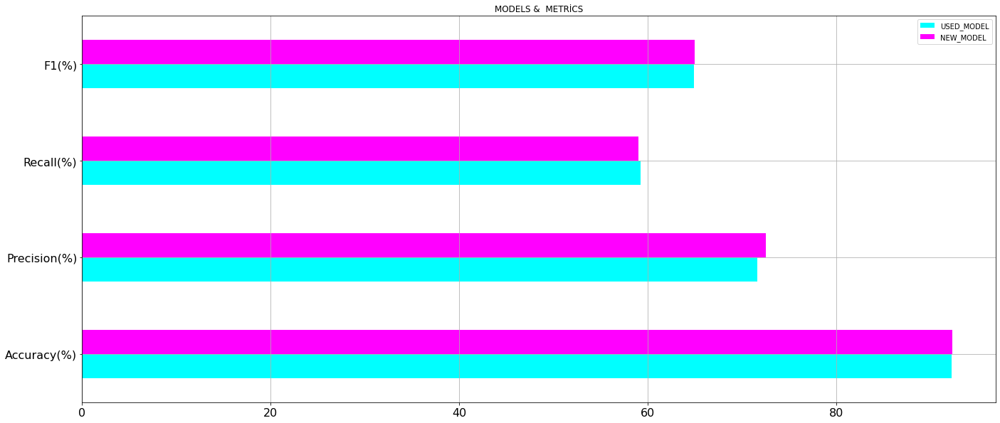

In [223]:
df_plot.plot(kind='barh',figsize=(23,10), colormap='cool',fontsize=16, grid=True, sort_columns=True,
            title='MODELS &  METRİCS')

###  SONUÇ  OLARAK YENİ  OLUŞTURULAN MODELİN  RECALL DEĞERİ ÇOK AZ FARKLA  DÜŞÜK  İKEN ( 59,24 VS. 58.972 ) DİĞER METRİCLERDE İSE BUNA  ORANLA GRAFİKTEKİ GİBİ  DAHA FAZLA   İYİLEŞTİRİLME  SAĞLANMIŞTIR !!

### MODELİN SON KULLANIM İÇİN KAYIT EDİLMESİ !!!!

In [19]:
import joblib
joblib.dump(model2, 'TUNED__CABLETV_CHURN_MODEL')

['TUNED__CABLETV_CHURN_MODEL']

####  ÖRNEK ÇEKEREK MODELİN  KONTROLÜ !!

In [20]:
cableTv_churn_model=joblib.load('TUNED__CABLETV_CHURN_MODEL')

Modelimiz joblib'den çağrılabiliyor mu bakalım.

In [21]:
## şimdi tahmin yapalım !!
cableTv_churn_model.predict(X_test)


array([0, 0, 0, ..., 0, 0, 0], dtype=int64)